<a href="https://colab.research.google.com/github/arthurnicolas59/BloodCellDec22---DataScientest/blob/Ludo/2_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1. Connexion au drive**

In [1]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [2]:
import tensorflow as tf
if tf.test.gpu_device_name():
    print('Default GPU Device:{}'.format(tf.test.gpu_device_name()))
else:
    print("Please change your hardware accelerator")

Please change your hardware accelerator


# **2. Chargement des images et création du dataframe 'df'**

In [9]:
#Import librairies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import PIL
import PIL.Image
from PIL import Image
import tensorflow as tf
from tqdm import tqdm
import glob
import os


In [72]:
# décompression des images
# !unzip -q 'drive/MyDrive/Datascientest/PBC_dataset_normal_DIB.zip' > /dev/null 2>&1
!unzip 'drive/MyDrive/Datascientest/PBC_dataset_normal_DIB.zip'

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_292483.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_935950.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_890863.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_519370.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_215077.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_388154.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_968896.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_34345.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_349907.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_245683.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_785122.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_615525.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_714613.jpg  
  inflating: PBC_dataset_normal_DIB/erythroblast/ERB_904757.jpg  

In [73]:
# suppression d'une image présentant un défaut de format :
os.remove('/content/PBC_dataset_normal_DIB/neutrophil/.DS_169665.jpg')

In [74]:
# Trouver tous les chemins vers les fichiers qui finissent par .jpg
liste = glob.glob('./PBC_dataset_normal_DIB/*/*.jpg')

# Création d'une liste comprenant les chemins d'accès aux images ainsi que le label de chaque image
liste = list(map(lambda x : [x, x.split('/')[3].split('_')[0]], liste))

# Créer un DataFrame pandas
df = pd.DataFrame(liste, columns=['Path', 'target'])
df=df.replace(['SNE','BNE'],'NEUTROPHIL')
df=df.replace(['MY','MMY','PMY'],'IG')

# Mapping entre nameLabel et label
mapping = {target: idx for idx, target in enumerate(df.target.unique())}

# Ajouter la colonne 'label' en utilisant le mapping
df['target_numerique'] = df['target'].map(mapping)

df.sort_values('Path')
df

,Path,target,target_numerique
0,./PBC_dataset_normal_DIB/platelet/PLATELET_948...,PLATELET,0
1,./PBC_dataset_normal_DIB/platelet/PLATELET_445...,PLATELET,0
2,./PBC_dataset_normal_DIB/platelet/PLATELET_174...,PLATELET,0
3,./PBC_dataset_normal_DIB/platelet/PLATELET_153...,PLATELET,0
4,./PBC_dataset_normal_DIB/platelet/PLATELET_773...,PLATELET,0
...,...,...,...
17087,./PBC_dataset_normal_DIB/ig/PMY_456936.jpg,IG,7
17088,./PBC_dataset_normal_DIB/ig/MMY_482816.jpg,IG,7
17089,./PBC_dataset_normal_DIB/ig/MY_46606.jpg,IG,7
17090,./PBC_dataset_normal_DIB/ig/PMY_324335.jpg,IG,7


In [ ]:
df = pd.read_csv('Dataframe/df_cleaned.csv')
display(df.head())

# **3. Visualisation des données**

## 3.1. Répartition du nombre d'images par classes

Text(0.5, 1.0, "Nombres d'images par classe")

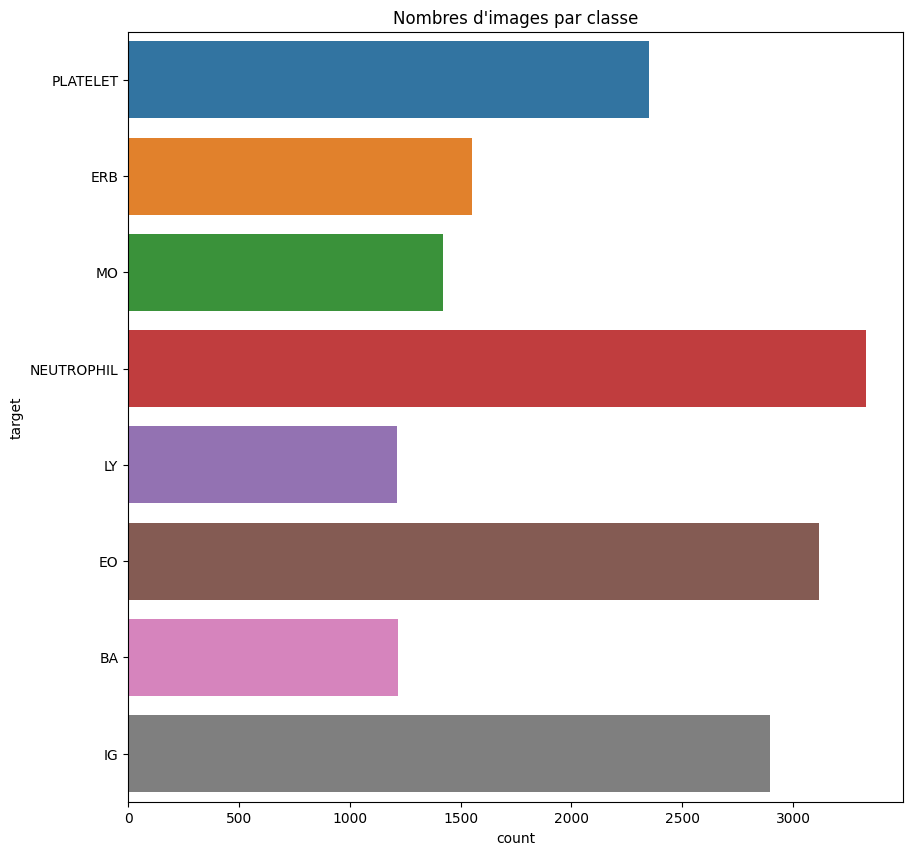

In [11]:
plt.figure(figsize=(10,10))
sns.countplot(data = df, y = 'target')
plt.title("Nombres d'images par classe")

## 3.2. Visualisation de 9 images par classe

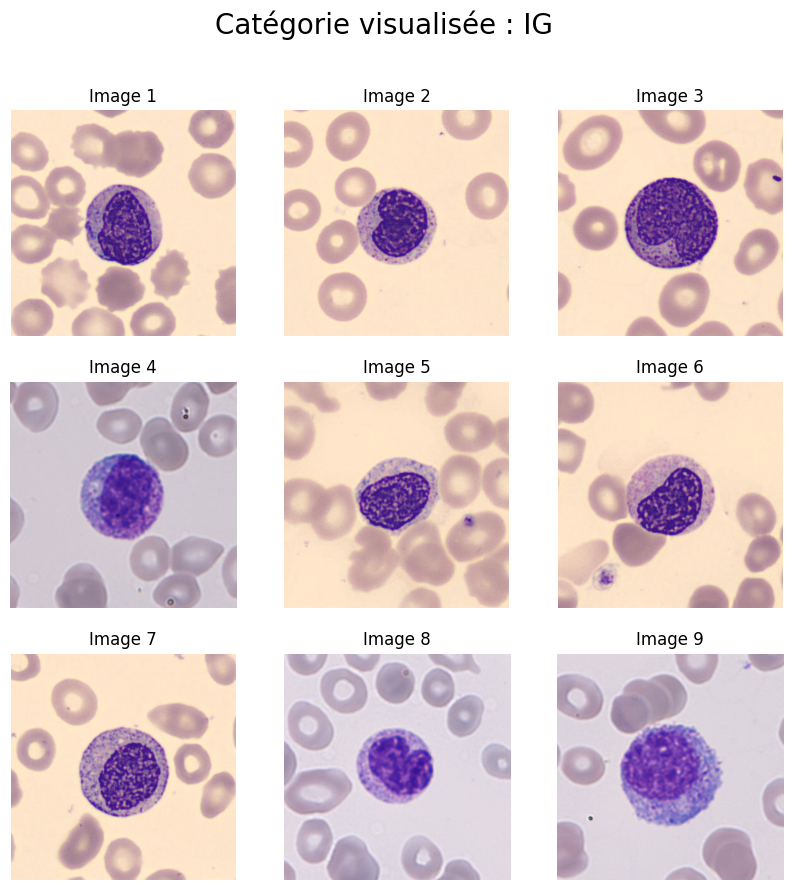

In [12]:
category = "IG"  # a modifier par la catégorie visée
subset = df[df["target"] == category].sample(n=9)

#création de la figure
fig, axs = plt.subplots(nrows=3, ncols=3, figsize=(10, 10))

# boucle for
for i, ax in enumerate(axs.flat):
    # chargement image
    img = Image.open(subset.iloc[i]["Path"])
    # Plot image
    ax.imshow(img)
    ax.set_axis_off()
    ax.set_title(f"Image {i+1}")
    plt.suptitle("Catégorie visualisée : {}".format(category), fontsize=20)


# Visualisation
plt.show()

## 3.3. Affichage d'une image aléatoire pour chaque label du dataset

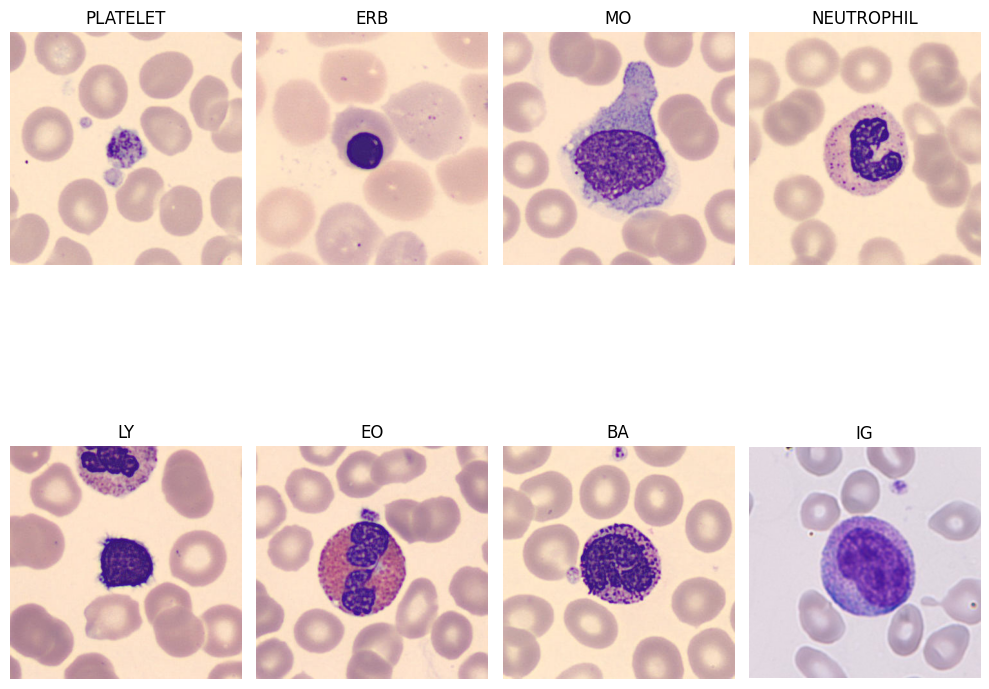

In [13]:
list_category = df.target.unique()

# Assurez-vous qu'il y a au maximum 8 catégories
if len(list_category) > 8:
    raise ValueError("Il y a plus de 8 catégories, ce qui dépasse le nombre d'emplacements d'images disponibles.")

# Création de la figure
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(10, 10))

for i, category in enumerate(list_category):
    subset = df[df["target"] == category].sample(n=1)
    image_path = subset["Path"].values[0]

    # Charger et afficher l'image
    image = Image.open(image_path)
    ax = axs[i // 4, i % 4]  # Ajustement de l'indexation pour 2x4 grille
    ax.imshow(image)
    ax.set_title(category)
    ax.axis("off")

plt.tight_layout()  # Pour un espacement approprié entre les sous-tracés
plt.show()

## 3.4. Affichage d'une image moyenne pour chaque label du dataset

8it [00:31,  3.97s/it]


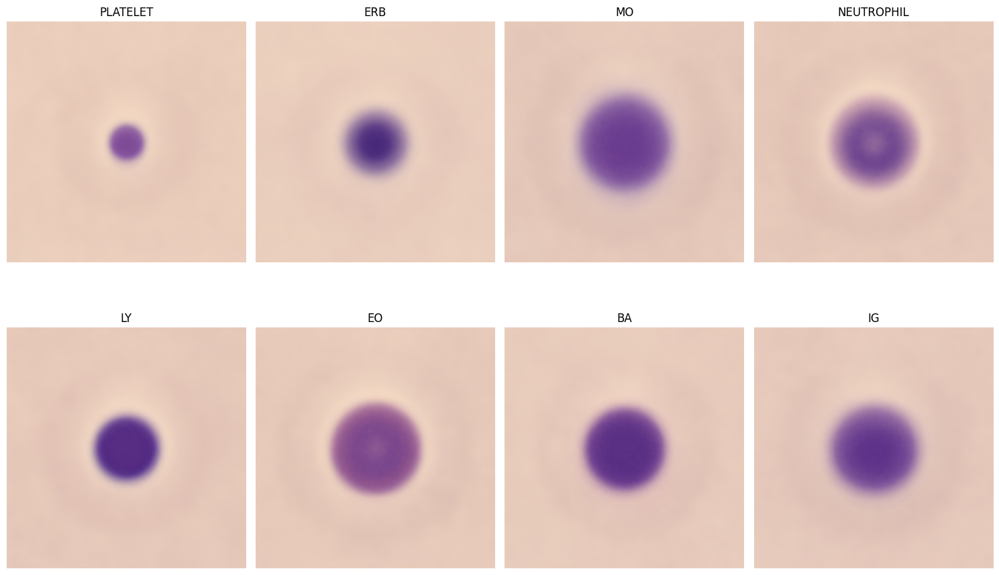

In [14]:
list_category = df.target.unique()


# Création de la figure
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(15, 10))

for category, ax in tqdm(zip(list_category, axs.flatten())):
    subset = df['Path'][df["target"] == category].sample(n=1000)
    liste = []

    for path in subset:
        # Lecture du fichier
        im = tf.io.read_file(path)
        # On décode le fichier
        im = tf.image.decode_jpeg(im, channels=3)
        # On uniformise la taille des images
        im = tf.image.resize(im, size=(363, 360))
        # Ajout à la liste
        liste.append(im)

    liste = np.array(liste)
    image_moyenne = np.mean(liste, axis=0)

    # Load and plot the image
    ax.imshow(image_moyenne/255)
    ax.set_title(category)
    ax.axis('off')

plt.tight_layout()
plt.show()

## 3.5. Affichage d'une image représentant l'écart type pour chaque label du dataset

8it [00:37,  4.72s/it]


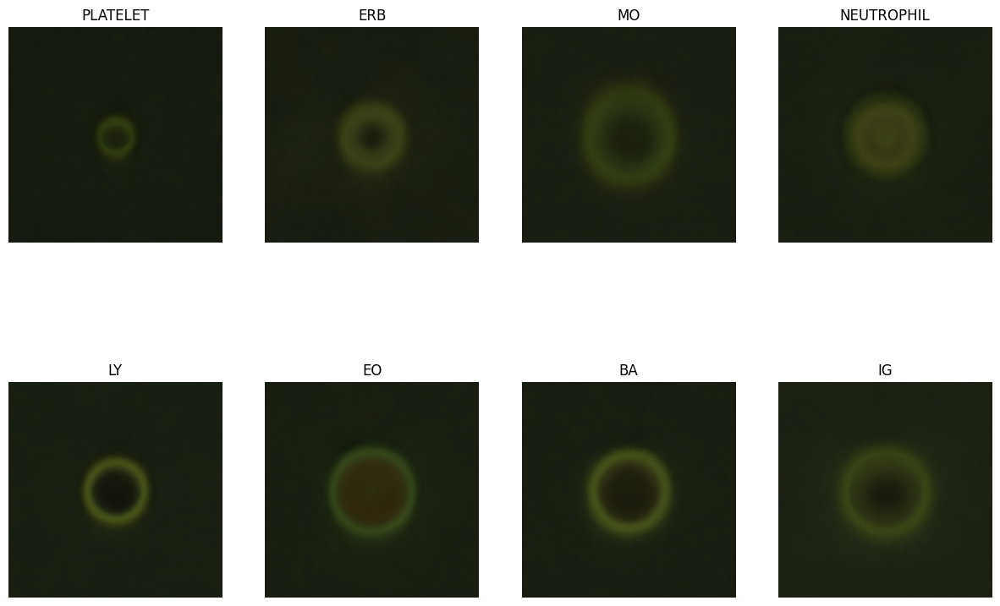

In [16]:
list_category = df.target.unique()

#création de la figure
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(15, 10))

for category, ax in tqdm(zip(list_category, axs.flatten())):
    subset = df['Path'][df["target"] == category].sample(n=1000)
    liste = []

    for path in subset:
        #lecture du fichier
        im = tf.io.read_file(path)
        # On décode le fichier
        im = tf.image.decode_jpeg(im, channels=3)
        # On uniformise la taille des images
        im = tf.image.resize(im, size=(363, 360))
        # Ajout à la liste
        liste.append(im)

    liste = np.array(liste)
    image_std = np.std(liste, axis=0)

    # Load and plot the image
    ax.imshow(image_std/255)
    ax.set_title(category)
    ax.axis('off')

plt.show()

# **4. Représentation graphique du dataset : images brutes**

## 4.1. Préparation des données.

**Création d'une liste 'X' comprenant l'ensemble des images au format 32 x 32 x 3**

In [17]:
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import tensorflow as tf
import pandas as pd
import numpy as np
from sklearn.manifold import LocallyLinearEmbedding, MDS, Isomap, TSNE

# création d'une colonne de df associant à chaque target une valeur comprise entre 0 et 7
df['label'] = df['target'].replace(df.target.unique(), [*range(len(df.target.unique()))])

X_path=df.Path
Y_label=df.label
Y_nameLabel=df.target

X = []

for filepath in tqdm(X_path):
    # Lecture du fichier
    im = tf.io.read_file(filepath)
    # On décode le fichier
    im = tf.image.decode_jpeg(im, channels=3)
    # Redimensionnement
    im = tf.image.resize(im, size=(32, 32))
    X.append(np.array(im))

print(type(X))
print(type(Y_nameLabel))

100%|██████████| 17092/17092 [00:35<00:00, 486.00it/s]

<class 'list'>
<class 'pandas.core.series.Series'>


In [18]:
#Transformation de la série en array numpy
X=np.array(X)

#Convsersion des données en type 'float32'
X = X.astype('float32')

#Normalisation des balances RGB
X/= 255.0

#Transformation de la colonne du dataframe comprenant la classe des images en array numpy
Y_nameLabel = np.array(Y_nameLabel)

#Vérification de l'ensemble des modifications faites:
print(type(X))
print(X.shape)
print(type(Y_nameLabel))
print('Min: %.3f, Max: %.3f' % (X.min(), X.max()))

<class 'numpy.ndarray'>
(17092, 32, 32, 3)
<class 'numpy.ndarray'>
Min: 0.006, Max: 1.000


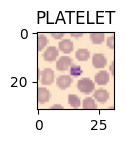

In [19]:
# Vérification que la transformation permet toujours d'afficher les images
plt.figure(figsize=(1,1))
plt.imshow(X[3])
plt.title(Y_nameLabel[3])
plt.show()

## 4.2. Application d'un algorithme de Manifold learning : TSNE

In [20]:
# Reshape de l'array X en une dimension :
X_1D=X.reshape(17092,3072)
print(X_1D.shape)

# Pour contrôle :
print(Y_nameLabel.shape)
print(type(X_1D))
print(type(Y_nameLabel))

(17092, 3072)
(17092,)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [21]:
tsne = TSNE(n_components=2, method = 'barnes_hut', n_jobs=-1)
dataTSNE = tsne.fit_transform(X_1D)

## 4.3. Projection des données sur un graphique 2D

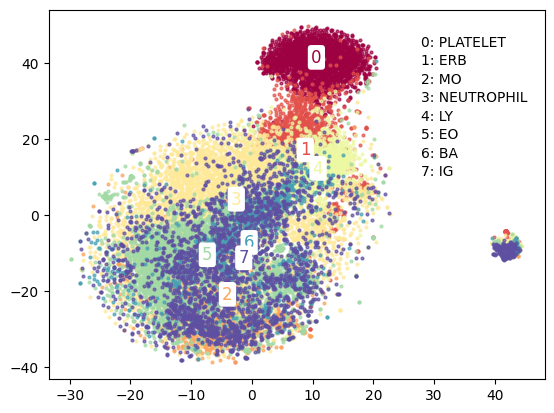

In [23]:
fig = plt.figure()
ax = fig.add_subplot(111)

# Obtenez une liste des labels uniques
unique_labels = df['label'].unique()

# Utilisez la colormap pour obtenir une couleur pour chaque label
colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_labels)))

# Inversez le mapping pour obtenir le nameLabel à partir du label
inverse_mapping = {v: k for k, v in mapping.items()}


# Traçage des clusters et annotation avec le label numérique
for label, color in zip(unique_labels, colors):
    indices = df['label'] == label
    ax.scatter(dataTSNE[indices, 0], dataTSNE[indices, 1], color=color, alpha=0.7, s=4)

    # Calculer le centre de gravité de chaque cluster pour positionner le label
    cluster_center = dataTSNE[indices].mean(axis=0)

    # Annoter le graphique avec le label numérique
    ax.annotate(str(label),
                (cluster_center[0], cluster_center[1]),
                fontsize=12,
                ha='center',
                color=color,
                bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'))

# Affichage du mapping dans le coin supérieur droit
start_x = 0.75  # Ajustez selon votre graphique
start_y = 0.90  # Ajustez selon votre graphique
y_offset = 0.05

for label, name in inverse_mapping.items():
    annotation_str = f"{label}: {name}"
    ax.annotate(annotation_str,
                xy=(start_x, start_y),
                xycoords='axes fraction',
                fontsize=10,
                color='black',
                bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.5'))
    start_y -= y_offset  # déplace le texte vers le bas pour la prochaine annotation

plt.show()

# print("La part de variance expliquée est", round(dataTSNE.explained_variance_ratio_.sum(),2))
# print("La part de variance expliquée cumulée est", dataTSNE.explained_variance_ratio_.cumsum())

## 4.4. Affichage des objets du Manifold sur la projection 2D TSNE

In [24]:
import matplotlib.pyplot as plt
from matplotlib.image import imread
from matplotlib import offsetbox
from mpl_toolkits import mplot3d

In [25]:
def plot_components(data, model, images=None, ax=None,
                    thumb_frac=0.05, cmap='gray_r', prefit = False):
    ax = ax or plt.gca()

    if not prefit :
        proj = model.fit_transform(data)
    else:
        proj = data
    ax.plot(proj[:, 0], proj[:, 1], '.b')

    if images is not None:
        min_dist_2 = (thumb_frac * max(proj.max(0) - proj.min(0))) ** 2
        shown_images = np.array([2 * proj.max(0)])
        for i in range(data.shape[0]):
            dist = np.sum((proj[i] - shown_images) ** 2, 1)
            if np.min(dist) < min_dist_2:
                # On ne montre pas le points trop proches
                continue
            shown_images = np.vstack([shown_images, proj[i]])
            imagebox = offsetbox.AnnotationBbox(
                offsetbox.OffsetImage(images[i], cmap=cmap),
                                      proj[i])
            ax.add_artist(imagebox)

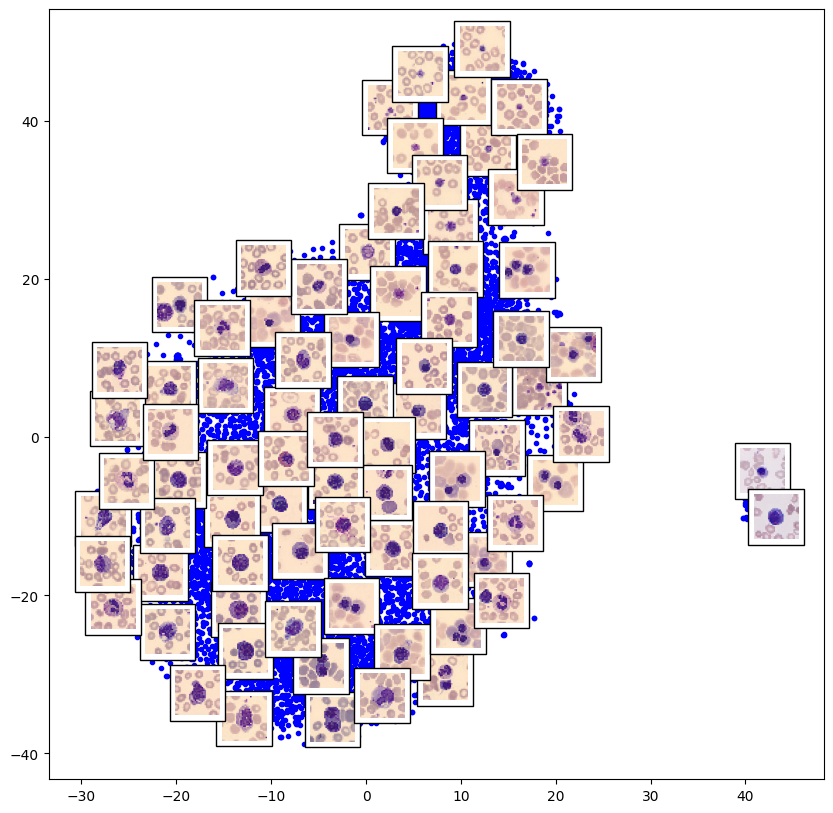

In [26]:
fig, ax = plt.subplots(figsize=(10, 10))
plot_components(dataTSNE, tsne, images=X,
                ax=ax, thumb_frac=0.06, cmap='gray_r',prefit=True)

# **5. Représentation graphique du dataset : images égalisées**

## 5.1. Présentation de la transformation à partir d'une image du dataset

In [27]:
import cv2 as cv

In [28]:
# Chargement d'une image test
img_test = ('/content'+'/PBC_dataset_normal_DIB/monocyte/MO_10819.jpg')
img_test = cv.imread(img_test)

In [29]:
# Transformation de l'image selon différentes échelles de couleurs
img_RGB = cv.cvtColor(img_test, cv.COLOR_BGR2RGB)
img_grayscale = cv.cvtColor(img_test, cv.COLOR_RGB2GRAY)
img_YUV = cv.cvtColor(img_test,cv.COLOR_BGR2YUV)

In [53]:
# Création d'un histogramme
def plot_histogram(init_img, convert_img):
    """Function allowing to display the initial
    and converted images according to a certain
    colorimetric format as well as the histogram
    of the latter.

    Parameters
    -------------------------------------------
    init_img : list
        init_img[0] = Title of the init image
        init_img[1] = Init openCV image
    convert_img : list
        convert_img[0] = Title of the converted
        convert_img[1] = converted openCV image
    -------------------------------------------
    """
    hist, bins = np.histogram(
                    convert_img[1].flatten(),
                    256, [0,256])
    # Distribution cumulative
    cdf = hist.cumsum()
    cdf_normalized = cdf * float(hist.max()) / cdf.max()

    # Histogramme
    fig = plt.figure(figsize=(25,6))
    plt.subplot(1, 3, 1)
    plt.imshow(init_img[1])
    plt.title("{} Image".format(init_img[0]),
              color="#343434")
    plt.subplot(1, 3, 2)
    plt.imshow(convert_img[1])
    plt.title("{} Image".format(convert_img[0]),
              color="#343434")
    plt.subplot(1, 3, 3)
    plt.plot(cdf_normalized,
             color='r', alpha=.7,
             linestyle='--')
    plt.hist(convert_img[1].flatten(),256,[0,256])
    plt.xlim([0,256])
    plt.legend(('cdf','histogram'), loc = 'upper left')
    plt.title("Histogramme de l'image", color="#343434")
    plt.suptitle("Histogramme et fonction de distribution "\
                 "cumulative de l'image test",
              color="black", fontsize=22, y=.98)
    plt.show()

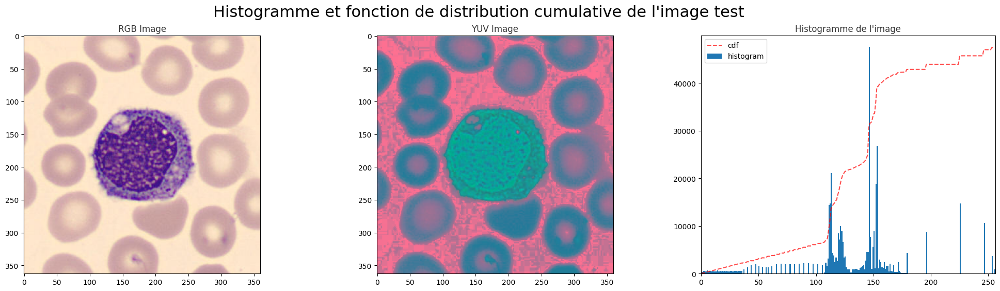

In [54]:
# Affichage de l'histogramme
plot_histogram(["RGB", img_RGB], ["YUV", img_YUV])

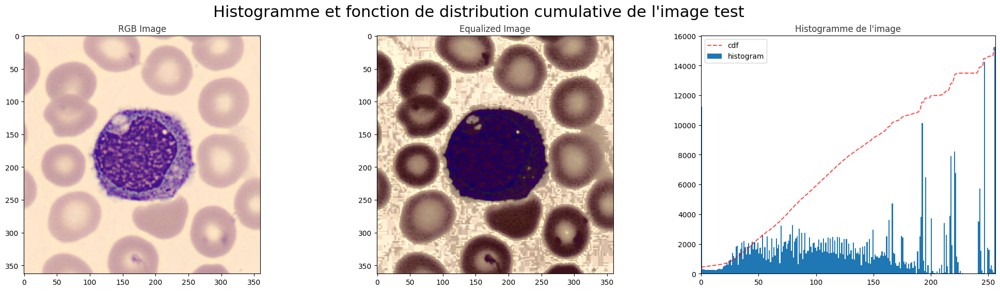

In [55]:
# Egalisation
img_YUV[:,:,0] = cv.equalizeHist(img_YUV[:,:,0])
img_equ = cv.cvtColor(img_YUV, cv.COLOR_YUV2RGB)
plot_histogram(["RGB", img_RGB], ["Equalized", img_equ])

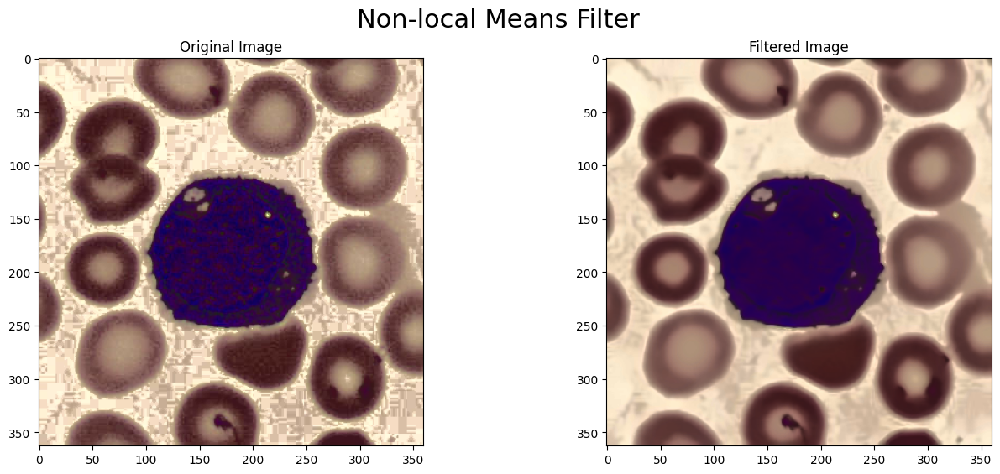

In [38]:
# Application d'un filtrage non local des moyennes
dst_img = cv.fastNlMeansDenoisingColored(
    src=img_equ,
    dst=None,
    h=10,
    hColor=10,
    templateWindowSize=7,
    searchWindowSize=21)

# Show both img
fig = plt.figure(figsize=(16,6))
plt.subplot(1, 2, 1)
plt.imshow(img_equ)
plt.title("Original Image")
plt.subplot(1, 2, 2)
plt.imshow(dst_img)
plt.title("Filtered Image")
plt.suptitle("Non-local Means Filter",
             color="black",
             fontsize=22, y=.98)
plt.show()

## **5.2. Application de la transformation sur le dataset d'images**

In [42]:
import cv2

In [ ]:

# Copie de df
train_df=df

# Définition d'une liste contenant les différents labels
liste_label =df.target.unique()

# Parcours et écriture des masques de chaque groupe présent dans la liste "liste_label"
# Ici on prend uniquement une centaine d'images par groupe
for label in liste_label :
  MASK_DF = train_df.loc[train_df['target'] == label]
  IMAGE_PATH = np.array(MASK_DF['Path'])

  # Création et enregistrement des masques pour chaque image

  for i in tqdm(range(len(MASK_DF))):

          # Lecture de l'image
          image_bgr = cv2.imread(IMAGE_PATH[i])
          image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

          # Redimensionnement
          dim = (256, 256)
          image_rgb = cv2.resize(image_rgb, dim, interpolation=cv2.INTER_LINEAR)
          # Egalisation
          img_yuv = cv2.cvtColor(image_rgb,cv2.COLOR_BGR2YUV)
          img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0])
          img_equ = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)
          # Application d'un filtrage non local des moyennes
          dst_img = cv2.fastNlMeansDenoisingColored(
              src=img_equ,
              dst=None,
              h=10,
              hColor=10,
              templateWindowSize=7,
              searchWindowSize=21)


          # Chemin du dossier de sortie
          output_folder = '/content/PBC_dataset_normal_DIB/' + IMAGE_PATH[i].split('/')[2]


          # Nom du fichier de sortie
          output_filename = str(MASK_DF['Path'].iloc[i]).split('/')[3]

          # Chemin complet du fichier de sortie
          output_path = output_folder+'/'+output_filename

          # Enregistrement de l'image
          cv2.imwrite(output_path, dst_img)
          print('L\'image n°', i, 'a été enregistrée sous :', output_path)

  0%|          | 1/2348 [00:00<09:35,  4.08it/s]

L'image n° 0 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_948092.jpg


  0%|          | 2/2348 [00:00<09:51,  3.97it/s]

L'image n° 1 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_445935.jpg


  0%|          | 3/2348 [00:00<09:32,  4.09it/s]

L'image n° 2 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_174771.jpg


  0%|          | 4/2348 [00:00<09:31,  4.10it/s]

L'image n° 3 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_153442.jpg


  0%|          | 5/2348 [00:01<09:28,  4.12it/s]

L'image n° 4 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_773759.jpg


  0%|          | 6/2348 [00:01<09:25,  4.14it/s]

L'image n° 5 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_752533.jpg


  0%|          | 7/2348 [00:01<09:16,  4.20it/s]

L'image n° 6 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_969782.jpg


  0%|          | 8/2348 [00:01<09:19,  4.18it/s]

L'image n° 7 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_199524.jpg


  0%|          | 9/2348 [00:02<09:23,  4.15it/s]

L'image n° 8 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_711650.jpg


  0%|          | 10/2348 [00:02<10:20,  3.77it/s]

L'image n° 9 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_558803.jpg


  0%|          | 11/2348 [00:02<12:29,  3.12it/s]

L'image n° 10 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_238876.jpg


  1%|          | 12/2348 [00:03<13:51,  2.81it/s]

L'image n° 11 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_721654.jpg


  1%|          | 13/2348 [00:03<14:44,  2.64it/s]

L'image n° 12 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_536215.jpg


  1%|          | 14/2348 [00:04<15:31,  2.51it/s]

L'image n° 13 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_425362.jpg


  1%|          | 15/2348 [00:04<16:00,  2.43it/s]

L'image n° 14 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_35326.jpg


  1%|          | 16/2348 [00:05<16:16,  2.39it/s]

L'image n° 15 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_747655.jpg


  1%|          | 17/2348 [00:05<16:30,  2.35it/s]

L'image n° 16 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_471856.jpg


  1%|          | 18/2348 [00:06<16:37,  2.34it/s]

L'image n° 17 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_200759.jpg


  1%|          | 19/2348 [00:06<16:42,  2.32it/s]

L'image n° 18 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_199786.jpg


  1%|          | 20/2348 [00:06<16:45,  2.32it/s]

L'image n° 19 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_842599.jpg


  1%|          | 21/2348 [00:07<15:12,  2.55it/s]

L'image n° 20 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_719220.jpg


  1%|          | 22/2348 [00:07<13:18,  2.91it/s]

L'image n° 21 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_516.jpg


  1%|          | 23/2348 [00:07<11:59,  3.23it/s]

L'image n° 22 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_283517.jpg


  1%|          | 24/2348 [00:07<11:20,  3.41it/s]

L'image n° 23 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_697037.jpg


  1%|          | 25/2348 [00:08<10:39,  3.63it/s]

L'image n° 24 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_81999.jpg


  1%|          | 26/2348 [00:08<10:12,  3.79it/s]

L'image n° 25 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_914479.jpg


  1%|          | 27/2348 [00:08<09:54,  3.90it/s]

L'image n° 26 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_908261.jpg


  1%|          | 28/2348 [00:08<09:44,  3.97it/s]

L'image n° 27 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_60923.jpg


  1%|          | 29/2348 [00:09<09:34,  4.04it/s]

L'image n° 28 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_210779.jpg


  1%|▏         | 30/2348 [00:09<09:26,  4.09it/s]

L'image n° 29 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_767089.jpg


  1%|▏         | 31/2348 [00:09<09:16,  4.16it/s]

L'image n° 30 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_296963.jpg


  1%|▏         | 32/2348 [00:09<09:22,  4.12it/s]

L'image n° 31 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_530893.jpg


  1%|▏         | 33/2348 [00:10<09:14,  4.18it/s]

L'image n° 32 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_931656.jpg


  1%|▏         | 34/2348 [00:10<09:13,  4.18it/s]

L'image n° 33 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_451831.jpg


  1%|▏         | 35/2348 [00:10<09:14,  4.17it/s]

L'image n° 34 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_377389.jpg


  2%|▏         | 36/2348 [00:10<09:15,  4.16it/s]

L'image n° 35 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_553965.jpg


  2%|▏         | 37/2348 [00:10<09:15,  4.16it/s]

L'image n° 36 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_224521.jpg


  2%|▏         | 38/2348 [00:11<09:16,  4.15it/s]

L'image n° 37 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_906500.jpg


  2%|▏         | 39/2348 [00:11<09:07,  4.22it/s]

L'image n° 38 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_712743.jpg


  2%|▏         | 40/2348 [00:11<09:04,  4.24it/s]

L'image n° 39 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_881622.jpg


  2%|▏         | 41/2348 [00:11<09:13,  4.17it/s]

L'image n° 40 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_960038.jpg


  2%|▏         | 42/2348 [00:12<09:11,  4.18it/s]

L'image n° 41 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_284020.jpg


  2%|▏         | 43/2348 [00:12<09:09,  4.19it/s]

L'image n° 42 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_187417.jpg


  2%|▏         | 44/2348 [00:12<09:07,  4.21it/s]

L'image n° 43 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_198187.jpg


  2%|▏         | 45/2348 [00:12<09:24,  4.08it/s]

L'image n° 44 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_808401.jpg


  2%|▏         | 46/2348 [00:13<09:17,  4.13it/s]

L'image n° 45 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_963211.jpg


  2%|▏         | 47/2348 [00:13<09:12,  4.17it/s]

L'image n° 46 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_175155.jpg


  2%|▏         | 48/2348 [00:13<09:08,  4.19it/s]

L'image n° 47 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_645869.jpg


  2%|▏         | 49/2348 [00:13<09:13,  4.15it/s]

L'image n° 48 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_721971.jpg


  2%|▏         | 50/2348 [00:14<09:17,  4.12it/s]

L'image n° 49 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_350895.jpg


  2%|▏         | 51/2348 [00:14<09:08,  4.19it/s]

L'image n° 50 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_554367.jpg


  2%|▏         | 52/2348 [00:14<09:06,  4.20it/s]

L'image n° 51 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_699128.jpg


  2%|▏         | 53/2348 [00:14<09:07,  4.19it/s]

L'image n° 52 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_5911.jpg


  2%|▏         | 54/2348 [00:15<09:06,  4.20it/s]

L'image n° 53 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_982153.jpg


  2%|▏         | 55/2348 [00:15<09:06,  4.20it/s]

L'image n° 54 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_822242.jpg


  2%|▏         | 56/2348 [00:15<09:02,  4.22it/s]

L'image n° 55 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_615170.jpg


  2%|▏         | 57/2348 [00:15<09:04,  4.20it/s]

L'image n° 56 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_620900.jpg


  2%|▏         | 58/2348 [00:16<09:12,  4.14it/s]

L'image n° 57 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_312324.jpg


  3%|▎         | 59/2348 [00:16<09:15,  4.12it/s]

L'image n° 58 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_210470.jpg


  3%|▎         | 60/2348 [00:16<09:13,  4.13it/s]

L'image n° 59 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_703067.jpg


  3%|▎         | 61/2348 [00:16<09:07,  4.18it/s]

L'image n° 60 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_581004.jpg


  3%|▎         | 62/2348 [00:16<09:06,  4.18it/s]

L'image n° 61 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_525505.jpg


  3%|▎         | 63/2348 [00:17<10:54,  3.49it/s]

L'image n° 62 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_160458.jpg


  3%|▎         | 64/2348 [00:17<12:46,  2.98it/s]

L'image n° 63 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_309495.jpg


  3%|▎         | 65/2348 [00:18<14:01,  2.71it/s]

L'image n° 64 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_117661.jpg


  3%|▎         | 66/2348 [00:18<14:47,  2.57it/s]

L'image n° 65 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_765954.jpg


  3%|▎         | 67/2348 [00:19<15:25,  2.47it/s]

L'image n° 66 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_369393.jpg


  3%|▎         | 68/2348 [00:19<15:45,  2.41it/s]

L'image n° 67 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_773103.jpg


  3%|▎         | 69/2348 [00:20<15:53,  2.39it/s]

L'image n° 68 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_908172.jpg


  3%|▎         | 70/2348 [00:20<16:05,  2.36it/s]

L'image n° 69 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_378737.jpg


  3%|▎         | 71/2348 [00:20<16:16,  2.33it/s]

L'image n° 70 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_78710.jpg


  3%|▎         | 72/2348 [00:21<16:27,  2.30it/s]

L'image n° 71 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_563993.jpg


  3%|▎         | 73/2348 [00:21<15:46,  2.40it/s]

L'image n° 72 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_914573.jpg


  3%|▎         | 74/2348 [00:21<13:42,  2.76it/s]

L'image n° 73 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_362599.jpg


  3%|▎         | 75/2348 [00:22<12:23,  3.06it/s]

L'image n° 74 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_162155.jpg


  3%|▎         | 76/2348 [00:22<11:21,  3.34it/s]

L'image n° 75 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_749872.jpg


  3%|▎         | 77/2348 [00:22<10:37,  3.56it/s]

L'image n° 76 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_687638.jpg


  3%|▎         | 78/2348 [00:22<10:06,  3.74it/s]

L'image n° 77 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_111953.jpg


  3%|▎         | 79/2348 [00:23<09:52,  3.83it/s]

L'image n° 78 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_823482.jpg


  3%|▎         | 80/2348 [00:23<09:38,  3.92it/s]

L'image n° 79 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_810228.jpg


  3%|▎         | 81/2348 [00:23<09:21,  4.04it/s]

L'image n° 80 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_822250.jpg


  3%|▎         | 82/2348 [00:23<09:13,  4.10it/s]

L'image n° 81 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_396241.jpg


  4%|▎         | 83/2348 [00:24<09:07,  4.14it/s]

L'image n° 82 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_60957.jpg


  4%|▎         | 84/2348 [00:24<09:09,  4.12it/s]

L'image n° 83 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_177133.jpg


  4%|▎         | 85/2348 [00:24<09:06,  4.14it/s]

L'image n° 84 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_6360.jpg


  4%|▎         | 86/2348 [00:24<08:59,  4.19it/s]

L'image n° 85 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_693212.jpg


  4%|▎         | 87/2348 [00:25<08:55,  4.22it/s]

L'image n° 86 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_245496.jpg


  4%|▎         | 88/2348 [00:25<09:02,  4.16it/s]

L'image n° 87 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_61534.jpg


  4%|▍         | 89/2348 [00:25<08:55,  4.22it/s]

L'image n° 88 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_794333.jpg


  4%|▍         | 90/2348 [00:25<08:56,  4.21it/s]

L'image n° 89 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_848103.jpg


  4%|▍         | 91/2348 [00:25<08:54,  4.23it/s]

L'image n° 90 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_370200.jpg


  4%|▍         | 92/2348 [00:26<08:58,  4.19it/s]

L'image n° 91 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_848602.jpg


  4%|▍         | 93/2348 [00:26<08:55,  4.21it/s]

L'image n° 92 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_109056.jpg


  4%|▍         | 94/2348 [00:26<09:00,  4.17it/s]

L'image n° 93 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_388924.jpg


  4%|▍         | 95/2348 [00:26<08:54,  4.21it/s]

L'image n° 94 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_37710.jpg


  4%|▍         | 96/2348 [00:27<09:03,  4.14it/s]

L'image n° 95 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_600104.jpg


  4%|▍         | 97/2348 [00:27<08:59,  4.17it/s]

L'image n° 96 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_831123.jpg


  4%|▍         | 98/2348 [00:27<08:52,  4.23it/s]

L'image n° 97 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_699812.jpg


  4%|▍         | 99/2348 [00:27<08:55,  4.20it/s]

L'image n° 98 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_355457.jpg


  4%|▍         | 100/2348 [00:28<08:51,  4.23it/s]

L'image n° 99 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_907900.jpg


  4%|▍         | 101/2348 [00:28<09:00,  4.15it/s]

L'image n° 100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_113492.jpg


  4%|▍         | 102/2348 [00:28<08:56,  4.18it/s]

L'image n° 101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_146840.jpg


  4%|▍         | 103/2348 [00:28<08:53,  4.21it/s]

L'image n° 102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_172042.jpg


  4%|▍         | 104/2348 [00:29<08:53,  4.21it/s]

L'image n° 103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_795936.jpg


  4%|▍         | 105/2348 [00:29<09:00,  4.15it/s]

L'image n° 104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538020.jpg


  5%|▍         | 106/2348 [00:29<08:54,  4.19it/s]

L'image n° 105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_390381.jpg


  5%|▍         | 107/2348 [00:29<08:52,  4.21it/s]

L'image n° 106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_443069.jpg


  5%|▍         | 108/2348 [00:30<08:54,  4.19it/s]

L'image n° 107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_309574.jpg


  5%|▍         | 109/2348 [00:30<08:58,  4.16it/s]

L'image n° 108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_661560.jpg


  5%|▍         | 110/2348 [00:30<08:59,  4.15it/s]

L'image n° 109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_312639.jpg


  5%|▍         | 111/2348 [00:30<08:57,  4.16it/s]

L'image n° 110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_819129.jpg


  5%|▍         | 112/2348 [00:31<08:52,  4.20it/s]

L'image n° 111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_842396.jpg


  5%|▍         | 113/2348 [00:31<08:58,  4.15it/s]

L'image n° 112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_689473.jpg


  5%|▍         | 114/2348 [00:31<08:57,  4.15it/s]

L'image n° 113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_359345.jpg


  5%|▍         | 115/2348 [00:31<09:46,  3.80it/s]

L'image n° 114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_238609.jpg


  5%|▍         | 116/2348 [00:32<11:38,  3.19it/s]

L'image n° 115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_848280.jpg


  5%|▍         | 117/2348 [00:32<13:00,  2.86it/s]

L'image n° 116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_432194.jpg


  5%|▌         | 118/2348 [00:33<13:53,  2.67it/s]

L'image n° 117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_182955.jpg


  5%|▌         | 119/2348 [00:33<14:35,  2.54it/s]

L'image n° 118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_100161.jpg


  5%|▌         | 120/2348 [00:33<15:05,  2.46it/s]

L'image n° 119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_963545.jpg


  5%|▌         | 121/2348 [00:34<15:29,  2.40it/s]

L'image n° 120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_280405.jpg


  5%|▌         | 122/2348 [00:34<15:33,  2.38it/s]

L'image n° 121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_930880.jpg


  5%|▌         | 123/2348 [00:35<15:49,  2.34it/s]

L'image n° 122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_586542.jpg


  5%|▌         | 124/2348 [00:35<15:56,  2.32it/s]

L'image n° 123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_897238.jpg


  5%|▌         | 125/2348 [00:36<16:01,  2.31it/s]

L'image n° 124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_983609.jpg


  5%|▌         | 126/2348 [00:36<14:28,  2.56it/s]

L'image n° 125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_294887.jpg


  5%|▌         | 127/2348 [00:36<12:54,  2.87it/s]

L'image n° 126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_826552.jpg


  5%|▌         | 128/2348 [00:36<11:41,  3.16it/s]

L'image n° 127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_773730.jpg


  5%|▌         | 129/2348 [00:37<10:57,  3.37it/s]

L'image n° 128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_623003.jpg


  6%|▌         | 130/2348 [00:37<10:17,  3.59it/s]

L'image n° 129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_972824.jpg


  6%|▌         | 131/2348 [00:37<09:56,  3.72it/s]

L'image n° 130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_811679.jpg


  6%|▌         | 132/2348 [00:37<09:33,  3.87it/s]

L'image n° 131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_569598.jpg


  6%|▌         | 133/2348 [00:38<09:22,  3.94it/s]

L'image n° 132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_463728.jpg


  6%|▌         | 134/2348 [00:38<09:10,  4.02it/s]

L'image n° 133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_573089.jpg


  6%|▌         | 135/2348 [00:38<09:19,  3.96it/s]

L'image n° 134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_770568.jpg


  6%|▌         | 136/2348 [00:38<09:06,  4.05it/s]

L'image n° 135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_284060.jpg


  6%|▌         | 137/2348 [00:39<09:06,  4.04it/s]

L'image n° 136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_485640.jpg


  6%|▌         | 138/2348 [00:39<09:01,  4.08it/s]

L'image n° 137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_762120.jpg


  6%|▌         | 139/2348 [00:39<09:02,  4.07it/s]

L'image n° 138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_850395.jpg


  6%|▌         | 140/2348 [00:39<08:57,  4.11it/s]

L'image n° 139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_324323.jpg


  6%|▌         | 141/2348 [00:40<08:48,  4.18it/s]

L'image n° 140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_603428.jpg


  6%|▌         | 142/2348 [00:40<08:52,  4.14it/s]

L'image n° 141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_32788.jpg


  6%|▌         | 143/2348 [00:40<08:48,  4.17it/s]

L'image n° 142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_189039.jpg


  6%|▌         | 144/2348 [00:40<09:00,  4.08it/s]

L'image n° 143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_459459.jpg


  6%|▌         | 145/2348 [00:41<08:53,  4.13it/s]

L'image n° 144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_21133.jpg


  6%|▌         | 146/2348 [00:41<08:57,  4.10it/s]

L'image n° 145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_207508.jpg


  6%|▋         | 147/2348 [00:41<08:48,  4.17it/s]

L'image n° 146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_396574.jpg


  6%|▋         | 148/2348 [00:41<09:07,  4.02it/s]

L'image n° 147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_874005.jpg


  6%|▋         | 149/2348 [00:42<08:56,  4.10it/s]

L'image n° 148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_633259.jpg


  6%|▋         | 150/2348 [00:42<08:53,  4.12it/s]

L'image n° 149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_357817.jpg


  6%|▋         | 151/2348 [00:42<08:44,  4.19it/s]

L'image n° 150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_222334.jpg


  6%|▋         | 152/2348 [00:42<08:49,  4.15it/s]

L'image n° 151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_57415.jpg


  7%|▋         | 153/2348 [00:43<08:48,  4.15it/s]

L'image n° 152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_466299.jpg


  7%|▋         | 154/2348 [00:43<08:51,  4.13it/s]

L'image n° 153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_590291.jpg


  7%|▋         | 155/2348 [00:43<08:49,  4.14it/s]

L'image n° 154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_509027.jpg


  7%|▋         | 156/2348 [00:43<08:57,  4.08it/s]

L'image n° 155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_785071.jpg


  7%|▋         | 157/2348 [00:43<08:47,  4.15it/s]

L'image n° 156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_66545.jpg


  7%|▋         | 158/2348 [00:44<08:43,  4.18it/s]

L'image n° 157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_663926.jpg


  7%|▋         | 159/2348 [00:44<08:53,  4.10it/s]

L'image n° 158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_929427.jpg


  7%|▋         | 160/2348 [00:44<08:46,  4.16it/s]

L'image n° 159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_476130.jpg


  7%|▋         | 161/2348 [00:44<08:47,  4.15it/s]

L'image n° 160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_63635.jpg


  7%|▋         | 162/2348 [00:45<08:43,  4.17it/s]

L'image n° 161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_35536.jpg


  7%|▋         | 163/2348 [00:45<08:41,  4.19it/s]

L'image n° 162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_410679.jpg


  7%|▋         | 164/2348 [00:45<08:40,  4.20it/s]

L'image n° 163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_788913.jpg


  7%|▋         | 165/2348 [00:45<08:47,  4.14it/s]

L'image n° 164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_23679.jpg


  7%|▋         | 166/2348 [00:46<08:41,  4.18it/s]

L'image n° 165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_864176.jpg


  7%|▋         | 167/2348 [00:46<09:13,  3.94it/s]

L'image n° 166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_88731.jpg


  7%|▋         | 168/2348 [00:46<11:18,  3.21it/s]

L'image n° 167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_694520.jpg


  7%|▋         | 169/2348 [00:47<12:48,  2.84it/s]

L'image n° 168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_502915.jpg


  7%|▋         | 170/2348 [00:47<13:42,  2.65it/s]

L'image n° 169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_783205.jpg


  7%|▋         | 171/2348 [00:48<14:33,  2.49it/s]

L'image n° 170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_572655.jpg


  7%|▋         | 172/2348 [00:48<14:58,  2.42it/s]

L'image n° 171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_568400.jpg


  7%|▋         | 173/2348 [00:49<15:17,  2.37it/s]

L'image n° 172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_454282.jpg


  7%|▋         | 174/2348 [00:49<15:20,  2.36it/s]

L'image n° 173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_440742.jpg


  7%|▋         | 175/2348 [00:49<15:30,  2.34it/s]

L'image n° 174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_145458.jpg


  7%|▋         | 176/2348 [00:50<15:34,  2.32it/s]

L'image n° 175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_221271.jpg


  8%|▊         | 177/2348 [00:50<15:31,  2.33it/s]

L'image n° 176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_953084.jpg


  8%|▊         | 178/2348 [00:51<14:17,  2.53it/s]

L'image n° 177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_30774.jpg


  8%|▊         | 179/2348 [00:51<12:34,  2.87it/s]

L'image n° 178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_520619.jpg


  8%|▊         | 180/2348 [00:51<11:24,  3.17it/s]

L'image n° 179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_757111.jpg


  8%|▊         | 181/2348 [00:51<10:29,  3.44it/s]

L'image n° 180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_18496.jpg


  8%|▊         | 182/2348 [00:52<10:01,  3.60it/s]

L'image n° 181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_932799.jpg


  8%|▊         | 183/2348 [00:52<09:43,  3.71it/s]

L'image n° 182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_511840.jpg


  8%|▊         | 184/2348 [00:52<12:08,  2.97it/s]

L'image n° 183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_318056.jpg


  8%|▊         | 185/2348 [00:53<13:17,  2.71it/s]

L'image n° 184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_835449.jpg


  8%|▊         | 186/2348 [00:53<14:12,  2.54it/s]

L'image n° 185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_847425.jpg


  8%|▊         | 187/2348 [00:54<14:37,  2.46it/s]

L'image n° 186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_473527.jpg


  8%|▊         | 188/2348 [00:54<14:37,  2.46it/s]

L'image n° 187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_764856.jpg


  8%|▊         | 189/2348 [00:55<15:19,  2.35it/s]

L'image n° 188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_403024.jpg


  8%|▊         | 190/2348 [00:55<15:35,  2.31it/s]

L'image n° 189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_947221.jpg


  8%|▊         | 191/2348 [00:55<15:22,  2.34it/s]

L'image n° 190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_225546.jpg


  8%|▊         | 192/2348 [00:56<13:50,  2.60it/s]

L'image n° 191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_753891.jpg


  8%|▊         | 193/2348 [00:56<12:16,  2.93it/s]

L'image n° 192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_450479.jpg


  8%|▊         | 194/2348 [00:56<11:03,  3.25it/s]

L'image n° 193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_395198.jpg


  8%|▊         | 195/2348 [00:56<10:18,  3.48it/s]

L'image n° 194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_818667.jpg


  8%|▊         | 196/2348 [00:57<09:46,  3.67it/s]

L'image n° 195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_476965.jpg


  8%|▊         | 197/2348 [00:57<09:28,  3.79it/s]

L'image n° 196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_306621.jpg


  8%|▊         | 198/2348 [00:57<09:11,  3.90it/s]

L'image n° 197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_121266.jpg


  8%|▊         | 199/2348 [00:57<09:00,  3.98it/s]

L'image n° 198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_939606.jpg


  9%|▊         | 200/2348 [00:58<08:46,  4.08it/s]

L'image n° 199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_179163.jpg


  9%|▊         | 201/2348 [00:58<08:57,  3.99it/s]

L'image n° 200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_286112.jpg


  9%|▊         | 202/2348 [00:58<08:50,  4.04it/s]

L'image n° 201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_355759.jpg


  9%|▊         | 203/2348 [00:58<08:42,  4.11it/s]

L'image n° 202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_280268.jpg


  9%|▊         | 204/2348 [00:59<08:36,  4.15it/s]

L'image n° 203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_345240.jpg


  9%|▊         | 205/2348 [00:59<08:43,  4.09it/s]

L'image n° 204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_114385.jpg


  9%|▉         | 206/2348 [00:59<08:37,  4.14it/s]

L'image n° 205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_592310.jpg


  9%|▉         | 207/2348 [00:59<08:37,  4.14it/s]

L'image n° 206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_374381.jpg


  9%|▉         | 208/2348 [01:00<08:33,  4.17it/s]

L'image n° 207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_339825.jpg


  9%|▉         | 209/2348 [01:00<08:36,  4.14it/s]

L'image n° 208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_59662.jpg


  9%|▉         | 210/2348 [01:00<08:36,  4.14it/s]

L'image n° 209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_967711.jpg


  9%|▉         | 211/2348 [01:00<08:35,  4.14it/s]

L'image n° 210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_350868.jpg


  9%|▉         | 212/2348 [01:01<08:29,  4.19it/s]

L'image n° 211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_195102.jpg


  9%|▉         | 213/2348 [01:01<10:39,  3.34it/s]

L'image n° 212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_262428.jpg


  9%|▉         | 214/2348 [01:01<12:13,  2.91it/s]

L'image n° 213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_47359.jpg


  9%|▉         | 215/2348 [01:02<13:19,  2.67it/s]

L'image n° 214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_344.jpg


  9%|▉         | 216/2348 [01:02<14:02,  2.53it/s]

L'image n° 215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_571134.jpg


  9%|▉         | 217/2348 [01:03<14:30,  2.45it/s]

L'image n° 216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_897061.jpg


  9%|▉         | 218/2348 [01:03<14:51,  2.39it/s]

L'image n° 217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_565095.jpg


  9%|▉         | 219/2348 [01:04<14:50,  2.39it/s]

L'image n° 218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_662037.jpg


  9%|▉         | 220/2348 [01:04<15:06,  2.35it/s]

L'image n° 219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_192693.jpg


  9%|▉         | 221/2348 [01:04<15:09,  2.34it/s]

L'image n° 220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_201791.jpg


  9%|▉         | 222/2348 [01:05<15:04,  2.35it/s]

L'image n° 221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_67038.jpg


  9%|▉         | 223/2348 [01:05<14:32,  2.44it/s]

L'image n° 222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_402280.jpg


 10%|▉         | 224/2348 [01:05<12:38,  2.80it/s]

L'image n° 223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_233694.jpg


 10%|▉         | 225/2348 [01:06<11:25,  3.10it/s]

L'image n° 224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_668298.jpg


 10%|▉         | 226/2348 [01:06<10:29,  3.37it/s]

L'image n° 225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_559926.jpg


 10%|▉         | 227/2348 [01:06<09:58,  3.54it/s]

L'image n° 226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_65133.jpg


 10%|▉         | 228/2348 [01:06<09:31,  3.71it/s]

L'image n° 227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_531105.jpg


 10%|▉         | 229/2348 [01:07<09:09,  3.86it/s]

L'image n° 228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_100790.jpg


 10%|▉         | 230/2348 [01:07<08:57,  3.94it/s]

L'image n° 229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_601735.jpg


 10%|▉         | 231/2348 [01:07<08:58,  3.93it/s]

L'image n° 230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_974981.jpg


 10%|▉         | 232/2348 [01:07<08:44,  4.03it/s]

L'image n° 231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_413573.jpg


 10%|▉         | 233/2348 [01:08<08:37,  4.09it/s]

L'image n° 232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_548127.jpg


 10%|▉         | 234/2348 [01:08<08:33,  4.11it/s]

L'image n° 233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_134910.jpg


 10%|█         | 235/2348 [01:08<08:46,  4.02it/s]

L'image n° 234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_116013.jpg


 10%|█         | 236/2348 [01:08<08:47,  4.01it/s]

L'image n° 235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_5534.jpg


 10%|█         | 237/2348 [01:09<08:39,  4.06it/s]

L'image n° 236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_239925.jpg


 10%|█         | 238/2348 [01:09<08:35,  4.09it/s]

L'image n° 237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_94308.jpg


 10%|█         | 239/2348 [01:09<08:35,  4.09it/s]

L'image n° 238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_921782.jpg


 10%|█         | 240/2348 [01:09<08:46,  4.00it/s]

L'image n° 239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_251815.jpg


 10%|█         | 241/2348 [01:10<08:36,  4.08it/s]

L'image n° 240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_89689.jpg


 10%|█         | 242/2348 [01:10<09:11,  3.82it/s]

L'image n° 241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_484724.jpg


 10%|█         | 243/2348 [01:10<10:52,  3.23it/s]

L'image n° 242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_889102.jpg


 10%|█         | 244/2348 [01:11<12:09,  2.88it/s]

L'image n° 243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_103295.jpg


 10%|█         | 245/2348 [01:11<13:13,  2.65it/s]

L'image n° 244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_256176.jpg


 10%|█         | 246/2348 [01:12<14:01,  2.50it/s]

L'image n° 245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_441465.jpg


 11%|█         | 247/2348 [01:12<14:18,  2.45it/s]

L'image n° 246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_462005.jpg


 11%|█         | 248/2348 [01:13<15:07,  2.31it/s]

L'image n° 247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_18352.jpg


 11%|█         | 249/2348 [01:13<17:57,  1.95it/s]

L'image n° 248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_582217.jpg


 11%|█         | 250/2348 [01:14<22:53,  1.53it/s]

L'image n° 249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_990215.jpg


 11%|█         | 251/2348 [01:15<22:07,  1.58it/s]

L'image n° 250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_439009.jpg


 11%|█         | 252/2348 [01:15<20:26,  1.71it/s]

L'image n° 251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_435977.jpg


 11%|█         | 253/2348 [01:18<39:59,  1.15s/it]

L'image n° 252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_814751.jpg


 11%|█         | 254/2348 [01:20<52:47,  1.51s/it]

L'image n° 253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_191962.jpg


 11%|█         | 255/2348 [01:22<51:08,  1.47s/it]

L'image n° 254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_775368.jpg


 11%|█         | 256/2348 [01:22<41:51,  1.20s/it]

L'image n° 255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_424554.jpg


 11%|█         | 257/2348 [01:23<41:32,  1.19s/it]

L'image n° 256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_689537.jpg


 11%|█         | 258/2348 [01:24<31:56,  1.09it/s]

L'image n° 257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_896130.jpg


 11%|█         | 259/2348 [01:24<25:36,  1.36it/s]

L'image n° 258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_115862.jpg


 11%|█         | 260/2348 [01:24<21:22,  1.63it/s]

L'image n° 259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_895852.jpg


 11%|█         | 261/2348 [01:24<17:35,  1.98it/s]

L'image n° 260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_137012.jpg


 11%|█         | 262/2348 [01:25<15:27,  2.25it/s]

L'image n° 261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_285388.jpg


 11%|█         | 263/2348 [01:25<14:09,  2.45it/s]

L'image n° 262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_323108.jpg


 11%|█         | 264/2348 [01:25<12:57,  2.68it/s]

L'image n° 263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_583391.jpg


 11%|█▏        | 265/2348 [01:26<11:51,  2.93it/s]

L'image n° 264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_69820.jpg


 11%|█▏        | 266/2348 [01:26<11:01,  3.15it/s]

L'image n° 265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_545289.jpg


 11%|█▏        | 267/2348 [01:26<11:14,  3.09it/s]

L'image n° 266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_139160.jpg


 11%|█▏        | 268/2348 [01:27<10:51,  3.19it/s]

L'image n° 267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_201020.jpg


 11%|█▏        | 269/2348 [01:27<11:43,  2.96it/s]

L'image n° 268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_380908.jpg


 11%|█▏        | 270/2348 [01:27<12:20,  2.81it/s]

L'image n° 269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_566563.jpg


 12%|█▏        | 271/2348 [01:28<12:39,  2.74it/s]

L'image n° 270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_426500.jpg


 12%|█▏        | 272/2348 [01:28<13:31,  2.56it/s]

L'image n° 271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_705928.jpg


 12%|█▏        | 273/2348 [01:29<13:45,  2.51it/s]

L'image n° 272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_81382.jpg


 12%|█▏        | 274/2348 [01:29<14:04,  2.46it/s]

L'image n° 273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_848060.jpg


 12%|█▏        | 275/2348 [01:29<12:41,  2.72it/s]

L'image n° 274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_340543.jpg


 12%|█▏        | 276/2348 [01:30<11:19,  3.05it/s]

L'image n° 275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_797444.jpg


 12%|█▏        | 277/2348 [01:30<10:23,  3.32it/s]

L'image n° 276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_761652.jpg


 12%|█▏        | 278/2348 [01:30<09:48,  3.52it/s]

L'image n° 277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_603711.jpg


 12%|█▏        | 279/2348 [01:31<12:19,  2.80it/s]

L'image n° 278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_664106.jpg


 12%|█▏        | 280/2348 [01:31<18:21,  1.88it/s]

L'image n° 279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_90754.jpg


 12%|█▏        | 281/2348 [01:32<21:42,  1.59it/s]

L'image n° 280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_257171.jpg


 12%|█▏        | 282/2348 [01:33<20:37,  1.67it/s]

L'image n° 281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_234776.jpg


 12%|█▏        | 283/2348 [01:34<22:50,  1.51it/s]

L'image n° 282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_639783.jpg


 12%|█▏        | 284/2348 [01:34<22:33,  1.52it/s]

L'image n° 283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_98108.jpg


 12%|█▏        | 285/2348 [01:35<22:22,  1.54it/s]

L'image n° 284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_661879.jpg


 12%|█▏        | 286/2348 [01:35<20:08,  1.71it/s]

L'image n° 285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_244421.jpg


 12%|█▏        | 287/2348 [01:36<18:26,  1.86it/s]

L'image n° 286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_476757.jpg


 12%|█▏        | 288/2348 [01:36<17:03,  2.01it/s]

L'image n° 287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_705055.jpg


 12%|█▏        | 289/2348 [01:37<15:07,  2.27it/s]

L'image n° 288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_424255.jpg


 12%|█▏        | 290/2348 [01:37<13:05,  2.62it/s]

L'image n° 289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_673137.jpg


 12%|█▏        | 291/2348 [01:37<11:35,  2.96it/s]

L'image n° 290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_985489.jpg


 12%|█▏        | 292/2348 [01:37<10:37,  3.23it/s]

L'image n° 291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_391080.jpg


 12%|█▏        | 293/2348 [01:37<10:02,  3.41it/s]

L'image n° 292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_440528.jpg


 13%|█▎        | 294/2348 [01:38<09:26,  3.63it/s]

L'image n° 293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_468662.jpg


 13%|█▎        | 295/2348 [01:38<09:06,  3.75it/s]

L'image n° 294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_826786.jpg


 13%|█▎        | 296/2348 [01:38<08:56,  3.83it/s]

L'image n° 295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_775366.jpg


 13%|█▎        | 297/2348 [01:38<08:46,  3.90it/s]

L'image n° 296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_249904.jpg


 13%|█▎        | 298/2348 [01:39<08:39,  3.94it/s]

L'image n° 297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_585810.jpg


 13%|█▎        | 299/2348 [01:39<08:27,  4.04it/s]

L'image n° 298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_463483.jpg


 13%|█▎        | 300/2348 [01:39<08:24,  4.06it/s]

L'image n° 299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_547818.jpg


 13%|█▎        | 301/2348 [01:39<08:29,  4.02it/s]

L'image n° 300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_647094.jpg


 13%|█▎        | 302/2348 [01:40<08:31,  4.00it/s]

L'image n° 301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_76291.jpg


 13%|█▎        | 303/2348 [01:40<08:22,  4.07it/s]

L'image n° 302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_911577.jpg


 13%|█▎        | 304/2348 [01:40<08:21,  4.08it/s]

L'image n° 303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_450110.jpg


 13%|█▎        | 305/2348 [01:40<08:23,  4.06it/s]

L'image n° 304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_283180.jpg


 13%|█▎        | 306/2348 [01:41<08:18,  4.09it/s]

L'image n° 305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_715036.jpg


 13%|█▎        | 307/2348 [01:41<08:18,  4.09it/s]

L'image n° 306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_401653.jpg


 13%|█▎        | 308/2348 [01:41<08:20,  4.08it/s]

L'image n° 307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_706678.jpg


 13%|█▎        | 309/2348 [01:41<08:16,  4.10it/s]

L'image n° 308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_873248.jpg


 13%|█▎        | 310/2348 [01:42<08:25,  4.03it/s]

L'image n° 309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_124466.jpg


 13%|█▎        | 311/2348 [01:42<08:17,  4.09it/s]

L'image n° 310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_470809.jpg


 13%|█▎        | 312/2348 [01:42<08:11,  4.14it/s]

L'image n° 311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_606239.jpg


 13%|█▎        | 313/2348 [01:42<08:16,  4.10it/s]

L'image n° 312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_440306.jpg


 13%|█▎        | 314/2348 [01:43<08:19,  4.07it/s]

L'image n° 313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_194404.jpg


 13%|█▎        | 315/2348 [01:43<08:19,  4.07it/s]

L'image n° 314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_569969.jpg


 13%|█▎        | 316/2348 [01:43<08:12,  4.12it/s]

L'image n° 315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_619569.jpg


 14%|█▎        | 317/2348 [01:43<08:12,  4.12it/s]

L'image n° 316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_859669.jpg


 14%|█▎        | 318/2348 [01:44<08:30,  3.98it/s]

L'image n° 317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_962866.jpg


 14%|█▎        | 319/2348 [01:44<08:18,  4.07it/s]

L'image n° 318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_90351.jpg


 14%|█▎        | 320/2348 [01:44<08:13,  4.11it/s]

L'image n° 319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_645206.jpg


 14%|█▎        | 321/2348 [01:44<08:15,  4.09it/s]

L'image n° 320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_133827.jpg


 14%|█▎        | 322/2348 [01:45<08:13,  4.10it/s]

L'image n° 321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538663.jpg


 14%|█▍        | 323/2348 [01:45<08:31,  3.96it/s]

L'image n° 322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_853133.jpg


 14%|█▍        | 324/2348 [01:45<10:49,  3.12it/s]

L'image n° 323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_368828.jpg


 14%|█▍        | 325/2348 [01:46<16:41,  2.02it/s]

L'image n° 324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_680211.jpg


 14%|█▍        | 326/2348 [01:47<20:27,  1.65it/s]

L'image n° 325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_352424.jpg


 14%|█▍        | 327/2348 [01:48<20:45,  1.62it/s]

L'image n° 326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_32878.jpg


 14%|█▍        | 328/2348 [01:49<22:34,  1.49it/s]

L'image n° 327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_968226.jpg


 14%|█▍        | 329/2348 [01:49<24:23,  1.38it/s]

L'image n° 328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_726572.jpg


 14%|█▍        | 330/2348 [01:50<22:51,  1.47it/s]

L'image n° 329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_994304.jpg


 14%|█▍        | 331/2348 [01:50<18:25,  1.82it/s]

L'image n° 330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_723180.jpg


 14%|█▍        | 332/2348 [01:50<15:20,  2.19it/s]

L'image n° 331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_135529.jpg


 14%|█▍        | 333/2348 [01:51<13:10,  2.55it/s]

L'image n° 332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_570398.jpg


 14%|█▍        | 334/2348 [01:51<11:44,  2.86it/s]

L'image n° 333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_569214.jpg


 14%|█▍        | 335/2348 [01:51<10:40,  3.14it/s]

L'image n° 334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_328766.jpg


 14%|█▍        | 336/2348 [01:51<09:52,  3.39it/s]

L'image n° 335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_354120.jpg


 14%|█▍        | 337/2348 [01:52<09:22,  3.57it/s]

L'image n° 336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_601644.jpg


 14%|█▍        | 338/2348 [01:52<09:08,  3.66it/s]

L'image n° 337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_930113.jpg


 14%|█▍        | 339/2348 [01:52<08:50,  3.79it/s]

L'image n° 338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_580824.jpg


 14%|█▍        | 340/2348 [01:53<11:02,  3.03it/s]

L'image n° 339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_112943.jpg


 15%|█▍        | 341/2348 [01:53<12:03,  2.77it/s]

L'image n° 340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_778707.jpg


 15%|█▍        | 342/2348 [01:54<12:55,  2.59it/s]

L'image n° 341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_466697.jpg


 15%|█▍        | 343/2348 [01:54<13:16,  2.52it/s]

L'image n° 342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_758792.jpg


 15%|█▍        | 344/2348 [01:54<13:21,  2.50it/s]

L'image n° 343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_176073.jpg


 15%|█▍        | 345/2348 [01:55<12:58,  2.57it/s]

L'image n° 344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_680967.jpg


 15%|█▍        | 346/2348 [01:55<11:36,  2.88it/s]

L'image n° 345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_686662.jpg


 15%|█▍        | 347/2348 [01:55<10:31,  3.17it/s]

L'image n° 346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_169686.jpg


 15%|█▍        | 348/2348 [01:55<09:42,  3.43it/s]

L'image n° 347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_468203.jpg


 15%|█▍        | 349/2348 [01:56<09:10,  3.63it/s]

L'image n° 348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_835636.jpg


 15%|█▍        | 350/2348 [01:56<08:51,  3.76it/s]

L'image n° 349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_519764.jpg


 15%|█▍        | 351/2348 [01:56<08:38,  3.85it/s]

L'image n° 350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_955426.jpg


 15%|█▍        | 352/2348 [01:56<08:28,  3.93it/s]

L'image n° 351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_782807.jpg


 15%|█▌        | 353/2348 [01:57<08:20,  3.99it/s]

L'image n° 352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_254045.jpg


 15%|█▌        | 354/2348 [01:57<08:11,  4.06it/s]

L'image n° 353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_769716.jpg


 15%|█▌        | 355/2348 [01:57<08:13,  4.03it/s]

L'image n° 354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_636397.jpg


 15%|█▌        | 356/2348 [01:57<08:09,  4.07it/s]

L'image n° 355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_677848.jpg


 15%|█▌        | 357/2348 [01:58<08:06,  4.09it/s]

L'image n° 356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_809773.jpg


 15%|█▌        | 358/2348 [01:58<08:05,  4.10it/s]

L'image n° 357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_305298.jpg


 15%|█▌        | 359/2348 [01:58<08:07,  4.08it/s]

L'image n° 358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_416591.jpg


 15%|█▌        | 360/2348 [01:58<08:12,  4.04it/s]

L'image n° 359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_754252.jpg


 15%|█▌        | 361/2348 [01:59<08:10,  4.05it/s]

L'image n° 360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_611592.jpg


 15%|█▌        | 362/2348 [01:59<08:04,  4.10it/s]

L'image n° 361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_555614.jpg


 15%|█▌        | 363/2348 [01:59<08:08,  4.06it/s]

L'image n° 362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_620917.jpg


 16%|█▌        | 364/2348 [01:59<08:10,  4.04it/s]

L'image n° 363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_875743.jpg


 16%|█▌        | 365/2348 [02:00<08:09,  4.05it/s]

L'image n° 364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_25531.jpg


 16%|█▌        | 366/2348 [02:00<08:27,  3.90it/s]

L'image n° 365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_365290.jpg


 16%|█▌        | 367/2348 [02:00<10:17,  3.21it/s]

L'image n° 366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_530043.jpg


 16%|█▌        | 368/2348 [02:01<11:27,  2.88it/s]

L'image n° 367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_22683.jpg


 16%|█▌        | 369/2348 [02:01<12:23,  2.66it/s]

L'image n° 368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_464304.jpg


 16%|█▌        | 370/2348 [02:02<13:07,  2.51it/s]

L'image n° 369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_738211.jpg


 16%|█▌        | 371/2348 [02:02<13:30,  2.44it/s]

L'image n° 370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_681963.jpg


 16%|█▌        | 372/2348 [02:03<13:56,  2.36it/s]

L'image n° 371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_856494.jpg


 16%|█▌        | 373/2348 [02:03<14:15,  2.31it/s]

L'image n° 372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_526682.jpg


 16%|█▌        | 374/2348 [02:03<14:26,  2.28it/s]

L'image n° 373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_202956.jpg


 16%|█▌        | 375/2348 [02:04<14:25,  2.28it/s]

L'image n° 374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_38247.jpg


 16%|█▌        | 376/2348 [02:04<14:18,  2.30it/s]

L'image n° 375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_877406.jpg


 16%|█▌        | 377/2348 [02:05<13:41,  2.40it/s]

L'image n° 376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_84988.jpg


 16%|█▌        | 378/2348 [02:05<11:59,  2.74it/s]

L'image n° 377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_226115.jpg


 16%|█▌        | 379/2348 [02:05<10:43,  3.06it/s]

L'image n° 378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_435022.jpg


 16%|█▌        | 380/2348 [02:05<10:04,  3.25it/s]

L'image n° 379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_156568.jpg


 16%|█▌        | 381/2348 [02:06<09:22,  3.49it/s]

L'image n° 380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_116070.jpg


 16%|█▋        | 382/2348 [02:06<08:57,  3.66it/s]

L'image n° 381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_812176.jpg


 16%|█▋        | 383/2348 [02:06<08:36,  3.80it/s]

L'image n° 382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_170106.jpg


 16%|█▋        | 384/2348 [02:06<08:23,  3.90it/s]

L'image n° 383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_532565.jpg


 16%|█▋        | 385/2348 [02:07<08:21,  3.91it/s]

L'image n° 384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_672665.jpg


 16%|█▋        | 386/2348 [02:07<08:12,  3.98it/s]

L'image n° 385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_981813.jpg


 16%|█▋        | 387/2348 [02:07<08:06,  4.03it/s]

L'image n° 386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_784587.jpg


 17%|█▋        | 388/2348 [02:07<08:02,  4.06it/s]

L'image n° 387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_894858.jpg


 17%|█▋        | 389/2348 [02:08<08:16,  3.95it/s]

L'image n° 388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_999931.jpg


 17%|█▋        | 390/2348 [02:08<08:17,  3.94it/s]

L'image n° 389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_694495.jpg


 17%|█▋        | 391/2348 [02:08<09:47,  3.33it/s]

L'image n° 390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_365420.jpg


 17%|█▋        | 392/2348 [02:09<10:45,  3.03it/s]

L'image n° 391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_647035.jpg


 17%|█▋        | 393/2348 [02:09<10:08,  3.21it/s]

L'image n° 392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_475878.jpg


 17%|█▋        | 394/2348 [02:09<10:59,  2.96it/s]

L'image n° 393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_502156.jpg


 17%|█▋        | 395/2348 [02:10<11:40,  2.79it/s]

L'image n° 394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_573129.jpg


 17%|█▋        | 396/2348 [02:10<12:05,  2.69it/s]

L'image n° 395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_452738.jpg


 17%|█▋        | 397/2348 [02:11<12:38,  2.57it/s]

L'image n° 396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_902596.jpg


 17%|█▋        | 398/2348 [02:11<12:54,  2.52it/s]

L'image n° 397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_702266.jpg


 17%|█▋        | 399/2348 [02:11<12:30,  2.60it/s]

L'image n° 398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_383154.jpg


 17%|█▋        | 400/2348 [02:12<11:16,  2.88it/s]

L'image n° 399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_909700.jpg


 17%|█▋        | 401/2348 [02:12<10:15,  3.16it/s]

L'image n° 400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_344120.jpg


 17%|█▋        | 402/2348 [02:12<09:35,  3.38it/s]

L'image n° 401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_437311.jpg


 17%|█▋        | 403/2348 [02:12<09:09,  3.54it/s]

L'image n° 402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_982926.jpg


 17%|█▋        | 404/2348 [02:13<08:46,  3.69it/s]

L'image n° 403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_719028.jpg


 17%|█▋        | 405/2348 [02:13<08:32,  3.79it/s]

L'image n° 404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_358860.jpg


 17%|█▋        | 406/2348 [02:13<08:17,  3.91it/s]

L'image n° 405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_490259.jpg


 17%|█▋        | 407/2348 [02:13<08:10,  3.96it/s]

L'image n° 406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_534549.jpg


 17%|█▋        | 408/2348 [02:14<08:13,  3.93it/s]

L'image n° 407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_539788.jpg


 17%|█▋        | 409/2348 [02:14<08:12,  3.94it/s]

L'image n° 408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_105509.jpg


 17%|█▋        | 410/2348 [02:14<08:02,  4.02it/s]

L'image n° 409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_187574.jpg


 18%|█▊        | 411/2348 [02:14<08:03,  4.00it/s]

L'image n° 410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_592225.jpg


 18%|█▊        | 412/2348 [02:15<07:56,  4.06it/s]

L'image n° 411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_912441.jpg


 18%|█▊        | 413/2348 [02:15<09:43,  3.32it/s]

L'image n° 412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_374765.jpg


 18%|█▊        | 414/2348 [02:15<10:55,  2.95it/s]

L'image n° 413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_200008.jpg


 18%|█▊        | 415/2348 [02:16<11:55,  2.70it/s]

L'image n° 414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_693987.jpg


 18%|█▊        | 416/2348 [02:16<12:29,  2.58it/s]

L'image n° 415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_953851.jpg


 18%|█▊        | 417/2348 [02:17<12:57,  2.48it/s]

L'image n° 416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_959485.jpg


 18%|█▊        | 418/2348 [02:17<13:28,  2.39it/s]

L'image n° 417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_807436.jpg


 18%|█▊        | 419/2348 [02:18<13:45,  2.34it/s]

L'image n° 418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_237000.jpg


 18%|█▊        | 420/2348 [02:18<13:54,  2.31it/s]

L'image n° 419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_382572.jpg


 18%|█▊        | 421/2348 [02:19<14:00,  2.29it/s]

L'image n° 420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_124685.jpg


 18%|█▊        | 422/2348 [02:19<14:02,  2.29it/s]

L'image n° 421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_785932.jpg


 18%|█▊        | 423/2348 [02:19<13:51,  2.32it/s]

L'image n° 422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_172256.jpg


 18%|█▊        | 424/2348 [02:20<13:39,  2.35it/s]

L'image n° 423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_612538.jpg


 18%|█▊        | 425/2348 [02:20<13:31,  2.37it/s]

L'image n° 424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_441264.jpg


 18%|█▊        | 426/2348 [02:21<13:19,  2.40it/s]

L'image n° 425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_95943.jpg


 18%|█▊        | 427/2348 [02:21<13:30,  2.37it/s]

L'image n° 426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_798037.jpg


 18%|█▊        | 428/2348 [02:21<13:20,  2.40it/s]

L'image n° 427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_983850.jpg


 18%|█▊        | 429/2348 [02:22<13:36,  2.35it/s]

L'image n° 428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_857417.jpg


 18%|█▊        | 430/2348 [02:23<18:14,  1.75it/s]

L'image n° 429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_176913.jpg


 18%|█▊        | 431/2348 [02:23<16:45,  1.91it/s]

L'image n° 430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_775333.jpg


 18%|█▊        | 432/2348 [02:23<14:02,  2.28it/s]

L'image n° 431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_851319.jpg


 18%|█▊        | 433/2348 [02:24<12:12,  2.62it/s]

L'image n° 432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_839001.jpg


 18%|█▊        | 434/2348 [02:24<10:48,  2.95it/s]

L'image n° 433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_905261.jpg


 19%|█▊        | 435/2348 [02:24<09:56,  3.20it/s]

L'image n° 434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_71976.jpg


 19%|█▊        | 436/2348 [02:24<09:17,  3.43it/s]

L'image n° 435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_384701.jpg


 19%|█▊        | 437/2348 [02:25<08:53,  3.58it/s]

L'image n° 436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_296115.jpg


 19%|█▊        | 438/2348 [02:25<08:35,  3.71it/s]

L'image n° 437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_189530.jpg


 19%|█▊        | 439/2348 [02:25<08:24,  3.79it/s]

L'image n° 438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_84510.jpg


 19%|█▊        | 440/2348 [02:25<08:14,  3.86it/s]

L'image n° 439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_134771.jpg


 19%|█▉        | 441/2348 [02:26<08:38,  3.67it/s]

L'image n° 440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_347962.jpg


 19%|█▉        | 442/2348 [02:26<08:19,  3.82it/s]

L'image n° 441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_411359.jpg


 19%|█▉        | 443/2348 [02:26<08:25,  3.77it/s]

L'image n° 442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_822077.jpg


 19%|█▉        | 444/2348 [02:27<08:11,  3.87it/s]

L'image n° 443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_966017.jpg


 19%|█▉        | 445/2348 [02:27<08:00,  3.96it/s]

L'image n° 444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_865787.jpg


 19%|█▉        | 446/2348 [02:27<07:56,  3.99it/s]

L'image n° 445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_678765.jpg


 19%|█▉        | 447/2348 [02:27<07:54,  4.01it/s]

L'image n° 446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_478489.jpg


 19%|█▉        | 448/2348 [02:27<07:52,  4.02it/s]

L'image n° 447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_606427.jpg


 19%|█▉        | 449/2348 [02:28<07:52,  4.02it/s]

L'image n° 448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_988778.jpg


 19%|█▉        | 450/2348 [02:28<07:54,  4.00it/s]

L'image n° 449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_352053.jpg


 19%|█▉        | 451/2348 [02:28<07:53,  4.01it/s]

L'image n° 450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_534883.jpg


 19%|█▉        | 452/2348 [02:28<07:44,  4.08it/s]

L'image n° 451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_739414.jpg


 19%|█▉        | 453/2348 [02:29<07:40,  4.12it/s]

L'image n° 452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_305424.jpg


 19%|█▉        | 454/2348 [02:29<07:41,  4.11it/s]

L'image n° 453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_20844.jpg


 19%|█▉        | 455/2348 [02:29<07:47,  4.05it/s]

L'image n° 454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_587576.jpg


 19%|█▉        | 456/2348 [02:30<08:08,  3.87it/s]

L'image n° 455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_88145.jpg


 19%|█▉        | 457/2348 [02:30<12:43,  2.48it/s]

L'image n° 456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_144282.jpg


 20%|█▉        | 458/2348 [02:31<16:07,  1.95it/s]

L'image n° 457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_830843.jpg


 20%|█▉        | 459/2348 [02:32<20:38,  1.52it/s]

L'image n° 458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_312111.jpg


 20%|█▉        | 460/2348 [02:33<19:45,  1.59it/s]

L'image n° 459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_29819.jpg


 20%|█▉        | 461/2348 [02:34<23:10,  1.36it/s]

L'image n° 460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_90154.jpg


 20%|█▉        | 462/2348 [02:34<24:25,  1.29it/s]

L'image n° 461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_735089.jpg


 20%|█▉        | 463/2348 [02:35<21:40,  1.45it/s]

L'image n° 462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_443760.jpg


 20%|█▉        | 464/2348 [02:35<19:58,  1.57it/s]

L'image n° 463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_293960.jpg


 20%|█▉        | 465/2348 [02:36<20:10,  1.56it/s]

L'image n° 464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_16161280.jpg


 20%|█▉        | 466/2348 [02:37<20:53,  1.50it/s]

L'image n° 465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_334225.jpg


 20%|█▉        | 467/2348 [02:38<22:43,  1.38it/s]

L'image n° 466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_838881.jpg


 20%|█▉        | 468/2348 [02:38<18:26,  1.70it/s]

L'image n° 467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_302509.jpg


 20%|█▉        | 469/2348 [02:38<15:16,  2.05it/s]

L'image n° 468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_562902.jpg


 20%|██        | 470/2348 [02:38<13:03,  2.40it/s]

L'image n° 469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_597343.jpg


 20%|██        | 471/2348 [02:39<11:28,  2.73it/s]

L'image n° 470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_122799.jpg


 20%|██        | 472/2348 [02:39<10:14,  3.05it/s]

L'image n° 471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_43964.jpg


 20%|██        | 473/2348 [02:39<09:26,  3.31it/s]

L'image n° 472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_307430.jpg


 20%|██        | 474/2348 [02:39<08:50,  3.53it/s]

L'image n° 473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_921994.jpg


 20%|██        | 475/2348 [02:40<08:35,  3.64it/s]

L'image n° 474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_167031.jpg


 20%|██        | 476/2348 [02:40<08:12,  3.80it/s]

L'image n° 475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_240502.jpg


 20%|██        | 477/2348 [02:40<08:01,  3.89it/s]

L'image n° 476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_722798.jpg


 20%|██        | 478/2348 [02:40<07:53,  3.95it/s]

L'image n° 477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_583187.jpg


 20%|██        | 479/2348 [02:41<07:43,  4.03it/s]

L'image n° 478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_622915.jpg


 20%|██        | 480/2348 [02:41<07:51,  3.96it/s]

L'image n° 479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_492482.jpg


 20%|██        | 481/2348 [02:41<07:50,  3.97it/s]

L'image n° 480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_382678.jpg


 21%|██        | 482/2348 [02:41<07:51,  3.96it/s]

L'image n° 481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_872783.jpg


 21%|██        | 483/2348 [02:42<07:48,  3.98it/s]

L'image n° 482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_12388.jpg


 21%|██        | 484/2348 [02:42<07:51,  3.95it/s]

L'image n° 483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_366480.jpg


 21%|██        | 485/2348 [02:42<07:56,  3.91it/s]

L'image n° 484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_809212.jpg


 21%|██        | 486/2348 [02:42<07:48,  3.98it/s]

L'image n° 485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_692603.jpg


 21%|██        | 487/2348 [02:43<07:43,  4.02it/s]

L'image n° 486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_485297.jpg


 21%|██        | 488/2348 [02:43<07:47,  3.98it/s]

L'image n° 487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_382347.jpg


 21%|██        | 489/2348 [02:43<07:41,  4.02it/s]

L'image n° 488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_273761.jpg


 21%|██        | 490/2348 [02:43<07:37,  4.06it/s]

L'image n° 489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_125370.jpg


 21%|██        | 491/2348 [02:44<07:40,  4.04it/s]

L'image n° 490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_463350.jpg


 21%|██        | 492/2348 [02:44<07:49,  3.96it/s]

L'image n° 491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_247893.jpg


 21%|██        | 493/2348 [02:44<07:41,  4.02it/s]

L'image n° 492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_779460.jpg


 21%|██        | 494/2348 [02:44<08:17,  3.73it/s]

L'image n° 493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_52706.jpg


 21%|██        | 495/2348 [02:45<09:55,  3.11it/s]

L'image n° 494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_121192.jpg


 21%|██        | 496/2348 [02:46<13:43,  2.25it/s]

L'image n° 495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_248672.jpg


 21%|██        | 497/2348 [02:47<18:02,  1.71it/s]

L'image n° 496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538041.jpg


 21%|██        | 498/2348 [02:47<20:16,  1.52it/s]

L'image n° 497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_127770.jpg


 21%|██▏       | 499/2348 [02:48<22:30,  1.37it/s]

L'image n° 498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_657181.jpg


 21%|██▏       | 500/2348 [02:49<22:36,  1.36it/s]

L'image n° 499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_884669.jpg


 21%|██▏       | 501/2348 [02:49<19:30,  1.58it/s]

L'image n° 500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_836234.jpg


 21%|██▏       | 502/2348 [02:50<17:42,  1.74it/s]

L'image n° 501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_89526.jpg


 21%|██▏       | 503/2348 [02:50<16:36,  1.85it/s]

L'image n° 502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_279225.jpg


 21%|██▏       | 504/2348 [02:51<15:11,  2.02it/s]

L'image n° 503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_762346.jpg


 22%|██▏       | 505/2348 [02:51<12:52,  2.39it/s]

L'image n° 504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_814071.jpg


 22%|██▏       | 506/2348 [02:51<11:25,  2.69it/s]

L'image n° 505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_441447.jpg


 22%|██▏       | 507/2348 [02:51<10:17,  2.98it/s]

L'image n° 506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_835134.jpg


 22%|██▏       | 508/2348 [02:52<09:26,  3.25it/s]

L'image n° 507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_236448.jpg


 22%|██▏       | 509/2348 [02:52<08:57,  3.42it/s]

L'image n° 508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_294586.jpg


 22%|██▏       | 510/2348 [02:52<08:41,  3.52it/s]

L'image n° 509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_905083.jpg


 22%|██▏       | 511/2348 [02:52<08:23,  3.65it/s]

L'image n° 510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_178389.jpg


 22%|██▏       | 512/2348 [02:53<08:06,  3.78it/s]

L'image n° 511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_236800.jpg


 22%|██▏       | 513/2348 [02:53<07:56,  3.85it/s]

L'image n° 512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_717572.jpg


 22%|██▏       | 514/2348 [02:53<07:50,  3.90it/s]

L'image n° 513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_321431.jpg


 22%|██▏       | 515/2348 [02:53<07:41,  3.97it/s]

L'image n° 514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_220265.jpg


 22%|██▏       | 516/2348 [02:54<07:37,  4.00it/s]

L'image n° 515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_473941.jpg


 22%|██▏       | 517/2348 [02:54<07:33,  4.04it/s]

L'image n° 516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_273075.jpg


 22%|██▏       | 518/2348 [02:54<07:38,  4.00it/s]

L'image n° 517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_825339.jpg


 22%|██▏       | 519/2348 [02:54<07:34,  4.02it/s]

L'image n° 518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_190724.jpg


 22%|██▏       | 520/2348 [02:55<07:30,  4.06it/s]

L'image n° 519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_263640.jpg


 22%|██▏       | 521/2348 [02:55<07:31,  4.04it/s]

L'image n° 520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_889906.jpg


 22%|██▏       | 522/2348 [02:55<07:35,  4.01it/s]

L'image n° 521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_99109.jpg


 22%|██▏       | 523/2348 [02:55<07:30,  4.05it/s]

L'image n° 522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_499850.jpg


 22%|██▏       | 524/2348 [02:56<07:30,  4.05it/s]

L'image n° 523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_420396.jpg


 22%|██▏       | 525/2348 [02:56<07:28,  4.06it/s]

L'image n° 524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_62398.jpg


 22%|██▏       | 526/2348 [02:56<07:29,  4.05it/s]

L'image n° 525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_282754.jpg


 22%|██▏       | 527/2348 [02:56<07:35,  4.00it/s]

L'image n° 526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_114736.jpg


 22%|██▏       | 528/2348 [02:57<07:31,  4.03it/s]

L'image n° 527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_301260.jpg


 23%|██▎       | 529/2348 [02:57<07:30,  4.04it/s]

L'image n° 528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_141137.jpg


 23%|██▎       | 530/2348 [02:57<07:32,  4.02it/s]

L'image n° 529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_375204.jpg


 23%|██▎       | 531/2348 [02:57<07:35,  3.99it/s]

L'image n° 530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_869133.jpg


 23%|██▎       | 532/2348 [02:58<07:30,  4.03it/s]

L'image n° 531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_211575.jpg


 23%|██▎       | 533/2348 [02:58<07:27,  4.06it/s]

L'image n° 532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_822485.jpg


 23%|██▎       | 534/2348 [02:58<07:28,  4.04it/s]

L'image n° 533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_557762.jpg


 23%|██▎       | 535/2348 [02:58<07:31,  4.02it/s]

L'image n° 534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_400397.jpg


 23%|██▎       | 536/2348 [02:59<07:30,  4.02it/s]

L'image n° 535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_26884.jpg


 23%|██▎       | 537/2348 [02:59<07:28,  4.04it/s]

L'image n° 536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_890075.jpg


 23%|██▎       | 538/2348 [02:59<08:47,  3.43it/s]

L'image n° 537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_731698.jpg


 23%|██▎       | 539/2348 [03:00<10:10,  2.96it/s]

L'image n° 538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_828004.jpg


 23%|██▎       | 540/2348 [03:00<10:58,  2.75it/s]

L'image n° 539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_551827.jpg


 23%|██▎       | 541/2348 [03:01<11:32,  2.61it/s]

L'image n° 540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_658020.jpg


 23%|██▎       | 542/2348 [03:01<11:58,  2.51it/s]

L'image n° 541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_486791.jpg


 23%|██▎       | 543/2348 [03:01<12:10,  2.47it/s]

L'image n° 542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_65131.jpg


 23%|██▎       | 544/2348 [03:02<12:24,  2.42it/s]

L'image n° 543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_139640.jpg


 23%|██▎       | 545/2348 [03:02<12:39,  2.37it/s]

L'image n° 544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_310300.jpg


 23%|██▎       | 546/2348 [03:03<13:37,  2.20it/s]

L'image n° 545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538279.jpg


 23%|██▎       | 547/2348 [03:03<13:36,  2.21it/s]

L'image n° 546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_545508.jpg


 23%|██▎       | 548/2348 [03:04<13:28,  2.23it/s]

L'image n° 547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_478150.jpg


 23%|██▎       | 549/2348 [03:04<12:12,  2.46it/s]

L'image n° 548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_84281.jpg


 23%|██▎       | 550/2348 [03:04<10:42,  2.80it/s]

L'image n° 549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_788467.jpg


 23%|██▎       | 551/2348 [03:05<09:40,  3.10it/s]

L'image n° 550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_421791.jpg


 24%|██▎       | 552/2348 [03:05<09:06,  3.29it/s]

L'image n° 551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_35681.jpg


 24%|██▎       | 553/2348 [03:05<08:36,  3.47it/s]

L'image n° 552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_669221.jpg


 24%|██▎       | 554/2348 [03:05<09:04,  3.30it/s]

L'image n° 553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_426682.jpg


 24%|██▎       | 555/2348 [03:06<10:32,  2.83it/s]

L'image n° 554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_306410.jpg


 24%|██▎       | 556/2348 [03:06<11:10,  2.67it/s]

L'image n° 555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_614003.jpg


 24%|██▎       | 557/2348 [03:07<10:25,  2.86it/s]

L'image n° 556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_462758.jpg


 24%|██▍       | 558/2348 [03:07<11:04,  2.69it/s]

L'image n° 557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_963383.jpg


 24%|██▍       | 559/2348 [03:07<11:26,  2.61it/s]

L'image n° 558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_977992.jpg


 24%|██▍       | 560/2348 [03:08<11:42,  2.54it/s]

L'image n° 559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_115215.jpg


 24%|██▍       | 561/2348 [03:08<11:57,  2.49it/s]

L'image n° 560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_988461.jpg


 24%|██▍       | 562/2348 [03:09<11:56,  2.49it/s]

L'image n° 561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_435521.jpg


 24%|██▍       | 563/2348 [03:09<12:07,  2.45it/s]

L'image n° 562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_620286.jpg


 24%|██▍       | 564/2348 [03:09<10:46,  2.76it/s]

L'image n° 563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_356336.jpg


 24%|██▍       | 565/2348 [03:10<09:47,  3.04it/s]

L'image n° 564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_763121.jpg


 24%|██▍       | 566/2348 [03:10<09:06,  3.26it/s]

L'image n° 565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_686239.jpg


 24%|██▍       | 567/2348 [03:10<08:38,  3.44it/s]

L'image n° 566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_961946.jpg


 24%|██▍       | 568/2348 [03:10<08:14,  3.60it/s]

L'image n° 567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_327246.jpg


 24%|██▍       | 569/2348 [03:11<07:54,  3.75it/s]

L'image n° 568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_865768.jpg


 24%|██▍       | 570/2348 [03:11<07:48,  3.80it/s]

L'image n° 569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_682029.jpg


 24%|██▍       | 571/2348 [03:11<07:41,  3.85it/s]

L'image n° 570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_993291.jpg


 24%|██▍       | 572/2348 [03:11<07:38,  3.88it/s]

L'image n° 571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_944862.jpg


 24%|██▍       | 573/2348 [03:12<08:02,  3.68it/s]

L'image n° 572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_46022.jpg


 24%|██▍       | 574/2348 [03:12<08:26,  3.51it/s]

L'image n° 573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_886669.jpg


 24%|██▍       | 575/2348 [03:12<09:32,  3.10it/s]

L'image n° 574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_554634.jpg


 25%|██▍       | 576/2348 [03:13<10:26,  2.83it/s]

L'image n° 575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_141797.jpg


 25%|██▍       | 577/2348 [03:13<10:57,  2.69it/s]

L'image n° 576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_632211.jpg


 25%|██▍       | 578/2348 [03:14<11:17,  2.61it/s]

L'image n° 577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_910382.jpg


 25%|██▍       | 579/2348 [03:14<11:49,  2.49it/s]

L'image n° 578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_108853.jpg


 25%|██▍       | 580/2348 [03:15<14:41,  2.00it/s]

L'image n° 579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_388181.jpg


 25%|██▍       | 581/2348 [03:15<14:14,  2.07it/s]

L'image n° 580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_720086.jpg


 25%|██▍       | 582/2348 [03:16<13:44,  2.14it/s]

L'image n° 581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_208400.jpg


 25%|██▍       | 583/2348 [03:16<13:38,  2.16it/s]

L'image n° 582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_683999.jpg


 25%|██▍       | 584/2348 [03:17<13:23,  2.19it/s]

L'image n° 583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_883470.jpg


 25%|██▍       | 585/2348 [03:17<13:09,  2.23it/s]

L'image n° 584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_88141.jpg


 25%|██▍       | 586/2348 [03:17<12:55,  2.27it/s]

L'image n° 585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_240351.jpg


 25%|██▌       | 587/2348 [03:18<12:50,  2.29it/s]

L'image n° 586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_152760.jpg


 25%|██▌       | 588/2348 [03:18<12:52,  2.28it/s]

L'image n° 587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_788609.jpg


 25%|██▌       | 589/2348 [03:19<12:50,  2.28it/s]

L'image n° 588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_507413.jpg


 25%|██▌       | 590/2348 [03:19<12:14,  2.39it/s]

L'image n° 589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_935139.jpg


 25%|██▌       | 591/2348 [03:19<10:52,  2.69it/s]

L'image n° 590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_478160.jpg


 25%|██▌       | 592/2348 [03:20<09:50,  2.97it/s]

L'image n° 591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_124214.jpg


 25%|██▌       | 593/2348 [03:20<09:02,  3.23it/s]

L'image n° 592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_705787.jpg


 25%|██▌       | 594/2348 [03:20<08:28,  3.45it/s]

L'image n° 593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_898534.jpg


 25%|██▌       | 595/2348 [03:20<08:11,  3.56it/s]

L'image n° 594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_352800.jpg


 25%|██▌       | 596/2348 [03:21<07:49,  3.73it/s]

L'image n° 595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_312576.jpg


 25%|██▌       | 597/2348 [03:21<07:39,  3.81it/s]

L'image n° 596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_746173.jpg


 25%|██▌       | 598/2348 [03:21<07:32,  3.87it/s]

L'image n° 597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_985564.jpg


 26%|██▌       | 599/2348 [03:21<07:31,  3.87it/s]

L'image n° 598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_128840.jpg


 26%|██▌       | 600/2348 [03:22<07:25,  3.92it/s]

L'image n° 599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_779298.jpg


 26%|██▌       | 601/2348 [03:22<07:23,  3.94it/s]

L'image n° 600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_495918.jpg


 26%|██▌       | 602/2348 [03:22<07:15,  4.01it/s]

L'image n° 601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_119701.jpg


 26%|██▌       | 603/2348 [03:22<07:20,  3.96it/s]

L'image n° 602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_627215.jpg


 26%|██▌       | 604/2348 [03:23<07:23,  3.93it/s]

L'image n° 603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_341593.jpg


 26%|██▌       | 605/2348 [03:23<07:26,  3.91it/s]

L'image n° 604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_820175.jpg


 26%|██▌       | 606/2348 [03:23<07:18,  3.97it/s]

L'image n° 605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_363958.jpg


 26%|██▌       | 607/2348 [03:23<07:19,  3.96it/s]

L'image n° 606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_777779.jpg


 26%|██▌       | 608/2348 [03:24<07:23,  3.92it/s]

L'image n° 607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_887584.jpg


 26%|██▌       | 609/2348 [03:24<07:21,  3.94it/s]

L'image n° 608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_760048.jpg


 26%|██▌       | 610/2348 [03:24<07:18,  3.97it/s]

L'image n° 609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_495244.jpg


 26%|██▌       | 611/2348 [03:24<07:21,  3.94it/s]

L'image n° 610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_282081.jpg


 26%|██▌       | 612/2348 [03:25<07:14,  3.99it/s]

L'image n° 611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_259829.jpg


 26%|██▌       | 613/2348 [03:25<07:11,  4.02it/s]

L'image n° 612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_151524.jpg


 26%|██▌       | 614/2348 [03:25<07:11,  4.01it/s]

L'image n° 613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_368551.jpg


 26%|██▌       | 615/2348 [03:25<07:19,  3.94it/s]

L'image n° 614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_628110.jpg


 26%|██▌       | 616/2348 [03:26<07:16,  3.97it/s]

L'image n° 615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_968276.jpg


 26%|██▋       | 617/2348 [03:26<07:16,  3.96it/s]

L'image n° 616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_381578.jpg


 26%|██▋       | 618/2348 [03:26<07:13,  3.99it/s]

L'image n° 617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_566652.jpg


 26%|██▋       | 619/2348 [03:26<07:16,  3.96it/s]

L'image n° 618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_560757.jpg


 26%|██▋       | 620/2348 [03:27<07:11,  4.00it/s]

L'image n° 619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_783709.jpg


 26%|██▋       | 621/2348 [03:27<07:11,  4.01it/s]

L'image n° 620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_454630.jpg


 26%|██▋       | 622/2348 [03:27<07:06,  4.05it/s]

L'image n° 621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_207099.jpg


 27%|██▋       | 623/2348 [03:27<07:10,  4.01it/s]

L'image n° 622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_402763.jpg


 27%|██▋       | 624/2348 [03:28<07:08,  4.02it/s]

L'image n° 623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_442516.jpg


 27%|██▋       | 625/2348 [03:28<07:05,  4.05it/s]

L'image n° 624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_246107.jpg


 27%|██▋       | 626/2348 [03:28<07:09,  4.01it/s]

L'image n° 625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_572082.jpg


 27%|██▋       | 627/2348 [03:28<07:27,  3.84it/s]

L'image n° 626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_512527.jpg


 27%|██▋       | 628/2348 [03:29<08:57,  3.20it/s]

L'image n° 627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_898394.jpg


 27%|██▋       | 629/2348 [03:29<11:54,  2.41it/s]

L'image n° 628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_184676.jpg


 27%|██▋       | 630/2348 [03:30<16:07,  1.78it/s]

L'image n° 629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_762494.jpg


 27%|██▋       | 631/2348 [03:31<18:16,  1.57it/s]

L'image n° 630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_689380.jpg


 27%|██▋       | 632/2348 [03:32<19:29,  1.47it/s]

L'image n° 631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_187297.jpg


 27%|██▋       | 633/2348 [03:33<19:46,  1.44it/s]

L'image n° 632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_835245.jpg


 27%|██▋       | 634/2348 [03:34<21:27,  1.33it/s]

L'image n° 633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_612435.jpg


 27%|██▋       | 635/2348 [03:34<19:07,  1.49it/s]

L'image n° 634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_694640.jpg


 27%|██▋       | 636/2348 [03:35<17:03,  1.67it/s]

L'image n° 635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_111038.jpg


 27%|██▋       | 637/2348 [03:35<15:38,  1.82it/s]

L'image n° 636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_794794.jpg


 27%|██▋       | 638/2348 [03:35<13:20,  2.14it/s]

L'image n° 637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_999873.jpg


 27%|██▋       | 639/2348 [03:35<11:24,  2.50it/s]

L'image n° 638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_408730.jpg


 27%|██▋       | 640/2348 [03:36<10:10,  2.80it/s]

L'image n° 639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_386612.jpg


 27%|██▋       | 641/2348 [03:36<09:14,  3.08it/s]

L'image n° 640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_288792.jpg


 27%|██▋       | 642/2348 [03:36<08:31,  3.33it/s]

L'image n° 641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_243429.jpg


 27%|██▋       | 643/2348 [03:36<08:05,  3.51it/s]

L'image n° 642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_481529.jpg


 27%|██▋       | 644/2348 [03:37<07:51,  3.62it/s]

L'image n° 643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_277488.jpg


 27%|██▋       | 645/2348 [03:37<07:39,  3.71it/s]

L'image n° 644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_963675.jpg


 28%|██▊       | 646/2348 [03:37<07:25,  3.82it/s]

L'image n° 645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_358188.jpg


 28%|██▊       | 647/2348 [03:37<07:21,  3.85it/s]

L'image n° 646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_943254.jpg


 28%|██▊       | 648/2348 [03:38<07:23,  3.83it/s]

L'image n° 647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_768183.jpg


 28%|██▊       | 649/2348 [03:38<07:17,  3.88it/s]

L'image n° 648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_282126.jpg


 28%|██▊       | 650/2348 [03:38<07:29,  3.78it/s]

L'image n° 649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_397370.jpg


 28%|██▊       | 651/2348 [03:39<07:20,  3.85it/s]

L'image n° 650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_230987.jpg


 28%|██▊       | 652/2348 [03:39<07:44,  3.65it/s]

L'image n° 651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_392909.jpg


 28%|██▊       | 653/2348 [03:39<07:29,  3.77it/s]

L'image n° 652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_973310.jpg


 28%|██▊       | 654/2348 [03:39<07:23,  3.82it/s]

L'image n° 653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_131701.jpg


 28%|██▊       | 655/2348 [03:40<07:14,  3.89it/s]

L'image n° 654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_893114.jpg


 28%|██▊       | 656/2348 [03:40<07:07,  3.96it/s]

L'image n° 655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_115165.jpg


 28%|██▊       | 657/2348 [03:40<07:08,  3.94it/s]

L'image n° 656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_182084.jpg


 28%|██▊       | 658/2348 [03:40<07:08,  3.94it/s]

L'image n° 657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_31820.jpg


 28%|██▊       | 659/2348 [03:41<07:10,  3.93it/s]

L'image n° 658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_52539.jpg


 28%|██▊       | 660/2348 [03:41<07:04,  3.97it/s]

L'image n° 659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_549884.jpg


 28%|██▊       | 661/2348 [03:41<07:09,  3.92it/s]

L'image n° 660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_840015.jpg


 28%|██▊       | 662/2348 [03:41<07:03,  3.98it/s]

L'image n° 661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_412630.jpg


 28%|██▊       | 663/2348 [03:42<07:01,  3.99it/s]

L'image n° 662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_561480.jpg


 28%|██▊       | 664/2348 [03:42<06:59,  4.02it/s]

L'image n° 663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_954023.jpg


 28%|██▊       | 665/2348 [03:42<07:03,  3.98it/s]

L'image n° 664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_120185.jpg


 28%|██▊       | 666/2348 [03:42<07:00,  4.00it/s]

L'image n° 665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_237971.jpg


 28%|██▊       | 667/2348 [03:43<06:58,  4.01it/s]

L'image n° 666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_362986.jpg


 28%|██▊       | 668/2348 [03:43<06:58,  4.02it/s]

L'image n° 667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_437854.jpg


 28%|██▊       | 669/2348 [03:43<07:04,  3.96it/s]

L'image n° 668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_512688.jpg


 29%|██▊       | 670/2348 [03:43<07:09,  3.91it/s]

L'image n° 669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_610457.jpg


 29%|██▊       | 671/2348 [03:44<07:02,  3.97it/s]

L'image n° 670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_559365.jpg


 29%|██▊       | 672/2348 [03:44<07:19,  3.82it/s]

L'image n° 671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_760537.jpg


 29%|██▊       | 673/2348 [03:44<08:46,  3.18it/s]

L'image n° 672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_730239.jpg


 29%|██▊       | 674/2348 [03:45<09:50,  2.84it/s]

L'image n° 673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_402823.jpg


 29%|██▊       | 675/2348 [03:45<10:35,  2.63it/s]

L'image n° 674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_605056.jpg


 29%|██▉       | 676/2348 [03:46<11:10,  2.49it/s]

L'image n° 675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_174650.jpg


 29%|██▉       | 677/2348 [03:46<11:29,  2.42it/s]

L'image n° 676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_392428.jpg


 29%|██▉       | 678/2348 [03:47<11:50,  2.35it/s]

L'image n° 677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_230198.jpg


 29%|██▉       | 679/2348 [03:47<11:49,  2.35it/s]

L'image n° 678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_886031.jpg


 29%|██▉       | 680/2348 [03:47<11:51,  2.34it/s]

L'image n° 679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_289998.jpg


 29%|██▉       | 681/2348 [03:48<11:52,  2.34it/s]

L'image n° 680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_796439.jpg


 29%|██▉       | 682/2348 [03:48<11:51,  2.34it/s]

L'image n° 681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_412668.jpg


 29%|██▉       | 683/2348 [03:49<11:52,  2.34it/s]

L'image n° 682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_874885.jpg


 29%|██▉       | 684/2348 [03:49<10:46,  2.58it/s]

L'image n° 683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_191090.jpg


 29%|██▉       | 685/2348 [03:49<09:43,  2.85it/s]

L'image n° 684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_532560.jpg


 29%|██▉       | 686/2348 [03:49<08:48,  3.15it/s]

L'image n° 685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_821182.jpg


 29%|██▉       | 687/2348 [03:50<08:13,  3.37it/s]

L'image n° 686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_519444.jpg


 29%|██▉       | 688/2348 [03:50<07:47,  3.55it/s]

L'image n° 687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_644229.jpg


 29%|██▉       | 689/2348 [03:50<07:40,  3.60it/s]

L'image n° 688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_460842.jpg


 29%|██▉       | 690/2348 [03:50<07:30,  3.68it/s]

L'image n° 689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_447668.jpg


 29%|██▉       | 691/2348 [03:51<08:48,  3.13it/s]

L'image n° 690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_265011.jpg


 29%|██▉       | 692/2348 [03:51<10:50,  2.55it/s]

L'image n° 691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_139847.jpg


 30%|██▉       | 693/2348 [03:52<13:22,  2.06it/s]

L'image n° 692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_797104.jpg


 30%|██▉       | 694/2348 [03:53<14:36,  1.89it/s]

L'image n° 693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_193513.jpg


 30%|██▉       | 695/2348 [03:54<16:54,  1.63it/s]

L'image n° 694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_518092.jpg


 30%|██▉       | 696/2348 [03:55<20:10,  1.37it/s]

L'image n° 695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_278116.jpg


 30%|██▉       | 697/2348 [03:55<19:39,  1.40it/s]

L'image n° 696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_72344.jpg


 30%|██▉       | 698/2348 [03:56<20:45,  1.33it/s]

L'image n° 697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_483120.jpg


 30%|██▉       | 699/2348 [03:57<19:08,  1.44it/s]

L'image n° 698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_827830.jpg


 30%|██▉       | 700/2348 [03:57<15:22,  1.79it/s]

L'image n° 699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_567401.jpg


 30%|██▉       | 701/2348 [03:57<12:49,  2.14it/s]

L'image n° 700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_140524.jpg


 30%|██▉       | 702/2348 [03:57<11:07,  2.46it/s]

L'image n° 701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_449829.jpg


 30%|██▉       | 703/2348 [03:58<09:49,  2.79it/s]

L'image n° 702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_661057.jpg


 30%|██▉       | 704/2348 [03:58<08:52,  3.09it/s]

L'image n° 703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_684177.jpg


 30%|███       | 705/2348 [03:58<08:16,  3.31it/s]

L'image n° 704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_715239.jpg


 30%|███       | 706/2348 [03:58<07:53,  3.47it/s]

L'image n° 705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_926253.jpg


 30%|███       | 707/2348 [03:59<07:33,  3.62it/s]

L'image n° 706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_24323.jpg


 30%|███       | 708/2348 [03:59<08:47,  3.11it/s]

L'image n° 707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_91328.jpg


 30%|███       | 709/2348 [04:00<09:52,  2.77it/s]

L'image n° 708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_175931.jpg


 30%|███       | 710/2348 [04:00<10:28,  2.61it/s]

L'image n° 709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_788884.jpg


 30%|███       | 711/2348 [04:00<11:01,  2.48it/s]

L'image n° 710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_563857.jpg


 30%|███       | 712/2348 [04:01<11:25,  2.39it/s]

L'image n° 711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_646119.jpg


 30%|███       | 713/2348 [04:01<11:37,  2.34it/s]

L'image n° 712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_583342.jpg


 30%|███       | 714/2348 [04:02<11:48,  2.31it/s]

L'image n° 713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_864204.jpg


 30%|███       | 715/2348 [04:02<11:48,  2.31it/s]

L'image n° 714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_353948.jpg


 30%|███       | 716/2348 [04:03<11:52,  2.29it/s]

L'image n° 715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_768939.jpg


 31%|███       | 717/2348 [04:03<11:47,  2.30it/s]

L'image n° 716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_680735.jpg


 31%|███       | 718/2348 [04:04<11:40,  2.33it/s]

L'image n° 717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_827845.jpg


 31%|███       | 719/2348 [04:04<10:26,  2.60it/s]

L'image n° 718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_334655.jpg


 31%|███       | 720/2348 [04:04<10:57,  2.48it/s]

L'image n° 719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_312140.jpg


 31%|███       | 721/2348 [04:05<09:46,  2.77it/s]

L'image n° 720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_307806.jpg


 31%|███       | 722/2348 [04:05<11:13,  2.41it/s]

L'image n° 721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_778199.jpg


 31%|███       | 723/2348 [04:06<11:48,  2.29it/s]

L'image n° 722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_2033.jpg


 31%|███       | 724/2348 [04:06<12:44,  2.13it/s]

L'image n° 723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_403424.jpg


 31%|███       | 725/2348 [04:07<12:21,  2.19it/s]

L'image n° 724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_902504.jpg


 31%|███       | 726/2348 [04:07<12:04,  2.24it/s]

L'image n° 725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_820614.jpg


 31%|███       | 727/2348 [04:07<11:59,  2.25it/s]

L'image n° 726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_722432.jpg


 31%|███       | 728/2348 [04:08<11:54,  2.27it/s]

L'image n° 727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_861129.jpg


 31%|███       | 729/2348 [04:08<10:21,  2.61it/s]

L'image n° 728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_496543.jpg


 31%|███       | 730/2348 [04:08<09:19,  2.89it/s]

L'image n° 729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_273611.jpg


 31%|███       | 731/2348 [04:09<08:30,  3.17it/s]

L'image n° 730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_452571.jpg


 31%|███       | 732/2348 [04:09<08:03,  3.34it/s]

L'image n° 731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_722203.jpg


 31%|███       | 733/2348 [04:09<07:36,  3.54it/s]

L'image n° 732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_894458.jpg


 31%|███▏      | 734/2348 [04:09<07:18,  3.68it/s]

L'image n° 733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_448287.jpg


 31%|███▏      | 735/2348 [04:10<07:06,  3.78it/s]

L'image n° 734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_82360.jpg


 31%|███▏      | 736/2348 [04:10<06:56,  3.87it/s]

L'image n° 735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_475683.jpg


 31%|███▏      | 737/2348 [04:10<06:58,  3.85it/s]

L'image n° 736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_657024.jpg


 31%|███▏      | 738/2348 [04:10<06:55,  3.88it/s]

L'image n° 737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_172842.jpg


 31%|███▏      | 739/2348 [04:11<06:50,  3.92it/s]

L'image n° 738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_85874.jpg


 32%|███▏      | 740/2348 [04:11<06:44,  3.97it/s]

L'image n° 739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_637239.jpg


 32%|███▏      | 741/2348 [04:11<06:51,  3.91it/s]

L'image n° 740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_563469.jpg


 32%|███▏      | 742/2348 [04:11<06:50,  3.91it/s]

L'image n° 741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_311111.jpg


 32%|███▏      | 743/2348 [04:12<06:44,  3.97it/s]

L'image n° 742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_287213.jpg


 32%|███▏      | 744/2348 [04:12<06:48,  3.93it/s]

L'image n° 743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_606175.jpg


 32%|███▏      | 745/2348 [04:12<06:58,  3.83it/s]

L'image n° 744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_717825.jpg


 32%|███▏      | 746/2348 [04:13<07:40,  3.48it/s]

L'image n° 745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_361999.jpg


 32%|███▏      | 747/2348 [04:13<08:43,  3.06it/s]

L'image n° 746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_813532.jpg


 32%|███▏      | 748/2348 [04:13<09:40,  2.76it/s]

L'image n° 747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_740629.jpg


 32%|███▏      | 749/2348 [04:14<11:28,  2.32it/s]

L'image n° 748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_76114.jpg


 32%|███▏      | 750/2348 [04:15<15:12,  1.75it/s]

L'image n° 749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_632203.jpg


 32%|███▏      | 751/2348 [04:16<18:02,  1.48it/s]

L'image n° 750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_149740.jpg


 32%|███▏      | 752/2348 [04:17<19:59,  1.33it/s]

L'image n° 751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_4736.jpg


 32%|███▏      | 753/2348 [04:17<18:16,  1.45it/s]

L'image n° 752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_436432.jpg


 32%|███▏      | 754/2348 [04:18<16:15,  1.63it/s]

L'image n° 753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_627607.jpg


 32%|███▏      | 755/2348 [04:18<14:46,  1.80it/s]

L'image n° 754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_824336.jpg


 32%|███▏      | 756/2348 [04:19<13:41,  1.94it/s]

L'image n° 755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_902546.jpg


 32%|███▏      | 757/2348 [04:19<11:40,  2.27it/s]

L'image n° 756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_108799.jpg


 32%|███▏      | 758/2348 [04:19<10:06,  2.62it/s]

L'image n° 757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_77708.jpg


 32%|███▏      | 759/2348 [04:19<09:08,  2.90it/s]

L'image n° 758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538390.jpg


 32%|███▏      | 760/2348 [04:20<08:25,  3.14it/s]

L'image n° 759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_292461.jpg


 32%|███▏      | 761/2348 [04:20<08:05,  3.27it/s]

L'image n° 760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_243581.jpg


 32%|███▏      | 762/2348 [04:20<07:44,  3.41it/s]

L'image n° 761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_227634.jpg


 32%|███▏      | 763/2348 [04:21<08:38,  3.05it/s]

L'image n° 762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_610485.jpg


 33%|███▎      | 764/2348 [04:21<09:34,  2.75it/s]

L'image n° 763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_129292.jpg


 33%|███▎      | 765/2348 [04:21<10:33,  2.50it/s]

L'image n° 764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_54610.jpg


 33%|███▎      | 766/2348 [04:22<14:01,  1.88it/s]

L'image n° 765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_952058.jpg


 33%|███▎      | 767/2348 [04:23<13:31,  1.95it/s]

L'image n° 766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_285976.jpg


 33%|███▎      | 768/2348 [04:23<12:42,  2.07it/s]

L'image n° 767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_598006.jpg


 33%|███▎      | 769/2348 [04:24<12:22,  2.13it/s]

L'image n° 768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_303593.jpg


 33%|███▎      | 770/2348 [04:24<10:35,  2.48it/s]

L'image n° 769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_644007.jpg


 33%|███▎      | 771/2348 [04:24<09:19,  2.82it/s]

L'image n° 770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_248701.jpg


 33%|███▎      | 772/2348 [04:24<08:32,  3.08it/s]

L'image n° 771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_637220.jpg


 33%|███▎      | 773/2348 [04:25<08:00,  3.28it/s]

L'image n° 772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_727536.jpg


 33%|███▎      | 774/2348 [04:25<07:34,  3.46it/s]

L'image n° 773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_508387.jpg


 33%|███▎      | 775/2348 [04:25<07:13,  3.63it/s]

L'image n° 774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_859348.jpg


 33%|███▎      | 776/2348 [04:25<07:06,  3.69it/s]

L'image n° 775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_642677.jpg


 33%|███▎      | 777/2348 [04:26<06:59,  3.75it/s]

L'image n° 776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_954763.jpg


 33%|███▎      | 778/2348 [04:26<06:49,  3.84it/s]

L'image n° 777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_803035.jpg


 33%|███▎      | 779/2348 [04:26<06:41,  3.91it/s]

L'image n° 778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_916154.jpg


 33%|███▎      | 780/2348 [04:26<06:41,  3.91it/s]

L'image n° 779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_910320.jpg


 33%|███▎      | 781/2348 [04:27<06:45,  3.86it/s]

L'image n° 780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_941007.jpg


 33%|███▎      | 782/2348 [04:27<06:38,  3.93it/s]

L'image n° 781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_253547.jpg


 33%|███▎      | 783/2348 [04:27<06:40,  3.91it/s]

L'image n° 782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_997286.jpg


 33%|███▎      | 784/2348 [04:27<06:37,  3.94it/s]

L'image n° 783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_802552.jpg


 33%|███▎      | 785/2348 [04:28<06:40,  3.90it/s]

L'image n° 784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_33890.jpg


 33%|███▎      | 786/2348 [04:28<06:36,  3.94it/s]

L'image n° 785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_185759.jpg


 34%|███▎      | 787/2348 [04:28<06:34,  3.95it/s]

L'image n° 786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_174102.jpg


 34%|███▎      | 788/2348 [04:28<06:38,  3.91it/s]

L'image n° 787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_186491.jpg


 34%|███▎      | 789/2348 [04:29<07:00,  3.71it/s]

L'image n° 788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_739842.jpg


 34%|███▎      | 790/2348 [04:29<08:21,  3.11it/s]

L'image n° 789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_46023.jpg


 34%|███▎      | 791/2348 [04:30<09:19,  2.78it/s]

L'image n° 790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_975089.jpg


 34%|███▎      | 792/2348 [04:30<09:55,  2.61it/s]

L'image n° 791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_603682.jpg


 34%|███▍      | 793/2348 [04:30<10:24,  2.49it/s]

L'image n° 792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_733871.jpg


 34%|███▍      | 794/2348 [04:31<10:51,  2.39it/s]

L'image n° 793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_223777.jpg


 34%|███▍      | 795/2348 [04:31<11:04,  2.34it/s]

L'image n° 794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_800465.jpg


 34%|███▍      | 796/2348 [04:32<11:14,  2.30it/s]

L'image n° 795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_523653.jpg


 34%|███▍      | 797/2348 [04:32<11:14,  2.30it/s]

L'image n° 796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_317058.jpg


 34%|███▍      | 798/2348 [04:33<11:25,  2.26it/s]

L'image n° 797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_767055.jpg


 34%|███▍      | 799/2348 [04:33<11:19,  2.28it/s]

L'image n° 798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_429553.jpg


 34%|███▍      | 800/2348 [04:34<10:59,  2.35it/s]

L'image n° 799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_648633.jpg


 34%|███▍      | 801/2348 [04:34<09:42,  2.66it/s]

L'image n° 800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_24104849.jpg


 34%|███▍      | 802/2348 [04:34<08:39,  2.98it/s]

L'image n° 801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_308317.jpg


 34%|███▍      | 803/2348 [04:34<08:01,  3.21it/s]

L'image n° 802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_233570.jpg


 34%|███▍      | 804/2348 [04:35<07:33,  3.41it/s]

L'image n° 803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_855597.jpg


 34%|███▍      | 805/2348 [04:35<07:13,  3.56it/s]

L'image n° 804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_321899.jpg


 34%|███▍      | 806/2348 [04:35<07:05,  3.63it/s]

L'image n° 805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_269568.jpg


 34%|███▍      | 807/2348 [04:35<06:49,  3.76it/s]

L'image n° 806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_506155.jpg


 34%|███▍      | 808/2348 [04:36<06:42,  3.82it/s]

L'image n° 807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_843809.jpg


 34%|███▍      | 809/2348 [04:36<06:36,  3.88it/s]

L'image n° 808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_909941.jpg


 34%|███▍      | 810/2348 [04:36<06:33,  3.91it/s]

L'image n° 809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_169653.jpg


 35%|███▍      | 811/2348 [04:36<06:32,  3.92it/s]

L'image n° 810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_588056.jpg


 35%|███▍      | 812/2348 [04:37<06:28,  3.95it/s]

L'image n° 811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_611350.jpg


 35%|███▍      | 813/2348 [04:37<06:32,  3.92it/s]

L'image n° 812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_168995.jpg


 35%|███▍      | 814/2348 [04:37<06:29,  3.94it/s]

L'image n° 813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_783733.jpg


 35%|███▍      | 815/2348 [04:37<06:27,  3.96it/s]

L'image n° 814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_350271.jpg


 35%|███▍      | 816/2348 [04:38<06:22,  4.00it/s]

L'image n° 815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_736923.jpg


 35%|███▍      | 817/2348 [04:38<06:27,  3.95it/s]

L'image n° 816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_571158.jpg


 35%|███▍      | 818/2348 [04:38<07:10,  3.55it/s]

L'image n° 817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_387840.jpg


 35%|███▍      | 819/2348 [04:39<08:54,  2.86it/s]

L'image n° 818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_305192.jpg


 35%|███▍      | 820/2348 [04:39<09:15,  2.75it/s]

L'image n° 819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_547327.jpg


 35%|███▍      | 821/2348 [04:40<09:41,  2.62it/s]

L'image n° 820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_555215.jpg


 35%|███▌      | 822/2348 [04:40<10:04,  2.52it/s]

L'image n° 821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_982093.jpg


 35%|███▌      | 823/2348 [04:40<10:21,  2.45it/s]

L'image n° 822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_235322.jpg


 35%|███▌      | 824/2348 [04:41<10:23,  2.45it/s]

L'image n° 823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_724786.jpg


 35%|███▌      | 825/2348 [04:41<09:13,  2.75it/s]

L'image n° 824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_927482.jpg


 35%|███▌      | 826/2348 [04:41<08:25,  3.01it/s]

L'image n° 825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_813097.jpg


 35%|███▌      | 827/2348 [04:42<07:49,  3.24it/s]

L'image n° 826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_505396.jpg


 35%|███▌      | 828/2348 [04:42<07:20,  3.45it/s]

L'image n° 827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_963471.jpg


 35%|███▌      | 829/2348 [04:42<07:05,  3.57it/s]

L'image n° 828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_698745.jpg


 35%|███▌      | 830/2348 [04:42<06:53,  3.67it/s]

L'image n° 829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_397719.jpg


 35%|███▌      | 831/2348 [04:43<06:39,  3.80it/s]

L'image n° 830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_345071.jpg


 35%|███▌      | 832/2348 [04:43<06:37,  3.82it/s]

L'image n° 831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_692088.jpg


 35%|███▌      | 833/2348 [04:43<06:34,  3.84it/s]

L'image n° 832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_479375.jpg


 36%|███▌      | 834/2348 [04:43<06:29,  3.89it/s]

L'image n° 833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_517815.jpg


 36%|███▌      | 835/2348 [04:44<06:33,  3.85it/s]

L'image n° 834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_71804.jpg


 36%|███▌      | 836/2348 [04:44<08:38,  2.92it/s]

L'image n° 835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_258658.jpg


 36%|███▌      | 837/2348 [04:45<12:49,  1.96it/s]

L'image n° 836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_516287.jpg


 36%|███▌      | 838/2348 [04:46<16:16,  1.55it/s]

L'image n° 837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_960789.jpg


 36%|███▌      | 839/2348 [04:47<16:49,  1.49it/s]

L'image n° 838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_583823.jpg


 36%|███▌      | 840/2348 [04:47<16:40,  1.51it/s]

L'image n° 839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_359510.jpg


 36%|███▌      | 841/2348 [04:48<16:50,  1.49it/s]

L'image n° 840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_683680.jpg


 36%|███▌      | 842/2348 [04:49<16:50,  1.49it/s]

L'image n° 841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_299446.jpg


 36%|███▌      | 843/2348 [04:49<13:58,  1.79it/s]

L'image n° 842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_25560.jpg


 36%|███▌      | 844/2348 [04:49<11:39,  2.15it/s]

L'image n° 843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_256495.jpg


 36%|███▌      | 845/2348 [04:50<10:04,  2.49it/s]

L'image n° 844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_878651.jpg


 36%|███▌      | 846/2348 [04:50<08:57,  2.79it/s]

L'image n° 845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_318148.jpg


 36%|███▌      | 847/2348 [04:50<08:08,  3.07it/s]

L'image n° 846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_235562.jpg


 36%|███▌      | 848/2348 [04:50<07:30,  3.33it/s]

L'image n° 847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_305009.jpg


 36%|███▌      | 849/2348 [04:51<07:11,  3.47it/s]

L'image n° 848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_717013.jpg


 36%|███▌      | 850/2348 [04:51<07:02,  3.54it/s]

L'image n° 849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_748348.jpg


 36%|███▌      | 851/2348 [04:51<08:23,  2.97it/s]

L'image n° 850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_54929.jpg


 36%|███▋      | 852/2348 [04:52<10:09,  2.46it/s]

L'image n° 851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_767344.jpg


 36%|███▋      | 853/2348 [04:52<10:40,  2.33it/s]

L'image n° 852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_472222.jpg


 36%|███▋      | 854/2348 [04:53<10:52,  2.29it/s]

L'image n° 853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_66423.jpg


 36%|███▋      | 855/2348 [04:53<10:16,  2.42it/s]

L'image n° 854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_459043.jpg


 36%|███▋      | 856/2348 [04:53<09:07,  2.73it/s]

L'image n° 855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_57987.jpg


 36%|███▋      | 857/2348 [04:54<08:18,  2.99it/s]

L'image n° 856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_54978.jpg


 37%|███▋      | 858/2348 [04:54<07:41,  3.23it/s]

L'image n° 857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_891598.jpg


 37%|███▋      | 859/2348 [04:54<07:11,  3.45it/s]

L'image n° 858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_509462.jpg


 37%|███▋      | 860/2348 [04:54<06:52,  3.61it/s]

L'image n° 859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_751785.jpg


 37%|███▋      | 861/2348 [04:55<06:44,  3.67it/s]

L'image n° 860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_168564.jpg


 37%|███▋      | 862/2348 [04:55<06:32,  3.79it/s]

L'image n° 861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_336475.jpg


 37%|███▋      | 863/2348 [04:55<06:27,  3.83it/s]

L'image n° 862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_303117.jpg


 37%|███▋      | 864/2348 [04:55<06:22,  3.88it/s]

L'image n° 863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_985816.jpg


 37%|███▋      | 865/2348 [04:56<06:19,  3.91it/s]

L'image n° 864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_925765.jpg


 37%|███▋      | 866/2348 [04:56<06:17,  3.92it/s]

L'image n° 865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_779013.jpg


 37%|███▋      | 867/2348 [04:56<06:11,  3.99it/s]

L'image n° 866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_597134.jpg


 37%|███▋      | 868/2348 [04:56<06:13,  3.96it/s]

L'image n° 867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_942003.jpg


 37%|███▋      | 869/2348 [04:57<06:17,  3.92it/s]

L'image n° 868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_823874.jpg


 37%|███▋      | 870/2348 [04:57<06:17,  3.91it/s]

L'image n° 869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_51604.jpg


 37%|███▋      | 871/2348 [04:57<06:12,  3.97it/s]

L'image n° 870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_88262.jpg


 37%|███▋      | 872/2348 [04:57<06:10,  3.98it/s]

L'image n° 871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_183337.jpg


 37%|███▋      | 873/2348 [04:58<06:19,  3.89it/s]

L'image n° 872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_990753.jpg


 37%|███▋      | 874/2348 [04:58<06:15,  3.93it/s]

L'image n° 873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_761664.jpg


 37%|███▋      | 875/2348 [04:58<06:13,  3.95it/s]

L'image n° 874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_533573.jpg


 37%|███▋      | 876/2348 [04:58<06:09,  3.98it/s]

L'image n° 875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_788919.jpg


 37%|███▋      | 877/2348 [04:59<06:25,  3.82it/s]

L'image n° 876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_988252.jpg


 37%|███▋      | 878/2348 [04:59<07:41,  3.18it/s]

L'image n° 877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_359177.jpg


 37%|███▋      | 879/2348 [05:00<08:45,  2.79it/s]

L'image n° 878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_258636.jpg


 37%|███▋      | 880/2348 [05:00<09:22,  2.61it/s]

L'image n° 879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_778576.jpg


 38%|███▊      | 881/2348 [05:00<09:44,  2.51it/s]

L'image n° 880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_325281.jpg


 38%|███▊      | 882/2348 [05:01<10:21,  2.36it/s]

L'image n° 881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_868260.jpg


 38%|███▊      | 883/2348 [05:01<10:31,  2.32it/s]

L'image n° 882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538411.jpg


 38%|███▊      | 884/2348 [05:02<10:30,  2.32it/s]

L'image n° 883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_640241.jpg


 38%|███▊      | 885/2348 [05:02<10:33,  2.31it/s]

L'image n° 884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_179085.jpg


 38%|███▊      | 886/2348 [05:03<10:38,  2.29it/s]

L'image n° 885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_472870.jpg


 38%|███▊      | 887/2348 [05:03<10:37,  2.29it/s]

L'image n° 886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_654361.jpg


 38%|███▊      | 888/2348 [05:04<10:28,  2.32it/s]

L'image n° 887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_745693.jpg


 38%|███▊      | 889/2348 [05:04<09:11,  2.64it/s]

L'image n° 888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_247645.jpg


 38%|███▊      | 890/2348 [05:04<08:16,  2.93it/s]

L'image n° 889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_576839.jpg


 38%|███▊      | 891/2348 [05:04<07:36,  3.19it/s]

L'image n° 890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_108719.jpg


 38%|███▊      | 892/2348 [05:05<07:11,  3.38it/s]

L'image n° 891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_790119.jpg


 38%|███▊      | 893/2348 [05:05<06:48,  3.56it/s]

L'image n° 892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_110498.jpg


 38%|███▊      | 894/2348 [05:05<06:40,  3.63it/s]

L'image n° 893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_301487.jpg


 38%|███▊      | 895/2348 [05:05<06:27,  3.75it/s]

L'image n° 894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_581242.jpg


 38%|███▊      | 896/2348 [05:06<06:25,  3.76it/s]

L'image n° 895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_122710.jpg


 38%|███▊      | 897/2348 [05:06<06:18,  3.83it/s]

L'image n° 896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_746375.jpg


 38%|███▊      | 898/2348 [05:06<06:17,  3.85it/s]

L'image n° 897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_841070.jpg


 38%|███▊      | 899/2348 [05:06<06:15,  3.86it/s]

L'image n° 898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_813513.jpg


 38%|███▊      | 900/2348 [05:07<06:12,  3.89it/s]

L'image n° 899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_977176.jpg


 38%|███▊      | 901/2348 [05:07<06:08,  3.92it/s]

L'image n° 900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_750430.jpg


 38%|███▊      | 902/2348 [05:07<06:09,  3.92it/s]

L'image n° 901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_854572.jpg


 38%|███▊      | 903/2348 [05:07<06:06,  3.94it/s]

L'image n° 902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_35937.jpg


 39%|███▊      | 904/2348 [05:08<06:02,  3.98it/s]

L'image n° 903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_930655.jpg


 39%|███▊      | 905/2348 [05:08<06:02,  3.98it/s]

L'image n° 904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_624944.jpg


 39%|███▊      | 906/2348 [05:08<06:16,  3.83it/s]

L'image n° 905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_29609.jpg


 39%|███▊      | 907/2348 [05:08<06:11,  3.87it/s]

L'image n° 906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_319989.jpg


 39%|███▊      | 908/2348 [05:09<06:13,  3.86it/s]

L'image n° 907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_906910.jpg


 39%|███▊      | 909/2348 [05:09<06:12,  3.86it/s]

L'image n° 908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_237229.jpg


 39%|███▉      | 910/2348 [05:09<06:12,  3.86it/s]

L'image n° 909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_364950.jpg


 39%|███▉      | 911/2348 [05:09<06:08,  3.90it/s]

L'image n° 910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_174126.jpg


 39%|███▉      | 912/2348 [05:10<06:07,  3.90it/s]

L'image n° 911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_543720.jpg


 39%|███▉      | 913/2348 [05:10<06:08,  3.89it/s]

L'image n° 912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_81708.jpg


 39%|███▉      | 914/2348 [05:10<06:10,  3.87it/s]

L'image n° 913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_72461.jpg


 39%|███▉      | 915/2348 [05:10<06:05,  3.92it/s]

L'image n° 914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_287352.jpg


 39%|███▉      | 916/2348 [05:11<05:59,  3.98it/s]

L'image n° 915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_693956.jpg


 39%|███▉      | 917/2348 [05:11<06:01,  3.96it/s]

L'image n° 916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_141417.jpg


 39%|███▉      | 918/2348 [05:11<06:02,  3.95it/s]

L'image n° 917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_124657.jpg


 39%|███▉      | 919/2348 [05:11<06:03,  3.93it/s]

L'image n° 918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_472109.jpg


 39%|███▉      | 920/2348 [05:12<06:01,  3.95it/s]

L'image n° 919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_9371.jpg


 39%|███▉      | 921/2348 [05:12<06:03,  3.92it/s]

L'image n° 920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_882741.jpg


 39%|███▉      | 922/2348 [05:12<06:03,  3.92it/s]

L'image n° 921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_874100.jpg


 39%|███▉      | 923/2348 [05:12<06:00,  3.95it/s]

L'image n° 922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_359649.jpg


 39%|███▉      | 924/2348 [05:13<05:59,  3.96it/s]

L'image n° 923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_371189.jpg


 39%|███▉      | 925/2348 [05:13<05:59,  3.96it/s]

L'image n° 924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_75396.jpg


 39%|███▉      | 926/2348 [05:13<06:00,  3.94it/s]

L'image n° 925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_234152.jpg


 39%|███▉      | 927/2348 [05:14<06:01,  3.93it/s]

L'image n° 926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_486560.jpg


 40%|███▉      | 928/2348 [05:14<06:45,  3.50it/s]

L'image n° 927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_362456.jpg


 40%|███▉      | 929/2348 [05:14<08:00,  2.95it/s]

L'image n° 928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_433884.jpg


 40%|███▉      | 930/2348 [05:15<08:52,  2.66it/s]

L'image n° 929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_43813.jpg


 40%|███▉      | 931/2348 [05:15<09:21,  2.53it/s]

L'image n° 930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_703044.jpg


 40%|███▉      | 932/2348 [05:16<09:50,  2.40it/s]

L'image n° 931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_185861.jpg


 40%|███▉      | 933/2348 [05:16<09:54,  2.38it/s]

L'image n° 932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_820431.jpg


 40%|███▉      | 934/2348 [05:17<10:00,  2.35it/s]

L'image n° 933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_14035.jpg


 40%|███▉      | 935/2348 [05:17<10:03,  2.34it/s]

L'image n° 934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_267931.jpg


 40%|███▉      | 936/2348 [05:17<10:09,  2.32it/s]

L'image n° 935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_542639.jpg


 40%|███▉      | 937/2348 [05:18<10:09,  2.32it/s]

L'image n° 936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_140656.jpg


 40%|███▉      | 938/2348 [05:18<10:18,  2.28it/s]

L'image n° 937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_677575.jpg


 40%|███▉      | 939/2348 [05:19<09:28,  2.48it/s]

L'image n° 938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_33237.jpg


 40%|████      | 940/2348 [05:19<08:20,  2.81it/s]

L'image n° 939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_307929.jpg


 40%|████      | 941/2348 [05:19<07:36,  3.08it/s]

L'image n° 940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_791827.jpg


 40%|████      | 942/2348 [05:19<07:06,  3.30it/s]

L'image n° 941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_441218.jpg


 40%|████      | 943/2348 [05:20<06:46,  3.46it/s]

L'image n° 942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_620655.jpg


 40%|████      | 944/2348 [05:20<06:31,  3.59it/s]

L'image n° 943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_116273.jpg


 40%|████      | 945/2348 [05:20<06:17,  3.72it/s]

L'image n° 944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_641175.jpg


 40%|████      | 946/2348 [05:20<06:11,  3.78it/s]

L'image n° 945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_609722.jpg


 40%|████      | 947/2348 [05:21<06:09,  3.80it/s]

L'image n° 946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_299924.jpg


 40%|████      | 948/2348 [05:21<05:59,  3.89it/s]

L'image n° 947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_251710.jpg


 40%|████      | 949/2348 [05:21<05:54,  3.95it/s]

L'image n° 948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_91211.jpg


 40%|████      | 950/2348 [05:21<05:51,  3.98it/s]

L'image n° 949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_609708.jpg


 41%|████      | 951/2348 [05:22<05:52,  3.96it/s]

L'image n° 950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_211367.jpg


 41%|████      | 952/2348 [05:22<05:49,  3.99it/s]

L'image n° 951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_189304.jpg


 41%|████      | 953/2348 [05:22<05:47,  4.01it/s]

L'image n° 952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_868050.jpg


 41%|████      | 954/2348 [05:22<05:47,  4.02it/s]

L'image n° 953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_695394.jpg


 41%|████      | 955/2348 [05:23<05:54,  3.93it/s]

L'image n° 954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_345087.jpg


 41%|████      | 956/2348 [05:23<05:49,  3.98it/s]

L'image n° 955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_8089.jpg


 41%|████      | 957/2348 [05:23<05:50,  3.97it/s]

L'image n° 956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_159278.jpg


 41%|████      | 958/2348 [05:23<05:46,  4.01it/s]

L'image n° 957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_19577.jpg


 41%|████      | 959/2348 [05:24<05:53,  3.93it/s]

L'image n° 958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_811952.jpg


 41%|████      | 960/2348 [05:24<07:06,  3.26it/s]

L'image n° 959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_722910.jpg


 41%|████      | 961/2348 [05:25<07:59,  2.89it/s]

L'image n° 960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_290766.jpg


 41%|████      | 962/2348 [05:25<08:42,  2.65it/s]

L'image n° 961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_207852.jpg


 41%|████      | 963/2348 [05:25<09:00,  2.56it/s]

L'image n° 962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_144537.jpg


 41%|████      | 964/2348 [05:26<09:18,  2.48it/s]

L'image n° 963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_64222.jpg


 41%|████      | 965/2348 [05:26<09:38,  2.39it/s]

L'image n° 964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_556306.jpg


 41%|████      | 966/2348 [05:27<09:46,  2.36it/s]

L'image n° 965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_958068.jpg


 41%|████      | 967/2348 [05:27<09:50,  2.34it/s]

L'image n° 966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_904784.jpg


 41%|████      | 968/2348 [05:28<09:53,  2.33it/s]

L'image n° 967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_586921.jpg


 41%|████▏     | 969/2348 [05:28<09:54,  2.32it/s]

L'image n° 968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_536602.jpg


 41%|████▏     | 970/2348 [05:28<09:52,  2.33it/s]

L'image n° 969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_618746.jpg


 41%|████▏     | 971/2348 [05:29<09:59,  2.30it/s]

L'image n° 970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_182125.jpg


 41%|████▏     | 972/2348 [05:29<10:02,  2.28it/s]

L'image n° 971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_738250.jpg


 41%|████▏     | 973/2348 [05:30<10:08,  2.26it/s]

L'image n° 972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_657163.jpg


 41%|████▏     | 974/2348 [05:30<10:14,  2.24it/s]

L'image n° 973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_897188.jpg


 42%|████▏     | 975/2348 [05:31<10:11,  2.24it/s]

L'image n° 974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_296644.jpg


 42%|████▏     | 976/2348 [05:31<10:11,  2.24it/s]

L'image n° 975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_645860.jpg


 42%|████▏     | 977/2348 [05:32<10:07,  2.26it/s]

L'image n° 976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_505735.jpg


 42%|████▏     | 978/2348 [05:32<10:03,  2.27it/s]

L'image n° 977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_542376.jpg


 42%|████▏     | 979/2348 [05:32<10:05,  2.26it/s]

L'image n° 978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_774809.jpg


 42%|████▏     | 980/2348 [05:33<10:01,  2.27it/s]

L'image n° 979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_159391.jpg


 42%|████▏     | 981/2348 [05:33<09:57,  2.29it/s]

L'image n° 980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_145953.jpg


 42%|████▏     | 982/2348 [05:34<08:55,  2.55it/s]

L'image n° 981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_332141.jpg


 42%|████▏     | 983/2348 [05:34<07:56,  2.87it/s]

L'image n° 982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_220260.jpg


 42%|████▏     | 984/2348 [05:34<07:13,  3.15it/s]

L'image n° 983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_861380.jpg


 42%|████▏     | 985/2348 [05:34<06:49,  3.33it/s]

L'image n° 984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_132825.jpg


 42%|████▏     | 986/2348 [05:35<06:28,  3.51it/s]

L'image n° 985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_439757.jpg


 42%|████▏     | 987/2348 [05:35<06:11,  3.66it/s]

L'image n° 986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_560741.jpg


 42%|████▏     | 988/2348 [05:35<06:01,  3.76it/s]

L'image n° 987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_313747.jpg


 42%|████▏     | 989/2348 [05:35<06:00,  3.77it/s]

L'image n° 988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_521116.jpg


 42%|████▏     | 990/2348 [05:36<05:53,  3.84it/s]

L'image n° 989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_580349.jpg


 42%|████▏     | 991/2348 [05:36<05:46,  3.91it/s]

L'image n° 990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_813728.jpg


 42%|████▏     | 992/2348 [05:36<05:52,  3.85it/s]

L'image n° 991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_379766.jpg


 42%|████▏     | 993/2348 [05:36<05:50,  3.86it/s]

L'image n° 992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_863062.jpg


 42%|████▏     | 994/2348 [05:37<05:46,  3.90it/s]

L'image n° 993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_514605.jpg


 42%|████▏     | 995/2348 [05:37<05:44,  3.93it/s]

L'image n° 994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_200728.jpg


 42%|████▏     | 996/2348 [05:37<05:41,  3.95it/s]

L'image n° 995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_517596.jpg


 42%|████▏     | 997/2348 [05:37<05:44,  3.92it/s]

L'image n° 996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_902144.jpg


 43%|████▎     | 998/2348 [05:38<05:42,  3.94it/s]

L'image n° 997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_887638.jpg


 43%|████▎     | 999/2348 [05:38<05:40,  3.97it/s]

L'image n° 998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_21481.jpg


 43%|████▎     | 1000/2348 [05:38<05:41,  3.95it/s]

L'image n° 999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_902138.jpg


 43%|████▎     | 1001/2348 [05:38<05:46,  3.88it/s]

L'image n° 1000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_513650.jpg


 43%|████▎     | 1002/2348 [05:39<05:44,  3.91it/s]

L'image n° 1001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_135516.jpg


 43%|████▎     | 1003/2348 [05:39<05:41,  3.94it/s]

L'image n° 1002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_858603.jpg


 43%|████▎     | 1004/2348 [05:39<05:40,  3.95it/s]

L'image n° 1003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_337421.jpg


 43%|████▎     | 1005/2348 [05:39<05:45,  3.89it/s]

L'image n° 1004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_363503.jpg


 43%|████▎     | 1006/2348 [05:40<05:39,  3.95it/s]

L'image n° 1005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_465371.jpg


 43%|████▎     | 1007/2348 [05:40<05:37,  3.97it/s]

L'image n° 1006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_814291.jpg


 43%|████▎     | 1008/2348 [05:40<05:34,  4.01it/s]

L'image n° 1007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_93514.jpg


 43%|████▎     | 1009/2348 [05:40<05:39,  3.94it/s]

L'image n° 1008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_938492.jpg


 43%|████▎     | 1010/2348 [05:41<05:34,  4.00it/s]

L'image n° 1009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_846270.jpg


 43%|████▎     | 1011/2348 [05:41<05:35,  3.99it/s]

L'image n° 1010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_108045.jpg


 43%|████▎     | 1012/2348 [05:41<05:33,  4.01it/s]

L'image n° 1011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_339224.jpg


 43%|████▎     | 1013/2348 [05:41<05:42,  3.90it/s]

L'image n° 1012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_471259.jpg


 43%|████▎     | 1014/2348 [05:42<05:39,  3.93it/s]

L'image n° 1013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_211511.jpg


 43%|████▎     | 1015/2348 [05:42<05:34,  3.99it/s]

L'image n° 1014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_61460.jpg


 43%|████▎     | 1016/2348 [05:42<05:34,  3.99it/s]

L'image n° 1015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_930563.jpg


 43%|████▎     | 1017/2348 [05:42<05:37,  3.94it/s]

L'image n° 1016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_57908.jpg


 43%|████▎     | 1018/2348 [05:43<05:38,  3.93it/s]

L'image n° 1017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_482130.jpg


 43%|████▎     | 1019/2348 [05:43<05:38,  3.93it/s]

L'image n° 1018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_751726.jpg


 43%|████▎     | 1020/2348 [05:43<05:36,  3.95it/s]

L'image n° 1019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_261533.jpg


 43%|████▎     | 1021/2348 [05:44<05:48,  3.80it/s]

L'image n° 1020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_43887.jpg


 44%|████▎     | 1022/2348 [05:44<06:58,  3.17it/s]

L'image n° 1021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_24177.jpg


 44%|████▎     | 1023/2348 [05:44<07:54,  2.79it/s]

L'image n° 1022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_593812.jpg


 44%|████▎     | 1024/2348 [05:45<08:23,  2.63it/s]

L'image n° 1023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_56397.jpg


 44%|████▎     | 1025/2348 [05:45<08:44,  2.52it/s]

L'image n° 1024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_176986.jpg


 44%|████▎     | 1026/2348 [05:46<09:13,  2.39it/s]

L'image n° 1025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_913537.jpg


 44%|████▎     | 1027/2348 [05:46<09:17,  2.37it/s]

L'image n° 1026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_622724.jpg


 44%|████▍     | 1028/2348 [05:47<09:36,  2.29it/s]

L'image n° 1027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_271581.jpg


 44%|████▍     | 1029/2348 [05:47<09:29,  2.32it/s]

L'image n° 1028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_970357.jpg


 44%|████▍     | 1030/2348 [05:48<09:30,  2.31it/s]

L'image n° 1029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_48638.jpg


 44%|████▍     | 1031/2348 [05:48<09:35,  2.29it/s]

L'image n° 1030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_563535.jpg


 44%|████▍     | 1032/2348 [05:48<09:33,  2.29it/s]

L'image n° 1031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_850432.jpg


 44%|████▍     | 1033/2348 [05:49<08:30,  2.58it/s]

L'image n° 1032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_664038.jpg


 44%|████▍     | 1034/2348 [05:49<07:40,  2.86it/s]

L'image n° 1033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_188467.jpg


 44%|████▍     | 1035/2348 [05:49<06:57,  3.15it/s]

L'image n° 1034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_952717.jpg


 44%|████▍     | 1036/2348 [05:49<06:36,  3.31it/s]

L'image n° 1035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_165999.jpg


 44%|████▍     | 1037/2348 [05:50<06:18,  3.46it/s]

L'image n° 1036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_716165.jpg


 44%|████▍     | 1038/2348 [05:50<06:05,  3.59it/s]

L'image n° 1037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_503986.jpg


 44%|████▍     | 1039/2348 [05:50<05:55,  3.69it/s]

L'image n° 1038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_220514.jpg


 44%|████▍     | 1040/2348 [05:50<05:46,  3.77it/s]

L'image n° 1039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_328388.jpg


 44%|████▍     | 1041/2348 [05:51<05:49,  3.74it/s]

L'image n° 1040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_837398.jpg


 44%|████▍     | 1042/2348 [05:51<05:41,  3.82it/s]

L'image n° 1041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_529294.jpg


 44%|████▍     | 1043/2348 [05:51<05:34,  3.90it/s]

L'image n° 1042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_922666.jpg


 44%|████▍     | 1044/2348 [05:51<05:37,  3.87it/s]

L'image n° 1043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_868765.jpg


 45%|████▍     | 1045/2348 [05:52<05:36,  3.88it/s]

L'image n° 1044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_767155.jpg


 45%|████▍     | 1046/2348 [05:52<05:31,  3.92it/s]

L'image n° 1045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_222216.jpg


 45%|████▍     | 1047/2348 [05:52<05:31,  3.92it/s]

L'image n° 1046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_966169.jpg


 45%|████▍     | 1048/2348 [05:52<05:29,  3.95it/s]

L'image n° 1047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_416432.jpg


 45%|████▍     | 1049/2348 [05:53<05:30,  3.93it/s]

L'image n° 1048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_284535.jpg


 45%|████▍     | 1050/2348 [05:53<05:33,  3.89it/s]

L'image n° 1049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_430945.jpg


 45%|████▍     | 1051/2348 [05:53<05:31,  3.92it/s]

L'image n° 1050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_897626.jpg


 45%|████▍     | 1052/2348 [05:54<05:27,  3.96it/s]

L'image n° 1051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_962630.jpg


 45%|████▍     | 1053/2348 [05:54<05:28,  3.95it/s]

L'image n° 1052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_494998.jpg


 45%|████▍     | 1054/2348 [05:54<05:28,  3.94it/s]

L'image n° 1053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_20222.jpg


 45%|████▍     | 1055/2348 [05:54<05:26,  3.96it/s]

L'image n° 1054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_322459.jpg


 45%|████▍     | 1056/2348 [05:55<05:26,  3.95it/s]

L'image n° 1055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_864240.jpg


 45%|████▌     | 1057/2348 [05:55<05:26,  3.95it/s]

L'image n° 1056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_81064.jpg


 45%|████▌     | 1058/2348 [05:55<05:28,  3.92it/s]

L'image n° 1057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_237911.jpg


 45%|████▌     | 1059/2348 [05:55<05:26,  3.94it/s]

L'image n° 1058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_127607.jpg


 45%|████▌     | 1060/2348 [05:56<05:27,  3.93it/s]

L'image n° 1059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_489469.jpg


 45%|████▌     | 1061/2348 [05:56<05:26,  3.95it/s]

L'image n° 1060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_170162.jpg


 45%|████▌     | 1062/2348 [05:56<05:26,  3.94it/s]

L'image n° 1061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_531118.jpg


 45%|████▌     | 1063/2348 [05:56<05:26,  3.94it/s]

L'image n° 1062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_440047.jpg


 45%|████▌     | 1064/2348 [05:57<05:25,  3.95it/s]

L'image n° 1063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_176013.jpg


 45%|████▌     | 1065/2348 [05:57<05:24,  3.95it/s]

L'image n° 1064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_627115.jpg


 45%|████▌     | 1066/2348 [05:57<05:33,  3.85it/s]

L'image n° 1065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_949291.jpg


 45%|████▌     | 1067/2348 [05:57<05:27,  3.91it/s]

L'image n° 1066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_989204.jpg


 45%|████▌     | 1068/2348 [05:58<05:24,  3.94it/s]

L'image n° 1067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_509377.jpg


 46%|████▌     | 1069/2348 [05:58<05:24,  3.95it/s]

L'image n° 1068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_149910.jpg


 46%|████▌     | 1070/2348 [05:58<05:26,  3.91it/s]

L'image n° 1069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_487541.jpg


 46%|████▌     | 1071/2348 [05:58<05:22,  3.96it/s]

L'image n° 1070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_887664.jpg


 46%|████▌     | 1072/2348 [05:59<06:06,  3.48it/s]

L'image n° 1071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_725671.jpg


 46%|████▌     | 1073/2348 [05:59<07:08,  2.97it/s]

L'image n° 1072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_150977.jpg


 46%|████▌     | 1074/2348 [06:00<07:51,  2.70it/s]

L'image n° 1073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_991351.jpg


 46%|████▌     | 1075/2348 [06:00<08:15,  2.57it/s]

L'image n° 1074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_551746.jpg


 46%|████▌     | 1076/2348 [06:00<08:34,  2.47it/s]

L'image n° 1075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_918134.jpg


 46%|████▌     | 1077/2348 [06:01<08:46,  2.41it/s]

L'image n° 1076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_349928.jpg


 46%|████▌     | 1078/2348 [06:01<08:57,  2.36it/s]

L'image n° 1077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_57525.jpg


 46%|████▌     | 1079/2348 [06:02<08:58,  2.35it/s]

L'image n° 1078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_295513.jpg


 46%|████▌     | 1080/2348 [06:02<09:17,  2.27it/s]

L'image n° 1079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_521039.jpg


 46%|████▌     | 1081/2348 [06:03<09:23,  2.25it/s]

L'image n° 1080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_95412.jpg


 46%|████▌     | 1082/2348 [06:03<09:24,  2.24it/s]

L'image n° 1081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_481546.jpg


 46%|████▌     | 1083/2348 [06:04<08:46,  2.40it/s]

L'image n° 1082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_15706.jpg


 46%|████▌     | 1084/2348 [06:04<07:45,  2.71it/s]

L'image n° 1083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_181765.jpg


 46%|████▌     | 1085/2348 [06:04<07:03,  2.98it/s]

L'image n° 1084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_290557.jpg


 46%|████▋     | 1086/2348 [06:04<06:33,  3.21it/s]

L'image n° 1085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_305240.jpg


 46%|████▋     | 1087/2348 [06:05<06:11,  3.39it/s]

L'image n° 1086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_509708.jpg


 46%|████▋     | 1088/2348 [06:05<05:58,  3.52it/s]

L'image n° 1087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_314773.jpg


 46%|████▋     | 1089/2348 [06:05<05:43,  3.66it/s]

L'image n° 1088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_799105.jpg


 46%|████▋     | 1090/2348 [06:05<05:38,  3.72it/s]

L'image n° 1089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_155592.jpg


 46%|████▋     | 1091/2348 [06:06<05:31,  3.79it/s]

L'image n° 1090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_819595.jpg


 47%|████▋     | 1092/2348 [06:06<05:26,  3.85it/s]

L'image n° 1091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_115043.jpg


 47%|████▋     | 1093/2348 [06:06<05:24,  3.87it/s]

L'image n° 1092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_631625.jpg


 47%|████▋     | 1094/2348 [06:06<05:25,  3.85it/s]

L'image n° 1093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_497995.jpg


 47%|████▋     | 1095/2348 [06:07<05:22,  3.89it/s]

L'image n° 1094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_159466.jpg


 47%|████▋     | 1096/2348 [06:07<05:20,  3.91it/s]

L'image n° 1095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_294435.jpg


 47%|████▋     | 1097/2348 [06:07<05:22,  3.87it/s]

L'image n° 1096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_121677.jpg


 47%|████▋     | 1098/2348 [06:07<05:30,  3.78it/s]

L'image n° 1097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_160075.jpg


 47%|████▋     | 1099/2348 [06:08<05:29,  3.79it/s]

L'image n° 1098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_727414.jpg


 47%|████▋     | 1100/2348 [06:08<05:25,  3.83it/s]

L'image n° 1099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_836397.jpg


 47%|████▋     | 1101/2348 [06:08<05:22,  3.87it/s]

L'image n° 1100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_789722.jpg


 47%|████▋     | 1102/2348 [06:08<05:23,  3.85it/s]

L'image n° 1101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_698978.jpg


 47%|████▋     | 1103/2348 [06:09<05:23,  3.85it/s]

L'image n° 1102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_928768.jpg


 47%|████▋     | 1104/2348 [06:09<05:21,  3.87it/s]

L'image n° 1103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_954817.jpg


 47%|████▋     | 1105/2348 [06:09<05:20,  3.88it/s]

L'image n° 1104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_809901.jpg


 47%|████▋     | 1106/2348 [06:09<05:23,  3.84it/s]

L'image n° 1105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_172742.jpg


 47%|████▋     | 1107/2348 [06:10<05:22,  3.84it/s]

L'image n° 1106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_531368.jpg


 47%|████▋     | 1108/2348 [06:10<05:18,  3.89it/s]

L'image n° 1107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_752431.jpg


 47%|████▋     | 1109/2348 [06:10<05:16,  3.91it/s]

L'image n° 1108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_588519.jpg


 47%|████▋     | 1110/2348 [06:10<05:22,  3.84it/s]

L'image n° 1109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_577482.jpg


 47%|████▋     | 1111/2348 [06:11<05:22,  3.84it/s]

L'image n° 1110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_589098.jpg


 47%|████▋     | 1112/2348 [06:11<05:20,  3.85it/s]

L'image n° 1111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_630452.jpg


 47%|████▋     | 1113/2348 [06:11<05:18,  3.88it/s]

L'image n° 1112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_491911.jpg


 47%|████▋     | 1114/2348 [06:12<05:23,  3.81it/s]

L'image n° 1113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_119686.jpg


 47%|████▋     | 1115/2348 [06:12<05:19,  3.86it/s]

L'image n° 1114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_439309.jpg


 48%|████▊     | 1116/2348 [06:12<05:17,  3.88it/s]

L'image n° 1115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_326816.jpg


 48%|████▊     | 1117/2348 [06:12<05:15,  3.90it/s]

L'image n° 1116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_205342.jpg


 48%|████▊     | 1118/2348 [06:13<05:19,  3.85it/s]

L'image n° 1117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_19307.jpg


 48%|████▊     | 1119/2348 [06:13<05:17,  3.87it/s]

L'image n° 1118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_115453.jpg


 48%|████▊     | 1120/2348 [06:13<05:15,  3.89it/s]

L'image n° 1119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_766392.jpg


 48%|████▊     | 1121/2348 [06:13<05:14,  3.91it/s]

L'image n° 1120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_603956.jpg


 48%|████▊     | 1122/2348 [06:14<05:57,  3.43it/s]

L'image n° 1121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_277312.jpg


 48%|████▊     | 1123/2348 [06:14<06:51,  2.98it/s]

L'image n° 1122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_705255.jpg


 48%|████▊     | 1124/2348 [06:15<07:29,  2.72it/s]

L'image n° 1123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_682027.jpg


 48%|████▊     | 1125/2348 [06:15<07:58,  2.56it/s]

L'image n° 1124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_302956.jpg


 48%|████▊     | 1126/2348 [06:15<08:17,  2.46it/s]

L'image n° 1125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_473449.jpg


 48%|████▊     | 1127/2348 [06:16<08:30,  2.39it/s]

L'image n° 1126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_942537.jpg


 48%|████▊     | 1128/2348 [06:16<08:33,  2.38it/s]

L'image n° 1127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_623809.jpg


 48%|████▊     | 1129/2348 [06:17<08:35,  2.37it/s]

L'image n° 1128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_292635.jpg


 48%|████▊     | 1130/2348 [06:17<08:47,  2.31it/s]

L'image n° 1129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_695274.jpg


 48%|████▊     | 1131/2348 [06:18<08:52,  2.29it/s]

L'image n° 1130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_540754.jpg


 48%|████▊     | 1132/2348 [06:18<08:52,  2.28it/s]

L'image n° 1131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_562794.jpg


 48%|████▊     | 1133/2348 [06:19<08:44,  2.32it/s]

L'image n° 1132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_389791.jpg


 48%|████▊     | 1134/2348 [06:19<07:43,  2.62it/s]

L'image n° 1133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_773144.jpg


 48%|████▊     | 1135/2348 [06:19<06:55,  2.92it/s]

L'image n° 1134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_738665.jpg


 48%|████▊     | 1136/2348 [06:19<06:22,  3.17it/s]

L'image n° 1135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_485804.jpg


 48%|████▊     | 1137/2348 [06:20<06:01,  3.35it/s]

L'image n° 1136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_261592.jpg


 48%|████▊     | 1138/2348 [06:20<05:48,  3.47it/s]

L'image n° 1137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_342998.jpg


 49%|████▊     | 1139/2348 [06:20<05:36,  3.59it/s]

L'image n° 1138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538883.jpg


 49%|████▊     | 1140/2348 [06:20<05:26,  3.70it/s]

L'image n° 1139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_504471.jpg


 49%|████▊     | 1141/2348 [06:21<05:21,  3.75it/s]

L'image n° 1140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_314351.jpg


 49%|████▊     | 1142/2348 [06:21<05:21,  3.75it/s]

L'image n° 1141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_734005.jpg


 49%|████▊     | 1143/2348 [06:21<05:14,  3.84it/s]

L'image n° 1142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_246544.jpg


 49%|████▊     | 1144/2348 [06:21<05:17,  3.79it/s]

L'image n° 1143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_429565.jpg


 49%|████▉     | 1145/2348 [06:22<05:16,  3.81it/s]

L'image n° 1144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_915950.jpg


 49%|████▉     | 1146/2348 [06:22<05:18,  3.77it/s]

L'image n° 1145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_705601.jpg


 49%|████▉     | 1147/2348 [06:22<05:11,  3.86it/s]

L'image n° 1146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_293445.jpg


 49%|████▉     | 1148/2348 [06:22<05:09,  3.88it/s]

L'image n° 1147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_796209.jpg


 49%|████▉     | 1149/2348 [06:23<05:08,  3.89it/s]

L'image n° 1148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_391819.jpg


 49%|████▉     | 1150/2348 [06:23<05:10,  3.86it/s]

L'image n° 1149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_882736.jpg


 49%|████▉     | 1151/2348 [06:23<05:09,  3.87it/s]

L'image n° 1150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_74777.jpg


 49%|████▉     | 1152/2348 [06:23<05:05,  3.91it/s]

L'image n° 1151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_707300.jpg


 49%|████▉     | 1153/2348 [06:24<05:06,  3.91it/s]

L'image n° 1152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_832758.jpg


 49%|████▉     | 1154/2348 [06:24<05:07,  3.88it/s]

L'image n° 1153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_476087.jpg


 49%|████▉     | 1155/2348 [06:24<05:05,  3.90it/s]

L'image n° 1154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_636919.jpg


 49%|████▉     | 1156/2348 [06:24<05:03,  3.93it/s]

L'image n° 1155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_809159.jpg


 49%|████▉     | 1157/2348 [06:25<05:02,  3.93it/s]

L'image n° 1156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_216842.jpg


 49%|████▉     | 1158/2348 [06:25<05:03,  3.92it/s]

L'image n° 1157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_978808.jpg


 49%|████▉     | 1159/2348 [06:25<05:02,  3.93it/s]

L'image n° 1158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_296014.jpg


 49%|████▉     | 1160/2348 [06:25<05:05,  3.89it/s]

L'image n° 1159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_617317.jpg


 49%|████▉     | 1161/2348 [06:26<05:44,  3.45it/s]

L'image n° 1160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_705093.jpg


 49%|████▉     | 1162/2348 [06:26<06:27,  3.06it/s]

L'image n° 1161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_358278.jpg


 50%|████▉     | 1163/2348 [06:27<06:54,  2.86it/s]

L'image n° 1162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_215861.jpg


 50%|████▉     | 1164/2348 [06:27<07:28,  2.64it/s]

L'image n° 1163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_847362.jpg


 50%|████▉     | 1165/2348 [06:28<07:43,  2.55it/s]

L'image n° 1164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_832545.jpg


 50%|████▉     | 1166/2348 [06:28<07:46,  2.53it/s]

L'image n° 1165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_930360.jpg


 50%|████▉     | 1167/2348 [06:28<07:57,  2.47it/s]

L'image n° 1166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_990558.jpg


 50%|████▉     | 1168/2348 [06:29<07:59,  2.46it/s]

L'image n° 1167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_989621.jpg


 50%|████▉     | 1169/2348 [06:29<08:12,  2.40it/s]

L'image n° 1168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_138731.jpg


 50%|████▉     | 1170/2348 [06:30<08:18,  2.36it/s]

L'image n° 1169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_682183.jpg


 50%|████▉     | 1171/2348 [06:30<08:18,  2.36it/s]

L'image n° 1170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_941531.jpg


 50%|████▉     | 1172/2348 [06:31<08:27,  2.32it/s]

L'image n° 1171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_390200.jpg


 50%|████▉     | 1173/2348 [06:31<08:31,  2.30it/s]

L'image n° 1172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_851518.jpg


 50%|█████     | 1174/2348 [06:31<08:34,  2.28it/s]

L'image n° 1173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_16158080.jpg


 50%|█████     | 1175/2348 [06:32<08:33,  2.28it/s]

L'image n° 1174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_78819.jpg


 50%|█████     | 1176/2348 [06:32<08:31,  2.29it/s]

L'image n° 1175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_924640.jpg


 50%|█████     | 1177/2348 [06:33<08:37,  2.26it/s]

L'image n° 1176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_430818.jpg


 50%|█████     | 1178/2348 [06:33<08:32,  2.28it/s]

L'image n° 1177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_451360.jpg


 50%|█████     | 1179/2348 [06:34<08:28,  2.30it/s]

L'image n° 1178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_998559.jpg


 50%|█████     | 1180/2348 [06:34<07:33,  2.58it/s]

L'image n° 1179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_637183.jpg


 50%|█████     | 1181/2348 [06:34<06:45,  2.88it/s]

L'image n° 1180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_343011.jpg


 50%|█████     | 1182/2348 [06:34<06:09,  3.16it/s]

L'image n° 1181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_972655.jpg


 50%|█████     | 1183/2348 [06:35<05:51,  3.32it/s]

L'image n° 1182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_941903.jpg


 50%|█████     | 1184/2348 [06:35<05:34,  3.47it/s]

L'image n° 1183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_144110.jpg


 50%|█████     | 1185/2348 [06:35<05:20,  3.63it/s]

L'image n° 1184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_329106.jpg


 51%|█████     | 1186/2348 [06:35<05:13,  3.71it/s]

L'image n° 1185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_919469.jpg


 51%|█████     | 1187/2348 [06:36<05:10,  3.73it/s]

L'image n° 1186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_76081.jpg


 51%|█████     | 1188/2348 [06:36<05:04,  3.81it/s]

L'image n° 1187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_992684.jpg


 51%|█████     | 1189/2348 [06:36<05:01,  3.84it/s]

L'image n° 1188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_121639.jpg


 51%|█████     | 1190/2348 [06:36<04:58,  3.88it/s]

L'image n° 1189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_765422.jpg


 51%|█████     | 1191/2348 [06:37<04:59,  3.86it/s]

L'image n° 1190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_725087.jpg


 51%|█████     | 1192/2348 [06:37<04:57,  3.88it/s]

L'image n° 1191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_790403.jpg


 51%|█████     | 1193/2348 [06:37<04:56,  3.90it/s]

L'image n° 1192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_459305.jpg


 51%|█████     | 1194/2348 [06:37<04:55,  3.91it/s]

L'image n° 1193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_599126.jpg


 51%|█████     | 1195/2348 [06:38<04:59,  3.86it/s]

L'image n° 1194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_955590.jpg


 51%|█████     | 1196/2348 [06:38<04:55,  3.89it/s]

L'image n° 1195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_260616.jpg


 51%|█████     | 1197/2348 [06:38<04:57,  3.88it/s]

L'image n° 1196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_582288.jpg


 51%|█████     | 1198/2348 [06:38<04:53,  3.92it/s]

L'image n° 1197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_262762.jpg


 51%|█████     | 1199/2348 [06:39<05:00,  3.82it/s]

L'image n° 1198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_422581.jpg


 51%|█████     | 1200/2348 [06:39<04:58,  3.84it/s]

L'image n° 1199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_760026.jpg


 51%|█████     | 1201/2348 [06:39<04:57,  3.85it/s]

L'image n° 1200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_552233.jpg


 51%|█████     | 1202/2348 [06:40<04:58,  3.84it/s]

L'image n° 1201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_636027.jpg


 51%|█████     | 1203/2348 [06:40<04:59,  3.83it/s]

L'image n° 1202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_748199.jpg


 51%|█████▏    | 1204/2348 [06:40<04:56,  3.86it/s]

L'image n° 1203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_533754.jpg


 51%|█████▏    | 1205/2348 [06:40<04:55,  3.87it/s]

L'image n° 1204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_345512.jpg


 51%|█████▏    | 1206/2348 [06:41<04:59,  3.82it/s]

L'image n° 1205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_91024.jpg


 51%|█████▏    | 1207/2348 [06:41<04:55,  3.87it/s]

L'image n° 1206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_939188.jpg


 51%|█████▏    | 1208/2348 [06:41<04:54,  3.87it/s]

L'image n° 1207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_510593.jpg


 51%|█████▏    | 1209/2348 [06:41<04:56,  3.84it/s]

L'image n° 1208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_873935.jpg


 52%|█████▏    | 1210/2348 [06:42<05:02,  3.76it/s]

L'image n° 1209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_442768.jpg


 52%|█████▏    | 1211/2348 [06:42<04:57,  3.82it/s]

L'image n° 1210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_245263.jpg


 52%|█████▏    | 1212/2348 [06:42<04:52,  3.89it/s]

L'image n° 1211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_391035.jpg


 52%|█████▏    | 1213/2348 [06:42<04:53,  3.87it/s]

L'image n° 1212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_621479.jpg


 52%|█████▏    | 1214/2348 [06:43<04:55,  3.84it/s]

L'image n° 1213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_311500.jpg


 52%|█████▏    | 1215/2348 [06:43<04:52,  3.88it/s]

L'image n° 1214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_934402.jpg


 52%|█████▏    | 1216/2348 [06:43<04:49,  3.92it/s]

L'image n° 1215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_284271.jpg


 52%|█████▏    | 1217/2348 [06:43<04:50,  3.89it/s]

L'image n° 1216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_761591.jpg


 52%|█████▏    | 1218/2348 [06:44<04:54,  3.84it/s]

L'image n° 1217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_545911.jpg


 52%|█████▏    | 1219/2348 [06:44<05:56,  3.17it/s]

L'image n° 1218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_166005.jpg


 52%|█████▏    | 1220/2348 [06:45<06:43,  2.79it/s]

L'image n° 1219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_836315.jpg


 52%|█████▏    | 1221/2348 [06:45<07:58,  2.35it/s]

L'image n° 1220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_320057.jpg


 52%|█████▏    | 1222/2348 [06:46<10:37,  1.77it/s]

L'image n° 1221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_32162.jpg


 52%|█████▏    | 1223/2348 [06:47<12:28,  1.50it/s]

L'image n° 1222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_490982.jpg


 52%|█████▏    | 1224/2348 [06:48<13:45,  1.36it/s]

L'image n° 1223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_712414.jpg


 52%|█████▏    | 1225/2348 [06:49<13:30,  1.39it/s]

L'image n° 1224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_743475.jpg


 52%|█████▏    | 1226/2348 [06:49<12:00,  1.56it/s]

L'image n° 1225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_28096.jpg


 52%|█████▏    | 1227/2348 [06:49<10:24,  1.79it/s]

L'image n° 1226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_851556.jpg


 52%|█████▏    | 1228/2348 [06:50<09:09,  2.04it/s]

L'image n° 1227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_102535.jpg


 52%|█████▏    | 1229/2348 [06:50<08:46,  2.13it/s]

L'image n° 1228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_567810.jpg


 52%|█████▏    | 1230/2348 [06:51<08:22,  2.23it/s]

L'image n° 1229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_884910.jpg


 52%|█████▏    | 1231/2348 [06:51<08:13,  2.26it/s]

L'image n° 1230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_993883.jpg


 52%|█████▏    | 1232/2348 [06:51<08:11,  2.27it/s]

L'image n° 1231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_106165.jpg


 53%|█████▎    | 1233/2348 [06:52<07:57,  2.33it/s]

L'image n° 1232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_340375.jpg


 53%|█████▎    | 1234/2348 [06:52<07:52,  2.36it/s]

L'image n° 1233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_333941.jpg


 53%|█████▎    | 1235/2348 [06:53<10:48,  1.72it/s]

L'image n° 1234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_835464.jpg


 53%|█████▎    | 1236/2348 [06:54<10:43,  1.73it/s]

L'image n° 1235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_479829.jpg


 53%|█████▎    | 1237/2348 [06:54<10:07,  1.83it/s]

L'image n° 1236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_513021.jpg


 53%|█████▎    | 1238/2348 [06:55<09:24,  1.97it/s]

L'image n° 1237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_304195.jpg


 53%|█████▎    | 1239/2348 [06:55<08:50,  2.09it/s]

L'image n° 1238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_278393.jpg


 53%|█████▎    | 1240/2348 [06:55<08:39,  2.13it/s]

L'image n° 1239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_281882.jpg


 53%|█████▎    | 1241/2348 [06:56<08:15,  2.23it/s]

L'image n° 1240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_822510.jpg


 53%|█████▎    | 1242/2348 [06:56<07:44,  2.38it/s]

L'image n° 1241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_517314.jpg


 53%|█████▎    | 1243/2348 [06:56<06:50,  2.69it/s]

L'image n° 1242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_607149.jpg


 53%|█████▎    | 1244/2348 [06:57<06:12,  2.96it/s]

L'image n° 1243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_605611.jpg


 53%|█████▎    | 1245/2348 [06:57<05:43,  3.21it/s]

L'image n° 1244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_971069.jpg


 53%|█████▎    | 1246/2348 [06:57<05:28,  3.35it/s]

L'image n° 1245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_219754.jpg


 53%|█████▎    | 1247/2348 [06:57<05:12,  3.52it/s]

L'image n° 1246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_968063.jpg


 53%|█████▎    | 1248/2348 [06:58<05:03,  3.63it/s]

L'image n° 1247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_418486.jpg


 53%|█████▎    | 1249/2348 [06:58<04:56,  3.71it/s]

L'image n° 1248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_611926.jpg


 53%|█████▎    | 1250/2348 [06:58<04:53,  3.75it/s]

L'image n° 1249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_403377.jpg


 53%|█████▎    | 1251/2348 [06:59<04:48,  3.81it/s]

L'image n° 1250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_942258.jpg


 53%|█████▎    | 1252/2348 [06:59<05:25,  3.36it/s]

L'image n° 1251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_964050.jpg


 53%|█████▎    | 1253/2348 [06:59<06:16,  2.91it/s]

L'image n° 1252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_680314.jpg


 53%|█████▎    | 1254/2348 [07:00<06:44,  2.70it/s]

L'image n° 1253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_110001.jpg


 53%|█████▎    | 1255/2348 [07:00<07:03,  2.58it/s]

L'image n° 1254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_851887.jpg


 53%|█████▎    | 1256/2348 [07:01<07:24,  2.46it/s]

L'image n° 1255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_580392.jpg


 54%|█████▎    | 1257/2348 [07:01<07:33,  2.41it/s]

L'image n° 1256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_827748.jpg


 54%|█████▎    | 1258/2348 [07:02<07:45,  2.34it/s]

L'image n° 1257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_285078.jpg


 54%|█████▎    | 1259/2348 [07:02<07:46,  2.33it/s]

L'image n° 1258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_71521.jpg


 54%|█████▎    | 1260/2348 [07:02<07:56,  2.29it/s]

L'image n° 1259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_175036.jpg


 54%|█████▎    | 1261/2348 [07:03<07:58,  2.27it/s]

L'image n° 1260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_935028.jpg


 54%|█████▎    | 1262/2348 [07:03<07:54,  2.29it/s]

L'image n° 1261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_145453.jpg


 54%|█████▍    | 1263/2348 [07:04<07:45,  2.33it/s]

L'image n° 1262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_762344.jpg


 54%|█████▍    | 1264/2348 [07:04<06:49,  2.65it/s]

L'image n° 1263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_117456.jpg


 54%|█████▍    | 1265/2348 [07:04<06:09,  2.93it/s]

L'image n° 1264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_141072.jpg


 54%|█████▍    | 1266/2348 [07:04<05:38,  3.19it/s]

L'image n° 1265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_87268.jpg


 54%|█████▍    | 1267/2348 [07:05<05:25,  3.33it/s]

L'image n° 1266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_894861.jpg


 54%|█████▍    | 1268/2348 [07:05<05:09,  3.49it/s]

L'image n° 1267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_406751.jpg


 54%|█████▍    | 1269/2348 [07:05<04:59,  3.60it/s]

L'image n° 1268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_336181.jpg


 54%|█████▍    | 1270/2348 [07:06<05:25,  3.31it/s]

L'image n° 1269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_377019.jpg


 54%|█████▍    | 1271/2348 [07:06<05:51,  3.06it/s]

L'image n° 1270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_153565.jpg


 54%|█████▍    | 1272/2348 [07:06<06:21,  2.82it/s]

L'image n° 1271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_18430.jpg


 54%|█████▍    | 1273/2348 [07:07<06:52,  2.60it/s]

L'image n° 1272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_313818.jpg


 54%|█████▍    | 1274/2348 [07:07<07:08,  2.51it/s]

L'image n° 1273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_36478.jpg


 54%|█████▍    | 1275/2348 [07:08<07:18,  2.45it/s]

L'image n° 1274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_578959.jpg


 54%|█████▍    | 1276/2348 [07:08<07:19,  2.44it/s]

L'image n° 1275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_402023.jpg


 54%|█████▍    | 1277/2348 [07:08<06:29,  2.75it/s]

L'image n° 1276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_815095.jpg


 54%|█████▍    | 1278/2348 [07:09<05:54,  3.02it/s]

L'image n° 1277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_326299.jpg


 54%|█████▍    | 1279/2348 [07:09<05:32,  3.22it/s]

L'image n° 1278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_575480.jpg


 55%|█████▍    | 1280/2348 [07:09<05:18,  3.35it/s]

L'image n° 1279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_402205.jpg


 55%|█████▍    | 1281/2348 [07:09<05:08,  3.46it/s]

L'image n° 1280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_681358.jpg


 55%|█████▍    | 1282/2348 [07:10<04:57,  3.58it/s]

L'image n° 1281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_302867.jpg


 55%|█████▍    | 1283/2348 [07:10<04:55,  3.61it/s]

L'image n° 1282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_120145.jpg


 55%|█████▍    | 1284/2348 [07:10<04:50,  3.66it/s]

L'image n° 1283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_362241.jpg


 55%|█████▍    | 1285/2348 [07:11<04:45,  3.72it/s]

L'image n° 1284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_467686.jpg


 55%|█████▍    | 1286/2348 [07:11<04:45,  3.71it/s]

L'image n° 1285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_105490.jpg


 55%|█████▍    | 1287/2348 [07:11<04:40,  3.79it/s]

L'image n° 1286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_273514.jpg


 55%|█████▍    | 1288/2348 [07:11<04:38,  3.81it/s]

L'image n° 1287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_618946.jpg


 55%|█████▍    | 1289/2348 [07:12<04:39,  3.79it/s]

L'image n° 1288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_401976.jpg


 55%|█████▍    | 1290/2348 [07:12<04:37,  3.81it/s]

L'image n° 1289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_119734.jpg


 55%|█████▍    | 1291/2348 [07:12<04:33,  3.86it/s]

L'image n° 1290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_703925.jpg


 55%|█████▌    | 1292/2348 [07:12<04:32,  3.88it/s]

L'image n° 1291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_32922.jpg


 55%|█████▌    | 1293/2348 [07:13<04:32,  3.88it/s]

L'image n° 1292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_464137.jpg


 55%|█████▌    | 1294/2348 [07:13<04:33,  3.86it/s]

L'image n° 1293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_921869.jpg


 55%|█████▌    | 1295/2348 [07:13<04:32,  3.87it/s]

L'image n° 1294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_431131.jpg


 55%|█████▌    | 1296/2348 [07:13<04:30,  3.88it/s]

L'image n° 1295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_455686.jpg


 55%|█████▌    | 1297/2348 [07:14<04:29,  3.89it/s]

L'image n° 1296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_811554.jpg


 55%|█████▌    | 1298/2348 [07:14<05:12,  3.36it/s]

L'image n° 1297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_258296.jpg


 55%|█████▌    | 1299/2348 [07:14<05:56,  2.94it/s]

L'image n° 1298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_877962.jpg


 55%|█████▌    | 1300/2348 [07:15<06:27,  2.71it/s]

L'image n° 1299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_767577.jpg


 55%|█████▌    | 1301/2348 [07:15<06:51,  2.55it/s]

L'image n° 1300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_694130.jpg


 55%|█████▌    | 1302/2348 [07:16<07:07,  2.45it/s]

L'image n° 1301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_298829.jpg


 55%|█████▌    | 1303/2348 [07:16<07:20,  2.37it/s]

L'image n° 1302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_13928.jpg


 56%|█████▌    | 1304/2348 [07:17<07:20,  2.37it/s]

L'image n° 1303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_99203.jpg


 56%|█████▌    | 1305/2348 [07:17<07:18,  2.38it/s]

L'image n° 1304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_392709.jpg


 56%|█████▌    | 1306/2348 [07:18<07:31,  2.31it/s]

L'image n° 1305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_47801.jpg


 56%|█████▌    | 1307/2348 [07:18<07:32,  2.30it/s]

L'image n° 1306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_243740.jpg


 56%|█████▌    | 1308/2348 [07:18<07:44,  2.24it/s]

L'image n° 1307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_592947.jpg


 56%|█████▌    | 1309/2348 [07:19<07:25,  2.33it/s]

L'image n° 1308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_525993.jpg


 56%|█████▌    | 1310/2348 [07:19<06:34,  2.63it/s]

L'image n° 1309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_320924.jpg


 56%|█████▌    | 1311/2348 [07:19<05:57,  2.90it/s]

L'image n° 1310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_181721.jpg


 56%|█████▌    | 1312/2348 [07:20<05:28,  3.15it/s]

L'image n° 1311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_406357.jpg


 56%|█████▌    | 1313/2348 [07:20<05:14,  3.29it/s]

L'image n° 1312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_81658.jpg


 56%|█████▌    | 1314/2348 [07:20<04:59,  3.46it/s]

L'image n° 1313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_577901.jpg


 56%|█████▌    | 1315/2348 [07:20<04:54,  3.51it/s]

L'image n° 1314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_997090.jpg


 56%|█████▌    | 1316/2348 [07:21<04:44,  3.62it/s]

L'image n° 1315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_33965.jpg


 56%|█████▌    | 1317/2348 [07:21<04:41,  3.66it/s]

L'image n° 1316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_530681.jpg


 56%|█████▌    | 1318/2348 [07:21<04:37,  3.71it/s]

L'image n° 1317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_414016.jpg


 56%|█████▌    | 1319/2348 [07:21<04:36,  3.73it/s]

L'image n° 1318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_520056.jpg


 56%|█████▌    | 1320/2348 [07:22<04:32,  3.77it/s]

L'image n° 1319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_520409.jpg


 56%|█████▋    | 1321/2348 [07:22<04:28,  3.82it/s]

L'image n° 1320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_148617.jpg


 56%|█████▋    | 1322/2348 [07:22<04:27,  3.84it/s]

L'image n° 1321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_281117.jpg


 56%|█████▋    | 1323/2348 [07:22<04:27,  3.83it/s]

L'image n° 1322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_452508.jpg


 56%|█████▋    | 1324/2348 [07:23<04:27,  3.82it/s]

L'image n° 1323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_829851.jpg


 56%|█████▋    | 1325/2348 [07:23<04:28,  3.82it/s]

L'image n° 1324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_487942.jpg


 56%|█████▋    | 1326/2348 [07:23<04:27,  3.82it/s]

L'image n° 1325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_58512.jpg


 57%|█████▋    | 1327/2348 [07:24<04:26,  3.83it/s]

L'image n° 1326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_628606.jpg


 57%|█████▋    | 1328/2348 [07:24<04:25,  3.84it/s]

L'image n° 1327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_917356.jpg


 57%|█████▋    | 1329/2348 [07:24<04:24,  3.86it/s]

L'image n° 1328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_208651.jpg


 57%|█████▋    | 1330/2348 [07:24<04:22,  3.87it/s]

L'image n° 1329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_903525.jpg


 57%|█████▋    | 1331/2348 [07:25<04:29,  3.78it/s]

L'image n° 1330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_697999.jpg


 57%|█████▋    | 1332/2348 [07:25<04:26,  3.81it/s]

L'image n° 1331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_592354.jpg


 57%|█████▋    | 1333/2348 [07:25<04:24,  3.84it/s]

L'image n° 1332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_479594.jpg


 57%|█████▋    | 1334/2348 [07:25<04:27,  3.80it/s]

L'image n° 1333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_415362.jpg


 57%|█████▋    | 1335/2348 [07:26<04:29,  3.76it/s]

L'image n° 1334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_338807.jpg


 57%|█████▋    | 1336/2348 [07:26<04:27,  3.78it/s]

L'image n° 1335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_862820.jpg


 57%|█████▋    | 1337/2348 [07:26<04:24,  3.82it/s]

L'image n° 1336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_714572.jpg


 57%|█████▋    | 1338/2348 [07:26<04:27,  3.78it/s]

L'image n° 1337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_107928.jpg


 57%|█████▋    | 1339/2348 [07:27<04:36,  3.65it/s]

L'image n° 1338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_815342.jpg


 57%|█████▋    | 1340/2348 [07:27<04:31,  3.72it/s]

L'image n° 1339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_427942.jpg


 57%|█████▋    | 1341/2348 [07:27<04:28,  3.75it/s]

L'image n° 1340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_251027.jpg


 57%|█████▋    | 1342/2348 [07:28<04:37,  3.62it/s]

L'image n° 1341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_765897.jpg


 57%|█████▋    | 1343/2348 [07:28<05:21,  3.13it/s]

L'image n° 1342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_296267.jpg


 57%|█████▋    | 1344/2348 [07:28<05:50,  2.86it/s]

L'image n° 1343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_799406.jpg


 57%|█████▋    | 1345/2348 [07:29<06:16,  2.67it/s]

L'image n° 1344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_996043.jpg


 57%|█████▋    | 1346/2348 [07:30<08:42,  1.92it/s]

L'image n° 1345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_384325.jpg


 57%|█████▋    | 1347/2348 [07:31<12:23,  1.35it/s]

L'image n° 1346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_626384.jpg


 57%|█████▋    | 1348/2348 [07:32<15:50,  1.05it/s]

L'image n° 1347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_19868.jpg


 57%|█████▋    | 1349/2348 [07:34<16:56,  1.02s/it]

L'image n° 1348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_382565.jpg


 57%|█████▋    | 1350/2348 [07:34<15:21,  1.08it/s]

L'image n° 1349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_169858.jpg


 58%|█████▊    | 1351/2348 [07:35<16:17,  1.02it/s]

L'image n° 1350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_302937.jpg


 58%|█████▊    | 1352/2348 [07:36<15:28,  1.07it/s]

L'image n° 1351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_153481.jpg


 58%|█████▊    | 1353/2348 [07:36<12:07,  1.37it/s]

L'image n° 1352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_803675.jpg


 58%|█████▊    | 1354/2348 [07:37<09:44,  1.70it/s]

L'image n° 1353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_137898.jpg


 58%|█████▊    | 1355/2348 [07:37<08:08,  2.03it/s]

L'image n° 1354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_754621.jpg


 58%|█████▊    | 1356/2348 [07:37<06:56,  2.38it/s]

L'image n° 1355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_642847.jpg


 58%|█████▊    | 1357/2348 [07:37<06:07,  2.70it/s]

L'image n° 1356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_122961.jpg


 58%|█████▊    | 1358/2348 [07:38<05:34,  2.96it/s]

L'image n° 1357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_447979.jpg


 58%|█████▊    | 1359/2348 [07:38<05:14,  3.15it/s]

L'image n° 1358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_112248.jpg


 58%|█████▊    | 1360/2348 [07:38<04:56,  3.33it/s]

L'image n° 1359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_70491.jpg


 58%|█████▊    | 1361/2348 [07:39<04:42,  3.50it/s]

L'image n° 1360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_34131.jpg


 58%|█████▊    | 1362/2348 [07:39<04:32,  3.62it/s]

L'image n° 1361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_597395.jpg


 58%|█████▊    | 1363/2348 [07:39<04:27,  3.68it/s]

L'image n° 1362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_184593.jpg


 58%|█████▊    | 1364/2348 [07:39<04:24,  3.72it/s]

L'image n° 1363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_742193.jpg


 58%|█████▊    | 1365/2348 [07:40<04:18,  3.80it/s]

L'image n° 1364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_632918.jpg


 58%|█████▊    | 1366/2348 [07:40<04:19,  3.78it/s]

L'image n° 1365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_373870.jpg


 58%|█████▊    | 1367/2348 [07:40<04:22,  3.74it/s]

L'image n° 1366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_17862.jpg


 58%|█████▊    | 1368/2348 [07:40<04:18,  3.80it/s]

L'image n° 1367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_282511.jpg


 58%|█████▊    | 1369/2348 [07:41<04:13,  3.86it/s]

L'image n° 1368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_340981.jpg


 58%|█████▊    | 1370/2348 [07:41<04:12,  3.87it/s]

L'image n° 1369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_548022.jpg


 58%|█████▊    | 1371/2348 [07:41<04:13,  3.85it/s]

L'image n° 1370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_802271.jpg


 58%|█████▊    | 1372/2348 [07:41<04:11,  3.88it/s]

L'image n° 1371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_501071.jpg


 58%|█████▊    | 1373/2348 [07:42<04:16,  3.81it/s]

L'image n° 1372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_650341.jpg


 59%|█████▊    | 1374/2348 [07:42<04:12,  3.86it/s]

L'image n° 1373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_774356.jpg


 59%|█████▊    | 1375/2348 [07:42<04:14,  3.83it/s]

L'image n° 1374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_590212.jpg


 59%|█████▊    | 1376/2348 [07:42<04:14,  3.82it/s]

L'image n° 1375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_715870.jpg


 59%|█████▊    | 1377/2348 [07:43<04:11,  3.86it/s]

L'image n° 1376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_932553.jpg


 59%|█████▊    | 1378/2348 [07:43<04:09,  3.88it/s]

L'image n° 1377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_791581.jpg


 59%|█████▊    | 1379/2348 [07:43<04:10,  3.88it/s]

L'image n° 1378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_448597.jpg


 59%|█████▉    | 1380/2348 [07:43<04:11,  3.85it/s]

L'image n° 1379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_171417.jpg


 59%|█████▉    | 1381/2348 [07:44<04:19,  3.73it/s]

L'image n° 1380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_28415.jpg


 59%|█████▉    | 1382/2348 [07:44<05:04,  3.17it/s]

L'image n° 1381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_169281.jpg


 59%|█████▉    | 1383/2348 [07:45<05:42,  2.82it/s]

L'image n° 1382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_275829.jpg


 59%|█████▉    | 1384/2348 [07:45<06:06,  2.63it/s]

L'image n° 1383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_711628.jpg


 59%|█████▉    | 1385/2348 [07:45<06:23,  2.51it/s]

L'image n° 1384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_630984.jpg


 59%|█████▉    | 1386/2348 [07:46<06:40,  2.40it/s]

L'image n° 1385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_114225.jpg


 59%|█████▉    | 1387/2348 [07:46<06:48,  2.35it/s]

L'image n° 1386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_713672.jpg


 59%|█████▉    | 1388/2348 [07:47<06:58,  2.30it/s]

L'image n° 1387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_157816.jpg


 59%|█████▉    | 1389/2348 [07:47<07:02,  2.27it/s]

L'image n° 1388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_748658.jpg


 59%|█████▉    | 1390/2348 [07:48<06:59,  2.28it/s]

L'image n° 1389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_377730.jpg


 59%|█████▉    | 1391/2348 [07:49<08:49,  1.81it/s]

L'image n° 1390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_503123.jpg


 59%|█████▉    | 1392/2348 [07:49<08:56,  1.78it/s]

L'image n° 1391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_845092.jpg


 59%|█████▉    | 1393/2348 [07:50<08:49,  1.80it/s]

L'image n° 1392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_821680.jpg


 59%|█████▉    | 1394/2348 [07:50<08:17,  1.92it/s]

L'image n° 1393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_365644.jpg


 59%|█████▉    | 1395/2348 [07:50<07:02,  2.26it/s]

L'image n° 1394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_582886.jpg


 59%|█████▉    | 1396/2348 [07:51<06:08,  2.58it/s]

L'image n° 1395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_519011.jpg


 59%|█████▉    | 1397/2348 [07:51<05:31,  2.87it/s]

L'image n° 1396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_973728.jpg


 60%|█████▉    | 1398/2348 [07:51<05:04,  3.12it/s]

L'image n° 1397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_829786.jpg


 60%|█████▉    | 1399/2348 [07:52<05:32,  2.86it/s]

L'image n° 1398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_48337.jpg


 60%|█████▉    | 1400/2348 [07:52<05:42,  2.77it/s]

L'image n° 1399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_329789.jpg


 60%|█████▉    | 1401/2348 [07:52<05:55,  2.67it/s]

L'image n° 1400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_535376.jpg


 60%|█████▉    | 1402/2348 [07:53<05:31,  2.85it/s]

L'image n° 1401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_195258.jpg


 60%|█████▉    | 1403/2348 [07:53<05:57,  2.64it/s]

L'image n° 1402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_629409.jpg


 60%|█████▉    | 1404/2348 [07:54<06:18,  2.50it/s]

L'image n° 1403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_610800.jpg


 60%|█████▉    | 1405/2348 [07:54<06:27,  2.43it/s]

L'image n° 1404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_694791.jpg


 60%|█████▉    | 1406/2348 [07:54<06:33,  2.40it/s]

L'image n° 1405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_135260.jpg


 60%|█████▉    | 1407/2348 [07:55<06:34,  2.39it/s]

L'image n° 1406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_857918.jpg


 60%|█████▉    | 1408/2348 [07:55<06:19,  2.48it/s]

L'image n° 1407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_465059.jpg


 60%|██████    | 1409/2348 [07:55<05:36,  2.79it/s]

L'image n° 1408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_197390.jpg


 60%|██████    | 1410/2348 [07:56<05:12,  3.00it/s]

L'image n° 1409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_266880.jpg


 60%|██████    | 1411/2348 [07:56<04:51,  3.21it/s]

L'image n° 1410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_947247.jpg


 60%|██████    | 1412/2348 [07:56<04:36,  3.38it/s]

L'image n° 1411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_75317.jpg


 60%|██████    | 1413/2348 [07:57<04:26,  3.51it/s]

L'image n° 1412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_619449.jpg


 60%|██████    | 1414/2348 [07:57<04:20,  3.59it/s]

L'image n° 1413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_182599.jpg


 60%|██████    | 1415/2348 [07:57<04:14,  3.67it/s]

L'image n° 1414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_40780.jpg


 60%|██████    | 1416/2348 [07:57<04:08,  3.75it/s]

L'image n° 1415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_248524.jpg


 60%|██████    | 1417/2348 [07:58<04:11,  3.70it/s]

L'image n° 1416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_315725.jpg


 60%|██████    | 1418/2348 [07:58<04:16,  3.63it/s]

L'image n° 1417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_527338.jpg


 60%|██████    | 1419/2348 [07:58<05:03,  3.06it/s]

L'image n° 1418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_203905.jpg


 60%|██████    | 1420/2348 [07:59<05:37,  2.75it/s]

L'image n° 1419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_205223.jpg


 61%|██████    | 1421/2348 [07:59<06:54,  2.24it/s]

L'image n° 1420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_808581.jpg


 61%|██████    | 1422/2348 [08:00<08:45,  1.76it/s]

L'image n° 1421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_93174.jpg


 61%|██████    | 1423/2348 [08:01<10:12,  1.51it/s]

L'image n° 1422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_327927.jpg


 61%|██████    | 1424/2348 [08:02<10:17,  1.50it/s]

L'image n° 1423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_699874.jpg


 61%|██████    | 1425/2348 [08:03<11:17,  1.36it/s]

L'image n° 1424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_655147.jpg


 61%|██████    | 1426/2348 [08:04<12:00,  1.28it/s]

L'image n° 1425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_584605.jpg


 61%|██████    | 1427/2348 [08:04<10:33,  1.45it/s]

L'image n° 1426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_244686.jpg


 61%|██████    | 1428/2348 [08:05<09:23,  1.63it/s]

L'image n° 1427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_431950.jpg


 61%|██████    | 1429/2348 [08:05<08:33,  1.79it/s]

L'image n° 1428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_548466.jpg


 61%|██████    | 1430/2348 [08:05<07:23,  2.07it/s]

L'image n° 1429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_27731.jpg


 61%|██████    | 1431/2348 [08:06<06:19,  2.41it/s]

L'image n° 1430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_778722.jpg


 61%|██████    | 1432/2348 [08:06<05:36,  2.72it/s]

L'image n° 1431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_556728.jpg


 61%|██████    | 1433/2348 [08:06<05:12,  2.93it/s]

L'image n° 1432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_728647.jpg


 61%|██████    | 1434/2348 [08:06<04:48,  3.17it/s]

L'image n° 1433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_312339.jpg


 61%|██████    | 1435/2348 [08:07<04:30,  3.37it/s]

L'image n° 1434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_205433.jpg


 61%|██████    | 1436/2348 [08:07<04:20,  3.50it/s]

L'image n° 1435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_38734.jpg


 61%|██████    | 1437/2348 [08:07<04:13,  3.59it/s]

L'image n° 1436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_484245.jpg


 61%|██████    | 1438/2348 [08:07<04:07,  3.67it/s]

L'image n° 1437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_348461.jpg


 61%|██████▏   | 1439/2348 [08:08<04:07,  3.67it/s]

L'image n° 1438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_409933.jpg


 61%|██████▏   | 1440/2348 [08:08<04:02,  3.74it/s]

L'image n° 1439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_729055.jpg


 61%|██████▏   | 1441/2348 [08:08<04:02,  3.74it/s]

L'image n° 1440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_398177.jpg


 61%|██████▏   | 1442/2348 [08:08<04:00,  3.76it/s]

L'image n° 1441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_529449.jpg


 61%|██████▏   | 1443/2348 [08:09<03:57,  3.81it/s]

L'image n° 1442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_745315.jpg


 61%|██████▏   | 1444/2348 [08:09<03:58,  3.79it/s]

L'image n° 1443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_58852.jpg


 62%|██████▏   | 1445/2348 [08:09<04:31,  3.33it/s]

L'image n° 1444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_609165.jpg


 62%|██████▏   | 1446/2348 [08:10<05:02,  2.98it/s]

L'image n° 1445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_369354.jpg


 62%|██████▏   | 1447/2348 [08:10<05:22,  2.79it/s]

L'image n° 1446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_787807.jpg


 62%|██████▏   | 1448/2348 [08:11<05:44,  2.61it/s]

L'image n° 1447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_410839.jpg


 62%|██████▏   | 1449/2348 [08:11<05:54,  2.53it/s]

L'image n° 1448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_343033.jpg


 62%|██████▏   | 1450/2348 [08:11<06:08,  2.44it/s]

L'image n° 1449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_124212.jpg


 62%|██████▏   | 1451/2348 [08:12<05:46,  2.59it/s]

L'image n° 1450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_51868.jpg


 62%|██████▏   | 1452/2348 [08:12<05:12,  2.87it/s]

L'image n° 1451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_524417.jpg


 62%|██████▏   | 1453/2348 [08:12<04:50,  3.08it/s]

L'image n° 1452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_506634.jpg


 62%|██████▏   | 1454/2348 [08:13<04:31,  3.29it/s]

L'image n° 1453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_215565.jpg


 62%|██████▏   | 1455/2348 [08:13<04:19,  3.45it/s]

L'image n° 1454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_844891.jpg


 62%|██████▏   | 1456/2348 [08:13<04:10,  3.55it/s]

L'image n° 1455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_810431.jpg


 62%|██████▏   | 1457/2348 [08:13<04:04,  3.65it/s]

L'image n° 1456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_771419.jpg


 62%|██████▏   | 1458/2348 [08:14<04:02,  3.67it/s]

L'image n° 1457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_643933.jpg


 62%|██████▏   | 1459/2348 [08:14<04:31,  3.27it/s]

L'image n° 1458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_281120.jpg


 62%|██████▏   | 1460/2348 [08:14<05:06,  2.90it/s]

L'image n° 1459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_456328.jpg


 62%|██████▏   | 1461/2348 [08:15<05:28,  2.70it/s]

L'image n° 1460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_142606.jpg


 62%|██████▏   | 1462/2348 [08:15<05:43,  2.58it/s]

L'image n° 1461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_529808.jpg


 62%|██████▏   | 1463/2348 [08:16<05:56,  2.48it/s]

L'image n° 1462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_934893.jpg


 62%|██████▏   | 1464/2348 [08:16<06:01,  2.45it/s]

L'image n° 1463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_92196.jpg


 62%|██████▏   | 1465/2348 [08:17<06:12,  2.37it/s]

L'image n° 1464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_787898.jpg


 62%|██████▏   | 1466/2348 [08:17<06:14,  2.36it/s]

L'image n° 1465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_588854.jpg


 62%|██████▏   | 1467/2348 [08:17<06:20,  2.32it/s]

L'image n° 1466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_316515.jpg


 63%|██████▎   | 1468/2348 [08:18<06:20,  2.31it/s]

L'image n° 1467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_196729.jpg


 63%|██████▎   | 1469/2348 [08:18<06:19,  2.32it/s]

L'image n° 1468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_311366.jpg


 63%|██████▎   | 1470/2348 [08:19<06:20,  2.30it/s]

L'image n° 1469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_548491.jpg


 63%|██████▎   | 1471/2348 [08:19<05:50,  2.50it/s]

L'image n° 1470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_278771.jpg


 63%|██████▎   | 1472/2348 [08:19<05:11,  2.81it/s]

L'image n° 1471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_351272.jpg


 63%|██████▎   | 1473/2348 [08:20<04:49,  3.02it/s]

L'image n° 1472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_862590.jpg


 63%|██████▎   | 1474/2348 [08:20<04:32,  3.21it/s]

L'image n° 1473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_838592.jpg


 63%|██████▎   | 1475/2348 [08:20<04:17,  3.39it/s]

L'image n° 1474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_727615.jpg


 63%|██████▎   | 1476/2348 [08:20<04:06,  3.54it/s]

L'image n° 1475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_916456.jpg


 63%|██████▎   | 1477/2348 [08:21<04:02,  3.60it/s]

L'image n° 1476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_122393.jpg


 63%|██████▎   | 1478/2348 [08:21<03:58,  3.65it/s]

L'image n° 1477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_459225.jpg


 63%|██████▎   | 1479/2348 [08:21<03:56,  3.68it/s]

L'image n° 1478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_227019.jpg


 63%|██████▎   | 1480/2348 [08:21<03:52,  3.74it/s]

L'image n° 1479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_260422.jpg


 63%|██████▎   | 1481/2348 [08:22<03:53,  3.71it/s]

L'image n° 1480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_36888.jpg


 63%|██████▎   | 1482/2348 [08:22<03:51,  3.74it/s]

L'image n° 1481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_303285.jpg


 63%|██████▎   | 1483/2348 [08:22<03:47,  3.81it/s]

L'image n° 1482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_427277.jpg


 63%|██████▎   | 1484/2348 [08:22<03:45,  3.83it/s]

L'image n° 1483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_499907.jpg


 63%|██████▎   | 1485/2348 [08:23<03:50,  3.75it/s]

L'image n° 1484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_995653.jpg


 63%|██████▎   | 1486/2348 [08:23<03:48,  3.78it/s]

L'image n° 1485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_935798.jpg


 63%|██████▎   | 1487/2348 [08:23<03:47,  3.78it/s]

L'image n° 1486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_295502.jpg


 63%|██████▎   | 1488/2348 [08:24<03:45,  3.82it/s]

L'image n° 1487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_838278.jpg


 63%|██████▎   | 1489/2348 [08:24<03:49,  3.74it/s]

L'image n° 1488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_336860.jpg


 63%|██████▎   | 1490/2348 [08:24<03:47,  3.77it/s]

L'image n° 1489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_311185.jpg


 64%|██████▎   | 1491/2348 [08:24<03:45,  3.81it/s]

L'image n° 1490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_27515.jpg


 64%|██████▎   | 1492/2348 [08:25<03:45,  3.80it/s]

L'image n° 1491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_954088.jpg


 64%|██████▎   | 1493/2348 [08:25<03:45,  3.80it/s]

L'image n° 1492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_418137.jpg


 64%|██████▎   | 1494/2348 [08:25<03:44,  3.81it/s]

L'image n° 1493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_543290.jpg


 64%|██████▎   | 1495/2348 [08:25<04:04,  3.50it/s]

L'image n° 1494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_763038.jpg


 64%|██████▎   | 1496/2348 [08:26<04:34,  3.10it/s]

L'image n° 1495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_580797.jpg


 64%|██████▍   | 1497/2348 [08:26<05:06,  2.78it/s]

L'image n° 1496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_747585.jpg


 64%|██████▍   | 1498/2348 [08:27<05:30,  2.57it/s]

L'image n° 1497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_394123.jpg


 64%|██████▍   | 1499/2348 [08:27<05:41,  2.49it/s]

L'image n° 1498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_872836.jpg


 64%|██████▍   | 1500/2348 [08:28<08:01,  1.76it/s]

L'image n° 1499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_120301.jpg


 64%|██████▍   | 1501/2348 [08:29<08:18,  1.70it/s]

L'image n° 1500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_161423.jpg


 64%|██████▍   | 1502/2348 [08:29<08:27,  1.67it/s]

L'image n° 1501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_867634.jpg


 64%|██████▍   | 1503/2348 [08:30<09:28,  1.49it/s]

L'image n° 1502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_243551.jpg


 64%|██████▍   | 1504/2348 [08:31<09:49,  1.43it/s]

L'image n° 1503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_234261.jpg


 64%|██████▍   | 1505/2348 [08:32<10:30,  1.34it/s]

L'image n° 1504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_833268.jpg


 64%|██████▍   | 1506/2348 [08:33<10:44,  1.31it/s]

L'image n° 1505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_586704.jpg


 64%|██████▍   | 1507/2348 [08:33<09:44,  1.44it/s]

L'image n° 1506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_666302.jpg


 64%|██████▍   | 1508/2348 [08:34<08:49,  1.59it/s]

L'image n° 1507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_892821.jpg


 64%|██████▍   | 1509/2348 [08:34<07:55,  1.76it/s]

L'image n° 1508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_673951.jpg


 64%|██████▍   | 1510/2348 [08:34<06:39,  2.10it/s]

L'image n° 1509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_888596.jpg


 64%|██████▍   | 1511/2348 [08:35<05:45,  2.42it/s]

L'image n° 1510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_598116.jpg


 64%|██████▍   | 1512/2348 [08:35<05:06,  2.72it/s]

L'image n° 1511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_672668.jpg


 64%|██████▍   | 1513/2348 [08:35<04:43,  2.94it/s]

L'image n° 1512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_495775.jpg


 64%|██████▍   | 1514/2348 [08:35<04:23,  3.16it/s]

L'image n° 1513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_797628.jpg


 65%|██████▍   | 1515/2348 [08:36<04:09,  3.34it/s]

L'image n° 1514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_737673.jpg


 65%|██████▍   | 1516/2348 [08:36<03:58,  3.49it/s]

L'image n° 1515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_319543.jpg


 65%|██████▍   | 1517/2348 [08:36<03:50,  3.60it/s]

L'image n° 1516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_933163.jpg


 65%|██████▍   | 1518/2348 [08:37<03:46,  3.67it/s]

L'image n° 1517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_415073.jpg


 65%|██████▍   | 1519/2348 [08:37<03:42,  3.73it/s]

L'image n° 1518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_630753.jpg


 65%|██████▍   | 1520/2348 [08:37<03:42,  3.72it/s]

L'image n° 1519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_456930.jpg


 65%|██████▍   | 1521/2348 [08:37<03:57,  3.48it/s]

L'image n° 1520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_230602.jpg


 65%|██████▍   | 1522/2348 [08:38<04:34,  3.00it/s]

L'image n° 1521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_911858.jpg


 65%|██████▍   | 1523/2348 [08:38<05:07,  2.68it/s]

L'image n° 1522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_692680.jpg


 65%|██████▍   | 1524/2348 [08:39<05:20,  2.57it/s]

L'image n° 1523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_645083.jpg


 65%|██████▍   | 1525/2348 [08:39<04:54,  2.79it/s]

L'image n° 1524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_764594.jpg


 65%|██████▍   | 1526/2348 [08:39<05:16,  2.60it/s]

L'image n° 1525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_104489.jpg


 65%|██████▌   | 1527/2348 [08:40<05:25,  2.52it/s]

L'image n° 1526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_620561.jpg


 65%|██████▌   | 1528/2348 [08:40<05:31,  2.47it/s]

L'image n° 1527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_960369.jpg


 65%|██████▌   | 1529/2348 [08:41<05:42,  2.39it/s]

L'image n° 1528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_560041.jpg


 65%|██████▌   | 1530/2348 [08:41<05:54,  2.31it/s]

L'image n° 1529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_223639.jpg


 65%|██████▌   | 1531/2348 [08:42<05:56,  2.29it/s]

L'image n° 1530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_683175.jpg


 65%|██████▌   | 1532/2348 [08:42<05:30,  2.47it/s]

L'image n° 1531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_473283.jpg


 65%|██████▌   | 1533/2348 [08:42<04:52,  2.78it/s]

L'image n° 1532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_40618.jpg


 65%|██████▌   | 1534/2348 [08:42<04:33,  2.98it/s]

L'image n° 1533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_64655.jpg


 65%|██████▌   | 1535/2348 [08:43<04:13,  3.21it/s]

L'image n° 1534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_898789.jpg


 65%|██████▌   | 1536/2348 [08:43<04:02,  3.35it/s]

L'image n° 1535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_976290.jpg


 65%|██████▌   | 1537/2348 [08:43<03:51,  3.50it/s]

L'image n° 1536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_513135.jpg


 66%|██████▌   | 1538/2348 [08:44<03:47,  3.57it/s]

L'image n° 1537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_804298.jpg


 66%|██████▌   | 1539/2348 [08:44<03:40,  3.66it/s]

L'image n° 1538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_623999.jpg


 66%|██████▌   | 1540/2348 [08:44<03:37,  3.71it/s]

L'image n° 1539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_729517.jpg


 66%|██████▌   | 1541/2348 [08:44<04:17,  3.13it/s]

L'image n° 1540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_7423.jpg


 66%|██████▌   | 1542/2348 [08:45<04:42,  2.86it/s]

L'image n° 1541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_292758.jpg


 66%|██████▌   | 1543/2348 [08:45<05:00,  2.68it/s]

L'image n° 1542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_141285.jpg


 66%|██████▌   | 1544/2348 [08:46<05:14,  2.55it/s]

L'image n° 1543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_852105.jpg


 66%|██████▌   | 1545/2348 [08:46<05:31,  2.42it/s]

L'image n° 1544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_779198.jpg


 66%|██████▌   | 1546/2348 [08:47<05:42,  2.34it/s]

L'image n° 1545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_812027.jpg


 66%|██████▌   | 1547/2348 [08:47<05:43,  2.33it/s]

L'image n° 1546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_525238.jpg


 66%|██████▌   | 1548/2348 [08:48<05:46,  2.31it/s]

L'image n° 1547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_100529.jpg


 66%|██████▌   | 1549/2348 [08:48<06:23,  2.08it/s]

L'image n° 1548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_967945.jpg


 66%|██████▌   | 1550/2348 [08:49<07:41,  1.73it/s]

L'image n° 1549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_191840.jpg


 66%|██████▌   | 1551/2348 [08:50<07:56,  1.67it/s]

L'image n° 1550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_240431.jpg


 66%|██████▌   | 1552/2348 [08:50<07:28,  1.78it/s]

L'image n° 1551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_334850.jpg


 66%|██████▌   | 1553/2348 [08:51<06:56,  1.91it/s]

L'image n° 1552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_426104.jpg


 66%|██████▌   | 1554/2348 [08:51<06:31,  2.03it/s]

L'image n° 1553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_624510.jpg


 66%|██████▌   | 1555/2348 [08:51<05:58,  2.21it/s]

L'image n° 1554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_325885.jpg


 66%|██████▋   | 1556/2348 [08:52<05:11,  2.54it/s]

L'image n° 1555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_763220.jpg


 66%|██████▋   | 1557/2348 [08:52<04:39,  2.83it/s]

L'image n° 1556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_242767.jpg


 66%|██████▋   | 1558/2348 [08:52<04:18,  3.05it/s]

L'image n° 1557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_189496.jpg


 66%|██████▋   | 1559/2348 [08:52<04:03,  3.24it/s]

L'image n° 1558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_611630.jpg


 66%|██████▋   | 1560/2348 [08:53<03:55,  3.35it/s]

L'image n° 1559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_397113.jpg


 66%|██████▋   | 1561/2348 [08:53<03:45,  3.49it/s]

L'image n° 1560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_239324.jpg


 67%|██████▋   | 1562/2348 [08:53<03:38,  3.59it/s]

L'image n° 1561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_186290.jpg


 67%|██████▋   | 1563/2348 [08:53<03:34,  3.67it/s]

L'image n° 1562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_111377.jpg


 67%|██████▋   | 1564/2348 [08:54<03:30,  3.73it/s]

L'image n° 1563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_363714.jpg


 67%|██████▋   | 1565/2348 [08:54<03:29,  3.74it/s]

L'image n° 1564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_819300.jpg


 67%|██████▋   | 1566/2348 [08:54<03:28,  3.75it/s]

L'image n° 1565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_206418.jpg


 67%|██████▋   | 1567/2348 [08:54<03:25,  3.80it/s]

L'image n° 1566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_488080.jpg


 67%|██████▋   | 1568/2348 [08:55<03:25,  3.80it/s]

L'image n° 1567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_771186.jpg


 67%|██████▋   | 1569/2348 [08:55<03:27,  3.75it/s]

L'image n° 1568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_642352.jpg


 67%|██████▋   | 1570/2348 [08:55<03:26,  3.76it/s]

L'image n° 1569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_446524.jpg


 67%|██████▋   | 1571/2348 [08:56<03:25,  3.78it/s]

L'image n° 1570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_423669.jpg


 67%|██████▋   | 1572/2348 [08:56<03:23,  3.81it/s]

L'image n° 1571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_186590.jpg


 67%|██████▋   | 1573/2348 [08:56<03:24,  3.80it/s]

L'image n° 1572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_194627.jpg


 67%|██████▋   | 1574/2348 [08:56<03:23,  3.80it/s]

L'image n° 1573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_295633.jpg


 67%|██████▋   | 1575/2348 [08:57<03:20,  3.85it/s]

L'image n° 1574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_980939.jpg


 67%|██████▋   | 1576/2348 [08:57<03:21,  3.84it/s]

L'image n° 1575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_16146.jpg


 67%|██████▋   | 1577/2348 [08:57<03:21,  3.83it/s]

L'image n° 1576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_704974.jpg


 67%|██████▋   | 1578/2348 [08:57<03:21,  3.81it/s]

L'image n° 1577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_113510.jpg


 67%|██████▋   | 1579/2348 [08:58<03:19,  3.86it/s]

L'image n° 1578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_432812.jpg


 67%|██████▋   | 1580/2348 [08:58<03:19,  3.85it/s]

L'image n° 1579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_614174.jpg


 67%|██████▋   | 1581/2348 [08:58<03:21,  3.80it/s]

L'image n° 1580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_144680.jpg


 67%|██████▋   | 1582/2348 [08:58<03:21,  3.80it/s]

L'image n° 1581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_676449.jpg


 67%|██████▋   | 1583/2348 [08:59<03:19,  3.83it/s]

L'image n° 1582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_927025.jpg


 67%|██████▋   | 1584/2348 [08:59<03:19,  3.82it/s]

L'image n° 1583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_552764.jpg


 68%|██████▊   | 1585/2348 [08:59<03:21,  3.78it/s]

L'image n° 1584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_466785.jpg


 68%|██████▊   | 1586/2348 [08:59<03:20,  3.80it/s]

L'image n° 1585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_396523.jpg


 68%|██████▊   | 1587/2348 [09:00<03:54,  3.25it/s]

L'image n° 1586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_133604.jpg


 68%|██████▊   | 1588/2348 [09:00<04:29,  2.82it/s]

L'image n° 1587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_108287.jpg


 68%|██████▊   | 1589/2348 [09:01<04:45,  2.66it/s]

L'image n° 1588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_689757.jpg


 68%|██████▊   | 1590/2348 [09:01<04:57,  2.55it/s]

L'image n° 1589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_525564.jpg


 68%|██████▊   | 1591/2348 [09:02<05:07,  2.46it/s]

L'image n° 1590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_128103.jpg


 68%|██████▊   | 1592/2348 [09:02<05:12,  2.42it/s]

L'image n° 1591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_598845.jpg


 68%|██████▊   | 1593/2348 [09:02<05:16,  2.39it/s]

L'image n° 1592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_307856.jpg


 68%|██████▊   | 1594/2348 [09:03<05:18,  2.37it/s]

L'image n° 1593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_315630.jpg


 68%|██████▊   | 1595/2348 [09:03<05:20,  2.35it/s]

L'image n° 1594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_309114.jpg


 68%|██████▊   | 1596/2348 [09:04<05:22,  2.33it/s]

L'image n° 1595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_224898.jpg


 68%|██████▊   | 1597/2348 [09:04<05:25,  2.30it/s]

L'image n° 1596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_894986.jpg


 68%|██████▊   | 1598/2348 [09:05<05:23,  2.32it/s]

L'image n° 1597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_451586.jpg


 68%|██████▊   | 1599/2348 [09:05<05:00,  2.50it/s]

L'image n° 1598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_127009.jpg


 68%|██████▊   | 1600/2348 [09:05<04:28,  2.79it/s]

L'image n° 1599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_225938.jpg


 68%|██████▊   | 1601/2348 [09:06<04:06,  3.03it/s]

L'image n° 1600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_268194.jpg


 68%|██████▊   | 1602/2348 [09:06<03:52,  3.21it/s]

L'image n° 1601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_407493.jpg


 68%|██████▊   | 1603/2348 [09:06<03:39,  3.39it/s]

L'image n° 1602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_964883.jpg


 68%|██████▊   | 1604/2348 [09:06<03:30,  3.53it/s]

L'image n° 1603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_724579.jpg


 68%|██████▊   | 1605/2348 [09:07<03:26,  3.59it/s]

L'image n° 1604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_36160.jpg


 68%|██████▊   | 1606/2348 [09:07<03:23,  3.65it/s]

L'image n° 1605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_776834.jpg


 68%|██████▊   | 1607/2348 [09:07<03:18,  3.73it/s]

L'image n° 1606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_262947.jpg


 68%|██████▊   | 1608/2348 [09:07<03:17,  3.75it/s]

L'image n° 1607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_133230.jpg


 69%|██████▊   | 1609/2348 [09:08<03:16,  3.76it/s]

L'image n° 1608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_410573.jpg


 69%|██████▊   | 1610/2348 [09:08<03:16,  3.76it/s]

L'image n° 1609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_378960.jpg


 69%|██████▊   | 1611/2348 [09:08<03:15,  3.77it/s]

L'image n° 1610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_56621.jpg


 69%|██████▊   | 1612/2348 [09:08<03:12,  3.83it/s]

L'image n° 1611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_130742.jpg


 69%|██████▊   | 1613/2348 [09:09<03:15,  3.77it/s]

L'image n° 1612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_656794.jpg


 69%|██████▊   | 1614/2348 [09:09<03:13,  3.80it/s]

L'image n° 1613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_823654.jpg


 69%|██████▉   | 1615/2348 [09:09<03:11,  3.82it/s]

L'image n° 1614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_927799.jpg


 69%|██████▉   | 1616/2348 [09:09<03:11,  3.83it/s]

L'image n° 1615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_273924.jpg


 69%|██████▉   | 1617/2348 [09:10<03:14,  3.76it/s]

L'image n° 1616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_541271.jpg


 69%|██████▉   | 1618/2348 [09:10<03:13,  3.77it/s]

L'image n° 1617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_19822.jpg


 69%|██████▉   | 1619/2348 [09:10<03:13,  3.77it/s]

L'image n° 1618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_268497.jpg


 69%|██████▉   | 1620/2348 [09:11<03:16,  3.70it/s]

L'image n° 1619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_935575.jpg


 69%|██████▉   | 1621/2348 [09:11<03:15,  3.72it/s]

L'image n° 1620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_507882.jpg


 69%|██████▉   | 1622/2348 [09:11<03:11,  3.78it/s]

L'image n° 1621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_562150.jpg


 69%|██████▉   | 1623/2348 [09:11<03:11,  3.78it/s]

L'image n° 1622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_753866.jpg


 69%|██████▉   | 1624/2348 [09:12<03:13,  3.75it/s]

L'image n° 1623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_2561.jpg


 69%|██████▉   | 1625/2348 [09:12<03:11,  3.77it/s]

L'image n° 1624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_50008.jpg


 69%|██████▉   | 1626/2348 [09:12<03:08,  3.83it/s]

L'image n° 1625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_548001.jpg


 69%|██████▉   | 1627/2348 [09:12<03:09,  3.80it/s]

L'image n° 1626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_287780.jpg


 69%|██████▉   | 1628/2348 [09:13<03:11,  3.75it/s]

L'image n° 1627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_489096.jpg


 69%|██████▉   | 1629/2348 [09:13<03:09,  3.80it/s]

L'image n° 1628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_398998.jpg


 69%|██████▉   | 1630/2348 [09:13<03:09,  3.80it/s]

L'image n° 1629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_593692.jpg


 69%|██████▉   | 1631/2348 [09:13<03:08,  3.81it/s]

L'image n° 1630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_311547.jpg


 70%|██████▉   | 1632/2348 [09:14<03:10,  3.77it/s]

L'image n° 1631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_443691.jpg


 70%|██████▉   | 1633/2348 [09:14<03:07,  3.82it/s]

L'image n° 1632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_773495.jpg


 70%|██████▉   | 1634/2348 [09:14<03:06,  3.84it/s]

L'image n° 1633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_93989.jpg


 70%|██████▉   | 1635/2348 [09:14<03:06,  3.82it/s]

L'image n° 1634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_329696.jpg


 70%|██████▉   | 1636/2348 [09:15<03:07,  3.81it/s]

L'image n° 1635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_305301.jpg


 70%|██████▉   | 1637/2348 [09:15<03:30,  3.38it/s]

L'image n° 1636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_888010.jpg


 70%|██████▉   | 1638/2348 [09:16<04:16,  2.76it/s]

L'image n° 1637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_283024.jpg


 70%|██████▉   | 1639/2348 [09:16<05:10,  2.28it/s]

L'image n° 1638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_115300.jpg


 70%|██████▉   | 1640/2348 [09:17<05:26,  2.17it/s]

L'image n° 1639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_351977.jpg


 70%|██████▉   | 1641/2348 [09:17<05:44,  2.05it/s]

L'image n° 1640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_731985.jpg


 70%|██████▉   | 1642/2348 [09:18<06:25,  1.83it/s]

L'image n° 1641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_48172.jpg


 70%|██████▉   | 1643/2348 [09:19<07:20,  1.60it/s]

L'image n° 1642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_532729.jpg


 70%|███████   | 1644/2348 [09:20<08:13,  1.43it/s]

L'image n° 1643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_611680.jpg


 70%|███████   | 1645/2348 [09:20<07:27,  1.57it/s]

L'image n° 1644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_787481.jpg


 70%|███████   | 1646/2348 [09:21<06:28,  1.81it/s]

L'image n° 1645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_446849.jpg


 70%|███████   | 1647/2348 [09:21<05:37,  2.08it/s]

L'image n° 1646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_172714.jpg


 70%|███████   | 1648/2348 [09:21<05:06,  2.28it/s]

L'image n° 1647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_685518.jpg


 70%|███████   | 1649/2348 [09:21<04:38,  2.51it/s]

L'image n° 1648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_321075.jpg


 70%|███████   | 1650/2348 [09:22<04:15,  2.73it/s]

L'image n° 1649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_645114.jpg


 70%|███████   | 1651/2348 [09:22<04:01,  2.89it/s]

L'image n° 1650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_140323.jpg


 70%|███████   | 1652/2348 [09:22<03:55,  2.95it/s]

L'image n° 1651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_145057.jpg


 70%|███████   | 1653/2348 [09:23<03:54,  2.96it/s]

L'image n° 1652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_318274.jpg


 70%|███████   | 1654/2348 [09:23<04:02,  2.86it/s]

L'image n° 1653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_673380.jpg


 70%|███████   | 1655/2348 [09:23<03:54,  2.96it/s]

L'image n° 1654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_287348.jpg


 71%|███████   | 1656/2348 [09:24<03:49,  3.02it/s]

L'image n° 1655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_629554.jpg


 71%|███████   | 1657/2348 [09:24<03:45,  3.07it/s]

L'image n° 1656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_209238.jpg


 71%|███████   | 1658/2348 [09:24<03:55,  2.93it/s]

L'image n° 1657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_341504.jpg


 71%|███████   | 1659/2348 [09:25<03:58,  2.89it/s]

L'image n° 1658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_548204.jpg


 71%|███████   | 1660/2348 [09:25<04:17,  2.67it/s]

L'image n° 1659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_956596.jpg


 71%|███████   | 1661/2348 [09:26<04:28,  2.56it/s]

L'image n° 1660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_92510.jpg


 71%|███████   | 1662/2348 [09:26<04:38,  2.46it/s]

L'image n° 1661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_548546.jpg


 71%|███████   | 1663/2348 [09:26<04:42,  2.43it/s]

L'image n° 1662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_161511.jpg


 71%|███████   | 1664/2348 [09:27<04:46,  2.39it/s]

L'image n° 1663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_639377.jpg


 71%|███████   | 1665/2348 [09:27<04:42,  2.42it/s]

L'image n° 1664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_830504.jpg


 71%|███████   | 1666/2348 [09:28<04:11,  2.71it/s]

L'image n° 1665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_894009.jpg


 71%|███████   | 1667/2348 [09:28<03:49,  2.97it/s]

L'image n° 1666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_724065.jpg


 71%|███████   | 1668/2348 [09:28<03:33,  3.19it/s]

L'image n° 1667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_108855.jpg


 71%|███████   | 1669/2348 [09:28<03:22,  3.35it/s]

L'image n° 1668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_369522.jpg


 71%|███████   | 1670/2348 [09:29<03:16,  3.45it/s]

L'image n° 1669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_599115.jpg


 71%|███████   | 1671/2348 [09:29<03:09,  3.58it/s]

L'image n° 1670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_919965.jpg


 71%|███████   | 1672/2348 [09:29<03:04,  3.66it/s]

L'image n° 1671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_193681.jpg


 71%|███████▏  | 1673/2348 [09:29<03:05,  3.64it/s]

L'image n° 1672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_250109.jpg


 71%|███████▏  | 1674/2348 [09:30<03:02,  3.69it/s]

L'image n° 1673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_235444.jpg


 71%|███████▏  | 1675/2348 [09:30<03:00,  3.73it/s]

L'image n° 1674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_675079.jpg


 71%|███████▏  | 1676/2348 [09:30<03:28,  3.23it/s]

L'image n° 1675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_104945.jpg


 71%|███████▏  | 1677/2348 [09:31<04:39,  2.40it/s]

L'image n° 1676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_912776.jpg


 71%|███████▏  | 1678/2348 [09:32<05:01,  2.23it/s]

L'image n° 1677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_665750.jpg


 72%|███████▏  | 1679/2348 [09:32<06:10,  1.80it/s]

L'image n° 1678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_443487.jpg


 72%|███████▏  | 1680/2348 [09:35<11:27,  1.03s/it]

L'image n° 1679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_528894.jpg


 72%|███████▏  | 1681/2348 [09:35<10:36,  1.05it/s]

L'image n° 1680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_940150.jpg


 72%|███████▏  | 1682/2348 [09:36<11:09,  1.01s/it]

L'image n° 1681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_238612.jpg


 72%|███████▏  | 1683/2348 [09:38<11:43,  1.06s/it]

L'image n° 1682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_490286.jpg


 72%|███████▏  | 1684/2348 [09:39<11:56,  1.08s/it]

L'image n° 1683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_23443.jpg


 72%|███████▏  | 1685/2348 [09:40<11:49,  1.07s/it]

L'image n° 1684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_939867.jpg


 72%|███████▏  | 1686/2348 [09:41<10:47,  1.02it/s]

L'image n° 1685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_479383.jpg


 72%|███████▏  | 1687/2348 [09:41<08:31,  1.29it/s]

L'image n° 1686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_201718.jpg


 72%|███████▏  | 1688/2348 [09:41<07:12,  1.53it/s]

L'image n° 1687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_295779.jpg


 72%|███████▏  | 1689/2348 [09:42<07:05,  1.55it/s]

L'image n° 1688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_525114.jpg


 72%|███████▏  | 1690/2348 [09:42<05:56,  1.84it/s]

L'image n° 1689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_863853.jpg


 72%|███████▏  | 1691/2348 [09:43<05:37,  1.95it/s]

L'image n° 1690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_768739.jpg


 72%|███████▏  | 1692/2348 [09:43<05:35,  1.95it/s]

L'image n° 1691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_70358.jpg


 72%|███████▏  | 1693/2348 [09:43<04:52,  2.24it/s]

L'image n° 1692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_52926.jpg


 72%|███████▏  | 1694/2348 [09:44<04:32,  2.40it/s]

L'image n° 1693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_154291.jpg


 72%|███████▏  | 1695/2348 [09:44<04:24,  2.47it/s]

L'image n° 1694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_984573.jpg


 72%|███████▏  | 1696/2348 [09:44<04:18,  2.52it/s]

L'image n° 1695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_92987.jpg


 72%|███████▏  | 1697/2348 [09:45<04:15,  2.55it/s]

L'image n° 1696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_336134.jpg


 72%|███████▏  | 1698/2348 [09:45<03:59,  2.72it/s]

L'image n° 1697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_48817.jpg


 72%|███████▏  | 1699/2348 [09:45<03:44,  2.89it/s]

L'image n° 1698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_479788.jpg


 72%|███████▏  | 1700/2348 [09:46<04:04,  2.65it/s]

L'image n° 1699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_299368.jpg


 72%|███████▏  | 1701/2348 [09:46<04:30,  2.39it/s]

L'image n° 1700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_503875.jpg


 72%|███████▏  | 1702/2348 [09:47<04:53,  2.20it/s]

L'image n° 1701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_395626.jpg


 73%|███████▎  | 1703/2348 [09:47<05:00,  2.15it/s]

L'image n° 1702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_723672.jpg


 73%|███████▎  | 1704/2348 [09:48<05:21,  2.00it/s]

L'image n° 1703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_545753.jpg


 73%|███████▎  | 1705/2348 [09:49<06:04,  1.76it/s]

L'image n° 1704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_532256.jpg


 73%|███████▎  | 1706/2348 [09:49<05:59,  1.79it/s]

L'image n° 1705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_76611.jpg


 73%|███████▎  | 1707/2348 [09:50<05:51,  1.83it/s]

L'image n° 1706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_593952.jpg


 73%|███████▎  | 1708/2348 [09:50<05:45,  1.85it/s]

L'image n° 1707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_828450.jpg


 73%|███████▎  | 1709/2348 [09:51<05:38,  1.89it/s]

L'image n° 1708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_833896.jpg


 73%|███████▎  | 1710/2348 [09:51<05:11,  2.05it/s]

L'image n° 1709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_238369.jpg


 73%|███████▎  | 1711/2348 [09:52<04:38,  2.28it/s]

L'image n° 1710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_599465.jpg


 73%|███████▎  | 1712/2348 [09:52<04:11,  2.53it/s]

L'image n° 1711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_920980.jpg


 73%|███████▎  | 1713/2348 [09:52<03:50,  2.75it/s]

L'image n° 1712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_290212.jpg


 73%|███████▎  | 1714/2348 [09:52<03:40,  2.88it/s]

L'image n° 1713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_265827.jpg


 73%|███████▎  | 1715/2348 [09:53<04:02,  2.61it/s]

L'image n° 1714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_725416.jpg


 73%|███████▎  | 1716/2348 [09:53<04:17,  2.46it/s]

L'image n° 1715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_539674.jpg


 73%|███████▎  | 1717/2348 [09:54<03:52,  2.71it/s]

L'image n° 1716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_350802.jpg


 73%|███████▎  | 1718/2348 [09:54<03:41,  2.84it/s]

L'image n° 1717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_127149.jpg


 73%|███████▎  | 1719/2348 [09:54<03:42,  2.82it/s]

L'image n° 1718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_52796.jpg


 73%|███████▎  | 1720/2348 [09:55<03:47,  2.76it/s]

L'image n° 1719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_434410.jpg


 73%|███████▎  | 1721/2348 [09:55<03:43,  2.80it/s]

L'image n° 1720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_35392.jpg


 73%|███████▎  | 1722/2348 [09:55<03:32,  2.95it/s]

L'image n° 1721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_120609.jpg


 73%|███████▎  | 1723/2348 [09:56<03:25,  3.05it/s]

L'image n° 1722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_829954.jpg


 73%|███████▎  | 1724/2348 [09:56<03:49,  2.72it/s]

L'image n° 1723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_791189.jpg


 73%|███████▎  | 1725/2348 [09:57<03:58,  2.61it/s]

L'image n° 1724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_354291.jpg


 74%|███████▎  | 1726/2348 [09:57<04:05,  2.53it/s]

L'image n° 1725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_765481.jpg


 74%|███████▎  | 1727/2348 [09:57<04:12,  2.46it/s]

L'image n° 1726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_884281.jpg


 74%|███████▎  | 1728/2348 [09:58<04:25,  2.34it/s]

L'image n° 1727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_287486.jpg


 74%|███████▎  | 1729/2348 [09:58<04:29,  2.29it/s]

L'image n° 1728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_45290.jpg


 74%|███████▎  | 1730/2348 [09:59<04:31,  2.28it/s]

L'image n° 1729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_957080.jpg


 74%|███████▎  | 1731/2348 [09:59<04:06,  2.50it/s]

L'image n° 1730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_525578.jpg


 74%|███████▍  | 1732/2348 [09:59<03:40,  2.80it/s]

L'image n° 1731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_315499.jpg


 74%|███████▍  | 1733/2348 [10:00<03:23,  3.02it/s]

L'image n° 1732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_528929.jpg


 74%|███████▍  | 1734/2348 [10:00<03:09,  3.23it/s]

L'image n° 1733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_473364.jpg


 74%|███████▍  | 1735/2348 [10:00<02:59,  3.42it/s]

L'image n° 1734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_200390.jpg


 74%|███████▍  | 1736/2348 [10:00<02:54,  3.51it/s]

L'image n° 1735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_215458.jpg


 74%|███████▍  | 1737/2348 [10:01<02:51,  3.57it/s]

L'image n° 1736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_464664.jpg


 74%|███████▍  | 1738/2348 [10:01<02:46,  3.65it/s]

L'image n° 1737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_929039.jpg


 74%|███████▍  | 1739/2348 [10:01<03:08,  3.23it/s]

L'image n° 1738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_597815.jpg


 74%|███████▍  | 1740/2348 [10:02<03:33,  2.85it/s]

L'image n° 1739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_898485.jpg


 74%|███████▍  | 1741/2348 [10:02<03:52,  2.61it/s]

L'image n° 1740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_440572.jpg


 74%|███████▍  | 1742/2348 [10:03<04:10,  2.42it/s]

L'image n° 1741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_652010.jpg


 74%|███████▍  | 1743/2348 [10:03<04:14,  2.38it/s]

L'image n° 1742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_899959.jpg


 74%|███████▍  | 1744/2348 [10:04<04:17,  2.35it/s]

L'image n° 1743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_161268.jpg


 74%|███████▍  | 1745/2348 [10:04<04:20,  2.32it/s]

L'image n° 1744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_888629.jpg


 74%|███████▍  | 1746/2348 [10:04<04:24,  2.28it/s]

L'image n° 1745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_137525.jpg


 74%|███████▍  | 1747/2348 [10:05<04:26,  2.25it/s]

L'image n° 1746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_464095.jpg


 74%|███████▍  | 1748/2348 [10:05<04:25,  2.26it/s]

L'image n° 1747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_879573.jpg


 74%|███████▍  | 1749/2348 [10:06<04:22,  2.28it/s]

L'image n° 1748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_780335.jpg


 75%|███████▍  | 1750/2348 [10:06<04:15,  2.34it/s]

L'image n° 1749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_245814.jpg


 75%|███████▍  | 1751/2348 [10:06<03:46,  2.64it/s]

L'image n° 1750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_30439.jpg


 75%|███████▍  | 1752/2348 [10:07<03:24,  2.91it/s]

L'image n° 1751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_234841.jpg


 75%|███████▍  | 1753/2348 [10:07<03:10,  3.12it/s]

L'image n° 1752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_395686.jpg


 75%|███████▍  | 1754/2348 [10:07<03:00,  3.30it/s]

L'image n° 1753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_310882.jpg


 75%|███████▍  | 1755/2348 [10:08<02:52,  3.45it/s]

L'image n° 1754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_660629.jpg


 75%|███████▍  | 1756/2348 [10:08<02:46,  3.55it/s]

L'image n° 1755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_163319.jpg


 75%|███████▍  | 1757/2348 [10:08<02:46,  3.55it/s]

L'image n° 1756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_740138.jpg


 75%|███████▍  | 1758/2348 [10:08<02:44,  3.60it/s]

L'image n° 1757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_193135.jpg


 75%|███████▍  | 1759/2348 [10:09<02:42,  3.63it/s]

L'image n° 1758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_387518.jpg


 75%|███████▍  | 1760/2348 [10:09<02:38,  3.70it/s]

L'image n° 1759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538551.jpg


 75%|███████▌  | 1761/2348 [10:09<02:37,  3.72it/s]

L'image n° 1760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_374723.jpg


 75%|███████▌  | 1762/2348 [10:09<02:36,  3.75it/s]

L'image n° 1761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_205265.jpg


 75%|███████▌  | 1763/2348 [10:10<02:34,  3.78it/s]

L'image n° 1762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_386242.jpg


 75%|███████▌  | 1764/2348 [10:10<02:34,  3.78it/s]

L'image n° 1763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_10233.jpg


 75%|███████▌  | 1765/2348 [10:10<02:34,  3.79it/s]

L'image n° 1764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_999701.jpg


 75%|███████▌  | 1766/2348 [10:10<02:33,  3.78it/s]

L'image n° 1765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_210649.jpg


 75%|███████▌  | 1767/2348 [10:11<02:31,  3.82it/s]

L'image n° 1766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_60177.jpg


 75%|███████▌  | 1768/2348 [10:11<02:31,  3.82it/s]

L'image n° 1767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_217445.jpg


 75%|███████▌  | 1769/2348 [10:11<02:33,  3.78it/s]

L'image n° 1768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_634748.jpg


 75%|███████▌  | 1770/2348 [10:12<02:33,  3.76it/s]

L'image n° 1769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_745684.jpg


 75%|███████▌  | 1771/2348 [10:12<02:32,  3.78it/s]

L'image n° 1770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_58181.jpg


 75%|███████▌  | 1772/2348 [10:12<02:34,  3.72it/s]

L'image n° 1771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_968337.jpg


 76%|███████▌  | 1773/2348 [10:12<02:33,  3.75it/s]

L'image n° 1772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_672398.jpg


 76%|███████▌  | 1774/2348 [10:13<02:30,  3.80it/s]

L'image n° 1773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_262455.jpg


 76%|███████▌  | 1775/2348 [10:13<02:30,  3.81it/s]

L'image n° 1774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_96095.jpg


 76%|███████▌  | 1776/2348 [10:13<02:45,  3.47it/s]

L'image n° 1775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_650679.jpg


 76%|███████▌  | 1777/2348 [10:13<02:39,  3.58it/s]

L'image n° 1776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_939662.jpg


 76%|███████▌  | 1778/2348 [10:14<02:35,  3.68it/s]

L'image n° 1777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_520000.jpg


 76%|███████▌  | 1779/2348 [10:14<02:34,  3.69it/s]

L'image n° 1778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_759253.jpg


 76%|███████▌  | 1780/2348 [10:14<02:32,  3.72it/s]

L'image n° 1779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_340193.jpg


 76%|███████▌  | 1781/2348 [10:14<02:31,  3.75it/s]

L'image n° 1780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_922464.jpg


 76%|███████▌  | 1782/2348 [10:15<02:30,  3.77it/s]

L'image n° 1781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_817481.jpg


 76%|███████▌  | 1783/2348 [10:15<02:30,  3.76it/s]

L'image n° 1782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_142954.jpg


 76%|███████▌  | 1784/2348 [10:15<02:30,  3.74it/s]

L'image n° 1783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_359493.jpg


 76%|███████▌  | 1785/2348 [10:16<02:29,  3.76it/s]

L'image n° 1784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_867860.jpg


 76%|███████▌  | 1786/2348 [10:16<02:29,  3.77it/s]

L'image n° 1785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_873112.jpg


 76%|███████▌  | 1787/2348 [10:16<02:28,  3.77it/s]

L'image n° 1786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_924978.jpg


 76%|███████▌  | 1788/2348 [10:16<02:48,  3.33it/s]

L'image n° 1787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_733800.jpg


 76%|███████▌  | 1789/2348 [10:17<03:10,  2.93it/s]

L'image n° 1788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_324962.jpg


 76%|███████▌  | 1790/2348 [10:17<03:32,  2.63it/s]

L'image n° 1789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_82543.jpg


 76%|███████▋  | 1791/2348 [10:18<03:39,  2.54it/s]

L'image n° 1790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_767205.jpg


 76%|███████▋  | 1792/2348 [10:18<03:47,  2.44it/s]

L'image n° 1791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_502998.jpg


 76%|███████▋  | 1793/2348 [10:19<03:52,  2.39it/s]

L'image n° 1792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_361352.jpg


 76%|███████▋  | 1794/2348 [10:19<03:55,  2.35it/s]

L'image n° 1793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_176519.jpg


 76%|███████▋  | 1795/2348 [10:20<03:59,  2.31it/s]

L'image n° 1794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_740386.jpg


 76%|███████▋  | 1796/2348 [10:20<03:58,  2.32it/s]

L'image n° 1795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_788176.jpg


 77%|███████▋  | 1797/2348 [10:21<04:59,  1.84it/s]

L'image n° 1796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_259133.jpg


 77%|███████▋  | 1798/2348 [10:21<05:07,  1.79it/s]

L'image n° 1797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_893357.jpg


 77%|███████▋  | 1799/2348 [10:22<05:01,  1.82it/s]

L'image n° 1798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_236247.jpg


 77%|███████▋  | 1800/2348 [10:22<04:41,  1.95it/s]

L'image n° 1799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_223900.jpg


 77%|███████▋  | 1801/2348 [10:23<04:26,  2.05it/s]

L'image n° 1800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_351957.jpg


 77%|███████▋  | 1802/2348 [10:23<04:17,  2.12it/s]

L'image n° 1801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_169852.jpg


 77%|███████▋  | 1803/2348 [10:24<04:15,  2.13it/s]

L'image n° 1802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_428155.jpg


 77%|███████▋  | 1804/2348 [10:24<04:06,  2.20it/s]

L'image n° 1803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_371400.jpg


 77%|███████▋  | 1805/2348 [10:25<04:34,  1.98it/s]

L'image n° 1804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_511652.jpg


 77%|███████▋  | 1806/2348 [10:26<05:55,  1.52it/s]

L'image n° 1805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_597325.jpg


 77%|███████▋  | 1807/2348 [10:26<05:16,  1.71it/s]

L'image n° 1806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_14217.jpg


 77%|███████▋  | 1808/2348 [10:27<04:51,  1.85it/s]

L'image n° 1807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_46783.jpg


 77%|███████▋  | 1809/2348 [10:27<04:32,  1.97it/s]

L'image n° 1808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_664048.jpg


 77%|███████▋  | 1810/2348 [10:27<04:21,  2.06it/s]

L'image n° 1809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_944404.jpg


 77%|███████▋  | 1811/2348 [10:28<04:20,  2.06it/s]

L'image n° 1810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_811502.jpg


 77%|███████▋  | 1812/2348 [10:28<04:16,  2.09it/s]

L'image n° 1811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_880397.jpg


 77%|███████▋  | 1813/2348 [10:29<03:43,  2.39it/s]

L'image n° 1812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_610218.jpg


 77%|███████▋  | 1814/2348 [10:29<03:20,  2.66it/s]

L'image n° 1813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_160909.jpg


 77%|███████▋  | 1815/2348 [10:29<03:04,  2.89it/s]

L'image n° 1814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_532385.jpg


 77%|███████▋  | 1816/2348 [10:29<02:49,  3.13it/s]

L'image n° 1815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_285624.jpg


 77%|███████▋  | 1817/2348 [10:30<02:40,  3.31it/s]

L'image n° 1816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_376468.jpg


 77%|███████▋  | 1818/2348 [10:30<02:35,  3.40it/s]

L'image n° 1817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_649989.jpg


 77%|███████▋  | 1819/2348 [10:30<02:29,  3.54it/s]

L'image n° 1818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_609783.jpg


 78%|███████▊  | 1820/2348 [10:31<02:27,  3.59it/s]

L'image n° 1819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_740712.jpg


 78%|███████▊  | 1821/2348 [10:31<02:25,  3.61it/s]

L'image n° 1820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_276956.jpg


 78%|███████▊  | 1822/2348 [10:31<02:24,  3.64it/s]

L'image n° 1821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_391175.jpg


 78%|███████▊  | 1823/2348 [10:31<02:22,  3.68it/s]

L'image n° 1822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_585972.jpg


 78%|███████▊  | 1824/2348 [10:32<02:19,  3.76it/s]

L'image n° 1823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_937332.jpg


 78%|███████▊  | 1825/2348 [10:32<02:44,  3.19it/s]

L'image n° 1824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_12841.jpg


 78%|███████▊  | 1826/2348 [10:32<03:06,  2.80it/s]

L'image n° 1825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_399170.jpg


 78%|███████▊  | 1827/2348 [10:33<03:18,  2.63it/s]

L'image n° 1826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_293115.jpg


 78%|███████▊  | 1828/2348 [10:33<03:28,  2.50it/s]

L'image n° 1827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_83689.jpg


 78%|███████▊  | 1829/2348 [10:34<03:33,  2.43it/s]

L'image n° 1828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_798243.jpg


 78%|███████▊  | 1830/2348 [10:34<03:39,  2.36it/s]

L'image n° 1829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_203757.jpg


 78%|███████▊  | 1831/2348 [10:35<03:42,  2.32it/s]

L'image n° 1830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_284872.jpg


 78%|███████▊  | 1832/2348 [10:35<03:44,  2.30it/s]

L'image n° 1831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_282421.jpg


 78%|███████▊  | 1833/2348 [10:36<03:45,  2.28it/s]

L'image n° 1832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_760783.jpg


 78%|███████▊  | 1834/2348 [10:36<03:49,  2.24it/s]

L'image n° 1833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_594325.jpg


 78%|███████▊  | 1835/2348 [10:36<03:46,  2.26it/s]

L'image n° 1834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_500446.jpg


 78%|███████▊  | 1836/2348 [10:37<03:46,  2.26it/s]

L'image n° 1835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_616395.jpg


 78%|███████▊  | 1837/2348 [10:37<03:20,  2.55it/s]

L'image n° 1836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_270093.jpg


 78%|███████▊  | 1838/2348 [10:37<03:02,  2.80it/s]

L'image n° 1837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_627578.jpg


 78%|███████▊  | 1839/2348 [10:38<02:47,  3.04it/s]

L'image n° 1838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_682141.jpg


 78%|███████▊  | 1840/2348 [10:38<02:36,  3.24it/s]

L'image n° 1839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_181341.jpg


 78%|███████▊  | 1841/2348 [10:38<02:33,  3.30it/s]

L'image n° 1840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_819387.jpg


 78%|███████▊  | 1842/2348 [10:39<02:27,  3.42it/s]

L'image n° 1841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_137325.jpg


 78%|███████▊  | 1843/2348 [10:39<02:23,  3.51it/s]

L'image n° 1842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_466102.jpg


 79%|███████▊  | 1844/2348 [10:39<02:19,  3.61it/s]

L'image n° 1843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_511420.jpg


 79%|███████▊  | 1845/2348 [10:39<02:18,  3.62it/s]

L'image n° 1844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_474304.jpg


 79%|███████▊  | 1846/2348 [10:40<02:18,  3.62it/s]

L'image n° 1845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_674106.jpg


 79%|███████▊  | 1847/2348 [10:40<02:15,  3.70it/s]

L'image n° 1846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_395075.jpg


 79%|███████▊  | 1848/2348 [10:40<02:13,  3.76it/s]

L'image n° 1847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_501764.jpg


 79%|███████▊  | 1849/2348 [10:40<02:12,  3.76it/s]

L'image n° 1848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_220047.jpg


 79%|███████▉  | 1850/2348 [10:41<02:11,  3.78it/s]

L'image n° 1849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_449693.jpg


 79%|███████▉  | 1851/2348 [10:41<02:10,  3.82it/s]

L'image n° 1850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_372085.jpg


 79%|███████▉  | 1852/2348 [10:41<02:11,  3.78it/s]

L'image n° 1851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_957571.jpg


 79%|███████▉  | 1853/2348 [10:41<02:13,  3.71it/s]

L'image n° 1852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_628266.jpg


 79%|███████▉  | 1854/2348 [10:42<02:13,  3.69it/s]

L'image n° 1853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_64735.jpg


 79%|███████▉  | 1855/2348 [10:42<02:12,  3.72it/s]

L'image n° 1854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_761843.jpg


 79%|███████▉  | 1856/2348 [10:42<02:12,  3.73it/s]

L'image n° 1855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_190749.jpg


 79%|███████▉  | 1857/2348 [10:43<02:13,  3.68it/s]

L'image n° 1856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_302632.jpg


 79%|███████▉  | 1858/2348 [10:43<02:11,  3.74it/s]

L'image n° 1857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_366779.jpg


 79%|███████▉  | 1859/2348 [10:43<02:09,  3.79it/s]

L'image n° 1858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_324974.jpg


 79%|███████▉  | 1860/2348 [10:43<02:09,  3.77it/s]

L'image n° 1859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_78013.jpg


 79%|███████▉  | 1861/2348 [10:44<02:12,  3.68it/s]

L'image n° 1860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_368266.jpg


 79%|███████▉  | 1862/2348 [10:44<02:10,  3.73it/s]

L'image n° 1861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_258058.jpg


 79%|███████▉  | 1863/2348 [10:44<02:08,  3.78it/s]

L'image n° 1862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_877709.jpg


 79%|███████▉  | 1864/2348 [10:44<02:08,  3.78it/s]

L'image n° 1863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_823134.jpg


 79%|███████▉  | 1865/2348 [10:45<02:08,  3.74it/s]

L'image n° 1864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_963537.jpg


 79%|███████▉  | 1866/2348 [10:45<02:08,  3.76it/s]

L'image n° 1865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_223374.jpg


 80%|███████▉  | 1867/2348 [10:45<02:07,  3.76it/s]

L'image n° 1866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_597.jpg


 80%|███████▉  | 1868/2348 [10:45<02:08,  3.73it/s]

L'image n° 1867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_743194.jpg


 80%|███████▉  | 1869/2348 [10:46<02:08,  3.73it/s]

L'image n° 1868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_388223.jpg


 80%|███████▉  | 1870/2348 [10:46<02:07,  3.75it/s]

L'image n° 1869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_212419.jpg


 80%|███████▉  | 1871/2348 [10:46<02:08,  3.72it/s]

L'image n° 1870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_729936.jpg


 80%|███████▉  | 1872/2348 [10:47<02:09,  3.68it/s]

L'image n° 1871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_200515.jpg


 80%|███████▉  | 1873/2348 [10:47<02:07,  3.72it/s]

L'image n° 1872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_336464.jpg


 80%|███████▉  | 1874/2348 [10:47<02:22,  3.33it/s]

L'image n° 1873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_254469.jpg


 80%|███████▉  | 1875/2348 [10:48<02:44,  2.87it/s]

L'image n° 1874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_183418.jpg


 80%|███████▉  | 1876/2348 [10:48<02:57,  2.65it/s]

L'image n° 1875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_995709.jpg


 80%|███████▉  | 1877/2348 [10:49<03:04,  2.55it/s]

L'image n° 1876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_39735.jpg


 80%|███████▉  | 1878/2348 [10:49<03:12,  2.45it/s]

L'image n° 1877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_989059.jpg


 80%|████████  | 1879/2348 [10:49<03:17,  2.37it/s]

L'image n° 1878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_853915.jpg


 80%|████████  | 1880/2348 [10:50<03:21,  2.32it/s]

L'image n° 1879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_762859.jpg


 80%|████████  | 1881/2348 [10:50<03:20,  2.33it/s]

L'image n° 1880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_441344.jpg


 80%|████████  | 1882/2348 [10:51<03:21,  2.32it/s]

L'image n° 1881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_331885.jpg


 80%|████████  | 1883/2348 [10:51<03:21,  2.31it/s]

L'image n° 1882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_35724.jpg


 80%|████████  | 1884/2348 [10:52<03:20,  2.32it/s]

L'image n° 1883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_639002.jpg


 80%|████████  | 1885/2348 [10:52<03:18,  2.33it/s]

L'image n° 1884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_988186.jpg


 80%|████████  | 1886/2348 [10:52<03:05,  2.49it/s]

L'image n° 1885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_351810.jpg


 80%|████████  | 1887/2348 [10:53<02:46,  2.77it/s]

L'image n° 1886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_384585.jpg


 80%|████████  | 1888/2348 [10:53<02:33,  3.00it/s]

L'image n° 1887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_946286.jpg


 80%|████████  | 1889/2348 [10:53<02:22,  3.22it/s]

L'image n° 1888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_548248.jpg


 80%|████████  | 1890/2348 [10:53<02:16,  3.36it/s]

L'image n° 1889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_824711.jpg


 81%|████████  | 1891/2348 [10:54<02:10,  3.49it/s]

L'image n° 1890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_869429.jpg


 81%|████████  | 1892/2348 [10:54<02:07,  3.56it/s]

L'image n° 1891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_807451.jpg


 81%|████████  | 1893/2348 [10:54<02:04,  3.65it/s]

L'image n° 1892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_409225.jpg


 81%|████████  | 1894/2348 [10:54<02:02,  3.70it/s]

L'image n° 1893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_646017.jpg


 81%|████████  | 1895/2348 [10:55<02:02,  3.69it/s]

L'image n° 1894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_391944.jpg


 81%|████████  | 1896/2348 [10:55<02:01,  3.71it/s]

L'image n° 1895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_742595.jpg


 81%|████████  | 1897/2348 [10:55<02:01,  3.72it/s]

L'image n° 1896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_592381.jpg


 81%|████████  | 1898/2348 [10:56<02:00,  3.75it/s]

L'image n° 1897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_601917.jpg


 81%|████████  | 1899/2348 [10:56<02:00,  3.73it/s]

L'image n° 1898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_700967.jpg


 81%|████████  | 1900/2348 [10:56<01:59,  3.74it/s]

L'image n° 1899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_889938.jpg


 81%|████████  | 1901/2348 [10:56<01:59,  3.75it/s]

L'image n° 1900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_611510.jpg


 81%|████████  | 1902/2348 [10:57<01:58,  3.75it/s]

L'image n° 1901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_309721.jpg


 81%|████████  | 1903/2348 [10:57<01:58,  3.75it/s]

L'image n° 1902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_780614.jpg


 81%|████████  | 1904/2348 [10:57<02:00,  3.68it/s]

L'image n° 1903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_421941.jpg


 81%|████████  | 1905/2348 [10:57<02:00,  3.68it/s]

L'image n° 1904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_147877.jpg


 81%|████████  | 1906/2348 [10:58<01:58,  3.74it/s]

L'image n° 1905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_113280.jpg


 81%|████████  | 1907/2348 [10:58<01:58,  3.71it/s]

L'image n° 1906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_194436.jpg


 81%|████████▏ | 1908/2348 [10:58<01:57,  3.73it/s]

L'image n° 1907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_510782.jpg


 81%|████████▏ | 1909/2348 [10:59<01:57,  3.74it/s]

L'image n° 1908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_133878.jpg


 81%|████████▏ | 1910/2348 [10:59<01:57,  3.73it/s]

L'image n° 1909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_855178.jpg


 81%|████████▏ | 1911/2348 [10:59<01:57,  3.72it/s]

L'image n° 1910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_666328.jpg


 81%|████████▏ | 1912/2348 [10:59<01:57,  3.73it/s]

L'image n° 1911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_279668.jpg


 81%|████████▏ | 1913/2348 [11:00<01:56,  3.72it/s]

L'image n° 1912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_839084.jpg


 82%|████████▏ | 1914/2348 [11:00<01:55,  3.76it/s]

L'image n° 1913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_354841.jpg


 82%|████████▏ | 1915/2348 [11:00<01:55,  3.73it/s]

L'image n° 1914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_157695.jpg


 82%|████████▏ | 1916/2348 [11:00<01:55,  3.73it/s]

L'image n° 1915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_871583.jpg


 82%|████████▏ | 1917/2348 [11:01<01:55,  3.74it/s]

L'image n° 1916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_411123.jpg


 82%|████████▏ | 1918/2348 [11:01<01:54,  3.76it/s]

L'image n° 1917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_670903.jpg


 82%|████████▏ | 1919/2348 [11:01<01:54,  3.74it/s]

L'image n° 1918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_152186.jpg


 82%|████████▏ | 1920/2348 [11:01<01:54,  3.75it/s]

L'image n° 1919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_18843.jpg


 82%|████████▏ | 1921/2348 [11:02<01:53,  3.77it/s]

L'image n° 1920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_863906.jpg


 82%|████████▏ | 1922/2348 [11:02<01:51,  3.80it/s]

L'image n° 1921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_317851.jpg


 82%|████████▏ | 1923/2348 [11:02<01:52,  3.76it/s]

L'image n° 1922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_351484.jpg


 82%|████████▏ | 1924/2348 [11:03<02:11,  3.22it/s]

L'image n° 1923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_285256.jpg


 82%|████████▏ | 1925/2348 [11:03<02:26,  2.88it/s]

L'image n° 1924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_889245.jpg


 82%|████████▏ | 1926/2348 [11:04<02:38,  2.66it/s]

L'image n° 1925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_743354.jpg


 82%|████████▏ | 1927/2348 [11:04<02:44,  2.56it/s]

L'image n° 1926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_901665.jpg


 82%|████████▏ | 1928/2348 [11:04<02:50,  2.46it/s]

L'image n° 1927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_126743.jpg


 82%|████████▏ | 1929/2348 [11:05<02:54,  2.40it/s]

L'image n° 1928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_559437.jpg


 82%|████████▏ | 1930/2348 [11:05<02:58,  2.34it/s]

L'image n° 1929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_601138.jpg


 82%|████████▏ | 1931/2348 [11:06<02:57,  2.35it/s]

L'image n° 1930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_35112.jpg


 82%|████████▏ | 1932/2348 [11:06<03:01,  2.30it/s]

L'image n° 1931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_295803.jpg


 82%|████████▏ | 1933/2348 [11:07<03:03,  2.26it/s]

L'image n° 1932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_541632.jpg


 82%|████████▏ | 1934/2348 [11:07<03:00,  2.29it/s]

L'image n° 1933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_993625.jpg


 82%|████████▏ | 1935/2348 [11:07<02:58,  2.32it/s]

L'image n° 1934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_568251.jpg


 82%|████████▏ | 1936/2348 [11:08<02:43,  2.53it/s]

L'image n° 1935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_517943.jpg


 82%|████████▏ | 1937/2348 [11:08<02:26,  2.80it/s]

L'image n° 1936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_264082.jpg


 83%|████████▎ | 1938/2348 [11:08<02:14,  3.05it/s]

L'image n° 1937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_592071.jpg


 83%|████████▎ | 1939/2348 [11:09<02:06,  3.23it/s]

L'image n° 1938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_45636.jpg


 83%|████████▎ | 1940/2348 [11:09<02:00,  3.39it/s]

L'image n° 1939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_286677.jpg


 83%|████████▎ | 1941/2348 [11:09<01:57,  3.48it/s]

L'image n° 1940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_681385.jpg


 83%|████████▎ | 1942/2348 [11:09<01:53,  3.58it/s]

L'image n° 1941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_363435.jpg


 83%|████████▎ | 1943/2348 [11:10<01:51,  3.62it/s]

L'image n° 1942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_765572.jpg


 83%|████████▎ | 1944/2348 [11:10<01:50,  3.66it/s]

L'image n° 1943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_637755.jpg


 83%|████████▎ | 1945/2348 [11:10<01:48,  3.72it/s]

L'image n° 1944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_942809.jpg


 83%|████████▎ | 1946/2348 [11:10<01:46,  3.76it/s]

L'image n° 1945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_415455.jpg


 83%|████████▎ | 1947/2348 [11:11<01:47,  3.73it/s]

L'image n° 1946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_172457.jpg


 83%|████████▎ | 1948/2348 [11:11<01:48,  3.69it/s]

L'image n° 1947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_361220.jpg


 83%|████████▎ | 1949/2348 [11:11<01:48,  3.69it/s]

L'image n° 1948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_126910.jpg


 83%|████████▎ | 1950/2348 [11:12<01:48,  3.66it/s]

L'image n° 1949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_981149.jpg


 83%|████████▎ | 1951/2348 [11:12<01:47,  3.70it/s]

L'image n° 1950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_844776.jpg


 83%|████████▎ | 1952/2348 [11:12<01:46,  3.71it/s]

L'image n° 1951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_565553.jpg


 83%|████████▎ | 1953/2348 [11:12<01:49,  3.60it/s]

L'image n° 1952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_796352.jpg


 83%|████████▎ | 1954/2348 [11:13<01:49,  3.59it/s]

L'image n° 1953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_957741.jpg


 83%|████████▎ | 1955/2348 [11:13<01:47,  3.66it/s]

L'image n° 1954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_988257.jpg


 83%|████████▎ | 1956/2348 [11:13<01:46,  3.69it/s]

L'image n° 1955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_772370.jpg


 83%|████████▎ | 1957/2348 [11:13<01:45,  3.70it/s]

L'image n° 1956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_355963.jpg


 83%|████████▎ | 1958/2348 [11:14<01:46,  3.67it/s]

L'image n° 1957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_523849.jpg


 83%|████████▎ | 1959/2348 [11:14<01:44,  3.72it/s]

L'image n° 1958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_208869.jpg


 83%|████████▎ | 1960/2348 [11:14<01:44,  3.73it/s]

L'image n° 1959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_929765.jpg


 84%|████████▎ | 1961/2348 [11:14<01:42,  3.78it/s]

L'image n° 1960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_575038.jpg


 84%|████████▎ | 1962/2348 [11:15<01:43,  3.74it/s]

L'image n° 1961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_143278.jpg


 84%|████████▎ | 1963/2348 [11:15<01:41,  3.77it/s]

L'image n° 1962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_539958.jpg


 84%|████████▎ | 1964/2348 [11:15<01:41,  3.77it/s]

L'image n° 1963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_633498.jpg


 84%|████████▎ | 1965/2348 [11:16<01:42,  3.74it/s]

L'image n° 1964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_306910.jpg


 84%|████████▎ | 1966/2348 [11:16<01:43,  3.69it/s]

L'image n° 1965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_558374.jpg


 84%|████████▍ | 1967/2348 [11:16<01:41,  3.75it/s]

L'image n° 1966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_826565.jpg


 84%|████████▍ | 1968/2348 [11:16<01:41,  3.76it/s]

L'image n° 1967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_48422.jpg


 84%|████████▍ | 1969/2348 [11:17<01:42,  3.69it/s]

L'image n° 1968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_962509.jpg


 84%|████████▍ | 1970/2348 [11:17<01:40,  3.75it/s]

L'image n° 1969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_670804.jpg


 84%|████████▍ | 1971/2348 [11:17<01:40,  3.76it/s]

L'image n° 1970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_607795.jpg


 84%|████████▍ | 1972/2348 [11:17<01:39,  3.78it/s]

L'image n° 1971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_704.jpg


 84%|████████▍ | 1973/2348 [11:18<01:47,  3.50it/s]

L'image n° 1972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_592870.jpg


 84%|████████▍ | 1974/2348 [11:18<02:03,  3.02it/s]

L'image n° 1973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_2806.jpg


 84%|████████▍ | 1975/2348 [11:19<02:19,  2.68it/s]

L'image n° 1974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_936059.jpg


 84%|████████▍ | 1976/2348 [11:19<02:27,  2.52it/s]

L'image n° 1975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_424002.jpg


 84%|████████▍ | 1977/2348 [11:20<02:32,  2.44it/s]

L'image n° 1976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_499919.jpg


 84%|████████▍ | 1978/2348 [11:20<02:37,  2.35it/s]

L'image n° 1977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_537828.jpg


 84%|████████▍ | 1979/2348 [11:20<02:38,  2.32it/s]

L'image n° 1978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_621962.jpg


 84%|████████▍ | 1980/2348 [11:21<02:38,  2.32it/s]

L'image n° 1979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_463840.jpg


 84%|████████▍ | 1981/2348 [11:21<02:37,  2.33it/s]

L'image n° 1980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_72119.jpg


 84%|████████▍ | 1982/2348 [11:22<02:39,  2.30it/s]

L'image n° 1981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_382518.jpg


 84%|████████▍ | 1983/2348 [11:22<02:38,  2.30it/s]

L'image n° 1982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_734971.jpg


 84%|████████▍ | 1984/2348 [11:23<02:40,  2.27it/s]

L'image n° 1983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_671122.jpg


 85%|████████▍ | 1985/2348 [11:23<02:32,  2.38it/s]

L'image n° 1984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_236710.jpg


 85%|████████▍ | 1986/2348 [11:23<02:15,  2.67it/s]

L'image n° 1985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_674963.jpg


 85%|████████▍ | 1987/2348 [11:24<02:03,  2.93it/s]

L'image n° 1986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_369626.jpg


 85%|████████▍ | 1988/2348 [11:24<01:54,  3.14it/s]

L'image n° 1987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_386366.jpg


 85%|████████▍ | 1989/2348 [11:24<01:49,  3.27it/s]

L'image n° 1988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_460106.jpg


 85%|████████▍ | 1990/2348 [11:24<01:44,  3.42it/s]

L'image n° 1989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_939648.jpg


 85%|████████▍ | 1991/2348 [11:25<01:41,  3.51it/s]

L'image n° 1990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_209168.jpg


 85%|████████▍ | 1992/2348 [11:25<01:38,  3.60it/s]

L'image n° 1991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_877353.jpg


 85%|████████▍ | 1993/2348 [11:25<01:38,  3.62it/s]

L'image n° 1992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_916480.jpg


 85%|████████▍ | 1994/2348 [11:25<01:36,  3.66it/s]

L'image n° 1993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_76778.jpg


 85%|████████▍ | 1995/2348 [11:26<01:35,  3.69it/s]

L'image n° 1994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_658224.jpg


 85%|████████▌ | 1996/2348 [11:26<01:34,  3.73it/s]

L'image n° 1995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_311161.jpg


 85%|████████▌ | 1997/2348 [11:26<01:35,  3.69it/s]

L'image n° 1996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_798881.jpg


 85%|████████▌ | 1998/2348 [11:27<01:34,  3.70it/s]

L'image n° 1997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_578601.jpg


 85%|████████▌ | 1999/2348 [11:27<01:33,  3.72it/s]

L'image n° 1998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_702947.jpg


 85%|████████▌ | 2000/2348 [11:27<01:33,  3.71it/s]

L'image n° 1999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_410531.jpg


 85%|████████▌ | 2001/2348 [11:27<01:32,  3.74it/s]

L'image n° 2000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_877988.jpg


 85%|████████▌ | 2002/2348 [11:28<01:32,  3.74it/s]

L'image n° 2001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_786490.jpg


 85%|████████▌ | 2003/2348 [11:28<01:31,  3.77it/s]

L'image n° 2002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_680731.jpg


 85%|████████▌ | 2004/2348 [11:28<01:32,  3.71it/s]

L'image n° 2003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_8321.jpg


 85%|████████▌ | 2005/2348 [11:28<01:31,  3.77it/s]

L'image n° 2004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_484204.jpg


 85%|████████▌ | 2006/2348 [11:29<01:30,  3.78it/s]

L'image n° 2005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_142129.jpg


 85%|████████▌ | 2007/2348 [11:29<01:30,  3.77it/s]

L'image n° 2006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_128416.jpg


 86%|████████▌ | 2008/2348 [11:29<01:30,  3.76it/s]

L'image n° 2007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_616582.jpg


 86%|████████▌ | 2009/2348 [11:29<01:29,  3.78it/s]

L'image n° 2008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_844459.jpg


 86%|████████▌ | 2010/2348 [11:30<01:29,  3.79it/s]

L'image n° 2009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_374316.jpg


 86%|████████▌ | 2011/2348 [11:30<01:29,  3.76it/s]

L'image n° 2010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_129854.jpg


 86%|████████▌ | 2012/2348 [11:30<01:29,  3.74it/s]

L'image n° 2011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_313624.jpg


 86%|████████▌ | 2013/2348 [11:31<01:29,  3.74it/s]

L'image n° 2012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_21766.jpg


 86%|████████▌ | 2014/2348 [11:31<01:29,  3.74it/s]

L'image n° 2013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_863714.jpg


 86%|████████▌ | 2015/2348 [11:31<01:28,  3.77it/s]

L'image n° 2014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_603847.jpg


 86%|████████▌ | 2016/2348 [11:31<01:28,  3.74it/s]

L'image n° 2015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_461408.jpg


 86%|████████▌ | 2017/2348 [11:32<01:28,  3.74it/s]

L'image n° 2016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_281435.jpg


 86%|████████▌ | 2018/2348 [11:32<01:28,  3.74it/s]

L'image n° 2017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_46016.jpg


 86%|████████▌ | 2019/2348 [11:32<01:27,  3.76it/s]

L'image n° 2018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_787323.jpg


 86%|████████▌ | 2020/2348 [11:32<01:27,  3.73it/s]

L'image n° 2019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_202847.jpg


 86%|████████▌ | 2021/2348 [11:33<01:27,  3.75it/s]

L'image n° 2020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_531365.jpg


 86%|████████▌ | 2022/2348 [11:33<01:26,  3.76it/s]

L'image n° 2021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_900486.jpg


 86%|████████▌ | 2023/2348 [11:33<01:40,  3.24it/s]

L'image n° 2022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_57918.jpg


 86%|████████▌ | 2024/2348 [11:34<01:54,  2.84it/s]

L'image n° 2023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_632108.jpg


 86%|████████▌ | 2025/2348 [11:34<02:02,  2.64it/s]

L'image n° 2024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_48646.jpg


 86%|████████▋ | 2026/2348 [11:35<02:08,  2.50it/s]

L'image n° 2025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_888170.jpg


 86%|████████▋ | 2027/2348 [11:35<02:11,  2.44it/s]

L'image n° 2026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_445426.jpg


 86%|████████▋ | 2028/2348 [11:36<02:15,  2.36it/s]

L'image n° 2027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_410611.jpg


 86%|████████▋ | 2029/2348 [11:36<02:16,  2.34it/s]

L'image n° 2028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_346346.jpg


 86%|████████▋ | 2030/2348 [11:36<02:16,  2.34it/s]

L'image n° 2029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_160482.jpg


 86%|████████▋ | 2031/2348 [11:37<02:19,  2.28it/s]

L'image n° 2030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_804318.jpg


 87%|████████▋ | 2032/2348 [11:37<02:17,  2.30it/s]

L'image n° 2031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_668021.jpg


 87%|████████▋ | 2033/2348 [11:38<02:19,  2.26it/s]

L'image n° 2032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_89627.jpg


 87%|████████▋ | 2034/2348 [11:38<02:17,  2.28it/s]

L'image n° 2033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_735881.jpg


 87%|████████▋ | 2035/2348 [11:39<02:08,  2.44it/s]

L'image n° 2034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_975119.jpg


 87%|████████▋ | 2036/2348 [11:39<01:54,  2.73it/s]

L'image n° 2035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_646711.jpg


 87%|████████▋ | 2037/2348 [11:39<01:44,  2.98it/s]

L'image n° 2036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_249362.jpg


 87%|████████▋ | 2038/2348 [11:39<01:38,  3.16it/s]

L'image n° 2037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_538570.jpg


 87%|████████▋ | 2039/2348 [11:40<01:33,  3.31it/s]

L'image n° 2038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_481788.jpg


 87%|████████▋ | 2040/2348 [11:40<01:28,  3.46it/s]

L'image n° 2039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_464925.jpg


 87%|████████▋ | 2041/2348 [11:40<01:26,  3.55it/s]

L'image n° 2040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_827435.jpg


 87%|████████▋ | 2042/2348 [11:40<01:25,  3.59it/s]

L'image n° 2041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_976216.jpg


 87%|████████▋ | 2043/2348 [11:41<01:24,  3.63it/s]

L'image n° 2042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_5330.jpg


 87%|████████▋ | 2044/2348 [11:41<01:22,  3.67it/s]

L'image n° 2043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_685398.jpg


 87%|████████▋ | 2045/2348 [11:41<01:21,  3.70it/s]

L'image n° 2044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_68662.jpg


 87%|████████▋ | 2046/2348 [11:41<01:21,  3.73it/s]

L'image n° 2045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_555596.jpg


 87%|████████▋ | 2047/2348 [11:42<01:21,  3.71it/s]

L'image n° 2046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_340285.jpg


 87%|████████▋ | 2048/2348 [11:42<01:20,  3.72it/s]

L'image n° 2047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_948835.jpg


 87%|████████▋ | 2049/2348 [11:42<01:20,  3.72it/s]

L'image n° 2048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_40518.jpg


 87%|████████▋ | 2050/2348 [11:43<01:19,  3.74it/s]

L'image n° 2049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_514225.jpg


 87%|████████▋ | 2051/2348 [11:43<01:19,  3.72it/s]

L'image n° 2050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_622867.jpg


 87%|████████▋ | 2052/2348 [11:43<01:18,  3.75it/s]

L'image n° 2051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_742668.jpg


 87%|████████▋ | 2053/2348 [11:43<01:18,  3.76it/s]

L'image n° 2052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_626367.jpg


 87%|████████▋ | 2054/2348 [11:44<01:18,  3.75it/s]

L'image n° 2053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_842965.jpg


 88%|████████▊ | 2055/2348 [11:44<01:17,  3.77it/s]

L'image n° 2054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_160240.jpg


 88%|████████▊ | 2056/2348 [11:44<01:17,  3.76it/s]

L'image n° 2055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_697177.jpg


 88%|████████▊ | 2057/2348 [11:44<01:17,  3.75it/s]

L'image n° 2056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_8109.jpg


 88%|████████▊ | 2058/2348 [11:45<01:17,  3.75it/s]

L'image n° 2057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_12842.jpg


 88%|████████▊ | 2059/2348 [11:45<01:16,  3.76it/s]

L'image n° 2058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_855682.jpg


 88%|████████▊ | 2060/2348 [11:45<01:17,  3.70it/s]

L'image n° 2059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_561879.jpg


 88%|████████▊ | 2061/2348 [11:45<01:16,  3.75it/s]

L'image n° 2060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_741867.jpg


 88%|████████▊ | 2062/2348 [11:46<01:17,  3.70it/s]

L'image n° 2061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_857277.jpg


 88%|████████▊ | 2063/2348 [11:46<01:16,  3.71it/s]

L'image n° 2062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_378856.jpg


 88%|████████▊ | 2064/2348 [11:46<01:15,  3.74it/s]

L'image n° 2063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_367455.jpg


 88%|████████▊ | 2065/2348 [11:47<01:15,  3.77it/s]

L'image n° 2064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_147287.jpg


 88%|████████▊ | 2066/2348 [11:47<01:15,  3.74it/s]

L'image n° 2065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_291161.jpg


 88%|████████▊ | 2067/2348 [11:47<01:15,  3.74it/s]

L'image n° 2066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_587626.jpg


 88%|████████▊ | 2068/2348 [11:47<01:14,  3.75it/s]

L'image n° 2067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_748394.jpg


 88%|████████▊ | 2069/2348 [11:48<01:13,  3.80it/s]

L'image n° 2068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_972818.jpg


 88%|████████▊ | 2070/2348 [11:48<01:14,  3.73it/s]

L'image n° 2069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_158072.jpg


 88%|████████▊ | 2071/2348 [11:48<01:13,  3.74it/s]

L'image n° 2070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_953862.jpg


 88%|████████▊ | 2072/2348 [11:48<01:16,  3.62it/s]

L'image n° 2071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_20188.jpg


 88%|████████▊ | 2073/2348 [11:49<01:29,  3.06it/s]

L'image n° 2072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_202507.jpg


 88%|████████▊ | 2074/2348 [11:49<01:40,  2.73it/s]

L'image n° 2073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_329196.jpg


 88%|████████▊ | 2075/2348 [11:50<01:47,  2.53it/s]

L'image n° 2074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_586846.jpg


 88%|████████▊ | 2076/2348 [11:50<01:49,  2.48it/s]

L'image n° 2075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_375742.jpg


 88%|████████▊ | 2077/2348 [11:51<01:51,  2.43it/s]

L'image n° 2076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_632202.jpg


 89%|████████▊ | 2078/2348 [11:51<01:54,  2.35it/s]

L'image n° 2077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_36856.jpg


 89%|████████▊ | 2079/2348 [11:52<01:55,  2.33it/s]

L'image n° 2078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_715795.jpg


 89%|████████▊ | 2080/2348 [11:52<01:54,  2.33it/s]

L'image n° 2079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_580563.jpg


 89%|████████▊ | 2081/2348 [11:52<01:55,  2.32it/s]

L'image n° 2080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_106093.jpg


 89%|████████▊ | 2082/2348 [11:53<01:55,  2.31it/s]

L'image n° 2081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_181250.jpg


 89%|████████▊ | 2083/2348 [11:53<01:54,  2.31it/s]

L'image n° 2082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_647652.jpg


 89%|████████▉ | 2084/2348 [11:54<01:53,  2.32it/s]

L'image n° 2083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_242683.jpg


 89%|████████▉ | 2085/2348 [11:54<01:42,  2.56it/s]

L'image n° 2084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_385804.jpg


 89%|████████▉ | 2086/2348 [11:54<01:32,  2.83it/s]

L'image n° 2085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_443545.jpg


 89%|████████▉ | 2087/2348 [11:55<01:25,  3.06it/s]

L'image n° 2086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_477943.jpg


 89%|████████▉ | 2088/2348 [11:55<01:20,  3.24it/s]

L'image n° 2087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_242378.jpg


 89%|████████▉ | 2089/2348 [11:55<01:17,  3.35it/s]

L'image n° 2088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_586453.jpg


 89%|████████▉ | 2090/2348 [11:55<01:14,  3.48it/s]

L'image n° 2089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_939187.jpg


 89%|████████▉ | 2091/2348 [11:56<01:12,  3.56it/s]

L'image n° 2090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_869847.jpg


 89%|████████▉ | 2092/2348 [11:56<01:10,  3.63it/s]

L'image n° 2091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_557210.jpg


 89%|████████▉ | 2093/2348 [11:56<01:10,  3.63it/s]

L'image n° 2092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_649633.jpg


 89%|████████▉ | 2094/2348 [11:56<01:09,  3.65it/s]

L'image n° 2093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_46853.jpg


 89%|████████▉ | 2095/2348 [11:57<01:08,  3.69it/s]

L'image n° 2094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_682327.jpg


 89%|████████▉ | 2096/2348 [11:57<01:08,  3.67it/s]

L'image n° 2095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_410859.jpg


 89%|████████▉ | 2097/2348 [11:57<01:09,  3.62it/s]

L'image n° 2096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_27989.jpg


 89%|████████▉ | 2098/2348 [11:58<01:08,  3.67it/s]

L'image n° 2097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_274431.jpg


 89%|████████▉ | 2099/2348 [11:58<01:07,  3.71it/s]

L'image n° 2098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_80724.jpg


 89%|████████▉ | 2100/2348 [11:58<01:06,  3.73it/s]

L'image n° 2099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_197797.jpg


 89%|████████▉ | 2101/2348 [11:58<01:06,  3.69it/s]

L'image n° 2100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_435324.jpg


 90%|████████▉ | 2102/2348 [11:59<01:06,  3.68it/s]

L'image n° 2101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_855588.jpg


 90%|████████▉ | 2103/2348 [11:59<01:06,  3.69it/s]

L'image n° 2102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_128626.jpg


 90%|████████▉ | 2104/2348 [11:59<01:05,  3.71it/s]

L'image n° 2103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_901232.jpg


 90%|████████▉ | 2105/2348 [11:59<01:06,  3.65it/s]

L'image n° 2104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_551832.jpg


 90%|████████▉ | 2106/2348 [12:00<01:06,  3.63it/s]

L'image n° 2105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_769932.jpg


 90%|████████▉ | 2107/2348 [12:00<01:06,  3.64it/s]

L'image n° 2106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_764879.jpg


 90%|████████▉ | 2108/2348 [12:00<01:06,  3.62it/s]

L'image n° 2107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_609123.jpg


 90%|████████▉ | 2109/2348 [12:00<01:05,  3.67it/s]

L'image n° 2108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_885144.jpg


 90%|████████▉ | 2110/2348 [12:01<01:04,  3.68it/s]

L'image n° 2109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_833112.jpg


 90%|████████▉ | 2111/2348 [12:01<01:04,  3.70it/s]

L'image n° 2110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_380434.jpg


 90%|████████▉ | 2112/2348 [12:01<01:04,  3.69it/s]

L'image n° 2111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_220197.jpg


 90%|████████▉ | 2113/2348 [12:02<01:03,  3.72it/s]

L'image n° 2112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_36788.jpg


 90%|█████████ | 2114/2348 [12:02<01:03,  3.71it/s]

L'image n° 2113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_82460.jpg


 90%|█████████ | 2115/2348 [12:02<01:02,  3.70it/s]

L'image n° 2114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_660617.jpg


 90%|█████████ | 2116/2348 [12:02<01:03,  3.67it/s]

L'image n° 2115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_7825.jpg


 90%|█████████ | 2117/2348 [12:03<01:02,  3.70it/s]

L'image n° 2116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_396691.jpg


 90%|█████████ | 2118/2348 [12:03<01:02,  3.67it/s]

L'image n° 2117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_418606.jpg


 90%|█████████ | 2119/2348 [12:03<01:01,  3.72it/s]

L'image n° 2118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_535754.jpg


 90%|█████████ | 2120/2348 [12:03<01:01,  3.70it/s]

L'image n° 2119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_121970.jpg


 90%|█████████ | 2121/2348 [12:04<01:01,  3.70it/s]

L'image n° 2120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_435719.jpg


 90%|█████████ | 2122/2348 [12:04<01:08,  3.28it/s]

L'image n° 2121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_887581.jpg


 90%|█████████ | 2123/2348 [12:05<01:17,  2.91it/s]

L'image n° 2122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_388549.jpg


 90%|█████████ | 2124/2348 [12:05<01:22,  2.71it/s]

L'image n° 2123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_32496.jpg


 91%|█████████ | 2125/2348 [12:05<01:27,  2.56it/s]

L'image n° 2124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_133735.jpg


 91%|█████████ | 2126/2348 [12:06<01:32,  2.39it/s]

L'image n° 2125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_950711.jpg


 91%|█████████ | 2127/2348 [12:06<01:32,  2.38it/s]

L'image n° 2126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_89388.jpg


 91%|█████████ | 2128/2348 [12:07<01:34,  2.33it/s]

L'image n° 2127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_303333.jpg


 91%|█████████ | 2129/2348 [12:07<01:33,  2.34it/s]

L'image n° 2128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_376011.jpg


 91%|█████████ | 2130/2348 [12:08<01:35,  2.28it/s]

L'image n° 2129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_804506.jpg


 91%|█████████ | 2131/2348 [12:08<01:35,  2.27it/s]

L'image n° 2130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_914858.jpg


 91%|█████████ | 2132/2348 [12:09<01:35,  2.26it/s]

L'image n° 2131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_438915.jpg


 91%|█████████ | 2133/2348 [12:09<01:34,  2.28it/s]

L'image n° 2132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_941539.jpg


 91%|█████████ | 2134/2348 [12:09<01:26,  2.47it/s]

L'image n° 2133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_948771.jpg


 91%|█████████ | 2135/2348 [12:10<01:17,  2.76it/s]

L'image n° 2134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_606380.jpg


 91%|█████████ | 2136/2348 [12:10<01:12,  2.92it/s]

L'image n° 2135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_450927.jpg


 91%|█████████ | 2137/2348 [12:10<01:08,  3.08it/s]

L'image n° 2136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_659081.jpg


 91%|█████████ | 2138/2348 [12:10<01:05,  3.22it/s]

L'image n° 2137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_96936.jpg


 91%|█████████ | 2139/2348 [12:11<01:02,  3.35it/s]

L'image n° 2138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_418449.jpg


 91%|█████████ | 2140/2348 [12:11<01:00,  3.45it/s]

L'image n° 2139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_245641.jpg


 91%|█████████ | 2141/2348 [12:11<00:58,  3.55it/s]

L'image n° 2140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_204491.jpg


 91%|█████████ | 2142/2348 [12:12<00:57,  3.59it/s]

L'image n° 2141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_673223.jpg


 91%|█████████▏| 2143/2348 [12:12<01:03,  3.23it/s]

L'image n° 2142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_634351.jpg


 91%|█████████▏| 2144/2348 [12:12<01:08,  3.00it/s]

L'image n° 2143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_371530.jpg


 91%|█████████▏| 2145/2348 [12:13<01:05,  3.08it/s]

L'image n° 2144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_337552.jpg


 91%|█████████▏| 2146/2348 [12:13<01:05,  3.06it/s]

L'image n° 2145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_790251.jpg


 91%|█████████▏| 2147/2348 [12:13<01:11,  2.81it/s]

L'image n° 2146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_837568.jpg


 91%|█████████▏| 2148/2348 [12:14<01:08,  2.91it/s]

L'image n° 2147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_458544.jpg


 92%|█████████▏| 2149/2348 [12:14<01:05,  3.02it/s]

L'image n° 2148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_213513.jpg


 92%|█████████▏| 2150/2348 [12:14<01:12,  2.73it/s]

L'image n° 2149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_570403.jpg


 92%|█████████▏| 2151/2348 [12:15<01:16,  2.56it/s]

L'image n° 2150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_344581.jpg


 92%|█████████▏| 2152/2348 [12:15<01:18,  2.48it/s]

L'image n° 2151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_930310.jpg


 92%|█████████▏| 2153/2348 [12:16<01:22,  2.36it/s]

L'image n° 2152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_599502.jpg


 92%|█████████▏| 2154/2348 [12:16<01:25,  2.27it/s]

L'image n° 2153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_454523.jpg


 92%|█████████▏| 2155/2348 [12:17<01:27,  2.20it/s]

L'image n° 2154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_330541.jpg


 92%|█████████▏| 2156/2348 [12:17<01:31,  2.11it/s]

L'image n° 2155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_350521.jpg


 92%|█████████▏| 2157/2348 [12:18<01:35,  1.99it/s]

L'image n° 2156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_895210.jpg


 92%|█████████▏| 2158/2348 [12:18<01:35,  2.00it/s]

L'image n° 2157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_464816.jpg


 92%|█████████▏| 2159/2348 [12:19<01:31,  2.07it/s]

L'image n° 2158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_604273.jpg


 92%|█████████▏| 2160/2348 [12:19<01:34,  2.00it/s]

L'image n° 2159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_780639.jpg


 92%|█████████▏| 2161/2348 [12:20<01:36,  1.94it/s]

L'image n° 2160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_349070.jpg


 92%|█████████▏| 2162/2348 [12:20<01:37,  1.92it/s]

L'image n° 2161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_844343.jpg


 92%|█████████▏| 2163/2348 [12:21<01:56,  1.59it/s]

L'image n° 2162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_57312.jpg


 92%|█████████▏| 2164/2348 [12:22<02:04,  1.48it/s]

L'image n° 2163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_392462.jpg


 92%|█████████▏| 2165/2348 [12:24<03:12,  1.05s/it]

L'image n° 2164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_50759.jpg


 92%|█████████▏| 2166/2348 [12:25<02:43,  1.12it/s]

L'image n° 2165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_798567.jpg


 92%|█████████▏| 2167/2348 [12:25<02:10,  1.39it/s]

L'image n° 2166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_676442.jpg


 92%|█████████▏| 2168/2348 [12:25<01:44,  1.71it/s]

L'image n° 2167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_478329.jpg


 92%|█████████▏| 2169/2348 [12:25<01:28,  2.03it/s]

L'image n° 2168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_138129.jpg


 92%|█████████▏| 2170/2348 [12:26<01:15,  2.35it/s]

L'image n° 2169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_330342.jpg


 92%|█████████▏| 2171/2348 [12:26<01:07,  2.63it/s]

L'image n° 2170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_471596.jpg


 93%|█████████▎| 2172/2348 [12:26<01:00,  2.92it/s]

L'image n° 2171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_799570.jpg


 93%|█████████▎| 2173/2348 [12:26<00:56,  3.10it/s]

L'image n° 2172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_208927.jpg


 93%|█████████▎| 2174/2348 [12:27<00:52,  3.28it/s]

L'image n° 2173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_804852.jpg


 93%|█████████▎| 2175/2348 [12:27<00:50,  3.41it/s]

L'image n° 2174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_113605.jpg


 93%|█████████▎| 2176/2348 [12:27<00:49,  3.50it/s]

L'image n° 2175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_354013.jpg


 93%|█████████▎| 2177/2348 [12:28<00:48,  3.53it/s]

L'image n° 2176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_583167.jpg


 93%|█████████▎| 2178/2348 [12:28<00:47,  3.60it/s]

L'image n° 2177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_476862.jpg


 93%|█████████▎| 2179/2348 [12:28<00:46,  3.66it/s]

L'image n° 2178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_950123.jpg


 93%|█████████▎| 2180/2348 [12:28<00:45,  3.66it/s]

L'image n° 2179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_108766.jpg


 93%|█████████▎| 2181/2348 [12:29<00:45,  3.64it/s]

L'image n° 2180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_935726.jpg


 93%|█████████▎| 2182/2348 [12:29<00:44,  3.69it/s]

L'image n° 2181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_392358.jpg


 93%|█████████▎| 2183/2348 [12:29<00:44,  3.73it/s]

L'image n° 2182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_961315.jpg


 93%|█████████▎| 2184/2348 [12:29<00:44,  3.70it/s]

L'image n° 2183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_187834.jpg


 93%|█████████▎| 2185/2348 [12:30<00:43,  3.72it/s]

L'image n° 2184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_531457.jpg


 93%|█████████▎| 2186/2348 [12:30<00:43,  3.74it/s]

L'image n° 2185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_369949.jpg


 93%|█████████▎| 2187/2348 [12:30<00:42,  3.77it/s]

L'image n° 2186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_193057.jpg


 93%|█████████▎| 2188/2348 [12:30<00:43,  3.68it/s]

L'image n° 2187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_320420.jpg


 93%|█████████▎| 2189/2348 [12:31<00:42,  3.71it/s]

L'image n° 2188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_987497.jpg


 93%|█████████▎| 2190/2348 [12:31<00:43,  3.64it/s]

L'image n° 2189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_352304.jpg


 93%|█████████▎| 2191/2348 [12:31<00:42,  3.68it/s]

L'image n° 2190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_512481.jpg


 93%|█████████▎| 2192/2348 [12:32<00:42,  3.65it/s]

L'image n° 2191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_135724.jpg


 93%|█████████▎| 2193/2348 [12:32<00:42,  3.68it/s]

L'image n° 2192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_106342.jpg


 93%|█████████▎| 2194/2348 [12:32<00:41,  3.72it/s]

L'image n° 2193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_249998.jpg


 93%|█████████▎| 2195/2348 [12:32<00:41,  3.71it/s]

L'image n° 2194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_349783.jpg


 94%|█████████▎| 2196/2348 [12:33<00:41,  3.70it/s]

L'image n° 2195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_200298.jpg


 94%|█████████▎| 2197/2348 [12:33<00:40,  3.69it/s]

L'image n° 2196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_255607.jpg


 94%|█████████▎| 2198/2348 [12:33<00:40,  3.71it/s]

L'image n° 2197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_514691.jpg


 94%|█████████▎| 2199/2348 [12:33<00:40,  3.68it/s]

L'image n° 2198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_204496.jpg


 94%|█████████▎| 2200/2348 [12:34<00:40,  3.65it/s]

L'image n° 2199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_480153.jpg


 94%|█████████▎| 2201/2348 [12:34<00:40,  3.67it/s]

L'image n° 2200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_71052.jpg


 94%|█████████▍| 2202/2348 [12:34<00:39,  3.70it/s]

L'image n° 2201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_852415.jpg


 94%|█████████▍| 2203/2348 [12:35<00:39,  3.67it/s]

L'image n° 2202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_544367.jpg


 94%|█████████▍| 2204/2348 [12:35<00:43,  3.30it/s]

L'image n° 2203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_127913.jpg


 94%|█████████▍| 2205/2348 [12:35<00:49,  2.90it/s]

L'image n° 2204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_447718.jpg


 94%|█████████▍| 2206/2348 [12:36<00:52,  2.70it/s]

L'image n° 2205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_302953.jpg


 94%|█████████▍| 2207/2348 [12:36<00:54,  2.59it/s]

L'image n° 2206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_837118.jpg


 94%|█████████▍| 2208/2348 [12:37<00:56,  2.46it/s]

L'image n° 2207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_709865.jpg


 94%|█████████▍| 2209/2348 [12:37<00:58,  2.39it/s]

L'image n° 2208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_705505.jpg


 94%|█████████▍| 2210/2348 [12:38<00:58,  2.36it/s]

L'image n° 2209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_446884.jpg


 94%|█████████▍| 2211/2348 [12:38<00:59,  2.30it/s]

L'image n° 2210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_71419.jpg


 94%|█████████▍| 2212/2348 [12:38<00:59,  2.28it/s]

L'image n° 2211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_717664.jpg


 94%|█████████▍| 2213/2348 [12:39<00:59,  2.26it/s]

L'image n° 2212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_632374.jpg


 94%|█████████▍| 2214/2348 [12:39<00:58,  2.28it/s]

L'image n° 2213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_936249.jpg


 94%|█████████▍| 2215/2348 [12:40<00:57,  2.30it/s]

L'image n° 2214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_827141.jpg


 94%|█████████▍| 2216/2348 [12:40<00:56,  2.34it/s]

L'image n° 2215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_993036.jpg


 94%|█████████▍| 2217/2348 [12:40<00:49,  2.62it/s]

L'image n° 2216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_59379.jpg


 94%|█████████▍| 2218/2348 [12:41<00:45,  2.88it/s]

L'image n° 2217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_498095.jpg


 95%|█████████▍| 2219/2348 [12:41<00:42,  3.05it/s]

L'image n° 2218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_485513.jpg


 95%|█████████▍| 2220/2348 [12:41<00:40,  3.19it/s]

L'image n° 2219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_911337.jpg


 95%|█████████▍| 2221/2348 [12:42<00:37,  3.34it/s]

L'image n° 2220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_252532.jpg


 95%|█████████▍| 2222/2348 [12:42<00:36,  3.44it/s]

L'image n° 2221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_962969.jpg


 95%|█████████▍| 2223/2348 [12:42<00:35,  3.49it/s]

L'image n° 2222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_519576.jpg


 95%|█████████▍| 2224/2348 [12:42<00:34,  3.59it/s]

L'image n° 2223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_444283.jpg


 95%|█████████▍| 2225/2348 [12:43<00:33,  3.62it/s]

L'image n° 2224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_829884.jpg


 95%|█████████▍| 2226/2348 [12:43<00:33,  3.62it/s]

L'image n° 2225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_598951.jpg


 95%|█████████▍| 2227/2348 [12:43<00:33,  3.65it/s]

L'image n° 2226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_15638.jpg


 95%|█████████▍| 2228/2348 [12:43<00:32,  3.66it/s]

L'image n° 2227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_211701.jpg


 95%|█████████▍| 2229/2348 [12:44<00:32,  3.71it/s]

L'image n° 2228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_684589.jpg


 95%|█████████▍| 2230/2348 [12:44<00:32,  3.68it/s]

L'image n° 2229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_2726.jpg


 95%|█████████▌| 2231/2348 [12:44<00:31,  3.69it/s]

L'image n° 2230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_627670.jpg


 95%|█████████▌| 2232/2348 [12:45<00:31,  3.74it/s]

L'image n° 2231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_467018.jpg


 95%|█████████▌| 2233/2348 [12:45<00:30,  3.74it/s]

L'image n° 2232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_756667.jpg


 95%|█████████▌| 2234/2348 [12:45<00:30,  3.72it/s]

L'image n° 2233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_397027.jpg


 95%|█████████▌| 2235/2348 [12:45<00:30,  3.71it/s]

L'image n° 2234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_314370.jpg


 95%|█████████▌| 2236/2348 [12:46<00:30,  3.68it/s]

L'image n° 2235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_337028.jpg


 95%|█████████▌| 2237/2348 [12:46<00:29,  3.70it/s]

L'image n° 2236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_621216.jpg


 95%|█████████▌| 2238/2348 [12:46<00:29,  3.70it/s]

L'image n° 2237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_45774.jpg


 95%|█████████▌| 2239/2348 [12:46<00:29,  3.72it/s]

L'image n° 2238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_725787.jpg


 95%|█████████▌| 2240/2348 [12:47<00:28,  3.74it/s]

L'image n° 2239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_239760.jpg


 95%|█████████▌| 2241/2348 [12:47<00:28,  3.73it/s]

L'image n° 2240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_62315.jpg


 95%|█████████▌| 2242/2348 [12:47<00:28,  3.72it/s]

L'image n° 2241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_682833.jpg


 96%|█████████▌| 2243/2348 [12:47<00:28,  3.73it/s]

L'image n° 2242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_113142.jpg


 96%|█████████▌| 2244/2348 [12:48<00:27,  3.72it/s]

L'image n° 2243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_757839.jpg


 96%|█████████▌| 2245/2348 [12:48<00:27,  3.71it/s]

L'image n° 2244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_979149.jpg


 96%|█████████▌| 2246/2348 [12:48<00:27,  3.69it/s]

L'image n° 2245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_568896.jpg


 96%|█████████▌| 2247/2348 [12:49<00:27,  3.69it/s]

L'image n° 2246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_895605.jpg


 96%|█████████▌| 2248/2348 [12:49<00:27,  3.70it/s]

L'image n° 2247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_744565.jpg


 96%|█████████▌| 2249/2348 [12:49<00:26,  3.69it/s]

L'image n° 2248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_764006.jpg


 96%|█████████▌| 2250/2348 [12:49<00:26,  3.71it/s]

L'image n° 2249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_937463.jpg


 96%|█████████▌| 2251/2348 [12:50<00:25,  3.74it/s]

L'image n° 2250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_31079.jpg


 96%|█████████▌| 2252/2348 [12:50<00:26,  3.67it/s]

L'image n° 2251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_250852.jpg


 96%|█████████▌| 2253/2348 [12:50<00:26,  3.62it/s]

L'image n° 2252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_838002.jpg


 96%|█████████▌| 2254/2348 [12:51<00:30,  3.07it/s]

L'image n° 2253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_753131.jpg


 96%|█████████▌| 2255/2348 [12:51<00:33,  2.76it/s]

L'image n° 2254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_514745.jpg


 96%|█████████▌| 2256/2348 [12:52<00:35,  2.58it/s]

L'image n° 2255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_129331.jpg


 96%|█████████▌| 2257/2348 [12:52<00:36,  2.50it/s]

L'image n° 2256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_3388.jpg


 96%|█████████▌| 2258/2348 [12:52<00:38,  2.32it/s]

L'image n° 2257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_494297.jpg


 96%|█████████▌| 2259/2348 [12:53<00:38,  2.33it/s]

L'image n° 2258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_335775.jpg


 96%|█████████▋| 2260/2348 [12:53<00:37,  2.34it/s]

L'image n° 2259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_308160.jpg


 96%|█████████▋| 2261/2348 [12:54<00:38,  2.28it/s]

L'image n° 2260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_916820.jpg


 96%|█████████▋| 2262/2348 [12:54<00:37,  2.30it/s]

L'image n° 2261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_641661.jpg


 96%|█████████▋| 2263/2348 [12:55<00:37,  2.24it/s]

L'image n° 2262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_36204.jpg


 96%|█████████▋| 2264/2348 [12:55<00:36,  2.27it/s]

L'image n° 2263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_225015.jpg


 96%|█████████▋| 2265/2348 [12:56<00:35,  2.31it/s]

L'image n° 2264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_835538.jpg


 97%|█████████▋| 2266/2348 [12:56<00:32,  2.56it/s]

L'image n° 2265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_565380.jpg


 97%|█████████▋| 2267/2348 [12:56<00:28,  2.83it/s]

L'image n° 2266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_583270.jpg


 97%|█████████▋| 2268/2348 [12:56<00:26,  3.03it/s]

L'image n° 2267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_326655.jpg


 97%|█████████▋| 2269/2348 [12:57<00:24,  3.20it/s]

L'image n° 2268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_839392.jpg


 97%|█████████▋| 2270/2348 [12:57<00:23,  3.33it/s]

L'image n° 2269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_877257.jpg


 97%|█████████▋| 2271/2348 [12:57<00:22,  3.43it/s]

L'image n° 2270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_720679.jpg


 97%|█████████▋| 2272/2348 [12:57<00:21,  3.49it/s]

L'image n° 2271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_637313.jpg


 97%|█████████▋| 2273/2348 [12:58<00:21,  3.55it/s]

L'image n° 2272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_606647.jpg


 97%|█████████▋| 2274/2348 [12:58<00:20,  3.62it/s]

L'image n° 2273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_372779.jpg


 97%|█████████▋| 2275/2348 [12:58<00:19,  3.66it/s]

L'image n° 2274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_150149.jpg


 97%|█████████▋| 2276/2348 [12:59<00:19,  3.69it/s]

L'image n° 2275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_4131.jpg


 97%|█████████▋| 2277/2348 [12:59<00:19,  3.68it/s]

L'image n° 2276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_360821.jpg


 97%|█████████▋| 2278/2348 [12:59<00:18,  3.70it/s]

L'image n° 2277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_783861.jpg


 97%|█████████▋| 2279/2348 [12:59<00:18,  3.71it/s]

L'image n° 2278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_266368.jpg


 97%|█████████▋| 2280/2348 [13:00<00:18,  3.77it/s]

L'image n° 2279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_758046.jpg


 97%|█████████▋| 2281/2348 [13:00<00:17,  3.72it/s]

L'image n° 2280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_134295.jpg


 97%|█████████▋| 2282/2348 [13:00<00:17,  3.73it/s]

L'image n° 2281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_24734.jpg


 97%|█████████▋| 2283/2348 [13:00<00:17,  3.73it/s]

L'image n° 2282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_541239.jpg


 97%|█████████▋| 2284/2348 [13:01<00:17,  3.73it/s]

L'image n° 2283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_249982.jpg


 97%|█████████▋| 2285/2348 [13:01<00:17,  3.68it/s]

L'image n° 2284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_13337.jpg


 97%|█████████▋| 2286/2348 [13:01<00:16,  3.70it/s]

L'image n° 2285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_371470.jpg


 97%|█████████▋| 2287/2348 [13:01<00:16,  3.74it/s]

L'image n° 2286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_985050.jpg


 97%|█████████▋| 2288/2348 [13:02<00:16,  3.68it/s]

L'image n° 2287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_892260.jpg


 97%|█████████▋| 2289/2348 [13:02<00:16,  3.67it/s]

L'image n° 2288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_94670.jpg


 98%|█████████▊| 2290/2348 [13:02<00:15,  3.65it/s]

L'image n° 2289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_458819.jpg


 98%|█████████▊| 2291/2348 [13:03<00:15,  3.65it/s]

L'image n° 2290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_224755.jpg


 98%|█████████▊| 2292/2348 [13:03<00:15,  3.58it/s]

L'image n° 2291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_211337.jpg


 98%|█████████▊| 2293/2348 [13:03<00:15,  3.61it/s]

L'image n° 2292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_865732.jpg


 98%|█████████▊| 2294/2348 [13:03<00:15,  3.49it/s]

L'image n° 2293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_310105.jpg


 98%|█████████▊| 2295/2348 [13:04<00:14,  3.55it/s]

L'image n° 2294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_986844.jpg


 98%|█████████▊| 2296/2348 [13:04<00:14,  3.55it/s]

L'image n° 2295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_425535.jpg


 98%|█████████▊| 2297/2348 [13:04<00:14,  3.62it/s]

L'image n° 2296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_215491.jpg


 98%|█████████▊| 2298/2348 [13:05<00:13,  3.67it/s]

L'image n° 2297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_391265.jpg


 98%|█████████▊| 2299/2348 [13:05<00:13,  3.69it/s]

L'image n° 2298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_537864.jpg


 98%|█████████▊| 2300/2348 [13:05<00:13,  3.67it/s]

L'image n° 2299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_892710.jpg


 98%|█████████▊| 2301/2348 [13:05<00:12,  3.67it/s]

L'image n° 2300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_873695.jpg


 98%|█████████▊| 2302/2348 [13:06<00:12,  3.69it/s]

L'image n° 2301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_621130.jpg


 98%|█████████▊| 2303/2348 [13:06<00:14,  3.16it/s]

L'image n° 2302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_510675.jpg


 98%|█████████▊| 2304/2348 [13:06<00:15,  2.84it/s]

L'image n° 2303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_699114.jpg


 98%|█████████▊| 2305/2348 [13:07<00:16,  2.58it/s]

L'image n° 2304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_879548.jpg


 98%|█████████▊| 2306/2348 [13:07<00:17,  2.46it/s]

L'image n° 2305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_101132.jpg


 98%|█████████▊| 2307/2348 [13:08<00:17,  2.40it/s]

L'image n° 2306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_765509.jpg


 98%|█████████▊| 2308/2348 [13:08<00:16,  2.37it/s]

L'image n° 2307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_808222.jpg


 98%|█████████▊| 2309/2348 [13:09<00:16,  2.35it/s]

L'image n° 2308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_645664.jpg


 98%|█████████▊| 2310/2348 [13:09<00:16,  2.32it/s]

L'image n° 2309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_162165.jpg


 98%|█████████▊| 2311/2348 [13:10<00:15,  2.31it/s]

L'image n° 2310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_375327.jpg


 98%|█████████▊| 2312/2348 [13:10<00:15,  2.31it/s]

L'image n° 2311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_279346.jpg


 99%|█████████▊| 2313/2348 [13:10<00:15,  2.29it/s]

L'image n° 2312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_474467.jpg


 99%|█████████▊| 2314/2348 [13:11<00:14,  2.28it/s]

L'image n° 2313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_270476.jpg


 99%|█████████▊| 2315/2348 [13:11<00:13,  2.47it/s]

L'image n° 2314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_541268.jpg


 99%|█████████▊| 2316/2348 [13:11<00:11,  2.74it/s]

L'image n° 2315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_966564.jpg


 99%|█████████▊| 2317/2348 [13:12<00:10,  2.98it/s]

L'image n° 2316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_498072.jpg


 99%|█████████▊| 2318/2348 [13:12<00:09,  3.17it/s]

L'image n° 2317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_378280.jpg


 99%|█████████▉| 2319/2348 [13:12<00:08,  3.32it/s]

L'image n° 2318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_219109.jpg


 99%|█████████▉| 2320/2348 [13:13<00:08,  3.42it/s]

L'image n° 2319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_649714.jpg


 99%|█████████▉| 2321/2348 [13:13<00:07,  3.49it/s]

L'image n° 2320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_649460.jpg


 99%|█████████▉| 2322/2348 [13:13<00:07,  3.56it/s]

L'image n° 2321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_85537.jpg


 99%|█████████▉| 2323/2348 [13:13<00:06,  3.59it/s]

L'image n° 2322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_626927.jpg


 99%|█████████▉| 2324/2348 [13:14<00:06,  3.66it/s]

L'image n° 2323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_938834.jpg


 99%|█████████▉| 2325/2348 [13:14<00:06,  3.66it/s]

L'image n° 2324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_614388.jpg


 99%|█████████▉| 2326/2348 [13:14<00:05,  3.72it/s]

L'image n° 2325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_757443.jpg


 99%|█████████▉| 2327/2348 [13:14<00:05,  3.70it/s]

L'image n° 2326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_272811.jpg


 99%|█████████▉| 2328/2348 [13:15<00:05,  3.73it/s]

L'image n° 2327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_138775.jpg


 99%|█████████▉| 2329/2348 [13:15<00:05,  3.74it/s]

L'image n° 2328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_318599.jpg


 99%|█████████▉| 2330/2348 [13:15<00:04,  3.75it/s]

L'image n° 2329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_471265.jpg


 99%|█████████▉| 2331/2348 [13:16<00:04,  3.70it/s]

L'image n° 2330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_514845.jpg


 99%|█████████▉| 2332/2348 [13:16<00:04,  3.71it/s]

L'image n° 2331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_665518.jpg


 99%|█████████▉| 2333/2348 [13:16<00:04,  3.72it/s]

L'image n° 2332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_728615.jpg


 99%|█████████▉| 2334/2348 [13:16<00:03,  3.68it/s]

L'image n° 2333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_585071.jpg


 99%|█████████▉| 2335/2348 [13:17<00:03,  3.67it/s]

L'image n° 2334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_750589.jpg


 99%|█████████▉| 2336/2348 [13:17<00:03,  3.73it/s]

L'image n° 2335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_29467.jpg


100%|█████████▉| 2337/2348 [13:17<00:02,  3.70it/s]

L'image n° 2336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_766529.jpg


100%|█████████▉| 2338/2348 [13:17<00:02,  3.67it/s]

L'image n° 2337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_196144.jpg


100%|█████████▉| 2339/2348 [13:18<00:02,  3.71it/s]

L'image n° 2338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_43129.jpg


100%|█████████▉| 2340/2348 [13:18<00:02,  3.72it/s]

L'image n° 2339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_446745.jpg


100%|█████████▉| 2341/2348 [13:18<00:01,  3.72it/s]

L'image n° 2340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_354789.jpg


100%|█████████▉| 2342/2348 [13:18<00:01,  3.69it/s]

L'image n° 2341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_499103.jpg


100%|█████████▉| 2343/2348 [13:19<00:01,  3.68it/s]

L'image n° 2342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_773872.jpg


100%|█████████▉| 2344/2348 [13:19<00:01,  3.71it/s]

L'image n° 2343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_594128.jpg


100%|█████████▉| 2345/2348 [13:19<00:00,  3.73it/s]

L'image n° 2344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_613388.jpg


100%|█████████▉| 2346/2348 [13:20<00:00,  3.67it/s]

L'image n° 2345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_920467.jpg


100%|█████████▉| 2347/2348 [13:20<00:00,  3.68it/s]

L'image n° 2346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_884668.jpg


100%|██████████| 2348/2348 [13:20<00:00,  2.93it/s]


L'image n° 2347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/platelet/PLATELET_489665.jpg


  0%|          | 1/1551 [00:00<08:23,  3.08it/s]

L'image n° 0 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_705706.jpg


  0%|          | 2/1551 [00:00<07:29,  3.45it/s]

L'image n° 1 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_31041.jpg


  0%|          | 3/1551 [00:00<07:18,  3.53it/s]

L'image n° 2 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_743991.jpg


  0%|          | 4/1551 [00:01<08:38,  2.99it/s]

L'image n° 3 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_940754.jpg


  0%|          | 5/1551 [00:01<09:32,  2.70it/s]

L'image n° 4 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_808591.jpg


  0%|          | 6/1551 [00:02<10:12,  2.52it/s]

L'image n° 5 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_267181.jpg


  0%|          | 7/1551 [00:02<10:31,  2.44it/s]

L'image n° 6 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_613383.jpg


  1%|          | 8/1551 [00:03<10:52,  2.36it/s]

L'image n° 7 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_444576.jpg


  1%|          | 9/1551 [00:03<11:11,  2.30it/s]

L'image n° 8 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_284808.jpg


  1%|          | 10/1551 [00:03<11:07,  2.31it/s]

L'image n° 9 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_385246.jpg


  1%|          | 11/1551 [00:04<11:06,  2.31it/s]

L'image n° 10 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_569864.jpg


  1%|          | 12/1551 [00:04<11:10,  2.30it/s]

L'image n° 11 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_75252.jpg


  1%|          | 13/1551 [00:05<11:11,  2.29it/s]

L'image n° 12 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_816536.jpg


  1%|          | 14/1551 [00:05<11:15,  2.28it/s]

L'image n° 13 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_734783.jpg


  1%|          | 15/1551 [00:06<11:15,  2.27it/s]

L'image n° 14 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_248448.jpg


  1%|          | 16/1551 [00:06<10:43,  2.39it/s]

L'image n° 15 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_411240.jpg


  1%|          | 17/1551 [00:06<09:40,  2.64it/s]

L'image n° 16 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_260693.jpg


  1%|          | 18/1551 [00:07<08:46,  2.91it/s]

L'image n° 17 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_935386.jpg


  1%|          | 19/1551 [00:07<08:12,  3.11it/s]

L'image n° 18 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_297101.jpg


  1%|▏         | 20/1551 [00:07<07:51,  3.25it/s]

L'image n° 19 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_929168.jpg


  1%|▏         | 21/1551 [00:07<07:34,  3.37it/s]

L'image n° 20 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_523310.jpg


  1%|▏         | 22/1551 [00:08<07:19,  3.48it/s]

L'image n° 21 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_551920.jpg


  1%|▏         | 23/1551 [00:08<07:13,  3.53it/s]

L'image n° 22 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_471329.jpg


  2%|▏         | 24/1551 [00:08<07:11,  3.54it/s]

L'image n° 23 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_690928.jpg


  2%|▏         | 25/1551 [00:08<07:01,  3.62it/s]

L'image n° 24 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_502867.jpg


  2%|▏         | 26/1551 [00:09<07:02,  3.61it/s]

L'image n° 25 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_237446.jpg


  2%|▏         | 27/1551 [00:09<06:58,  3.64it/s]

L'image n° 26 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_976006.jpg


  2%|▏         | 28/1551 [00:09<07:01,  3.62it/s]

L'image n° 27 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_914694.jpg


  2%|▏         | 29/1551 [00:10<06:56,  3.65it/s]

L'image n° 28 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_651906.jpg


  2%|▏         | 30/1551 [00:10<06:58,  3.63it/s]

L'image n° 29 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_678821.jpg


  2%|▏         | 31/1551 [00:10<06:56,  3.65it/s]

L'image n° 30 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_54340.jpg


  2%|▏         | 32/1551 [00:10<06:55,  3.66it/s]

L'image n° 31 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_879375.jpg


  2%|▏         | 33/1551 [00:11<06:53,  3.67it/s]

L'image n° 32 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_360494.jpg


  2%|▏         | 34/1551 [00:11<06:53,  3.67it/s]

L'image n° 33 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_423056.jpg


  2%|▏         | 35/1551 [00:11<06:50,  3.69it/s]

L'image n° 34 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_125091.jpg


  2%|▏         | 36/1551 [00:11<06:52,  3.67it/s]

L'image n° 35 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_498506.jpg


  2%|▏         | 37/1551 [00:12<06:48,  3.71it/s]

L'image n° 36 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_824242.jpg


  2%|▏         | 38/1551 [00:12<06:48,  3.70it/s]

L'image n° 37 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_762169.jpg


  3%|▎         | 39/1551 [00:12<06:51,  3.68it/s]

L'image n° 38 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_338872.jpg


  3%|▎         | 40/1551 [00:13<06:48,  3.70it/s]

L'image n° 39 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_175970.jpg


  3%|▎         | 41/1551 [00:13<06:50,  3.67it/s]

L'image n° 40 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_209734.jpg


  3%|▎         | 42/1551 [00:13<06:48,  3.69it/s]

L'image n° 41 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_148707.jpg


  3%|▎         | 43/1551 [00:13<06:53,  3.64it/s]

L'image n° 42 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_733298.jpg


  3%|▎         | 44/1551 [00:14<06:51,  3.66it/s]

L'image n° 43 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_977194.jpg


  3%|▎         | 45/1551 [00:14<06:51,  3.66it/s]

L'image n° 44 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_215265.jpg


  3%|▎         | 46/1551 [00:14<06:45,  3.71it/s]

L'image n° 45 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_94776.jpg


  3%|▎         | 47/1551 [00:14<06:47,  3.69it/s]

L'image n° 46 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_83761.jpg


  3%|▎         | 48/1551 [00:15<06:50,  3.66it/s]

L'image n° 47 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_763350.jpg


  3%|▎         | 49/1551 [00:15<06:48,  3.68it/s]

L'image n° 48 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_284271.jpg


  3%|▎         | 50/1551 [00:15<06:45,  3.70it/s]

L'image n° 49 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_5158.jpg


  3%|▎         | 51/1551 [00:16<06:48,  3.67it/s]

L'image n° 50 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_645696.jpg


  3%|▎         | 52/1551 [00:16<06:52,  3.63it/s]

L'image n° 51 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_620174.jpg


  3%|▎         | 53/1551 [00:16<07:20,  3.40it/s]

L'image n° 52 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_848553.jpg


  3%|▎         | 54/1551 [00:17<08:26,  2.96it/s]

L'image n° 53 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_852582.jpg


  4%|▎         | 55/1551 [00:17<09:13,  2.70it/s]

L'image n° 54 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_313180.jpg


  4%|▎         | 56/1551 [00:18<09:55,  2.51it/s]

L'image n° 55 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_69914.jpg


  4%|▎         | 57/1551 [00:18<10:14,  2.43it/s]

L'image n° 56 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_189232.jpg


  4%|▎         | 58/1551 [00:18<10:23,  2.40it/s]

L'image n° 57 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_976736.jpg


  4%|▍         | 59/1551 [00:19<10:31,  2.36it/s]

L'image n° 58 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_7297.jpg


  4%|▍         | 60/1551 [00:19<10:31,  2.36it/s]

L'image n° 59 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_250982.jpg


  4%|▍         | 61/1551 [00:20<10:32,  2.36it/s]

L'image n° 60 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_972205.jpg


  4%|▍         | 62/1551 [00:20<10:48,  2.30it/s]

L'image n° 61 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_855095.jpg


  4%|▍         | 63/1551 [00:21<10:45,  2.31it/s]

L'image n° 62 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_335809.jpg


  4%|▍         | 64/1551 [00:21<11:04,  2.24it/s]

L'image n° 63 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_546173.jpg


  4%|▍         | 65/1551 [00:21<10:56,  2.26it/s]

L'image n° 64 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_573640.jpg


  4%|▍         | 66/1551 [00:22<09:41,  2.55it/s]

L'image n° 65 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_816662.jpg


  4%|▍         | 67/1551 [00:22<08:51,  2.79it/s]

L'image n° 66 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_316911.jpg


  4%|▍         | 68/1551 [00:22<08:11,  3.02it/s]

L'image n° 67 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_852490.jpg


  4%|▍         | 69/1551 [00:23<07:42,  3.20it/s]

L'image n° 68 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_714153.jpg


  5%|▍         | 70/1551 [00:23<07:32,  3.27it/s]

L'image n° 69 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_801120.jpg


  5%|▍         | 71/1551 [00:23<07:20,  3.36it/s]

L'image n° 70 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_547539.jpg


  5%|▍         | 72/1551 [00:23<07:06,  3.47it/s]

L'image n° 71 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_915601.jpg


  5%|▍         | 73/1551 [00:24<06:57,  3.54it/s]

L'image n° 72 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_846339.jpg


  5%|▍         | 74/1551 [00:24<06:57,  3.54it/s]

L'image n° 73 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_948676.jpg


  5%|▍         | 75/1551 [00:24<06:54,  3.56it/s]

L'image n° 74 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_192971.jpg


  5%|▍         | 76/1551 [00:24<06:48,  3.61it/s]

L'image n° 75 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_769696.jpg


  5%|▍         | 77/1551 [00:25<06:54,  3.56it/s]

L'image n° 76 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_180168.jpg


  5%|▌         | 78/1551 [00:25<06:48,  3.61it/s]

L'image n° 77 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_881701.jpg


  5%|▌         | 79/1551 [00:25<06:48,  3.61it/s]

L'image n° 78 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_784337.jpg


  5%|▌         | 80/1551 [00:26<06:46,  3.62it/s]

L'image n° 79 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_427459.jpg


  5%|▌         | 81/1551 [00:26<06:49,  3.59it/s]

L'image n° 80 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_298962.jpg


  5%|▌         | 82/1551 [00:26<06:45,  3.62it/s]

L'image n° 81 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_999467.jpg


  5%|▌         | 83/1551 [00:26<06:44,  3.63it/s]

L'image n° 82 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_49079.jpg


  5%|▌         | 84/1551 [00:27<06:44,  3.62it/s]

L'image n° 83 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_674488.jpg


  5%|▌         | 85/1551 [00:27<06:49,  3.58it/s]

L'image n° 84 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_320280.jpg


  6%|▌         | 86/1551 [00:27<06:46,  3.60it/s]

L'image n° 85 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_884725.jpg


  6%|▌         | 87/1551 [00:28<06:41,  3.65it/s]

L'image n° 86 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_262130.jpg


  6%|▌         | 88/1551 [00:28<06:54,  3.53it/s]

L'image n° 87 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_200117.jpg


  6%|▌         | 89/1551 [00:28<08:07,  3.00it/s]

L'image n° 88 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_977142.jpg


  6%|▌         | 90/1551 [00:29<08:50,  2.76it/s]

L'image n° 89 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_947925.jpg


  6%|▌         | 91/1551 [00:29<09:25,  2.58it/s]

L'image n° 90 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_502425.jpg


  6%|▌         | 92/1551 [00:30<09:37,  2.52it/s]

L'image n° 91 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_649060.jpg


  6%|▌         | 93/1551 [00:30<09:56,  2.45it/s]

L'image n° 92 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_505595.jpg


  6%|▌         | 94/1551 [00:30<10:06,  2.40it/s]

L'image n° 93 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_635500.jpg


  6%|▌         | 95/1551 [00:31<10:19,  2.35it/s]

L'image n° 94 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_797029.jpg


  6%|▌         | 96/1551 [00:31<10:25,  2.33it/s]

L'image n° 95 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_248076.jpg


  6%|▋         | 97/1551 [00:32<10:37,  2.28it/s]

L'image n° 96 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_270286.jpg


  6%|▋         | 98/1551 [00:32<10:45,  2.25it/s]

L'image n° 97 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_202430.jpg


  6%|▋         | 99/1551 [00:33<10:45,  2.25it/s]

L'image n° 98 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_788727.jpg


  6%|▋         | 100/1551 [00:33<10:37,  2.28it/s]

L'image n° 99 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_210322.jpg


  7%|▋         | 101/1551 [00:34<10:46,  2.24it/s]

L'image n° 100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_464778.jpg


  7%|▋         | 102/1551 [00:34<11:04,  2.18it/s]

L'image n° 101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_768908.jpg


  7%|▋         | 103/1551 [00:35<11:06,  2.17it/s]

L'image n° 102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_968896.jpg


  7%|▋         | 104/1551 [00:35<11:08,  2.17it/s]

L'image n° 103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_169544.jpg


  7%|▋         | 105/1551 [00:35<11:12,  2.15it/s]

L'image n° 104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_333003.jpg


  7%|▋         | 106/1551 [00:36<10:52,  2.22it/s]

L'image n° 105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_29121.jpg


  7%|▋         | 107/1551 [00:36<10:45,  2.24it/s]

L'image n° 106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_499302.jpg


  7%|▋         | 108/1551 [00:37<10:43,  2.24it/s]

L'image n° 107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_224354.jpg


  7%|▋         | 109/1551 [00:37<11:01,  2.18it/s]

L'image n° 108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_57472.jpg


  7%|▋         | 110/1551 [00:38<10:56,  2.19it/s]

L'image n° 109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_587926.jpg


  7%|▋         | 111/1551 [00:38<10:46,  2.23it/s]

L'image n° 110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_560016.jpg


  7%|▋         | 112/1551 [00:39<10:34,  2.27it/s]

L'image n° 111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_993246.jpg


  7%|▋         | 113/1551 [00:39<10:06,  2.37it/s]

L'image n° 112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_909242.jpg


  7%|▋         | 114/1551 [00:39<08:59,  2.66it/s]

L'image n° 113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_326317.jpg


  7%|▋         | 115/1551 [00:39<08:12,  2.91it/s]

L'image n° 114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_212083.jpg


  7%|▋         | 116/1551 [00:40<07:54,  3.03it/s]

L'image n° 115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_133877.jpg


  8%|▊         | 117/1551 [00:40<07:30,  3.18it/s]

L'image n° 116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_715372.jpg


  8%|▊         | 118/1551 [00:40<07:08,  3.34it/s]

L'image n° 117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_597406.jpg


  8%|▊         | 119/1551 [00:41<06:57,  3.43it/s]

L'image n° 118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_555129.jpg


  8%|▊         | 120/1551 [00:41<06:51,  3.48it/s]

L'image n° 119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_310802.jpg


  8%|▊         | 121/1551 [00:41<06:42,  3.56it/s]

L'image n° 120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_753010.jpg


  8%|▊         | 122/1551 [00:41<06:37,  3.60it/s]

L'image n° 121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_216040.jpg


  8%|▊         | 123/1551 [00:42<06:29,  3.67it/s]

L'image n° 122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_206195.jpg


  8%|▊         | 124/1551 [00:42<06:32,  3.64it/s]

L'image n° 123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_183171.jpg


  8%|▊         | 125/1551 [00:42<06:30,  3.65it/s]

L'image n° 124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_482788.jpg


  8%|▊         | 126/1551 [00:42<06:28,  3.67it/s]

L'image n° 125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_351444.jpg


  8%|▊         | 127/1551 [00:43<06:29,  3.66it/s]

L'image n° 126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_360189.jpg


  8%|▊         | 128/1551 [00:43<06:28,  3.67it/s]

L'image n° 127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_46527.jpg


  8%|▊         | 129/1551 [00:43<06:26,  3.68it/s]

L'image n° 128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_712378.jpg


  8%|▊         | 130/1551 [00:44<06:25,  3.69it/s]

L'image n° 129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_837626.jpg


  8%|▊         | 131/1551 [00:44<06:27,  3.66it/s]

L'image n° 130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_828642.jpg


  9%|▊         | 132/1551 [00:44<06:25,  3.68it/s]

L'image n° 131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_557693.jpg


  9%|▊         | 133/1551 [00:44<06:20,  3.73it/s]

L'image n° 132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_649651.jpg


  9%|▊         | 134/1551 [00:45<06:22,  3.70it/s]

L'image n° 133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_214736.jpg


  9%|▊         | 135/1551 [00:45<06:26,  3.66it/s]

L'image n° 134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_35040.jpg


  9%|▉         | 136/1551 [00:45<06:24,  3.68it/s]

L'image n° 135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_634858.jpg


  9%|▉         | 137/1551 [00:45<06:22,  3.70it/s]

L'image n° 136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_775620.jpg


  9%|▉         | 138/1551 [00:46<06:20,  3.72it/s]

L'image n° 137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_167870.jpg


  9%|▉         | 139/1551 [00:46<06:34,  3.57it/s]

L'image n° 138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_922229.jpg


  9%|▉         | 140/1551 [00:46<07:02,  3.34it/s]

L'image n° 139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_835864.jpg


  9%|▉         | 141/1551 [00:47<08:27,  2.78it/s]

L'image n° 140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_872425.jpg


  9%|▉         | 142/1551 [00:47<09:15,  2.54it/s]

L'image n° 141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_715683.jpg


  9%|▉         | 143/1551 [00:48<09:38,  2.43it/s]

L'image n° 142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_959509.jpg


  9%|▉         | 144/1551 [00:48<10:10,  2.30it/s]

L'image n° 143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_8694.jpg


  9%|▉         | 145/1551 [00:49<09:34,  2.45it/s]

L'image n° 144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_73680.jpg


  9%|▉         | 146/1551 [00:49<10:37,  2.20it/s]

L'image n° 145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_978589.jpg


  9%|▉         | 147/1551 [00:50<12:24,  1.89it/s]

L'image n° 146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_157865.jpg


 10%|▉         | 148/1551 [00:51<14:53,  1.57it/s]

L'image n° 147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_28931.jpg


 10%|▉         | 149/1551 [00:52<17:03,  1.37it/s]

L'image n° 148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_417629.jpg


 10%|▉         | 150/1551 [00:52<17:00,  1.37it/s]

L'image n° 149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_739115.jpg


 10%|▉         | 151/1551 [00:53<16:12,  1.44it/s]

L'image n° 150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_292245.jpg


 10%|▉         | 152/1551 [00:54<15:40,  1.49it/s]

L'image n° 151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_27464.jpg


 10%|▉         | 153/1551 [00:55<16:51,  1.38it/s]

L'image n° 152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_742872.jpg


 10%|▉         | 154/1551 [00:55<14:52,  1.57it/s]

L'image n° 153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_62462.jpg


 10%|▉         | 155/1551 [00:56<14:49,  1.57it/s]

L'image n° 154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_803263.jpg


 10%|█         | 156/1551 [00:57<17:33,  1.32it/s]

L'image n° 155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_384697.jpg


 10%|█         | 157/1551 [00:57<15:27,  1.50it/s]

L'image n° 156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_677247.jpg


 10%|█         | 158/1551 [00:58<13:53,  1.67it/s]

L'image n° 157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_58346.jpg


 10%|█         | 159/1551 [00:58<12:35,  1.84it/s]

L'image n° 158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_729615.jpg


 10%|█         | 160/1551 [00:58<11:58,  1.94it/s]

L'image n° 159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_659279.jpg


 10%|█         | 161/1551 [00:59<11:29,  2.02it/s]

L'image n° 160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_185658.jpg


 10%|█         | 162/1551 [00:59<11:24,  2.03it/s]

L'image n° 161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_704552.jpg


 11%|█         | 163/1551 [01:00<10:58,  2.11it/s]

L'image n° 162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_779578.jpg


 11%|█         | 164/1551 [01:00<09:42,  2.38it/s]

L'image n° 163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_257472.jpg


 11%|█         | 165/1551 [01:00<09:12,  2.51it/s]

L'image n° 164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_374542.jpg


 11%|█         | 166/1551 [01:01<09:12,  2.51it/s]

L'image n° 165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_406874.jpg


 11%|█         | 167/1551 [01:01<08:51,  2.61it/s]

L'image n° 166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_865078.jpg


 11%|█         | 168/1551 [01:02<08:45,  2.63it/s]

L'image n° 167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_461108.jpg


 11%|█         | 169/1551 [01:02<08:21,  2.76it/s]

L'image n° 168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_26343.jpg


 11%|█         | 170/1551 [01:02<08:28,  2.72it/s]

L'image n° 169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_946382.jpg


 11%|█         | 171/1551 [01:03<07:58,  2.88it/s]

L'image n° 170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_805341.jpg


 11%|█         | 172/1551 [01:03<08:25,  2.73it/s]

L'image n° 171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_770030.jpg


 11%|█         | 173/1551 [01:03<07:54,  2.90it/s]

L'image n° 172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_191913.jpg


 11%|█         | 174/1551 [01:04<08:51,  2.59it/s]

L'image n° 173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_427694.jpg


 11%|█▏        | 175/1551 [01:04<08:20,  2.75it/s]

L'image n° 174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_162429.jpg


 11%|█▏        | 176/1551 [01:04<08:53,  2.58it/s]

L'image n° 175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_243972.jpg


 11%|█▏        | 177/1551 [01:05<12:03,  1.90it/s]

L'image n° 176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_193810.jpg


 11%|█▏        | 178/1551 [01:06<13:23,  1.71it/s]

L'image n° 177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_431919.jpg


 12%|█▏        | 179/1551 [01:07<15:34,  1.47it/s]

L'image n° 178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_901635.jpg


 12%|█▏        | 180/1551 [01:08<16:57,  1.35it/s]

L'image n° 179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_386111.jpg


 12%|█▏        | 181/1551 [01:09<16:36,  1.37it/s]

L'image n° 180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_258900.jpg


 12%|█▏        | 182/1551 [01:09<14:33,  1.57it/s]

L'image n° 181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_180571.jpg


 12%|█▏        | 183/1551 [01:09<13:09,  1.73it/s]

L'image n° 182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_109614.jpg


 12%|█▏        | 184/1551 [01:10<12:18,  1.85it/s]

L'image n° 183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_837003.jpg


 12%|█▏        | 185/1551 [01:10<11:15,  2.02it/s]

L'image n° 184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_426573.jpg


 12%|█▏        | 186/1551 [01:11<09:46,  2.33it/s]

L'image n° 185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_703985.jpg


 12%|█▏        | 187/1551 [01:11<08:43,  2.61it/s]

L'image n° 186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_915993.jpg


 12%|█▏        | 188/1551 [01:11<08:03,  2.82it/s]

L'image n° 187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_431862.jpg


 12%|█▏        | 189/1551 [01:11<07:31,  3.02it/s]

L'image n° 188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_828586.jpg


 12%|█▏        | 190/1551 [01:12<07:10,  3.16it/s]

L'image n° 189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_245577.jpg


 12%|█▏        | 191/1551 [01:12<06:55,  3.27it/s]

L'image n° 190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_256567.jpg


 12%|█▏        | 192/1551 [01:12<06:47,  3.33it/s]

L'image n° 191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_973398.jpg


 12%|█▏        | 193/1551 [01:12<06:34,  3.44it/s]

L'image n° 192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_309167.jpg


 13%|█▎        | 194/1551 [01:13<06:24,  3.53it/s]

L'image n° 193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_309485.jpg


 13%|█▎        | 195/1551 [01:13<06:21,  3.56it/s]

L'image n° 194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_337923.jpg


 13%|█▎        | 196/1551 [01:13<06:19,  3.57it/s]

L'image n° 195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_761216.jpg


 13%|█▎        | 197/1551 [01:14<06:14,  3.62it/s]

L'image n° 196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_349802.jpg


 13%|█▎        | 198/1551 [01:14<06:14,  3.62it/s]

L'image n° 197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_287580.jpg


 13%|█▎        | 199/1551 [01:14<06:17,  3.58it/s]

L'image n° 198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_148614.jpg


 13%|█▎        | 200/1551 [01:14<06:16,  3.59it/s]

L'image n° 199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_113770.jpg


 13%|█▎        | 201/1551 [01:15<06:13,  3.62it/s]

L'image n° 200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_761517.jpg


 13%|█▎        | 202/1551 [01:15<06:15,  3.59it/s]

L'image n° 201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_970306.jpg


 13%|█▎        | 203/1551 [01:15<06:15,  3.59it/s]

L'image n° 202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_47001.jpg


 13%|█▎        | 204/1551 [01:16<06:12,  3.62it/s]

L'image n° 203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_340431.jpg


 13%|█▎        | 205/1551 [01:16<06:08,  3.66it/s]

L'image n° 204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_758814.jpg


 13%|█▎        | 206/1551 [01:16<06:08,  3.65it/s]

L'image n° 205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_328329.jpg


 13%|█▎        | 207/1551 [01:16<06:07,  3.66it/s]

L'image n° 206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_887345.jpg


 13%|█▎        | 208/1551 [01:17<06:07,  3.65it/s]

L'image n° 207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_883158.jpg


 13%|█▎        | 209/1551 [01:17<06:05,  3.67it/s]

L'image n° 208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_349203.jpg


 14%|█▎        | 210/1551 [01:17<06:08,  3.64it/s]

L'image n° 209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_119048.jpg


 14%|█▎        | 211/1551 [01:17<06:14,  3.57it/s]

L'image n° 210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_247876.jpg


 14%|█▎        | 212/1551 [01:18<06:13,  3.59it/s]

L'image n° 211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_584917.jpg


 14%|█▎        | 213/1551 [01:18<06:13,  3.59it/s]

L'image n° 212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_941763.jpg


 14%|█▍        | 214/1551 [01:18<06:13,  3.58it/s]

L'image n° 213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_55146.jpg


 14%|█▍        | 215/1551 [01:19<06:12,  3.58it/s]

L'image n° 214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_302099.jpg


 14%|█▍        | 216/1551 [01:19<06:10,  3.61it/s]

L'image n° 215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_523010.jpg


 14%|█▍        | 217/1551 [01:19<06:12,  3.58it/s]

L'image n° 216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_872771.jpg


 14%|█▍        | 218/1551 [01:19<06:14,  3.56it/s]

L'image n° 217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_406917.jpg


 14%|█▍        | 219/1551 [01:20<06:14,  3.56it/s]

L'image n° 218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_836603.jpg


 14%|█▍        | 220/1551 [01:20<06:12,  3.58it/s]

L'image n° 219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_539945.jpg


 14%|█▍        | 221/1551 [01:20<06:17,  3.52it/s]

L'image n° 220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_857402.jpg


 14%|█▍        | 222/1551 [01:21<07:21,  3.01it/s]

L'image n° 221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_53466.jpg


 14%|█▍        | 223/1551 [01:21<08:05,  2.73it/s]

L'image n° 222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_892592.jpg


 14%|█▍        | 224/1551 [01:22<08:32,  2.59it/s]

L'image n° 223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_560252.jpg


 15%|█▍        | 225/1551 [01:22<08:51,  2.50it/s]

L'image n° 224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_267711.jpg


 15%|█▍        | 226/1551 [01:22<09:05,  2.43it/s]

L'image n° 225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_604351.jpg


 15%|█▍        | 227/1551 [01:23<09:11,  2.40it/s]

L'image n° 226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_289947.jpg


 15%|█▍        | 228/1551 [01:23<09:15,  2.38it/s]

L'image n° 227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_685726.jpg


 15%|█▍        | 229/1551 [01:24<09:33,  2.31it/s]

L'image n° 228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_861303.jpg


 15%|█▍        | 230/1551 [01:24<09:30,  2.31it/s]

L'image n° 229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_142718.jpg


 15%|█▍        | 231/1551 [01:25<09:32,  2.30it/s]

L'image n° 230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_888525.jpg


 15%|█▍        | 232/1551 [01:25<09:36,  2.29it/s]

L'image n° 231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_719214.jpg


 15%|█▌        | 233/1551 [01:26<09:32,  2.30it/s]

L'image n° 232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_474742.jpg


 15%|█▌        | 234/1551 [01:26<09:29,  2.31it/s]

L'image n° 233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_820280.jpg


 15%|█▌        | 235/1551 [01:26<08:39,  2.53it/s]

L'image n° 234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_307894.jpg


 15%|█▌        | 236/1551 [01:27<07:50,  2.80it/s]

L'image n° 235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_112663.jpg


 15%|█▌        | 237/1551 [01:27<07:20,  2.98it/s]

L'image n° 236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_153927.jpg


 15%|█▌        | 238/1551 [01:27<06:58,  3.14it/s]

L'image n° 237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_523193.jpg


 15%|█▌        | 239/1551 [01:27<06:39,  3.29it/s]

L'image n° 238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_498163.jpg


 15%|█▌        | 240/1551 [01:28<06:27,  3.38it/s]

L'image n° 239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_539763.jpg


 16%|█▌        | 241/1551 [01:28<06:20,  3.44it/s]

L'image n° 240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_976591.jpg


 16%|█▌        | 242/1551 [01:28<06:14,  3.50it/s]

L'image n° 241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_714037.jpg


 16%|█▌        | 243/1551 [01:28<06:09,  3.54it/s]

L'image n° 242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_471847.jpg


 16%|█▌        | 244/1551 [01:29<06:07,  3.56it/s]

L'image n° 243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_563406.jpg


 16%|█▌        | 245/1551 [01:29<06:05,  3.57it/s]

L'image n° 244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_533019.jpg


 16%|█▌        | 246/1551 [01:29<06:06,  3.56it/s]

L'image n° 245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_426156.jpg


 16%|█▌        | 247/1551 [01:30<06:05,  3.57it/s]

L'image n° 246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_503196.jpg


 16%|█▌        | 248/1551 [01:30<06:09,  3.53it/s]

L'image n° 247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_996515.jpg


 16%|█▌        | 249/1551 [01:30<06:06,  3.56it/s]

L'image n° 248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_349979.jpg


 16%|█▌        | 250/1551 [01:30<06:01,  3.60it/s]

L'image n° 249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_533581.jpg


 16%|█▌        | 251/1551 [01:31<06:05,  3.56it/s]

L'image n° 250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_56230.jpg


 16%|█▌        | 252/1551 [01:31<06:06,  3.55it/s]

L'image n° 251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_308205.jpg


 16%|█▋        | 253/1551 [01:31<06:03,  3.57it/s]

L'image n° 252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_878481.jpg


 16%|█▋        | 254/1551 [01:32<05:59,  3.60it/s]

L'image n° 253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_627846.jpg


 16%|█▋        | 255/1551 [01:32<06:01,  3.58it/s]

L'image n° 254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_840971.jpg


 17%|█▋        | 256/1551 [01:32<06:03,  3.57it/s]

L'image n° 255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_824102.jpg


 17%|█▋        | 257/1551 [01:32<05:59,  3.60it/s]

L'image n° 256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_50575.jpg


 17%|█▋        | 258/1551 [01:33<05:58,  3.60it/s]

L'image n° 257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_84909.jpg


 17%|█▋        | 259/1551 [01:33<05:57,  3.61it/s]

L'image n° 258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_256257.jpg


 17%|█▋        | 260/1551 [01:33<05:57,  3.61it/s]

L'image n° 259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_780009.jpg


 17%|█▋        | 261/1551 [01:33<05:51,  3.67it/s]

L'image n° 260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_477352.jpg


 17%|█▋        | 262/1551 [01:34<05:53,  3.65it/s]

L'image n° 261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_773745.jpg


 17%|█▋        | 263/1551 [01:34<05:55,  3.62it/s]

L'image n° 262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_411381.jpg


 17%|█▋        | 264/1551 [01:34<05:53,  3.65it/s]

L'image n° 263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_705311.jpg


 17%|█▋        | 265/1551 [01:35<05:50,  3.67it/s]

L'image n° 264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_763339.jpg


 17%|█▋        | 266/1551 [01:35<05:48,  3.69it/s]

L'image n° 265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_893069.jpg


 17%|█▋        | 267/1551 [01:35<05:56,  3.60it/s]

L'image n° 266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_328518.jpg


 17%|█▋        | 268/1551 [01:35<05:53,  3.63it/s]

L'image n° 267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_428332.jpg


 17%|█▋        | 269/1551 [01:36<05:52,  3.63it/s]

L'image n° 268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_877489.jpg


 17%|█▋        | 270/1551 [01:36<05:54,  3.61it/s]

L'image n° 269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_161814.jpg


 17%|█▋        | 271/1551 [01:36<06:24,  3.33it/s]

L'image n° 270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_184265.jpg


 18%|█▊        | 272/1551 [01:37<07:23,  2.88it/s]

L'image n° 271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_840276.jpg


 18%|█▊        | 273/1551 [01:37<07:58,  2.67it/s]

L'image n° 272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_760022.jpg


 18%|█▊        | 274/1551 [01:38<08:17,  2.57it/s]

L'image n° 273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_870848.jpg


 18%|█▊        | 275/1551 [01:38<08:55,  2.38it/s]

L'image n° 274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_784156.jpg


 18%|█▊        | 276/1551 [01:39<09:00,  2.36it/s]

L'image n° 275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_661277.jpg


 18%|█▊        | 277/1551 [01:39<09:06,  2.33it/s]

L'image n° 276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_639541.jpg


 18%|█▊        | 278/1551 [01:39<09:09,  2.32it/s]

L'image n° 277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_564111.jpg


 18%|█▊        | 279/1551 [01:40<09:15,  2.29it/s]

L'image n° 278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_561493.jpg


 18%|█▊        | 280/1551 [01:40<09:12,  2.30it/s]

L'image n° 279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_766908.jpg


 18%|█▊        | 281/1551 [01:41<09:18,  2.27it/s]

L'image n° 280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_209319.jpg


 18%|█▊        | 282/1551 [01:41<09:11,  2.30it/s]

L'image n° 281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_595790.jpg


 18%|█▊        | 283/1551 [01:42<09:06,  2.32it/s]

L'image n° 282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_97139.jpg


 18%|█▊        | 284/1551 [01:42<08:12,  2.57it/s]

L'image n° 283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_675364.jpg


 18%|█▊        | 285/1551 [01:42<07:27,  2.83it/s]

L'image n° 284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_489408.jpg


 18%|█▊        | 286/1551 [01:42<06:59,  3.02it/s]

L'image n° 285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_599313.jpg


 19%|█▊        | 287/1551 [01:43<06:39,  3.17it/s]

L'image n° 286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_876050.jpg


 19%|█▊        | 288/1551 [01:43<06:23,  3.29it/s]

L'image n° 287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_682853.jpg


 19%|█▊        | 289/1551 [01:43<06:10,  3.41it/s]

L'image n° 288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_645898.jpg


 19%|█▊        | 290/1551 [01:44<06:05,  3.45it/s]

L'image n° 289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_316103.jpg


 19%|█▉        | 291/1551 [01:44<06:01,  3.48it/s]

L'image n° 290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_443599.jpg


 19%|█▉        | 292/1551 [01:44<06:01,  3.48it/s]

L'image n° 291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_592966.jpg


 19%|█▉        | 293/1551 [01:44<06:03,  3.47it/s]

L'image n° 292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_507848.jpg


 19%|█▉        | 294/1551 [01:45<05:57,  3.51it/s]

L'image n° 293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_890393.jpg


 19%|█▉        | 295/1551 [01:45<05:51,  3.57it/s]

L'image n° 294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_428119.jpg


 19%|█▉        | 296/1551 [01:45<05:48,  3.60it/s]

L'image n° 295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_522726.jpg


 19%|█▉        | 297/1551 [01:46<05:51,  3.56it/s]

L'image n° 296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_251299.jpg


 19%|█▉        | 298/1551 [01:46<05:54,  3.54it/s]

L'image n° 297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_855646.jpg


 19%|█▉        | 299/1551 [01:46<05:49,  3.58it/s]

L'image n° 298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_761027.jpg


 19%|█▉        | 300/1551 [01:46<05:48,  3.59it/s]

L'image n° 299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_809215.jpg


 19%|█▉        | 301/1551 [01:47<05:50,  3.56it/s]

L'image n° 300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_598629.jpg


 19%|█▉        | 302/1551 [01:47<05:47,  3.59it/s]

L'image n° 301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_927306.jpg


 20%|█▉        | 303/1551 [01:47<05:45,  3.62it/s]

L'image n° 302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_487403.jpg


 20%|█▉        | 304/1551 [01:47<05:49,  3.57it/s]

L'image n° 303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_496835.jpg


 20%|█▉        | 305/1551 [01:48<05:48,  3.57it/s]

L'image n° 304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_196464.jpg


 20%|█▉        | 306/1551 [01:48<05:45,  3.60it/s]

L'image n° 305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_180105.jpg


 20%|█▉        | 307/1551 [01:48<05:53,  3.52it/s]

L'image n° 306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_519914.jpg


 20%|█▉        | 308/1551 [01:49<05:50,  3.54it/s]

L'image n° 307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_181786.jpg


 20%|█▉        | 309/1551 [01:49<05:48,  3.56it/s]

L'image n° 308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_453505.jpg


 20%|█▉        | 310/1551 [01:49<05:43,  3.61it/s]

L'image n° 309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_803661.jpg


 20%|██        | 311/1551 [01:49<05:42,  3.62it/s]

L'image n° 310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_31995.jpg


 20%|██        | 312/1551 [01:50<05:44,  3.60it/s]

L'image n° 311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_471783.jpg


 20%|██        | 313/1551 [01:50<05:46,  3.57it/s]

L'image n° 312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_34345.jpg


 20%|██        | 314/1551 [01:50<05:48,  3.55it/s]

L'image n° 313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_251659.jpg


 20%|██        | 315/1551 [01:51<05:49,  3.54it/s]

L'image n° 314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_987522.jpg


 20%|██        | 316/1551 [01:51<05:45,  3.57it/s]

L'image n° 315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_433026.jpg


 20%|██        | 317/1551 [01:51<05:43,  3.59it/s]

L'image n° 316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_742903.jpg


 21%|██        | 318/1551 [01:51<05:42,  3.61it/s]

L'image n° 317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_761895.jpg


 21%|██        | 319/1551 [01:52<05:55,  3.47it/s]

L'image n° 318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_232452.jpg


 21%|██        | 320/1551 [01:52<07:04,  2.90it/s]

L'image n° 319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_564837.jpg


 21%|██        | 321/1551 [01:53<07:41,  2.66it/s]

L'image n° 320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_349907.jpg


 21%|██        | 322/1551 [01:53<08:11,  2.50it/s]

L'image n° 321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_318919.jpg


 21%|██        | 323/1551 [01:53<08:18,  2.46it/s]

L'image n° 322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_995555.jpg


 21%|██        | 324/1551 [01:54<08:46,  2.33it/s]

L'image n° 323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_567457.jpg


 21%|██        | 325/1551 [01:54<08:51,  2.31it/s]

L'image n° 324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_933231.jpg


 21%|██        | 326/1551 [01:55<08:55,  2.29it/s]

L'image n° 325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_401650.jpg


 21%|██        | 327/1551 [01:55<08:49,  2.31it/s]

L'image n° 326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_133116.jpg


 21%|██        | 328/1551 [01:56<08:46,  2.32it/s]

L'image n° 327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_223548.jpg


 21%|██        | 329/1551 [01:56<08:55,  2.28it/s]

L'image n° 328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_249022.jpg


 21%|██▏       | 330/1551 [01:57<08:51,  2.30it/s]

L'image n° 329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_495702.jpg


 21%|██▏       | 331/1551 [01:57<08:54,  2.28it/s]

L'image n° 330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_53114.jpg


 21%|██▏       | 332/1551 [01:57<08:10,  2.48it/s]

L'image n° 331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_482119.jpg


 21%|██▏       | 333/1551 [01:58<07:26,  2.73it/s]

L'image n° 332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_602398.jpg


 22%|██▏       | 334/1551 [01:58<06:56,  2.92it/s]

L'image n° 333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_852129.jpg


 22%|██▏       | 335/1551 [01:58<06:32,  3.10it/s]

L'image n° 334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_264511.jpg


 22%|██▏       | 336/1551 [01:58<06:12,  3.26it/s]

L'image n° 335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_352362.jpg


 22%|██▏       | 337/1551 [01:59<06:01,  3.36it/s]

L'image n° 336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_72526.jpg


 22%|██▏       | 338/1551 [01:59<05:55,  3.41it/s]

L'image n° 337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_470745.jpg


 22%|██▏       | 339/1551 [01:59<05:50,  3.46it/s]

L'image n° 338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_700663.jpg


 22%|██▏       | 340/1551 [02:00<05:46,  3.50it/s]

L'image n° 339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_199434.jpg


 22%|██▏       | 341/1551 [02:00<05:45,  3.50it/s]

L'image n° 340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_537336.jpg


 22%|██▏       | 342/1551 [02:00<05:47,  3.48it/s]

L'image n° 341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_895523.jpg


 22%|██▏       | 343/1551 [02:00<05:39,  3.56it/s]

L'image n° 342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_181249.jpg


 22%|██▏       | 344/1551 [02:01<05:37,  3.58it/s]

L'image n° 343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_88320.jpg


 22%|██▏       | 345/1551 [02:01<05:47,  3.47it/s]

L'image n° 344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_139698.jpg


 22%|██▏       | 346/1551 [02:01<05:40,  3.54it/s]

L'image n° 345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_269645.jpg


 22%|██▏       | 347/1551 [02:02<05:35,  3.59it/s]

L'image n° 346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_18455.jpg


 22%|██▏       | 348/1551 [02:02<05:34,  3.59it/s]

L'image n° 347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_668430.jpg


 23%|██▎       | 349/1551 [02:02<05:38,  3.55it/s]

L'image n° 348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_120200.jpg


 23%|██▎       | 350/1551 [02:02<05:35,  3.58it/s]

L'image n° 349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_548888.jpg


 23%|██▎       | 351/1551 [02:03<05:36,  3.56it/s]

L'image n° 350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_31787.jpg


 23%|██▎       | 352/1551 [02:03<05:36,  3.56it/s]

L'image n° 351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_330594.jpg


 23%|██▎       | 353/1551 [02:03<05:38,  3.54it/s]

L'image n° 352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_84926.jpg


 23%|██▎       | 354/1551 [02:04<05:39,  3.53it/s]

L'image n° 353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_958081.jpg


 23%|██▎       | 355/1551 [02:04<05:35,  3.56it/s]

L'image n° 354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_934384.jpg


 23%|██▎       | 356/1551 [02:04<05:40,  3.51it/s]

L'image n° 355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_639472.jpg


 23%|██▎       | 357/1551 [02:04<05:37,  3.54it/s]

L'image n° 356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_394483.jpg


 23%|██▎       | 358/1551 [02:05<05:35,  3.56it/s]

L'image n° 357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_880007.jpg


 23%|██▎       | 359/1551 [02:05<05:37,  3.53it/s]

L'image n° 358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_244436.jpg


 23%|██▎       | 360/1551 [02:05<05:39,  3.51it/s]

L'image n° 359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_190083.jpg


 23%|██▎       | 361/1551 [02:06<05:35,  3.55it/s]

L'image n° 360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_81580.jpg


 23%|██▎       | 362/1551 [02:06<05:28,  3.62it/s]

L'image n° 361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_804277.jpg


 23%|██▎       | 363/1551 [02:06<05:27,  3.63it/s]

L'image n° 362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_264380.jpg


 23%|██▎       | 364/1551 [02:06<05:32,  3.57it/s]

L'image n° 363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_578775.jpg


 24%|██▎       | 365/1551 [02:07<05:28,  3.61it/s]

L'image n° 364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_304984.jpg


 24%|██▎       | 366/1551 [02:07<05:26,  3.63it/s]

L'image n° 365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_267758.jpg


 24%|██▎       | 367/1551 [02:07<05:33,  3.55it/s]

L'image n° 366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_552922.jpg


 24%|██▎       | 368/1551 [02:08<06:30,  3.03it/s]

L'image n° 367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_958159.jpg


 24%|██▍       | 369/1551 [02:08<07:11,  2.74it/s]

L'image n° 368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_386139.jpg


 24%|██▍       | 370/1551 [02:09<07:44,  2.54it/s]

L'image n° 369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_986242.jpg


 24%|██▍       | 371/1551 [02:09<08:12,  2.40it/s]

L'image n° 370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_249169.jpg


 24%|██▍       | 372/1551 [02:09<08:25,  2.33it/s]

L'image n° 371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_373542.jpg


 24%|██▍       | 373/1551 [02:10<08:26,  2.33it/s]

L'image n° 372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_889140.jpg


 24%|██▍       | 374/1551 [02:10<08:28,  2.31it/s]

L'image n° 373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_22055.jpg


 24%|██▍       | 375/1551 [02:11<08:30,  2.30it/s]

L'image n° 374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_242349.jpg


 24%|██▍       | 376/1551 [02:11<08:32,  2.29it/s]

L'image n° 375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_527364.jpg


 24%|██▍       | 377/1551 [02:12<08:38,  2.26it/s]

L'image n° 376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_460282.jpg


 24%|██▍       | 378/1551 [02:12<08:39,  2.26it/s]

L'image n° 377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_995600.jpg


 24%|██▍       | 379/1551 [02:13<08:32,  2.29it/s]

L'image n° 378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_645689.jpg


 25%|██▍       | 380/1551 [02:13<08:21,  2.33it/s]

L'image n° 379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_423428.jpg


 25%|██▍       | 381/1551 [02:13<07:28,  2.61it/s]

L'image n° 380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_21736.jpg


 25%|██▍       | 382/1551 [02:13<06:50,  2.85it/s]

L'image n° 381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_340281.jpg


 25%|██▍       | 383/1551 [02:14<06:26,  3.02it/s]

L'image n° 382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_423273.jpg


 25%|██▍       | 384/1551 [02:14<06:11,  3.14it/s]

L'image n° 383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_535576.jpg


 25%|██▍       | 385/1551 [02:14<05:56,  3.27it/s]

L'image n° 384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_456209.jpg


 25%|██▍       | 386/1551 [02:15<05:48,  3.34it/s]

L'image n° 385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_279810.jpg


 25%|██▍       | 387/1551 [02:15<05:41,  3.41it/s]

L'image n° 386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_938258.jpg


 25%|██▌       | 388/1551 [02:15<05:33,  3.48it/s]

L'image n° 387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_764981.jpg


 25%|██▌       | 389/1551 [02:15<05:33,  3.48it/s]

L'image n° 388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_947900.jpg


 25%|██▌       | 390/1551 [02:16<05:33,  3.48it/s]

L'image n° 389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_5435.jpg


 25%|██▌       | 391/1551 [02:16<05:30,  3.51it/s]

L'image n° 390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_912846.jpg


 25%|██▌       | 392/1551 [02:16<05:26,  3.56it/s]

L'image n° 391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_406954.jpg


 25%|██▌       | 393/1551 [02:17<05:21,  3.60it/s]

L'image n° 392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_820036.jpg


 25%|██▌       | 394/1551 [02:17<05:23,  3.57it/s]

L'image n° 393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_406256.jpg


 25%|██▌       | 395/1551 [02:17<05:22,  3.58it/s]

L'image n° 394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_581016.jpg


 26%|██▌       | 396/1551 [02:17<05:20,  3.61it/s]

L'image n° 395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_653702.jpg


 26%|██▌       | 397/1551 [02:18<05:27,  3.53it/s]

L'image n° 396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_321118.jpg


 26%|██▌       | 398/1551 [02:18<05:26,  3.53it/s]

L'image n° 397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_896545.jpg


 26%|██▌       | 399/1551 [02:18<05:21,  3.58it/s]

L'image n° 398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_425990.jpg


 26%|██▌       | 400/1551 [02:19<05:21,  3.57it/s]

L'image n° 399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_488753.jpg


 26%|██▌       | 401/1551 [02:19<05:20,  3.59it/s]

L'image n° 400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_272885.jpg


 26%|██▌       | 402/1551 [02:19<05:17,  3.62it/s]

L'image n° 401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_900319.jpg


 26%|██▌       | 403/1551 [02:19<05:19,  3.59it/s]

L'image n° 402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_813126.jpg


 26%|██▌       | 404/1551 [02:20<05:18,  3.60it/s]

L'image n° 403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_132298.jpg


 26%|██▌       | 405/1551 [02:20<05:19,  3.59it/s]

L'image n° 404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_506915.jpg


 26%|██▌       | 406/1551 [02:20<05:18,  3.60it/s]

L'image n° 405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_430055.jpg


 26%|██▌       | 407/1551 [02:20<05:19,  3.58it/s]

L'image n° 406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_174299.jpg


 26%|██▋       | 408/1551 [02:21<05:20,  3.56it/s]

L'image n° 407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_65923.jpg


 26%|██▋       | 409/1551 [02:21<05:18,  3.58it/s]

L'image n° 408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_624420.jpg


 26%|██▋       | 410/1551 [02:21<05:20,  3.56it/s]

L'image n° 409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_285340.jpg


 26%|██▋       | 411/1551 [02:22<05:19,  3.57it/s]

L'image n° 410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_811700.jpg


 27%|██▋       | 412/1551 [02:22<05:18,  3.58it/s]

L'image n° 411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_94990.jpg


 27%|██▋       | 413/1551 [02:22<05:15,  3.60it/s]

L'image n° 412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_406182.jpg


 27%|██▋       | 414/1551 [02:22<05:14,  3.62it/s]

L'image n° 413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_994319.jpg


 27%|██▋       | 415/1551 [02:23<05:15,  3.60it/s]

L'image n° 414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_342437.jpg


 27%|██▋       | 416/1551 [02:23<05:37,  3.36it/s]

L'image n° 415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_424014.jpg


 27%|██▋       | 417/1551 [02:23<06:22,  2.96it/s]

L'image n° 416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_771424.jpg


 27%|██▋       | 418/1551 [02:24<07:00,  2.70it/s]

L'image n° 417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_138280.jpg


 27%|██▋       | 419/1551 [02:24<07:20,  2.57it/s]

L'image n° 418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_445549.jpg


 27%|██▋       | 420/1551 [02:25<07:38,  2.46it/s]

L'image n° 419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_431144.jpg


 27%|██▋       | 421/1551 [02:25<07:50,  2.40it/s]

L'image n° 420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_587357.jpg


 27%|██▋       | 422/1551 [02:26<08:02,  2.34it/s]

L'image n° 421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_628013.jpg


 27%|██▋       | 423/1551 [02:26<08:09,  2.30it/s]

L'image n° 422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_654889.jpg


 27%|██▋       | 424/1551 [02:27<08:07,  2.31it/s]

L'image n° 423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_145463.jpg


 27%|██▋       | 425/1551 [02:27<08:07,  2.31it/s]

L'image n° 424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_75450.jpg


 27%|██▋       | 426/1551 [02:27<08:11,  2.29it/s]

L'image n° 425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_661374.jpg


 28%|██▊       | 427/1551 [02:28<08:06,  2.31it/s]

L'image n° 426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_356390.jpg


 28%|██▊       | 428/1551 [02:28<08:14,  2.27it/s]

L'image n° 427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_977744.jpg


 28%|██▊       | 429/1551 [02:29<07:47,  2.40it/s]

L'image n° 428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_848025.jpg


 28%|██▊       | 430/1551 [02:29<06:59,  2.67it/s]

L'image n° 429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_248999.jpg


 28%|██▊       | 431/1551 [02:29<06:34,  2.84it/s]

L'image n° 430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_633510.jpg


 28%|██▊       | 432/1551 [02:30<06:10,  3.02it/s]

L'image n° 431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_621745.jpg


 28%|██▊       | 433/1551 [02:30<05:51,  3.18it/s]

L'image n° 432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_692098.jpg


 28%|██▊       | 434/1551 [02:30<05:36,  3.32it/s]

L'image n° 433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_427244.jpg


 28%|██▊       | 435/1551 [02:30<05:28,  3.39it/s]

L'image n° 434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_651933.jpg


 28%|██▊       | 436/1551 [02:31<05:26,  3.41it/s]

L'image n° 435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_232473.jpg


 28%|██▊       | 437/1551 [02:31<05:20,  3.48it/s]

L'image n° 436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_271287.jpg


 28%|██▊       | 438/1551 [02:31<05:15,  3.53it/s]

L'image n° 437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_790652.jpg


 28%|██▊       | 439/1551 [02:32<05:21,  3.46it/s]

L'image n° 438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_989557.jpg


 28%|██▊       | 440/1551 [02:32<05:16,  3.51it/s]

L'image n° 439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_38351.jpg


 28%|██▊       | 441/1551 [02:32<05:12,  3.55it/s]

L'image n° 440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_168295.jpg


 28%|██▊       | 442/1551 [02:32<05:16,  3.50it/s]

L'image n° 441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_780692.jpg


 29%|██▊       | 443/1551 [02:33<05:13,  3.54it/s]

L'image n° 442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_42781.jpg


 29%|██▊       | 444/1551 [02:33<05:11,  3.55it/s]

L'image n° 443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_321019.jpg


 29%|██▊       | 445/1551 [02:33<05:06,  3.61it/s]

L'image n° 444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_645788.jpg


 29%|██▉       | 446/1551 [02:33<05:08,  3.58it/s]

L'image n° 445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_367386.jpg


 29%|██▉       | 447/1551 [02:34<05:06,  3.60it/s]

L'image n° 446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_69315.jpg


 29%|██▉       | 448/1551 [02:34<05:02,  3.64it/s]

L'image n° 447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_995442.jpg


 29%|██▉       | 449/1551 [02:34<05:01,  3.66it/s]

L'image n° 448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_930181.jpg


 29%|██▉       | 450/1551 [02:35<05:03,  3.63it/s]

L'image n° 449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_527814.jpg


 29%|██▉       | 451/1551 [02:35<05:03,  3.62it/s]

L'image n° 450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_878703.jpg


 29%|██▉       | 452/1551 [02:35<05:01,  3.64it/s]

L'image n° 451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_649404.jpg


 29%|██▉       | 453/1551 [02:35<05:01,  3.64it/s]

L'image n° 452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_490553.jpg


 29%|██▉       | 454/1551 [02:36<05:03,  3.61it/s]

L'image n° 453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_932921.jpg


 29%|██▉       | 455/1551 [02:36<05:05,  3.59it/s]

L'image n° 454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_181233.jpg


 29%|██▉       | 456/1551 [02:36<05:07,  3.56it/s]

L'image n° 455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_956878.jpg


 29%|██▉       | 457/1551 [02:37<05:08,  3.55it/s]

L'image n° 456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_640790.jpg


 30%|██▉       | 458/1551 [02:37<05:04,  3.59it/s]

L'image n° 457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_119166.jpg


 30%|██▉       | 459/1551 [02:37<05:02,  3.61it/s]

L'image n° 458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_363809.jpg


 30%|██▉       | 460/1551 [02:37<05:01,  3.62it/s]

L'image n° 459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_747590.jpg


 30%|██▉       | 461/1551 [02:38<05:03,  3.59it/s]

L'image n° 460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_87123.jpg


 30%|██▉       | 462/1551 [02:38<05:02,  3.60it/s]

L'image n° 461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_500736.jpg


 30%|██▉       | 463/1551 [02:38<05:03,  3.59it/s]

L'image n° 462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_700420.jpg


 30%|██▉       | 464/1551 [02:38<04:59,  3.63it/s]

L'image n° 463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_263832.jpg


 30%|██▉       | 465/1551 [02:39<05:26,  3.33it/s]

L'image n° 464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_916745.jpg


 30%|███       | 466/1551 [02:39<06:05,  2.97it/s]

L'image n° 465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_293204.jpg


 30%|███       | 467/1551 [02:40<06:34,  2.75it/s]

L'image n° 466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_134855.jpg


 30%|███       | 468/1551 [02:40<06:54,  2.61it/s]

L'image n° 467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_868941.jpg


 30%|███       | 469/1551 [02:41<07:04,  2.55it/s]

L'image n° 468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_152336.jpg


 30%|███       | 470/1551 [02:41<07:29,  2.41it/s]

L'image n° 469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_957004.jpg


 30%|███       | 471/1551 [02:41<07:34,  2.38it/s]

L'image n° 470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_597985.jpg


 30%|███       | 472/1551 [02:42<07:45,  2.32it/s]

L'image n° 471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_865232.jpg


 30%|███       | 473/1551 [02:42<07:49,  2.29it/s]

L'image n° 472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_666912.jpg


 31%|███       | 474/1551 [02:43<07:48,  2.30it/s]

L'image n° 473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_904850.jpg


 31%|███       | 475/1551 [02:43<07:50,  2.29it/s]

L'image n° 474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_538607.jpg


 31%|███       | 476/1551 [02:44<07:44,  2.31it/s]

L'image n° 475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_7817.jpg


 31%|███       | 477/1551 [02:44<07:55,  2.26it/s]

L'image n° 476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_405756.jpg


 31%|███       | 478/1551 [02:44<07:34,  2.36it/s]

L'image n° 477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_101277.jpg


 31%|███       | 479/1551 [02:45<06:47,  2.63it/s]

L'image n° 478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_272041.jpg


 31%|███       | 480/1551 [02:45<06:16,  2.85it/s]

L'image n° 479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_2489268.jpg


 31%|███       | 481/1551 [02:45<05:51,  3.04it/s]

L'image n° 480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_891376.jpg


 31%|███       | 482/1551 [02:46<05:35,  3.18it/s]

L'image n° 481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_538601.jpg


 31%|███       | 483/1551 [02:46<05:21,  3.32it/s]

L'image n° 482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_554489.jpg


 31%|███       | 484/1551 [02:46<05:17,  3.36it/s]

L'image n° 483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_159653.jpg


 31%|███▏      | 485/1551 [02:46<05:20,  3.33it/s]

L'image n° 484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_239275.jpg


 31%|███▏      | 486/1551 [02:47<05:17,  3.36it/s]

L'image n° 485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_879356.jpg


 31%|███▏      | 487/1551 [02:47<05:12,  3.40it/s]

L'image n° 486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_695351.jpg


 31%|███▏      | 488/1551 [02:47<05:06,  3.47it/s]

L'image n° 487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_74286.jpg


 32%|███▏      | 489/1551 [02:48<05:05,  3.48it/s]

L'image n° 488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_59475.jpg


 32%|███▏      | 490/1551 [02:48<05:01,  3.52it/s]

L'image n° 489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_686342.jpg


 32%|███▏      | 491/1551 [02:48<05:03,  3.49it/s]

L'image n° 490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_8550.jpg


 32%|███▏      | 492/1551 [02:48<05:03,  3.49it/s]

L'image n° 491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_243400.jpg


 32%|███▏      | 493/1551 [02:49<05:01,  3.51it/s]

L'image n° 492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_636901.jpg


 32%|███▏      | 494/1551 [02:49<04:59,  3.52it/s]

L'image n° 493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_616563.jpg


 32%|███▏      | 495/1551 [02:49<04:58,  3.54it/s]

L'image n° 494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_221964.jpg


 32%|███▏      | 496/1551 [02:50<04:57,  3.55it/s]

L'image n° 495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_780489.jpg


 32%|███▏      | 497/1551 [02:50<05:19,  3.30it/s]

L'image n° 496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_377210.jpg


 32%|███▏      | 498/1551 [02:50<06:09,  2.85it/s]

L'image n° 497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_756742.jpg


 32%|███▏      | 499/1551 [02:51<06:40,  2.63it/s]

L'image n° 498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_336736.jpg


 32%|███▏      | 500/1551 [02:51<07:11,  2.44it/s]

L'image n° 499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_951815.jpg


 32%|███▏      | 501/1551 [02:52<07:28,  2.34it/s]

L'image n° 500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_590495.jpg


 32%|███▏      | 502/1551 [02:52<07:38,  2.29it/s]

L'image n° 501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_993486.jpg


 32%|███▏      | 503/1551 [02:53<07:40,  2.28it/s]

L'image n° 502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_2158.jpg


 32%|███▏      | 504/1551 [02:53<07:29,  2.33it/s]

L'image n° 503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_425204.jpg


 33%|███▎      | 505/1551 [02:53<06:43,  2.60it/s]

L'image n° 504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_142929.jpg


 33%|███▎      | 506/1551 [02:54<06:08,  2.83it/s]

L'image n° 505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_178311.jpg


 33%|███▎      | 507/1551 [02:54<05:42,  3.05it/s]

L'image n° 506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_795834.jpg


 33%|███▎      | 508/1551 [02:54<05:30,  3.16it/s]

L'image n° 507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_810626.jpg


 33%|███▎      | 509/1551 [02:54<05:21,  3.24it/s]

L'image n° 508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_634657.jpg


 33%|███▎      | 510/1551 [02:55<05:55,  2.93it/s]

L'image n° 509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_316063.jpg


 33%|███▎      | 511/1551 [02:55<06:45,  2.56it/s]

L'image n° 510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_315572.jpg


 33%|███▎      | 512/1551 [02:56<06:56,  2.49it/s]

L'image n° 511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_438007.jpg


 33%|███▎      | 513/1551 [02:56<07:07,  2.43it/s]

L'image n° 512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_437126.jpg


 33%|███▎      | 514/1551 [02:57<07:11,  2.40it/s]

L'image n° 513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_452211.jpg


 33%|███▎      | 515/1551 [02:57<07:14,  2.38it/s]

L'image n° 514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_555027.jpg


 33%|███▎      | 516/1551 [02:58<07:19,  2.36it/s]

L'image n° 515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_692603.jpg


 33%|███▎      | 517/1551 [02:58<07:16,  2.37it/s]

L'image n° 516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_442642.jpg


 33%|███▎      | 518/1551 [02:58<07:21,  2.34it/s]

L'image n° 517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_37311.jpg


 33%|███▎      | 519/1551 [02:59<07:27,  2.31it/s]

L'image n° 518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_727394.jpg


 34%|███▎      | 520/1551 [02:59<07:37,  2.25it/s]

L'image n° 519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_348544.jpg


 34%|███▎      | 521/1551 [03:00<07:44,  2.22it/s]

L'image n° 520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_369349.jpg


 34%|███▎      | 522/1551 [03:00<07:28,  2.30it/s]

L'image n° 521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_190644.jpg


 34%|███▎      | 523/1551 [03:00<06:40,  2.57it/s]

L'image n° 522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_930067.jpg


 34%|███▍      | 524/1551 [03:01<06:09,  2.78it/s]

L'image n° 523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_9482.jpg


 34%|███▍      | 525/1551 [03:01<05:45,  2.97it/s]

L'image n° 524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_478940.jpg


 34%|███▍      | 526/1551 [03:01<05:26,  3.14it/s]

L'image n° 525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_697316.jpg


 34%|███▍      | 527/1551 [03:02<05:19,  3.21it/s]

L'image n° 526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_344608.jpg


 34%|███▍      | 528/1551 [03:02<05:04,  3.36it/s]

L'image n° 527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_693848.jpg


 34%|███▍      | 529/1551 [03:02<05:02,  3.38it/s]

L'image n° 528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_2850.jpg


 34%|███▍      | 530/1551 [03:02<04:54,  3.47it/s]

L'image n° 529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_901777.jpg


 34%|███▍      | 531/1551 [03:03<04:53,  3.47it/s]

L'image n° 530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_48740.jpg


 34%|███▍      | 532/1551 [03:03<04:48,  3.53it/s]

L'image n° 531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_915125.jpg


 34%|███▍      | 533/1551 [03:03<04:46,  3.56it/s]

L'image n° 532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_357853.jpg


 34%|███▍      | 534/1551 [03:04<04:43,  3.59it/s]

L'image n° 533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_454250.jpg


 34%|███▍      | 535/1551 [03:04<04:43,  3.58it/s]

L'image n° 534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_931614.jpg


 35%|███▍      | 536/1551 [03:04<04:45,  3.55it/s]

L'image n° 535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_487019.jpg


 35%|███▍      | 537/1551 [03:04<04:43,  3.57it/s]

L'image n° 536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_790983.jpg


 35%|███▍      | 538/1551 [03:05<04:43,  3.57it/s]

L'image n° 537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_470016.jpg


 35%|███▍      | 539/1551 [03:05<04:42,  3.58it/s]

L'image n° 538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_90194.jpg


 35%|███▍      | 540/1551 [03:05<04:41,  3.59it/s]

L'image n° 539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_716718.jpg


 35%|███▍      | 541/1551 [03:06<04:58,  3.38it/s]

L'image n° 540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_565930.jpg


 35%|███▍      | 542/1551 [03:06<04:55,  3.41it/s]

L'image n° 541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_828362.jpg


 35%|███▌      | 543/1551 [03:06<04:48,  3.50it/s]

L'image n° 542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_289566.jpg


 35%|███▌      | 544/1551 [03:06<04:42,  3.56it/s]

L'image n° 543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_570468.jpg


 35%|███▌      | 545/1551 [03:07<04:40,  3.58it/s]

L'image n° 544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_677279.jpg


 35%|███▌      | 546/1551 [03:07<04:45,  3.53it/s]

L'image n° 545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_372346.jpg


 35%|███▌      | 547/1551 [03:07<04:43,  3.54it/s]

L'image n° 546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_359800.jpg


 35%|███▌      | 548/1551 [03:08<04:40,  3.58it/s]

L'image n° 547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_897215.jpg


 35%|███▌      | 549/1551 [03:08<04:47,  3.48it/s]

L'image n° 548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_728091.jpg


 35%|███▌      | 550/1551 [03:08<04:44,  3.52it/s]

L'image n° 549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_378085.jpg


 36%|███▌      | 551/1551 [03:08<04:41,  3.56it/s]

L'image n° 550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_502468.jpg


 36%|███▌      | 552/1551 [03:09<04:40,  3.56it/s]

L'image n° 551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_617451.jpg


 36%|███▌      | 553/1551 [03:09<04:39,  3.57it/s]

L'image n° 552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_850278.jpg


 36%|███▌      | 554/1551 [03:09<04:35,  3.62it/s]

L'image n° 553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_16164.jpg


 36%|███▌      | 555/1551 [03:09<04:34,  3.62it/s]

L'image n° 554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_815373.jpg


 36%|███▌      | 556/1551 [03:10<04:35,  3.61it/s]

L'image n° 555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_892000.jpg


 36%|███▌      | 557/1551 [03:10<04:36,  3.60it/s]

L'image n° 556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_876139.jpg


 36%|███▌      | 558/1551 [03:10<05:02,  3.28it/s]

L'image n° 557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_611613.jpg


 36%|███▌      | 559/1551 [03:11<05:36,  2.95it/s]

L'image n° 558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_920467.jpg


 36%|███▌      | 560/1551 [03:11<06:04,  2.72it/s]

L'image n° 559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_652382.jpg


 36%|███▌      | 561/1551 [03:12<06:18,  2.61it/s]

L'image n° 560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_345085.jpg


 36%|███▌      | 562/1551 [03:12<06:36,  2.50it/s]

L'image n° 561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_915462.jpg


 36%|███▋      | 563/1551 [03:13<06:50,  2.41it/s]

L'image n° 562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_108475.jpg


 36%|███▋      | 564/1551 [03:13<06:54,  2.38it/s]

L'image n° 563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_356198.jpg


 36%|███▋      | 565/1551 [03:13<06:59,  2.35it/s]

L'image n° 564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_986948.jpg


 36%|███▋      | 566/1551 [03:14<06:58,  2.36it/s]

L'image n° 565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_276730.jpg


 37%|███▋      | 567/1551 [03:14<07:03,  2.32it/s]

L'image n° 566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_281125.jpg


 37%|███▋      | 568/1551 [03:15<07:02,  2.32it/s]

L'image n° 567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_222683.jpg


 37%|███▋      | 569/1551 [03:15<07:04,  2.31it/s]

L'image n° 568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_653606.jpg


 37%|███▋      | 570/1551 [03:16<07:05,  2.31it/s]

L'image n° 569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_989432.jpg


 37%|███▋      | 571/1551 [03:16<07:10,  2.28it/s]

L'image n° 570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_374957.jpg


 37%|███▋      | 572/1551 [03:16<06:23,  2.55it/s]

L'image n° 571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_898279.jpg


 37%|███▋      | 573/1551 [03:17<05:49,  2.80it/s]

L'image n° 572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_779788.jpg


 37%|███▋      | 574/1551 [03:17<05:25,  3.01it/s]

L'image n° 573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_587105.jpg


 37%|███▋      | 575/1551 [03:17<05:08,  3.17it/s]

L'image n° 574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_563918.jpg


 37%|███▋      | 576/1551 [03:17<05:04,  3.20it/s]

L'image n° 575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_810584.jpg


 37%|███▋      | 577/1551 [03:18<04:55,  3.30it/s]

L'image n° 576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_659150.jpg


 37%|███▋      | 578/1551 [03:18<04:49,  3.36it/s]

L'image n° 577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_336934.jpg


 37%|███▋      | 579/1551 [03:18<04:48,  3.37it/s]

L'image n° 578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_953077.jpg


 37%|███▋      | 580/1551 [03:19<04:44,  3.41it/s]

L'image n° 579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_423288.jpg


 37%|███▋      | 581/1551 [03:19<04:39,  3.47it/s]

L'image n° 580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_952688.jpg


 38%|███▊      | 582/1551 [03:19<04:37,  3.49it/s]

L'image n° 581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_176402.jpg


 38%|███▊      | 583/1551 [03:19<04:36,  3.50it/s]

L'image n° 582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_928917.jpg


 38%|███▊      | 584/1551 [03:20<04:34,  3.53it/s]

L'image n° 583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_710065.jpg


 38%|███▊      | 585/1551 [03:20<04:32,  3.55it/s]

L'image n° 584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_816082.jpg


 38%|███▊      | 586/1551 [03:20<04:30,  3.57it/s]

L'image n° 585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_563129.jpg


 38%|███▊      | 587/1551 [03:21<04:30,  3.56it/s]

L'image n° 586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_278104.jpg


 38%|███▊      | 588/1551 [03:21<04:29,  3.57it/s]

L'image n° 587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_908741.jpg


 38%|███▊      | 589/1551 [03:21<04:29,  3.58it/s]

L'image n° 588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_456982.jpg


 38%|███▊      | 590/1551 [03:21<04:32,  3.52it/s]

L'image n° 589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_491881.jpg


 38%|███▊      | 591/1551 [03:22<04:31,  3.54it/s]

L'image n° 590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_136086.jpg


 38%|███▊      | 592/1551 [03:22<04:28,  3.58it/s]

L'image n° 591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_60139.jpg


 38%|███▊      | 593/1551 [03:22<04:28,  3.57it/s]

L'image n° 592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_975552.jpg


 38%|███▊      | 594/1551 [03:23<04:30,  3.54it/s]

L'image n° 593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_21312.jpg


 38%|███▊      | 595/1551 [03:23<04:28,  3.57it/s]

L'image n° 594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_606676.jpg


 38%|███▊      | 596/1551 [03:23<04:28,  3.56it/s]

L'image n° 595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_613574.jpg


 38%|███▊      | 597/1551 [03:23<04:28,  3.55it/s]

L'image n° 596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_87787.jpg


 39%|███▊      | 598/1551 [03:24<04:28,  3.54it/s]

L'image n° 597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_519835.jpg


 39%|███▊      | 599/1551 [03:24<04:26,  3.57it/s]

L'image n° 598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_284076.jpg


 39%|███▊      | 600/1551 [03:24<04:24,  3.60it/s]

L'image n° 599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_663085.jpg


 39%|███▊      | 601/1551 [03:25<04:28,  3.54it/s]

L'image n° 600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_427772.jpg


 39%|███▉      | 602/1551 [03:25<04:27,  3.55it/s]

L'image n° 601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_885299.jpg


 39%|███▉      | 603/1551 [03:25<04:25,  3.57it/s]

L'image n° 602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_424865.jpg


 39%|███▉      | 604/1551 [03:25<04:23,  3.60it/s]

L'image n° 603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_25063.jpg


 39%|███▉      | 605/1551 [03:26<04:25,  3.57it/s]

L'image n° 604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_371029.jpg


 39%|███▉      | 606/1551 [03:26<04:24,  3.58it/s]

L'image n° 605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_890222.jpg


 39%|███▉      | 607/1551 [03:26<04:39,  3.37it/s]

L'image n° 606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_633119.jpg


 39%|███▉      | 608/1551 [03:27<05:20,  2.95it/s]

L'image n° 607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_30882.jpg


 39%|███▉      | 609/1551 [03:27<05:48,  2.70it/s]

L'image n° 608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_146136.jpg


 39%|███▉      | 610/1551 [03:28<06:14,  2.51it/s]

L'image n° 609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_32413.jpg


 39%|███▉      | 611/1551 [03:28<06:29,  2.41it/s]

L'image n° 610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_709398.jpg


 39%|███▉      | 612/1551 [03:28<06:31,  2.40it/s]

L'image n° 611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_376384.jpg


 40%|███▉      | 613/1551 [03:29<06:39,  2.35it/s]

L'image n° 612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_78798.jpg


 40%|███▉      | 614/1551 [03:29<06:45,  2.31it/s]

L'image n° 613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_115397.jpg


 40%|███▉      | 615/1551 [03:30<06:49,  2.29it/s]

L'image n° 614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_275509.jpg


 40%|███▉      | 616/1551 [03:30<06:56,  2.24it/s]

L'image n° 615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_112757.jpg


 40%|███▉      | 617/1551 [03:31<07:00,  2.22it/s]

L'image n° 616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_246276.jpg


 40%|███▉      | 618/1551 [03:31<07:04,  2.20it/s]

L'image n° 617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_508275.jpg


 40%|███▉      | 619/1551 [03:32<07:08,  2.18it/s]

L'image n° 618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_208701.jpg


 40%|███▉      | 620/1551 [03:32<06:23,  2.42it/s]

L'image n° 619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_942308.jpg


 40%|████      | 621/1551 [03:32<05:45,  2.69it/s]

L'image n° 620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_124663.jpg


 40%|████      | 622/1551 [03:33<05:25,  2.86it/s]

L'image n° 621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_692858.jpg


 40%|████      | 623/1551 [03:33<05:04,  3.05it/s]

L'image n° 622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_435333.jpg


 40%|████      | 624/1551 [03:33<04:53,  3.16it/s]

L'image n° 623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_73051.jpg


 40%|████      | 625/1551 [03:33<04:40,  3.30it/s]

L'image n° 624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_818770.jpg


 40%|████      | 626/1551 [03:34<04:33,  3.39it/s]

L'image n° 625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_77605.jpg


 40%|████      | 627/1551 [03:34<04:32,  3.39it/s]

L'image n° 626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_955171.jpg


 40%|████      | 628/1551 [03:34<04:28,  3.44it/s]

L'image n° 627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_918181.jpg


 41%|████      | 629/1551 [03:35<04:23,  3.51it/s]

L'image n° 628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_392614.jpg


 41%|████      | 630/1551 [03:35<04:19,  3.54it/s]

L'image n° 629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_589043.jpg


 41%|████      | 631/1551 [03:35<04:23,  3.50it/s]

L'image n° 630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_171698.jpg


 41%|████      | 632/1551 [03:35<04:20,  3.53it/s]

L'image n° 631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_921585.jpg


 41%|████      | 633/1551 [03:36<04:17,  3.56it/s]

L'image n° 632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_988425.jpg


 41%|████      | 634/1551 [03:36<04:17,  3.56it/s]

L'image n° 633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_219791.jpg


 41%|████      | 635/1551 [03:36<04:19,  3.53it/s]

L'image n° 634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_738398.jpg


 41%|████      | 636/1551 [03:36<04:16,  3.57it/s]

L'image n° 635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_989969.jpg


 41%|████      | 637/1551 [03:37<04:17,  3.55it/s]

L'image n° 636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_684909.jpg


 41%|████      | 638/1551 [03:37<04:19,  3.51it/s]

L'image n° 637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_563792.jpg


 41%|████      | 639/1551 [03:37<04:19,  3.52it/s]

L'image n° 638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_290544.jpg


 41%|████▏     | 640/1551 [03:38<04:16,  3.56it/s]

L'image n° 639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_141392.jpg


 41%|████▏     | 641/1551 [03:38<04:25,  3.43it/s]

L'image n° 640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_433874.jpg


 41%|████▏     | 642/1551 [03:38<04:24,  3.44it/s]

L'image n° 641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_910934.jpg


 41%|████▏     | 643/1551 [03:38<04:19,  3.50it/s]

L'image n° 642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_228522.jpg


 42%|████▏     | 644/1551 [03:39<04:20,  3.48it/s]

L'image n° 643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_246744.jpg


 42%|████▏     | 645/1551 [03:39<04:17,  3.52it/s]

L'image n° 644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_522391.jpg


 42%|████▏     | 646/1551 [03:39<04:16,  3.53it/s]

L'image n° 645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_872380.jpg


 42%|████▏     | 647/1551 [03:40<04:17,  3.51it/s]

L'image n° 646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_793231.jpg


 42%|████▏     | 648/1551 [03:40<04:15,  3.54it/s]

L'image n° 647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_216622.jpg


 42%|████▏     | 649/1551 [03:40<04:16,  3.52it/s]

L'image n° 648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_693360.jpg


 42%|████▏     | 650/1551 [03:40<04:14,  3.55it/s]

L'image n° 649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_70386.jpg


 42%|████▏     | 651/1551 [03:41<04:12,  3.56it/s]

L'image n° 650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_106378.jpg


 42%|████▏     | 652/1551 [03:41<04:13,  3.55it/s]

L'image n° 651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_240087.jpg


 42%|████▏     | 653/1551 [03:41<04:15,  3.52it/s]

L'image n° 652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_682251.jpg


 42%|████▏     | 654/1551 [03:42<04:15,  3.52it/s]

L'image n° 653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_521941.jpg


 42%|████▏     | 655/1551 [03:42<04:47,  3.12it/s]

L'image n° 654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_786197.jpg


 42%|████▏     | 656/1551 [03:42<05:19,  2.81it/s]

L'image n° 655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_215260.jpg


 42%|████▏     | 657/1551 [03:43<05:44,  2.59it/s]

L'image n° 656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_247744.jpg


 42%|████▏     | 658/1551 [03:43<05:56,  2.51it/s]

L'image n° 657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_671193.jpg


 42%|████▏     | 659/1551 [03:44<06:08,  2.42it/s]

L'image n° 658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_649896.jpg


 43%|████▎     | 660/1551 [03:44<06:12,  2.39it/s]

L'image n° 659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_413359.jpg


 43%|████▎     | 661/1551 [03:45<06:18,  2.35it/s]

L'image n° 660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_742660.jpg


 43%|████▎     | 662/1551 [03:45<06:20,  2.34it/s]

L'image n° 661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_597628.jpg


 43%|████▎     | 663/1551 [03:46<06:27,  2.29it/s]

L'image n° 662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_431254.jpg


 43%|████▎     | 664/1551 [03:46<06:25,  2.30it/s]

L'image n° 663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_746348.jpg


 43%|████▎     | 665/1551 [03:46<06:27,  2.29it/s]

L'image n° 664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_643312.jpg


 43%|████▎     | 666/1551 [03:47<06:25,  2.29it/s]

L'image n° 665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_478866.jpg


 43%|████▎     | 667/1551 [03:47<06:30,  2.26it/s]

L'image n° 666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_604558.jpg


 43%|████▎     | 668/1551 [03:48<06:02,  2.44it/s]

L'image n° 667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_329501.jpg


 43%|████▎     | 669/1551 [03:48<05:26,  2.70it/s]

L'image n° 668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_495195.jpg


 43%|████▎     | 670/1551 [03:48<05:03,  2.90it/s]

L'image n° 669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_19758.jpg


 43%|████▎     | 671/1551 [03:48<04:45,  3.09it/s]

L'image n° 670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_872365.jpg


 43%|████▎     | 672/1551 [03:49<04:36,  3.18it/s]

L'image n° 671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_404854.jpg


 43%|████▎     | 673/1551 [03:49<04:25,  3.31it/s]

L'image n° 672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_23214.jpg


 43%|████▎     | 674/1551 [03:49<04:19,  3.38it/s]

L'image n° 673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_595149.jpg


 44%|████▎     | 675/1551 [03:50<04:15,  3.43it/s]

L'image n° 674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_352063.jpg


 44%|████▎     | 676/1551 [03:50<04:09,  3.50it/s]

L'image n° 675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_398984.jpg


 44%|████▎     | 677/1551 [03:50<04:09,  3.50it/s]

L'image n° 676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_307328.jpg


 44%|████▎     | 678/1551 [03:50<04:05,  3.55it/s]

L'image n° 677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_114865.jpg


 44%|████▍     | 679/1551 [03:51<04:07,  3.53it/s]

L'image n° 678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_377610.jpg


 44%|████▍     | 680/1551 [03:51<04:06,  3.54it/s]

L'image n° 679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_491843.jpg


 44%|████▍     | 681/1551 [03:51<04:05,  3.54it/s]

L'image n° 680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_863844.jpg


 44%|████▍     | 682/1551 [03:52<04:04,  3.55it/s]

L'image n° 681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_911185.jpg


 44%|████▍     | 683/1551 [03:52<04:07,  3.51it/s]

L'image n° 682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_528081.jpg


 44%|████▍     | 684/1551 [03:52<04:07,  3.51it/s]

L'image n° 683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_546922.jpg


 44%|████▍     | 685/1551 [03:52<04:02,  3.57it/s]

L'image n° 684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_436065.jpg


 44%|████▍     | 686/1551 [03:53<04:02,  3.57it/s]

L'image n° 685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_939086.jpg


 44%|████▍     | 687/1551 [03:53<04:03,  3.55it/s]

L'image n° 686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_50359.jpg


 44%|████▍     | 688/1551 [03:53<04:02,  3.56it/s]

L'image n° 687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_957667.jpg


 44%|████▍     | 689/1551 [03:54<04:00,  3.59it/s]

L'image n° 688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_772930.jpg


 44%|████▍     | 690/1551 [03:54<04:02,  3.55it/s]

L'image n° 689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_926430.jpg


 45%|████▍     | 691/1551 [03:54<04:02,  3.55it/s]

L'image n° 690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_50277.jpg


 45%|████▍     | 692/1551 [03:54<04:00,  3.58it/s]

L'image n° 691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_723032.jpg


 45%|████▍     | 693/1551 [03:55<03:59,  3.58it/s]

L'image n° 692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_560427.jpg


 45%|████▍     | 694/1551 [03:55<04:01,  3.54it/s]

L'image n° 693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_390866.jpg


 45%|████▍     | 695/1551 [03:55<04:02,  3.53it/s]

L'image n° 694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_111762.jpg


 45%|████▍     | 696/1551 [03:56<04:00,  3.56it/s]

L'image n° 695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_743555.jpg


 45%|████▍     | 697/1551 [03:56<04:02,  3.53it/s]

L'image n° 696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_84511.jpg


 45%|████▌     | 698/1551 [03:56<03:58,  3.58it/s]

L'image n° 697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_812835.jpg


 45%|████▌     | 699/1551 [03:56<03:55,  3.62it/s]

L'image n° 698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_456967.jpg


 45%|████▌     | 700/1551 [03:57<03:57,  3.58it/s]

L'image n° 699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_356501.jpg


 45%|████▌     | 701/1551 [03:57<03:57,  3.57it/s]

L'image n° 700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_59638.jpg


 45%|████▌     | 702/1551 [03:57<03:55,  3.60it/s]

L'image n° 701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_101733.jpg


 45%|████▌     | 703/1551 [03:57<03:55,  3.61it/s]

L'image n° 702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_693874.jpg


 45%|████▌     | 704/1551 [03:58<04:29,  3.15it/s]

L'image n° 703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_220917.jpg


 45%|████▌     | 705/1551 [03:58<04:54,  2.87it/s]

L'image n° 704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_600804.jpg


 46%|████▌     | 706/1551 [03:59<05:17,  2.66it/s]

L'image n° 705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_394179.jpg


 46%|████▌     | 707/1551 [03:59<05:40,  2.48it/s]

L'image n° 706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_753427.jpg


 46%|████▌     | 708/1551 [04:00<05:50,  2.41it/s]

L'image n° 707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_77885.jpg


 46%|████▌     | 709/1551 [04:00<06:01,  2.33it/s]

L'image n° 708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_675547.jpg


 46%|████▌     | 710/1551 [04:01<06:00,  2.33it/s]

L'image n° 709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_507696.jpg


 46%|████▌     | 711/1551 [04:01<05:58,  2.34it/s]

L'image n° 710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_743072.jpg


 46%|████▌     | 712/1551 [04:01<06:05,  2.30it/s]

L'image n° 711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_775471.jpg


 46%|████▌     | 713/1551 [04:02<06:07,  2.28it/s]

L'image n° 712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_504354.jpg


 46%|████▌     | 714/1551 [04:02<06:12,  2.25it/s]

L'image n° 713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_76653.jpg


 46%|████▌     | 715/1551 [04:03<06:08,  2.27it/s]

L'image n° 714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_951723.jpg


 46%|████▌     | 716/1551 [04:03<06:11,  2.25it/s]

L'image n° 715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_668551.jpg


 46%|████▌     | 717/1551 [04:03<05:33,  2.50it/s]

L'image n° 716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_180615.jpg


 46%|████▋     | 718/1551 [04:04<05:01,  2.76it/s]

L'image n° 717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_550354.jpg


 46%|████▋     | 719/1551 [04:04<04:40,  2.97it/s]

L'image n° 718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_259317.jpg


 46%|████▋     | 720/1551 [04:04<04:29,  3.08it/s]

L'image n° 719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_689453.jpg


 46%|████▋     | 721/1551 [04:05<04:17,  3.22it/s]

L'image n° 720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_972655.jpg


 47%|████▋     | 722/1551 [04:05<04:08,  3.33it/s]

L'image n° 721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_311881.jpg


 47%|████▋     | 723/1551 [04:05<04:03,  3.40it/s]

L'image n° 722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_630943.jpg


 47%|████▋     | 724/1551 [04:05<04:03,  3.40it/s]

L'image n° 723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_901868.jpg


 47%|████▋     | 725/1551 [04:06<04:01,  3.43it/s]

L'image n° 724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_92771.jpg


 47%|████▋     | 726/1551 [04:06<03:56,  3.48it/s]

L'image n° 725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_530391.jpg


 47%|████▋     | 727/1551 [04:06<03:59,  3.44it/s]

L'image n° 726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_71184.jpg


 47%|████▋     | 728/1551 [04:07<03:56,  3.48it/s]

L'image n° 727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_650236.jpg


 47%|████▋     | 729/1551 [04:07<03:54,  3.50it/s]

L'image n° 728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_928930.jpg


 47%|████▋     | 730/1551 [04:07<03:53,  3.52it/s]

L'image n° 729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_773476.jpg


 47%|████▋     | 731/1551 [04:07<03:52,  3.53it/s]

L'image n° 730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_440580.jpg


 47%|████▋     | 732/1551 [04:08<03:50,  3.56it/s]

L'image n° 731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_506623.jpg


 47%|████▋     | 733/1551 [04:08<03:48,  3.57it/s]

L'image n° 732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_436924.jpg


 47%|████▋     | 734/1551 [04:08<03:49,  3.56it/s]

L'image n° 733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_478801.jpg


 47%|████▋     | 735/1551 [04:09<03:52,  3.52it/s]

L'image n° 734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_973241.jpg


 47%|████▋     | 736/1551 [04:09<03:48,  3.57it/s]

L'image n° 735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_327961.jpg


 48%|████▊     | 737/1551 [04:09<03:47,  3.57it/s]

L'image n° 736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_271935.jpg


 48%|████▊     | 738/1551 [04:09<03:50,  3.52it/s]

L'image n° 737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_70123.jpg


 48%|████▊     | 739/1551 [04:10<03:51,  3.50it/s]

L'image n° 738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_314544.jpg


 48%|████▊     | 740/1551 [04:10<03:50,  3.51it/s]

L'image n° 739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_769549.jpg


 48%|████▊     | 741/1551 [04:10<03:50,  3.51it/s]

L'image n° 740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_331576.jpg


 48%|████▊     | 742/1551 [04:11<03:52,  3.48it/s]

L'image n° 741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_944797.jpg


 48%|████▊     | 743/1551 [04:11<03:51,  3.49it/s]

L'image n° 742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_43211.jpg


 48%|████▊     | 744/1551 [04:11<03:48,  3.53it/s]

L'image n° 743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_189611.jpg


 48%|████▊     | 745/1551 [04:11<03:47,  3.55it/s]

L'image n° 744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_54691.jpg


 48%|████▊     | 746/1551 [04:12<03:48,  3.53it/s]

L'image n° 745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_20087.jpg


 48%|████▊     | 747/1551 [04:12<03:46,  3.54it/s]

L'image n° 746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_857270.jpg


 48%|████▊     | 748/1551 [04:12<03:47,  3.53it/s]

L'image n° 747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_865630.jpg


 48%|████▊     | 749/1551 [04:13<03:50,  3.48it/s]

L'image n° 748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_665874.jpg


 48%|████▊     | 750/1551 [04:13<03:48,  3.51it/s]

L'image n° 749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_16822.jpg


 48%|████▊     | 751/1551 [04:13<03:45,  3.55it/s]

L'image n° 750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_812716.jpg


 48%|████▊     | 752/1551 [04:13<03:55,  3.40it/s]

L'image n° 751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_165338.jpg


 49%|████▊     | 753/1551 [04:14<04:30,  2.95it/s]

L'image n° 752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_346294.jpg


 49%|████▊     | 754/1551 [04:14<04:50,  2.74it/s]

L'image n° 753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_950148.jpg


 49%|████▊     | 755/1551 [04:15<05:07,  2.59it/s]

L'image n° 754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_121916.jpg


 49%|████▊     | 756/1551 [04:15<05:16,  2.51it/s]

L'image n° 755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_281745.jpg


 49%|████▉     | 757/1551 [04:16<05:22,  2.46it/s]

L'image n° 756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_623050.jpg


 49%|████▉     | 758/1551 [04:16<05:35,  2.37it/s]

L'image n° 757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_666631.jpg


 49%|████▉     | 759/1551 [04:17<05:43,  2.31it/s]

L'image n° 758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_211807.jpg


 49%|████▉     | 760/1551 [04:17<05:48,  2.27it/s]

L'image n° 759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_513969.jpg


 49%|████▉     | 761/1551 [04:17<05:50,  2.26it/s]

L'image n° 760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_351006.jpg


 49%|████▉     | 762/1551 [04:18<05:48,  2.27it/s]

L'image n° 761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_655342.jpg


 49%|████▉     | 763/1551 [04:18<05:45,  2.28it/s]

L'image n° 762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_795425.jpg


 49%|████▉     | 764/1551 [04:19<05:46,  2.27it/s]

L'image n° 763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_214210.jpg


 49%|████▉     | 765/1551 [04:19<05:43,  2.29it/s]

L'image n° 764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_721235.jpg


 49%|████▉     | 766/1551 [04:19<05:07,  2.55it/s]

L'image n° 765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_129396.jpg


 49%|████▉     | 767/1551 [04:20<04:40,  2.79it/s]

L'image n° 766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_955315.jpg


 50%|████▉     | 768/1551 [04:20<04:25,  2.95it/s]

L'image n° 767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_671418.jpg


 50%|████▉     | 769/1551 [04:20<04:12,  3.10it/s]

L'image n° 768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_111336.jpg


 50%|████▉     | 770/1551 [04:21<04:03,  3.21it/s]

L'image n° 769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_764115.jpg


 50%|████▉     | 771/1551 [04:21<03:56,  3.30it/s]

L'image n° 770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_674367.jpg


 50%|████▉     | 772/1551 [04:21<03:52,  3.34it/s]

L'image n° 771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_864437.jpg


 50%|████▉     | 773/1551 [04:21<03:50,  3.38it/s]

L'image n° 772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_933002.jpg


 50%|████▉     | 774/1551 [04:22<03:46,  3.43it/s]

L'image n° 773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_594005.jpg


 50%|████▉     | 775/1551 [04:22<03:46,  3.43it/s]

L'image n° 774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_831368.jpg


 50%|█████     | 776/1551 [04:22<03:44,  3.45it/s]

L'image n° 775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_981422.jpg


 50%|█████     | 777/1551 [04:23<03:41,  3.49it/s]

L'image n° 776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_31605.jpg


 50%|█████     | 778/1551 [04:23<03:38,  3.54it/s]

L'image n° 777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_820191.jpg


 50%|█████     | 779/1551 [04:23<03:41,  3.49it/s]

L'image n° 778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_639173.jpg


 50%|█████     | 780/1551 [04:23<03:40,  3.49it/s]

L'image n° 779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_127570.jpg


 50%|█████     | 781/1551 [04:24<03:37,  3.54it/s]

L'image n° 780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_369365.jpg


 50%|█████     | 782/1551 [04:24<03:36,  3.56it/s]

L'image n° 781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_742672.jpg


 50%|█████     | 783/1551 [04:24<03:38,  3.51it/s]

L'image n° 782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_185950.jpg


 51%|█████     | 784/1551 [04:25<03:36,  3.55it/s]

L'image n° 783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_485258.jpg


 51%|█████     | 785/1551 [04:25<03:33,  3.58it/s]

L'image n° 784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_119600.jpg


 51%|█████     | 786/1551 [04:25<03:36,  3.54it/s]

L'image n° 785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_609194.jpg


 51%|█████     | 787/1551 [04:25<03:35,  3.55it/s]

L'image n° 786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_156600.jpg


 51%|█████     | 788/1551 [04:26<03:36,  3.53it/s]

L'image n° 787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_813779.jpg


 51%|█████     | 789/1551 [04:26<03:34,  3.54it/s]

L'image n° 788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_836206.jpg


 51%|█████     | 790/1551 [04:26<03:36,  3.51it/s]

L'image n° 789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_886258.jpg


 51%|█████     | 791/1551 [04:27<03:34,  3.54it/s]

L'image n° 790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_513727.jpg


 51%|█████     | 792/1551 [04:27<03:35,  3.52it/s]

L'image n° 791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_198977.jpg


 51%|█████     | 793/1551 [04:27<03:34,  3.53it/s]

L'image n° 792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_278790.jpg


 51%|█████     | 794/1551 [04:27<03:35,  3.51it/s]

L'image n° 793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_923176.jpg


 51%|█████▏    | 795/1551 [04:28<03:35,  3.51it/s]

L'image n° 794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_56769.jpg


 51%|█████▏    | 796/1551 [04:28<03:34,  3.52it/s]

L'image n° 795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_11771.jpg


 51%|█████▏    | 797/1551 [04:28<03:35,  3.50it/s]

L'image n° 796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_685.jpg


 51%|█████▏    | 798/1551 [04:29<03:35,  3.50it/s]

L'image n° 797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_65022.jpg


 52%|█████▏    | 799/1551 [04:29<03:35,  3.50it/s]

L'image n° 798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_747482.jpg


 52%|█████▏    | 800/1551 [04:29<03:33,  3.52it/s]

L'image n° 799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_323089.jpg


 52%|█████▏    | 801/1551 [04:30<03:58,  3.15it/s]

L'image n° 800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_208981.jpg


 52%|█████▏    | 802/1551 [04:30<04:20,  2.88it/s]

L'image n° 801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_292289.jpg


 52%|█████▏    | 803/1551 [04:30<04:37,  2.69it/s]

L'image n° 802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_424947.jpg


 52%|█████▏    | 804/1551 [04:31<04:50,  2.57it/s]

L'image n° 803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_379497.jpg


 52%|█████▏    | 805/1551 [04:31<05:01,  2.47it/s]

L'image n° 804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_526695.jpg


 52%|█████▏    | 806/1551 [04:32<05:16,  2.35it/s]

L'image n° 805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_694380.jpg


 52%|█████▏    | 807/1551 [04:32<05:15,  2.36it/s]

L'image n° 806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_199408.jpg


 52%|█████▏    | 808/1551 [04:33<05:17,  2.34it/s]

L'image n° 807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_313113.jpg


 52%|█████▏    | 809/1551 [04:33<05:15,  2.36it/s]

L'image n° 808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_581778.jpg


 52%|█████▏    | 810/1551 [04:33<05:14,  2.36it/s]

L'image n° 809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_538116.jpg


 52%|█████▏    | 811/1551 [04:34<05:18,  2.32it/s]

L'image n° 810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_768167.jpg


 52%|█████▏    | 812/1551 [04:34<05:18,  2.32it/s]

L'image n° 811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_844236.jpg


 52%|█████▏    | 813/1551 [04:35<05:20,  2.30it/s]

L'image n° 812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_618294.jpg


 52%|█████▏    | 814/1551 [04:35<05:21,  2.29it/s]

L'image n° 813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_745599.jpg


 53%|█████▎    | 815/1551 [04:35<04:51,  2.53it/s]

L'image n° 814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_661063.jpg


 53%|█████▎    | 816/1551 [04:36<04:27,  2.75it/s]

L'image n° 815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_631080.jpg


 53%|█████▎    | 817/1551 [04:36<04:08,  2.96it/s]

L'image n° 816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_361542.jpg


 53%|█████▎    | 818/1551 [04:36<03:54,  3.13it/s]

L'image n° 817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_473329.jpg


 53%|█████▎    | 819/1551 [04:37<03:45,  3.24it/s]

L'image n° 818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_612508.jpg


 53%|█████▎    | 820/1551 [04:37<03:42,  3.29it/s]

L'image n° 819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_904412.jpg


 53%|█████▎    | 821/1551 [04:37<03:37,  3.35it/s]

L'image n° 820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_294305.jpg


 53%|█████▎    | 822/1551 [04:37<03:32,  3.43it/s]

L'image n° 821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_226523.jpg


 53%|█████▎    | 823/1551 [04:38<03:30,  3.45it/s]

L'image n° 822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_593089.jpg


 53%|█████▎    | 824/1551 [04:38<03:30,  3.46it/s]

L'image n° 823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_662534.jpg


 53%|█████▎    | 825/1551 [04:38<03:29,  3.47it/s]

L'image n° 824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_439731.jpg


 53%|█████▎    | 826/1551 [04:39<03:27,  3.50it/s]

L'image n° 825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_5436.jpg


 53%|█████▎    | 827/1551 [04:39<03:26,  3.50it/s]

L'image n° 826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_2429.jpg


 53%|█████▎    | 828/1551 [04:39<03:27,  3.49it/s]

L'image n° 827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_115599.jpg


 53%|█████▎    | 829/1551 [04:39<03:25,  3.51it/s]

L'image n° 828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_908109.jpg


 54%|█████▎    | 830/1551 [04:40<03:25,  3.51it/s]

L'image n° 829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_492406.jpg


 54%|█████▎    | 831/1551 [04:40<03:26,  3.48it/s]

L'image n° 830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_232331.jpg


 54%|█████▎    | 832/1551 [04:40<03:24,  3.51it/s]

L'image n° 831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_174418.jpg


 54%|█████▎    | 833/1551 [04:41<03:21,  3.56it/s]

L'image n° 832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_45655.jpg


 54%|█████▍    | 834/1551 [04:41<03:24,  3.51it/s]

L'image n° 833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_156449.jpg


 54%|█████▍    | 835/1551 [04:41<03:24,  3.51it/s]

L'image n° 834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_454654.jpg


 54%|█████▍    | 836/1551 [04:41<03:25,  3.49it/s]

L'image n° 835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_103778.jpg


 54%|█████▍    | 837/1551 [04:42<03:23,  3.51it/s]

L'image n° 836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_541878.jpg


 54%|█████▍    | 838/1551 [04:42<03:26,  3.46it/s]

L'image n° 837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_528886.jpg


 54%|█████▍    | 839/1551 [04:42<03:56,  3.01it/s]

L'image n° 838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_222791.jpg


 54%|█████▍    | 840/1551 [04:43<04:15,  2.79it/s]

L'image n° 839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_166518.jpg


 54%|█████▍    | 841/1551 [04:43<04:30,  2.62it/s]

L'image n° 840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_54236.jpg


 54%|█████▍    | 842/1551 [04:44<04:40,  2.53it/s]

L'image n° 841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_499394.jpg


 54%|█████▍    | 843/1551 [04:44<04:51,  2.43it/s]

L'image n° 842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_115039.jpg


 54%|█████▍    | 844/1551 [04:45<04:58,  2.37it/s]

L'image n° 843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_287222.jpg


 54%|█████▍    | 845/1551 [04:45<05:01,  2.34it/s]

L'image n° 844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_869583.jpg


 55%|█████▍    | 846/1551 [04:46<05:04,  2.32it/s]

L'image n° 845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_748856.jpg


 55%|█████▍    | 847/1551 [04:46<05:08,  2.28it/s]

L'image n° 846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_562215.jpg


 55%|█████▍    | 848/1551 [04:46<05:12,  2.25it/s]

L'image n° 847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_708368.jpg


 55%|█████▍    | 849/1551 [04:47<05:16,  2.22it/s]

L'image n° 848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_973728.jpg


 55%|█████▍    | 850/1551 [04:47<05:14,  2.23it/s]

L'image n° 849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_863561.jpg


 55%|█████▍    | 851/1551 [04:48<05:10,  2.25it/s]

L'image n° 850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_57100.jpg


 55%|█████▍    | 852/1551 [04:48<05:07,  2.27it/s]

L'image n° 851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_838174.jpg


 55%|█████▍    | 853/1551 [04:49<05:08,  2.26it/s]

L'image n° 852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_307484.jpg


 55%|█████▌    | 854/1551 [04:49<05:19,  2.18it/s]

L'image n° 853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_434293.jpg


 55%|█████▌    | 855/1551 [04:50<05:21,  2.17it/s]

L'image n° 854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_479284.jpg


 55%|█████▌    | 856/1551 [04:50<05:17,  2.19it/s]

L'image n° 855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_789666.jpg


 55%|█████▌    | 857/1551 [04:51<05:20,  2.17it/s]

L'image n° 856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_972534.jpg


 55%|█████▌    | 858/1551 [04:51<05:13,  2.21it/s]

L'image n° 857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_607798.jpg


 55%|█████▌    | 859/1551 [04:51<05:08,  2.25it/s]

L'image n° 858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_929405.jpg


 55%|█████▌    | 860/1551 [04:52<05:09,  2.23it/s]

L'image n° 859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_209277.jpg


 56%|█████▌    | 861/1551 [04:52<05:14,  2.20it/s]

L'image n° 860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_332484.jpg


 56%|█████▌    | 862/1551 [04:53<05:10,  2.22it/s]

L'image n° 861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_135580.jpg


 56%|█████▌    | 863/1551 [04:53<05:03,  2.26it/s]

L'image n° 862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_215033.jpg


 56%|█████▌    | 864/1551 [04:54<04:58,  2.30it/s]

L'image n° 863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_528385.jpg


 56%|█████▌    | 865/1551 [04:54<04:30,  2.54it/s]

L'image n° 864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_613336.jpg


 56%|█████▌    | 866/1551 [04:54<04:06,  2.77it/s]

L'image n° 865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_560794.jpg


 56%|█████▌    | 867/1551 [04:54<03:49,  2.98it/s]

L'image n° 866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_170062.jpg


 56%|█████▌    | 868/1551 [04:55<03:41,  3.09it/s]

L'image n° 867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_421850.jpg


 56%|█████▌    | 869/1551 [04:55<03:34,  3.19it/s]

L'image n° 868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_225431.jpg


 56%|█████▌    | 870/1551 [04:55<03:26,  3.30it/s]

L'image n° 869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_886601.jpg


 56%|█████▌    | 871/1551 [04:56<03:21,  3.37it/s]

L'image n° 870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_608578.jpg


 56%|█████▌    | 872/1551 [04:56<03:18,  3.43it/s]

L'image n° 871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_606930.jpg


 56%|█████▋    | 873/1551 [04:56<03:16,  3.46it/s]

L'image n° 872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_538702.jpg


 56%|█████▋    | 874/1551 [04:56<03:14,  3.48it/s]

L'image n° 873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_279050.jpg


 56%|█████▋    | 875/1551 [04:57<03:13,  3.50it/s]

L'image n° 874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_959367.jpg


 56%|█████▋    | 876/1551 [04:57<03:13,  3.49it/s]

L'image n° 875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_547276.jpg


 57%|█████▋    | 877/1551 [04:57<03:13,  3.48it/s]

L'image n° 876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_656395.jpg


 57%|█████▋    | 878/1551 [04:58<03:11,  3.51it/s]

L'image n° 877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_609748.jpg


 57%|█████▋    | 879/1551 [04:58<03:14,  3.46it/s]

L'image n° 878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_991084.jpg


 57%|█████▋    | 880/1551 [04:58<03:12,  3.49it/s]

L'image n° 879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_281369.jpg


 57%|█████▋    | 881/1551 [04:58<03:10,  3.53it/s]

L'image n° 880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_312715.jpg


 57%|█████▋    | 882/1551 [04:59<03:08,  3.54it/s]

L'image n° 881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_890863.jpg


 57%|█████▋    | 883/1551 [04:59<03:10,  3.51it/s]

L'image n° 882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_881335.jpg


 57%|█████▋    | 884/1551 [04:59<03:07,  3.56it/s]

L'image n° 883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_894808.jpg


 57%|█████▋    | 885/1551 [05:00<03:06,  3.57it/s]

L'image n° 884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_195694.jpg


 57%|█████▋    | 886/1551 [05:00<03:06,  3.56it/s]

L'image n° 885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_785122.jpg


 57%|█████▋    | 887/1551 [05:00<03:08,  3.52it/s]

L'image n° 886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_508787.jpg


 57%|█████▋    | 888/1551 [05:00<03:07,  3.53it/s]

L'image n° 887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_529330.jpg


 57%|█████▋    | 889/1551 [05:01<03:06,  3.55it/s]

L'image n° 888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_133590.jpg


 57%|█████▋    | 890/1551 [05:01<03:09,  3.50it/s]

L'image n° 889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_625631.jpg


 57%|█████▋    | 891/1551 [05:01<03:10,  3.47it/s]

L'image n° 890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_415847.jpg


 58%|█████▊    | 892/1551 [05:02<03:08,  3.50it/s]

L'image n° 891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_937614.jpg


 58%|█████▊    | 893/1551 [05:02<03:06,  3.53it/s]

L'image n° 892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_929931.jpg


 58%|█████▊    | 894/1551 [05:02<03:08,  3.48it/s]

L'image n° 893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_944580.jpg


 58%|█████▊    | 895/1551 [05:02<03:09,  3.46it/s]

L'image n° 894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_465414.jpg


 58%|█████▊    | 896/1551 [05:03<03:08,  3.48it/s]

L'image n° 895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_123825.jpg


 58%|█████▊    | 897/1551 [05:03<03:08,  3.48it/s]

L'image n° 896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_771734.jpg


 58%|█████▊    | 898/1551 [05:03<03:10,  3.44it/s]

L'image n° 897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_233.jpg


 58%|█████▊    | 899/1551 [05:04<03:07,  3.48it/s]

L'image n° 898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_32817.jpg


 58%|█████▊    | 900/1551 [05:04<03:40,  2.95it/s]

L'image n° 899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_686500.jpg


 58%|█████▊    | 901/1551 [05:04<04:00,  2.71it/s]

L'image n° 900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_65796.jpg


 58%|█████▊    | 902/1551 [05:05<04:12,  2.57it/s]

L'image n° 901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_8227.jpg


 58%|█████▊    | 903/1551 [05:05<04:19,  2.49it/s]

L'image n° 902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_708408.jpg


 58%|█████▊    | 904/1551 [05:06<04:28,  2.41it/s]

L'image n° 903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_744034.jpg


 58%|█████▊    | 905/1551 [05:06<04:30,  2.39it/s]

L'image n° 904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_449392.jpg


 58%|█████▊    | 906/1551 [05:07<04:34,  2.35it/s]

L'image n° 905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_380670.jpg


 58%|█████▊    | 907/1551 [05:07<04:41,  2.29it/s]

L'image n° 906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_932819.jpg


 59%|█████▊    | 908/1551 [05:08<04:41,  2.29it/s]

L'image n° 907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_115914.jpg


 59%|█████▊    | 909/1551 [05:08<04:41,  2.28it/s]

L'image n° 908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_12121.jpg


 59%|█████▊    | 910/1551 [05:08<04:47,  2.23it/s]

L'image n° 909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_111159.jpg


 59%|█████▊    | 911/1551 [05:09<04:42,  2.26it/s]

L'image n° 910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_748680.jpg


 59%|█████▉    | 912/1551 [05:09<04:42,  2.26it/s]

L'image n° 911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_643116.jpg


 59%|█████▉    | 913/1551 [05:10<04:10,  2.55it/s]

L'image n° 912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_756753.jpg


 59%|█████▉    | 914/1551 [05:10<03:50,  2.76it/s]

L'image n° 913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_853761.jpg


 59%|█████▉    | 915/1551 [05:10<03:34,  2.97it/s]

L'image n° 914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_237692.jpg


 59%|█████▉    | 916/1551 [05:10<03:25,  3.09it/s]

L'image n° 915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_149216.jpg


 59%|█████▉    | 917/1551 [05:11<03:17,  3.21it/s]

L'image n° 916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_652720.jpg


 59%|█████▉    | 918/1551 [05:11<03:10,  3.32it/s]

L'image n° 917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_465842.jpg


 59%|█████▉    | 919/1551 [05:11<03:06,  3.39it/s]

L'image n° 918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_908493.jpg


 59%|█████▉    | 920/1551 [05:12<03:06,  3.39it/s]

L'image n° 919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_449098.jpg


 59%|█████▉    | 921/1551 [05:12<03:03,  3.44it/s]

L'image n° 920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_874323.jpg


 59%|█████▉    | 922/1551 [05:12<03:01,  3.46it/s]

L'image n° 921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_527499.jpg


 60%|█████▉    | 923/1551 [05:12<03:02,  3.44it/s]

L'image n° 922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_820452.jpg


 60%|█████▉    | 924/1551 [05:13<02:59,  3.50it/s]

L'image n° 923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_536995.jpg


 60%|█████▉    | 925/1551 [05:13<02:59,  3.50it/s]

L'image n° 924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_942590.jpg


 60%|█████▉    | 926/1551 [05:13<02:58,  3.50it/s]

L'image n° 925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_992072.jpg


 60%|█████▉    | 927/1551 [05:14<02:59,  3.47it/s]

L'image n° 926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_257829.jpg


 60%|█████▉    | 928/1551 [05:14<02:56,  3.53it/s]

L'image n° 927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_405525.jpg


 60%|█████▉    | 929/1551 [05:14<02:54,  3.56it/s]

L'image n° 928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_323008.jpg


 60%|█████▉    | 930/1551 [05:14<02:55,  3.54it/s]

L'image n° 929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_865707.jpg


 60%|██████    | 931/1551 [05:15<02:58,  3.48it/s]

L'image n° 930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_172373.jpg


 60%|██████    | 932/1551 [05:15<02:56,  3.51it/s]

L'image n° 931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_656180.jpg


 60%|██████    | 933/1551 [05:15<02:55,  3.52it/s]

L'image n° 932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_393409.jpg


 60%|██████    | 934/1551 [05:16<02:58,  3.46it/s]

L'image n° 933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_452425.jpg


 60%|██████    | 935/1551 [05:16<02:56,  3.50it/s]

L'image n° 934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_80122.jpg


 60%|██████    | 936/1551 [05:16<02:55,  3.50it/s]

L'image n° 935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_250013.jpg


 60%|██████    | 937/1551 [05:16<02:54,  3.52it/s]

L'image n° 936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_72059.jpg


 60%|██████    | 938/1551 [05:17<02:56,  3.47it/s]

L'image n° 937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_496362.jpg


 61%|██████    | 939/1551 [05:17<02:56,  3.46it/s]

L'image n° 938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_969523.jpg


 61%|██████    | 940/1551 [05:17<02:54,  3.50it/s]

L'image n° 939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_529655.jpg


 61%|██████    | 941/1551 [05:18<02:57,  3.44it/s]

L'image n° 940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_120183.jpg


 61%|██████    | 942/1551 [05:18<02:55,  3.47it/s]

L'image n° 941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_315014.jpg


 61%|██████    | 943/1551 [05:18<02:53,  3.51it/s]

L'image n° 942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_425825.jpg


 61%|██████    | 944/1551 [05:18<02:51,  3.54it/s]

L'image n° 943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_276729.jpg


 61%|██████    | 945/1551 [05:19<02:53,  3.49it/s]

L'image n° 944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_375030.jpg


 61%|██████    | 946/1551 [05:19<02:52,  3.52it/s]

L'image n° 945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_681068.jpg


 61%|██████    | 947/1551 [05:19<02:51,  3.53it/s]

L'image n° 946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_665913.jpg


 61%|██████    | 948/1551 [05:20<03:18,  3.04it/s]

L'image n° 947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_353923.jpg


 61%|██████    | 949/1551 [05:20<03:35,  2.80it/s]

L'image n° 948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_388154.jpg


 61%|██████▏   | 950/1551 [05:21<03:46,  2.66it/s]

L'image n° 949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_587815.jpg


 61%|██████▏   | 951/1551 [05:21<03:54,  2.56it/s]

L'image n° 950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_264808.jpg


 61%|██████▏   | 952/1551 [05:22<04:21,  2.29it/s]

L'image n° 951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_949264.jpg


 61%|██████▏   | 953/1551 [05:22<05:22,  1.85it/s]

L'image n° 952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_811278.jpg


 62%|██████▏   | 954/1551 [05:23<05:51,  1.70it/s]

L'image n° 953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_125962.jpg


 62%|██████▏   | 955/1551 [05:24<06:42,  1.48it/s]

L'image n° 954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_516875.jpg


 62%|██████▏   | 956/1551 [05:25<07:26,  1.33it/s]

L'image n° 955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_402842.jpg


 62%|██████▏   | 957/1551 [05:26<07:19,  1.35it/s]

L'image n° 956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_59306.jpg


 62%|██████▏   | 958/1551 [05:26<06:27,  1.53it/s]

L'image n° 957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_199640.jpg


 62%|██████▏   | 959/1551 [05:26<05:44,  1.72it/s]

L'image n° 958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_55484.jpg


 62%|██████▏   | 960/1551 [05:27<04:49,  2.04it/s]

L'image n° 959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_916124.jpg


 62%|██████▏   | 961/1551 [05:27<04:13,  2.32it/s]

L'image n° 960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_912279.jpg


 62%|██████▏   | 962/1551 [05:27<03:46,  2.60it/s]

L'image n° 961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_142439.jpg


 62%|██████▏   | 963/1551 [05:28<03:26,  2.84it/s]

L'image n° 962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_499441.jpg


 62%|██████▏   | 964/1551 [05:28<03:14,  3.02it/s]

L'image n° 963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_519370.jpg


 62%|██████▏   | 965/1551 [05:28<03:06,  3.15it/s]

L'image n° 964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_318044.jpg


 62%|██████▏   | 966/1551 [05:28<02:59,  3.25it/s]

L'image n° 965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_653938.jpg


 62%|██████▏   | 967/1551 [05:29<02:55,  3.33it/s]

L'image n° 966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_963543.jpg


 62%|██████▏   | 968/1551 [05:29<02:51,  3.40it/s]

L'image n° 967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_698602.jpg


 62%|██████▏   | 969/1551 [05:29<02:51,  3.40it/s]

L'image n° 968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_871063.jpg


 63%|██████▎   | 970/1551 [05:30<02:48,  3.45it/s]

L'image n° 969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_893674.jpg


 63%|██████▎   | 971/1551 [05:30<02:46,  3.49it/s]

L'image n° 970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_841174.jpg


 63%|██████▎   | 972/1551 [05:30<02:46,  3.48it/s]

L'image n° 971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_786582.jpg


 63%|██████▎   | 973/1551 [05:30<02:44,  3.51it/s]

L'image n° 972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_546850.jpg


 63%|██████▎   | 974/1551 [05:31<02:45,  3.49it/s]

L'image n° 973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_190277.jpg


 63%|██████▎   | 975/1551 [05:31<02:43,  3.53it/s]

L'image n° 974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_704346.jpg


 63%|██████▎   | 976/1551 [05:31<02:45,  3.47it/s]

L'image n° 975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_52368.jpg


 63%|██████▎   | 977/1551 [05:32<02:44,  3.48it/s]

L'image n° 976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_506873.jpg


 63%|██████▎   | 978/1551 [05:32<02:44,  3.49it/s]

L'image n° 977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_835279.jpg


 63%|██████▎   | 979/1551 [05:32<02:43,  3.50it/s]

L'image n° 978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_328967.jpg


 63%|██████▎   | 980/1551 [05:32<02:47,  3.40it/s]

L'image n° 979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_919345.jpg


 63%|██████▎   | 981/1551 [05:33<02:44,  3.46it/s]

L'image n° 980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_965569.jpg


 63%|██████▎   | 982/1551 [05:33<02:43,  3.48it/s]

L'image n° 981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_353900.jpg


 63%|██████▎   | 983/1551 [05:33<02:44,  3.45it/s]

L'image n° 982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_284310.jpg


 63%|██████▎   | 984/1551 [05:34<02:45,  3.42it/s]

L'image n° 983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_890546.jpg


 64%|██████▎   | 985/1551 [05:34<02:42,  3.47it/s]

L'image n° 984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_83168.jpg


 64%|██████▎   | 986/1551 [05:34<02:44,  3.44it/s]

L'image n° 985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_743989.jpg


 64%|██████▎   | 987/1551 [05:34<02:44,  3.42it/s]

L'image n° 986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_938286.jpg


 64%|██████▎   | 988/1551 [05:35<02:42,  3.45it/s]

L'image n° 987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_692381.jpg


 64%|██████▍   | 989/1551 [05:35<02:42,  3.46it/s]

L'image n° 988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_975272.jpg


 64%|██████▍   | 990/1551 [05:35<02:44,  3.41it/s]

L'image n° 989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_455657.jpg


 64%|██████▍   | 991/1551 [05:36<02:56,  3.18it/s]

L'image n° 990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_537115.jpg


 64%|██████▍   | 992/1551 [05:36<03:16,  2.85it/s]

L'image n° 991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_217606.jpg


 64%|██████▍   | 993/1551 [05:37<03:29,  2.66it/s]

L'image n° 992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_763618.jpg


 64%|██████▍   | 994/1551 [05:37<03:39,  2.54it/s]

L'image n° 993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_344388.jpg


 64%|██████▍   | 995/1551 [05:37<03:46,  2.46it/s]

L'image n° 994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_604649.jpg


 64%|██████▍   | 996/1551 [05:38<03:51,  2.40it/s]

L'image n° 995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_97746.jpg


 64%|██████▍   | 997/1551 [05:38<03:54,  2.37it/s]

L'image n° 996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_396562.jpg


 64%|██████▍   | 998/1551 [05:39<03:59,  2.31it/s]

L'image n° 997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_273428.jpg


 64%|██████▍   | 999/1551 [05:39<04:04,  2.25it/s]

L'image n° 998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_242041.jpg


 64%|██████▍   | 1000/1551 [05:40<04:04,  2.26it/s]

L'image n° 999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_90040.jpg


 65%|██████▍   | 1001/1551 [05:40<04:02,  2.27it/s]

L'image n° 1000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_272429.jpg


 65%|██████▍   | 1002/1551 [05:41<04:01,  2.28it/s]

L'image n° 1001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_150458.jpg


 65%|██████▍   | 1003/1551 [05:41<04:00,  2.28it/s]

L'image n° 1002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_694444.jpg


 65%|██████▍   | 1004/1551 [05:41<03:58,  2.30it/s]

L'image n° 1003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_242525.jpg


 65%|██████▍   | 1005/1551 [05:42<03:37,  2.51it/s]

L'image n° 1004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_560030.jpg


 65%|██████▍   | 1006/1551 [05:42<03:19,  2.73it/s]

L'image n° 1005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_126475.jpg


 65%|██████▍   | 1007/1551 [05:42<03:06,  2.92it/s]

L'image n° 1006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_874410.jpg


 65%|██████▍   | 1008/1551 [05:43<02:56,  3.07it/s]

L'image n° 1007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_849685.jpg


 65%|██████▌   | 1009/1551 [05:43<02:51,  3.16it/s]

L'image n° 1008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_243471.jpg


 65%|██████▌   | 1010/1551 [05:43<02:47,  3.23it/s]

L'image n° 1009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_890489.jpg


 65%|██████▌   | 1011/1551 [05:43<02:42,  3.33it/s]

L'image n° 1010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_984537.jpg


 65%|██████▌   | 1012/1551 [05:44<02:42,  3.32it/s]

L'image n° 1011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_170918.jpg


 65%|██████▌   | 1013/1551 [05:44<02:37,  3.41it/s]

L'image n° 1012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_490398.jpg


 65%|██████▌   | 1014/1551 [05:44<02:36,  3.43it/s]

L'image n° 1013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_510232.jpg


 65%|██████▌   | 1015/1551 [05:45<02:35,  3.45it/s]

L'image n° 1014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_553525.jpg


 66%|██████▌   | 1016/1551 [05:45<02:37,  3.40it/s]

L'image n° 1015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_493.jpg


 66%|██████▌   | 1017/1551 [05:45<02:35,  3.44it/s]

L'image n° 1016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_17560.jpg


 66%|██████▌   | 1018/1551 [05:45<02:33,  3.48it/s]

L'image n° 1017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_883493.jpg


 66%|██████▌   | 1019/1551 [05:46<02:34,  3.44it/s]

L'image n° 1018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_187959.jpg


 66%|██████▌   | 1020/1551 [05:46<02:33,  3.45it/s]

L'image n° 1019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_783284.jpg


 66%|██████▌   | 1021/1551 [05:46<02:33,  3.45it/s]

L'image n° 1020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_896292.jpg


 66%|██████▌   | 1022/1551 [05:47<02:32,  3.48it/s]

L'image n° 1021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_158786.jpg


 66%|██████▌   | 1023/1551 [05:47<02:31,  3.48it/s]

L'image n° 1022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_508631.jpg


 66%|██████▌   | 1024/1551 [05:47<02:31,  3.47it/s]

L'image n° 1023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_428965.jpg


 66%|██████▌   | 1025/1551 [05:47<02:32,  3.45it/s]

L'image n° 1024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_317661.jpg


 66%|██████▌   | 1026/1551 [05:48<02:33,  3.43it/s]

L'image n° 1025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_676437.jpg


 66%|██████▌   | 1027/1551 [05:48<02:31,  3.46it/s]

L'image n° 1026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_294095.jpg


 66%|██████▋   | 1028/1551 [05:48<02:29,  3.50it/s]

L'image n° 1027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_454550.jpg


 66%|██████▋   | 1029/1551 [05:49<02:27,  3.54it/s]

L'image n° 1028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_987660.jpg


 66%|██████▋   | 1030/1551 [05:49<02:27,  3.53it/s]

L'image n° 1029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_629665.jpg


 66%|██████▋   | 1031/1551 [05:49<02:29,  3.49it/s]

L'image n° 1030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_883745.jpg


 67%|██████▋   | 1032/1551 [05:49<02:27,  3.51it/s]

L'image n° 1031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_861446.jpg


 67%|██████▋   | 1033/1551 [05:50<02:26,  3.53it/s]

L'image n° 1032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_246054.jpg


 67%|██████▋   | 1034/1551 [05:50<02:27,  3.52it/s]

L'image n° 1033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_188099.jpg


 67%|██████▋   | 1035/1551 [05:50<02:26,  3.52it/s]

L'image n° 1034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_223475.jpg


 67%|██████▋   | 1036/1551 [05:51<02:25,  3.55it/s]

L'image n° 1035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_6333.jpg


 67%|██████▋   | 1037/1551 [05:51<02:26,  3.50it/s]

L'image n° 1036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_592878.jpg


 67%|██████▋   | 1038/1551 [05:51<02:24,  3.55it/s]

L'image n° 1037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_864505.jpg


 67%|██████▋   | 1039/1551 [05:51<02:26,  3.51it/s]

L'image n° 1038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_389017.jpg


 67%|██████▋   | 1040/1551 [05:52<02:47,  3.06it/s]

L'image n° 1039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_65895.jpg


 67%|██████▋   | 1041/1551 [05:52<03:03,  2.77it/s]

L'image n° 1040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_21715.jpg


 67%|██████▋   | 1042/1551 [05:53<03:15,  2.61it/s]

L'image n° 1041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_476294.jpg


 67%|██████▋   | 1043/1551 [05:53<03:23,  2.50it/s]

L'image n° 1042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_628053.jpg


 67%|██████▋   | 1044/1551 [05:54<03:30,  2.41it/s]

L'image n° 1043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_234903.jpg


 67%|██████▋   | 1045/1551 [05:54<03:31,  2.39it/s]

L'image n° 1044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_705765.jpg


 67%|██████▋   | 1046/1551 [05:55<03:32,  2.37it/s]

L'image n° 1045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_142940.jpg


 68%|██████▊   | 1047/1551 [05:55<03:32,  2.37it/s]

L'image n° 1046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_153470.jpg


 68%|██████▊   | 1048/1551 [05:55<03:32,  2.36it/s]

L'image n° 1047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_233840.jpg


 68%|██████▊   | 1049/1551 [05:56<03:34,  2.34it/s]

L'image n° 1048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_28262.jpg


 68%|██████▊   | 1050/1551 [05:56<03:34,  2.33it/s]

L'image n° 1049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_650404.jpg


 68%|██████▊   | 1051/1551 [05:57<03:34,  2.33it/s]

L'image n° 1050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_363193.jpg


 68%|██████▊   | 1052/1551 [05:57<03:41,  2.25it/s]

L'image n° 1051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_658445.jpg


 68%|██████▊   | 1053/1551 [05:58<03:37,  2.29it/s]

L'image n° 1052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_568099.jpg


 68%|██████▊   | 1054/1551 [05:58<03:14,  2.55it/s]

L'image n° 1053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_417019.jpg


 68%|██████▊   | 1055/1551 [05:58<02:58,  2.78it/s]

L'image n° 1054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_83599.jpg


 68%|██████▊   | 1056/1551 [05:58<02:48,  2.94it/s]

L'image n° 1055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_623960.jpg


 68%|██████▊   | 1057/1551 [05:59<02:39,  3.10it/s]

L'image n° 1056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_948541.jpg


 68%|██████▊   | 1058/1551 [05:59<02:33,  3.21it/s]

L'image n° 1057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_421401.jpg


 68%|██████▊   | 1059/1551 [05:59<02:29,  3.28it/s]

L'image n° 1058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_692442.jpg


 68%|██████▊   | 1060/1551 [06:00<02:27,  3.33it/s]

L'image n° 1059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_422338.jpg


 68%|██████▊   | 1061/1551 [06:00<02:25,  3.37it/s]

L'image n° 1060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_102733.jpg


 68%|██████▊   | 1062/1551 [06:00<02:23,  3.41it/s]

L'image n° 1061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_662329.jpg


 69%|██████▊   | 1063/1551 [06:00<02:22,  3.41it/s]

L'image n° 1062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_596700.jpg


 69%|██████▊   | 1064/1551 [06:01<02:22,  3.42it/s]

L'image n° 1063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_384659.jpg


 69%|██████▊   | 1065/1551 [06:01<02:20,  3.46it/s]

L'image n° 1064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_300293.jpg


 69%|██████▊   | 1066/1551 [06:01<02:18,  3.50it/s]

L'image n° 1065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_95333.jpg


 69%|██████▉   | 1067/1551 [06:02<02:21,  3.43it/s]

L'image n° 1066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_410990.jpg


 69%|██████▉   | 1068/1551 [06:02<02:18,  3.48it/s]

L'image n° 1067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_141589.jpg


 69%|██████▉   | 1069/1551 [06:02<02:17,  3.50it/s]

L'image n° 1068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_838195.jpg


 69%|██████▉   | 1070/1551 [06:02<02:20,  3.42it/s]

L'image n° 1069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_909539.jpg


 69%|██████▉   | 1071/1551 [06:03<02:18,  3.48it/s]

L'image n° 1070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_670267.jpg


 69%|██████▉   | 1072/1551 [06:03<02:16,  3.50it/s]

L'image n° 1071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_166408.jpg


 69%|██████▉   | 1073/1551 [06:03<02:16,  3.50it/s]

L'image n° 1072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_51023.jpg


 69%|██████▉   | 1074/1551 [06:04<02:18,  3.44it/s]

L'image n° 1073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_392939.jpg


 69%|██████▉   | 1075/1551 [06:04<02:20,  3.40it/s]

L'image n° 1074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_725383.jpg


 69%|██████▉   | 1076/1551 [06:04<02:17,  3.45it/s]

L'image n° 1075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_133329.jpg


 69%|██████▉   | 1077/1551 [06:04<02:17,  3.44it/s]

L'image n° 1076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_258850.jpg


 70%|██████▉   | 1078/1551 [06:05<02:16,  3.47it/s]

L'image n° 1077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_783378.jpg


 70%|██████▉   | 1079/1551 [06:05<02:14,  3.52it/s]

L'image n° 1078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_829453.jpg


 70%|██████▉   | 1080/1551 [06:05<02:13,  3.53it/s]

L'image n° 1079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_878903.jpg


 70%|██████▉   | 1081/1551 [06:06<02:14,  3.50it/s]

L'image n° 1080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_442855.jpg


 70%|██████▉   | 1082/1551 [06:06<02:15,  3.46it/s]

L'image n° 1081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_324760.jpg


 70%|██████▉   | 1083/1551 [06:06<02:13,  3.49it/s]

L'image n° 1082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_476900.jpg


 70%|██████▉   | 1084/1551 [06:06<02:12,  3.53it/s]

L'image n° 1083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_379201.jpg


 70%|██████▉   | 1085/1551 [06:07<02:13,  3.48it/s]

L'image n° 1084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_581746.jpg


 70%|███████   | 1086/1551 [06:07<02:12,  3.51it/s]

L'image n° 1085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_778462.jpg


 70%|███████   | 1087/1551 [06:07<02:12,  3.49it/s]

L'image n° 1086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_13517.jpg


 70%|███████   | 1088/1551 [06:08<02:16,  3.39it/s]

L'image n° 1087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_284832.jpg


 70%|███████   | 1089/1551 [06:08<02:35,  2.98it/s]

L'image n° 1088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_22541.jpg


 70%|███████   | 1090/1551 [06:09<02:48,  2.74it/s]

L'image n° 1089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_113277.jpg


 70%|███████   | 1091/1551 [06:09<02:54,  2.63it/s]

L'image n° 1090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_8990.jpg


 70%|███████   | 1092/1551 [06:09<03:04,  2.48it/s]

L'image n° 1091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_721826.jpg


 70%|███████   | 1093/1551 [06:10<03:09,  2.41it/s]

L'image n° 1092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_445758.jpg


 71%|███████   | 1094/1551 [06:10<03:11,  2.39it/s]

L'image n° 1093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_706973.jpg


 71%|███████   | 1095/1551 [06:11<03:14,  2.35it/s]

L'image n° 1094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_795159.jpg


 71%|███████   | 1096/1551 [06:11<03:19,  2.28it/s]

L'image n° 1095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_455306.jpg


 71%|███████   | 1097/1551 [06:12<03:27,  2.19it/s]

L'image n° 1096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_602845.jpg


 71%|███████   | 1098/1551 [06:12<03:27,  2.18it/s]

L'image n° 1097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_530971.jpg


 71%|███████   | 1099/1551 [06:13<03:23,  2.22it/s]

L'image n° 1098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_685356.jpg


 71%|███████   | 1100/1551 [06:13<03:23,  2.21it/s]

L'image n° 1099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_231898.jpg


 71%|███████   | 1101/1551 [06:13<03:16,  2.29it/s]

L'image n° 1100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_749929.jpg


 71%|███████   | 1102/1551 [06:14<02:55,  2.56it/s]

L'image n° 1101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_636230.jpg


 71%|███████   | 1103/1551 [06:14<02:42,  2.76it/s]

L'image n° 1102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_931341.jpg


 71%|███████   | 1104/1551 [06:14<02:31,  2.96it/s]

L'image n° 1103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_380532.jpg


 71%|███████   | 1105/1551 [06:15<02:23,  3.11it/s]

L'image n° 1104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_663108.jpg


 71%|███████▏  | 1106/1551 [06:15<02:18,  3.22it/s]

L'image n° 1105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_193606.jpg


 71%|███████▏  | 1107/1551 [06:15<02:15,  3.27it/s]

L'image n° 1106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_237315.jpg


 71%|███████▏  | 1108/1551 [06:15<02:12,  3.34it/s]

L'image n° 1107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_362412.jpg


 72%|███████▏  | 1109/1551 [06:16<02:11,  3.36it/s]

L'image n° 1108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_535397.jpg


 72%|███████▏  | 1110/1551 [06:16<02:10,  3.39it/s]

L'image n° 1109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_857190.jpg


 72%|███████▏  | 1111/1551 [06:16<02:09,  3.40it/s]

L'image n° 1110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_876876.jpg


 72%|███████▏  | 1112/1551 [06:17<02:07,  3.44it/s]

L'image n° 1111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_305423.jpg


 72%|███████▏  | 1113/1551 [06:17<02:06,  3.46it/s]

L'image n° 1112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_995294.jpg


 72%|███████▏  | 1114/1551 [06:17<02:07,  3.44it/s]

L'image n° 1113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_121896.jpg


 72%|███████▏  | 1115/1551 [06:17<02:05,  3.47it/s]

L'image n° 1114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_979011.jpg


 72%|███████▏  | 1116/1551 [06:18<02:05,  3.46it/s]

L'image n° 1115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_789137.jpg


 72%|███████▏  | 1117/1551 [06:18<02:04,  3.49it/s]

L'image n° 1116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_692179.jpg


 72%|███████▏  | 1118/1551 [06:18<02:05,  3.45it/s]

L'image n° 1117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_880363.jpg


 72%|███████▏  | 1119/1551 [06:19<02:04,  3.46it/s]

L'image n° 1118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_353758.jpg


 72%|███████▏  | 1120/1551 [06:19<02:03,  3.48it/s]

L'image n° 1119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_673516.jpg


 72%|███████▏  | 1121/1551 [06:19<02:04,  3.47it/s]

L'image n° 1120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_436530.jpg


 72%|███████▏  | 1122/1551 [06:19<02:03,  3.49it/s]

L'image n° 1121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_302657.jpg


 72%|███████▏  | 1123/1551 [06:20<02:02,  3.49it/s]

L'image n° 1122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_656496.jpg


 72%|███████▏  | 1124/1551 [06:20<02:02,  3.50it/s]

L'image n° 1123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_358975.jpg


 73%|███████▎  | 1125/1551 [06:20<02:02,  3.49it/s]

L'image n° 1124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_217339.jpg


 73%|███████▎  | 1126/1551 [06:21<02:01,  3.51it/s]

L'image n° 1125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_191437.jpg


 73%|███████▎  | 1127/1551 [06:21<02:04,  3.39it/s]

L'image n° 1126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_426604.jpg


 73%|███████▎  | 1128/1551 [06:21<02:03,  3.42it/s]

L'image n° 1127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_151826.jpg


 73%|███████▎  | 1129/1551 [06:21<02:02,  3.46it/s]

L'image n° 1128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_104326.jpg


 73%|███████▎  | 1130/1551 [06:22<02:01,  3.48it/s]

L'image n° 1129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_77022.jpg


 73%|███████▎  | 1131/1551 [06:22<02:00,  3.49it/s]

L'image n° 1130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_655545.jpg


 73%|███████▎  | 1132/1551 [06:22<02:00,  3.47it/s]

L'image n° 1131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_687354.jpg


 73%|███████▎  | 1133/1551 [06:23<02:00,  3.47it/s]

L'image n° 1132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_644566.jpg


 73%|███████▎  | 1134/1551 [06:23<01:58,  3.51it/s]

L'image n° 1133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_102372.jpg


 73%|███████▎  | 1135/1551 [06:23<01:58,  3.50it/s]

L'image n° 1134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_185835.jpg


 73%|███████▎  | 1136/1551 [06:24<02:04,  3.33it/s]

L'image n° 1135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_846578.jpg


 73%|███████▎  | 1137/1551 [06:24<02:20,  2.95it/s]

L'image n° 1136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_674523.jpg


 73%|███████▎  | 1138/1551 [06:24<02:32,  2.71it/s]

L'image n° 1137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_718674.jpg


 73%|███████▎  | 1139/1551 [06:25<02:46,  2.48it/s]

L'image n° 1138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_421725.jpg


 74%|███████▎  | 1140/1551 [06:25<02:50,  2.41it/s]

L'image n° 1139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_941216.jpg


 74%|███████▎  | 1141/1551 [06:26<02:52,  2.38it/s]

L'image n° 1140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_245683.jpg


 74%|███████▎  | 1142/1551 [06:26<02:52,  2.37it/s]

L'image n° 1141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_52025.jpg


 74%|███████▎  | 1143/1551 [06:27<02:55,  2.32it/s]

L'image n° 1142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_97849.jpg


 74%|███████▍  | 1144/1551 [06:27<02:54,  2.33it/s]

L'image n° 1143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_936823.jpg


 74%|███████▍  | 1145/1551 [06:27<02:54,  2.33it/s]

L'image n° 1144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_953970.jpg


 74%|███████▍  | 1146/1551 [06:28<02:58,  2.27it/s]

L'image n° 1145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_646038.jpg


 74%|███████▍  | 1147/1551 [06:28<02:58,  2.27it/s]

L'image n° 1146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_738102.jpg


 74%|███████▍  | 1148/1551 [06:29<02:57,  2.27it/s]

L'image n° 1147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_444417.jpg


 74%|███████▍  | 1149/1551 [06:29<02:54,  2.31it/s]

L'image n° 1148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_846100.jpg


 74%|███████▍  | 1150/1551 [06:30<02:53,  2.31it/s]

L'image n° 1149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_714179.jpg


 74%|███████▍  | 1151/1551 [06:30<02:52,  2.31it/s]

L'image n° 1150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_851280.jpg


 74%|███████▍  | 1152/1551 [06:31<02:54,  2.29it/s]

L'image n° 1151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_984535.jpg


 74%|███████▍  | 1153/1551 [06:31<02:59,  2.22it/s]

L'image n° 1152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_157714.jpg


 74%|███████▍  | 1154/1551 [06:31<02:53,  2.29it/s]

L'image n° 1153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_346109.jpg


 74%|███████▍  | 1155/1551 [06:32<02:38,  2.50it/s]

L'image n° 1154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_180003.jpg


 75%|███████▍  | 1156/1551 [06:32<02:23,  2.75it/s]

L'image n° 1155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_497955.jpg


 75%|███████▍  | 1157/1551 [06:32<02:14,  2.94it/s]

L'image n° 1156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_630246.jpg


 75%|███████▍  | 1158/1551 [06:33<02:07,  3.08it/s]

L'image n° 1157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_66502.jpg


 75%|███████▍  | 1159/1551 [06:33<02:02,  3.19it/s]

L'image n° 1158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_274051.jpg


 75%|███████▍  | 1160/1551 [06:33<01:58,  3.29it/s]

L'image n° 1159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_667069.jpg


 75%|███████▍  | 1161/1551 [06:33<01:55,  3.39it/s]

L'image n° 1160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_728314.jpg


 75%|███████▍  | 1162/1551 [06:34<01:53,  3.41it/s]

L'image n° 1161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_144101.jpg


 75%|███████▍  | 1163/1551 [06:34<01:55,  3.36it/s]

L'image n° 1162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_454392.jpg


 75%|███████▌  | 1164/1551 [06:34<01:52,  3.43it/s]

L'image n° 1163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_596616.jpg


 75%|███████▌  | 1165/1551 [06:35<01:51,  3.45it/s]

L'image n° 1164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_502611.jpg


 75%|███████▌  | 1166/1551 [06:35<01:54,  3.37it/s]

L'image n° 1165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_673446.jpg


 75%|███████▌  | 1167/1551 [06:35<01:51,  3.43it/s]

L'image n° 1166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_803291.jpg


 75%|███████▌  | 1168/1551 [06:35<01:50,  3.48it/s]

L'image n° 1167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_74661.jpg


 75%|███████▌  | 1169/1551 [06:36<01:49,  3.49it/s]

L'image n° 1168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_438112.jpg


 75%|███████▌  | 1170/1551 [06:36<01:50,  3.45it/s]

L'image n° 1169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_193374.jpg


 75%|███████▌  | 1171/1551 [06:36<01:49,  3.48it/s]

L'image n° 1170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_386508.jpg


 76%|███████▌  | 1172/1551 [06:37<01:48,  3.49it/s]

L'image n° 1171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_398533.jpg


 76%|███████▌  | 1173/1551 [06:37<01:49,  3.44it/s]

L'image n° 1172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_660935.jpg


 76%|███████▌  | 1174/1551 [06:37<01:48,  3.48it/s]

L'image n° 1173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_260331.jpg


 76%|███████▌  | 1175/1551 [06:38<01:48,  3.45it/s]

L'image n° 1174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_642718.jpg


 76%|███████▌  | 1176/1551 [06:38<01:48,  3.46it/s]

L'image n° 1175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_136567.jpg


 76%|███████▌  | 1177/1551 [06:38<01:48,  3.43it/s]

L'image n° 1176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_824624.jpg


 76%|███████▌  | 1178/1551 [06:38<01:48,  3.45it/s]

L'image n° 1177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_130990.jpg


 76%|███████▌  | 1179/1551 [06:39<01:47,  3.46it/s]

L'image n° 1178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_148494.jpg


 76%|███████▌  | 1180/1551 [06:39<01:48,  3.43it/s]

L'image n° 1179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_948012.jpg


 76%|███████▌  | 1181/1551 [06:39<01:47,  3.44it/s]

L'image n° 1180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_379192.jpg


 76%|███████▌  | 1182/1551 [06:40<01:47,  3.45it/s]

L'image n° 1181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_125603.jpg


 76%|███████▋  | 1183/1551 [06:40<01:46,  3.46it/s]

L'image n° 1182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_844203.jpg


 76%|███████▋  | 1184/1551 [06:40<01:46,  3.45it/s]

L'image n° 1183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_789857.jpg


 76%|███████▋  | 1185/1551 [06:40<01:45,  3.47it/s]

L'image n° 1184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_111235.jpg


 76%|███████▋  | 1186/1551 [06:41<01:44,  3.48it/s]

L'image n° 1185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_994804.jpg


 77%|███████▋  | 1187/1551 [06:41<01:44,  3.50it/s]

L'image n° 1186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_348835.jpg


 77%|███████▋  | 1188/1551 [06:41<01:58,  3.07it/s]

L'image n° 1187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_842735.jpg


 77%|███████▋  | 1189/1551 [06:42<02:11,  2.76it/s]

L'image n° 1188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_678963.jpg


 77%|███████▋  | 1190/1551 [06:42<02:19,  2.58it/s]

L'image n° 1189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_706935.jpg


 77%|███████▋  | 1191/1551 [06:43<02:24,  2.49it/s]

L'image n° 1190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_426104.jpg


 77%|███████▋  | 1192/1551 [06:43<02:31,  2.36it/s]

L'image n° 1191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_354514.jpg


 77%|███████▋  | 1193/1551 [06:44<02:32,  2.35it/s]

L'image n° 1192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_672860.jpg


 77%|███████▋  | 1194/1551 [06:44<02:31,  2.36it/s]

L'image n° 1193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_821909.jpg


 77%|███████▋  | 1195/1551 [06:44<02:30,  2.36it/s]

L'image n° 1194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_575683.jpg


 77%|███████▋  | 1196/1551 [06:45<02:31,  2.34it/s]

L'image n° 1195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_871040.jpg


 77%|███████▋  | 1197/1551 [06:45<02:37,  2.24it/s]

L'image n° 1196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_782954.jpg


 77%|███████▋  | 1198/1551 [06:46<02:37,  2.24it/s]

L'image n° 1197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_815728.jpg


 77%|███████▋  | 1199/1551 [06:46<02:35,  2.27it/s]

L'image n° 1198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_796370.jpg


 77%|███████▋  | 1200/1551 [06:47<02:34,  2.28it/s]

L'image n° 1199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_240726.jpg


 77%|███████▋  | 1201/1551 [06:47<02:31,  2.32it/s]

L'image n° 1200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_236261.jpg


 77%|███████▋  | 1202/1551 [06:47<02:17,  2.54it/s]

L'image n° 1201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_615350.jpg


 78%|███████▊  | 1203/1551 [06:48<02:07,  2.74it/s]

L'image n° 1202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_727437.jpg


 78%|███████▊  | 1204/1551 [06:48<01:58,  2.92it/s]

L'image n° 1203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_53449.jpg


 78%|███████▊  | 1205/1551 [06:48<01:53,  3.06it/s]

L'image n° 1204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_702211.jpg


 78%|███████▊  | 1206/1551 [06:49<01:50,  3.14it/s]

L'image n° 1205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_679990.jpg


 78%|███████▊  | 1207/1551 [06:49<01:46,  3.24it/s]

L'image n° 1206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_972913.jpg


 78%|███████▊  | 1208/1551 [06:49<01:44,  3.29it/s]

L'image n° 1207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_288825.jpg


 78%|███████▊  | 1209/1551 [06:49<01:42,  3.35it/s]

L'image n° 1208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_856059.jpg


 78%|███████▊  | 1210/1551 [06:50<01:40,  3.39it/s]

L'image n° 1209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_935950.jpg


 78%|███████▊  | 1211/1551 [06:50<01:38,  3.44it/s]

L'image n° 1210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_881832.jpg


 78%|███████▊  | 1212/1551 [06:50<01:38,  3.44it/s]

L'image n° 1211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_22703.jpg


 78%|███████▊  | 1213/1551 [06:51<01:38,  3.42it/s]

L'image n° 1212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_579519.jpg


 78%|███████▊  | 1214/1551 [06:51<01:38,  3.43it/s]

L'image n° 1213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_981605.jpg


 78%|███████▊  | 1215/1551 [06:51<01:37,  3.45it/s]

L'image n° 1214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_147344.jpg


 78%|███████▊  | 1216/1551 [06:51<01:38,  3.42it/s]

L'image n° 1215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_69020.jpg


 78%|███████▊  | 1217/1551 [06:52<01:37,  3.42it/s]

L'image n° 1216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_942700.jpg


 79%|███████▊  | 1218/1551 [06:52<01:37,  3.43it/s]

L'image n° 1217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_740056.jpg


 79%|███████▊  | 1219/1551 [06:52<01:36,  3.45it/s]

L'image n° 1218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_843699.jpg


 79%|███████▊  | 1220/1551 [06:53<01:36,  3.43it/s]

L'image n° 1219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_420442.jpg


 79%|███████▊  | 1221/1551 [06:53<01:34,  3.48it/s]

L'image n° 1220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_239174.jpg


 79%|███████▉  | 1222/1551 [06:53<01:34,  3.47it/s]

L'image n° 1221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_143717.jpg


 79%|███████▉  | 1223/1551 [06:54<01:33,  3.51it/s]

L'image n° 1222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_163499.jpg


 79%|███████▉  | 1224/1551 [06:54<01:34,  3.47it/s]

L'image n° 1223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_15740.jpg


 79%|███████▉  | 1225/1551 [06:54<01:33,  3.50it/s]

L'image n° 1224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_214915.jpg


 79%|███████▉  | 1226/1551 [06:54<01:32,  3.52it/s]

L'image n° 1225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_269077.jpg


 79%|███████▉  | 1227/1551 [06:55<01:33,  3.48it/s]

L'image n° 1226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_683802.jpg


 79%|███████▉  | 1228/1551 [06:55<01:32,  3.48it/s]

L'image n° 1227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_36593.jpg


 79%|███████▉  | 1229/1551 [06:55<01:31,  3.52it/s]

L'image n° 1228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_43309.jpg


 79%|███████▉  | 1230/1551 [06:56<01:31,  3.53it/s]

L'image n° 1229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_957929.jpg


 79%|███████▉  | 1231/1551 [06:56<01:31,  3.49it/s]

L'image n° 1230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_816486.jpg


 79%|███████▉  | 1232/1551 [06:56<01:31,  3.50it/s]

L'image n° 1231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_911429.jpg


 79%|███████▉  | 1233/1551 [06:56<01:31,  3.49it/s]

L'image n° 1232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_969454.jpg


 80%|███████▉  | 1234/1551 [06:57<01:31,  3.46it/s]

L'image n° 1233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_202339.jpg


 80%|███████▉  | 1235/1551 [06:57<01:31,  3.46it/s]

L'image n° 1234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_407648.jpg


 80%|███████▉  | 1236/1551 [06:57<01:39,  3.16it/s]

L'image n° 1235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_721782.jpg


 80%|███████▉  | 1237/1551 [06:58<01:52,  2.79it/s]

L'image n° 1236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_215077.jpg


 80%|███████▉  | 1238/1551 [06:58<02:00,  2.60it/s]

L'image n° 1237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_293299.jpg


 80%|███████▉  | 1239/1551 [06:59<02:04,  2.51it/s]

L'image n° 1238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_910470.jpg


 80%|███████▉  | 1240/1551 [06:59<02:07,  2.43it/s]

L'image n° 1239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_573642.jpg


 80%|████████  | 1241/1551 [07:00<02:10,  2.38it/s]

L'image n° 1240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_772340.jpg


 80%|████████  | 1242/1551 [07:00<02:10,  2.37it/s]

L'image n° 1241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_154433.jpg


 80%|████████  | 1243/1551 [07:00<02:10,  2.36it/s]

L'image n° 1242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_516103.jpg


 80%|████████  | 1244/1551 [07:01<02:13,  2.29it/s]

L'image n° 1243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_584231.jpg


 80%|████████  | 1245/1551 [07:01<02:13,  2.29it/s]

L'image n° 1244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_690949.jpg


 80%|████████  | 1246/1551 [07:02<02:13,  2.29it/s]

L'image n° 1245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_587463.jpg


 80%|████████  | 1247/1551 [07:02<02:14,  2.26it/s]

L'image n° 1246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_940933.jpg


 80%|████████  | 1248/1551 [07:03<02:12,  2.28it/s]

L'image n° 1247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_41834.jpg


 81%|████████  | 1249/1551 [07:03<02:12,  2.28it/s]

L'image n° 1248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_291077.jpg


 81%|████████  | 1250/1551 [07:03<02:01,  2.48it/s]

L'image n° 1249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_928288.jpg


 81%|████████  | 1251/1551 [07:04<01:51,  2.70it/s]

L'image n° 1250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_112426.jpg


 81%|████████  | 1252/1551 [07:04<01:42,  2.92it/s]

L'image n° 1251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_40659.jpg


 81%|████████  | 1253/1551 [07:04<01:40,  2.98it/s]

L'image n° 1252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_432707.jpg


 81%|████████  | 1254/1551 [07:05<01:35,  3.12it/s]

L'image n° 1253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_925839.jpg


 81%|████████  | 1255/1551 [07:05<01:32,  3.20it/s]

L'image n° 1254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_844532.jpg


 81%|████████  | 1256/1551 [07:05<01:31,  3.23it/s]

L'image n° 1255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_961027.jpg


 81%|████████  | 1257/1551 [07:05<01:28,  3.33it/s]

L'image n° 1256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_399193.jpg


 81%|████████  | 1258/1551 [07:06<01:27,  3.37it/s]

L'image n° 1257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_287237.jpg


 81%|████████  | 1259/1551 [07:06<01:26,  3.39it/s]

L'image n° 1258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_469937.jpg


 81%|████████  | 1260/1551 [07:06<01:25,  3.42it/s]

L'image n° 1259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_193092.jpg


 81%|████████▏ | 1261/1551 [07:07<01:24,  3.42it/s]

L'image n° 1260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_18313.jpg


 81%|████████▏ | 1262/1551 [07:07<01:23,  3.45it/s]

L'image n° 1261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_976670.jpg


 81%|████████▏ | 1263/1551 [07:07<01:23,  3.44it/s]

L'image n° 1262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_774782.jpg


 81%|████████▏ | 1264/1551 [07:07<01:23,  3.46it/s]

L'image n° 1263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_20036.jpg


 82%|████████▏ | 1265/1551 [07:08<01:23,  3.44it/s]

L'image n° 1264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_951955.jpg


 82%|████████▏ | 1266/1551 [07:08<01:23,  3.42it/s]

L'image n° 1265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_940294.jpg


 82%|████████▏ | 1267/1551 [07:08<01:23,  3.41it/s]

L'image n° 1266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_174098.jpg


 82%|████████▏ | 1268/1551 [07:09<01:23,  3.40it/s]

L'image n° 1267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_83936.jpg


 82%|████████▏ | 1269/1551 [07:09<01:22,  3.41it/s]

L'image n° 1268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_829989.jpg


 82%|████████▏ | 1270/1551 [07:09<01:22,  3.41it/s]

L'image n° 1269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_861249.jpg


 82%|████████▏ | 1271/1551 [07:10<01:21,  3.44it/s]

L'image n° 1270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_246454.jpg


 82%|████████▏ | 1272/1551 [07:10<01:20,  3.46it/s]

L'image n° 1271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_898078.jpg


 82%|████████▏ | 1273/1551 [07:10<01:20,  3.43it/s]

L'image n° 1272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_723913.jpg


 82%|████████▏ | 1274/1551 [07:10<01:21,  3.41it/s]

L'image n° 1273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_320270.jpg


 82%|████████▏ | 1275/1551 [07:11<01:20,  3.42it/s]

L'image n° 1274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_365621.jpg


 82%|████████▏ | 1276/1551 [07:11<01:19,  3.44it/s]

L'image n° 1275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_10157.jpg


 82%|████████▏ | 1277/1551 [07:11<01:19,  3.43it/s]

L'image n° 1276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_909356.jpg


 82%|████████▏ | 1278/1551 [07:12<01:19,  3.43it/s]

L'image n° 1277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_779858.jpg


 82%|████████▏ | 1279/1551 [07:12<01:19,  3.41it/s]

L'image n° 1278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_42309.jpg


 83%|████████▎ | 1280/1551 [07:12<01:19,  3.43it/s]

L'image n° 1279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_327935.jpg


 83%|████████▎ | 1281/1551 [07:12<01:19,  3.40it/s]

L'image n° 1280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_134895.jpg


 83%|████████▎ | 1282/1551 [07:13<01:19,  3.40it/s]

L'image n° 1281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_536180.jpg


 83%|████████▎ | 1283/1551 [07:13<01:18,  3.42it/s]

L'image n° 1282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_719195.jpg


 83%|████████▎ | 1284/1551 [07:13<01:21,  3.29it/s]

L'image n° 1283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_221485.jpg


 83%|████████▎ | 1285/1551 [07:14<01:31,  2.89it/s]

L'image n° 1284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_144195.jpg


 83%|████████▎ | 1286/1551 [07:14<01:38,  2.69it/s]

L'image n° 1285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_680224.jpg


 83%|████████▎ | 1287/1551 [07:15<01:43,  2.55it/s]

L'image n° 1286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_372599.jpg


 83%|████████▎ | 1288/1551 [07:15<01:50,  2.37it/s]

L'image n° 1287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_257583.jpg


 83%|████████▎ | 1289/1551 [07:16<01:52,  2.32it/s]

L'image n° 1288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_897344.jpg


 83%|████████▎ | 1290/1551 [07:16<01:52,  2.32it/s]

L'image n° 1289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_810174.jpg


 83%|████████▎ | 1291/1551 [07:16<01:51,  2.33it/s]

L'image n° 1290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_608706.jpg


 83%|████████▎ | 1292/1551 [07:17<01:55,  2.24it/s]

L'image n° 1291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_490000.jpg


 83%|████████▎ | 1293/1551 [07:17<01:57,  2.20it/s]

L'image n° 1292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_678401.jpg


 83%|████████▎ | 1294/1551 [07:18<01:55,  2.23it/s]

L'image n° 1293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_584583.jpg


 83%|████████▎ | 1295/1551 [07:18<01:52,  2.28it/s]

L'image n° 1294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_310389.jpg


 84%|████████▎ | 1296/1551 [07:19<01:51,  2.28it/s]

L'image n° 1295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_435689.jpg


 84%|████████▎ | 1297/1551 [07:19<01:51,  2.28it/s]

L'image n° 1296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_124348.jpg


 84%|████████▎ | 1298/1551 [07:20<01:48,  2.33it/s]

L'image n° 1297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_740140.jpg


 84%|████████▍ | 1299/1551 [07:20<01:38,  2.56it/s]

L'image n° 1298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_537035.jpg


 84%|████████▍ | 1300/1551 [07:20<01:30,  2.78it/s]

L'image n° 1299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_707354.jpg


 84%|████████▍ | 1301/1551 [07:20<01:23,  2.98it/s]

L'image n° 1300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_335878.jpg


 84%|████████▍ | 1302/1551 [07:21<01:21,  3.07it/s]

L'image n° 1301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_202057.jpg


 84%|████████▍ | 1303/1551 [07:21<01:17,  3.18it/s]

L'image n° 1302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_401367.jpg


 84%|████████▍ | 1304/1551 [07:21<01:15,  3.25it/s]

L'image n° 1303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_844344.jpg


 84%|████████▍ | 1305/1551 [07:22<01:14,  3.28it/s]

L'image n° 1304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_585308.jpg


 84%|████████▍ | 1306/1551 [07:22<01:14,  3.31it/s]

L'image n° 1305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_60017.jpg


 84%|████████▍ | 1307/1551 [07:22<01:13,  3.33it/s]

L'image n° 1306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_12484.jpg


 84%|████████▍ | 1308/1551 [07:22<01:11,  3.38it/s]

L'image n° 1307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_561580.jpg


 84%|████████▍ | 1309/1551 [07:23<01:12,  3.33it/s]

L'image n° 1308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_780070.jpg


 84%|████████▍ | 1310/1551 [07:23<01:11,  3.37it/s]

L'image n° 1309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_99360.jpg


 85%|████████▍ | 1311/1551 [07:23<01:10,  3.40it/s]

L'image n° 1310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_384966.jpg


 85%|████████▍ | 1312/1551 [07:24<01:09,  3.43it/s]

L'image n° 1311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_68445.jpg


 85%|████████▍ | 1313/1551 [07:24<01:09,  3.41it/s]

L'image n° 1312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_218522.jpg


 85%|████████▍ | 1314/1551 [07:24<01:08,  3.44it/s]

L'image n° 1313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_854507.jpg


 85%|████████▍ | 1315/1551 [07:25<01:08,  3.45it/s]

L'image n° 1314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_948793.jpg


 85%|████████▍ | 1316/1551 [07:25<01:08,  3.42it/s]

L'image n° 1315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_280069.jpg


 85%|████████▍ | 1317/1551 [07:25<01:07,  3.44it/s]

L'image n° 1316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_17230.jpg


 85%|████████▍ | 1318/1551 [07:25<01:07,  3.47it/s]

L'image n° 1317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_554438.jpg


 85%|████████▌ | 1319/1551 [07:26<01:07,  3.45it/s]

L'image n° 1318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_38232.jpg


 85%|████████▌ | 1320/1551 [07:26<01:07,  3.40it/s]

L'image n° 1319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_214204.jpg


 85%|████████▌ | 1321/1551 [07:26<01:06,  3.43it/s]

L'image n° 1320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_91181.jpg


 85%|████████▌ | 1322/1551 [07:27<01:06,  3.47it/s]

L'image n° 1321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_156648.jpg


 85%|████████▌ | 1323/1551 [07:27<01:06,  3.44it/s]

L'image n° 1322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_405806.jpg


 85%|████████▌ | 1324/1551 [07:27<01:06,  3.43it/s]

L'image n° 1323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_749143.jpg


 85%|████████▌ | 1325/1551 [07:27<01:06,  3.41it/s]

L'image n° 1324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_896784.jpg


 85%|████████▌ | 1326/1551 [07:28<01:05,  3.42it/s]

L'image n° 1325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_759962.jpg


 86%|████████▌ | 1327/1551 [07:28<01:05,  3.42it/s]

L'image n° 1326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_613052.jpg


 86%|████████▌ | 1328/1551 [07:28<01:04,  3.46it/s]

L'image n° 1327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_487166.jpg


 86%|████████▌ | 1329/1551 [07:29<01:04,  3.46it/s]

L'image n° 1328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_308168.jpg


 86%|████████▌ | 1330/1551 [07:29<01:03,  3.48it/s]

L'image n° 1329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_625327.jpg


 86%|████████▌ | 1331/1551 [07:29<01:04,  3.42it/s]

L'image n° 1330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_13722.jpg


 86%|████████▌ | 1332/1551 [07:29<01:04,  3.40it/s]

L'image n° 1331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_432631.jpg


 86%|████████▌ | 1333/1551 [07:30<01:13,  2.97it/s]

L'image n° 1332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_271613.jpg


 86%|████████▌ | 1334/1551 [07:30<01:21,  2.68it/s]

L'image n° 1333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_152338.jpg


 86%|████████▌ | 1335/1551 [07:31<01:24,  2.57it/s]

L'image n° 1334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_920263.jpg


 86%|████████▌ | 1336/1551 [07:31<01:26,  2.47it/s]

L'image n° 1335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_184945.jpg


 86%|████████▌ | 1337/1551 [07:32<01:27,  2.44it/s]

L'image n° 1336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_106275.jpg


 86%|████████▋ | 1338/1551 [07:32<01:30,  2.36it/s]

L'image n° 1337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_381521.jpg


 86%|████████▋ | 1339/1551 [07:33<01:31,  2.32it/s]

L'image n° 1338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_4438.jpg


 86%|████████▋ | 1340/1551 [07:33<01:31,  2.30it/s]

L'image n° 1339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_940863.jpg


 86%|████████▋ | 1341/1551 [07:33<01:33,  2.25it/s]

L'image n° 1340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_587643.jpg


 87%|████████▋ | 1342/1551 [07:34<01:31,  2.28it/s]

L'image n° 1341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_129326.jpg


 87%|████████▋ | 1343/1551 [07:34<01:30,  2.30it/s]

L'image n° 1342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_846876.jpg


 87%|████████▋ | 1344/1551 [07:35<01:29,  2.33it/s]

L'image n° 1343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_889605.jpg


 87%|████████▋ | 1345/1551 [07:35<01:29,  2.31it/s]

L'image n° 1344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_762130.jpg


 87%|████████▋ | 1346/1551 [07:36<01:30,  2.26it/s]

L'image n° 1345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_257713.jpg


 87%|████████▋ | 1347/1551 [07:36<01:29,  2.27it/s]

L'image n° 1346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_352955.jpg


 87%|████████▋ | 1348/1551 [07:37<01:29,  2.27it/s]

L'image n° 1347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_936261.jpg


 87%|████████▋ | 1349/1551 [07:37<01:25,  2.36it/s]

L'image n° 1348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_502957.jpg


 87%|████████▋ | 1350/1551 [07:37<01:16,  2.62it/s]

L'image n° 1349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_131467.jpg


 87%|████████▋ | 1351/1551 [07:37<01:10,  2.82it/s]

L'image n° 1350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_143620.jpg


 87%|████████▋ | 1352/1551 [07:38<01:07,  2.96it/s]

L'image n° 1351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_144328.jpg


 87%|████████▋ | 1353/1551 [07:38<01:03,  3.10it/s]

L'image n° 1352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_570577.jpg


 87%|████████▋ | 1354/1551 [07:38<01:01,  3.19it/s]

L'image n° 1353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_532896.jpg


 87%|████████▋ | 1355/1551 [07:39<01:00,  3.22it/s]

L'image n° 1354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_56182.jpg


 87%|████████▋ | 1356/1551 [07:39<00:59,  3.30it/s]

L'image n° 1355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_719926.jpg


 87%|████████▋ | 1357/1551 [07:39<00:57,  3.35it/s]

L'image n° 1356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_371620.jpg


 88%|████████▊ | 1358/1551 [07:40<00:56,  3.41it/s]

L'image n° 1357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_419487.jpg


 88%|████████▊ | 1359/1551 [07:40<00:56,  3.39it/s]

L'image n° 1358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_471523.jpg


 88%|████████▊ | 1360/1551 [07:40<00:57,  3.35it/s]

L'image n° 1359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_822056.jpg


 88%|████████▊ | 1361/1551 [07:40<00:56,  3.39it/s]

L'image n° 1360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_727362.jpg


 88%|████████▊ | 1362/1551 [07:41<00:56,  3.35it/s]

L'image n° 1361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_169417.jpg


 88%|████████▊ | 1363/1551 [07:41<00:55,  3.41it/s]

L'image n° 1362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_797906.jpg


 88%|████████▊ | 1364/1551 [07:41<00:55,  3.39it/s]

L'image n° 1363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_464584.jpg


 88%|████████▊ | 1365/1551 [07:42<00:54,  3.43it/s]

L'image n° 1364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_300288.jpg


 88%|████████▊ | 1366/1551 [07:42<00:54,  3.41it/s]

L'image n° 1365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_238408.jpg


 88%|████████▊ | 1367/1551 [07:42<00:53,  3.41it/s]

L'image n° 1366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_36367.jpg


 88%|████████▊ | 1368/1551 [07:42<00:53,  3.44it/s]

L'image n° 1367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_848305.jpg


 88%|████████▊ | 1369/1551 [07:43<00:53,  3.41it/s]

L'image n° 1368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_758667.jpg


 88%|████████▊ | 1370/1551 [07:43<00:52,  3.42it/s]

L'image n° 1369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_636877.jpg


 88%|████████▊ | 1371/1551 [07:43<00:52,  3.42it/s]

L'image n° 1370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_363303.jpg


 88%|████████▊ | 1372/1551 [07:44<00:52,  3.44it/s]

L'image n° 1371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_806870.jpg


 89%|████████▊ | 1373/1551 [07:44<00:51,  3.44it/s]

L'image n° 1372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_682893.jpg


 89%|████████▊ | 1374/1551 [07:44<00:51,  3.43it/s]

L'image n° 1373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_189103.jpg


 89%|████████▊ | 1375/1551 [07:45<00:50,  3.45it/s]

L'image n° 1374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_881313.jpg


 89%|████████▊ | 1376/1551 [07:45<00:51,  3.41it/s]

L'image n° 1375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_782888.jpg


 89%|████████▉ | 1377/1551 [07:45<00:51,  3.40it/s]

L'image n° 1376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_414956.jpg


 89%|████████▉ | 1378/1551 [07:45<00:50,  3.43it/s]

L'image n° 1377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_490303.jpg


 89%|████████▉ | 1379/1551 [07:46<00:50,  3.44it/s]

L'image n° 1378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_749176.jpg


 89%|████████▉ | 1380/1551 [07:46<00:50,  3.38it/s]

L'image n° 1379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_41830.jpg


 89%|████████▉ | 1381/1551 [07:46<00:50,  3.39it/s]

L'image n° 1380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_448433.jpg


 89%|████████▉ | 1382/1551 [07:47<00:49,  3.41it/s]

L'image n° 1381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_66535.jpg


 89%|████████▉ | 1383/1551 [07:47<00:49,  3.42it/s]

L'image n° 1382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_550196.jpg


 89%|████████▉ | 1384/1551 [07:47<00:54,  3.05it/s]

L'image n° 1383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_865084.jpg


 89%|████████▉ | 1385/1551 [07:48<00:59,  2.80it/s]

L'image n° 1384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_788896.jpg


 89%|████████▉ | 1386/1551 [07:48<01:04,  2.54it/s]

L'image n° 1385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_515197.jpg


 89%|████████▉ | 1387/1551 [07:49<01:06,  2.45it/s]

L'image n° 1386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_942720.jpg


 89%|████████▉ | 1388/1551 [07:49<01:08,  2.39it/s]

L'image n° 1387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_847661.jpg


 90%|████████▉ | 1389/1551 [07:49<01:08,  2.37it/s]

L'image n° 1388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_881708.jpg


 90%|████████▉ | 1390/1551 [07:50<01:08,  2.36it/s]

L'image n° 1389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_440948.jpg


 90%|████████▉ | 1391/1551 [07:50<01:10,  2.28it/s]

L'image n° 1390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_141835.jpg


 90%|████████▉ | 1392/1551 [07:51<01:09,  2.30it/s]

L'image n° 1391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_11480.jpg


 90%|████████▉ | 1393/1551 [07:51<01:08,  2.31it/s]

L'image n° 1392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_71290.jpg


 90%|████████▉ | 1394/1551 [07:52<01:09,  2.25it/s]

L'image n° 1393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_633731.jpg


 90%|████████▉ | 1395/1551 [07:52<01:08,  2.27it/s]

L'image n° 1394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_448264.jpg


 90%|█████████ | 1396/1551 [07:53<01:07,  2.28it/s]

L'image n° 1395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_533133.jpg


 90%|█████████ | 1397/1551 [07:53<01:06,  2.30it/s]

L'image n° 1396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_864908.jpg


 90%|█████████ | 1398/1551 [07:53<01:02,  2.44it/s]

L'image n° 1397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_626298.jpg


 90%|█████████ | 1399/1551 [07:54<00:56,  2.68it/s]

L'image n° 1398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_35048.jpg


 90%|█████████ | 1400/1551 [07:54<00:52,  2.86it/s]

L'image n° 1399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_985961.jpg


 90%|█████████ | 1401/1551 [07:54<00:50,  2.96it/s]

L'image n° 1400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_518664.jpg


 90%|█████████ | 1402/1551 [07:55<00:48,  3.10it/s]

L'image n° 1401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_291015.jpg


 90%|█████████ | 1403/1551 [07:55<00:46,  3.18it/s]

L'image n° 1402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_752263.jpg


 91%|█████████ | 1404/1551 [07:55<00:45,  3.24it/s]

L'image n° 1403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_222938.jpg


 91%|█████████ | 1405/1551 [07:55<00:44,  3.29it/s]

L'image n° 1404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_600083.jpg


 91%|█████████ | 1406/1551 [07:56<00:43,  3.36it/s]

L'image n° 1405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_277785.jpg


 91%|█████████ | 1407/1551 [07:56<00:42,  3.38it/s]

L'image n° 1406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_366289.jpg


 91%|█████████ | 1408/1551 [07:56<00:42,  3.38it/s]

L'image n° 1407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_275992.jpg


 91%|█████████ | 1409/1551 [07:57<00:41,  3.40it/s]

L'image n° 1408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_483425.jpg


 91%|█████████ | 1410/1551 [07:57<00:41,  3.42it/s]

L'image n° 1409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_137727.jpg


 91%|█████████ | 1411/1551 [07:57<00:40,  3.43it/s]

L'image n° 1410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_395683.jpg


 91%|█████████ | 1412/1551 [07:57<00:40,  3.41it/s]

L'image n° 1411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_615525.jpg


 91%|█████████ | 1413/1551 [07:58<00:40,  3.44it/s]

L'image n° 1412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_622399.jpg


 91%|█████████ | 1414/1551 [07:58<00:39,  3.43it/s]

L'image n° 1413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_361446.jpg


 91%|█████████ | 1415/1551 [07:58<00:39,  3.43it/s]

L'image n° 1414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_329499.jpg


 91%|█████████▏| 1416/1551 [07:59<00:39,  3.38it/s]

L'image n° 1415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_775091.jpg


 91%|█████████▏| 1417/1551 [07:59<00:39,  3.42it/s]

L'image n° 1416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_767994.jpg


 91%|█████████▏| 1418/1551 [07:59<00:38,  3.46it/s]

L'image n° 1417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_129181.jpg


 91%|█████████▏| 1419/1551 [07:59<00:38,  3.43it/s]

L'image n° 1418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_74196.jpg


 92%|█████████▏| 1420/1551 [08:00<00:38,  3.44it/s]

L'image n° 1419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_531161.jpg


 92%|█████████▏| 1421/1551 [08:00<00:37,  3.43it/s]

L'image n° 1420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_7315.jpg


 92%|█████████▏| 1422/1551 [08:00<00:37,  3.46it/s]

L'image n° 1421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_89807.jpg


 92%|█████████▏| 1423/1551 [08:01<00:37,  3.43it/s]

L'image n° 1422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_380642.jpg


 92%|█████████▏| 1424/1551 [08:01<00:37,  3.41it/s]

L'image n° 1423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_782604.jpg


 92%|█████████▏| 1425/1551 [08:01<00:36,  3.42it/s]

L'image n° 1424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_427725.jpg


 92%|█████████▏| 1426/1551 [08:02<00:36,  3.39it/s]

L'image n° 1425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_489495.jpg


 92%|█████████▏| 1427/1551 [08:02<00:36,  3.43it/s]

L'image n° 1426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_402367.jpg


 92%|█████████▏| 1428/1551 [08:02<00:35,  3.44it/s]

L'image n° 1427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_207799.jpg


 92%|█████████▏| 1429/1551 [08:02<00:35,  3.47it/s]

L'image n° 1428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_694446.jpg


 92%|█████████▏| 1430/1551 [08:03<00:34,  3.46it/s]

L'image n° 1429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_651455.jpg


 92%|█████████▏| 1431/1551 [08:03<00:34,  3.43it/s]

L'image n° 1430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_86510.jpg


 92%|█████████▏| 1432/1551 [08:03<00:35,  3.38it/s]

L'image n° 1431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_665333.jpg


 92%|█████████▏| 1433/1551 [08:04<00:39,  2.96it/s]

L'image n° 1432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_786710.jpg


 92%|█████████▏| 1434/1551 [08:04<00:44,  2.61it/s]

L'image n° 1433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_600852.jpg


 93%|█████████▎| 1435/1551 [08:05<00:45,  2.52it/s]

L'image n° 1434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_688898.jpg


 93%|█████████▎| 1436/1551 [08:05<00:46,  2.47it/s]

L'image n° 1435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_298621.jpg


 93%|█████████▎| 1437/1551 [08:05<00:46,  2.44it/s]

L'image n° 1436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_480905.jpg


 93%|█████████▎| 1438/1551 [08:06<00:47,  2.40it/s]

L'image n° 1437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_678790.jpg


 93%|█████████▎| 1439/1551 [08:06<00:47,  2.36it/s]

L'image n° 1438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_162713.jpg


 93%|█████████▎| 1440/1551 [08:07<00:48,  2.30it/s]

L'image n° 1439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_986209.jpg


 93%|█████████▎| 1441/1551 [08:07<00:47,  2.29it/s]

L'image n° 1440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_929535.jpg


 93%|█████████▎| 1442/1551 [08:08<00:48,  2.25it/s]

L'image n° 1441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_21576.jpg


 93%|█████████▎| 1443/1551 [08:08<00:47,  2.28it/s]

L'image n° 1442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_802006.jpg


 93%|█████████▎| 1444/1551 [08:09<00:47,  2.25it/s]

L'image n° 1443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_90556.jpg


 93%|█████████▎| 1445/1551 [08:09<00:47,  2.25it/s]

L'image n° 1444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_894301.jpg


 93%|█████████▎| 1446/1551 [08:09<00:44,  2.33it/s]

L'image n° 1445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_309282.jpg


 93%|█████████▎| 1447/1551 [08:10<00:40,  2.58it/s]

L'image n° 1446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_951243.jpg


 93%|█████████▎| 1448/1551 [08:10<00:37,  2.77it/s]

L'image n° 1447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_168152.jpg


 93%|█████████▎| 1449/1551 [08:10<00:34,  2.96it/s]

L'image n° 1448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_20749.jpg


 93%|█████████▎| 1450/1551 [08:11<00:32,  3.09it/s]

L'image n° 1449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_847579.jpg


 94%|█████████▎| 1451/1551 [08:11<00:31,  3.21it/s]

L'image n° 1450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_85008.jpg


 94%|█████████▎| 1452/1551 [08:11<00:30,  3.22it/s]

L'image n° 1451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_710499.jpg


 94%|█████████▎| 1453/1551 [08:11<00:29,  3.28it/s]

L'image n° 1452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_428153.jpg


 94%|█████████▎| 1454/1551 [08:12<00:29,  3.33it/s]

L'image n° 1453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_510644.jpg


 94%|█████████▍| 1455/1551 [08:12<00:28,  3.36it/s]

L'image n° 1454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_899878.jpg


 94%|█████████▍| 1456/1551 [08:12<00:27,  3.40it/s]

L'image n° 1455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_801863.jpg


 94%|█████████▍| 1457/1551 [08:13<00:27,  3.43it/s]

L'image n° 1456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_823390.jpg


 94%|█████████▍| 1458/1551 [08:13<00:26,  3.46it/s]

L'image n° 1457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_916465.jpg


 94%|█████████▍| 1459/1551 [08:13<00:27,  3.40it/s]

L'image n° 1458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_511048.jpg


 94%|█████████▍| 1460/1551 [08:14<00:26,  3.40it/s]

L'image n° 1459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_874975.jpg


 94%|█████████▍| 1461/1551 [08:14<00:26,  3.42it/s]

L'image n° 1460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_422942.jpg


 94%|█████████▍| 1462/1551 [08:14<00:26,  3.42it/s]

L'image n° 1461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_831026.jpg


 94%|█████████▍| 1463/1551 [08:14<00:25,  3.42it/s]

L'image n° 1462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_726710.jpg


 94%|█████████▍| 1464/1551 [08:15<00:25,  3.43it/s]

L'image n° 1463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_993620.jpg


 94%|█████████▍| 1465/1551 [08:15<00:25,  3.42it/s]

L'image n° 1464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_233793.jpg


 95%|█████████▍| 1466/1551 [08:15<00:24,  3.41it/s]

L'image n° 1465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_351346.jpg


 95%|█████████▍| 1467/1551 [08:16<00:24,  3.39it/s]

L'image n° 1466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_846614.jpg


 95%|█████████▍| 1468/1551 [08:16<00:24,  3.42it/s]

L'image n° 1467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_937746.jpg


 95%|█████████▍| 1469/1551 [08:16<00:23,  3.42it/s]

L'image n° 1468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_471822.jpg


 95%|█████████▍| 1470/1551 [08:16<00:23,  3.42it/s]

L'image n° 1469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_386156.jpg


 95%|█████████▍| 1471/1551 [08:17<00:23,  3.39it/s]

L'image n° 1470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_160614.jpg


 95%|█████████▍| 1472/1551 [08:17<00:23,  3.41it/s]

L'image n° 1471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_459626.jpg


 95%|█████████▍| 1473/1551 [08:17<00:22,  3.42it/s]

L'image n° 1472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_410851.jpg


 95%|█████████▌| 1474/1551 [08:18<00:22,  3.40it/s]

L'image n° 1473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_482951.jpg


 95%|█████████▌| 1475/1551 [08:18<00:22,  3.39it/s]

L'image n° 1474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_717065.jpg


 95%|█████████▌| 1476/1551 [08:18<00:21,  3.44it/s]

L'image n° 1475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_226177.jpg


 95%|█████████▌| 1477/1551 [08:19<00:21,  3.43it/s]

L'image n° 1476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_188251.jpg


 95%|█████████▌| 1478/1551 [08:19<00:21,  3.43it/s]

L'image n° 1477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_397552.jpg


 95%|█████████▌| 1479/1551 [08:19<00:20,  3.44it/s]

L'image n° 1478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_94501.jpg


 95%|█████████▌| 1480/1551 [08:19<00:20,  3.43it/s]

L'image n° 1479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_714613.jpg


 95%|█████████▌| 1481/1551 [08:20<00:22,  3.07it/s]

L'image n° 1480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_85661.jpg


 96%|█████████▌| 1482/1551 [08:20<00:24,  2.76it/s]

L'image n° 1481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_174666.jpg


 96%|█████████▌| 1483/1551 [08:21<00:26,  2.60it/s]

L'image n° 1482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_133607.jpg


 96%|█████████▌| 1484/1551 [08:21<00:26,  2.53it/s]

L'image n° 1483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_596077.jpg


 96%|█████████▌| 1485/1551 [08:22<00:26,  2.47it/s]

L'image n° 1484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_168536.jpg


 96%|█████████▌| 1486/1551 [08:22<00:26,  2.41it/s]

L'image n° 1485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_6966.jpg


 96%|█████████▌| 1487/1551 [08:22<00:27,  2.36it/s]

L'image n° 1486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_606854.jpg


 96%|█████████▌| 1488/1551 [08:23<00:27,  2.32it/s]

L'image n° 1487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_961819.jpg


 96%|█████████▌| 1489/1551 [08:23<00:26,  2.33it/s]

L'image n° 1488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_181408.jpg


 96%|█████████▌| 1490/1551 [08:24<00:26,  2.33it/s]

L'image n° 1489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_292483.jpg


 96%|█████████▌| 1491/1551 [08:24<00:25,  2.34it/s]

L'image n° 1490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_351768.jpg


 96%|█████████▌| 1492/1551 [08:25<00:25,  2.35it/s]

L'image n° 1491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_566185.jpg


 96%|█████████▋| 1493/1551 [08:25<00:24,  2.33it/s]

L'image n° 1492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_36119.jpg


 96%|█████████▋| 1494/1551 [08:25<00:24,  2.31it/s]

L'image n° 1493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_117892.jpg


 96%|█████████▋| 1495/1551 [08:26<00:24,  2.31it/s]

L'image n° 1494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_78712.jpg


 96%|█████████▋| 1496/1551 [08:26<00:21,  2.57it/s]

L'image n° 1495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_904757.jpg


 97%|█████████▋| 1497/1551 [08:26<00:19,  2.80it/s]

L'image n° 1496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_251840.jpg


 97%|█████████▋| 1498/1551 [08:27<00:18,  2.92it/s]

L'image n° 1497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_795257.jpg


 97%|█████████▋| 1499/1551 [08:27<00:16,  3.06it/s]

L'image n° 1498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_512946.jpg


 97%|█████████▋| 1500/1551 [08:27<00:16,  3.15it/s]

L'image n° 1499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_673280.jpg


 97%|█████████▋| 1501/1551 [08:28<00:15,  3.26it/s]

L'image n° 1500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_545731.jpg


 97%|█████████▋| 1502/1551 [08:28<00:14,  3.28it/s]

L'image n° 1501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_163533.jpg


 97%|█████████▋| 1503/1551 [08:28<00:14,  3.34it/s]

L'image n° 1502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_271524.jpg


 97%|█████████▋| 1504/1551 [08:28<00:13,  3.37it/s]

L'image n° 1503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_963967.jpg


 97%|█████████▋| 1505/1551 [08:29<00:13,  3.34it/s]

L'image n° 1504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_489056.jpg


 97%|█████████▋| 1506/1551 [08:29<00:13,  3.37it/s]

L'image n° 1505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_47462.jpg


 97%|█████████▋| 1507/1551 [08:29<00:12,  3.43it/s]

L'image n° 1506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_899646.jpg


 97%|█████████▋| 1508/1551 [08:30<00:12,  3.40it/s]

L'image n° 1507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_445589.jpg


 97%|█████████▋| 1509/1551 [08:30<00:12,  3.40it/s]

L'image n° 1508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_761961.jpg


 97%|█████████▋| 1510/1551 [08:30<00:11,  3.44it/s]

L'image n° 1509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_206914.jpg


 97%|█████████▋| 1511/1551 [08:31<00:11,  3.45it/s]

L'image n° 1510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_602632.jpg


 97%|█████████▋| 1512/1551 [08:31<00:11,  3.47it/s]

L'image n° 1511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_298993.jpg


 98%|█████████▊| 1513/1551 [08:31<00:11,  3.44it/s]

L'image n° 1512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_474861.jpg


 98%|█████████▊| 1514/1551 [08:31<00:10,  3.43it/s]

L'image n° 1513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_686677.jpg


 98%|█████████▊| 1515/1551 [08:32<00:10,  3.45it/s]

L'image n° 1514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_264104.jpg


 98%|█████████▊| 1516/1551 [08:32<00:10,  3.37it/s]

L'image n° 1515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_777158.jpg


 98%|█████████▊| 1517/1551 [08:32<00:09,  3.42it/s]

L'image n° 1516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_394505.jpg


 98%|█████████▊| 1518/1551 [08:33<00:09,  3.47it/s]

L'image n° 1517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_704706.jpg


 98%|█████████▊| 1519/1551 [08:33<00:09,  3.47it/s]

L'image n° 1518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_104607.jpg


 98%|█████████▊| 1520/1551 [08:33<00:09,  3.43it/s]

L'image n° 1519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_123030.jpg


 98%|█████████▊| 1521/1551 [08:33<00:08,  3.46it/s]

L'image n° 1520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_547436.jpg


 98%|█████████▊| 1522/1551 [08:34<00:08,  3.49it/s]

L'image n° 1521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_727217.jpg


 98%|█████████▊| 1523/1551 [08:34<00:08,  3.43it/s]

L'image n° 1522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_300685.jpg


 98%|█████████▊| 1524/1551 [08:34<00:07,  3.41it/s]

L'image n° 1523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_80619.jpg


 98%|█████████▊| 1525/1551 [08:35<00:07,  3.45it/s]

L'image n° 1524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_949760.jpg


 98%|█████████▊| 1526/1551 [08:35<00:07,  3.31it/s]

L'image n° 1525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_709136.jpg


 98%|█████████▊| 1527/1551 [08:35<00:07,  3.35it/s]

L'image n° 1526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_289065.jpg


 99%|█████████▊| 1528/1551 [08:35<00:06,  3.38it/s]

L'image n° 1527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_582434.jpg


 99%|█████████▊| 1529/1551 [08:36<00:06,  3.44it/s]

L'image n° 1528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_407502.jpg


 99%|█████████▊| 1530/1551 [08:36<00:07,  2.95it/s]

L'image n° 1529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_569524.jpg


 99%|█████████▊| 1531/1551 [08:37<00:07,  2.75it/s]

L'image n° 1530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_648342.jpg


 99%|█████████▉| 1532/1551 [08:37<00:07,  2.52it/s]

L'image n° 1531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_384647.jpg


 99%|█████████▉| 1533/1551 [08:38<00:07,  2.43it/s]

L'image n° 1532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_678282.jpg


 99%|█████████▉| 1534/1551 [08:38<00:07,  2.34it/s]

L'image n° 1533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_187538.jpg


 99%|█████████▉| 1535/1551 [08:38<00:06,  2.31it/s]

L'image n° 1534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_316724.jpg


 99%|█████████▉| 1536/1551 [08:39<00:06,  2.30it/s]

L'image n° 1535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_586845.jpg


 99%|█████████▉| 1537/1551 [08:39<00:06,  2.30it/s]

L'image n° 1536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_451325.jpg


 99%|█████████▉| 1538/1551 [08:40<00:05,  2.24it/s]

L'image n° 1537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_340481.jpg


 99%|█████████▉| 1539/1551 [08:40<00:05,  2.22it/s]

L'image n° 1538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_961381.jpg


 99%|█████████▉| 1540/1551 [08:41<00:04,  2.25it/s]

L'image n° 1539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_67022.jpg


 99%|█████████▉| 1541/1551 [08:41<00:04,  2.29it/s]

L'image n° 1540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_101704.jpg


 99%|█████████▉| 1542/1551 [08:42<00:03,  2.31it/s]

L'image n° 1541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_676389.jpg


 99%|█████████▉| 1543/1551 [08:42<00:03,  2.30it/s]

L'image n° 1542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_683211.jpg


100%|█████████▉| 1544/1551 [08:42<00:02,  2.55it/s]

L'image n° 1543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_9128.jpg


100%|█████████▉| 1545/1551 [08:43<00:02,  2.71it/s]

L'image n° 1544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_101031.jpg


100%|█████████▉| 1546/1551 [08:43<00:01,  2.92it/s]

L'image n° 1545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_787255.jpg


100%|█████████▉| 1547/1551 [08:43<00:01,  3.04it/s]

L'image n° 1546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_691430.jpg


100%|█████████▉| 1548/1551 [08:43<00:00,  3.14it/s]

L'image n° 1547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_133972.jpg


100%|█████████▉| 1549/1551 [08:44<00:00,  3.24it/s]

L'image n° 1548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_911555.jpg


100%|█████████▉| 1550/1551 [08:44<00:00,  3.29it/s]

L'image n° 1549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_453317.jpg


100%|██████████| 1551/1551 [08:44<00:00,  2.96it/s]


L'image n° 1550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/erythroblast/ERB_916684.jpg


  0%|          | 1/1420 [00:00<08:40,  2.72it/s]

L'image n° 0 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_500297.jpg


  0%|          | 2/1420 [00:00<07:36,  3.11it/s]

L'image n° 1 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_377752.jpg


  0%|          | 3/1420 [00:00<07:22,  3.20it/s]

L'image n° 2 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_701921.jpg


  0%|          | 4/1420 [00:01<07:15,  3.25it/s]

L'image n° 3 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_307973.jpg


  0%|          | 5/1420 [00:01<07:08,  3.30it/s]

L'image n° 4 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_492669.jpg


  0%|          | 6/1420 [00:01<06:56,  3.39it/s]

L'image n° 5 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_853016.jpg


  0%|          | 7/1420 [00:02<06:52,  3.43it/s]

L'image n° 6 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_918252.jpg


  1%|          | 8/1420 [00:02<06:54,  3.41it/s]

L'image n° 7 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_416862.jpg


  1%|          | 9/1420 [00:02<06:49,  3.44it/s]

L'image n° 8 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_372328.jpg


  1%|          | 10/1420 [00:02<06:48,  3.45it/s]

L'image n° 9 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_874669.jpg


  1%|          | 11/1420 [00:03<06:54,  3.40it/s]

L'image n° 10 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_466514.jpg


  1%|          | 12/1420 [00:03<06:56,  3.38it/s]

L'image n° 11 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_314647.jpg


  1%|          | 13/1420 [00:03<06:53,  3.40it/s]

L'image n° 12 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_666302.jpg


  1%|          | 14/1420 [00:04<06:47,  3.45it/s]

L'image n° 13 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_707045.jpg


  1%|          | 15/1420 [00:04<06:49,  3.43it/s]

L'image n° 14 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_231492.jpg


  1%|          | 16/1420 [00:04<06:49,  3.43it/s]

L'image n° 15 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_928929.jpg


  1%|          | 17/1420 [00:05<06:43,  3.48it/s]

L'image n° 16 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_417384.jpg


  1%|▏         | 18/1420 [00:05<06:47,  3.44it/s]

L'image n° 17 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_766420.jpg


  1%|▏         | 19/1420 [00:05<06:47,  3.43it/s]

L'image n° 18 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_258162.jpg


  1%|▏         | 20/1420 [00:05<06:42,  3.48it/s]

L'image n° 19 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_375623.jpg


  1%|▏         | 21/1420 [00:06<06:45,  3.45it/s]

L'image n° 20 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_475937.jpg


  2%|▏         | 22/1420 [00:06<06:48,  3.42it/s]

L'image n° 21 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_674929.jpg


  2%|▏         | 23/1420 [00:06<06:47,  3.42it/s]

L'image n° 22 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_389641.jpg


  2%|▏         | 24/1420 [00:07<06:46,  3.43it/s]

L'image n° 23 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_293124.jpg


  2%|▏         | 25/1420 [00:07<06:45,  3.44it/s]

L'image n° 24 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_843798.jpg


  2%|▏         | 26/1420 [00:07<06:45,  3.44it/s]

L'image n° 25 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_14801.jpg


  2%|▏         | 27/1420 [00:08<07:45,  2.99it/s]

L'image n° 26 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_696522.jpg


  2%|▏         | 28/1420 [00:08<08:28,  2.74it/s]

L'image n° 27 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_696431.jpg


  2%|▏         | 29/1420 [00:08<09:03,  2.56it/s]

L'image n° 28 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_866348.jpg


  2%|▏         | 30/1420 [00:09<09:32,  2.43it/s]

L'image n° 29 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_213319.jpg


  2%|▏         | 31/1420 [00:09<09:44,  2.38it/s]

L'image n° 30 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_853737.jpg


  2%|▏         | 32/1420 [00:10<09:44,  2.37it/s]

L'image n° 31 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_688574.jpg


  2%|▏         | 33/1420 [00:10<09:59,  2.31it/s]

L'image n° 32 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_914261.jpg


  2%|▏         | 34/1420 [00:11<10:06,  2.28it/s]

L'image n° 33 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_616416.jpg


  2%|▏         | 35/1420 [00:11<10:00,  2.31it/s]

L'image n° 34 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_657432.jpg


  3%|▎         | 36/1420 [00:12<09:59,  2.31it/s]

L'image n° 35 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_861099.jpg


  3%|▎         | 37/1420 [00:12<10:01,  2.30it/s]

L'image n° 36 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_741522.jpg


  3%|▎         | 38/1420 [00:12<10:02,  2.30it/s]

L'image n° 37 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_903914.jpg


  3%|▎         | 39/1420 [00:13<10:03,  2.29it/s]

L'image n° 38 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_217246.jpg


  3%|▎         | 40/1420 [00:13<10:04,  2.28it/s]

L'image n° 39 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_586452.jpg


  3%|▎         | 41/1420 [00:14<09:19,  2.46it/s]

L'image n° 40 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_477289.jpg


  3%|▎         | 42/1420 [00:14<08:44,  2.63it/s]

L'image n° 41 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_986516.jpg


  3%|▎         | 43/1420 [00:14<09:04,  2.53it/s]

L'image n° 42 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_453943.jpg


  3%|▎         | 44/1420 [00:15<09:22,  2.45it/s]

L'image n° 43 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_533376.jpg


  3%|▎         | 45/1420 [00:15<09:33,  2.40it/s]

L'image n° 44 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_881031.jpg


  3%|▎         | 46/1420 [00:16<09:42,  2.36it/s]

L'image n° 45 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_513345.jpg


  3%|▎         | 47/1420 [00:16<09:48,  2.33it/s]

L'image n° 46 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_606897.jpg


  3%|▎         | 48/1420 [00:17<09:57,  2.30it/s]

L'image n° 47 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_261626.jpg


  3%|▎         | 49/1420 [00:17<09:52,  2.31it/s]

L'image n° 48 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_703127.jpg


  4%|▎         | 50/1420 [00:17<09:52,  2.31it/s]

L'image n° 49 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_521046.jpg


  4%|▎         | 51/1420 [00:18<09:57,  2.29it/s]

L'image n° 50 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_640601.jpg


  4%|▎         | 52/1420 [00:18<10:01,  2.28it/s]

L'image n° 51 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_819505.jpg


  4%|▎         | 53/1420 [00:19<10:01,  2.27it/s]

L'image n° 52 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_861570.jpg


  4%|▍         | 54/1420 [00:19<10:14,  2.22it/s]

L'image n° 53 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_970840.jpg


  4%|▍         | 55/1420 [00:20<10:15,  2.22it/s]

L'image n° 54 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_12267.jpg


  4%|▍         | 56/1420 [00:20<10:00,  2.27it/s]

L'image n° 55 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_807936.jpg


  4%|▍         | 57/1420 [00:20<08:57,  2.53it/s]

L'image n° 56 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_503447.jpg


  4%|▍         | 58/1420 [00:21<08:18,  2.73it/s]

L'image n° 57 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_942934.jpg


  4%|▍         | 59/1420 [00:21<07:55,  2.86it/s]

L'image n° 58 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_294724.jpg


  4%|▍         | 60/1420 [00:21<07:29,  3.03it/s]

L'image n° 59 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_809234.jpg


  4%|▍         | 61/1420 [00:22<07:11,  3.15it/s]

L'image n° 60 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_654471.jpg


  4%|▍         | 62/1420 [00:22<07:04,  3.20it/s]

L'image n° 61 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_956778.jpg


  4%|▍         | 63/1420 [00:22<06:51,  3.30it/s]

L'image n° 62 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_714146.jpg


  5%|▍         | 64/1420 [00:22<06:43,  3.36it/s]

L'image n° 63 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_850422.jpg


  5%|▍         | 65/1420 [00:23<06:37,  3.41it/s]

L'image n° 64 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_353833.jpg


  5%|▍         | 66/1420 [00:23<06:44,  3.35it/s]

L'image n° 65 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_965966.jpg


  5%|▍         | 67/1420 [00:23<06:38,  3.40it/s]

L'image n° 66 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_262081.jpg


  5%|▍         | 68/1420 [00:24<07:21,  3.06it/s]

L'image n° 67 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_656715.jpg


  5%|▍         | 69/1420 [00:24<08:08,  2.76it/s]

L'image n° 68 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_502212.jpg


  5%|▍         | 70/1420 [00:25<08:29,  2.65it/s]

L'image n° 69 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_678255.jpg


  5%|▌         | 71/1420 [00:25<08:52,  2.53it/s]

L'image n° 70 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_437529.jpg


  5%|▌         | 72/1420 [00:25<09:05,  2.47it/s]

L'image n° 71 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_70630.jpg


  5%|▌         | 73/1420 [00:26<09:28,  2.37it/s]

L'image n° 72 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_394173.jpg


  5%|▌         | 74/1420 [00:26<09:29,  2.36it/s]

L'image n° 73 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_785609.jpg


  5%|▌         | 75/1420 [00:27<09:31,  2.36it/s]

L'image n° 74 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_813846.jpg


  5%|▌         | 76/1420 [00:27<09:55,  2.26it/s]

L'image n° 75 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_356393.jpg


  5%|▌         | 77/1420 [00:28<09:46,  2.29it/s]

L'image n° 76 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_122877.jpg


  5%|▌         | 78/1420 [00:28<09:45,  2.29it/s]

L'image n° 77 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_377587.jpg


  6%|▌         | 79/1420 [00:29<09:36,  2.33it/s]

L'image n° 78 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_362677.jpg


  6%|▌         | 80/1420 [00:29<09:55,  2.25it/s]

L'image n° 79 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_120291.jpg


  6%|▌         | 81/1420 [00:30<10:04,  2.21it/s]

L'image n° 80 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_131262.jpg


  6%|▌         | 82/1420 [00:30<09:53,  2.25it/s]

L'image n° 81 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_14768.jpg


  6%|▌         | 83/1420 [00:30<08:56,  2.49it/s]

L'image n° 82 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_808222.jpg


  6%|▌         | 84/1420 [00:31<08:12,  2.72it/s]

L'image n° 83 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_259043.jpg


  6%|▌         | 85/1420 [00:31<07:38,  2.91it/s]

L'image n° 84 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_772460.jpg


  6%|▌         | 86/1420 [00:31<07:19,  3.04it/s]

L'image n° 85 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_165898.jpg


  6%|▌         | 87/1420 [00:31<07:07,  3.12it/s]

L'image n° 86 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_901312.jpg


  6%|▌         | 88/1420 [00:32<06:53,  3.22it/s]

L'image n° 87 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_25182.jpg


  6%|▋         | 89/1420 [00:32<06:42,  3.31it/s]

L'image n° 88 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_985517.jpg


  6%|▋         | 90/1420 [00:32<06:41,  3.31it/s]

L'image n° 89 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_407150.jpg


  6%|▋         | 91/1420 [00:33<06:36,  3.35it/s]

L'image n° 90 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_718520.jpg


  6%|▋         | 92/1420 [00:33<06:35,  3.36it/s]

L'image n° 91 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_704914.jpg


  7%|▋         | 93/1420 [00:33<06:33,  3.37it/s]

L'image n° 92 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_23093.jpg


  7%|▋         | 94/1420 [00:33<06:30,  3.40it/s]

L'image n° 93 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_533874.jpg


  7%|▋         | 95/1420 [00:34<06:28,  3.41it/s]

L'image n° 94 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_246781.jpg


  7%|▋         | 96/1420 [00:34<06:28,  3.41it/s]

L'image n° 95 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_329929.jpg


  7%|▋         | 97/1420 [00:34<06:29,  3.40it/s]

L'image n° 96 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_624758.jpg


  7%|▋         | 98/1420 [00:35<06:25,  3.43it/s]

L'image n° 97 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_139617.jpg


  7%|▋         | 99/1420 [00:35<06:19,  3.48it/s]

L'image n° 98 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_725703.jpg


  7%|▋         | 100/1420 [00:35<06:23,  3.45it/s]

L'image n° 99 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_668574.jpg


  7%|▋         | 101/1420 [00:35<06:24,  3.43it/s]

L'image n° 100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_382707.jpg


  7%|▋         | 102/1420 [00:36<06:20,  3.47it/s]

L'image n° 101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_456994.jpg


  7%|▋         | 103/1420 [00:36<06:20,  3.46it/s]

L'image n° 102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_205404.jpg


  7%|▋         | 104/1420 [00:36<06:23,  3.43it/s]

L'image n° 103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_183270.jpg


  7%|▋         | 105/1420 [00:37<06:23,  3.43it/s]

L'image n° 104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_372496.jpg


  7%|▋         | 106/1420 [00:37<06:23,  3.42it/s]

L'image n° 105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_12960.jpg


  8%|▊         | 107/1420 [00:37<06:24,  3.41it/s]

L'image n° 106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_468506.jpg


  8%|▊         | 108/1420 [00:38<06:27,  3.39it/s]

L'image n° 107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_451257.jpg


  8%|▊         | 109/1420 [00:38<06:23,  3.42it/s]

L'image n° 108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_785200.jpg


  8%|▊         | 110/1420 [00:38<06:26,  3.39it/s]

L'image n° 109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_521254.jpg


  8%|▊         | 111/1420 [00:38<06:22,  3.42it/s]

L'image n° 110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_676706.jpg


  8%|▊         | 112/1420 [00:39<06:27,  3.38it/s]

L'image n° 111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_859473.jpg


  8%|▊         | 113/1420 [00:39<06:24,  3.40it/s]

L'image n° 112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_609525.jpg


  8%|▊         | 114/1420 [00:39<06:26,  3.38it/s]

L'image n° 113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_61631.jpg


  8%|▊         | 115/1420 [00:40<06:28,  3.35it/s]

L'image n° 114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_154548.jpg


  8%|▊         | 116/1420 [00:40<06:24,  3.39it/s]

L'image n° 115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_90755.jpg


  8%|▊         | 117/1420 [00:40<07:26,  2.92it/s]

L'image n° 116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_669132.jpg


  8%|▊         | 118/1420 [00:41<08:05,  2.68it/s]

L'image n° 117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_888390.jpg


  8%|▊         | 119/1420 [00:41<08:27,  2.56it/s]

L'image n° 118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_275440.jpg


  8%|▊         | 120/1420 [00:42<08:41,  2.49it/s]

L'image n° 119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_817666.jpg


  9%|▊         | 121/1420 [00:42<09:16,  2.34it/s]

L'image n° 120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_29749.jpg


  9%|▊         | 122/1420 [00:43<09:18,  2.33it/s]

L'image n° 121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_860538.jpg


  9%|▊         | 123/1420 [00:43<09:20,  2.31it/s]

L'image n° 122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_208335.jpg


  9%|▊         | 124/1420 [00:43<09:29,  2.28it/s]

L'image n° 123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_963471.jpg


  9%|▉         | 125/1420 [00:44<09:31,  2.27it/s]

L'image n° 124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_357283.jpg


  9%|▉         | 126/1420 [00:44<09:26,  2.28it/s]

L'image n° 125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_634829.jpg


  9%|▉         | 127/1420 [00:45<09:32,  2.26it/s]

L'image n° 126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_36319.jpg


  9%|▉         | 128/1420 [00:45<09:25,  2.29it/s]

L'image n° 127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_821957.jpg


  9%|▉         | 129/1420 [00:46<09:19,  2.31it/s]

L'image n° 128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_343906.jpg


  9%|▉         | 130/1420 [00:46<09:20,  2.30it/s]

L'image n° 129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_500556.jpg


  9%|▉         | 131/1420 [00:46<08:31,  2.52it/s]

L'image n° 130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_129006.jpg


  9%|▉         | 132/1420 [00:47<07:47,  2.75it/s]

L'image n° 131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_815995.jpg


  9%|▉         | 133/1420 [00:47<07:23,  2.90it/s]

L'image n° 132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_771012.jpg


  9%|▉         | 134/1420 [00:47<07:03,  3.04it/s]

L'image n° 133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_559563.jpg


 10%|▉         | 135/1420 [00:48<06:47,  3.15it/s]

L'image n° 134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_30511.jpg


 10%|▉         | 136/1420 [00:48<06:34,  3.26it/s]

L'image n° 135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_832660.jpg


 10%|▉         | 137/1420 [00:48<06:32,  3.27it/s]

L'image n° 136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_854625.jpg


 10%|▉         | 138/1420 [00:48<06:27,  3.31it/s]

L'image n° 137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_374623.jpg


 10%|▉         | 139/1420 [00:49<06:28,  3.30it/s]

L'image n° 138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_490254.jpg


 10%|▉         | 140/1420 [00:49<06:26,  3.31it/s]

L'image n° 139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_507386.jpg


 10%|▉         | 141/1420 [00:49<06:23,  3.34it/s]

L'image n° 140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_824377.jpg


 10%|█         | 142/1420 [00:50<06:27,  3.30it/s]

L'image n° 141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_223296.jpg


 10%|█         | 143/1420 [00:50<06:21,  3.35it/s]

L'image n° 142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_108488.jpg


 10%|█         | 144/1420 [00:50<06:20,  3.36it/s]

L'image n° 143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_854235.jpg


 10%|█         | 145/1420 [00:51<06:20,  3.35it/s]

L'image n° 144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_526325.jpg


 10%|█         | 146/1420 [00:51<06:13,  3.41it/s]

L'image n° 145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_486293.jpg


 10%|█         | 147/1420 [00:51<06:21,  3.34it/s]

L'image n° 146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_645801.jpg


 10%|█         | 148/1420 [00:51<06:16,  3.38it/s]

L'image n° 147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_94197.jpg


 10%|█         | 149/1420 [00:52<06:19,  3.35it/s]

L'image n° 148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_802547.jpg


 11%|█         | 150/1420 [00:52<06:12,  3.41it/s]

L'image n° 149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_463255.jpg


 11%|█         | 151/1420 [00:52<06:15,  3.38it/s]

L'image n° 150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_441309.jpg


 11%|█         | 152/1420 [00:53<06:12,  3.41it/s]

L'image n° 151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_208200.jpg


 11%|█         | 153/1420 [00:53<06:13,  3.39it/s]

L'image n° 152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_939522.jpg


 11%|█         | 154/1420 [00:53<06:15,  3.38it/s]

L'image n° 153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_387421.jpg


 11%|█         | 155/1420 [00:53<06:15,  3.37it/s]

L'image n° 154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_271165.jpg


 11%|█         | 156/1420 [00:54<06:14,  3.38it/s]

L'image n° 155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_884028.jpg


 11%|█         | 157/1420 [00:54<06:12,  3.39it/s]

L'image n° 156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_869213.jpg


 11%|█         | 158/1420 [00:54<06:11,  3.40it/s]

L'image n° 157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_490833.jpg


 11%|█         | 159/1420 [00:55<06:08,  3.42it/s]

L'image n° 158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_707836.jpg


 11%|█▏        | 160/1420 [00:55<06:09,  3.41it/s]

L'image n° 159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_262114.jpg


 11%|█▏        | 161/1420 [00:55<06:17,  3.34it/s]

L'image n° 160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_325431.jpg


 11%|█▏        | 162/1420 [00:56<06:09,  3.40it/s]

L'image n° 161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_812962.jpg


 11%|█▏        | 163/1420 [00:56<06:08,  3.42it/s]

L'image n° 162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_607749.jpg


 12%|█▏        | 164/1420 [00:56<06:07,  3.42it/s]

L'image n° 163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_431284.jpg


 12%|█▏        | 165/1420 [00:57<07:02,  2.97it/s]

L'image n° 164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_217158.jpg


 12%|█▏        | 166/1420 [00:57<07:53,  2.65it/s]

L'image n° 165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_595256.jpg


 12%|█▏        | 167/1420 [00:57<08:23,  2.49it/s]

L'image n° 166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_210928.jpg


 12%|█▏        | 168/1420 [00:58<08:33,  2.44it/s]

L'image n° 167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_910651.jpg


 12%|█▏        | 169/1420 [00:58<08:45,  2.38it/s]

L'image n° 168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_315300.jpg


 12%|█▏        | 170/1420 [00:59<08:52,  2.35it/s]

L'image n° 169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_800516.jpg


 12%|█▏        | 171/1420 [00:59<08:51,  2.35it/s]

L'image n° 170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_87762.jpg


 12%|█▏        | 172/1420 [01:00<08:58,  2.32it/s]

L'image n° 171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_889379.jpg


 12%|█▏        | 173/1420 [01:00<08:52,  2.34it/s]

L'image n° 172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_70970.jpg


 12%|█▏        | 174/1420 [01:01<08:56,  2.32it/s]

L'image n° 173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_555398.jpg


 12%|█▏        | 175/1420 [01:01<08:56,  2.32it/s]

L'image n° 174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_340650.jpg


 12%|█▏        | 176/1420 [01:01<09:05,  2.28it/s]

L'image n° 175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_181748.jpg


 12%|█▏        | 177/1420 [01:02<09:11,  2.25it/s]

L'image n° 176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_332437.jpg


 13%|█▎        | 178/1420 [01:02<09:07,  2.27it/s]

L'image n° 177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_675551.jpg


 13%|█▎        | 179/1420 [01:03<08:37,  2.40it/s]

L'image n° 178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_356161.jpg


 13%|█▎        | 180/1420 [01:03<07:49,  2.64it/s]

L'image n° 179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_149761.jpg


 13%|█▎        | 181/1420 [01:03<07:17,  2.83it/s]

L'image n° 180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_987913.jpg


 13%|█▎        | 182/1420 [01:04<06:57,  2.97it/s]

L'image n° 181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_56427.jpg


 13%|█▎        | 183/1420 [01:04<06:45,  3.05it/s]

L'image n° 182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_403840.jpg


 13%|█▎        | 184/1420 [01:04<06:35,  3.12it/s]

L'image n° 183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_243203.jpg


 13%|█▎        | 185/1420 [01:04<06:27,  3.19it/s]

L'image n° 184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_403045.jpg


 13%|█▎        | 186/1420 [01:05<06:21,  3.24it/s]

L'image n° 185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_149181.jpg


 13%|█▎        | 187/1420 [01:05<06:13,  3.30it/s]

L'image n° 186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_349949.jpg


 13%|█▎        | 188/1420 [01:05<06:09,  3.34it/s]

L'image n° 187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_6446.jpg


 13%|█▎        | 189/1420 [01:06<06:03,  3.39it/s]

L'image n° 188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_661575.jpg


 13%|█▎        | 190/1420 [01:06<06:04,  3.37it/s]

L'image n° 189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_111681.jpg


 13%|█▎        | 191/1420 [01:06<06:03,  3.38it/s]

L'image n° 190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_89535.jpg


 14%|█▎        | 192/1420 [01:07<05:58,  3.43it/s]

L'image n° 191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_9059.jpg


 14%|█▎        | 193/1420 [01:07<05:59,  3.42it/s]

L'image n° 192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_898984.jpg


 14%|█▎        | 194/1420 [01:07<06:02,  3.38it/s]

L'image n° 193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_467924.jpg


 14%|█▎        | 195/1420 [01:07<05:58,  3.42it/s]

L'image n° 194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_497528.jpg


 14%|█▍        | 196/1420 [01:08<05:57,  3.43it/s]

L'image n° 195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_104742.jpg


 14%|█▍        | 197/1420 [01:08<06:01,  3.38it/s]

L'image n° 196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_212554.jpg


 14%|█▍        | 198/1420 [01:08<06:01,  3.38it/s]

L'image n° 197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_198867.jpg


 14%|█▍        | 199/1420 [01:09<05:57,  3.41it/s]

L'image n° 198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_311939.jpg


 14%|█▍        | 200/1420 [01:09<06:01,  3.38it/s]

L'image n° 199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_326040.jpg


 14%|█▍        | 201/1420 [01:09<06:00,  3.39it/s]

L'image n° 200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_846704.jpg


 14%|█▍        | 202/1420 [01:09<05:55,  3.43it/s]

L'image n° 201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_382161.jpg


 14%|█▍        | 203/1420 [01:10<05:55,  3.42it/s]

L'image n° 202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_402875.jpg


 14%|█▍        | 204/1420 [01:10<05:59,  3.38it/s]

L'image n° 203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_294054.jpg


 14%|█▍        | 205/1420 [01:10<05:58,  3.39it/s]

L'image n° 204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_179950.jpg


 15%|█▍        | 206/1420 [01:11<05:57,  3.40it/s]

L'image n° 205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_399228.jpg


 15%|█▍        | 207/1420 [01:11<05:57,  3.40it/s]

L'image n° 206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_544030.jpg


 15%|█▍        | 208/1420 [01:11<05:59,  3.37it/s]

L'image n° 207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_246145.jpg


 15%|█▍        | 209/1420 [01:12<05:54,  3.41it/s]

L'image n° 208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_721472.jpg


 15%|█▍        | 210/1420 [01:12<05:54,  3.42it/s]

L'image n° 209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_639214.jpg


 15%|█▍        | 211/1420 [01:12<05:58,  3.38it/s]

L'image n° 210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_998093.jpg


 15%|█▍        | 212/1420 [01:12<05:56,  3.39it/s]

L'image n° 211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_146501.jpg


 15%|█▌        | 213/1420 [01:13<06:25,  3.13it/s]

L'image n° 212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_931030.jpg


 15%|█▌        | 214/1420 [01:13<07:09,  2.81it/s]

L'image n° 213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_579851.jpg


 15%|█▌        | 215/1420 [01:14<07:29,  2.68it/s]

L'image n° 214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_189116.jpg


 15%|█▌        | 216/1420 [01:14<08:09,  2.46it/s]

L'image n° 215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_144468.jpg


 15%|█▌        | 217/1420 [01:15<08:17,  2.42it/s]

L'image n° 216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_608407.jpg


 15%|█▌        | 218/1420 [01:15<08:27,  2.37it/s]

L'image n° 217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_891206.jpg


 15%|█▌        | 219/1420 [01:15<08:45,  2.29it/s]

L'image n° 218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_189358.jpg


 15%|█▌        | 220/1420 [01:16<08:42,  2.30it/s]

L'image n° 219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_768683.jpg


 16%|█▌        | 221/1420 [01:16<08:43,  2.29it/s]

L'image n° 220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_889486.jpg


 16%|█▌        | 222/1420 [01:17<08:45,  2.28it/s]

L'image n° 221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_157821.jpg


 16%|█▌        | 223/1420 [01:17<08:41,  2.30it/s]

L'image n° 222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_775971.jpg


 16%|█▌        | 224/1420 [01:18<08:47,  2.27it/s]

L'image n° 223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_762261.jpg


 16%|█▌        | 225/1420 [01:18<08:48,  2.26it/s]

L'image n° 224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_62638.jpg


 16%|█▌        | 226/1420 [01:19<08:48,  2.26it/s]

L'image n° 225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_675510.jpg


 16%|█▌        | 227/1420 [01:19<08:32,  2.33it/s]

L'image n° 226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_76193.jpg


 16%|█▌        | 228/1420 [01:19<07:45,  2.56it/s]

L'image n° 227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_861803.jpg


 16%|█▌        | 229/1420 [01:20<07:12,  2.75it/s]

L'image n° 228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_197366.jpg


 16%|█▌        | 230/1420 [01:20<06:44,  2.94it/s]

L'image n° 229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_962907.jpg


 16%|█▋        | 231/1420 [01:20<06:28,  3.06it/s]

L'image n° 230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_899210.jpg


 16%|█▋        | 232/1420 [01:20<06:16,  3.15it/s]

L'image n° 231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_448293.jpg


 16%|█▋        | 233/1420 [01:21<06:08,  3.22it/s]

L'image n° 232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_271560.jpg


 16%|█▋        | 234/1420 [01:21<06:04,  3.26it/s]

L'image n° 233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_119086.jpg


 17%|█▋        | 235/1420 [01:21<06:01,  3.28it/s]

L'image n° 234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_338834.jpg


 17%|█▋        | 236/1420 [01:22<06:01,  3.28it/s]

L'image n° 235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_739920.jpg


 17%|█▋        | 237/1420 [01:22<05:55,  3.33it/s]

L'image n° 236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_913449.jpg


 17%|█▋        | 238/1420 [01:22<05:53,  3.35it/s]

L'image n° 237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_26771.jpg


 17%|█▋        | 239/1420 [01:23<05:58,  3.30it/s]

L'image n° 238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_642249.jpg


 17%|█▋        | 240/1420 [01:23<06:36,  2.98it/s]

L'image n° 239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_56409.jpg


 17%|█▋        | 241/1420 [01:23<07:28,  2.63it/s]

L'image n° 240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_429133.jpg


 17%|█▋        | 242/1420 [01:24<07:44,  2.54it/s]

L'image n° 241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_595972.jpg


 17%|█▋        | 243/1420 [01:24<08:11,  2.39it/s]

L'image n° 242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_3281.jpg


 17%|█▋        | 244/1420 [01:25<08:30,  2.30it/s]

L'image n° 243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_335605.jpg


 17%|█▋        | 245/1420 [01:26<10:31,  1.86it/s]

L'image n° 244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_853918.jpg


 17%|█▋        | 246/1420 [01:27<13:12,  1.48it/s]

L'image n° 245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_2733.jpg


 17%|█▋        | 247/1420 [01:27<12:01,  1.63it/s]

L'image n° 246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_759392.jpg


 17%|█▋        | 248/1420 [01:27<10:15,  1.90it/s]

L'image n° 247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_163591.jpg


 18%|█▊        | 249/1420 [01:28<08:51,  2.20it/s]

L'image n° 248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_670990.jpg


 18%|█▊        | 250/1420 [01:28<08:00,  2.44it/s]

L'image n° 249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_134963.jpg


 18%|█▊        | 251/1420 [01:28<07:19,  2.66it/s]

L'image n° 250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_200691.jpg


 18%|█▊        | 252/1420 [01:29<06:48,  2.86it/s]

L'image n° 251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_267447.jpg


 18%|█▊        | 253/1420 [01:29<06:29,  3.00it/s]

L'image n° 252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_805320.jpg


 18%|█▊        | 254/1420 [01:29<06:45,  2.87it/s]

L'image n° 253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_557875.jpg


 18%|█▊        | 255/1420 [01:30<07:22,  2.63it/s]

L'image n° 254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_882014.jpg


 18%|█▊        | 256/1420 [01:30<07:54,  2.45it/s]

L'image n° 255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_766373.jpg


 18%|█▊        | 257/1420 [01:31<07:57,  2.43it/s]

L'image n° 256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_499702.jpg


 18%|█▊        | 258/1420 [01:31<08:09,  2.37it/s]

L'image n° 257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_307572.jpg


 18%|█▊        | 259/1420 [01:31<08:15,  2.34it/s]

L'image n° 258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_128174.jpg


 18%|█▊        | 260/1420 [01:32<08:24,  2.30it/s]

L'image n° 259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_919303.jpg


 18%|█▊        | 261/1420 [01:32<08:28,  2.28it/s]

L'image n° 260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_973782.jpg


 18%|█▊        | 262/1420 [01:33<08:29,  2.27it/s]

L'image n° 261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_363879.jpg


 19%|█▊        | 263/1420 [01:33<08:33,  2.26it/s]

L'image n° 262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_320490.jpg


 19%|█▊        | 264/1420 [01:34<08:36,  2.24it/s]

L'image n° 263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_415531.jpg


 19%|█▊        | 265/1420 [01:34<08:30,  2.26it/s]

L'image n° 264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_229532.jpg


 19%|█▊        | 266/1420 [01:35<08:29,  2.27it/s]

L'image n° 265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_945220.jpg


 19%|█▉        | 267/1420 [01:35<08:24,  2.29it/s]

L'image n° 266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_186489.jpg


 19%|█▉        | 268/1420 [01:35<08:02,  2.39it/s]

L'image n° 267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_546259.jpg


 19%|█▉        | 269/1420 [01:36<07:16,  2.64it/s]

L'image n° 268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_248030.jpg


 19%|█▉        | 270/1420 [01:36<06:43,  2.85it/s]

L'image n° 269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_61220.jpg


 19%|█▉        | 271/1420 [01:36<06:24,  2.99it/s]

L'image n° 270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_303697.jpg


 19%|█▉        | 272/1420 [01:37<06:09,  3.11it/s]

L'image n° 271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_219523.jpg


 19%|█▉        | 273/1420 [01:37<05:56,  3.22it/s]

L'image n° 272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_357657.jpg


 19%|█▉        | 274/1420 [01:37<05:50,  3.27it/s]

L'image n° 273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_701141.jpg


 19%|█▉        | 275/1420 [01:37<05:48,  3.28it/s]

L'image n° 274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_201026.jpg


 19%|█▉        | 276/1420 [01:38<05:42,  3.34it/s]

L'image n° 275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_145357.jpg


 20%|█▉        | 277/1420 [01:38<05:37,  3.38it/s]

L'image n° 276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_255241.jpg


 20%|█▉        | 278/1420 [01:38<05:38,  3.38it/s]

L'image n° 277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_952579.jpg


 20%|█▉        | 279/1420 [01:39<05:35,  3.40it/s]

L'image n° 278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_947642.jpg


 20%|█▉        | 280/1420 [01:39<05:32,  3.43it/s]

L'image n° 279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_133444.jpg


 20%|█▉        | 281/1420 [01:39<05:31,  3.43it/s]

L'image n° 280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_163770.jpg


 20%|█▉        | 282/1420 [01:39<05:33,  3.41it/s]

L'image n° 281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_166163.jpg


 20%|█▉        | 283/1420 [01:40<05:33,  3.41it/s]

L'image n° 282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_525648.jpg


 20%|██        | 284/1420 [01:40<05:29,  3.45it/s]

L'image n° 283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_493402.jpg


 20%|██        | 285/1420 [01:40<05:36,  3.38it/s]

L'image n° 284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_284364.jpg


 20%|██        | 286/1420 [01:41<05:32,  3.41it/s]

L'image n° 285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_461013.jpg


 20%|██        | 287/1420 [01:41<05:33,  3.40it/s]

L'image n° 286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_417623.jpg


 20%|██        | 288/1420 [01:41<05:33,  3.40it/s]

L'image n° 287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_683443.jpg


 20%|██        | 289/1420 [01:42<05:37,  3.35it/s]

L'image n° 288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_928617.jpg


 20%|██        | 290/1420 [01:42<05:37,  3.35it/s]

L'image n° 289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_506752.jpg


 20%|██        | 291/1420 [01:42<05:33,  3.39it/s]

L'image n° 290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_896245.jpg


 21%|██        | 292/1420 [01:42<05:35,  3.36it/s]

L'image n° 291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_148503.jpg


 21%|██        | 293/1420 [01:43<05:36,  3.35it/s]

L'image n° 292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_212604.jpg


 21%|██        | 294/1420 [01:43<05:35,  3.36it/s]

L'image n° 293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_707494.jpg


 21%|██        | 295/1420 [01:43<05:31,  3.40it/s]

L'image n° 294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_240882.jpg


 21%|██        | 296/1420 [01:44<05:36,  3.34it/s]

L'image n° 295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_399159.jpg


 21%|██        | 297/1420 [01:44<05:33,  3.36it/s]

L'image n° 296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_871663.jpg


 21%|██        | 298/1420 [01:44<05:31,  3.38it/s]

L'image n° 297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_344372.jpg


 21%|██        | 299/1420 [01:44<05:34,  3.35it/s]

L'image n° 298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_558465.jpg


 21%|██        | 300/1420 [01:45<05:32,  3.37it/s]

L'image n° 299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_231316.jpg


 21%|██        | 301/1420 [01:45<05:30,  3.38it/s]

L'image n° 300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_509282.jpg


 21%|██▏       | 302/1420 [01:45<05:40,  3.29it/s]

L'image n° 301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_111934.jpg


 21%|██▏       | 303/1420 [01:46<06:33,  2.84it/s]

L'image n° 302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_387936.jpg


 21%|██▏       | 304/1420 [01:46<07:00,  2.65it/s]

L'image n° 303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_627871.jpg


 21%|██▏       | 305/1420 [01:47<07:30,  2.48it/s]

L'image n° 304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_116903.jpg


 22%|██▏       | 306/1420 [01:47<07:33,  2.46it/s]

L'image n° 305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_568713.jpg


 22%|██▏       | 307/1420 [01:48<07:44,  2.40it/s]

L'image n° 306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_619192.jpg


 22%|██▏       | 308/1420 [01:48<07:49,  2.37it/s]

L'image n° 307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_371740.jpg


 22%|██▏       | 309/1420 [01:49<08:02,  2.30it/s]

L'image n° 308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_148905.jpg


 22%|██▏       | 310/1420 [01:49<08:52,  2.08it/s]

L'image n° 309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_676317.jpg


 22%|██▏       | 311/1420 [01:50<09:42,  1.90it/s]

L'image n° 310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_778332.jpg


 22%|██▏       | 312/1420 [01:51<11:40,  1.58it/s]

L'image n° 311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_553342.jpg


 22%|██▏       | 313/1420 [01:51<12:25,  1.49it/s]

L'image n° 312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_993110.jpg


 22%|██▏       | 314/1420 [01:52<11:12,  1.65it/s]

L'image n° 313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_447322.jpg


 22%|██▏       | 315/1420 [01:52<10:01,  1.84it/s]

L'image n° 314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_116471.jpg


 22%|██▏       | 316/1420 [01:53<09:24,  1.95it/s]

L'image n° 315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_667353.jpg


 22%|██▏       | 317/1420 [01:53<09:12,  2.00it/s]

L'image n° 316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_906340.jpg


 22%|██▏       | 318/1420 [01:54<08:55,  2.06it/s]

L'image n° 317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_818859.jpg


 22%|██▏       | 319/1420 [01:54<09:00,  2.04it/s]

L'image n° 318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_784579.jpg


 23%|██▎       | 320/1420 [01:55<08:59,  2.04it/s]

L'image n° 319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_782660.jpg


 23%|██▎       | 321/1420 [01:55<08:52,  2.06it/s]

L'image n° 320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_338729.jpg


 23%|██▎       | 322/1420 [01:55<08:16,  2.21it/s]

L'image n° 321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_245125.jpg


 23%|██▎       | 323/1420 [01:56<07:24,  2.47it/s]

L'image n° 322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_659296.jpg


 23%|██▎       | 324/1420 [01:56<06:46,  2.69it/s]

L'image n° 323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_609056.jpg


 23%|██▎       | 325/1420 [01:56<06:23,  2.85it/s]

L'image n° 324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_257537.jpg


 23%|██▎       | 326/1420 [01:57<06:03,  3.01it/s]

L'image n° 325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_765086.jpg


 23%|██▎       | 327/1420 [01:57<05:48,  3.14it/s]

L'image n° 326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_729324.jpg


 23%|██▎       | 328/1420 [01:57<05:47,  3.14it/s]

L'image n° 327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_519286.jpg


 23%|██▎       | 329/1420 [01:58<06:10,  2.94it/s]

L'image n° 328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_842297.jpg


 23%|██▎       | 330/1420 [01:58<06:51,  2.65it/s]

L'image n° 329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_739789.jpg


 23%|██▎       | 331/1420 [01:59<07:25,  2.45it/s]

L'image n° 330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_654512.jpg


 23%|██▎       | 332/1420 [01:59<08:02,  2.25it/s]

L'image n° 331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_463322.jpg


 23%|██▎       | 333/1420 [02:00<08:12,  2.21it/s]

L'image n° 332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_823715.jpg


 24%|██▎       | 334/1420 [02:00<08:12,  2.20it/s]

L'image n° 333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_963169.jpg


 24%|██▎       | 335/1420 [02:00<08:17,  2.18it/s]

L'image n° 334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_939651.jpg


 24%|██▎       | 336/1420 [02:01<07:25,  2.44it/s]

L'image n° 335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_929120.jpg


 24%|██▎       | 337/1420 [02:01<06:48,  2.65it/s]

L'image n° 336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_669239.jpg


 24%|██▍       | 338/1420 [02:01<06:25,  2.81it/s]

L'image n° 337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_168549.jpg


 24%|██▍       | 339/1420 [02:02<06:24,  2.81it/s]

L'image n° 338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_140976.jpg


 24%|██▍       | 340/1420 [02:02<06:51,  2.63it/s]

L'image n° 339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_484619.jpg


 24%|██▍       | 341/1420 [02:03<07:08,  2.52it/s]

L'image n° 340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_300733.jpg


 24%|██▍       | 342/1420 [02:03<07:13,  2.49it/s]

L'image n° 341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_192236.jpg


 24%|██▍       | 343/1420 [02:03<07:22,  2.44it/s]

L'image n° 342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_111777.jpg


 24%|██▍       | 344/1420 [02:04<07:23,  2.42it/s]

L'image n° 343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_693426.jpg


 24%|██▍       | 345/1420 [02:04<07:28,  2.40it/s]

L'image n° 344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_115896.jpg


 24%|██▍       | 346/1420 [02:05<07:32,  2.38it/s]

L'image n° 345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_183302.jpg


 24%|██▍       | 347/1420 [02:05<07:32,  2.37it/s]

L'image n° 346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_434289.jpg


 25%|██▍       | 348/1420 [02:06<07:30,  2.38it/s]

L'image n° 347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_952489.jpg


 25%|██▍       | 349/1420 [02:06<07:39,  2.33it/s]

L'image n° 348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_49442.jpg


 25%|██▍       | 350/1420 [02:06<07:39,  2.33it/s]

L'image n° 349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_873686.jpg


 25%|██▍       | 351/1420 [02:07<08:03,  2.21it/s]

L'image n° 350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_928388.jpg


 25%|██▍       | 352/1420 [02:07<07:53,  2.26it/s]

L'image n° 351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_506372.jpg


 25%|██▍       | 353/1420 [02:08<07:58,  2.23it/s]

L'image n° 352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_66318.jpg


 25%|██▍       | 354/1420 [02:08<07:46,  2.28it/s]

L'image n° 353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_702473.jpg


 25%|██▌       | 355/1420 [02:09<07:01,  2.53it/s]

L'image n° 354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_371068.jpg


 25%|██▌       | 356/1420 [02:09<06:32,  2.71it/s]

L'image n° 355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_385020.jpg


 25%|██▌       | 357/1420 [02:09<06:07,  2.89it/s]

L'image n° 356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_871861.jpg


 25%|██▌       | 358/1420 [02:09<05:51,  3.02it/s]

L'image n° 357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_53142.jpg


 25%|██▌       | 359/1420 [02:10<05:39,  3.12it/s]

L'image n° 358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_903587.jpg


 25%|██▌       | 360/1420 [02:10<05:35,  3.16it/s]

L'image n° 359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_95755.jpg


 25%|██▌       | 361/1420 [02:10<05:28,  3.22it/s]

L'image n° 360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_625714.jpg


 25%|██▌       | 362/1420 [02:11<05:21,  3.29it/s]

L'image n° 361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_273522.jpg


 26%|██▌       | 363/1420 [02:11<05:24,  3.25it/s]

L'image n° 362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_689165.jpg


 26%|██▌       | 364/1420 [02:11<05:19,  3.31it/s]

L'image n° 363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_25276.jpg


 26%|██▌       | 365/1420 [02:12<05:15,  3.35it/s]

L'image n° 364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_261751.jpg


 26%|██▌       | 366/1420 [02:12<05:13,  3.36it/s]

L'image n° 365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_255406.jpg


 26%|██▌       | 367/1420 [02:12<05:30,  3.19it/s]

L'image n° 366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_751315.jpg


 26%|██▌       | 368/1420 [02:12<05:24,  3.24it/s]

L'image n° 367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_818870.jpg


 26%|██▌       | 369/1420 [02:13<05:20,  3.28it/s]

L'image n° 368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_97872.jpg


 26%|██▌       | 370/1420 [02:13<05:21,  3.27it/s]

L'image n° 369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_649902.jpg


 26%|██▌       | 371/1420 [02:13<05:16,  3.31it/s]

L'image n° 370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_900927.jpg


 26%|██▌       | 372/1420 [02:14<05:12,  3.35it/s]

L'image n° 371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_148236.jpg


 26%|██▋       | 373/1420 [02:14<05:14,  3.33it/s]

L'image n° 372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_215092.jpg


 26%|██▋       | 374/1420 [02:14<05:11,  3.36it/s]

L'image n° 373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_787343.jpg


 26%|██▋       | 375/1420 [02:15<05:09,  3.37it/s]

L'image n° 374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_84571.jpg


 26%|██▋       | 376/1420 [02:15<05:08,  3.38it/s]

L'image n° 375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_132182.jpg


 27%|██▋       | 377/1420 [02:15<05:09,  3.37it/s]

L'image n° 376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_788806.jpg


 27%|██▋       | 378/1420 [02:15<05:09,  3.36it/s]

L'image n° 377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_85774.jpg


 27%|██▋       | 379/1420 [02:16<05:05,  3.40it/s]

L'image n° 378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_490016.jpg


 27%|██▋       | 380/1420 [02:16<05:06,  3.39it/s]

L'image n° 379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_20194.jpg


 27%|██▋       | 381/1420 [02:16<05:04,  3.41it/s]

L'image n° 380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_930017.jpg


 27%|██▋       | 382/1420 [02:17<05:03,  3.42it/s]

L'image n° 381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_417142.jpg


 27%|██▋       | 383/1420 [02:17<05:05,  3.39it/s]

L'image n° 382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_1524.jpg


 27%|██▋       | 384/1420 [02:17<05:07,  3.37it/s]

L'image n° 383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_47583.jpg


 27%|██▋       | 385/1420 [02:17<05:06,  3.37it/s]

L'image n° 384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_946704.jpg


 27%|██▋       | 386/1420 [02:18<05:02,  3.42it/s]

L'image n° 385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_153516.jpg


 27%|██▋       | 387/1420 [02:18<05:07,  3.36it/s]

L'image n° 386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_54457.jpg


 27%|██▋       | 388/1420 [02:18<05:29,  3.13it/s]

L'image n° 387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_983541.jpg


 27%|██▋       | 389/1420 [02:19<06:00,  2.86it/s]

L'image n° 388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_869600.jpg


 27%|██▋       | 390/1420 [02:19<06:41,  2.56it/s]

L'image n° 389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_248933.jpg


 28%|██▊       | 391/1420 [02:20<06:51,  2.50it/s]

L'image n° 390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_125756.jpg


 28%|██▊       | 392/1420 [02:20<07:03,  2.43it/s]

L'image n° 391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_842653.jpg


 28%|██▊       | 393/1420 [02:21<07:09,  2.39it/s]

L'image n° 392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_478654.jpg


 28%|██▊       | 394/1420 [02:21<07:11,  2.38it/s]

L'image n° 393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_222303.jpg


 28%|██▊       | 395/1420 [02:22<07:13,  2.36it/s]

L'image n° 394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_902874.jpg


 28%|██▊       | 396/1420 [02:22<07:16,  2.35it/s]

L'image n° 395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_83718.jpg


 28%|██▊       | 397/1420 [02:22<07:17,  2.34it/s]

L'image n° 396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_96448.jpg


 28%|██▊       | 398/1420 [02:23<07:23,  2.31it/s]

L'image n° 397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_672954.jpg


 28%|██▊       | 399/1420 [02:23<07:34,  2.25it/s]

L'image n° 398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_659792.jpg


 28%|██▊       | 400/1420 [02:24<07:32,  2.25it/s]

L'image n° 399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_573622.jpg


 28%|██▊       | 401/1420 [02:24<07:54,  2.15it/s]

L'image n° 400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_479584.jpg


 28%|██▊       | 402/1420 [02:25<07:32,  2.25it/s]

L'image n° 401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_693501.jpg


 28%|██▊       | 403/1420 [02:25<06:46,  2.50it/s]

L'image n° 402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_444171.jpg


 28%|██▊       | 404/1420 [02:25<06:11,  2.73it/s]

L'image n° 403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_564271.jpg


 29%|██▊       | 405/1420 [02:26<05:52,  2.88it/s]

L'image n° 404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_212567.jpg


 29%|██▊       | 406/1420 [02:26<05:35,  3.02it/s]

L'image n° 405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_6230.jpg


 29%|██▊       | 407/1420 [02:26<05:24,  3.12it/s]

L'image n° 406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_637636.jpg


 29%|██▊       | 408/1420 [02:26<05:17,  3.19it/s]

L'image n° 407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_261263.jpg


 29%|██▉       | 409/1420 [02:27<05:13,  3.23it/s]

L'image n° 408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_269002.jpg


 29%|██▉       | 410/1420 [02:27<05:08,  3.27it/s]

L'image n° 409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_149989.jpg


 29%|██▉       | 411/1420 [02:27<05:05,  3.31it/s]

L'image n° 410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_795847.jpg


 29%|██▉       | 412/1420 [02:28<05:05,  3.30it/s]

L'image n° 411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_174547.jpg


 29%|██▉       | 413/1420 [02:28<05:02,  3.33it/s]

L'image n° 412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_107817.jpg


 29%|██▉       | 414/1420 [02:28<05:00,  3.35it/s]

L'image n° 413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_441066.jpg


 29%|██▉       | 415/1420 [02:29<04:59,  3.36it/s]

L'image n° 414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_423877.jpg


 29%|██▉       | 416/1420 [02:29<05:01,  3.33it/s]

L'image n° 415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_214087.jpg


 29%|██▉       | 417/1420 [02:29<05:00,  3.34it/s]

L'image n° 416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_86130.jpg


 29%|██▉       | 418/1420 [02:29<04:58,  3.36it/s]

L'image n° 417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_427035.jpg


 30%|██▉       | 419/1420 [02:30<05:00,  3.33it/s]

L'image n° 418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_586209.jpg


 30%|██▉       | 420/1420 [02:30<04:58,  3.35it/s]

L'image n° 419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_734732.jpg


 30%|██▉       | 421/1420 [02:30<04:58,  3.35it/s]

L'image n° 420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_858410.jpg


 30%|██▉       | 422/1420 [02:31<04:56,  3.36it/s]

L'image n° 421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_71718.jpg


 30%|██▉       | 423/1420 [02:31<04:58,  3.35it/s]

L'image n° 422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_727663.jpg


 30%|██▉       | 424/1420 [02:31<04:57,  3.35it/s]

L'image n° 423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_826166.jpg


 30%|██▉       | 425/1420 [02:31<04:57,  3.35it/s]

L'image n° 424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_613573.jpg


 30%|███       | 426/1420 [02:32<04:58,  3.33it/s]

L'image n° 425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_92432.jpg


 30%|███       | 427/1420 [02:32<04:55,  3.36it/s]

L'image n° 426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_897458.jpg


 30%|███       | 428/1420 [02:32<04:57,  3.34it/s]

L'image n° 427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_664159.jpg


 30%|███       | 429/1420 [02:33<04:58,  3.33it/s]

L'image n° 428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_755262.jpg


 30%|███       | 430/1420 [02:33<04:58,  3.32it/s]

L'image n° 429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_447535.jpg


 30%|███       | 431/1420 [02:33<04:58,  3.32it/s]

L'image n° 430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_144054.jpg


 30%|███       | 432/1420 [02:34<04:56,  3.34it/s]

L'image n° 431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_61548.jpg


 30%|███       | 433/1420 [02:34<04:58,  3.30it/s]

L'image n° 432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_973825.jpg


 31%|███       | 434/1420 [02:34<04:54,  3.34it/s]

L'image n° 433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_627229.jpg


 31%|███       | 435/1420 [02:34<04:54,  3.35it/s]

L'image n° 434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_770326.jpg


 31%|███       | 436/1420 [02:35<05:27,  3.01it/s]

L'image n° 435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_860510.jpg


 31%|███       | 437/1420 [02:35<06:05,  2.69it/s]

L'image n° 436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_510602.jpg


 31%|███       | 438/1420 [02:36<06:17,  2.60it/s]

L'image n° 437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_207195.jpg


 31%|███       | 439/1420 [02:36<06:42,  2.43it/s]

L'image n° 438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_552414.jpg


 31%|███       | 440/1420 [02:37<06:51,  2.38it/s]

L'image n° 439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_325782.jpg


 31%|███       | 441/1420 [02:37<06:58,  2.34it/s]

L'image n° 440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_586282.jpg


 31%|███       | 442/1420 [02:38<06:58,  2.34it/s]

L'image n° 441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_155861.jpg


 31%|███       | 443/1420 [02:38<07:01,  2.32it/s]

L'image n° 442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_509901.jpg


 31%|███▏      | 444/1420 [02:38<07:05,  2.29it/s]

L'image n° 443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_485774.jpg


 31%|███▏      | 445/1420 [02:39<07:06,  2.28it/s]

L'image n° 444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_757550.jpg


 31%|███▏      | 446/1420 [02:39<07:06,  2.28it/s]

L'image n° 445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_392030.jpg


 31%|███▏      | 447/1420 [02:40<07:04,  2.29it/s]

L'image n° 446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_392040.jpg


 32%|███▏      | 448/1420 [02:40<07:00,  2.31it/s]

L'image n° 447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_383141.jpg


 32%|███▏      | 449/1420 [02:41<07:01,  2.30it/s]

L'image n° 448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_444848.jpg


 32%|███▏      | 450/1420 [02:41<06:58,  2.32it/s]

L'image n° 449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_125852.jpg


 32%|███▏      | 451/1420 [02:41<06:31,  2.48it/s]

L'image n° 450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_711672.jpg


 32%|███▏      | 452/1420 [02:42<05:55,  2.72it/s]

L'image n° 451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_896406.jpg


 32%|███▏      | 453/1420 [02:42<05:34,  2.89it/s]

L'image n° 452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_115081.jpg


 32%|███▏      | 454/1420 [02:42<05:19,  3.02it/s]

L'image n° 453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_945498.jpg


 32%|███▏      | 455/1420 [02:43<05:14,  3.07it/s]

L'image n° 454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_238063.jpg


 32%|███▏      | 456/1420 [02:43<05:06,  3.15it/s]

L'image n° 455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_246991.jpg


 32%|███▏      | 457/1420 [02:43<04:59,  3.22it/s]

L'image n° 456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_368329.jpg


 32%|███▏      | 458/1420 [02:43<04:56,  3.25it/s]

L'image n° 457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_598200.jpg


 32%|███▏      | 459/1420 [02:44<04:53,  3.28it/s]

L'image n° 458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_848218.jpg


 32%|███▏      | 460/1420 [02:44<04:52,  3.28it/s]

L'image n° 459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_5979.jpg


 32%|███▏      | 461/1420 [02:44<04:52,  3.28it/s]

L'image n° 460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_76055.jpg


 33%|███▎      | 462/1420 [02:45<04:51,  3.28it/s]

L'image n° 461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_767104.jpg


 33%|███▎      | 463/1420 [02:45<04:50,  3.29it/s]

L'image n° 462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_225079.jpg


 33%|███▎      | 464/1420 [02:45<04:47,  3.32it/s]

L'image n° 463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_740559.jpg


 33%|███▎      | 465/1420 [02:46<04:47,  3.32it/s]

L'image n° 464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_360218.jpg


 33%|███▎      | 466/1420 [02:46<04:46,  3.33it/s]

L'image n° 465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_573001.jpg


 33%|███▎      | 467/1420 [02:46<04:42,  3.38it/s]

L'image n° 466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_668866.jpg


 33%|███▎      | 468/1420 [02:46<04:44,  3.34it/s]

L'image n° 467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_311339.jpg


 33%|███▎      | 469/1420 [02:47<04:43,  3.36it/s]

L'image n° 468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_79939.jpg


 33%|███▎      | 470/1420 [02:47<04:41,  3.38it/s]

L'image n° 469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_997225.jpg


 33%|███▎      | 471/1420 [02:47<04:40,  3.39it/s]

L'image n° 470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_943806.jpg


 33%|███▎      | 472/1420 [02:48<04:44,  3.34it/s]

L'image n° 471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_949892.jpg


 33%|███▎      | 473/1420 [02:48<04:43,  3.34it/s]

L'image n° 472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_960861.jpg


 33%|███▎      | 474/1420 [02:48<04:42,  3.35it/s]

L'image n° 473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_382804.jpg


 33%|███▎      | 475/1420 [02:49<04:46,  3.30it/s]

L'image n° 474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_679384.jpg


 34%|███▎      | 476/1420 [02:49<04:42,  3.34it/s]

L'image n° 475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_171455.jpg


 34%|███▎      | 477/1420 [02:49<04:41,  3.36it/s]

L'image n° 476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_948549.jpg


 34%|███▎      | 478/1420 [02:49<04:39,  3.37it/s]

L'image n° 477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_932576.jpg


 34%|███▎      | 479/1420 [02:50<04:43,  3.32it/s]

L'image n° 478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_909559.jpg


 34%|███▍      | 480/1420 [02:50<04:38,  3.37it/s]

L'image n° 479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_646983.jpg


 34%|███▍      | 481/1420 [02:50<04:39,  3.36it/s]

L'image n° 480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_355224.jpg


 34%|███▍      | 482/1420 [02:51<04:40,  3.34it/s]

L'image n° 481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_647060.jpg


 34%|███▍      | 483/1420 [02:51<04:41,  3.33it/s]

L'image n° 482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_852132.jpg


 34%|███▍      | 484/1420 [02:51<04:42,  3.31it/s]

L'image n° 483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_851012.jpg


 34%|███▍      | 485/1420 [02:52<05:17,  2.94it/s]

L'image n° 484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_944566.jpg


 34%|███▍      | 486/1420 [02:52<05:45,  2.70it/s]

L'image n° 485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_439297.jpg


 34%|███▍      | 487/1420 [02:53<06:10,  2.52it/s]

L'image n° 486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_634461.jpg


 34%|███▍      | 488/1420 [02:53<06:20,  2.45it/s]

L'image n° 487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_265799.jpg


 34%|███▍      | 489/1420 [02:53<06:25,  2.41it/s]

L'image n° 488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_108531.jpg


 35%|███▍      | 490/1420 [02:54<06:29,  2.39it/s]

L'image n° 489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_978077.jpg


 35%|███▍      | 491/1420 [02:54<06:32,  2.37it/s]

L'image n° 490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_44030.jpg


 35%|███▍      | 492/1420 [02:55<06:36,  2.34it/s]

L'image n° 491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_445991.jpg


 35%|███▍      | 493/1420 [02:55<06:41,  2.31it/s]

L'image n° 492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_268250.jpg


 35%|███▍      | 494/1420 [02:56<06:39,  2.32it/s]

L'image n° 493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_71697.jpg


 35%|███▍      | 495/1420 [02:56<06:48,  2.26it/s]

L'image n° 494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_836553.jpg


 35%|███▍      | 496/1420 [02:57<06:42,  2.30it/s]

L'image n° 495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_604912.jpg


 35%|███▌      | 497/1420 [02:57<06:36,  2.33it/s]

L'image n° 496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_722749.jpg


 35%|███▌      | 498/1420 [02:57<06:38,  2.31it/s]

L'image n° 497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_847530.jpg


 35%|███▌      | 499/1420 [02:58<06:41,  2.30it/s]

L'image n° 498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_982885.jpg


 35%|███▌      | 500/1420 [02:58<06:16,  2.44it/s]

L'image n° 499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_621225.jpg


 35%|███▌      | 501/1420 [02:58<05:43,  2.68it/s]

L'image n° 500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_896401.jpg


 35%|███▌      | 502/1420 [02:59<05:23,  2.84it/s]

L'image n° 501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_917349.jpg


 35%|███▌      | 503/1420 [02:59<05:05,  3.00it/s]

L'image n° 502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_408876.jpg


 35%|███▌      | 504/1420 [02:59<04:57,  3.08it/s]

L'image n° 503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_730717.jpg


 36%|███▌      | 505/1420 [03:00<04:51,  3.14it/s]

L'image n° 504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_658414.jpg


 36%|███▌      | 506/1420 [03:00<04:43,  3.22it/s]

L'image n° 505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_113841.jpg


 36%|███▌      | 507/1420 [03:00<04:43,  3.22it/s]

L'image n° 506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_546774.jpg


 36%|███▌      | 508/1420 [03:01<04:37,  3.29it/s]

L'image n° 507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_405929.jpg


 36%|███▌      | 509/1420 [03:01<04:35,  3.31it/s]

L'image n° 508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_48904.jpg


 36%|███▌      | 510/1420 [03:01<04:33,  3.32it/s]

L'image n° 509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_975000.jpg


 36%|███▌      | 511/1420 [03:01<04:34,  3.31it/s]

L'image n° 510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_120253.jpg


 36%|███▌      | 512/1420 [03:02<04:33,  3.32it/s]

L'image n° 511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_660670.jpg


 36%|███▌      | 513/1420 [03:02<04:32,  3.33it/s]

L'image n° 512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_457305.jpg


 36%|███▌      | 514/1420 [03:02<04:33,  3.31it/s]

L'image n° 513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_679758.jpg


 36%|███▋      | 515/1420 [03:03<04:35,  3.29it/s]

L'image n° 514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_548871.jpg


 36%|███▋      | 516/1420 [03:03<04:32,  3.31it/s]

L'image n° 515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_459530.jpg


 36%|███▋      | 517/1420 [03:03<04:30,  3.33it/s]

L'image n° 516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_620684.jpg


 36%|███▋      | 518/1420 [03:04<04:32,  3.31it/s]

L'image n° 517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_446865.jpg


 37%|███▋      | 519/1420 [03:04<04:32,  3.30it/s]

L'image n° 518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_389357.jpg


 37%|███▋      | 520/1420 [03:04<04:31,  3.31it/s]

L'image n° 519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_417311.jpg


 37%|███▋      | 521/1420 [03:04<04:30,  3.33it/s]

L'image n° 520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_318223.jpg


 37%|███▋      | 522/1420 [03:05<04:28,  3.34it/s]

L'image n° 521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_853558.jpg


 37%|███▋      | 523/1420 [03:05<04:27,  3.35it/s]

L'image n° 522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_747260.jpg


 37%|███▋      | 524/1420 [03:05<04:32,  3.29it/s]

L'image n° 523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_567498.jpg


 37%|███▋      | 525/1420 [03:06<04:30,  3.31it/s]

L'image n° 524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_288581.jpg


 37%|███▋      | 526/1420 [03:06<04:28,  3.32it/s]

L'image n° 525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_503134.jpg


 37%|███▋      | 527/1420 [03:06<04:25,  3.37it/s]

L'image n° 526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_172654.jpg


 37%|███▋      | 528/1420 [03:07<04:28,  3.33it/s]

L'image n° 527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_912563.jpg


 37%|███▋      | 529/1420 [03:07<04:27,  3.34it/s]

L'image n° 528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_873022.jpg


 37%|███▋      | 530/1420 [03:07<04:25,  3.35it/s]

L'image n° 529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_452518.jpg


 37%|███▋      | 531/1420 [03:07<04:29,  3.29it/s]

L'image n° 530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_248568.jpg


 37%|███▋      | 532/1420 [03:08<04:28,  3.30it/s]

L'image n° 531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_53920.jpg


 38%|███▊      | 533/1420 [03:08<04:36,  3.20it/s]

L'image n° 532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_134722.jpg


 38%|███▊      | 534/1420 [03:09<05:16,  2.80it/s]

L'image n° 533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_192510.jpg


 38%|███▊      | 535/1420 [03:09<05:41,  2.59it/s]

L'image n° 534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_854393.jpg


 38%|███▊      | 536/1420 [03:09<05:51,  2.52it/s]

L'image n° 535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_372163.jpg


 38%|███▊      | 537/1420 [03:10<06:05,  2.41it/s]

L'image n° 536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_628540.jpg


 38%|███▊      | 538/1420 [03:10<06:11,  2.37it/s]

L'image n° 537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_331103.jpg


 38%|███▊      | 539/1420 [03:11<06:20,  2.31it/s]

L'image n° 538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_973211.jpg


 38%|███▊      | 540/1420 [03:11<06:23,  2.29it/s]

L'image n° 539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_237869.jpg


 38%|███▊      | 541/1420 [03:12<06:23,  2.29it/s]

L'image n° 540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_723586.jpg


 38%|███▊      | 542/1420 [03:12<06:20,  2.31it/s]

L'image n° 541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_795851.jpg


 38%|███▊      | 543/1420 [03:13<06:26,  2.27it/s]

L'image n° 542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_271075.jpg


 38%|███▊      | 544/1420 [03:13<06:24,  2.28it/s]

L'image n° 543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_469644.jpg


 38%|███▊      | 545/1420 [03:13<06:18,  2.31it/s]

L'image n° 544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_470658.jpg


 38%|███▊      | 546/1420 [03:14<06:15,  2.33it/s]

L'image n° 545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_490187.jpg


 39%|███▊      | 547/1420 [03:14<06:23,  2.27it/s]

L'image n° 546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_457075.jpg


 39%|███▊      | 548/1420 [03:15<06:07,  2.37it/s]

L'image n° 547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_519764.jpg


 39%|███▊      | 549/1420 [03:15<05:36,  2.59it/s]

L'image n° 548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_284143.jpg


 39%|███▊      | 550/1420 [03:15<05:13,  2.77it/s]

L'image n° 549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_775809.jpg


 39%|███▉      | 551/1420 [03:16<04:54,  2.95it/s]

L'image n° 550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_323032.jpg


 39%|███▉      | 552/1420 [03:16<04:45,  3.04it/s]

L'image n° 551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_80450.jpg


 39%|███▉      | 553/1420 [03:16<04:37,  3.12it/s]

L'image n° 552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_245686.jpg


 39%|███▉      | 554/1420 [03:16<04:32,  3.17it/s]

L'image n° 553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_864818.jpg


 39%|███▉      | 555/1420 [03:17<04:27,  3.24it/s]

L'image n° 554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_636291.jpg


 39%|███▉      | 556/1420 [03:17<04:26,  3.24it/s]

L'image n° 555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_419144.jpg


 39%|███▉      | 557/1420 [03:17<04:22,  3.28it/s]

L'image n° 556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_29936.jpg


 39%|███▉      | 558/1420 [03:18<04:21,  3.29it/s]

L'image n° 557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_302771.jpg


 39%|███▉      | 559/1420 [03:18<04:20,  3.30it/s]

L'image n° 558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_239521.jpg


 39%|███▉      | 560/1420 [03:18<04:16,  3.35it/s]

L'image n° 559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_116840.jpg


 40%|███▉      | 561/1420 [03:19<04:16,  3.35it/s]

L'image n° 560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_952558.jpg


 40%|███▉      | 562/1420 [03:19<04:17,  3.33it/s]

L'image n° 561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_531560.jpg


 40%|███▉      | 563/1420 [03:19<04:22,  3.26it/s]

L'image n° 562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_321187.jpg


 40%|███▉      | 564/1420 [03:19<04:19,  3.29it/s]

L'image n° 563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_871027.jpg


 40%|███▉      | 565/1420 [03:20<04:17,  3.32it/s]

L'image n° 564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_765341.jpg


 40%|███▉      | 566/1420 [03:20<04:19,  3.29it/s]

L'image n° 565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_971723.jpg


 40%|███▉      | 567/1420 [03:20<04:18,  3.31it/s]

L'image n° 566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_799430.jpg


 40%|████      | 568/1420 [03:21<04:17,  3.31it/s]

L'image n° 567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_820929.jpg


 40%|████      | 569/1420 [03:21<04:19,  3.27it/s]

L'image n° 568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_775570.jpg


 40%|████      | 570/1420 [03:21<04:19,  3.28it/s]

L'image n° 569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_122086.jpg


 40%|████      | 571/1420 [03:22<04:15,  3.32it/s]

L'image n° 570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_30883.jpg


 40%|████      | 572/1420 [03:22<04:14,  3.33it/s]

L'image n° 571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_830074.jpg


 40%|████      | 573/1420 [03:22<04:21,  3.24it/s]

L'image n° 572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_371151.jpg


 40%|████      | 574/1420 [03:23<04:17,  3.28it/s]

L'image n° 573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_134551.jpg


 40%|████      | 575/1420 [03:23<04:14,  3.33it/s]

L'image n° 574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_702281.jpg


 41%|████      | 576/1420 [03:23<04:16,  3.29it/s]

L'image n° 575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_248587.jpg


 41%|████      | 577/1420 [03:23<04:15,  3.30it/s]

L'image n° 576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_746516.jpg


 41%|████      | 578/1420 [03:24<04:14,  3.31it/s]

L'image n° 577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_865229.jpg


 41%|████      | 579/1420 [03:24<04:12,  3.33it/s]

L'image n° 578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_262776.jpg


 41%|████      | 580/1420 [03:24<04:13,  3.32it/s]

L'image n° 579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_484116.jpg


 41%|████      | 581/1420 [03:25<04:10,  3.35it/s]

L'image n° 580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_557047.jpg


 41%|████      | 582/1420 [03:25<04:42,  2.96it/s]

L'image n° 581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_960407.jpg


 41%|████      | 583/1420 [03:26<05:12,  2.68it/s]

L'image n° 582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_314702.jpg


 41%|████      | 584/1420 [03:26<05:24,  2.57it/s]

L'image n° 583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_853712.jpg


 41%|████      | 585/1420 [03:26<05:39,  2.46it/s]

L'image n° 584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_540869.jpg


 41%|████▏     | 586/1420 [03:27<05:46,  2.41it/s]

L'image n° 585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_455421.jpg


 41%|████▏     | 587/1420 [03:27<05:48,  2.39it/s]

L'image n° 586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_762290.jpg


 41%|████▏     | 588/1420 [03:28<05:53,  2.35it/s]

L'image n° 587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_174318.jpg


 41%|████▏     | 589/1420 [03:28<05:56,  2.33it/s]

L'image n° 588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_487470.jpg


 42%|████▏     | 590/1420 [03:29<05:59,  2.31it/s]

L'image n° 589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_629706.jpg


 42%|████▏     | 591/1420 [03:29<06:02,  2.29it/s]

L'image n° 590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_701572.jpg


 42%|████▏     | 592/1420 [03:29<06:07,  2.25it/s]

L'image n° 591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_968874.jpg


 42%|████▏     | 593/1420 [03:30<06:02,  2.28it/s]

L'image n° 592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_820730.jpg


 42%|████▏     | 594/1420 [03:30<05:57,  2.31it/s]

L'image n° 593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_748904.jpg


 42%|████▏     | 595/1420 [03:31<05:54,  2.33it/s]

L'image n° 594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_729381.jpg


 42%|████▏     | 596/1420 [03:31<05:55,  2.32it/s]

L'image n° 595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_611333.jpg


 42%|████▏     | 597/1420 [03:32<05:40,  2.41it/s]

L'image n° 596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_7195.jpg


 42%|████▏     | 598/1420 [03:32<05:14,  2.61it/s]

L'image n° 597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_194646.jpg


 42%|████▏     | 599/1420 [03:32<04:53,  2.80it/s]

L'image n° 598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_189829.jpg


 42%|████▏     | 600/1420 [03:32<04:39,  2.94it/s]

L'image n° 599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_868679.jpg


 42%|████▏     | 601/1420 [03:33<04:34,  2.98it/s]

L'image n° 600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_988224.jpg


 42%|████▏     | 602/1420 [03:33<04:23,  3.11it/s]

L'image n° 601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_368109.jpg


 42%|████▏     | 603/1420 [03:33<04:18,  3.16it/s]

L'image n° 602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_394926.jpg


 43%|████▎     | 604/1420 [03:34<04:17,  3.17it/s]

L'image n° 603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_997596.jpg


 43%|████▎     | 605/1420 [03:34<04:12,  3.22it/s]

L'image n° 604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_968256.jpg


 43%|████▎     | 606/1420 [03:34<04:09,  3.26it/s]

L'image n° 605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_758331.jpg


 43%|████▎     | 607/1420 [03:35<04:06,  3.30it/s]

L'image n° 606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_196497.jpg


 43%|████▎     | 608/1420 [03:35<04:06,  3.29it/s]

L'image n° 607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_7582.jpg


 43%|████▎     | 609/1420 [03:35<04:05,  3.31it/s]

L'image n° 608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_204551.jpg


 43%|████▎     | 610/1420 [03:35<04:01,  3.36it/s]

L'image n° 609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_881516.jpg


 43%|████▎     | 611/1420 [03:36<04:05,  3.29it/s]

L'image n° 610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_924343.jpg


 43%|████▎     | 612/1420 [03:36<04:01,  3.34it/s]

L'image n° 611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_409354.jpg


 43%|████▎     | 613/1420 [03:36<04:01,  3.34it/s]

L'image n° 612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_460255.jpg


 43%|████▎     | 614/1420 [03:37<04:00,  3.34it/s]

L'image n° 613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_461501.jpg


 43%|████▎     | 615/1420 [03:37<04:00,  3.34it/s]

L'image n° 614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_153378.jpg


 43%|████▎     | 616/1420 [03:37<04:00,  3.34it/s]

L'image n° 615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_657984.jpg


 43%|████▎     | 617/1420 [03:38<04:01,  3.33it/s]

L'image n° 616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_327883.jpg


 44%|████▎     | 618/1420 [03:38<04:04,  3.27it/s]

L'image n° 617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_623791.jpg


 44%|████▎     | 619/1420 [03:38<04:03,  3.29it/s]

L'image n° 618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_908813.jpg


 44%|████▎     | 620/1420 [03:38<04:01,  3.31it/s]

L'image n° 619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_266780.jpg


 44%|████▎     | 621/1420 [03:39<03:59,  3.34it/s]

L'image n° 620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_168818.jpg


 44%|████▍     | 622/1420 [03:39<04:00,  3.32it/s]

L'image n° 621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_689542.jpg


 44%|████▍     | 623/1420 [03:39<04:01,  3.30it/s]

L'image n° 622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_762364.jpg


 44%|████▍     | 624/1420 [03:40<03:59,  3.33it/s]

L'image n° 623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_836146.jpg


 44%|████▍     | 625/1420 [03:40<03:58,  3.33it/s]

L'image n° 624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_474241.jpg


 44%|████▍     | 626/1420 [03:40<03:58,  3.33it/s]

L'image n° 625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_504669.jpg


 44%|████▍     | 627/1420 [03:41<03:57,  3.34it/s]

L'image n° 626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_596170.jpg


 44%|████▍     | 628/1420 [03:41<03:58,  3.32it/s]

L'image n° 627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_452917.jpg


 44%|████▍     | 629/1420 [03:41<03:55,  3.36it/s]

L'image n° 628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_648019.jpg


 44%|████▍     | 630/1420 [03:42<04:01,  3.27it/s]

L'image n° 629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_551084.jpg


 44%|████▍     | 631/1420 [03:42<04:32,  2.89it/s]

L'image n° 630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_763206.jpg


 45%|████▍     | 632/1420 [03:42<04:53,  2.69it/s]

L'image n° 631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_104441.jpg


 45%|████▍     | 633/1420 [03:43<05:12,  2.52it/s]

L'image n° 632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_300921.jpg


 45%|████▍     | 634/1420 [03:43<05:24,  2.43it/s]

L'image n° 633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_554917.jpg


 45%|████▍     | 635/1420 [03:44<05:33,  2.35it/s]

L'image n° 634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_450401.jpg


 45%|████▍     | 636/1420 [03:44<05:41,  2.30it/s]

L'image n° 635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_353686.jpg


 45%|████▍     | 637/1420 [03:45<05:39,  2.31it/s]

L'image n° 636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_482763.jpg


 45%|████▍     | 638/1420 [03:45<05:36,  2.32it/s]

L'image n° 637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_11595.jpg


 45%|████▌     | 639/1420 [03:45<05:37,  2.32it/s]

L'image n° 638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_648679.jpg


 45%|████▌     | 640/1420 [03:46<05:39,  2.30it/s]

L'image n° 639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_143031.jpg


 45%|████▌     | 641/1420 [03:46<05:44,  2.26it/s]

L'image n° 640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_348717.jpg


 45%|████▌     | 642/1420 [03:47<05:48,  2.23it/s]

L'image n° 641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_33803.jpg


 45%|████▌     | 643/1420 [03:47<05:48,  2.23it/s]

L'image n° 642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_475504.jpg


 45%|████▌     | 644/1420 [03:48<05:43,  2.26it/s]

L'image n° 643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_898913.jpg


 45%|████▌     | 645/1420 [03:48<05:17,  2.44it/s]

L'image n° 644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_613852.jpg


 45%|████▌     | 646/1420 [03:48<04:51,  2.66it/s]

L'image n° 645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_698675.jpg


 46%|████▌     | 647/1420 [03:49<04:32,  2.84it/s]

L'image n° 646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_301812.jpg


 46%|████▌     | 648/1420 [03:49<04:17,  3.00it/s]

L'image n° 647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_267923.jpg


 46%|████▌     | 649/1420 [03:49<04:08,  3.10it/s]

L'image n° 648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_633497.jpg


 46%|████▌     | 650/1420 [03:50<04:03,  3.16it/s]

L'image n° 649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_143419.jpg


 46%|████▌     | 651/1420 [03:50<03:56,  3.25it/s]

L'image n° 650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_551018.jpg


 46%|████▌     | 652/1420 [03:50<03:53,  3.29it/s]

L'image n° 651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_660545.jpg


 46%|████▌     | 653/1420 [03:50<03:52,  3.29it/s]

L'image n° 652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_183392.jpg


 46%|████▌     | 654/1420 [03:51<03:52,  3.30it/s]

L'image n° 653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_509828.jpg


 46%|████▌     | 655/1420 [03:51<03:50,  3.32it/s]

L'image n° 654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_994944.jpg


 46%|████▌     | 656/1420 [03:51<03:46,  3.37it/s]

L'image n° 655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_406508.jpg


 46%|████▋     | 657/1420 [03:52<03:49,  3.33it/s]

L'image n° 656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_458271.jpg


 46%|████▋     | 658/1420 [03:52<03:48,  3.33it/s]

L'image n° 657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_362980.jpg


 46%|████▋     | 659/1420 [03:52<03:48,  3.33it/s]

L'image n° 658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_302654.jpg


 46%|████▋     | 660/1420 [03:53<03:54,  3.24it/s]

L'image n° 659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_286053.jpg


 47%|████▋     | 661/1420 [03:53<03:53,  3.26it/s]

L'image n° 660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_894080.jpg


 47%|████▋     | 662/1420 [03:53<03:48,  3.31it/s]

L'image n° 661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_211767.jpg


 47%|████▋     | 663/1420 [03:53<03:49,  3.31it/s]

L'image n° 662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_271310.jpg


 47%|████▋     | 664/1420 [03:54<03:51,  3.27it/s]

L'image n° 663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_147386.jpg


 47%|████▋     | 665/1420 [03:54<03:47,  3.33it/s]

L'image n° 664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_20976.jpg


 47%|████▋     | 666/1420 [03:54<03:45,  3.35it/s]

L'image n° 665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_699279.jpg


 47%|████▋     | 667/1420 [03:55<03:48,  3.30it/s]

L'image n° 666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_802512.jpg


 47%|████▋     | 668/1420 [03:55<03:47,  3.31it/s]

L'image n° 667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_38756.jpg


 47%|████▋     | 669/1420 [03:55<03:43,  3.36it/s]

L'image n° 668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_658439.jpg


 47%|████▋     | 670/1420 [03:56<03:43,  3.35it/s]

L'image n° 669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_815513.jpg


 47%|████▋     | 671/1420 [03:56<03:45,  3.32it/s]

L'image n° 670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_101258.jpg


 47%|████▋     | 672/1420 [03:56<03:44,  3.34it/s]

L'image n° 671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_921238.jpg


 47%|████▋     | 673/1420 [03:56<03:41,  3.37it/s]

L'image n° 672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_235578.jpg


 47%|████▋     | 674/1420 [03:57<03:45,  3.31it/s]

L'image n° 673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_945019.jpg


 48%|████▊     | 675/1420 [03:57<03:45,  3.30it/s]

L'image n° 674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_998144.jpg


 48%|████▊     | 676/1420 [03:57<03:44,  3.32it/s]

L'image n° 675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_194123.jpg


 48%|████▊     | 677/1420 [03:58<03:41,  3.35it/s]

L'image n° 676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_935222.jpg


 48%|████▊     | 678/1420 [03:58<03:50,  3.22it/s]

L'image n° 677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_401220.jpg


 48%|████▊     | 679/1420 [03:58<04:22,  2.82it/s]

L'image n° 678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_967515.jpg


 48%|████▊     | 680/1420 [03:59<04:49,  2.56it/s]

L'image n° 679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_36685.jpg


 48%|████▊     | 681/1420 [03:59<04:56,  2.49it/s]

L'image n° 680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_645209.jpg


 48%|████▊     | 682/1420 [04:00<05:01,  2.45it/s]

L'image n° 681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_606587.jpg


 48%|████▊     | 683/1420 [04:00<05:14,  2.34it/s]

L'image n° 682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_752387.jpg


 48%|████▊     | 684/1420 [04:01<05:14,  2.34it/s]

L'image n° 683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_864830.jpg


 48%|████▊     | 685/1420 [04:01<05:17,  2.32it/s]

L'image n° 684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_37784.jpg


 48%|████▊     | 686/1420 [04:02<05:14,  2.33it/s]

L'image n° 685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_656604.jpg


 48%|████▊     | 687/1420 [04:02<05:12,  2.35it/s]

L'image n° 686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_794734.jpg


 48%|████▊     | 688/1420 [04:02<05:15,  2.32it/s]

L'image n° 687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_888484.jpg


 49%|████▊     | 689/1420 [04:03<05:14,  2.32it/s]

L'image n° 688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_943027.jpg


 49%|████▊     | 690/1420 [04:03<05:17,  2.30it/s]

L'image n° 689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_260942.jpg


 49%|████▊     | 691/1420 [04:04<05:15,  2.31it/s]

L'image n° 690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_331436.jpg


 49%|████▊     | 692/1420 [04:04<05:16,  2.30it/s]

L'image n° 691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_18963.jpg


 49%|████▉     | 693/1420 [04:05<05:14,  2.31it/s]

L'image n° 692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_662852.jpg


 49%|████▉     | 694/1420 [04:05<04:48,  2.52it/s]

L'image n° 693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_574980.jpg


 49%|████▉     | 695/1420 [04:05<04:25,  2.73it/s]

L'image n° 694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_612867.jpg


 49%|████▉     | 696/1420 [04:05<04:12,  2.87it/s]

L'image n° 695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_390934.jpg


 49%|████▉     | 697/1420 [04:06<03:58,  3.03it/s]

L'image n° 696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_440210.jpg


 49%|████▉     | 698/1420 [04:06<03:52,  3.10it/s]

L'image n° 697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_466891.jpg


 49%|████▉     | 699/1420 [04:06<03:50,  3.13it/s]

L'image n° 698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_296772.jpg


 49%|████▉     | 700/1420 [04:07<03:45,  3.20it/s]

L'image n° 699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_894356.jpg


 49%|████▉     | 701/1420 [04:07<03:43,  3.22it/s]

L'image n° 700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_689589.jpg


 49%|████▉     | 702/1420 [04:07<03:44,  3.20it/s]

L'image n° 701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_342563.jpg


 50%|████▉     | 703/1420 [04:08<03:41,  3.24it/s]

L'image n° 702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_102400.jpg


 50%|████▉     | 704/1420 [04:08<03:49,  3.12it/s]

L'image n° 703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_103756.jpg


 50%|████▉     | 705/1420 [04:08<03:45,  3.17it/s]

L'image n° 704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_919860.jpg


 50%|████▉     | 706/1420 [04:09<03:42,  3.21it/s]

L'image n° 705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_123180.jpg


 50%|████▉     | 707/1420 [04:09<03:39,  3.25it/s]

L'image n° 706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_363174.jpg


 50%|████▉     | 708/1420 [04:09<03:39,  3.25it/s]

L'image n° 707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_649150.jpg


 50%|████▉     | 709/1420 [04:09<03:38,  3.26it/s]

L'image n° 708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_349852.jpg


 50%|█████     | 710/1420 [04:10<03:37,  3.27it/s]

L'image n° 709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_775072.jpg


 50%|█████     | 711/1420 [04:10<03:33,  3.32it/s]

L'image n° 710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_520421.jpg


 50%|█████     | 712/1420 [04:10<03:36,  3.26it/s]

L'image n° 711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_68925.jpg


 50%|█████     | 713/1420 [04:11<03:35,  3.28it/s]

L'image n° 712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_974962.jpg


 50%|█████     | 714/1420 [04:11<03:33,  3.31it/s]

L'image n° 713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_234193.jpg


 50%|█████     | 715/1420 [04:11<03:31,  3.34it/s]

L'image n° 714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_18877.jpg


 50%|█████     | 716/1420 [04:12<03:34,  3.29it/s]

L'image n° 715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_45274.jpg


 50%|█████     | 717/1420 [04:12<03:32,  3.31it/s]

L'image n° 716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_904644.jpg


 51%|█████     | 718/1420 [04:12<03:32,  3.31it/s]

L'image n° 717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_91936.jpg


 51%|█████     | 719/1420 [04:12<03:32,  3.29it/s]

L'image n° 718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_779116.jpg


 51%|█████     | 720/1420 [04:13<03:30,  3.33it/s]

L'image n° 719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_896208.jpg


 51%|█████     | 721/1420 [04:13<03:30,  3.33it/s]

L'image n° 720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_914790.jpg


 51%|█████     | 722/1420 [04:13<03:28,  3.34it/s]

L'image n° 721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_668269.jpg


 51%|█████     | 723/1420 [04:14<03:31,  3.30it/s]

L'image n° 722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_330502.jpg


 51%|█████     | 724/1420 [04:14<03:29,  3.33it/s]

L'image n° 723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_170993.jpg


 51%|█████     | 725/1420 [04:14<03:29,  3.31it/s]

L'image n° 724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_519360.jpg


 51%|█████     | 726/1420 [04:15<03:29,  3.31it/s]

L'image n° 725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_798368.jpg


 51%|█████     | 727/1420 [04:15<03:56,  2.93it/s]

L'image n° 726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_209550.jpg


 51%|█████▏    | 728/1420 [04:15<04:16,  2.70it/s]

L'image n° 727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_400472.jpg


 51%|█████▏    | 729/1420 [04:16<04:30,  2.56it/s]

L'image n° 728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_245773.jpg


 51%|█████▏    | 730/1420 [04:16<04:36,  2.49it/s]

L'image n° 729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_781658.jpg


 51%|█████▏    | 731/1420 [04:17<04:44,  2.42it/s]

L'image n° 730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_705572.jpg


 52%|█████▏    | 732/1420 [04:17<04:44,  2.42it/s]

L'image n° 731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_435631.jpg


 52%|█████▏    | 733/1420 [04:18<04:46,  2.40it/s]

L'image n° 732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_289692.jpg


 52%|█████▏    | 734/1420 [04:18<04:50,  2.36it/s]

L'image n° 733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_749513.jpg


 52%|█████▏    | 735/1420 [04:18<04:54,  2.33it/s]

L'image n° 734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_10819.jpg


 52%|█████▏    | 736/1420 [04:19<04:57,  2.30it/s]

L'image n° 735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_179303.jpg


 52%|█████▏    | 737/1420 [04:19<05:07,  2.22it/s]

L'image n° 736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_988184.jpg


 52%|█████▏    | 738/1420 [04:20<05:06,  2.23it/s]

L'image n° 737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_74720.jpg


 52%|█████▏    | 739/1420 [04:20<05:00,  2.27it/s]

L'image n° 738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_94823.jpg


 52%|█████▏    | 740/1420 [04:21<04:59,  2.27it/s]

L'image n° 739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_664187.jpg


 52%|█████▏    | 741/1420 [04:21<04:56,  2.29it/s]

L'image n° 740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_139718.jpg


 52%|█████▏    | 742/1420 [04:22<04:42,  2.40it/s]

L'image n° 741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_197584.jpg


 52%|█████▏    | 743/1420 [04:22<04:18,  2.62it/s]

L'image n° 742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_905340.jpg


 52%|█████▏    | 744/1420 [04:22<04:03,  2.78it/s]

L'image n° 743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_799116.jpg


 52%|█████▏    | 745/1420 [04:22<03:50,  2.93it/s]

L'image n° 744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_85698.jpg


 53%|█████▎    | 746/1420 [04:23<03:53,  2.88it/s]

L'image n° 745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_36866.jpg


 53%|█████▎    | 747/1420 [04:23<04:11,  2.68it/s]

L'image n° 746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_473875.jpg


 53%|█████▎    | 748/1420 [04:24<04:24,  2.54it/s]

L'image n° 747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_929161.jpg


 53%|█████▎    | 749/1420 [04:24<04:33,  2.45it/s]

L'image n° 748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_529368.jpg


 53%|█████▎    | 750/1420 [04:25<04:37,  2.42it/s]

L'image n° 749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_89959.jpg


 53%|█████▎    | 751/1420 [04:25<04:45,  2.34it/s]

L'image n° 750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_574699.jpg


 53%|█████▎    | 752/1420 [04:25<04:52,  2.28it/s]

L'image n° 751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_718063.jpg


 53%|█████▎    | 753/1420 [04:26<05:08,  2.16it/s]

L'image n° 752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_645730.jpg


 53%|█████▎    | 754/1420 [04:26<05:00,  2.21it/s]

L'image n° 753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_220143.jpg


 53%|█████▎    | 755/1420 [04:27<04:54,  2.26it/s]

L'image n° 754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_278768.jpg


 53%|█████▎    | 756/1420 [04:27<04:54,  2.25it/s]

L'image n° 755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_348475.jpg


 53%|█████▎    | 757/1420 [04:28<04:50,  2.28it/s]

L'image n° 756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_542286.jpg


 53%|█████▎    | 758/1420 [04:28<04:46,  2.31it/s]

L'image n° 757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_526259.jpg


 53%|█████▎    | 759/1420 [04:29<04:45,  2.32it/s]

L'image n° 758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_692135.jpg


 54%|█████▎    | 760/1420 [04:29<04:49,  2.28it/s]

L'image n° 759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_702940.jpg


 54%|█████▎    | 761/1420 [04:29<04:42,  2.33it/s]

L'image n° 760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_716428.jpg


 54%|█████▎    | 762/1420 [04:30<04:17,  2.56it/s]

L'image n° 761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_759794.jpg


 54%|█████▎    | 763/1420 [04:30<03:58,  2.75it/s]

L'image n° 762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_499033.jpg


 54%|█████▍    | 764/1420 [04:30<03:47,  2.88it/s]

L'image n° 763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_688290.jpg


 54%|█████▍    | 765/1420 [04:31<03:40,  2.97it/s]

L'image n° 764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_797335.jpg


 54%|█████▍    | 766/1420 [04:31<03:31,  3.09it/s]

L'image n° 765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_198926.jpg


 54%|█████▍    | 767/1420 [04:31<03:26,  3.16it/s]

L'image n° 766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_590262.jpg


 54%|█████▍    | 768/1420 [04:32<03:34,  3.05it/s]

L'image n° 767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_183236.jpg


 54%|█████▍    | 769/1420 [04:32<04:00,  2.70it/s]

L'image n° 768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_512083.jpg


 54%|█████▍    | 770/1420 [04:32<04:12,  2.58it/s]

L'image n° 769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_850767.jpg


 54%|█████▍    | 771/1420 [04:33<04:20,  2.49it/s]

L'image n° 770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_560006.jpg


 54%|█████▍    | 772/1420 [04:33<04:23,  2.45it/s]

L'image n° 771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_959704.jpg


 54%|█████▍    | 773/1420 [04:34<04:30,  2.39it/s]

L'image n° 772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_104451.jpg


 55%|█████▍    | 774/1420 [04:34<04:32,  2.37it/s]

L'image n° 773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_761438.jpg


 55%|█████▍    | 775/1420 [04:35<04:32,  2.37it/s]

L'image n° 774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_96000.jpg


 55%|█████▍    | 776/1420 [04:35<04:33,  2.36it/s]

L'image n° 775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_104290.jpg


 55%|█████▍    | 777/1420 [04:36<04:38,  2.31it/s]

L'image n° 776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_289893.jpg


 55%|█████▍    | 778/1420 [04:36<04:45,  2.25it/s]

L'image n° 777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_437728.jpg


 55%|█████▍    | 779/1420 [04:36<04:43,  2.26it/s]

L'image n° 778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_998662.jpg


 55%|█████▍    | 780/1420 [04:37<04:42,  2.26it/s]

L'image n° 779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_679959.jpg


 55%|█████▌    | 781/1420 [04:37<04:37,  2.31it/s]

L'image n° 780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_321941.jpg


 55%|█████▌    | 782/1420 [04:38<04:35,  2.31it/s]

L'image n° 781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_107333.jpg


 55%|█████▌    | 783/1420 [04:38<04:36,  2.31it/s]

L'image n° 782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_12336.jpg


 55%|█████▌    | 784/1420 [04:38<04:14,  2.50it/s]

L'image n° 783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_128218.jpg


 55%|█████▌    | 785/1420 [04:39<03:53,  2.72it/s]

L'image n° 784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_855807.jpg


 55%|█████▌    | 786/1420 [04:39<03:41,  2.86it/s]

L'image n° 785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_269792.jpg


 55%|█████▌    | 787/1420 [04:39<03:31,  2.99it/s]

L'image n° 786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_333557.jpg


 55%|█████▌    | 788/1420 [04:40<03:24,  3.09it/s]

L'image n° 787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_23282.jpg


 56%|█████▌    | 789/1420 [04:40<03:22,  3.11it/s]

L'image n° 788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_705630.jpg


 56%|█████▌    | 790/1420 [04:40<03:17,  3.19it/s]

L'image n° 789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_133442.jpg


 56%|█████▌    | 791/1420 [04:41<03:14,  3.24it/s]

L'image n° 790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_910704.jpg


 56%|█████▌    | 792/1420 [04:41<03:13,  3.25it/s]

L'image n° 791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_2221.jpg


 56%|█████▌    | 793/1420 [04:41<03:13,  3.24it/s]

L'image n° 792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_541213.jpg


 56%|█████▌    | 794/1420 [04:41<03:10,  3.28it/s]

L'image n° 793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_321788.jpg


 56%|█████▌    | 795/1420 [04:42<03:09,  3.29it/s]

L'image n° 794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_558349.jpg


 56%|█████▌    | 796/1420 [04:42<03:10,  3.27it/s]

L'image n° 795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_421188.jpg


 56%|█████▌    | 797/1420 [04:42<03:08,  3.31it/s]

L'image n° 796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_985112.jpg


 56%|█████▌    | 798/1420 [04:43<03:07,  3.32it/s]

L'image n° 797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_806423.jpg


 56%|█████▋    | 799/1420 [04:43<03:06,  3.32it/s]

L'image n° 798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_551759.jpg


 56%|█████▋    | 800/1420 [04:43<03:08,  3.30it/s]

L'image n° 799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_828934.jpg


 56%|█████▋    | 801/1420 [04:44<03:06,  3.32it/s]

L'image n° 800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_784276.jpg


 56%|█████▋    | 802/1420 [04:44<03:07,  3.29it/s]

L'image n° 801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_121190.jpg


 57%|█████▋    | 803/1420 [04:44<03:07,  3.29it/s]

L'image n° 802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_649989.jpg


 57%|█████▋    | 804/1420 [04:45<03:06,  3.31it/s]

L'image n° 803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_457419.jpg


 57%|█████▋    | 805/1420 [04:45<03:06,  3.30it/s]

L'image n° 804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_168925.jpg


 57%|█████▋    | 806/1420 [04:45<03:09,  3.24it/s]

L'image n° 805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_371751.jpg


 57%|█████▋    | 807/1420 [04:45<03:05,  3.30it/s]

L'image n° 806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_998133.jpg


 57%|█████▋    | 808/1420 [04:46<03:04,  3.32it/s]

L'image n° 807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_345969.jpg


 57%|█████▋    | 809/1420 [04:46<03:20,  3.05it/s]

L'image n° 808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_652110.jpg


 57%|█████▋    | 810/1420 [04:46<03:15,  3.12it/s]

L'image n° 809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_373555.jpg


 57%|█████▋    | 811/1420 [04:47<03:13,  3.15it/s]

L'image n° 810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_542415.jpg


 57%|█████▋    | 812/1420 [04:47<03:11,  3.18it/s]

L'image n° 811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_628819.jpg


 57%|█████▋    | 813/1420 [04:47<03:13,  3.14it/s]

L'image n° 812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_362561.jpg


 57%|█████▋    | 814/1420 [04:48<03:07,  3.24it/s]

L'image n° 813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_162174.jpg


 57%|█████▋    | 815/1420 [04:48<03:05,  3.26it/s]

L'image n° 814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_487630.jpg


 57%|█████▋    | 816/1420 [04:48<03:09,  3.19it/s]

L'image n° 815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_154383.jpg


 58%|█████▊    | 817/1420 [04:49<03:38,  2.76it/s]

L'image n° 816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_907857.jpg


 58%|█████▊    | 818/1420 [04:49<03:50,  2.61it/s]

L'image n° 817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_858587.jpg


 58%|█████▊    | 819/1420 [04:50<03:57,  2.53it/s]

L'image n° 818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_822158.jpg


 58%|█████▊    | 820/1420 [04:50<04:02,  2.47it/s]

L'image n° 819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_475798.jpg


 58%|█████▊    | 821/1420 [04:50<04:09,  2.40it/s]

L'image n° 820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_225218.jpg


 58%|█████▊    | 822/1420 [04:51<04:10,  2.39it/s]

L'image n° 821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_927827.jpg


 58%|█████▊    | 823/1420 [04:51<04:08,  2.40it/s]

L'image n° 822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_642375.jpg


 58%|█████▊    | 824/1420 [04:52<04:15,  2.34it/s]

L'image n° 823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_498472.jpg


 58%|█████▊    | 825/1420 [04:52<04:19,  2.30it/s]

L'image n° 824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_222197.jpg


 58%|█████▊    | 826/1420 [04:53<04:18,  2.29it/s]

L'image n° 825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_578642.jpg


 58%|█████▊    | 827/1420 [04:53<04:16,  2.31it/s]

L'image n° 826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_756261.jpg


 58%|█████▊    | 828/1420 [04:54<04:16,  2.31it/s]

L'image n° 827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_41924.jpg


 58%|█████▊    | 829/1420 [04:55<06:12,  1.59it/s]

L'image n° 828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_545848.jpg


 58%|█████▊    | 830/1420 [04:55<06:51,  1.43it/s]

L'image n° 829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_620326.jpg


 59%|█████▊    | 831/1420 [04:56<07:17,  1.35it/s]

L'image n° 830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_547178.jpg


 59%|█████▊    | 832/1420 [04:57<06:35,  1.49it/s]

L'image n° 831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_398778.jpg


 59%|█████▊    | 833/1420 [04:57<05:39,  1.73it/s]

L'image n° 832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_717500.jpg


 59%|█████▊    | 834/1420 [04:58<04:58,  1.96it/s]

L'image n° 833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_723768.jpg


 59%|█████▉    | 835/1420 [04:58<04:29,  2.17it/s]

L'image n° 834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_351284.jpg


 59%|█████▉    | 836/1420 [04:58<04:12,  2.32it/s]

L'image n° 835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_358488.jpg


 59%|█████▉    | 837/1420 [04:59<04:10,  2.33it/s]

L'image n° 836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_263017.jpg


 59%|█████▉    | 838/1420 [04:59<03:58,  2.44it/s]

L'image n° 837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_184578.jpg


 59%|█████▉    | 839/1420 [04:59<03:58,  2.44it/s]

L'image n° 838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_231678.jpg


 59%|█████▉    | 840/1420 [05:00<04:09,  2.32it/s]

L'image n° 839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_105547.jpg


 59%|█████▉    | 841/1420 [05:00<04:12,  2.30it/s]

L'image n° 840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_207940.jpg


 59%|█████▉    | 842/1420 [05:01<04:08,  2.32it/s]

L'image n° 841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_467997.jpg


 59%|█████▉    | 843/1420 [05:01<03:50,  2.50it/s]

L'image n° 842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_70005.jpg


 59%|█████▉    | 844/1420 [05:01<03:33,  2.70it/s]

L'image n° 843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_375691.jpg


 60%|█████▉    | 845/1420 [05:02<03:25,  2.80it/s]

L'image n° 844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_779918.jpg


 60%|█████▉    | 846/1420 [05:02<03:16,  2.93it/s]

L'image n° 845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_91781.jpg


 60%|█████▉    | 847/1420 [05:02<03:09,  3.03it/s]

L'image n° 846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_341127.jpg


 60%|█████▉    | 848/1420 [05:03<03:05,  3.08it/s]

L'image n° 847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_394238.jpg


 60%|█████▉    | 849/1420 [05:03<03:00,  3.16it/s]

L'image n° 848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_507377.jpg


 60%|█████▉    | 850/1420 [05:03<02:57,  3.21it/s]

L'image n° 849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_486211.jpg


 60%|█████▉    | 851/1420 [05:04<02:58,  3.19it/s]

L'image n° 850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_763772.jpg


 60%|██████    | 852/1420 [05:04<02:55,  3.23it/s]

L'image n° 851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_870248.jpg


 60%|██████    | 853/1420 [05:04<02:51,  3.30it/s]

L'image n° 852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_37507.jpg


 60%|██████    | 854/1420 [05:04<02:50,  3.32it/s]

L'image n° 853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_88257.jpg


 60%|██████    | 855/1420 [05:05<03:09,  2.99it/s]

L'image n° 854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_905033.jpg


 60%|██████    | 856/1420 [05:05<03:24,  2.76it/s]

L'image n° 855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_258001.jpg


 60%|██████    | 857/1420 [05:06<03:45,  2.50it/s]

L'image n° 856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_146598.jpg


 60%|██████    | 858/1420 [05:06<03:50,  2.43it/s]

L'image n° 857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_255233.jpg


 60%|██████    | 859/1420 [05:07<03:52,  2.41it/s]

L'image n° 858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_649556.jpg


 61%|██████    | 860/1420 [05:07<03:56,  2.37it/s]

L'image n° 859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_560988.jpg


 61%|██████    | 861/1420 [05:08<03:55,  2.37it/s]

L'image n° 860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_125963.jpg


 61%|██████    | 862/1420 [05:08<03:57,  2.35it/s]

L'image n° 861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_257525.jpg


 61%|██████    | 863/1420 [05:08<03:55,  2.37it/s]

L'image n° 862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_96778.jpg


 61%|██████    | 864/1420 [05:09<03:58,  2.33it/s]

L'image n° 863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_706560.jpg


 61%|██████    | 865/1420 [05:09<03:59,  2.32it/s]

L'image n° 864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_409710.jpg


 61%|██████    | 866/1420 [05:10<04:00,  2.30it/s]

L'image n° 865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_194219.jpg


 61%|██████    | 867/1420 [05:10<03:51,  2.39it/s]

L'image n° 866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_889160.jpg


 61%|██████    | 868/1420 [05:10<03:31,  2.61it/s]

L'image n° 867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_732547.jpg


 61%|██████    | 869/1420 [05:11<03:16,  2.81it/s]

L'image n° 868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_14626.jpg


 61%|██████▏   | 870/1420 [05:11<03:07,  2.94it/s]

L'image n° 869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_60562.jpg


 61%|██████▏   | 871/1420 [05:11<03:00,  3.05it/s]

L'image n° 870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_408033.jpg


 61%|██████▏   | 872/1420 [05:12<02:53,  3.15it/s]

L'image n° 871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_137267.jpg


 61%|██████▏   | 873/1420 [05:12<02:51,  3.20it/s]

L'image n° 872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_269575.jpg


 62%|██████▏   | 874/1420 [05:12<02:48,  3.23it/s]

L'image n° 873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_4232.jpg


 62%|██████▏   | 875/1420 [05:12<02:46,  3.26it/s]

L'image n° 874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_228669.jpg


 62%|██████▏   | 876/1420 [05:13<02:45,  3.29it/s]

L'image n° 875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_772034.jpg


 62%|██████▏   | 877/1420 [05:13<02:46,  3.26it/s]

L'image n° 876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_686982.jpg


 62%|██████▏   | 878/1420 [05:13<02:45,  3.27it/s]

L'image n° 877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_470425.jpg


 62%|██████▏   | 879/1420 [05:14<02:44,  3.29it/s]

L'image n° 878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_810901.jpg


 62%|██████▏   | 880/1420 [05:14<02:43,  3.31it/s]

L'image n° 879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_451269.jpg


 62%|██████▏   | 881/1420 [05:14<02:44,  3.28it/s]

L'image n° 880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_320396.jpg


 62%|██████▏   | 882/1420 [05:15<02:44,  3.27it/s]

L'image n° 881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_609867.jpg


 62%|██████▏   | 883/1420 [05:15<02:43,  3.28it/s]

L'image n° 882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_605192.jpg


 62%|██████▏   | 884/1420 [05:15<02:44,  3.26it/s]

L'image n° 883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_94561.jpg


 62%|██████▏   | 885/1420 [05:16<02:43,  3.27it/s]

L'image n° 884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_421759.jpg


 62%|██████▏   | 886/1420 [05:16<02:42,  3.28it/s]

L'image n° 885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_217315.jpg


 62%|██████▏   | 887/1420 [05:16<02:41,  3.30it/s]

L'image n° 886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_181661.jpg


 63%|██████▎   | 888/1420 [05:16<02:42,  3.28it/s]

L'image n° 887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_763817.jpg


 63%|██████▎   | 889/1420 [05:17<02:40,  3.30it/s]

L'image n° 888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_527472.jpg


 63%|██████▎   | 890/1420 [05:17<02:40,  3.30it/s]

L'image n° 889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_362118.jpg


 63%|██████▎   | 891/1420 [05:17<02:41,  3.27it/s]

L'image n° 890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_56423.jpg


 63%|██████▎   | 892/1420 [05:18<02:42,  3.26it/s]

L'image n° 891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_406112.jpg


 63%|██████▎   | 893/1420 [05:18<02:39,  3.30it/s]

L'image n° 892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_371825.jpg


 63%|██████▎   | 894/1420 [05:18<02:41,  3.25it/s]

L'image n° 893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_812031.jpg


 63%|██████▎   | 895/1420 [05:19<02:39,  3.29it/s]

L'image n° 894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_689697.jpg


 63%|██████▎   | 896/1420 [05:19<02:39,  3.28it/s]

L'image n° 895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_965106.jpg


 63%|██████▎   | 897/1420 [05:19<02:39,  3.29it/s]

L'image n° 896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_392815.jpg


 63%|██████▎   | 898/1420 [05:19<02:39,  3.27it/s]

L'image n° 897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_658426.jpg


 63%|██████▎   | 899/1420 [05:20<02:38,  3.29it/s]

L'image n° 898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_657991.jpg


 63%|██████▎   | 900/1420 [05:20<02:39,  3.27it/s]

L'image n° 899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_785148.jpg


 63%|██████▎   | 901/1420 [05:21<02:56,  2.93it/s]

L'image n° 900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_332386.jpg


 64%|██████▎   | 902/1420 [05:21<03:10,  2.73it/s]

L'image n° 901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_504276.jpg


 64%|██████▎   | 903/1420 [05:21<03:21,  2.56it/s]

L'image n° 902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_913613.jpg


 64%|██████▎   | 904/1420 [05:22<03:29,  2.46it/s]

L'image n° 903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_173558.jpg


 64%|██████▎   | 905/1420 [05:22<03:34,  2.40it/s]

L'image n° 904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_112339.jpg


 64%|██████▍   | 906/1420 [05:23<03:40,  2.33it/s]

L'image n° 905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_145965.jpg


 64%|██████▍   | 907/1420 [05:23<03:41,  2.31it/s]

L'image n° 906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_898257.jpg


 64%|██████▍   | 908/1420 [05:24<03:41,  2.31it/s]

L'image n° 907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_149116.jpg


 64%|██████▍   | 909/1420 [05:24<03:40,  2.32it/s]

L'image n° 908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_425760.jpg


 64%|██████▍   | 910/1420 [05:24<03:38,  2.34it/s]

L'image n° 909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_438972.jpg


 64%|██████▍   | 911/1420 [05:25<03:41,  2.30it/s]

L'image n° 910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_868549.jpg


 64%|██████▍   | 912/1420 [05:25<03:40,  2.31it/s]

L'image n° 911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_601397.jpg


 64%|██████▍   | 913/1420 [05:26<03:33,  2.37it/s]

L'image n° 912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_832241.jpg


 64%|██████▍   | 914/1420 [05:26<03:15,  2.58it/s]

L'image n° 913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_600892.jpg


 64%|██████▍   | 915/1420 [05:26<03:02,  2.77it/s]

L'image n° 914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_60168.jpg


 65%|██████▍   | 916/1420 [05:27<02:52,  2.92it/s]

L'image n° 915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_873001.jpg


 65%|██████▍   | 917/1420 [05:27<02:48,  2.99it/s]

L'image n° 916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_786122.jpg


 65%|██████▍   | 918/1420 [05:27<02:43,  3.07it/s]

L'image n° 917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_652824.jpg


 65%|██████▍   | 919/1420 [05:28<02:39,  3.15it/s]

L'image n° 918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_88838.jpg


 65%|██████▍   | 920/1420 [05:28<02:38,  3.15it/s]

L'image n° 919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_902264.jpg


 65%|██████▍   | 921/1420 [05:28<02:35,  3.20it/s]

L'image n° 920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_406701.jpg


 65%|██████▍   | 922/1420 [05:28<02:33,  3.25it/s]

L'image n° 921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_970300.jpg


 65%|██████▌   | 923/1420 [05:29<02:33,  3.24it/s]

L'image n° 922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_518385.jpg


 65%|██████▌   | 924/1420 [05:29<02:31,  3.27it/s]

L'image n° 923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_347962.jpg


 65%|██████▌   | 925/1420 [05:29<02:29,  3.31it/s]

L'image n° 924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_145212.jpg


 65%|██████▌   | 926/1420 [05:30<02:27,  3.34it/s]

L'image n° 925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_371397.jpg


 65%|██████▌   | 927/1420 [05:30<02:29,  3.30it/s]

L'image n° 926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_805911.jpg


 65%|██████▌   | 928/1420 [05:30<02:28,  3.31it/s]

L'image n° 927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_678002.jpg


 65%|██████▌   | 929/1420 [05:31<02:27,  3.32it/s]

L'image n° 928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_530447.jpg


 65%|██████▌   | 930/1420 [05:31<02:28,  3.29it/s]

L'image n° 929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_46784.jpg


 66%|██████▌   | 931/1420 [05:31<02:28,  3.30it/s]

L'image n° 930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_801922.jpg


 66%|██████▌   | 932/1420 [05:31<02:29,  3.26it/s]

L'image n° 931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_507433.jpg


 66%|██████▌   | 933/1420 [05:32<02:29,  3.25it/s]

L'image n° 932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_562918.jpg


 66%|██████▌   | 934/1420 [05:32<02:30,  3.22it/s]

L'image n° 933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_788923.jpg


 66%|██████▌   | 935/1420 [05:32<02:30,  3.23it/s]

L'image n° 934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_721448.jpg


 66%|██████▌   | 936/1420 [05:33<02:29,  3.24it/s]

L'image n° 935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_479548.jpg


 66%|██████▌   | 937/1420 [05:33<02:29,  3.22it/s]

L'image n° 936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_845034.jpg


 66%|██████▌   | 938/1420 [05:33<02:28,  3.24it/s]

L'image n° 937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_701058.jpg


 66%|██████▌   | 939/1420 [05:34<02:27,  3.26it/s]

L'image n° 938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_601290.jpg


 66%|██████▌   | 940/1420 [05:34<02:28,  3.24it/s]

L'image n° 939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_529996.jpg


 66%|██████▋   | 941/1420 [05:34<02:27,  3.24it/s]

L'image n° 940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_574035.jpg


 66%|██████▋   | 942/1420 [05:35<02:25,  3.30it/s]

L'image n° 941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_52244.jpg


 66%|██████▋   | 943/1420 [05:35<02:24,  3.30it/s]

L'image n° 942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_516376.jpg


 66%|██████▋   | 944/1420 [05:35<02:24,  3.29it/s]

L'image n° 943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_821329.jpg


 67%|██████▋   | 945/1420 [05:35<02:24,  3.29it/s]

L'image n° 944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_546759.jpg


 67%|██████▋   | 946/1420 [05:36<02:32,  3.11it/s]

L'image n° 945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_556657.jpg


 67%|██████▋   | 947/1420 [05:36<02:49,  2.79it/s]

L'image n° 946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_168917.jpg


 67%|██████▋   | 948/1420 [05:37<02:57,  2.66it/s]

L'image n° 947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_817026.jpg


 67%|██████▋   | 949/1420 [05:37<03:06,  2.52it/s]

L'image n° 948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_378086.jpg


 67%|██████▋   | 950/1420 [05:38<03:18,  2.37it/s]

L'image n° 949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_914340.jpg


 67%|██████▋   | 951/1420 [05:38<03:18,  2.36it/s]

L'image n° 950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_420300.jpg


 67%|██████▋   | 952/1420 [05:39<03:25,  2.28it/s]

L'image n° 951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_541337.jpg


 67%|██████▋   | 953/1420 [05:39<03:23,  2.29it/s]

L'image n° 952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_389525.jpg


 67%|██████▋   | 954/1420 [05:39<03:23,  2.29it/s]

L'image n° 953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_396043.jpg


 67%|██████▋   | 955/1420 [05:40<03:19,  2.33it/s]

L'image n° 954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_236347.jpg


 67%|██████▋   | 956/1420 [05:40<03:18,  2.33it/s]

L'image n° 955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_584194.jpg


 67%|██████▋   | 957/1420 [05:41<03:18,  2.33it/s]

L'image n° 956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_547080.jpg


 67%|██████▋   | 958/1420 [05:41<03:16,  2.36it/s]

L'image n° 957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_266522.jpg


 68%|██████▊   | 959/1420 [05:41<02:59,  2.57it/s]

L'image n° 958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_936881.jpg


 68%|██████▊   | 960/1420 [05:42<02:46,  2.76it/s]

L'image n° 959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_903537.jpg


 68%|██████▊   | 961/1420 [05:42<02:37,  2.91it/s]

L'image n° 960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_483167.jpg


 68%|██████▊   | 962/1420 [05:42<02:32,  3.00it/s]

L'image n° 961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_262163.jpg


 68%|██████▊   | 963/1420 [05:43<02:28,  3.08it/s]

L'image n° 962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_625079.jpg


 68%|██████▊   | 964/1420 [05:43<02:24,  3.15it/s]

L'image n° 963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_77574.jpg


 68%|██████▊   | 965/1420 [05:43<02:22,  3.19it/s]

L'image n° 964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_350301.jpg


 68%|██████▊   | 966/1420 [05:44<02:22,  3.19it/s]

L'image n° 965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_614447.jpg


 68%|██████▊   | 967/1420 [05:44<02:20,  3.22it/s]

L'image n° 966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_836516.jpg


 68%|██████▊   | 968/1420 [05:44<02:19,  3.23it/s]

L'image n° 967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_332858.jpg


 68%|██████▊   | 969/1420 [05:44<02:20,  3.21it/s]

L'image n° 968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_391733.jpg


 68%|██████▊   | 970/1420 [05:45<02:18,  3.25it/s]

L'image n° 969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_756252.jpg


 68%|██████▊   | 971/1420 [05:45<02:16,  3.29it/s]

L'image n° 970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_192551.jpg


 68%|██████▊   | 972/1420 [05:45<02:16,  3.27it/s]

L'image n° 971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_770728.jpg


 69%|██████▊   | 973/1420 [05:46<02:16,  3.26it/s]

L'image n° 972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_230324.jpg


 69%|██████▊   | 974/1420 [05:46<02:15,  3.29it/s]

L'image n° 973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_501501.jpg


 69%|██████▊   | 975/1420 [05:46<02:15,  3.29it/s]

L'image n° 974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_563214.jpg


 69%|██████▊   | 976/1420 [05:47<02:15,  3.28it/s]

L'image n° 975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_212295.jpg


 69%|██████▉   | 977/1420 [05:47<02:15,  3.26it/s]

L'image n° 976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_61107.jpg


 69%|██████▉   | 978/1420 [05:47<02:14,  3.30it/s]

L'image n° 977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_28078.jpg


 69%|██████▉   | 979/1420 [05:47<02:15,  3.26it/s]

L'image n° 978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_831432.jpg


 69%|██████▉   | 980/1420 [05:48<02:14,  3.28it/s]

L'image n° 979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_539418.jpg


 69%|██████▉   | 981/1420 [05:48<02:12,  3.31it/s]

L'image n° 980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_909028.jpg


 69%|██████▉   | 982/1420 [05:48<02:12,  3.31it/s]

L'image n° 981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_548509.jpg


 69%|██████▉   | 983/1420 [05:49<02:12,  3.29it/s]

L'image n° 982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_670614.jpg


 69%|██████▉   | 984/1420 [05:49<02:11,  3.30it/s]

L'image n° 983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_474380.jpg


 69%|██████▉   | 985/1420 [05:49<02:12,  3.30it/s]

L'image n° 984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_216731.jpg


 69%|██████▉   | 986/1420 [05:50<02:13,  3.26it/s]

L'image n° 985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_139615.jpg


 70%|██████▉   | 987/1420 [05:50<02:11,  3.30it/s]

L'image n° 986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_739043.jpg


 70%|██████▉   | 988/1420 [05:50<02:10,  3.31it/s]

L'image n° 987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_684764.jpg


 70%|██████▉   | 989/1420 [05:51<02:11,  3.29it/s]

L'image n° 988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_505288.jpg


 70%|██████▉   | 990/1420 [05:51<02:12,  3.26it/s]

L'image n° 989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_254452.jpg


 70%|██████▉   | 991/1420 [05:51<02:11,  3.25it/s]

L'image n° 990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_479670.jpg


 70%|██████▉   | 992/1420 [05:52<02:30,  2.85it/s]

L'image n° 991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_385446.jpg


 70%|██████▉   | 993/1420 [05:52<02:41,  2.64it/s]

L'image n° 992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_906623.jpg


 70%|███████   | 994/1420 [05:52<02:47,  2.55it/s]

L'image n° 993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_777817.jpg


 70%|███████   | 995/1420 [05:53<02:50,  2.49it/s]

L'image n° 994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_603091.jpg


 70%|███████   | 996/1420 [05:53<02:55,  2.42it/s]

L'image n° 995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_673929.jpg


 70%|███████   | 997/1420 [05:54<02:56,  2.40it/s]

L'image n° 996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_486311.jpg


 70%|███████   | 998/1420 [05:54<02:59,  2.35it/s]

L'image n° 997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_896706.jpg


 70%|███████   | 999/1420 [05:55<03:04,  2.28it/s]

L'image n° 998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_263797.jpg


 70%|███████   | 1000/1420 [05:55<03:02,  2.31it/s]

L'image n° 999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_187660.jpg


 70%|███████   | 1001/1420 [05:55<02:58,  2.34it/s]

L'image n° 1000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_87252.jpg


 71%|███████   | 1002/1420 [05:56<02:57,  2.35it/s]

L'image n° 1001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_405775.jpg


 71%|███████   | 1003/1420 [05:56<02:58,  2.34it/s]

L'image n° 1002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_299307.jpg


 71%|███████   | 1004/1420 [05:57<02:54,  2.38it/s]

L'image n° 1003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_153038.jpg


 71%|███████   | 1005/1420 [05:57<02:39,  2.60it/s]

L'image n° 1004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_35781.jpg


 71%|███████   | 1006/1420 [05:57<02:28,  2.79it/s]

L'image n° 1005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_985372.jpg


 71%|███████   | 1007/1420 [05:58<02:21,  2.91it/s]

L'image n° 1006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_503237.jpg


 71%|███████   | 1008/1420 [05:58<02:16,  3.02it/s]

L'image n° 1007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_369170.jpg


 71%|███████   | 1009/1420 [05:58<02:14,  3.06it/s]

L'image n° 1008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_512783.jpg


 71%|███████   | 1010/1420 [05:59<02:10,  3.14it/s]

L'image n° 1009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_661482.jpg


 71%|███████   | 1011/1420 [05:59<02:07,  3.20it/s]

L'image n° 1010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_258431.jpg


 71%|███████▏  | 1012/1420 [05:59<02:06,  3.23it/s]

L'image n° 1011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_551683.jpg


 71%|███████▏  | 1013/1420 [05:59<02:05,  3.24it/s]

L'image n° 1012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_176021.jpg


 71%|███████▏  | 1014/1420 [06:00<02:05,  3.24it/s]

L'image n° 1013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_325850.jpg


 71%|███████▏  | 1015/1420 [06:00<02:03,  3.28it/s]

L'image n° 1014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_729326.jpg


 72%|███████▏  | 1016/1420 [06:00<02:04,  3.24it/s]

L'image n° 1015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_938708.jpg


 72%|███████▏  | 1017/1420 [06:01<02:02,  3.29it/s]

L'image n° 1016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_359116.jpg


 72%|███████▏  | 1018/1420 [06:01<02:01,  3.30it/s]

L'image n° 1017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_283783.jpg


 72%|███████▏  | 1019/1420 [06:01<02:01,  3.29it/s]

L'image n° 1018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_245512.jpg


 72%|███████▏  | 1020/1420 [06:02<02:02,  3.28it/s]

L'image n° 1019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_606564.jpg


 72%|███████▏  | 1021/1420 [06:02<02:02,  3.25it/s]

L'image n° 1020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_159213.jpg


 72%|███████▏  | 1022/1420 [06:02<02:03,  3.22it/s]

L'image n° 1021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_609013.jpg


 72%|███████▏  | 1023/1420 [06:03<02:02,  3.25it/s]

L'image n° 1022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_618817.jpg


 72%|███████▏  | 1024/1420 [06:03<02:01,  3.25it/s]

L'image n° 1023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_20821.jpg


 72%|███████▏  | 1025/1420 [06:03<02:01,  3.26it/s]

L'image n° 1024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_226222.jpg


 72%|███████▏  | 1026/1420 [06:03<02:01,  3.24it/s]

L'image n° 1025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_250567.jpg


 72%|███████▏  | 1027/1420 [06:04<02:01,  3.23it/s]

L'image n° 1026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_248919.jpg


 72%|███████▏  | 1028/1420 [06:04<01:59,  3.28it/s]

L'image n° 1027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_616615.jpg


 72%|███████▏  | 1029/1420 [06:04<02:02,  3.20it/s]

L'image n° 1028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_800958.jpg


 73%|███████▎  | 1030/1420 [06:05<02:00,  3.24it/s]

L'image n° 1029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_257939.jpg


 73%|███████▎  | 1031/1420 [06:05<01:58,  3.27it/s]

L'image n° 1030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_775807.jpg


 73%|███████▎  | 1032/1420 [06:05<02:00,  3.23it/s]

L'image n° 1031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_168402.jpg


 73%|███████▎  | 1033/1420 [06:06<01:59,  3.25it/s]

L'image n° 1032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_898317.jpg


 73%|███████▎  | 1034/1420 [06:06<01:57,  3.28it/s]

L'image n° 1033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_55488.jpg


 73%|███████▎  | 1035/1420 [06:06<01:57,  3.27it/s]

L'image n° 1034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_4884.jpg


 73%|███████▎  | 1036/1420 [06:07<01:58,  3.24it/s]

L'image n° 1035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_258290.jpg


 73%|███████▎  | 1037/1420 [06:07<02:09,  2.95it/s]

L'image n° 1036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_293271.jpg


 73%|███████▎  | 1038/1420 [06:07<02:26,  2.61it/s]

L'image n° 1037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_581079.jpg


 73%|███████▎  | 1039/1420 [06:08<02:34,  2.47it/s]

L'image n° 1038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_641516.jpg


 73%|███████▎  | 1040/1420 [06:08<02:35,  2.44it/s]

L'image n° 1039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_829157.jpg


 73%|███████▎  | 1041/1420 [06:09<02:37,  2.40it/s]

L'image n° 1040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_187463.jpg


 73%|███████▎  | 1042/1420 [06:09<02:37,  2.39it/s]

L'image n° 1041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_811145.jpg


 73%|███████▎  | 1043/1420 [06:10<02:39,  2.36it/s]

L'image n° 1042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_277784.jpg


 74%|███████▎  | 1044/1420 [06:10<02:41,  2.32it/s]

L'image n° 1043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_177234.jpg


 74%|███████▎  | 1045/1420 [06:10<02:42,  2.31it/s]

L'image n° 1044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_104431.jpg


 74%|███████▎  | 1046/1420 [06:11<02:42,  2.30it/s]

L'image n° 1045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_290397.jpg


 74%|███████▎  | 1047/1420 [06:11<02:42,  2.30it/s]

L'image n° 1046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_817172.jpg


 74%|███████▍  | 1048/1420 [06:12<02:42,  2.29it/s]

L'image n° 1047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_556585.jpg


 74%|███████▍  | 1049/1420 [06:12<02:37,  2.35it/s]

L'image n° 1048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_420359.jpg


 74%|███████▍  | 1050/1420 [06:13<02:24,  2.56it/s]

L'image n° 1049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_452441.jpg


 74%|███████▍  | 1051/1420 [06:13<02:15,  2.72it/s]

L'image n° 1050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_972971.jpg


 74%|███████▍  | 1052/1420 [06:13<02:08,  2.85it/s]

L'image n° 1051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_37056.jpg


 74%|███████▍  | 1053/1420 [06:13<02:04,  2.96it/s]

L'image n° 1052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_250099.jpg


 74%|███████▍  | 1054/1420 [06:14<02:00,  3.04it/s]

L'image n° 1053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_499693.jpg


 74%|███████▍  | 1055/1420 [06:14<01:59,  3.06it/s]

L'image n° 1054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_791974.jpg


 74%|███████▍  | 1056/1420 [06:14<01:56,  3.13it/s]

L'image n° 1055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_422563.jpg


 74%|███████▍  | 1057/1420 [06:15<01:54,  3.17it/s]

L'image n° 1056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_122703.jpg


 75%|███████▍  | 1058/1420 [06:15<01:53,  3.19it/s]

L'image n° 1057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_881775.jpg


 75%|███████▍  | 1059/1420 [06:15<01:52,  3.21it/s]

L'image n° 1058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_939176.jpg


 75%|███████▍  | 1060/1420 [06:16<01:50,  3.26it/s]

L'image n° 1059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_764487.jpg


 75%|███████▍  | 1061/1420 [06:16<01:50,  3.24it/s]

L'image n° 1060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_592949.jpg


 75%|███████▍  | 1062/1420 [06:16<01:49,  3.26it/s]

L'image n° 1061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_253182.jpg


 75%|███████▍  | 1063/1420 [06:17<01:49,  3.25it/s]

L'image n° 1062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_196453.jpg


 75%|███████▍  | 1064/1420 [06:17<01:50,  3.24it/s]

L'image n° 1063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_912190.jpg


 75%|███████▌  | 1065/1420 [06:17<01:49,  3.23it/s]

L'image n° 1064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_398318.jpg


 75%|███████▌  | 1066/1420 [06:17<01:49,  3.25it/s]

L'image n° 1065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_597310.jpg


 75%|███████▌  | 1067/1420 [06:18<01:47,  3.27it/s]

L'image n° 1066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_361616.jpg


 75%|███████▌  | 1068/1420 [06:18<01:48,  3.25it/s]

L'image n° 1067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_721856.jpg


 75%|███████▌  | 1069/1420 [06:18<01:47,  3.28it/s]

L'image n° 1068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_141238.jpg


 75%|███████▌  | 1070/1420 [06:19<01:46,  3.28it/s]

L'image n° 1069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_753429.jpg


 75%|███████▌  | 1071/1420 [06:19<01:45,  3.31it/s]

L'image n° 1070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_991797.jpg


 75%|███████▌  | 1072/1420 [06:19<01:45,  3.29it/s]

L'image n° 1071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_600210.jpg


 76%|███████▌  | 1073/1420 [06:20<01:45,  3.29it/s]

L'image n° 1072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_742036.jpg


 76%|███████▌  | 1074/1420 [06:20<01:44,  3.31it/s]

L'image n° 1073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_264354.jpg


 76%|███████▌  | 1075/1420 [06:20<01:45,  3.27it/s]

L'image n° 1074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_365265.jpg


 76%|███████▌  | 1076/1420 [06:20<01:45,  3.27it/s]

L'image n° 1075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_829351.jpg


 76%|███████▌  | 1077/1420 [06:21<01:44,  3.27it/s]

L'image n° 1076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_230888.jpg


 76%|███████▌  | 1078/1420 [06:21<01:43,  3.30it/s]

L'image n° 1077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_744511.jpg


 76%|███████▌  | 1079/1420 [06:21<01:44,  3.27it/s]

L'image n° 1078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_181047.jpg


 76%|███████▌  | 1080/1420 [06:22<01:43,  3.29it/s]

L'image n° 1079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_168211.jpg


 76%|███████▌  | 1081/1420 [06:22<01:42,  3.30it/s]

L'image n° 1080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_923859.jpg


 76%|███████▌  | 1082/1420 [06:22<01:50,  3.05it/s]

L'image n° 1081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_38254.jpg


 76%|███████▋  | 1083/1420 [06:23<02:02,  2.75it/s]

L'image n° 1082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_84318.jpg


 76%|███████▋  | 1084/1420 [06:23<02:11,  2.55it/s]

L'image n° 1083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_767982.jpg


 76%|███████▋  | 1085/1420 [06:24<02:14,  2.50it/s]

L'image n° 1084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_432101.jpg


 76%|███████▋  | 1086/1420 [06:24<02:18,  2.42it/s]

L'image n° 1085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_363564.jpg


 77%|███████▋  | 1087/1420 [06:25<02:21,  2.35it/s]

L'image n° 1086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_142497.jpg


 77%|███████▋  | 1088/1420 [06:25<02:21,  2.34it/s]

L'image n° 1087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_604786.jpg


 77%|███████▋  | 1089/1420 [06:26<02:24,  2.30it/s]

L'image n° 1088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_276444.jpg


 77%|███████▋  | 1090/1420 [06:26<02:22,  2.31it/s]

L'image n° 1089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_866623.jpg


 77%|███████▋  | 1091/1420 [06:26<02:21,  2.33it/s]

L'image n° 1090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_317584.jpg


 77%|███████▋  | 1092/1420 [06:27<02:23,  2.29it/s]

L'image n° 1091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_857695.jpg


 77%|███████▋  | 1093/1420 [06:27<02:23,  2.27it/s]

L'image n° 1092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_617871.jpg


 77%|███████▋  | 1094/1420 [06:28<02:21,  2.31it/s]

L'image n° 1093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_322276.jpg


 77%|███████▋  | 1095/1420 [06:28<02:07,  2.55it/s]

L'image n° 1094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_458178.jpg


 77%|███████▋  | 1096/1420 [06:28<01:58,  2.73it/s]

L'image n° 1095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_424310.jpg


 77%|███████▋  | 1097/1420 [06:29<01:52,  2.88it/s]

L'image n° 1096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_37313.jpg


 77%|███████▋  | 1098/1420 [06:29<01:48,  2.96it/s]

L'image n° 1097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_686892.jpg


 77%|███████▋  | 1099/1420 [06:29<01:45,  3.04it/s]

L'image n° 1098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_854196.jpg


 77%|███████▋  | 1100/1420 [06:30<01:42,  3.11it/s]

L'image n° 1099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_214714.jpg


 78%|███████▊  | 1101/1420 [06:30<01:42,  3.11it/s]

L'image n° 1100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_745075.jpg


 78%|███████▊  | 1102/1420 [06:30<01:40,  3.17it/s]

L'image n° 1101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_777403.jpg


 78%|███████▊  | 1103/1420 [06:30<01:39,  3.20it/s]

L'image n° 1102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_27445.jpg


 78%|███████▊  | 1104/1420 [06:31<01:38,  3.21it/s]

L'image n° 1103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_85687.jpg


 78%|███████▊  | 1105/1420 [06:31<01:37,  3.22it/s]

L'image n° 1104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_2893.jpg


 78%|███████▊  | 1106/1420 [06:31<01:36,  3.24it/s]

L'image n° 1105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_993312.jpg


 78%|███████▊  | 1107/1420 [06:32<01:35,  3.27it/s]

L'image n° 1106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_352633.jpg


 78%|███████▊  | 1108/1420 [06:32<01:36,  3.23it/s]

L'image n° 1107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_497693.jpg


 78%|███████▊  | 1109/1420 [06:32<01:36,  3.22it/s]

L'image n° 1108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_497117.jpg


 78%|███████▊  | 1110/1420 [06:33<01:37,  3.19it/s]

L'image n° 1109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_902638.jpg


 78%|███████▊  | 1111/1420 [06:33<01:35,  3.22it/s]

L'image n° 1110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_881011.jpg


 78%|███████▊  | 1112/1420 [06:33<01:35,  3.22it/s]

L'image n° 1111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_19376.jpg


 78%|███████▊  | 1113/1420 [06:34<01:34,  3.25it/s]

L'image n° 1112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_187065.jpg


 78%|███████▊  | 1114/1420 [06:34<01:34,  3.23it/s]

L'image n° 1113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_858170.jpg


 79%|███████▊  | 1115/1420 [06:34<01:33,  3.26it/s]

L'image n° 1114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_343573.jpg


 79%|███████▊  | 1116/1420 [06:34<01:33,  3.26it/s]

L'image n° 1115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_741677.jpg


 79%|███████▊  | 1117/1420 [06:35<01:31,  3.30it/s]

L'image n° 1116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_685443.jpg


 79%|███████▊  | 1118/1420 [06:35<01:32,  3.27it/s]

L'image n° 1117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_412978.jpg


 79%|███████▉  | 1119/1420 [06:35<01:32,  3.26it/s]

L'image n° 1118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_51728.jpg


 79%|███████▉  | 1120/1420 [06:36<01:31,  3.27it/s]

L'image n° 1119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_543694.jpg


 79%|███████▉  | 1121/1420 [06:36<01:32,  3.24it/s]

L'image n° 1120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_571631.jpg


 79%|███████▉  | 1122/1420 [06:36<01:31,  3.25it/s]

L'image n° 1121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_136404.jpg


 79%|███████▉  | 1123/1420 [06:37<01:31,  3.24it/s]

L'image n° 1122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_629240.jpg


 79%|███████▉  | 1124/1420 [06:37<01:30,  3.28it/s]

L'image n° 1123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_794687.jpg


 79%|███████▉  | 1125/1420 [06:37<01:31,  3.22it/s]

L'image n° 1124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_528930.jpg


 79%|███████▉  | 1126/1420 [06:38<01:30,  3.26it/s]

L'image n° 1125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_804611.jpg


 79%|███████▉  | 1127/1420 [06:38<01:39,  2.95it/s]

L'image n° 1126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_386754.jpg


 79%|███████▉  | 1128/1420 [06:38<01:47,  2.71it/s]

L'image n° 1127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_516349.jpg


 80%|███████▉  | 1129/1420 [06:39<01:54,  2.55it/s]

L'image n° 1128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_436409.jpg


 80%|███████▉  | 1130/1420 [06:39<01:59,  2.44it/s]

L'image n° 1129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_148895.jpg


 80%|███████▉  | 1131/1420 [06:40<02:01,  2.38it/s]

L'image n° 1130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_208701.jpg


 80%|███████▉  | 1132/1420 [06:40<02:07,  2.27it/s]

L'image n° 1131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_226318.jpg


 80%|███████▉  | 1133/1420 [06:41<02:04,  2.30it/s]

L'image n° 1132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_55283.jpg


 80%|███████▉  | 1134/1420 [06:41<02:05,  2.27it/s]

L'image n° 1133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_770459.jpg


 80%|███████▉  | 1135/1420 [06:42<02:05,  2.28it/s]

L'image n° 1134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_264258.jpg


 80%|████████  | 1136/1420 [06:42<02:03,  2.30it/s]

L'image n° 1135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_778543.jpg


 80%|████████  | 1137/1420 [06:42<02:04,  2.28it/s]

L'image n° 1136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_773253.jpg


 80%|████████  | 1138/1420 [06:43<02:03,  2.29it/s]

L'image n° 1137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_361517.jpg


 80%|████████  | 1139/1420 [06:43<01:55,  2.44it/s]

L'image n° 1138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_497408.jpg


 80%|████████  | 1140/1420 [06:43<01:46,  2.64it/s]

L'image n° 1139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_135818.jpg


 80%|████████  | 1141/1420 [06:44<01:39,  2.81it/s]

L'image n° 1140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_918998.jpg


 80%|████████  | 1142/1420 [06:44<01:34,  2.95it/s]

L'image n° 1141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_965406.jpg


 80%|████████  | 1143/1420 [06:44<01:31,  3.02it/s]

L'image n° 1142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_887626.jpg


 81%|████████  | 1144/1420 [06:45<01:29,  3.10it/s]

L'image n° 1143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_663123.jpg


 81%|████████  | 1145/1420 [06:45<01:27,  3.13it/s]

L'image n° 1144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_100695.jpg


 81%|████████  | 1146/1420 [06:45<01:25,  3.20it/s]

L'image n° 1145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_315312.jpg


 81%|████████  | 1147/1420 [06:46<01:25,  3.18it/s]

L'image n° 1146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_745328.jpg


 81%|████████  | 1148/1420 [06:46<01:24,  3.23it/s]

L'image n° 1147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_423983.jpg


 81%|████████  | 1149/1420 [06:46<01:23,  3.24it/s]

L'image n° 1148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_745810.jpg


 81%|████████  | 1150/1420 [06:47<01:23,  3.22it/s]

L'image n° 1149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_564124.jpg


 81%|████████  | 1151/1420 [06:47<01:22,  3.26it/s]

L'image n° 1150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_641324.jpg


 81%|████████  | 1152/1420 [06:47<01:21,  3.27it/s]

L'image n° 1151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_536614.jpg


 81%|████████  | 1153/1420 [06:47<01:21,  3.29it/s]

L'image n° 1152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_328743.jpg


 81%|████████▏ | 1154/1420 [06:48<01:22,  3.23it/s]

L'image n° 1153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_946848.jpg


 81%|████████▏ | 1155/1420 [06:48<01:21,  3.25it/s]

L'image n° 1154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_95719.jpg


 81%|████████▏ | 1156/1420 [06:48<01:20,  3.27it/s]

L'image n° 1155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_545901.jpg


 81%|████████▏ | 1157/1420 [06:49<01:21,  3.25it/s]

L'image n° 1156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_807614.jpg


 82%|████████▏ | 1158/1420 [06:49<01:20,  3.26it/s]

L'image n° 1157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_768961.jpg


 82%|████████▏ | 1159/1420 [06:49<01:19,  3.28it/s]

L'image n° 1158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_596314.jpg


 82%|████████▏ | 1160/1420 [06:50<01:20,  3.24it/s]

L'image n° 1159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_93573.jpg


 82%|████████▏ | 1161/1420 [06:50<01:19,  3.25it/s]

L'image n° 1160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_140180.jpg


 82%|████████▏ | 1162/1420 [06:50<01:18,  3.28it/s]

L'image n° 1161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_571951.jpg


 82%|████████▏ | 1163/1420 [06:51<01:18,  3.27it/s]

L'image n° 1162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_119666.jpg


 82%|████████▏ | 1164/1420 [06:51<01:19,  3.21it/s]

L'image n° 1163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_652800.jpg


 82%|████████▏ | 1165/1420 [06:51<01:18,  3.23it/s]

L'image n° 1164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_884136.jpg


 82%|████████▏ | 1166/1420 [06:51<01:17,  3.26it/s]

L'image n° 1165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_778100.jpg


 82%|████████▏ | 1167/1420 [06:52<01:18,  3.24it/s]

L'image n° 1166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_144254.jpg


 82%|████████▏ | 1168/1420 [06:52<01:17,  3.26it/s]

L'image n° 1167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_837350.jpg


 82%|████████▏ | 1169/1420 [06:52<01:17,  3.25it/s]

L'image n° 1168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_238906.jpg


 82%|████████▏ | 1170/1420 [06:53<01:17,  3.24it/s]

L'image n° 1169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_898744.jpg


 82%|████████▏ | 1171/1420 [06:53<01:16,  3.25it/s]

L'image n° 1170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_439999.jpg


 83%|████████▎ | 1172/1420 [06:53<01:24,  2.93it/s]

L'image n° 1171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_84701.jpg


 83%|████████▎ | 1173/1420 [06:54<01:32,  2.66it/s]

L'image n° 1172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_468776.jpg


 83%|████████▎ | 1174/1420 [06:54<01:36,  2.56it/s]

L'image n° 1173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_159321.jpg


 83%|████████▎ | 1175/1420 [06:55<01:38,  2.49it/s]

L'image n° 1174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_792755.jpg


 83%|████████▎ | 1176/1420 [06:55<01:40,  2.43it/s]

L'image n° 1175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_358712.jpg


 83%|████████▎ | 1177/1420 [06:56<01:40,  2.42it/s]

L'image n° 1176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_770267.jpg


 83%|████████▎ | 1178/1420 [06:56<01:41,  2.38it/s]

L'image n° 1177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_344440.jpg


 83%|████████▎ | 1179/1420 [06:56<01:41,  2.38it/s]

L'image n° 1178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_665320.jpg


 83%|████████▎ | 1180/1420 [06:57<01:40,  2.39it/s]

L'image n° 1179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_648815.jpg


 83%|████████▎ | 1181/1420 [06:57<01:42,  2.34it/s]

L'image n° 1180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_481574.jpg


 83%|████████▎ | 1182/1420 [06:58<01:44,  2.28it/s]

L'image n° 1181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_312237.jpg


 83%|████████▎ | 1183/1420 [06:58<01:45,  2.25it/s]

L'image n° 1182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_256427.jpg


 83%|████████▎ | 1184/1420 [06:59<01:46,  2.21it/s]

L'image n° 1183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_110450.jpg


 83%|████████▎ | 1185/1420 [06:59<01:36,  2.43it/s]

L'image n° 1184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_283747.jpg


 84%|████████▎ | 1186/1420 [06:59<01:28,  2.63it/s]

L'image n° 1185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_275459.jpg


 84%|████████▎ | 1187/1420 [07:00<01:23,  2.80it/s]

L'image n° 1186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_409991.jpg


 84%|████████▎ | 1188/1420 [07:00<01:19,  2.93it/s]

L'image n° 1187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_586423.jpg


 84%|████████▎ | 1189/1420 [07:00<01:17,  3.00it/s]

L'image n° 1188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_701687.jpg


 84%|████████▍ | 1190/1420 [07:01<01:14,  3.07it/s]

L'image n° 1189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_77553.jpg


 84%|████████▍ | 1191/1420 [07:01<01:13,  3.12it/s]

L'image n° 1190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_761533.jpg


 84%|████████▍ | 1192/1420 [07:01<01:12,  3.13it/s]

L'image n° 1191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_838314.jpg


 84%|████████▍ | 1193/1420 [07:01<01:11,  3.20it/s]

L'image n° 1192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_865250.jpg


 84%|████████▍ | 1194/1420 [07:02<01:09,  3.24it/s]

L'image n° 1193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_483350.jpg


 84%|████████▍ | 1195/1420 [07:02<01:09,  3.25it/s]

L'image n° 1194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_310770.jpg


 84%|████████▍ | 1196/1420 [07:02<01:08,  3.26it/s]

L'image n° 1195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_142730.jpg


 84%|████████▍ | 1197/1420 [07:03<01:08,  3.24it/s]

L'image n° 1196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_62355.jpg


 84%|████████▍ | 1198/1420 [07:03<01:08,  3.24it/s]

L'image n° 1197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_709754.jpg


 84%|████████▍ | 1199/1420 [07:03<01:08,  3.23it/s]

L'image n° 1198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_791028.jpg


 85%|████████▍ | 1200/1420 [07:04<01:08,  3.23it/s]

L'image n° 1199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_461638.jpg


 85%|████████▍ | 1201/1420 [07:04<01:07,  3.25it/s]

L'image n° 1200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_272420.jpg


 85%|████████▍ | 1202/1420 [07:04<01:07,  3.23it/s]

L'image n° 1201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_933392.jpg


 85%|████████▍ | 1203/1420 [07:05<01:06,  3.25it/s]

L'image n° 1202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_453799.jpg


 85%|████████▍ | 1204/1420 [07:05<01:06,  3.26it/s]

L'image n° 1203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_723941.jpg


 85%|████████▍ | 1205/1420 [07:05<01:05,  3.27it/s]

L'image n° 1204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_982427.jpg


 85%|████████▍ | 1206/1420 [07:05<01:05,  3.26it/s]

L'image n° 1205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_399473.jpg


 85%|████████▌ | 1207/1420 [07:06<01:05,  3.27it/s]

L'image n° 1206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_516178.jpg


 85%|████████▌ | 1208/1420 [07:06<01:04,  3.27it/s]

L'image n° 1207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_783430.jpg


 85%|████████▌ | 1209/1420 [07:06<01:04,  3.25it/s]

L'image n° 1208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_326206.jpg


 85%|████████▌ | 1210/1420 [07:07<01:04,  3.26it/s]

L'image n° 1209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_78471.jpg


 85%|████████▌ | 1211/1420 [07:07<01:04,  3.26it/s]

L'image n° 1210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_801881.jpg


 85%|████████▌ | 1212/1420 [07:07<01:03,  3.28it/s]

L'image n° 1211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_378770.jpg


 85%|████████▌ | 1213/1420 [07:08<01:03,  3.24it/s]

L'image n° 1212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_48427.jpg


 85%|████████▌ | 1214/1420 [07:08<01:03,  3.25it/s]

L'image n° 1213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_650709.jpg


 86%|████████▌ | 1215/1420 [07:08<01:03,  3.25it/s]

L'image n° 1214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_435882.jpg


 86%|████████▌ | 1216/1420 [07:09<01:03,  3.23it/s]

L'image n° 1215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_820425.jpg


 86%|████████▌ | 1217/1420 [07:09<01:02,  3.25it/s]

L'image n° 1216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_803041.jpg


 86%|████████▌ | 1218/1420 [07:09<01:10,  2.86it/s]

L'image n° 1217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_448245.jpg


 86%|████████▌ | 1219/1420 [07:10<01:15,  2.67it/s]

L'image n° 1218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_354442.jpg


 86%|████████▌ | 1220/1420 [07:10<01:17,  2.57it/s]

L'image n° 1219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_781541.jpg


 86%|████████▌ | 1221/1420 [07:11<01:19,  2.50it/s]

L'image n° 1220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_70803.jpg


 86%|████████▌ | 1222/1420 [07:11<01:21,  2.44it/s]

L'image n° 1221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_557970.jpg


 86%|████████▌ | 1223/1420 [07:11<01:21,  2.43it/s]

L'image n° 1222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_195608.jpg


 86%|████████▌ | 1224/1420 [07:12<01:22,  2.37it/s]

L'image n° 1223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_995508.jpg


 86%|████████▋ | 1225/1420 [07:12<01:22,  2.36it/s]

L'image n° 1224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_496437.jpg


 86%|████████▋ | 1226/1420 [07:13<01:22,  2.35it/s]

L'image n° 1225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_683356.jpg


 86%|████████▋ | 1227/1420 [07:13<01:21,  2.37it/s]

L'image n° 1226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_920985.jpg


 86%|████████▋ | 1228/1420 [07:14<01:20,  2.37it/s]

L'image n° 1227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_774513.jpg


 87%|████████▋ | 1229/1420 [07:14<01:22,  2.33it/s]

L'image n° 1228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_89346.jpg


 87%|████████▋ | 1230/1420 [07:14<01:22,  2.30it/s]

L'image n° 1229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_532846.jpg


 87%|████████▋ | 1231/1420 [07:15<01:16,  2.46it/s]

L'image n° 1230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_465710.jpg


 87%|████████▋ | 1232/1420 [07:15<01:11,  2.62it/s]

L'image n° 1231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_797990.jpg


 87%|████████▋ | 1233/1420 [07:15<01:06,  2.79it/s]

L'image n° 1232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_723536.jpg


 87%|████████▋ | 1234/1420 [07:16<01:04,  2.90it/s]

L'image n° 1233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_266868.jpg


 87%|████████▋ | 1235/1420 [07:16<01:01,  3.01it/s]

L'image n° 1234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_666057.jpg


 87%|████████▋ | 1236/1420 [07:16<00:59,  3.07it/s]

L'image n° 1235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_345398.jpg


 87%|████████▋ | 1237/1420 [07:17<00:58,  3.11it/s]

L'image n° 1236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_776848.jpg


 87%|████████▋ | 1238/1420 [07:17<00:58,  3.11it/s]

L'image n° 1237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_434045.jpg


 87%|████████▋ | 1239/1420 [07:17<00:57,  3.15it/s]

L'image n° 1238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_826797.jpg


 87%|████████▋ | 1240/1420 [07:18<00:56,  3.18it/s]

L'image n° 1239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_979155.jpg


 87%|████████▋ | 1241/1420 [07:18<00:55,  3.24it/s]

L'image n° 1240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_291599.jpg


 87%|████████▋ | 1242/1420 [07:18<00:55,  3.20it/s]

L'image n° 1241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_899539.jpg


 88%|████████▊ | 1243/1420 [07:18<00:55,  3.21it/s]

L'image n° 1242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_216533.jpg


 88%|████████▊ | 1244/1420 [07:19<00:54,  3.21it/s]

L'image n° 1243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_468147.jpg


 88%|████████▊ | 1245/1420 [07:19<00:54,  3.21it/s]

L'image n° 1244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_216299.jpg


 88%|████████▊ | 1246/1420 [07:19<00:53,  3.23it/s]

L'image n° 1245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_884691.jpg


 88%|████████▊ | 1247/1420 [07:20<00:52,  3.27it/s]

L'image n° 1246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_814069.jpg


 88%|████████▊ | 1248/1420 [07:20<00:53,  3.23it/s]

L'image n° 1247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_794447.jpg


 88%|████████▊ | 1249/1420 [07:20<00:52,  3.25it/s]

L'image n° 1248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_634117.jpg


 88%|████████▊ | 1250/1420 [07:21<00:52,  3.26it/s]

L'image n° 1249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_724779.jpg


 88%|████████▊ | 1251/1420 [07:21<00:51,  3.25it/s]

L'image n° 1250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_617263.jpg


 88%|████████▊ | 1252/1420 [07:21<00:51,  3.25it/s]

L'image n° 1251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_345587.jpg


 88%|████████▊ | 1253/1420 [07:22<00:51,  3.24it/s]

L'image n° 1252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_84210.jpg


 88%|████████▊ | 1254/1420 [07:22<00:50,  3.27it/s]

L'image n° 1253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_833433.jpg


 88%|████████▊ | 1255/1420 [07:22<00:51,  3.23it/s]

L'image n° 1254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_376969.jpg


 88%|████████▊ | 1256/1420 [07:23<00:51,  3.21it/s]

L'image n° 1255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_674127.jpg


 89%|████████▊ | 1257/1420 [07:23<00:50,  3.25it/s]

L'image n° 1256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_633840.jpg


 89%|████████▊ | 1258/1420 [07:23<00:50,  3.23it/s]

L'image n° 1257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_82765.jpg


 89%|████████▊ | 1259/1420 [07:23<00:49,  3.23it/s]

L'image n° 1258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_332923.jpg


 89%|████████▊ | 1260/1420 [07:24<00:49,  3.26it/s]

L'image n° 1259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_991562.jpg


 89%|████████▉ | 1261/1420 [07:24<00:49,  3.24it/s]

L'image n° 1260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_354293.jpg


 89%|████████▉ | 1262/1420 [07:24<00:49,  3.21it/s]

L'image n° 1261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_23768.jpg


 89%|████████▉ | 1263/1420 [07:25<00:50,  3.14it/s]

L'image n° 1262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_662297.jpg


 89%|████████▉ | 1264/1420 [07:25<00:54,  2.88it/s]

L'image n° 1263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_611239.jpg


 89%|████████▉ | 1265/1420 [07:26<00:56,  2.73it/s]

L'image n° 1264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_980470.jpg


 89%|████████▉ | 1266/1420 [07:26<00:59,  2.59it/s]

L'image n° 1265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_113269.jpg


 89%|████████▉ | 1267/1420 [07:26<01:01,  2.47it/s]

L'image n° 1266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_692079.jpg


 89%|████████▉ | 1268/1420 [07:27<01:01,  2.45it/s]

L'image n° 1267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_189430.jpg


 89%|████████▉ | 1269/1420 [07:27<01:01,  2.44it/s]

L'image n° 1268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_379615.jpg


 89%|████████▉ | 1270/1420 [07:28<01:02,  2.40it/s]

L'image n° 1269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_289610.jpg


 90%|████████▉ | 1271/1420 [07:28<01:05,  2.28it/s]

L'image n° 1270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_707140.jpg


 90%|████████▉ | 1272/1420 [07:29<01:05,  2.27it/s]

L'image n° 1271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_455527.jpg


 90%|████████▉ | 1273/1420 [07:29<01:03,  2.31it/s]

L'image n° 1272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_846205.jpg


 90%|████████▉ | 1274/1420 [07:29<01:02,  2.33it/s]

L'image n° 1273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_952246.jpg


 90%|████████▉ | 1275/1420 [07:30<01:03,  2.27it/s]

L'image n° 1274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_745330.jpg


 90%|████████▉ | 1276/1420 [07:30<01:01,  2.33it/s]

L'image n° 1275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_581325.jpg


 90%|████████▉ | 1277/1420 [07:31<00:56,  2.52it/s]

L'image n° 1276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_999317.jpg


 90%|█████████ | 1278/1420 [07:31<00:52,  2.70it/s]

L'image n° 1277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_293773.jpg


 90%|█████████ | 1279/1420 [07:31<00:49,  2.86it/s]

L'image n° 1278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_23087.jpg


 90%|█████████ | 1280/1420 [07:32<00:47,  2.97it/s]

L'image n° 1279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_308226.jpg


 90%|█████████ | 1281/1420 [07:32<00:45,  3.03it/s]

L'image n° 1280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_402348.jpg


 90%|█████████ | 1282/1420 [07:32<00:44,  3.09it/s]

L'image n° 1281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_412422.jpg


 90%|█████████ | 1283/1420 [07:32<00:43,  3.14it/s]

L'image n° 1282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_218905.jpg


 90%|█████████ | 1284/1420 [07:33<00:43,  3.11it/s]

L'image n° 1283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_764682.jpg


 90%|█████████ | 1285/1420 [07:33<00:42,  3.16it/s]

L'image n° 1284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_691230.jpg


 91%|█████████ | 1286/1420 [07:33<00:42,  3.18it/s]

L'image n° 1285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_462964.jpg


 91%|█████████ | 1287/1420 [07:34<00:41,  3.17it/s]

L'image n° 1286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_127949.jpg


 91%|█████████ | 1288/1420 [07:34<00:41,  3.17it/s]

L'image n° 1287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_500300.jpg


 91%|█████████ | 1289/1420 [07:34<00:40,  3.22it/s]

L'image n° 1288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_433847.jpg


 91%|█████████ | 1290/1420 [07:35<00:40,  3.22it/s]

L'image n° 1289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_939410.jpg


 91%|█████████ | 1291/1420 [07:35<00:40,  3.18it/s]

L'image n° 1290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_547845.jpg


 91%|█████████ | 1292/1420 [07:35<00:39,  3.23it/s]

L'image n° 1291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_342486.jpg


 91%|█████████ | 1293/1420 [07:36<00:39,  3.25it/s]

L'image n° 1292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_319445.jpg


 91%|█████████ | 1294/1420 [07:36<00:39,  3.22it/s]

L'image n° 1293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_834369.jpg


 91%|█████████ | 1295/1420 [07:36<00:38,  3.23it/s]

L'image n° 1294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_849561.jpg


 91%|█████████▏| 1296/1420 [07:37<00:38,  3.25it/s]

L'image n° 1295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_576044.jpg


 91%|█████████▏| 1297/1420 [07:37<00:38,  3.22it/s]

L'image n° 1296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_817198.jpg


 91%|█████████▏| 1298/1420 [07:37<00:37,  3.22it/s]

L'image n° 1297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_402936.jpg


 91%|█████████▏| 1299/1420 [07:37<00:37,  3.22it/s]

L'image n° 1298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_552828.jpg


 92%|█████████▏| 1300/1420 [07:38<00:37,  3.19it/s]

L'image n° 1299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_489227.jpg


 92%|█████████▏| 1301/1420 [07:38<00:37,  3.20it/s]

L'image n° 1300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_65093.jpg


 92%|█████████▏| 1302/1420 [07:38<00:37,  3.18it/s]

L'image n° 1301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_372222.jpg


 92%|█████████▏| 1303/1420 [07:39<00:36,  3.22it/s]

L'image n° 1302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_103089.jpg


 92%|█████████▏| 1304/1420 [07:39<00:36,  3.19it/s]

L'image n° 1303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_207089.jpg


 92%|█████████▏| 1305/1420 [07:39<00:35,  3.21it/s]

L'image n° 1304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_619116.jpg


 92%|█████████▏| 1306/1420 [07:40<00:35,  3.22it/s]

L'image n° 1305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_562773.jpg


 92%|█████████▏| 1307/1420 [07:40<00:35,  3.22it/s]

L'image n° 1306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_64499.jpg


 92%|█████████▏| 1308/1420 [07:40<00:35,  3.19it/s]

L'image n° 1307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_765056.jpg


 92%|█████████▏| 1309/1420 [07:41<00:38,  2.88it/s]

L'image n° 1308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_413052.jpg


 92%|█████████▏| 1310/1420 [07:41<00:42,  2.57it/s]

L'image n° 1309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_467052.jpg


 92%|█████████▏| 1311/1420 [07:42<00:43,  2.50it/s]

L'image n° 1310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_235817.jpg


 92%|█████████▏| 1312/1420 [07:42<00:44,  2.41it/s]

L'image n° 1311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_915714.jpg


 92%|█████████▏| 1313/1420 [07:42<00:44,  2.41it/s]

L'image n° 1312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_597286.jpg


 93%|█████████▎| 1314/1420 [07:43<00:44,  2.40it/s]

L'image n° 1313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_38915.jpg


 93%|█████████▎| 1315/1420 [07:43<00:44,  2.36it/s]

L'image n° 1314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_381720.jpg


 93%|█████████▎| 1316/1420 [07:44<00:45,  2.27it/s]

L'image n° 1315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_424389.jpg


 93%|█████████▎| 1317/1420 [07:44<00:45,  2.28it/s]

L'image n° 1316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_702105.jpg


 93%|█████████▎| 1318/1420 [07:45<00:44,  2.30it/s]

L'image n° 1317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_294849.jpg


 93%|█████████▎| 1319/1420 [07:45<00:44,  2.25it/s]

L'image n° 1318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_905158.jpg


 93%|█████████▎| 1320/1420 [07:46<00:43,  2.28it/s]

L'image n° 1319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_226755.jpg


 93%|█████████▎| 1321/1420 [07:46<00:40,  2.43it/s]

L'image n° 1320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_80368.jpg


 93%|█████████▎| 1322/1420 [07:46<00:37,  2.60it/s]

L'image n° 1321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_23775.jpg


 93%|█████████▎| 1323/1420 [07:47<00:35,  2.76it/s]

L'image n° 1322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_348749.jpg


 93%|█████████▎| 1324/1420 [07:47<00:33,  2.89it/s]

L'image n° 1323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_790080.jpg


 93%|█████████▎| 1325/1420 [07:47<00:31,  3.01it/s]

L'image n° 1324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_715604.jpg


 93%|█████████▎| 1326/1420 [07:47<00:30,  3.04it/s]

L'image n° 1325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_834548.jpg


 93%|█████████▎| 1327/1420 [07:48<00:30,  3.10it/s]

L'image n° 1326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_610112.jpg


 94%|█████████▎| 1328/1420 [07:48<00:29,  3.14it/s]

L'image n° 1327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_888999.jpg


 94%|█████████▎| 1329/1420 [07:48<00:28,  3.14it/s]

L'image n° 1328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_942533.jpg


 94%|█████████▎| 1330/1420 [07:49<00:28,  3.17it/s]

L'image n° 1329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_839536.jpg


 94%|█████████▎| 1331/1420 [07:49<00:27,  3.18it/s]

L'image n° 1330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_114341.jpg


 94%|█████████▍| 1332/1420 [07:49<00:27,  3.21it/s]

L'image n° 1331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_589643.jpg


 94%|█████████▍| 1333/1420 [07:50<00:27,  3.22it/s]

L'image n° 1332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_221446.jpg


 94%|█████████▍| 1334/1420 [07:50<00:26,  3.24it/s]

L'image n° 1333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_774156.jpg


 94%|█████████▍| 1335/1420 [07:50<00:26,  3.26it/s]

L'image n° 1334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_352748.jpg


 94%|█████████▍| 1336/1420 [07:51<00:25,  3.24it/s]

L'image n° 1335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_962678.jpg


 94%|█████████▍| 1337/1420 [07:51<00:25,  3.24it/s]

L'image n° 1336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_172354.jpg


 94%|█████████▍| 1338/1420 [07:51<00:25,  3.24it/s]

L'image n° 1337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_330695.jpg


 94%|█████████▍| 1339/1420 [07:51<00:25,  3.23it/s]

L'image n° 1338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_801295.jpg


 94%|█████████▍| 1340/1420 [07:52<00:24,  3.22it/s]

L'image n° 1339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_699606.jpg


 94%|█████████▍| 1341/1420 [07:52<00:24,  3.21it/s]

L'image n° 1340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_635770.jpg


 95%|█████████▍| 1342/1420 [07:52<00:24,  3.20it/s]

L'image n° 1341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_133271.jpg


 95%|█████████▍| 1343/1420 [07:53<00:24,  3.19it/s]

L'image n° 1342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_612179.jpg


 95%|█████████▍| 1344/1420 [07:53<00:23,  3.22it/s]

L'image n° 1343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_974342.jpg


 95%|█████████▍| 1345/1420 [07:53<00:23,  3.23it/s]

L'image n° 1344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_719729.jpg


 95%|█████████▍| 1346/1420 [07:54<00:22,  3.23it/s]

L'image n° 1345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_307859.jpg


 95%|█████████▍| 1347/1420 [07:54<00:22,  3.23it/s]

L'image n° 1346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_372197.jpg


 95%|█████████▍| 1348/1420 [07:54<00:22,  3.22it/s]

L'image n° 1347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_52909.jpg


 95%|█████████▌| 1349/1420 [07:55<00:22,  3.18it/s]

L'image n° 1348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_112202.jpg


 95%|█████████▌| 1350/1420 [07:55<00:21,  3.19it/s]

L'image n° 1349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_508461.jpg


 95%|█████████▌| 1351/1420 [07:55<00:21,  3.21it/s]

L'image n° 1350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_187322.jpg


 95%|█████████▌| 1352/1420 [07:56<00:21,  3.22it/s]

L'image n° 1351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_412460.jpg


 95%|█████████▌| 1353/1420 [07:56<00:21,  3.13it/s]

L'image n° 1352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_256430.jpg


 95%|█████████▌| 1354/1420 [07:56<00:23,  2.84it/s]

L'image n° 1353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_676964.jpg


 95%|█████████▌| 1355/1420 [07:57<00:24,  2.66it/s]

L'image n° 1354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_162441.jpg


 95%|█████████▌| 1356/1420 [07:57<00:25,  2.46it/s]

L'image n° 1355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_377470.jpg


 96%|█████████▌| 1357/1420 [07:58<00:27,  2.30it/s]

L'image n° 1356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_771055.jpg


 96%|█████████▌| 1358/1420 [07:58<00:27,  2.29it/s]

L'image n° 1357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_578103.jpg


 96%|█████████▌| 1359/1420 [07:59<00:26,  2.28it/s]

L'image n° 1358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_418203.jpg


 96%|█████████▌| 1360/1420 [07:59<00:26,  2.23it/s]

L'image n° 1359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_575942.jpg


 96%|█████████▌| 1361/1420 [08:00<00:26,  2.26it/s]

L'image n° 1360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_159280.jpg


 96%|█████████▌| 1362/1420 [08:00<00:25,  2.31it/s]

L'image n° 1361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_226484.jpg


 96%|█████████▌| 1363/1420 [08:00<00:24,  2.32it/s]

L'image n° 1362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_522395.jpg


 96%|█████████▌| 1364/1420 [08:01<00:24,  2.31it/s]

L'image n° 1363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_647601.jpg


 96%|█████████▌| 1365/1420 [08:01<00:23,  2.30it/s]

L'image n° 1364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_919757.jpg


 96%|█████████▌| 1366/1420 [08:02<00:22,  2.45it/s]

L'image n° 1365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_849518.jpg


 96%|█████████▋| 1367/1420 [08:02<00:20,  2.62it/s]

L'image n° 1366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_214064.jpg


 96%|█████████▋| 1368/1420 [08:02<00:18,  2.75it/s]

L'image n° 1367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_993578.jpg


 96%|█████████▋| 1369/1420 [08:03<00:17,  2.91it/s]

L'image n° 1368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_583021.jpg


 96%|█████████▋| 1370/1420 [08:03<00:16,  3.00it/s]

L'image n° 1369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_977500.jpg


 97%|█████████▋| 1371/1420 [08:03<00:16,  3.04it/s]

L'image n° 1370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_369094.jpg


 97%|█████████▋| 1372/1420 [08:03<00:15,  3.11it/s]

L'image n° 1371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_887275.jpg


 97%|█████████▋| 1373/1420 [08:04<00:14,  3.16it/s]

L'image n° 1372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_121452.jpg


 97%|█████████▋| 1374/1420 [08:04<00:14,  3.19it/s]

L'image n° 1373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_397136.jpg


 97%|█████████▋| 1375/1420 [08:04<00:14,  3.18it/s]

L'image n° 1374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_140886.jpg


 97%|█████████▋| 1376/1420 [08:05<00:13,  3.24it/s]

L'image n° 1375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_208213.jpg


 97%|█████████▋| 1377/1420 [08:05<00:13,  3.23it/s]

L'image n° 1376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_134596.jpg


 97%|█████████▋| 1378/1420 [08:05<00:13,  3.21it/s]

L'image n° 1377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_952670.jpg


 97%|█████████▋| 1379/1420 [08:06<00:12,  3.25it/s]

L'image n° 1378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_597225.jpg


 97%|█████████▋| 1380/1420 [08:06<00:12,  3.24it/s]

L'image n° 1379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_629941.jpg


 97%|█████████▋| 1381/1420 [08:06<00:12,  3.20it/s]

L'image n° 1380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_489036.jpg


 97%|█████████▋| 1382/1420 [08:07<00:11,  3.20it/s]

L'image n° 1381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_770250.jpg


 97%|█████████▋| 1383/1420 [08:07<00:11,  3.23it/s]

L'image n° 1382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_169657.jpg


 97%|█████████▋| 1384/1420 [08:07<00:11,  3.24it/s]

L'image n° 1383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_448299.jpg


 98%|█████████▊| 1385/1420 [08:07<00:10,  3.20it/s]

L'image n° 1384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_723738.jpg


 98%|█████████▊| 1386/1420 [08:08<00:10,  3.20it/s]

L'image n° 1385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_634096.jpg


 98%|█████████▊| 1387/1420 [08:08<00:10,  3.20it/s]

L'image n° 1386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_362651.jpg


 98%|█████████▊| 1388/1420 [08:08<00:09,  3.20it/s]

L'image n° 1387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_21733.jpg


 98%|█████████▊| 1389/1420 [08:09<00:09,  3.21it/s]

L'image n° 1388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_716662.jpg


 98%|█████████▊| 1390/1420 [08:09<00:09,  3.21it/s]

L'image n° 1389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_582430.jpg


 98%|█████████▊| 1391/1420 [08:09<00:09,  3.16it/s]

L'image n° 1390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_751456.jpg


 98%|█████████▊| 1392/1420 [08:10<00:08,  3.17it/s]

L'image n° 1391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_843881.jpg


 98%|█████████▊| 1393/1420 [08:10<00:08,  3.18it/s]

L'image n° 1392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_552161.jpg


 98%|█████████▊| 1394/1420 [08:10<00:08,  3.23it/s]

L'image n° 1393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_413572.jpg


 98%|█████████▊| 1395/1420 [08:11<00:07,  3.20it/s]

L'image n° 1394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_769640.jpg


 98%|█████████▊| 1396/1420 [08:11<00:07,  3.23it/s]

L'image n° 1395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_51985.jpg


 98%|█████████▊| 1397/1420 [08:11<00:07,  3.24it/s]

L'image n° 1396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_739608.jpg


 98%|█████████▊| 1398/1420 [08:12<00:07,  2.86it/s]

L'image n° 1397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_959392.jpg


 99%|█████████▊| 1399/1420 [08:12<00:07,  2.69it/s]

L'image n° 1398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_376948.jpg


 99%|█████████▊| 1400/1420 [08:13<00:07,  2.56it/s]

L'image n° 1399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_771921.jpg


 99%|█████████▊| 1401/1420 [08:13<00:07,  2.48it/s]

L'image n° 1400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_828359.jpg


 99%|█████████▊| 1402/1420 [08:13<00:07,  2.41it/s]

L'image n° 1401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_238900.jpg


 99%|█████████▉| 1403/1420 [08:14<00:07,  2.34it/s]

L'image n° 1402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_569269.jpg


 99%|█████████▉| 1404/1420 [08:14<00:06,  2.34it/s]

L'image n° 1403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_637800.jpg


 99%|█████████▉| 1405/1420 [08:15<00:06,  2.32it/s]

L'image n° 1404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_767746.jpg


 99%|█████████▉| 1406/1420 [08:15<00:05,  2.35it/s]

L'image n° 1405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_762412.jpg


 99%|█████████▉| 1407/1420 [08:16<00:05,  2.36it/s]

L'image n° 1406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_266899.jpg


 99%|█████████▉| 1408/1420 [08:16<00:05,  2.34it/s]

L'image n° 1407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_226451.jpg


 99%|█████████▉| 1409/1420 [08:16<00:04,  2.30it/s]

L'image n° 1408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_526870.jpg


 99%|█████████▉| 1410/1420 [08:17<00:04,  2.31it/s]

L'image n° 1409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_768896.jpg


 99%|█████████▉| 1411/1420 [08:17<00:03,  2.47it/s]

L'image n° 1410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_760420.jpg


 99%|█████████▉| 1412/1420 [08:17<00:03,  2.66it/s]

L'image n° 1411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_588078.jpg


100%|█████████▉| 1413/1420 [08:18<00:02,  2.81it/s]

L'image n° 1412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_242489.jpg


100%|█████████▉| 1414/1420 [08:18<00:02,  2.91it/s]

L'image n° 1413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_379315.jpg


100%|█████████▉| 1415/1420 [08:18<00:01,  3.00it/s]

L'image n° 1414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_950456.jpg


100%|█████████▉| 1416/1420 [08:19<00:01,  3.10it/s]

L'image n° 1415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_641336.jpg


100%|█████████▉| 1417/1420 [08:19<00:00,  3.11it/s]

L'image n° 1416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_721550.jpg


100%|█████████▉| 1418/1420 [08:19<00:00,  3.16it/s]

L'image n° 1417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_384012.jpg


100%|█████████▉| 1419/1420 [08:20<00:00,  3.20it/s]

L'image n° 1418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_907363.jpg


100%|██████████| 1420/1420 [08:20<00:00,  2.84it/s]


L'image n° 1419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/monocyte/MO_626759.jpg


  0%|          | 1/3329 [00:00<21:47,  2.55it/s]

L'image n° 0 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_29472.jpg


  0%|          | 2/3329 [00:00<19:25,  2.85it/s]

L'image n° 1 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_102779.jpg


  0%|          | 3/3329 [00:01<18:53,  2.93it/s]

L'image n° 2 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_699042.jpg


  0%|          | 4/3329 [00:01<18:04,  3.07it/s]

L'image n° 3 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_608210.jpg


  0%|          | 5/3329 [00:01<17:42,  3.13it/s]

L'image n° 4 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_96422.jpg


  0%|          | 6/3329 [00:01<17:25,  3.18it/s]

L'image n° 5 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_127951.jpg


  0%|          | 7/3329 [00:02<17:34,  3.15it/s]

L'image n° 6 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_56697.jpg


  0%|          | 8/3329 [00:02<17:27,  3.17it/s]

L'image n° 7 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_954079.jpg


  0%|          | 9/3329 [00:02<17:22,  3.18it/s]

L'image n° 8 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_971478.jpg


  0%|          | 10/3329 [00:03<17:34,  3.15it/s]

L'image n° 9 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_599793.jpg


  0%|          | 11/3329 [00:03<17:23,  3.18it/s]

L'image n° 10 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_345668.jpg


  0%|          | 12/3329 [00:03<17:19,  3.19it/s]

L'image n° 11 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_131711.jpg


  0%|          | 13/3329 [00:04<17:24,  3.17it/s]

L'image n° 12 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_926497.jpg


  0%|          | 14/3329 [00:04<17:10,  3.22it/s]

L'image n° 13 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_178886.jpg


  0%|          | 15/3329 [00:04<17:18,  3.19it/s]

L'image n° 14 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_144334.jpg


  0%|          | 16/3329 [00:05<17:27,  3.16it/s]

L'image n° 15 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_7323.jpg


  1%|          | 17/3329 [00:05<17:15,  3.20it/s]

L'image n° 16 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_459390.jpg


  1%|          | 18/3329 [00:05<17:17,  3.19it/s]

L'image n° 17 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_574609.jpg


  1%|          | 19/3329 [00:06<17:10,  3.21it/s]

L'image n° 18 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_445423.jpg


  1%|          | 20/3329 [00:06<17:13,  3.20it/s]

L'image n° 19 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_759474.jpg


  1%|          | 21/3329 [00:06<17:20,  3.18it/s]

L'image n° 20 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_586640.jpg


  1%|          | 22/3329 [00:06<17:27,  3.16it/s]

L'image n° 21 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_210712.jpg


  1%|          | 23/3329 [00:07<19:33,  2.82it/s]

L'image n° 22 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_218678.jpg


  1%|          | 24/3329 [00:07<21:04,  2.61it/s]

L'image n° 23 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_940807.jpg


  1%|          | 25/3329 [00:08<22:08,  2.49it/s]

L'image n° 24 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_366650.jpg


  1%|          | 26/3329 [00:08<22:26,  2.45it/s]

L'image n° 25 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_323493.jpg


  1%|          | 27/3329 [00:09<22:55,  2.40it/s]

L'image n° 26 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_941537.jpg


  1%|          | 28/3329 [00:09<23:29,  2.34it/s]

L'image n° 27 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_782010.jpg


  1%|          | 29/3329 [00:10<24:17,  2.26it/s]

L'image n° 28 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_757030.jpg


  1%|          | 30/3329 [00:10<25:13,  2.18it/s]

L'image n° 29 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_941605.jpg


  1%|          | 31/3329 [00:11<25:37,  2.14it/s]

L'image n° 30 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_640067.jpg


  1%|          | 32/3329 [00:11<25:39,  2.14it/s]

L'image n° 31 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_489220.jpg


  1%|          | 33/3329 [00:11<24:50,  2.21it/s]

L'image n° 32 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_73288.jpg


  1%|          | 34/3329 [00:12<24:50,  2.21it/s]

L'image n° 33 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_966399.jpg


  1%|          | 35/3329 [00:12<24:37,  2.23it/s]

L'image n° 34 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_644685.jpg


  1%|          | 36/3329 [00:13<24:45,  2.22it/s]

L'image n° 35 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_827935.jpg


  1%|          | 37/3329 [00:13<24:21,  2.25it/s]

L'image n° 36 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_504343.jpg


  1%|          | 38/3329 [00:14<24:44,  2.22it/s]

L'image n° 37 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_840660.jpg


  1%|          | 39/3329 [00:14<25:00,  2.19it/s]

L'image n° 38 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_560191.jpg


  1%|          | 40/3329 [00:15<25:35,  2.14it/s]

L'image n° 39 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_958040.jpg


  1%|          | 41/3329 [00:15<25:20,  2.16it/s]

L'image n° 40 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_213160.jpg


  1%|▏         | 42/3329 [00:16<25:12,  2.17it/s]

L'image n° 41 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_385586.jpg


  1%|▏         | 43/3329 [00:16<24:34,  2.23it/s]

L'image n° 42 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_880408.jpg


  1%|▏         | 44/3329 [00:16<24:43,  2.21it/s]

L'image n° 43 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_10487.jpg


  1%|▏         | 45/3329 [00:17<24:31,  2.23it/s]

L'image n° 44 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_175712.jpg


  1%|▏         | 46/3329 [00:17<24:20,  2.25it/s]

L'image n° 45 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_310817.jpg


  1%|▏         | 47/3329 [00:18<22:35,  2.42it/s]

L'image n° 46 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_323373.jpg


  1%|▏         | 48/3329 [00:18<20:48,  2.63it/s]

L'image n° 47 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_112944.jpg


  1%|▏         | 49/3329 [00:18<19:35,  2.79it/s]

L'image n° 48 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_773334.jpg


  2%|▏         | 50/3329 [00:19<19:00,  2.88it/s]

L'image n° 49 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_358715.jpg


  2%|▏         | 51/3329 [00:19<18:33,  2.94it/s]

L'image n° 50 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_550549.jpg


  2%|▏         | 52/3329 [00:19<18:12,  3.00it/s]

L'image n° 51 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_704297.jpg


  2%|▏         | 53/3329 [00:20<17:44,  3.08it/s]

L'image n° 52 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_19711.jpg


  2%|▏         | 54/3329 [00:20<17:42,  3.08it/s]

L'image n° 53 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_473612.jpg


  2%|▏         | 55/3329 [00:20<17:24,  3.14it/s]

L'image n° 54 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_699973.jpg


  2%|▏         | 56/3329 [00:21<17:03,  3.20it/s]

L'image n° 55 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_829664.jpg


  2%|▏         | 57/3329 [00:21<17:11,  3.17it/s]

L'image n° 56 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_712988.jpg


  2%|▏         | 58/3329 [00:21<16:57,  3.21it/s]

L'image n° 57 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_874428.jpg


  2%|▏         | 59/3329 [00:21<17:00,  3.20it/s]

L'image n° 58 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_124086.jpg


  2%|▏         | 60/3329 [00:22<17:06,  3.19it/s]

L'image n° 59 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_630110.jpg


  2%|▏         | 61/3329 [00:22<16:59,  3.20it/s]

L'image n° 60 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_650007.jpg


  2%|▏         | 62/3329 [00:22<16:56,  3.22it/s]

L'image n° 61 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_350176.jpg


  2%|▏         | 63/3329 [00:23<16:55,  3.22it/s]

L'image n° 62 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_417396.jpg


  2%|▏         | 64/3329 [00:23<17:08,  3.18it/s]

L'image n° 63 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_866984.jpg


  2%|▏         | 65/3329 [00:23<17:10,  3.17it/s]

L'image n° 64 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_77275.jpg


  2%|▏         | 66/3329 [00:24<16:52,  3.22it/s]

L'image n° 65 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_873673.jpg


  2%|▏         | 67/3329 [00:24<17:11,  3.16it/s]

L'image n° 66 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_425475.jpg


  2%|▏         | 68/3329 [00:24<16:57,  3.20it/s]

L'image n° 67 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_406667.jpg


  2%|▏         | 69/3329 [00:25<16:53,  3.22it/s]

L'image n° 68 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_671954.jpg


  2%|▏         | 70/3329 [00:25<17:09,  3.17it/s]

L'image n° 69 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_253260.jpg


  2%|▏         | 71/3329 [00:25<16:55,  3.21it/s]

L'image n° 70 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_297908.jpg


  2%|▏         | 72/3329 [00:26<16:59,  3.19it/s]

L'image n° 71 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_301347.jpg


  2%|▏         | 73/3329 [00:26<19:11,  2.83it/s]

L'image n° 72 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_656073.jpg


  2%|▏         | 74/3329 [00:26<20:33,  2.64it/s]

L'image n° 73 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_671189.jpg


  2%|▏         | 75/3329 [00:27<21:12,  2.56it/s]

L'image n° 74 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_145817.jpg


  2%|▏         | 76/3329 [00:27<21:56,  2.47it/s]

L'image n° 75 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_845186.jpg


  2%|▏         | 77/3329 [00:28<22:52,  2.37it/s]

L'image n° 76 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_583475.jpg


  2%|▏         | 78/3329 [00:28<23:21,  2.32it/s]

L'image n° 77 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_853952.jpg


  2%|▏         | 79/3329 [00:29<23:19,  2.32it/s]

L'image n° 78 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_454943.jpg


  2%|▏         | 80/3329 [00:29<23:42,  2.28it/s]

L'image n° 79 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_372859.jpg


  2%|▏         | 81/3329 [00:29<23:44,  2.28it/s]

L'image n° 80 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_393835.jpg


  2%|▏         | 82/3329 [00:30<24:05,  2.25it/s]

L'image n° 81 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_269318.jpg


  2%|▏         | 83/3329 [00:30<24:09,  2.24it/s]

L'image n° 82 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_860061.jpg


  3%|▎         | 84/3329 [00:31<23:49,  2.27it/s]

L'image n° 83 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_617577.jpg


  3%|▎         | 85/3329 [00:31<22:42,  2.38it/s]

L'image n° 84 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_138667.jpg


  3%|▎         | 86/3329 [00:32<20:56,  2.58it/s]

L'image n° 85 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_464803.jpg


  3%|▎         | 87/3329 [00:32<19:47,  2.73it/s]

L'image n° 86 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_109436.jpg


  3%|▎         | 88/3329 [00:32<18:54,  2.86it/s]

L'image n° 87 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_356080.jpg


  3%|▎         | 89/3329 [00:32<18:31,  2.91it/s]

L'image n° 88 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_350843.jpg


  3%|▎         | 90/3329 [00:33<17:52,  3.02it/s]

L'image n° 89 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_939200.jpg


  3%|▎         | 91/3329 [00:33<17:32,  3.08it/s]

L'image n° 90 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_780200.jpg


  3%|▎         | 92/3329 [00:33<17:25,  3.10it/s]

L'image n° 91 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_277934.jpg


  3%|▎         | 93/3329 [00:34<17:09,  3.14it/s]

L'image n° 92 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_265019.jpg


  3%|▎         | 94/3329 [00:34<16:59,  3.17it/s]

L'image n° 93 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_555286.jpg


  3%|▎         | 95/3329 [00:34<16:57,  3.18it/s]

L'image n° 94 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_659706.jpg


  3%|▎         | 96/3329 [00:35<16:48,  3.21it/s]

L'image n° 95 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_389659.jpg


  3%|▎         | 97/3329 [00:35<17:00,  3.17it/s]

L'image n° 96 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_495973.jpg


  3%|▎         | 98/3329 [00:35<16:48,  3.20it/s]

L'image n° 97 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_664499.jpg


  3%|▎         | 99/3329 [00:36<16:54,  3.18it/s]

L'image n° 98 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_715571.jpg


  3%|▎         | 100/3329 [00:36<16:44,  3.22it/s]

L'image n° 99 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_241283.jpg


  3%|▎         | 101/3329 [00:36<16:49,  3.20it/s]

L'image n° 100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_748706.jpg


  3%|▎         | 102/3329 [00:37<16:45,  3.21it/s]

L'image n° 101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_20410.jpg


  3%|▎         | 103/3329 [00:37<16:46,  3.20it/s]

L'image n° 102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_433423.jpg


  3%|▎         | 104/3329 [00:37<16:44,  3.21it/s]

L'image n° 103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_825561.jpg


  3%|▎         | 105/3329 [00:37<16:47,  3.20it/s]

L'image n° 104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_465184.jpg


  3%|▎         | 106/3329 [00:38<16:39,  3.22it/s]

L'image n° 105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_586616.jpg


  3%|▎         | 107/3329 [00:38<16:44,  3.21it/s]

L'image n° 106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_184051.jpg


  3%|▎         | 108/3329 [00:38<16:40,  3.22it/s]

L'image n° 107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_269438.jpg


  3%|▎         | 109/3329 [00:39<16:57,  3.17it/s]

L'image n° 108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_215306.jpg


  3%|▎         | 110/3329 [00:39<16:47,  3.20it/s]

L'image n° 109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_892103.jpg


  3%|▎         | 111/3329 [00:39<16:43,  3.21it/s]

L'image n° 110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_960086.jpg


  3%|▎         | 112/3329 [00:40<16:44,  3.20it/s]

L'image n° 111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_218516.jpg


  3%|▎         | 113/3329 [00:40<16:36,  3.23it/s]

L'image n° 112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_256151.jpg


  3%|▎         | 114/3329 [00:40<16:36,  3.23it/s]

L'image n° 113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_518391.jpg


  3%|▎         | 115/3329 [00:41<16:40,  3.21it/s]

L'image n° 114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_647348.jpg


  3%|▎         | 116/3329 [00:41<16:38,  3.22it/s]

L'image n° 115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_715.jpg


  4%|▎         | 117/3329 [00:41<16:46,  3.19it/s]

L'image n° 116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_873982.jpg


  4%|▎         | 118/3329 [00:42<18:20,  2.92it/s]

L'image n° 117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_477641.jpg


  4%|▎         | 119/3329 [00:42<20:30,  2.61it/s]

L'image n° 118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_342806.jpg


  4%|▎         | 120/3329 [00:43<21:10,  2.53it/s]

L'image n° 119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_396832.jpg


  4%|▎         | 121/3329 [00:43<21:52,  2.44it/s]

L'image n° 120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_164917.jpg


  4%|▎         | 122/3329 [00:43<22:07,  2.42it/s]

L'image n° 121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_633335.jpg


  4%|▎         | 123/3329 [00:44<22:22,  2.39it/s]

L'image n° 122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_402878.jpg


  4%|▎         | 124/3329 [00:44<22:17,  2.40it/s]

L'image n° 123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_289210.jpg


  4%|▍         | 125/3329 [00:45<22:39,  2.36it/s]

L'image n° 124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_334919.jpg


  4%|▍         | 126/3329 [00:45<23:14,  2.30it/s]

L'image n° 125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_931410.jpg


  4%|▍         | 127/3329 [00:46<23:41,  2.25it/s]

L'image n° 126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_536692.jpg


  4%|▍         | 128/3329 [00:46<23:34,  2.26it/s]

L'image n° 127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_449792.jpg


  4%|▍         | 129/3329 [00:46<24:09,  2.21it/s]

L'image n° 128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_607393.jpg


  4%|▍         | 130/3329 [00:47<23:39,  2.25it/s]

L'image n° 129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_581567.jpg


  4%|▍         | 131/3329 [00:47<21:53,  2.43it/s]

L'image n° 130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_915098.jpg


  4%|▍         | 132/3329 [00:48<20:07,  2.65it/s]

L'image n° 131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_210860.jpg


  4%|▍         | 133/3329 [00:48<18:57,  2.81it/s]

L'image n° 132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_850565.jpg


  4%|▍         | 134/3329 [00:48<18:18,  2.91it/s]

L'image n° 133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_159250.jpg


  4%|▍         | 135/3329 [00:48<17:50,  2.98it/s]

L'image n° 134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_980971.jpg


  4%|▍         | 136/3329 [00:49<17:23,  3.06it/s]

L'image n° 135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_30987.jpg


  4%|▍         | 137/3329 [00:49<17:17,  3.08it/s]

L'image n° 136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_764821.jpg


  4%|▍         | 138/3329 [00:49<17:09,  3.10it/s]

L'image n° 137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_19025.jpg


  4%|▍         | 139/3329 [00:50<17:00,  3.13it/s]

L'image n° 138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_145127.jpg


  4%|▍         | 140/3329 [00:50<16:42,  3.18it/s]

L'image n° 139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_300032.jpg


  4%|▍         | 141/3329 [00:50<16:52,  3.15it/s]

L'image n° 140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_160358.jpg


  4%|▍         | 142/3329 [00:51<16:56,  3.14it/s]

L'image n° 141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_832896.jpg


  4%|▍         | 143/3329 [00:51<16:45,  3.17it/s]

L'image n° 142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_42662.jpg


  4%|▍         | 144/3329 [00:51<16:50,  3.15it/s]

L'image n° 143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_126871.jpg


  4%|▍         | 145/3329 [00:52<16:46,  3.16it/s]

L'image n° 144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_851924.jpg


  4%|▍         | 146/3329 [00:52<16:44,  3.17it/s]

L'image n° 145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_513366.jpg


  4%|▍         | 147/3329 [00:52<16:43,  3.17it/s]

L'image n° 146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_377686.jpg


  4%|▍         | 148/3329 [00:53<16:44,  3.17it/s]

L'image n° 147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_944968.jpg


  4%|▍         | 149/3329 [00:53<16:36,  3.19it/s]

L'image n° 148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_331752.jpg


  5%|▍         | 150/3329 [00:53<16:26,  3.22it/s]

L'image n° 149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_304405.jpg


  5%|▍         | 151/3329 [00:54<16:34,  3.19it/s]

L'image n° 150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_447437.jpg


  5%|▍         | 152/3329 [00:54<16:34,  3.19it/s]

L'image n° 151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_623314.jpg


  5%|▍         | 153/3329 [00:54<16:27,  3.22it/s]

L'image n° 152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_352995.jpg


  5%|▍         | 154/3329 [00:54<16:38,  3.18it/s]

L'image n° 153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_533920.jpg


  5%|▍         | 155/3329 [00:55<16:37,  3.18it/s]

L'image n° 154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_373543.jpg


  5%|▍         | 156/3329 [00:55<16:33,  3.19it/s]

L'image n° 155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_114654.jpg


  5%|▍         | 157/3329 [00:55<16:38,  3.18it/s]

L'image n° 156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_113678.jpg


  5%|▍         | 158/3329 [00:56<16:34,  3.19it/s]

L'image n° 157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_145845.jpg


  5%|▍         | 159/3329 [00:56<16:28,  3.21it/s]

L'image n° 158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_620737.jpg


  5%|▍         | 160/3329 [00:56<16:35,  3.18it/s]

L'image n° 159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_217967.jpg


  5%|▍         | 161/3329 [00:57<16:34,  3.19it/s]

L'image n° 160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_120913.jpg


  5%|▍         | 162/3329 [00:57<16:49,  3.14it/s]

L'image n° 161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_31047.jpg


  5%|▍         | 163/3329 [00:57<18:59,  2.78it/s]

L'image n° 162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_267426.jpg


  5%|▍         | 164/3329 [00:58<20:07,  2.62it/s]

L'image n° 163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_730423.jpg


  5%|▍         | 165/3329 [00:58<20:38,  2.55it/s]

L'image n° 164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_867897.jpg


  5%|▍         | 166/3329 [00:59<21:18,  2.47it/s]

L'image n° 165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_651622.jpg


  5%|▌         | 167/3329 [00:59<21:50,  2.41it/s]

L'image n° 166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_204428.jpg


  5%|▌         | 168/3329 [01:00<22:18,  2.36it/s]

L'image n° 167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_548143.jpg


  5%|▌         | 169/3329 [01:00<22:36,  2.33it/s]

L'image n° 168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_182145.jpg


  5%|▌         | 170/3329 [01:00<22:30,  2.34it/s]

L'image n° 169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_831020.jpg


  5%|▌         | 171/3329 [01:01<22:59,  2.29it/s]

L'image n° 170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_394048.jpg


  5%|▌         | 172/3329 [01:01<22:45,  2.31it/s]

L'image n° 171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_689617.jpg


  5%|▌         | 173/3329 [01:02<22:48,  2.31it/s]

L'image n° 172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_379254.jpg


  5%|▌         | 174/3329 [01:02<22:45,  2.31it/s]

L'image n° 173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_275511.jpg


  5%|▌         | 175/3329 [01:03<22:39,  2.32it/s]

L'image n° 174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_69105.jpg


  5%|▌         | 176/3329 [01:03<21:20,  2.46it/s]

L'image n° 175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_9373.jpg


  5%|▌         | 177/3329 [01:03<19:42,  2.66it/s]

L'image n° 176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_436213.jpg


  5%|▌         | 178/3329 [01:04<18:39,  2.82it/s]

L'image n° 177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_380086.jpg


  5%|▌         | 179/3329 [01:04<18:13,  2.88it/s]

L'image n° 178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_56069.jpg


  5%|▌         | 180/3329 [01:04<17:40,  2.97it/s]

L'image n° 179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_877869.jpg


  5%|▌         | 181/3329 [01:05<17:18,  3.03it/s]

L'image n° 180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_64185.jpg


  5%|▌         | 182/3329 [01:05<17:07,  3.06it/s]

L'image n° 181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_396823.jpg


  5%|▌         | 183/3329 [01:05<17:01,  3.08it/s]

L'image n° 182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_550192.jpg


  6%|▌         | 184/3329 [01:05<16:42,  3.14it/s]

L'image n° 183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_435447.jpg


  6%|▌         | 185/3329 [01:06<16:39,  3.15it/s]

L'image n° 184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_360932.jpg


  6%|▌         | 186/3329 [01:06<16:38,  3.15it/s]

L'image n° 185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_863056.jpg


  6%|▌         | 187/3329 [01:06<16:28,  3.18it/s]

L'image n° 186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_181803.jpg


  6%|▌         | 188/3329 [01:07<16:29,  3.17it/s]

L'image n° 187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_357649.jpg


  6%|▌         | 189/3329 [01:07<16:29,  3.17it/s]

L'image n° 188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_709975.jpg


  6%|▌         | 190/3329 [01:07<16:21,  3.20it/s]

L'image n° 189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_57295.jpg


  6%|▌         | 191/3329 [01:08<16:22,  3.19it/s]

L'image n° 190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_934241.jpg


  6%|▌         | 192/3329 [01:08<16:38,  3.14it/s]

L'image n° 191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_910472.jpg


  6%|▌         | 193/3329 [01:08<16:39,  3.14it/s]

L'image n° 192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_672698.jpg


  6%|▌         | 194/3329 [01:09<16:29,  3.17it/s]

L'image n° 193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_289043.jpg


  6%|▌         | 195/3329 [01:09<16:23,  3.19it/s]

L'image n° 194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_799391.jpg


  6%|▌         | 196/3329 [01:09<16:29,  3.17it/s]

L'image n° 195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_713975.jpg


  6%|▌         | 197/3329 [01:10<16:20,  3.19it/s]

L'image n° 196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_910561.jpg


  6%|▌         | 198/3329 [01:10<16:17,  3.20it/s]

L'image n° 197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_742515.jpg


  6%|▌         | 199/3329 [01:10<16:24,  3.18it/s]

L'image n° 198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_7119.jpg


  6%|▌         | 200/3329 [01:11<16:25,  3.17it/s]

L'image n° 199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_276644.jpg


  6%|▌         | 201/3329 [01:11<16:30,  3.16it/s]

L'image n° 200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_713759.jpg


  6%|▌         | 202/3329 [01:11<16:33,  3.15it/s]

L'image n° 201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_50191.jpg


  6%|▌         | 203/3329 [01:11<16:24,  3.18it/s]

L'image n° 202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_595137.jpg


  6%|▌         | 204/3329 [01:12<16:19,  3.19it/s]

L'image n° 203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_663742.jpg


  6%|▌         | 205/3329 [01:12<16:20,  3.19it/s]

L'image n° 204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_335505.jpg


  6%|▌         | 206/3329 [01:12<16:30,  3.15it/s]

L'image n° 205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_649885.jpg


  6%|▌         | 207/3329 [01:13<16:23,  3.17it/s]

L'image n° 206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_436110.jpg


  6%|▌         | 208/3329 [01:13<18:01,  2.89it/s]

L'image n° 207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_10403.jpg


  6%|▋         | 209/3329 [01:14<19:29,  2.67it/s]

L'image n° 208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_610007.jpg


  6%|▋         | 210/3329 [01:14<20:09,  2.58it/s]

L'image n° 209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_819515.jpg


  6%|▋         | 211/3329 [01:14<20:40,  2.51it/s]

L'image n° 210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_620042.jpg


  6%|▋         | 212/3329 [01:15<21:18,  2.44it/s]

L'image n° 211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_403663.jpg


  6%|▋         | 213/3329 [01:15<21:45,  2.39it/s]

L'image n° 212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_925325.jpg


  6%|▋         | 214/3329 [01:16<21:49,  2.38it/s]

L'image n° 213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_733916.jpg


  6%|▋         | 215/3329 [01:16<22:28,  2.31it/s]

L'image n° 214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_168952.jpg


  6%|▋         | 216/3329 [01:17<23:09,  2.24it/s]

L'image n° 215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_353210.jpg


  7%|▋         | 217/3329 [01:17<23:04,  2.25it/s]

L'image n° 216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_808074.jpg


  7%|▋         | 218/3329 [01:18<22:39,  2.29it/s]

L'image n° 217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_841928.jpg


  7%|▋         | 219/3329 [01:18<23:04,  2.25it/s]

L'image n° 218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_918305.jpg


  7%|▋         | 220/3329 [01:18<22:44,  2.28it/s]

L'image n° 219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_330099.jpg


  7%|▋         | 221/3329 [01:19<20:55,  2.48it/s]

L'image n° 220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_593410.jpg


  7%|▋         | 222/3329 [01:19<19:28,  2.66it/s]

L'image n° 221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_357957.jpg


  7%|▋         | 223/3329 [01:19<18:16,  2.83it/s]

L'image n° 222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_83800.jpg


  7%|▋         | 224/3329 [01:20<17:46,  2.91it/s]

L'image n° 223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_724027.jpg


  7%|▋         | 225/3329 [01:20<17:20,  2.98it/s]

L'image n° 224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_23955.jpg


  7%|▋         | 226/3329 [01:20<16:56,  3.05it/s]

L'image n° 225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_522147.jpg


  7%|▋         | 227/3329 [01:21<16:53,  3.06it/s]

L'image n° 226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_358136.jpg


  7%|▋         | 228/3329 [01:21<16:36,  3.11it/s]

L'image n° 227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_868570.jpg


  7%|▋         | 229/3329 [01:21<16:31,  3.13it/s]

L'image n° 228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_695913.jpg


  7%|▋         | 230/3329 [01:22<16:19,  3.16it/s]

L'image n° 229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_901811.jpg


  7%|▋         | 231/3329 [01:22<16:27,  3.14it/s]

L'image n° 230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_893121.jpg


  7%|▋         | 232/3329 [01:22<16:15,  3.17it/s]

L'image n° 231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_448776.jpg


  7%|▋         | 233/3329 [01:23<16:18,  3.16it/s]

L'image n° 232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_938012.jpg


  7%|▋         | 234/3329 [01:23<16:20,  3.16it/s]

L'image n° 233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_347146.jpg


  7%|▋         | 235/3329 [01:23<16:07,  3.20it/s]

L'image n° 234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_409124.jpg


  7%|▋         | 236/3329 [01:23<16:06,  3.20it/s]

L'image n° 235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_88891.jpg


  7%|▋         | 237/3329 [01:24<16:18,  3.16it/s]

L'image n° 236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_377635.jpg


  7%|▋         | 238/3329 [01:24<16:17,  3.16it/s]

L'image n° 237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_421651.jpg


  7%|▋         | 239/3329 [01:24<16:09,  3.19it/s]

L'image n° 238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_638211.jpg


  7%|▋         | 240/3329 [01:25<16:05,  3.20it/s]

L'image n° 239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_384068.jpg


  7%|▋         | 241/3329 [01:25<16:16,  3.16it/s]

L'image n° 240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_862836.jpg


  7%|▋         | 242/3329 [01:25<16:06,  3.19it/s]

L'image n° 241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_503826.jpg


  7%|▋         | 243/3329 [01:26<16:00,  3.21it/s]

L'image n° 242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_972679.jpg


  7%|▋         | 244/3329 [01:26<16:12,  3.17it/s]

L'image n° 243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_106934.jpg


  7%|▋         | 245/3329 [01:26<16:12,  3.17it/s]

L'image n° 244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_349340.jpg


  7%|▋         | 246/3329 [01:27<16:05,  3.19it/s]

L'image n° 245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_184726.jpg


  7%|▋         | 247/3329 [01:27<16:15,  3.16it/s]

L'image n° 246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_98999.jpg


  7%|▋         | 248/3329 [01:27<16:13,  3.16it/s]

L'image n° 247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_164897.jpg


  7%|▋         | 249/3329 [01:28<16:06,  3.19it/s]

L'image n° 248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_78175.jpg


  8%|▊         | 250/3329 [01:28<16:04,  3.19it/s]

L'image n° 249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_81248.jpg


  8%|▊         | 251/3329 [01:28<16:21,  3.14it/s]

L'image n° 250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_983818.jpg


  8%|▊         | 252/3329 [01:29<16:33,  3.10it/s]

L'image n° 251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_969977.jpg


  8%|▊         | 253/3329 [01:29<18:51,  2.72it/s]

L'image n° 252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_230180.jpg


  8%|▊         | 254/3329 [01:29<20:02,  2.56it/s]

L'image n° 253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_481329.jpg


  8%|▊         | 255/3329 [01:30<20:30,  2.50it/s]

L'image n° 254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_401211.jpg


  8%|▊         | 256/3329 [01:30<21:10,  2.42it/s]

L'image n° 255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_785852.jpg


  8%|▊         | 257/3329 [01:31<21:22,  2.40it/s]

L'image n° 256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_53949.jpg


  8%|▊         | 258/3329 [01:31<21:26,  2.39it/s]

L'image n° 257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_113656.jpg


  8%|▊         | 259/3329 [01:32<21:31,  2.38it/s]

L'image n° 258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_955485.jpg


  8%|▊         | 260/3329 [01:32<21:46,  2.35it/s]

L'image n° 259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_762565.jpg


  8%|▊         | 261/3329 [01:32<21:48,  2.34it/s]

L'image n° 260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_986323.jpg


  8%|▊         | 262/3329 [01:33<22:12,  2.30it/s]

L'image n° 261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_939554.jpg


  8%|▊         | 263/3329 [01:33<22:20,  2.29it/s]

L'image n° 262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_272971.jpg


  8%|▊         | 264/3329 [01:34<22:42,  2.25it/s]

L'image n° 263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_474619.jpg


  8%|▊         | 265/3329 [01:34<22:38,  2.26it/s]

L'image n° 264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_827980.jpg


  8%|▊         | 266/3329 [01:35<21:28,  2.38it/s]

L'image n° 265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_87643.jpg


  8%|▊         | 267/3329 [01:35<19:38,  2.60it/s]

L'image n° 266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_73281.jpg


  8%|▊         | 268/3329 [01:35<18:50,  2.71it/s]

L'image n° 267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_328930.jpg


  8%|▊         | 269/3329 [01:36<18:12,  2.80it/s]

L'image n° 268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_126596.jpg


  8%|▊         | 270/3329 [01:36<17:29,  2.92it/s]

L'image n° 269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_374054.jpg


  8%|▊         | 271/3329 [01:36<17:02,  2.99it/s]

L'image n° 270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_65575.jpg


  8%|▊         | 272/3329 [01:37<16:52,  3.02it/s]

L'image n° 271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_687178.jpg


  8%|▊         | 273/3329 [01:37<16:34,  3.07it/s]

L'image n° 272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_968719.jpg


  8%|▊         | 274/3329 [01:37<16:25,  3.10it/s]

L'image n° 273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_463342.jpg


  8%|▊         | 275/3329 [01:37<16:19,  3.12it/s]

L'image n° 274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_271109.jpg


  8%|▊         | 276/3329 [01:38<16:03,  3.17it/s]

L'image n° 275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_716525.jpg


  8%|▊         | 277/3329 [01:38<16:06,  3.16it/s]

L'image n° 276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_481801.jpg


  8%|▊         | 278/3329 [01:38<15:57,  3.19it/s]

L'image n° 277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_272014.jpg


  8%|▊         | 279/3329 [01:39<16:08,  3.15it/s]

L'image n° 278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_355772.jpg


  8%|▊         | 280/3329 [01:39<15:57,  3.18it/s]

L'image n° 279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_896961.jpg


  8%|▊         | 281/3329 [01:39<15:52,  3.20it/s]

L'image n° 280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_300363.jpg


  8%|▊         | 282/3329 [01:40<15:53,  3.19it/s]

L'image n° 281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_58419.jpg


  9%|▊         | 283/3329 [01:40<15:55,  3.19it/s]

L'image n° 282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_775468.jpg


  9%|▊         | 284/3329 [01:40<15:53,  3.19it/s]

L'image n° 283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_543818.jpg


  9%|▊         | 285/3329 [01:41<15:57,  3.18it/s]

L'image n° 284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_144826.jpg


  9%|▊         | 286/3329 [01:41<15:51,  3.20it/s]

L'image n° 285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_391140.jpg


  9%|▊         | 287/3329 [01:41<15:55,  3.18it/s]

L'image n° 286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_924048.jpg


  9%|▊         | 288/3329 [01:42<15:54,  3.19it/s]

L'image n° 287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_792024.jpg


  9%|▊         | 289/3329 [01:42<16:03,  3.15it/s]

L'image n° 288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_664333.jpg


  9%|▊         | 290/3329 [01:42<16:09,  3.14it/s]

L'image n° 289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_986197.jpg


  9%|▊         | 291/3329 [01:43<16:10,  3.13it/s]

L'image n° 290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_989323.jpg


  9%|▉         | 292/3329 [01:43<16:13,  3.12it/s]

L'image n° 291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_223132.jpg


  9%|▉         | 293/3329 [01:43<15:58,  3.17it/s]

L'image n° 292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_668285.jpg


  9%|▉         | 294/3329 [01:43<15:57,  3.17it/s]

L'image n° 293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_294032.jpg


  9%|▉         | 295/3329 [01:44<16:00,  3.16it/s]

L'image n° 294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_285336.jpg


  9%|▉         | 296/3329 [01:44<16:01,  3.15it/s]

L'image n° 295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_394861.jpg


  9%|▉         | 297/3329 [01:44<15:48,  3.20it/s]

L'image n° 296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_842928.jpg


  9%|▉         | 298/3329 [01:45<17:48,  2.84it/s]

L'image n° 297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_10568.jpg


  9%|▉         | 299/3329 [01:45<18:42,  2.70it/s]

L'image n° 298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_30720.jpg


  9%|▉         | 300/3329 [01:46<19:20,  2.61it/s]

L'image n° 299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_818755.jpg


  9%|▉         | 301/3329 [01:46<20:03,  2.52it/s]

L'image n° 300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_281850.jpg


  9%|▉         | 302/3329 [01:47<20:38,  2.44it/s]

L'image n° 301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_831588.jpg


  9%|▉         | 303/3329 [01:47<20:51,  2.42it/s]

L'image n° 302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_210217.jpg


  9%|▉         | 304/3329 [01:47<20:56,  2.41it/s]

L'image n° 303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_273364.jpg


  9%|▉         | 305/3329 [01:48<21:37,  2.33it/s]

L'image n° 304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_721607.jpg


  9%|▉         | 306/3329 [01:48<21:54,  2.30it/s]

L'image n° 305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_569272.jpg


  9%|▉         | 307/3329 [01:49<21:51,  2.30it/s]

L'image n° 306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_653016.jpg


  9%|▉         | 308/3329 [01:49<21:55,  2.30it/s]

L'image n° 307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_146353.jpg


  9%|▉         | 309/3329 [01:50<22:28,  2.24it/s]

L'image n° 308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_277078.jpg


  9%|▉         | 310/3329 [01:50<22:36,  2.23it/s]

L'image n° 309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_770745.jpg


  9%|▉         | 311/3329 [01:50<20:51,  2.41it/s]

L'image n° 310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_560491.jpg


  9%|▉         | 312/3329 [01:51<19:10,  2.62it/s]

L'image n° 311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_640458.jpg


  9%|▉         | 313/3329 [01:51<18:08,  2.77it/s]

L'image n° 312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_903821.jpg


  9%|▉         | 314/3329 [01:51<17:32,  2.87it/s]

L'image n° 313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_159393.jpg


  9%|▉         | 315/3329 [01:52<16:55,  2.97it/s]

L'image n° 314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_306476.jpg


  9%|▉         | 316/3329 [01:52<16:32,  3.04it/s]

L'image n° 315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_565578.jpg


 10%|▉         | 317/3329 [01:52<16:32,  3.04it/s]

L'image n° 316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_648057.jpg


 10%|▉         | 318/3329 [01:53<16:14,  3.09it/s]

L'image n° 317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_763253.jpg


 10%|▉         | 319/3329 [01:53<16:08,  3.11it/s]

L'image n° 318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_800374.jpg


 10%|▉         | 320/3329 [01:53<16:08,  3.11it/s]

L'image n° 319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_839288.jpg


 10%|▉         | 321/3329 [01:54<15:52,  3.16it/s]

L'image n° 320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_840311.jpg


 10%|▉         | 322/3329 [01:54<15:52,  3.16it/s]

L'image n° 321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_779628.jpg


 10%|▉         | 323/3329 [01:54<15:47,  3.17it/s]

L'image n° 322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_334257.jpg


 10%|▉         | 324/3329 [01:55<15:58,  3.14it/s]

L'image n° 323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_490662.jpg


 10%|▉         | 325/3329 [01:55<15:48,  3.17it/s]

L'image n° 324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_570489.jpg


 10%|▉         | 326/3329 [01:55<15:44,  3.18it/s]

L'image n° 325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_337880.jpg


 10%|▉         | 327/3329 [01:55<15:53,  3.15it/s]

L'image n° 326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_314545.jpg


 10%|▉         | 328/3329 [01:56<15:48,  3.16it/s]

L'image n° 327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_989373.jpg


 10%|▉         | 329/3329 [01:56<15:46,  3.17it/s]

L'image n° 328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_196260.jpg


 10%|▉         | 330/3329 [01:56<15:57,  3.13it/s]

L'image n° 329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_657003.jpg


 10%|▉         | 331/3329 [01:57<15:49,  3.16it/s]

L'image n° 330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_501624.jpg


 10%|▉         | 332/3329 [01:57<15:54,  3.14it/s]

L'image n° 331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_351797.jpg


 10%|█         | 333/3329 [01:57<15:53,  3.14it/s]

L'image n° 332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_207129.jpg


 10%|█         | 334/3329 [01:58<15:55,  3.13it/s]

L'image n° 333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_566535.jpg


 10%|█         | 335/3329 [01:58<15:52,  3.14it/s]

L'image n° 334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_195004.jpg


 10%|█         | 336/3329 [01:58<15:52,  3.14it/s]

L'image n° 335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_563198.jpg


 10%|█         | 337/3329 [01:59<15:55,  3.13it/s]

L'image n° 336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_377951.jpg


 10%|█         | 338/3329 [01:59<15:51,  3.14it/s]

L'image n° 337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_386155.jpg


 10%|█         | 339/3329 [01:59<15:44,  3.17it/s]

L'image n° 338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_524918.jpg


 10%|█         | 340/3329 [02:00<15:45,  3.16it/s]

L'image n° 339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_311422.jpg


 10%|█         | 341/3329 [02:00<15:43,  3.17it/s]

L'image n° 340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_726828.jpg


 10%|█         | 342/3329 [02:00<15:47,  3.15it/s]

L'image n° 341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_199336.jpg


 10%|█         | 343/3329 [02:01<17:40,  2.82it/s]

L'image n° 342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_432053.jpg


 10%|█         | 344/3329 [02:01<18:53,  2.63it/s]

L'image n° 343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_525189.jpg


 10%|█         | 345/3329 [02:02<19:46,  2.52it/s]

L'image n° 344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_907973.jpg


 10%|█         | 346/3329 [02:02<20:18,  2.45it/s]

L'image n° 345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_539412.jpg


 10%|█         | 347/3329 [02:02<20:27,  2.43it/s]

L'image n° 346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_977005.jpg


 10%|█         | 348/3329 [02:03<20:53,  2.38it/s]

L'image n° 347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_357822.jpg


 10%|█         | 349/3329 [02:03<21:30,  2.31it/s]

L'image n° 348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_401003.jpg


 11%|█         | 350/3329 [02:04<21:58,  2.26it/s]

L'image n° 349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_775595.jpg


 11%|█         | 351/3329 [02:04<21:49,  2.27it/s]

L'image n° 350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_422954.jpg


 11%|█         | 352/3329 [02:05<21:39,  2.29it/s]

L'image n° 351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_99467.jpg


 11%|█         | 353/3329 [02:05<21:48,  2.27it/s]

L'image n° 352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_448104.jpg


 11%|█         | 354/3329 [02:06<21:52,  2.27it/s]

L'image n° 353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_256049.jpg


 11%|█         | 355/3329 [02:06<22:11,  2.23it/s]

L'image n° 354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_558065.jpg


 11%|█         | 356/3329 [02:06<20:39,  2.40it/s]

L'image n° 355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_693172.jpg


 11%|█         | 357/3329 [02:07<19:23,  2.55it/s]

L'image n° 356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_238278.jpg


 11%|█         | 358/3329 [02:07<18:19,  2.70it/s]

L'image n° 357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_371956.jpg


 11%|█         | 359/3329 [02:07<17:25,  2.84it/s]

L'image n° 358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_886311.jpg


 11%|█         | 360/3329 [02:08<16:54,  2.93it/s]

L'image n° 359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_645573.jpg


 11%|█         | 361/3329 [02:08<16:22,  3.02it/s]

L'image n° 360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_122030.jpg


 11%|█         | 362/3329 [02:08<16:13,  3.05it/s]

L'image n° 361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_405383.jpg


 11%|█         | 363/3329 [02:09<16:03,  3.08it/s]

L'image n° 362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_274866.jpg


 11%|█         | 364/3329 [02:09<15:58,  3.09it/s]

L'image n° 363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_119250.jpg


 11%|█         | 365/3329 [02:09<15:51,  3.12it/s]

L'image n° 364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_790082.jpg


 11%|█         | 366/3329 [02:09<15:46,  3.13it/s]

L'image n° 365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_955797.jpg


 11%|█         | 367/3329 [02:10<15:44,  3.14it/s]

L'image n° 366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_115938.jpg


 11%|█         | 368/3329 [02:10<15:33,  3.17it/s]

L'image n° 367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_727973.jpg


 11%|█         | 369/3329 [02:10<15:37,  3.16it/s]

L'image n° 368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_891808.jpg


 11%|█         | 370/3329 [02:11<15:23,  3.20it/s]

L'image n° 369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_884424.jpg


 11%|█         | 371/3329 [02:11<15:26,  3.19it/s]

L'image n° 370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_609892.jpg


 11%|█         | 372/3329 [02:11<15:29,  3.18it/s]

L'image n° 371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_936581.jpg


 11%|█         | 373/3329 [02:12<15:25,  3.19it/s]

L'image n° 372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_292606.jpg


 11%|█         | 374/3329 [02:12<15:33,  3.17it/s]

L'image n° 373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_877567.jpg


 11%|█▏        | 375/3329 [02:12<15:39,  3.15it/s]

L'image n° 374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_653262.jpg


 11%|█▏        | 376/3329 [02:13<15:35,  3.16it/s]

L'image n° 375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_357057.jpg


 11%|█▏        | 377/3329 [02:13<15:35,  3.16it/s]

L'image n° 376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_439737.jpg


 11%|█▏        | 378/3329 [02:13<15:40,  3.14it/s]

L'image n° 377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_576989.jpg


 11%|█▏        | 379/3329 [02:14<15:38,  3.14it/s]

L'image n° 378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_211341.jpg


 11%|█▏        | 380/3329 [02:14<15:33,  3.16it/s]

L'image n° 379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_409791.jpg


 11%|█▏        | 381/3329 [02:14<15:34,  3.16it/s]

L'image n° 380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_111339.jpg


 11%|█▏        | 382/3329 [02:15<15:34,  3.15it/s]

L'image n° 381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_627756.jpg


 12%|█▏        | 383/3329 [02:15<15:22,  3.19it/s]

L'image n° 382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_515542.jpg


 12%|█▏        | 384/3329 [02:15<15:26,  3.18it/s]

L'image n° 383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_494612.jpg


 12%|█▏        | 385/3329 [02:15<15:30,  3.16it/s]

L'image n° 384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_915508.jpg


 12%|█▏        | 386/3329 [02:16<15:29,  3.17it/s]

L'image n° 385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_416205.jpg


 12%|█▏        | 387/3329 [02:16<15:30,  3.16it/s]

L'image n° 386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_876156.jpg


 12%|█▏        | 388/3329 [02:17<17:37,  2.78it/s]

L'image n° 387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_522327.jpg


 12%|█▏        | 389/3329 [02:17<18:41,  2.62it/s]

L'image n° 388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_484057.jpg


 12%|█▏        | 390/3329 [02:17<19:52,  2.47it/s]

L'image n° 389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_948682.jpg


 12%|█▏        | 391/3329 [02:18<20:37,  2.37it/s]

L'image n° 390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_607695.jpg


 12%|█▏        | 392/3329 [02:18<21:04,  2.32it/s]

L'image n° 391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_131100.jpg


 12%|█▏        | 393/3329 [02:19<20:58,  2.33it/s]

L'image n° 392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_129649.jpg


 12%|█▏        | 394/3329 [02:19<21:08,  2.31it/s]

L'image n° 393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_472777.jpg


 12%|█▏        | 395/3329 [02:20<21:53,  2.23it/s]

L'image n° 394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_952830.jpg


 12%|█▏        | 396/3329 [02:20<21:34,  2.27it/s]

L'image n° 395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_677361.jpg


 12%|█▏        | 397/3329 [02:21<21:16,  2.30it/s]

L'image n° 396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_115658.jpg


 12%|█▏        | 398/3329 [02:21<20:58,  2.33it/s]

L'image n° 397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_556912.jpg


 12%|█▏        | 399/3329 [02:21<20:58,  2.33it/s]

L'image n° 398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_381785.jpg


 12%|█▏        | 400/3329 [02:22<21:32,  2.27it/s]

L'image n° 399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_765760.jpg


 12%|█▏        | 401/3329 [02:22<19:35,  2.49it/s]

L'image n° 400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_295498.jpg


 12%|█▏        | 402/3329 [02:23<18:13,  2.68it/s]

L'image n° 401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_285625.jpg


 12%|█▏        | 403/3329 [02:23<17:32,  2.78it/s]

L'image n° 402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_576734.jpg


 12%|█▏        | 404/3329 [02:23<16:44,  2.91it/s]

L'image n° 403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_519778.jpg


 12%|█▏        | 405/3329 [02:23<16:14,  3.00it/s]

L'image n° 404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_196369.jpg


 12%|█▏        | 406/3329 [02:24<15:59,  3.05it/s]

L'image n° 405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_506990.jpg


 12%|█▏        | 407/3329 [02:24<15:49,  3.08it/s]

L'image n° 406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_895939.jpg


 12%|█▏        | 408/3329 [02:24<15:30,  3.14it/s]

L'image n° 407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_674280.jpg


 12%|█▏        | 409/3329 [02:25<15:27,  3.15it/s]

L'image n° 408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_402972.jpg


 12%|█▏        | 410/3329 [02:25<15:39,  3.11it/s]

L'image n° 409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_175617.jpg


 12%|█▏        | 411/3329 [02:25<15:28,  3.14it/s]

L'image n° 410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_611740.jpg


 12%|█▏        | 412/3329 [02:26<15:20,  3.17it/s]

L'image n° 411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_302976.jpg


 12%|█▏        | 413/3329 [02:26<15:23,  3.16it/s]

L'image n° 412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_239636.jpg


 12%|█▏        | 414/3329 [02:26<15:23,  3.16it/s]

L'image n° 413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_235653.jpg


 12%|█▏        | 415/3329 [02:27<15:19,  3.17it/s]

L'image n° 414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_14748.jpg


 12%|█▏        | 416/3329 [02:27<15:18,  3.17it/s]

L'image n° 415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_122993.jpg


 13%|█▎        | 417/3329 [02:27<15:20,  3.17it/s]

L'image n° 416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_688321.jpg


 13%|█▎        | 418/3329 [02:28<15:08,  3.20it/s]

L'image n° 417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_564942.jpg


 13%|█▎        | 419/3329 [02:28<15:12,  3.19it/s]

L'image n° 418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_19917.jpg


 13%|█▎        | 420/3329 [02:28<15:11,  3.19it/s]

L'image n° 419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_318645.jpg


 13%|█▎        | 421/3329 [02:28<15:16,  3.17it/s]

L'image n° 420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_810533.jpg


 13%|█▎        | 422/3329 [02:29<15:11,  3.19it/s]

L'image n° 421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_554100.jpg


 13%|█▎        | 423/3329 [02:29<15:24,  3.14it/s]

L'image n° 422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_59746.jpg


 13%|█▎        | 424/3329 [02:29<15:15,  3.17it/s]

L'image n° 423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_586161.jpg


 13%|█▎        | 425/3329 [02:30<15:16,  3.17it/s]

L'image n° 424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_356501.jpg


 13%|█▎        | 426/3329 [02:30<15:23,  3.14it/s]

L'image n° 425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_618269.jpg


 13%|█▎        | 427/3329 [02:30<15:23,  3.14it/s]

L'image n° 426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_979144.jpg


 13%|█▎        | 428/3329 [02:31<15:20,  3.15it/s]

L'image n° 427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_576927.jpg


 13%|█▎        | 429/3329 [02:31<15:29,  3.12it/s]

L'image n° 428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_206298.jpg


 13%|█▎        | 430/3329 [02:31<15:20,  3.15it/s]

L'image n° 429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_79214.jpg


 13%|█▎        | 431/3329 [02:32<15:09,  3.19it/s]

L'image n° 430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_961733.jpg


 13%|█▎        | 432/3329 [02:32<15:50,  3.05it/s]

L'image n° 431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_333349.jpg


 13%|█▎        | 433/3329 [02:32<17:23,  2.77it/s]

L'image n° 432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_587128.jpg


 13%|█▎        | 434/3329 [02:33<18:19,  2.63it/s]

L'image n° 433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_624221.jpg


 13%|█▎        | 435/3329 [02:33<19:16,  2.50it/s]

L'image n° 434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_142496.jpg


 13%|█▎        | 436/3329 [02:34<19:40,  2.45it/s]

L'image n° 435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_63504.jpg


 13%|█▎        | 437/3329 [02:34<20:18,  2.37it/s]

L'image n° 436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_842735.jpg


 13%|█▎        | 438/3329 [02:35<20:21,  2.37it/s]

L'image n° 437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_387274.jpg


 13%|█▎        | 439/3329 [02:35<20:30,  2.35it/s]

L'image n° 438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_903013.jpg


 13%|█▎        | 440/3329 [02:36<20:48,  2.31it/s]

L'image n° 439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_448410.jpg


 13%|█▎        | 441/3329 [02:36<20:58,  2.30it/s]

L'image n° 440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_350231.jpg


 13%|█▎        | 442/3329 [02:36<20:55,  2.30it/s]

L'image n° 441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_142258.jpg


 13%|█▎        | 443/3329 [02:37<20:34,  2.34it/s]

L'image n° 442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_703793.jpg


 13%|█▎        | 444/3329 [02:37<20:48,  2.31it/s]

L'image n° 443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_674279.jpg


 13%|█▎        | 445/3329 [02:38<20:53,  2.30it/s]

L'image n° 444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_54408.jpg


 13%|█▎        | 446/3329 [02:38<19:46,  2.43it/s]

L'image n° 445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_112967.jpg


 13%|█▎        | 447/3329 [02:38<18:25,  2.61it/s]

L'image n° 446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_982751.jpg


 13%|█▎        | 448/3329 [02:39<17:41,  2.71it/s]

L'image n° 447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_508088.jpg


 13%|█▎        | 449/3329 [02:39<16:55,  2.84it/s]

L'image n° 448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_871577.jpg


 14%|█▎        | 450/3329 [02:39<16:19,  2.94it/s]

L'image n° 449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_125415.jpg


 14%|█▎        | 451/3329 [02:40<16:01,  2.99it/s]

L'image n° 450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_394928.jpg


 14%|█▎        | 452/3329 [02:40<15:47,  3.04it/s]

L'image n° 451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_992452.jpg


 14%|█▎        | 453/3329 [02:40<15:33,  3.08it/s]

L'image n° 452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_331198.jpg


 14%|█▎        | 454/3329 [02:41<15:36,  3.07it/s]

L'image n° 453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_888286.jpg


 14%|█▎        | 455/3329 [02:41<15:29,  3.09it/s]

L'image n° 454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_940402.jpg


 14%|█▎        | 456/3329 [02:41<15:22,  3.12it/s]

L'image n° 455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_977712.jpg


 14%|█▎        | 457/3329 [02:42<15:32,  3.08it/s]

L'image n° 456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_124082.jpg


 14%|█▍        | 458/3329 [02:42<15:24,  3.10it/s]

L'image n° 457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_876406.jpg


 14%|█▍        | 459/3329 [02:42<15:31,  3.08it/s]

L'image n° 458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_937085.jpg


 14%|█▍        | 460/3329 [02:43<15:27,  3.09it/s]

L'image n° 459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_289809.jpg


 14%|█▍        | 461/3329 [02:43<15:35,  3.07it/s]

L'image n° 460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_288032.jpg


 14%|█▍        | 462/3329 [02:43<15:23,  3.10it/s]

L'image n° 461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_698403.jpg


 14%|█▍        | 463/3329 [02:44<15:31,  3.08it/s]

L'image n° 462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_956298.jpg


 14%|█▍        | 464/3329 [02:44<15:32,  3.07it/s]

L'image n° 463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_117234.jpg


 14%|█▍        | 465/3329 [02:44<15:22,  3.10it/s]

L'image n° 464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_290973.jpg


 14%|█▍        | 466/3329 [02:44<15:05,  3.16it/s]

L'image n° 465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_26596.jpg


 14%|█▍        | 467/3329 [02:45<15:15,  3.13it/s]

L'image n° 466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_30848.jpg


 14%|█▍        | 468/3329 [02:45<15:06,  3.16it/s]

L'image n° 467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_8150.jpg


 14%|█▍        | 469/3329 [02:45<15:08,  3.15it/s]

L'image n° 468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_47527.jpg


 14%|█▍        | 470/3329 [02:46<15:11,  3.14it/s]

L'image n° 469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_160733.jpg


 14%|█▍        | 471/3329 [02:46<15:07,  3.15it/s]

L'image n° 470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_867430.jpg


 14%|█▍        | 472/3329 [02:46<14:55,  3.19it/s]

L'image n° 471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_353118.jpg


 14%|█▍        | 473/3329 [02:47<15:00,  3.17it/s]

L'image n° 472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_494338.jpg


 14%|█▍        | 474/3329 [02:47<15:03,  3.16it/s]

L'image n° 473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_105090.jpg


 14%|█▍        | 475/3329 [02:47<14:59,  3.17it/s]

L'image n° 474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_866978.jpg


 14%|█▍        | 476/3329 [02:48<14:59,  3.17it/s]

L'image n° 475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_297935.jpg


 14%|█▍        | 477/3329 [02:48<15:10,  3.13it/s]

L'image n° 476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_602491.jpg


 14%|█▍        | 478/3329 [02:48<17:02,  2.79it/s]

L'image n° 477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_653147.jpg


 14%|█▍        | 479/3329 [02:49<18:03,  2.63it/s]

L'image n° 478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_460683.jpg


 14%|█▍        | 480/3329 [02:49<18:47,  2.53it/s]

L'image n° 479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_140717.jpg


 14%|█▍        | 481/3329 [02:50<19:50,  2.39it/s]

L'image n° 480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_139017.jpg


 14%|█▍        | 482/3329 [02:50<19:59,  2.37it/s]

L'image n° 481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_462747.jpg


 15%|█▍        | 483/3329 [02:51<19:54,  2.38it/s]

L'image n° 482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_297795.jpg


 15%|█▍        | 484/3329 [02:51<20:01,  2.37it/s]

L'image n° 483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_422423.jpg


 15%|█▍        | 485/3329 [02:51<20:22,  2.33it/s]

L'image n° 484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_332400.jpg


 15%|█▍        | 486/3329 [02:52<20:29,  2.31it/s]

L'image n° 485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_417877.jpg


 15%|█▍        | 487/3329 [02:52<20:23,  2.32it/s]

L'image n° 486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_918960.jpg


 15%|█▍        | 488/3329 [02:53<20:19,  2.33it/s]

L'image n° 487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_691541.jpg


 15%|█▍        | 489/3329 [02:53<20:31,  2.31it/s]

L'image n° 488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_503739.jpg


 15%|█▍        | 490/3329 [02:54<20:23,  2.32it/s]

L'image n° 489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_721798.jpg


 15%|█▍        | 491/3329 [02:54<20:12,  2.34it/s]

L'image n° 490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_605631.jpg


 15%|█▍        | 492/3329 [02:54<18:50,  2.51it/s]

L'image n° 491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_129727.jpg


 15%|█▍        | 493/3329 [02:55<17:38,  2.68it/s]

L'image n° 492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_329838.jpg


 15%|█▍        | 494/3329 [02:55<16:53,  2.80it/s]

L'image n° 493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_585707.jpg


 15%|█▍        | 495/3329 [02:55<16:21,  2.89it/s]

L'image n° 494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_283815.jpg


 15%|█▍        | 496/3329 [02:56<15:55,  2.96it/s]

L'image n° 495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_219641.jpg


 15%|█▍        | 497/3329 [02:56<15:42,  3.00it/s]

L'image n° 496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_467255.jpg


 15%|█▍        | 498/3329 [02:56<15:26,  3.06it/s]

L'image n° 497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_682450.jpg


 15%|█▍        | 499/3329 [02:57<15:11,  3.10it/s]

L'image n° 498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_30042.jpg


 15%|█▌        | 500/3329 [02:57<15:08,  3.11it/s]

L'image n° 499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_976614.jpg


 15%|█▌        | 501/3329 [02:57<15:01,  3.14it/s]

L'image n° 500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_905412.jpg


 15%|█▌        | 502/3329 [02:58<15:09,  3.11it/s]

L'image n° 501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_946577.jpg


 15%|█▌        | 503/3329 [02:58<15:08,  3.11it/s]

L'image n° 502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_119358.jpg


 15%|█▌        | 504/3329 [02:58<15:05,  3.12it/s]

L'image n° 503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_401488.jpg


 15%|█▌        | 505/3329 [02:59<15:12,  3.09it/s]

L'image n° 504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_92309.jpg


 15%|█▌        | 506/3329 [02:59<15:03,  3.12it/s]

L'image n° 505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_315742.jpg


 15%|█▌        | 507/3329 [02:59<15:04,  3.12it/s]

L'image n° 506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_811155.jpg


 15%|█▌        | 508/3329 [02:59<15:05,  3.12it/s]

L'image n° 507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_776969.jpg


 15%|█▌        | 509/3329 [03:00<14:55,  3.15it/s]

L'image n° 508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_339035.jpg


 15%|█▌        | 510/3329 [03:00<14:54,  3.15it/s]

L'image n° 509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_152051.jpg


 15%|█▌        | 511/3329 [03:00<15:03,  3.12it/s]

L'image n° 510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_141017.jpg


 15%|█▌        | 512/3329 [03:01<14:53,  3.15it/s]

L'image n° 511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_941004.jpg


 15%|█▌        | 513/3329 [03:01<15:01,  3.12it/s]

L'image n° 512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_438239.jpg


 15%|█▌        | 514/3329 [03:01<15:04,  3.11it/s]

L'image n° 513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_644247.jpg


 15%|█▌        | 515/3329 [03:02<15:12,  3.08it/s]

L'image n° 514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_56375.jpg


 16%|█▌        | 516/3329 [03:02<15:02,  3.12it/s]

L'image n° 515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_495787.jpg


 16%|█▌        | 517/3329 [03:02<14:51,  3.16it/s]

L'image n° 516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_49911.jpg


 16%|█▌        | 518/3329 [03:03<14:54,  3.14it/s]

L'image n° 517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_884373.jpg


 16%|█▌        | 519/3329 [03:03<14:56,  3.14it/s]

L'image n° 518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_837180.jpg


 16%|█▌        | 520/3329 [03:03<15:03,  3.11it/s]

L'image n° 519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_162999.jpg


 16%|█▌        | 521/3329 [03:04<14:55,  3.14it/s]

L'image n° 520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_681139.jpg


 16%|█▌        | 522/3329 [03:04<14:55,  3.13it/s]

L'image n° 521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_995183.jpg


 16%|█▌        | 523/3329 [03:04<16:43,  2.80it/s]

L'image n° 522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_971018.jpg


 16%|█▌        | 524/3329 [03:05<17:56,  2.61it/s]

L'image n° 523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_243574.jpg


 16%|█▌        | 525/3329 [03:05<19:03,  2.45it/s]

L'image n° 524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_993646.jpg


 16%|█▌        | 526/3329 [03:06<19:27,  2.40it/s]

L'image n° 525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_293050.jpg


 16%|█▌        | 527/3329 [03:06<19:25,  2.40it/s]

L'image n° 526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_999519.jpg


 16%|█▌        | 528/3329 [03:07<19:17,  2.42it/s]

L'image n° 527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_991991.jpg


 16%|█▌        | 529/3329 [03:07<19:35,  2.38it/s]

L'image n° 528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_396853.jpg


 16%|█▌        | 530/3329 [03:07<19:34,  2.38it/s]

L'image n° 529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_483814.jpg


 16%|█▌        | 531/3329 [03:08<20:00,  2.33it/s]

L'image n° 530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_61066.jpg


 16%|█▌        | 532/3329 [03:08<19:57,  2.33it/s]

L'image n° 531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_412555.jpg


 16%|█▌        | 533/3329 [03:09<19:48,  2.35it/s]

L'image n° 532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_863051.jpg


 16%|█▌        | 534/3329 [03:09<20:17,  2.30it/s]

L'image n° 533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_139893.jpg


 16%|█▌        | 535/3329 [03:10<20:23,  2.28it/s]

L'image n° 534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_843468.jpg


 16%|█▌        | 536/3329 [03:10<20:07,  2.31it/s]

L'image n° 535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_14041.jpg


 16%|█▌        | 537/3329 [03:10<18:31,  2.51it/s]

L'image n° 536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_828729.jpg


 16%|█▌        | 538/3329 [03:11<17:16,  2.69it/s]

L'image n° 537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_160.jpg


 16%|█▌        | 539/3329 [03:11<16:28,  2.82it/s]

L'image n° 538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_689406.jpg


 16%|█▌        | 540/3329 [03:11<15:58,  2.91it/s]

L'image n° 539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_242487.jpg


 16%|█▋        | 541/3329 [03:12<15:35,  2.98it/s]

L'image n° 540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_220181.jpg


 16%|█▋        | 542/3329 [03:12<15:13,  3.05it/s]

L'image n° 541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_330256.jpg


 16%|█▋        | 543/3329 [03:12<15:25,  3.01it/s]

L'image n° 542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_746471.jpg


 16%|█▋        | 544/3329 [03:13<15:05,  3.08it/s]

L'image n° 543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_840814.jpg


 16%|█▋        | 545/3329 [03:13<14:53,  3.12it/s]

L'image n° 544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_810657.jpg


 16%|█▋        | 546/3329 [03:13<14:56,  3.10it/s]

L'image n° 545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_248543.jpg


 16%|█▋        | 547/3329 [03:14<14:52,  3.12it/s]

L'image n° 546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_466790.jpg


 16%|█▋        | 548/3329 [03:14<14:41,  3.16it/s]

L'image n° 547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_804499.jpg


 16%|█▋        | 549/3329 [03:14<14:51,  3.12it/s]

L'image n° 548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_813005.jpg


 17%|█▋        | 550/3329 [03:14<14:45,  3.14it/s]

L'image n° 549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_163138.jpg


 17%|█▋        | 551/3329 [03:15<14:43,  3.14it/s]

L'image n° 550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_276467.jpg


 17%|█▋        | 552/3329 [03:15<14:37,  3.17it/s]

L'image n° 551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_674224.jpg


 17%|█▋        | 553/3329 [03:15<14:52,  3.11it/s]

L'image n° 552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_543424.jpg


 17%|█▋        | 554/3329 [03:16<14:45,  3.13it/s]

L'image n° 553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_63157.jpg


 17%|█▋        | 555/3329 [03:16<14:42,  3.15it/s]

L'image n° 554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_231925.jpg


 17%|█▋        | 556/3329 [03:16<14:52,  3.11it/s]

L'image n° 555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_838349.jpg


 17%|█▋        | 557/3329 [03:17<14:44,  3.14it/s]

L'image n° 556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_119598.jpg


 17%|█▋        | 558/3329 [03:17<14:45,  3.13it/s]

L'image n° 557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_902951.jpg


 17%|█▋        | 559/3329 [03:17<14:45,  3.13it/s]

L'image n° 558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_975451.jpg


 17%|█▋        | 560/3329 [03:18<14:38,  3.15it/s]

L'image n° 559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_619060.jpg


 17%|█▋        | 561/3329 [03:18<14:36,  3.16it/s]

L'image n° 560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_112815.jpg


 17%|█▋        | 562/3329 [03:18<14:43,  3.13it/s]

L'image n° 561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_209297.jpg


 17%|█▋        | 563/3329 [03:19<14:46,  3.12it/s]

L'image n° 562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_634126.jpg


 17%|█▋        | 564/3329 [03:19<14:40,  3.14it/s]

L'image n° 563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_631061.jpg


 17%|█▋        | 565/3329 [03:19<14:34,  3.16it/s]

L'image n° 564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_369467.jpg


 17%|█▋        | 566/3329 [03:20<14:44,  3.12it/s]

L'image n° 565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_389572.jpg


 17%|█▋        | 567/3329 [03:20<14:36,  3.15it/s]

L'image n° 566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_763893.jpg


 17%|█▋        | 568/3329 [03:20<16:13,  2.84it/s]

L'image n° 567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_311194.jpg


 17%|█▋        | 569/3329 [03:21<18:01,  2.55it/s]

L'image n° 568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_627505.jpg


 17%|█▋        | 570/3329 [03:21<18:30,  2.48it/s]

L'image n° 569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_423757.jpg


 17%|█▋        | 571/3329 [03:22<19:11,  2.39it/s]

L'image n° 570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_672922.jpg


 17%|█▋        | 572/3329 [03:22<19:12,  2.39it/s]

L'image n° 571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_807915.jpg


 17%|█▋        | 573/3329 [03:23<19:11,  2.39it/s]

L'image n° 572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_229603.jpg


 17%|█▋        | 574/3329 [03:23<19:10,  2.40it/s]

L'image n° 573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_499158.jpg


 17%|█▋        | 575/3329 [03:23<19:34,  2.35it/s]

L'image n° 574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_804691.jpg


 17%|█▋        | 576/3329 [03:24<19:34,  2.34it/s]

L'image n° 575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_71295.jpg


 17%|█▋        | 577/3329 [03:24<19:20,  2.37it/s]

L'image n° 576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_436871.jpg


 17%|█▋        | 578/3329 [03:25<19:15,  2.38it/s]

L'image n° 577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_981851.jpg


 17%|█▋        | 579/3329 [03:25<19:29,  2.35it/s]

L'image n° 578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_242266.jpg


 17%|█▋        | 580/3329 [03:26<19:52,  2.31it/s]

L'image n° 579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_388881.jpg


 17%|█▋        | 581/3329 [03:26<19:55,  2.30it/s]

L'image n° 580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_388847.jpg


 17%|█▋        | 582/3329 [03:26<18:15,  2.51it/s]

L'image n° 581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_7372.jpg


 18%|█▊        | 583/3329 [03:27<17:05,  2.68it/s]

L'image n° 582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_885644.jpg


 18%|█▊        | 584/3329 [03:27<16:24,  2.79it/s]

L'image n° 583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_50201.jpg


 18%|█▊        | 585/3329 [03:27<15:54,  2.88it/s]

L'image n° 584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_116255.jpg


 18%|█▊        | 586/3329 [03:28<15:31,  2.95it/s]

L'image n° 585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_635288.jpg


 18%|█▊        | 587/3329 [03:28<15:04,  3.03it/s]

L'image n° 586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_29265.jpg


 18%|█▊        | 588/3329 [03:28<15:39,  2.92it/s]

L'image n° 587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_979904.jpg


 18%|█▊        | 589/3329 [03:29<15:27,  2.96it/s]

L'image n° 588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_15997.jpg


 18%|█▊        | 590/3329 [03:29<15:12,  3.00it/s]

L'image n° 589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_961579.jpg


 18%|█▊        | 591/3329 [03:29<15:10,  3.01it/s]

L'image n° 590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_808960.jpg


 18%|█▊        | 592/3329 [03:30<14:52,  3.07it/s]

L'image n° 591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_953017.jpg


 18%|█▊        | 593/3329 [03:30<14:50,  3.07it/s]

L'image n° 592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_963561.jpg


 18%|█▊        | 594/3329 [03:30<14:49,  3.07it/s]

L'image n° 593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_141509.jpg


 18%|█▊        | 595/3329 [03:30<14:42,  3.10it/s]

L'image n° 594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_811237.jpg


 18%|█▊        | 596/3329 [03:31<14:43,  3.09it/s]

L'image n° 595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_476160.jpg


 18%|█▊        | 597/3329 [03:31<14:48,  3.08it/s]

L'image n° 596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_817538.jpg


 18%|█▊        | 598/3329 [03:31<14:39,  3.11it/s]

L'image n° 597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_9763.jpg


 18%|█▊        | 599/3329 [03:32<14:35,  3.12it/s]

L'image n° 598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_153786.jpg


 18%|█▊        | 600/3329 [03:32<14:32,  3.13it/s]

L'image n° 599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_903623.jpg


 18%|█▊        | 601/3329 [03:32<14:32,  3.13it/s]

L'image n° 600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_578471.jpg


 18%|█▊        | 602/3329 [03:33<14:29,  3.14it/s]

L'image n° 601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_231171.jpg


 18%|█▊        | 603/3329 [03:33<14:28,  3.14it/s]

L'image n° 602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_958281.jpg


 18%|█▊        | 604/3329 [03:33<14:35,  3.11it/s]

L'image n° 603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_773314.jpg


 18%|█▊        | 605/3329 [03:34<14:39,  3.10it/s]

L'image n° 604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_64091.jpg


 18%|█▊        | 606/3329 [03:34<14:30,  3.13it/s]

L'image n° 605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_927001.jpg


 18%|█▊        | 607/3329 [03:34<14:35,  3.11it/s]

L'image n° 606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_217857.jpg


 18%|█▊        | 608/3329 [03:35<14:33,  3.11it/s]

L'image n° 607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_309792.jpg


 18%|█▊        | 609/3329 [03:35<14:28,  3.13it/s]

L'image n° 608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_896337.jpg


 18%|█▊        | 610/3329 [03:35<14:29,  3.13it/s]

L'image n° 609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_2506.jpg


 18%|█▊        | 611/3329 [03:36<14:28,  3.13it/s]

L'image n° 610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_93736.jpg


 18%|█▊        | 612/3329 [03:36<14:22,  3.15it/s]

L'image n° 611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_618678.jpg


 18%|█▊        | 613/3329 [03:36<16:08,  2.80it/s]

L'image n° 612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_876025.jpg


 18%|█▊        | 614/3329 [03:37<17:00,  2.66it/s]

L'image n° 613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_219512.jpg


 18%|█▊        | 615/3329 [03:37<17:36,  2.57it/s]

L'image n° 614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_489658.jpg


 19%|█▊        | 616/3329 [03:38<18:11,  2.48it/s]

L'image n° 615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_303729.jpg


 19%|█▊        | 617/3329 [03:38<18:31,  2.44it/s]

L'image n° 616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_110866.jpg


 19%|█▊        | 618/3329 [03:39<18:51,  2.40it/s]

L'image n° 617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_987482.jpg


 19%|█▊        | 619/3329 [03:39<18:55,  2.39it/s]

L'image n° 618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_263455.jpg


 19%|█▊        | 620/3329 [03:39<19:09,  2.36it/s]

L'image n° 619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_970365.jpg


 19%|█▊        | 621/3329 [03:40<19:40,  2.29it/s]

L'image n° 620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_862425.jpg


 19%|█▊        | 622/3329 [03:40<19:27,  2.32it/s]

L'image n° 621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_433684.jpg


 19%|█▊        | 623/3329 [03:41<19:25,  2.32it/s]

L'image n° 622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_633873.jpg


 19%|█▊        | 624/3329 [03:41<19:13,  2.34it/s]

L'image n° 623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_473596.jpg


 19%|█▉        | 625/3329 [03:42<19:07,  2.36it/s]

L'image n° 624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_880415.jpg


 19%|█▉        | 626/3329 [03:42<19:24,  2.32it/s]

L'image n° 625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_27915.jpg


 19%|█▉        | 627/3329 [03:42<18:55,  2.38it/s]

L'image n° 626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_78683.jpg


 19%|█▉        | 628/3329 [03:43<17:34,  2.56it/s]

L'image n° 627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_433963.jpg


 19%|█▉        | 629/3329 [03:43<16:38,  2.70it/s]

L'image n° 628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_547029.jpg


 19%|█▉        | 630/3329 [03:43<15:54,  2.83it/s]

L'image n° 629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_242915.jpg


 19%|█▉        | 631/3329 [03:44<15:21,  2.93it/s]

L'image n° 630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_811554.jpg


 19%|█▉        | 632/3329 [03:44<15:16,  2.94it/s]

L'image n° 631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_815811.jpg


 19%|█▉        | 633/3329 [03:44<15:00,  2.99it/s]

L'image n° 632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_256595.jpg


 19%|█▉        | 634/3329 [03:45<14:45,  3.04it/s]

L'image n° 633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_886540.jpg


 19%|█▉        | 635/3329 [03:45<14:36,  3.07it/s]

L'image n° 634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_522125.jpg


 19%|█▉        | 636/3329 [03:45<14:32,  3.09it/s]

L'image n° 635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_987130.jpg


 19%|█▉        | 637/3329 [03:46<14:19,  3.13it/s]

L'image n° 636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_172972.jpg


 19%|█▉        | 638/3329 [03:46<14:26,  3.11it/s]

L'image n° 637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_803184.jpg


 19%|█▉        | 639/3329 [03:46<14:22,  3.12it/s]

L'image n° 638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_478479.jpg


 19%|█▉        | 640/3329 [03:47<14:15,  3.14it/s]

L'image n° 639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_697186.jpg


 19%|█▉        | 641/3329 [03:47<14:09,  3.17it/s]

L'image n° 640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_596329.jpg


 19%|█▉        | 642/3329 [03:47<14:27,  3.10it/s]

L'image n° 641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_587693.jpg


 19%|█▉        | 643/3329 [03:47<14:25,  3.10it/s]

L'image n° 642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_303848.jpg


 19%|█▉        | 644/3329 [03:48<14:25,  3.10it/s]

L'image n° 643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_130192.jpg


 19%|█▉        | 645/3329 [03:48<14:26,  3.10it/s]

L'image n° 644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_170589.jpg


 19%|█▉        | 646/3329 [03:48<14:18,  3.13it/s]

L'image n° 645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_798289.jpg


 19%|█▉        | 647/3329 [03:49<14:15,  3.13it/s]

L'image n° 646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_145948.jpg


 19%|█▉        | 648/3329 [03:49<14:22,  3.11it/s]

L'image n° 647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_703601.jpg


 19%|█▉        | 649/3329 [03:49<14:11,  3.15it/s]

L'image n° 648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_96280.jpg


 20%|█▉        | 650/3329 [03:50<14:02,  3.18it/s]

L'image n° 649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_587568.jpg


 20%|█▉        | 651/3329 [03:50<14:17,  3.12it/s]

L'image n° 650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_433858.jpg


 20%|█▉        | 652/3329 [03:50<14:09,  3.15it/s]

L'image n° 651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_496119.jpg


 20%|█▉        | 653/3329 [03:51<14:04,  3.17it/s]

L'image n° 652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_949615.jpg


 20%|█▉        | 654/3329 [03:51<14:08,  3.15it/s]

L'image n° 653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_35735.jpg


 20%|█▉        | 655/3329 [03:51<14:18,  3.11it/s]

L'image n° 654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_115257.jpg


 20%|█▉        | 656/3329 [03:52<14:17,  3.12it/s]

L'image n° 655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_398566.jpg


 20%|█▉        | 657/3329 [03:52<14:14,  3.13it/s]

L'image n° 656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_692597.jpg


 20%|█▉        | 658/3329 [03:52<14:25,  3.09it/s]

L'image n° 657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_110435.jpg


 20%|█▉        | 659/3329 [03:53<15:53,  2.80it/s]

L'image n° 658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_325145.jpg


 20%|█▉        | 660/3329 [03:53<17:13,  2.58it/s]

L'image n° 659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_131610.jpg


 20%|█▉        | 661/3329 [03:54<17:38,  2.52it/s]

L'image n° 660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_257510.jpg


 20%|█▉        | 662/3329 [03:54<17:57,  2.47it/s]

L'image n° 661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_946465.jpg


 20%|█▉        | 663/3329 [03:54<18:39,  2.38it/s]

L'image n° 662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_508294.jpg


 20%|█▉        | 664/3329 [03:55<18:37,  2.39it/s]

L'image n° 663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_538408.jpg


 20%|█▉        | 665/3329 [03:55<18:51,  2.35it/s]

L'image n° 664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_751957.jpg


 20%|██        | 666/3329 [03:56<18:49,  2.36it/s]

L'image n° 665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_637018.jpg


 20%|██        | 667/3329 [03:56<19:03,  2.33it/s]

L'image n° 666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_426696.jpg


 20%|██        | 668/3329 [03:57<19:08,  2.32it/s]

L'image n° 667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_983955.jpg


 20%|██        | 669/3329 [03:57<18:50,  2.35it/s]

L'image n° 668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_409624.jpg


 20%|██        | 670/3329 [03:57<18:49,  2.35it/s]

L'image n° 669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_743249.jpg


 20%|██        | 671/3329 [03:58<18:46,  2.36it/s]

L'image n° 670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_147710.jpg


 20%|██        | 672/3329 [03:58<18:53,  2.35it/s]

L'image n° 671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_154092.jpg


 20%|██        | 673/3329 [03:59<18:28,  2.40it/s]

L'image n° 672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_732623.jpg


 20%|██        | 674/3329 [03:59<17:07,  2.58it/s]

L'image n° 673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_9827.jpg


 20%|██        | 675/3329 [03:59<16:13,  2.73it/s]

L'image n° 674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_309326.jpg


 20%|██        | 676/3329 [04:00<15:48,  2.80it/s]

L'image n° 675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_772825.jpg


 20%|██        | 677/3329 [04:00<15:10,  2.91it/s]

L'image n° 676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_718921.jpg


 20%|██        | 678/3329 [04:00<14:57,  2.95it/s]

L'image n° 677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_458029.jpg


 20%|██        | 679/3329 [04:01<14:58,  2.95it/s]

L'image n° 678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_909343.jpg


 20%|██        | 680/3329 [04:01<14:43,  3.00it/s]

L'image n° 679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_878359.jpg


 20%|██        | 681/3329 [04:01<14:35,  3.02it/s]

L'image n° 680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_354400.jpg


 20%|██        | 682/3329 [04:02<14:27,  3.05it/s]

L'image n° 681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_307391.jpg


 21%|██        | 683/3329 [04:02<14:22,  3.07it/s]

L'image n° 682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_446923.jpg


 21%|██        | 684/3329 [04:02<14:22,  3.07it/s]

L'image n° 683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_671120.jpg


 21%|██        | 685/3329 [04:03<14:16,  3.09it/s]

L'image n° 684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_400703.jpg


 21%|██        | 686/3329 [04:03<14:25,  3.05it/s]

L'image n° 685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_942595.jpg


 21%|██        | 687/3329 [04:03<14:20,  3.07it/s]

L'image n° 686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_451701.jpg


 21%|██        | 688/3329 [04:04<14:12,  3.10it/s]

L'image n° 687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_151054.jpg


 21%|██        | 689/3329 [04:04<14:15,  3.09it/s]

L'image n° 688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_868025.jpg


 21%|██        | 690/3329 [04:04<14:04,  3.12it/s]

L'image n° 689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_790301.jpg


 21%|██        | 691/3329 [04:05<14:08,  3.11it/s]

L'image n° 690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_98051.jpg


 21%|██        | 692/3329 [04:05<14:07,  3.11it/s]

L'image n° 691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_312496.jpg


 21%|██        | 693/3329 [04:05<14:11,  3.10it/s]

L'image n° 692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_865211.jpg


 21%|██        | 694/3329 [04:06<14:11,  3.09it/s]

L'image n° 693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_782350.jpg


 21%|██        | 695/3329 [04:06<14:13,  3.09it/s]

L'image n° 694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_5329.jpg


 21%|██        | 696/3329 [04:06<14:19,  3.06it/s]

L'image n° 695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_944030.jpg


 21%|██        | 697/3329 [04:06<14:15,  3.08it/s]

L'image n° 696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_315095.jpg


 21%|██        | 698/3329 [04:07<14:08,  3.10it/s]

L'image n° 697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_845380.jpg


 21%|██        | 699/3329 [04:07<14:23,  3.05it/s]

L'image n° 698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_286384.jpg


 21%|██        | 700/3329 [04:07<14:11,  3.09it/s]

L'image n° 699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_87507.jpg


 21%|██        | 701/3329 [04:08<14:08,  3.10it/s]

L'image n° 700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_281395.jpg


 21%|██        | 702/3329 [04:08<14:10,  3.09it/s]

L'image n° 701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_939753.jpg


 21%|██        | 703/3329 [04:08<14:11,  3.08it/s]

L'image n° 702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_756261.jpg


 21%|██        | 704/3329 [04:09<14:43,  2.97it/s]

L'image n° 703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_34065.jpg


 21%|██        | 705/3329 [04:09<16:24,  2.66it/s]

L'image n° 704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_194857.jpg


 21%|██        | 706/3329 [04:10<17:39,  2.48it/s]

L'image n° 705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_404601.jpg


 21%|██        | 707/3329 [04:10<17:59,  2.43it/s]

L'image n° 706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_680877.jpg


 21%|██▏       | 708/3329 [04:11<18:06,  2.41it/s]

L'image n° 707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_599382.jpg


 21%|██▏       | 709/3329 [04:11<18:01,  2.42it/s]

L'image n° 708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_645724.jpg


 21%|██▏       | 710/3329 [04:11<18:13,  2.40it/s]

L'image n° 709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_587870.jpg


 21%|██▏       | 711/3329 [04:12<18:32,  2.35it/s]

L'image n° 710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_621549.jpg


 21%|██▏       | 712/3329 [04:12<19:16,  2.26it/s]

L'image n° 711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_735513.jpg


 21%|██▏       | 713/3329 [04:13<19:11,  2.27it/s]

L'image n° 712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_418745.jpg


 21%|██▏       | 714/3329 [04:13<18:58,  2.30it/s]

L'image n° 713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_897183.jpg


 21%|██▏       | 715/3329 [04:14<19:19,  2.25it/s]

L'image n° 714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_843954.jpg


 22%|██▏       | 716/3329 [04:14<19:55,  2.19it/s]

L'image n° 715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_940318.jpg


 22%|██▏       | 717/3329 [04:15<20:14,  2.15it/s]

L'image n° 716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_21130.jpg


 22%|██▏       | 718/3329 [04:15<19:59,  2.18it/s]

L'image n° 717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_514355.jpg


 22%|██▏       | 719/3329 [04:16<19:54,  2.18it/s]

L'image n° 718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_488757.jpg


 22%|██▏       | 720/3329 [04:16<19:47,  2.20it/s]

L'image n° 719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_266723.jpg


 22%|██▏       | 721/3329 [04:16<19:22,  2.24it/s]

L'image n° 720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_506191.jpg


 22%|██▏       | 722/3329 [04:17<19:12,  2.26it/s]

L'image n° 721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_320831.jpg


 22%|██▏       | 723/3329 [04:17<18:56,  2.29it/s]

L'image n° 722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_893571.jpg


 22%|██▏       | 724/3329 [04:18<19:17,  2.25it/s]

L'image n° 723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_208866.jpg


 22%|██▏       | 725/3329 [04:18<19:16,  2.25it/s]

L'image n° 724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_64736.jpg


 22%|██▏       | 726/3329 [04:19<18:50,  2.30it/s]

L'image n° 725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_508392.jpg


 22%|██▏       | 727/3329 [04:19<18:43,  2.32it/s]

L'image n° 726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_568376.jpg


 22%|██▏       | 728/3329 [04:19<18:34,  2.33it/s]

L'image n° 727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_181343.jpg


 22%|██▏       | 729/3329 [04:20<18:48,  2.30it/s]

L'image n° 728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_846771.jpg


 22%|██▏       | 730/3329 [04:20<19:04,  2.27it/s]

L'image n° 729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_776076.jpg


 22%|██▏       | 731/3329 [04:21<18:49,  2.30it/s]

L'image n° 730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_264386.jpg


 22%|██▏       | 732/3329 [04:21<17:31,  2.47it/s]

L'image n° 731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_390698.jpg


 22%|██▏       | 733/3329 [04:21<16:26,  2.63it/s]

L'image n° 732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_764108.jpg


 22%|██▏       | 734/3329 [04:22<15:39,  2.76it/s]

L'image n° 733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_411518.jpg


 22%|██▏       | 735/3329 [04:22<15:08,  2.86it/s]

L'image n° 734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_797843.jpg


 22%|██▏       | 736/3329 [04:22<14:43,  2.94it/s]

L'image n° 735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_793103.jpg


 22%|██▏       | 737/3329 [04:23<14:20,  3.01it/s]

L'image n° 736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_562605.jpg


 22%|██▏       | 738/3329 [04:23<14:19,  3.02it/s]

L'image n° 737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_164709.jpg


 22%|██▏       | 739/3329 [04:23<14:08,  3.05it/s]

L'image n° 738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_838831.jpg


 22%|██▏       | 740/3329 [04:24<13:55,  3.10it/s]

L'image n° 739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_160181.jpg


 22%|██▏       | 741/3329 [04:24<14:00,  3.08it/s]

L'image n° 740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_231165.jpg


 22%|██▏       | 742/3329 [04:24<13:57,  3.09it/s]

L'image n° 741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_926713.jpg


 22%|██▏       | 743/3329 [04:25<13:51,  3.11it/s]

L'image n° 742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_831814.jpg


 22%|██▏       | 744/3329 [04:25<13:53,  3.10it/s]

L'image n° 743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_816231.jpg


 22%|██▏       | 745/3329 [04:25<13:54,  3.10it/s]

L'image n° 744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_81058.jpg


 22%|██▏       | 746/3329 [04:26<13:55,  3.09it/s]

L'image n° 745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_414406.jpg


 22%|██▏       | 747/3329 [04:26<13:46,  3.12it/s]

L'image n° 746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_815898.jpg


 22%|██▏       | 748/3329 [04:26<15:44,  2.73it/s]

L'image n° 747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_984218.jpg


 22%|██▏       | 749/3329 [04:27<16:47,  2.56it/s]

L'image n° 748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_647035.jpg


 23%|██▎       | 750/3329 [04:27<17:36,  2.44it/s]

L'image n° 749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_882512.jpg


 23%|██▎       | 751/3329 [04:28<17:38,  2.44it/s]

L'image n° 750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_686136.jpg


 23%|██▎       | 752/3329 [04:28<17:48,  2.41it/s]

L'image n° 751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_836615.jpg


 23%|██▎       | 753/3329 [04:29<17:54,  2.40it/s]

L'image n° 752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_612880.jpg


 23%|██▎       | 754/3329 [04:29<17:50,  2.41it/s]

L'image n° 753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_562004.jpg


 23%|██▎       | 755/3329 [04:29<18:09,  2.36it/s]

L'image n° 754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_961507.jpg


 23%|██▎       | 756/3329 [04:30<18:17,  2.34it/s]

L'image n° 755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_821631.jpg


 23%|██▎       | 757/3329 [04:30<18:37,  2.30it/s]

L'image n° 756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_575248.jpg


 23%|██▎       | 758/3329 [04:31<18:39,  2.30it/s]

L'image n° 757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_903691.jpg


 23%|██▎       | 759/3329 [04:31<18:32,  2.31it/s]

L'image n° 758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_620809.jpg


 23%|██▎       | 760/3329 [04:32<18:58,  2.26it/s]

L'image n° 759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_885859.jpg


 23%|██▎       | 761/3329 [04:32<18:44,  2.28it/s]

L'image n° 760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_333218.jpg


 23%|██▎       | 762/3329 [04:32<17:10,  2.49it/s]

L'image n° 761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_671361.jpg


 23%|██▎       | 763/3329 [04:33<16:15,  2.63it/s]

L'image n° 762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_98855.jpg


 23%|██▎       | 764/3329 [04:33<15:23,  2.78it/s]

L'image n° 763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_870699.jpg


 23%|██▎       | 765/3329 [04:33<14:49,  2.88it/s]

L'image n° 764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_889212.jpg


 23%|██▎       | 766/3329 [04:34<14:32,  2.94it/s]

L'image n° 765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_239560.jpg


 23%|██▎       | 767/3329 [04:34<14:16,  2.99it/s]

L'image n° 766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_736225.jpg


 23%|██▎       | 768/3329 [04:34<14:04,  3.03it/s]

L'image n° 767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_906642.jpg


 23%|██▎       | 769/3329 [04:35<14:02,  3.04it/s]

L'image n° 768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_985056.jpg


 23%|██▎       | 770/3329 [04:35<13:54,  3.07it/s]

L'image n° 769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_462447.jpg


 23%|██▎       | 771/3329 [04:35<13:43,  3.10it/s]

L'image n° 770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_402177.jpg


 23%|██▎       | 772/3329 [04:36<13:51,  3.08it/s]

L'image n° 771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_44167.jpg


 23%|██▎       | 773/3329 [04:36<13:40,  3.12it/s]

L'image n° 772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_864705.jpg


 23%|██▎       | 774/3329 [04:36<13:43,  3.10it/s]

L'image n° 773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_826401.jpg


 23%|██▎       | 775/3329 [04:37<13:50,  3.08it/s]

L'image n° 774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_517212.jpg


 23%|██▎       | 776/3329 [04:37<13:48,  3.08it/s]

L'image n° 775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_253038.jpg


 23%|██▎       | 777/3329 [04:37<13:55,  3.05it/s]

L'image n° 776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_324608.jpg


 23%|██▎       | 778/3329 [04:38<13:48,  3.08it/s]

L'image n° 777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_305440.jpg


 23%|██▎       | 779/3329 [04:38<13:47,  3.08it/s]

L'image n° 778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_62938.jpg


 23%|██▎       | 780/3329 [04:38<13:38,  3.11it/s]

L'image n° 779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_219152.jpg


 23%|██▎       | 781/3329 [04:38<13:37,  3.12it/s]

L'image n° 780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_178593.jpg


 23%|██▎       | 782/3329 [04:39<13:38,  3.11it/s]

L'image n° 781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_273491.jpg


 24%|██▎       | 783/3329 [04:39<13:34,  3.12it/s]

L'image n° 782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_938727.jpg


 24%|██▎       | 784/3329 [04:39<13:36,  3.12it/s]

L'image n° 783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_47650.jpg


 24%|██▎       | 785/3329 [04:40<13:34,  3.12it/s]

L'image n° 784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_181280.jpg


 24%|██▎       | 786/3329 [04:40<13:27,  3.15it/s]

L'image n° 785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_814356.jpg


 24%|██▎       | 787/3329 [04:40<13:32,  3.13it/s]

L'image n° 786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_133810.jpg


 24%|██▎       | 788/3329 [04:41<13:34,  3.12it/s]

L'image n° 787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_792019.jpg


 24%|██▎       | 789/3329 [04:41<13:29,  3.14it/s]

L'image n° 788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_273217.jpg


 24%|██▎       | 790/3329 [04:41<13:28,  3.14it/s]

L'image n° 789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_580240.jpg


 24%|██▍       | 791/3329 [04:42<13:20,  3.17it/s]

L'image n° 790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_915765.jpg


 24%|██▍       | 792/3329 [04:42<13:33,  3.12it/s]

L'image n° 791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_238411.jpg


 24%|██▍       | 793/3329 [04:42<14:50,  2.85it/s]

L'image n° 792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_124356.jpg


 24%|██▍       | 794/3329 [04:43<16:07,  2.62it/s]

L'image n° 793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_384203.jpg


 24%|██▍       | 795/3329 [04:43<16:40,  2.53it/s]

L'image n° 794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_137691.jpg


 24%|██▍       | 796/3329 [04:44<17:24,  2.43it/s]

L'image n° 795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_681134.jpg


 24%|██▍       | 797/3329 [04:44<17:52,  2.36it/s]

L'image n° 796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_447939.jpg


 24%|██▍       | 798/3329 [04:45<17:56,  2.35it/s]

L'image n° 797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_483940.jpg


 24%|██▍       | 799/3329 [04:45<18:06,  2.33it/s]

L'image n° 798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_752569.jpg


 24%|██▍       | 800/3329 [04:46<18:43,  2.25it/s]

L'image n° 799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_278119.jpg


 24%|██▍       | 801/3329 [04:46<19:09,  2.20it/s]

L'image n° 800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_121986.jpg


 24%|██▍       | 802/3329 [04:46<18:54,  2.23it/s]

L'image n° 801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_352014.jpg


 24%|██▍       | 803/3329 [04:47<18:37,  2.26it/s]

L'image n° 802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_645191.jpg


 24%|██▍       | 804/3329 [04:47<18:34,  2.26it/s]

L'image n° 803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_839816.jpg


 24%|██▍       | 805/3329 [04:48<18:35,  2.26it/s]

L'image n° 804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_263163.jpg


 24%|██▍       | 806/3329 [04:48<18:33,  2.27it/s]

L'image n° 805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_260007.jpg


 24%|██▍       | 807/3329 [04:49<18:34,  2.26it/s]

L'image n° 806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_39950.jpg


 24%|██▍       | 808/3329 [04:49<16:59,  2.47it/s]

L'image n° 807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_248704.jpg


 24%|██▍       | 809/3329 [04:49<15:56,  2.63it/s]

L'image n° 808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_92591.jpg


 24%|██▍       | 810/3329 [04:50<15:09,  2.77it/s]

L'image n° 809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_76588.jpg


 24%|██▍       | 811/3329 [04:50<14:31,  2.89it/s]

L'image n° 810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_614370.jpg


 24%|██▍       | 812/3329 [04:50<14:10,  2.96it/s]

L'image n° 811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_413625.jpg


 24%|██▍       | 813/3329 [04:51<14:02,  2.99it/s]

L'image n° 812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_749061.jpg


 24%|██▍       | 814/3329 [04:51<13:44,  3.05it/s]

L'image n° 813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_923069.jpg


 24%|██▍       | 815/3329 [04:51<13:25,  3.12it/s]

L'image n° 814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_103795.jpg


 25%|██▍       | 816/3329 [04:51<13:23,  3.13it/s]

L'image n° 815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_991404.jpg


 25%|██▍       | 817/3329 [04:52<13:20,  3.14it/s]

L'image n° 816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_641800.jpg


 25%|██▍       | 818/3329 [04:52<13:12,  3.17it/s]

L'image n° 817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_761180.jpg


 25%|██▍       | 819/3329 [04:52<13:14,  3.16it/s]

L'image n° 818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_366990.jpg


 25%|██▍       | 820/3329 [04:53<13:10,  3.17it/s]

L'image n° 819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_404595.jpg


 25%|██▍       | 821/3329 [04:53<13:11,  3.17it/s]

L'image n° 820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_700357.jpg


 25%|██▍       | 822/3329 [04:53<13:15,  3.15it/s]

L'image n° 821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_343862.jpg


 25%|██▍       | 823/3329 [04:54<13:18,  3.14it/s]

L'image n° 822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_854984.jpg


 25%|██▍       | 824/3329 [04:54<13:17,  3.14it/s]

L'image n° 823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_509393.jpg


 25%|██▍       | 825/3329 [04:54<13:27,  3.10it/s]

L'image n° 824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_541286.jpg


 25%|██▍       | 826/3329 [04:55<13:29,  3.09it/s]

L'image n° 825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_715693.jpg


 25%|██▍       | 827/3329 [04:55<13:29,  3.09it/s]

L'image n° 826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_881639.jpg


 25%|██▍       | 828/3329 [04:55<13:18,  3.13it/s]

L'image n° 827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_371756.jpg


 25%|██▍       | 829/3329 [04:56<13:19,  3.13it/s]

L'image n° 828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_340205.jpg


 25%|██▍       | 830/3329 [04:56<13:13,  3.15it/s]

L'image n° 829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_373271.jpg


 25%|██▍       | 831/3329 [04:56<13:10,  3.16it/s]

L'image n° 830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_332943.jpg


 25%|██▍       | 832/3329 [04:57<13:19,  3.12it/s]

L'image n° 831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_927649.jpg


 25%|██▌       | 833/3329 [04:57<13:13,  3.15it/s]

L'image n° 832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_959482.jpg


 25%|██▌       | 834/3329 [04:57<13:13,  3.14it/s]

L'image n° 833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_648700.jpg


 25%|██▌       | 835/3329 [04:58<13:07,  3.17it/s]

L'image n° 834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_215066.jpg


 25%|██▌       | 836/3329 [04:58<13:10,  3.15it/s]

L'image n° 835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_191041.jpg


 25%|██▌       | 837/3329 [04:58<13:09,  3.15it/s]

L'image n° 836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_605529.jpg


 25%|██▌       | 838/3329 [04:58<13:05,  3.17it/s]

L'image n° 837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_306466.jpg


 25%|██▌       | 839/3329 [04:59<13:46,  3.01it/s]

L'image n° 838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_619982.jpg


 25%|██▌       | 840/3329 [04:59<15:27,  2.68it/s]

L'image n° 839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_911483.jpg


 25%|██▌       | 841/3329 [05:00<16:13,  2.56it/s]

L'image n° 840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_548602.jpg


 25%|██▌       | 842/3329 [05:00<16:39,  2.49it/s]

L'image n° 841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_762064.jpg


 25%|██▌       | 843/3329 [05:01<17:01,  2.43it/s]

L'image n° 842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_483803.jpg


 25%|██▌       | 844/3329 [05:01<17:17,  2.40it/s]

L'image n° 843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_305627.jpg


 25%|██▌       | 845/3329 [05:01<17:13,  2.40it/s]

L'image n° 844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_347275.jpg


 25%|██▌       | 846/3329 [05:02<17:25,  2.38it/s]

L'image n° 845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_404873.jpg


 25%|██▌       | 847/3329 [05:02<17:35,  2.35it/s]

L'image n° 846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_502987.jpg


 25%|██▌       | 848/3329 [05:03<17:27,  2.37it/s]

L'image n° 847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_909261.jpg


 26%|██▌       | 849/3329 [05:03<18:00,  2.29it/s]

L'image n° 848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_799574.jpg


 26%|██▌       | 850/3329 [05:04<17:48,  2.32it/s]

L'image n° 849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_901674.jpg


 26%|██▌       | 851/3329 [05:04<18:02,  2.29it/s]

L'image n° 850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_375821.jpg


 26%|██▌       | 852/3329 [05:04<17:54,  2.31it/s]

L'image n° 851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_376973.jpg


 26%|██▌       | 853/3329 [05:05<17:20,  2.38it/s]

L'image n° 852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_590664.jpg


 26%|██▌       | 854/3329 [05:05<16:13,  2.54it/s]

L'image n° 853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_393818.jpg


 26%|██▌       | 855/3329 [05:06<15:08,  2.72it/s]

L'image n° 854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_548349.jpg


 26%|██▌       | 856/3329 [05:06<14:30,  2.84it/s]

L'image n° 855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_740551.jpg


 26%|██▌       | 857/3329 [05:06<14:14,  2.89it/s]

L'image n° 856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_378921.jpg


 26%|██▌       | 858/3329 [05:06<13:52,  2.97it/s]

L'image n° 857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_642562.jpg


 26%|██▌       | 859/3329 [05:07<13:34,  3.03it/s]

L'image n° 858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_747458.jpg


 26%|██▌       | 860/3329 [05:07<13:31,  3.04it/s]

L'image n° 859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_726181.jpg


 26%|██▌       | 861/3329 [05:07<13:39,  3.01it/s]

L'image n° 860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_630287.jpg


 26%|██▌       | 862/3329 [05:08<13:21,  3.08it/s]

L'image n° 861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_704080.jpg


 26%|██▌       | 863/3329 [05:08<13:22,  3.07it/s]

L'image n° 862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_671277.jpg


 26%|██▌       | 864/3329 [05:08<13:14,  3.10it/s]

L'image n° 863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_863552.jpg


 26%|██▌       | 865/3329 [05:09<13:05,  3.14it/s]

L'image n° 864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_96489.jpg


 26%|██▌       | 866/3329 [05:09<13:09,  3.12it/s]

L'image n° 865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_158274.jpg


 26%|██▌       | 867/3329 [05:09<13:13,  3.10it/s]

L'image n° 866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_417307.jpg


 26%|██▌       | 868/3329 [05:10<13:08,  3.12it/s]

L'image n° 867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_185225.jpg


 26%|██▌       | 869/3329 [05:10<13:12,  3.10it/s]

L'image n° 868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_164455.jpg


 26%|██▌       | 870/3329 [05:10<13:13,  3.10it/s]

L'image n° 869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_228172.jpg


 26%|██▌       | 871/3329 [05:11<13:07,  3.12it/s]

L'image n° 870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_952597.jpg


 26%|██▌       | 872/3329 [05:11<13:07,  3.12it/s]

L'image n° 871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_212334.jpg


 26%|██▌       | 873/3329 [05:11<13:17,  3.08it/s]

L'image n° 872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_856701.jpg


 26%|██▋       | 874/3329 [05:12<13:08,  3.11it/s]

L'image n° 873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_910228.jpg


 26%|██▋       | 875/3329 [05:12<13:03,  3.13it/s]

L'image n° 874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_468574.jpg


 26%|██▋       | 876/3329 [05:12<13:24,  3.05it/s]

L'image n° 875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_870956.jpg


 26%|██▋       | 877/3329 [05:13<13:17,  3.08it/s]

L'image n° 876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_419085.jpg


 26%|██▋       | 878/3329 [05:13<13:10,  3.10it/s]

L'image n° 877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_862028.jpg


 26%|██▋       | 879/3329 [05:13<13:18,  3.07it/s]

L'image n° 878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_33661.jpg


 26%|██▋       | 880/3329 [05:14<13:15,  3.08it/s]

L'image n° 879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_666824.jpg


 26%|██▋       | 881/3329 [05:14<13:08,  3.10it/s]

L'image n° 880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_162735.jpg


 26%|██▋       | 882/3329 [05:14<13:12,  3.09it/s]

L'image n° 881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_700734.jpg


 27%|██▋       | 883/3329 [05:15<13:11,  3.09it/s]

L'image n° 882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_659430.jpg


 27%|██▋       | 884/3329 [05:15<14:26,  2.82it/s]

L'image n° 883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_880246.jpg


 27%|██▋       | 885/3329 [05:15<15:32,  2.62it/s]

L'image n° 884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_99568.jpg


 27%|██▋       | 886/3329 [05:16<16:03,  2.54it/s]

L'image n° 885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_83730.jpg


 27%|██▋       | 887/3329 [05:16<16:26,  2.48it/s]

L'image n° 886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_943597.jpg


 27%|██▋       | 888/3329 [05:17<16:49,  2.42it/s]

L'image n° 887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_431488.jpg


 27%|██▋       | 889/3329 [05:17<16:56,  2.40it/s]

L'image n° 888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_70711.jpg


 27%|██▋       | 890/3329 [05:18<17:17,  2.35it/s]

L'image n° 889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_182336.jpg


 27%|██▋       | 891/3329 [05:18<18:02,  2.25it/s]

L'image n° 890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_296916.jpg


 27%|██▋       | 892/3329 [05:18<17:41,  2.30it/s]

L'image n° 891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_843012.jpg


 27%|██▋       | 893/3329 [05:19<17:41,  2.30it/s]

L'image n° 892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_892623.jpg


 27%|██▋       | 894/3329 [05:19<17:56,  2.26it/s]

L'image n° 893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_148499.jpg


 27%|██▋       | 895/3329 [05:20<17:52,  2.27it/s]

L'image n° 894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_477145.jpg


 27%|██▋       | 896/3329 [05:20<17:43,  2.29it/s]

L'image n° 895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_556621.jpg


 27%|██▋       | 897/3329 [05:21<17:41,  2.29it/s]

L'image n° 896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_200484.jpg


 27%|██▋       | 898/3329 [05:21<16:20,  2.48it/s]

L'image n° 897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_571552.jpg


 27%|██▋       | 899/3329 [05:21<15:21,  2.64it/s]

L'image n° 898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_54028.jpg


 27%|██▋       | 900/3329 [05:22<14:32,  2.78it/s]

L'image n° 899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_31736.jpg


 27%|██▋       | 901/3329 [05:22<14:14,  2.84it/s]

L'image n° 900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_894321.jpg


 27%|██▋       | 902/3329 [05:22<13:43,  2.95it/s]

L'image n° 901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_721486.jpg


 27%|██▋       | 903/3329 [05:23<13:33,  2.98it/s]

L'image n° 902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_417662.jpg


 27%|██▋       | 904/3329 [05:23<13:30,  2.99it/s]

L'image n° 903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_915927.jpg


 27%|██▋       | 905/3329 [05:23<13:17,  3.04it/s]

L'image n° 904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_912319.jpg


 27%|██▋       | 906/3329 [05:24<13:18,  3.03it/s]

L'image n° 905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_935780.jpg


 27%|██▋       | 907/3329 [05:24<13:22,  3.02it/s]

L'image n° 906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_371863.jpg


 27%|██▋       | 908/3329 [05:24<13:43,  2.94it/s]

L'image n° 907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_169393.jpg


 27%|██▋       | 909/3329 [05:25<13:26,  3.00it/s]

L'image n° 908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_558159.jpg


 27%|██▋       | 910/3329 [05:25<13:20,  3.02it/s]

L'image n° 909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_358773.jpg


 27%|██▋       | 911/3329 [05:25<13:15,  3.04it/s]

L'image n° 910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_703464.jpg


 27%|██▋       | 912/3329 [05:26<13:09,  3.06it/s]

L'image n° 911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_953417.jpg


 27%|██▋       | 913/3329 [05:26<13:01,  3.09it/s]

L'image n° 912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_509829.jpg


 27%|██▋       | 914/3329 [05:26<13:04,  3.08it/s]

L'image n° 913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_541817.jpg


 27%|██▋       | 915/3329 [05:27<12:59,  3.10it/s]

L'image n° 914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_7683.jpg


 28%|██▊       | 916/3329 [05:27<12:54,  3.12it/s]

L'image n° 915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_673108.jpg


 28%|██▊       | 917/3329 [05:27<12:55,  3.11it/s]

L'image n° 916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_756098.jpg


 28%|██▊       | 918/3329 [05:27<12:47,  3.14it/s]

L'image n° 917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_5829.jpg


 28%|██▊       | 919/3329 [05:28<12:47,  3.14it/s]

L'image n° 918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_823690.jpg


 28%|██▊       | 920/3329 [05:28<12:50,  3.12it/s]

L'image n° 919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_561687.jpg


 28%|██▊       | 921/3329 [05:28<12:55,  3.11it/s]

L'image n° 920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_423805.jpg


 28%|██▊       | 922/3329 [05:29<12:51,  3.12it/s]

L'image n° 921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_768088.jpg


 28%|██▊       | 923/3329 [05:29<12:52,  3.11it/s]

L'image n° 922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_816359.jpg


 28%|██▊       | 924/3329 [05:29<12:57,  3.09it/s]

L'image n° 923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_720265.jpg


 28%|██▊       | 925/3329 [05:30<12:49,  3.13it/s]

L'image n° 924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_262782.jpg


 28%|██▊       | 926/3329 [05:30<12:49,  3.12it/s]

L'image n° 925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_338242.jpg


 28%|██▊       | 927/3329 [05:30<13:00,  3.08it/s]

L'image n° 926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_96863.jpg


 28%|██▊       | 928/3329 [05:31<13:13,  3.03it/s]

L'image n° 927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_625662.jpg


 28%|██▊       | 929/3329 [05:31<14:37,  2.73it/s]

L'image n° 928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_53394.jpg


 28%|██▊       | 930/3329 [05:32<15:25,  2.59it/s]

L'image n° 929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_513021.jpg


 28%|██▊       | 931/3329 [05:32<15:52,  2.52it/s]

L'image n° 930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_22896.jpg


 28%|██▊       | 932/3329 [05:32<16:19,  2.45it/s]

L'image n° 931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_491948.jpg


 28%|██▊       | 933/3329 [05:33<17:14,  2.32it/s]

L'image n° 932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_528715.jpg


 28%|██▊       | 934/3329 [05:33<17:22,  2.30it/s]

L'image n° 933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_874551.jpg


 28%|██▊       | 935/3329 [05:34<17:16,  2.31it/s]

L'image n° 934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_774800.jpg


 28%|██▊       | 936/3329 [05:34<17:21,  2.30it/s]

L'image n° 935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_209710.jpg


 28%|██▊       | 937/3329 [05:35<17:33,  2.27it/s]

L'image n° 936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_494764.jpg


 28%|██▊       | 938/3329 [05:35<17:14,  2.31it/s]

L'image n° 937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_767862.jpg


 28%|██▊       | 939/3329 [05:36<17:15,  2.31it/s]

L'image n° 938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_906181.jpg


 28%|██▊       | 940/3329 [05:36<17:10,  2.32it/s]

L'image n° 939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_818496.jpg


 28%|██▊       | 941/3329 [05:36<17:06,  2.33it/s]

L'image n° 940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_158217.jpg


 28%|██▊       | 942/3329 [05:37<17:27,  2.28it/s]

L'image n° 941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_296056.jpg


 28%|██▊       | 943/3329 [05:37<16:09,  2.46it/s]

L'image n° 942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_112103.jpg


 28%|██▊       | 944/3329 [05:38<15:29,  2.57it/s]

L'image n° 943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_966230.jpg


 28%|██▊       | 945/3329 [05:38<14:54,  2.66it/s]

L'image n° 944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_615813.jpg


 28%|██▊       | 946/3329 [05:38<14:08,  2.81it/s]

L'image n° 945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_791436.jpg


 28%|██▊       | 947/3329 [05:39<13:46,  2.88it/s]

L'image n° 946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_781521.jpg


 28%|██▊       | 948/3329 [05:39<13:34,  2.92it/s]

L'image n° 947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_215841.jpg


 29%|██▊       | 949/3329 [05:39<13:17,  2.98it/s]

L'image n° 948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_596261.jpg


 29%|██▊       | 950/3329 [05:40<13:09,  3.01it/s]

L'image n° 949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_8741.jpg


 29%|██▊       | 951/3329 [05:40<13:01,  3.04it/s]

L'image n° 950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_823486.jpg


 29%|██▊       | 952/3329 [05:40<12:57,  3.06it/s]

L'image n° 951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_88749.jpg


 29%|██▊       | 953/3329 [05:40<13:00,  3.04it/s]

L'image n° 952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_779452.jpg


 29%|██▊       | 954/3329 [05:41<13:00,  3.04it/s]

L'image n° 953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_985930.jpg


 29%|██▊       | 955/3329 [05:41<12:53,  3.07it/s]

L'image n° 954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_890818.jpg


 29%|██▊       | 956/3329 [05:41<12:48,  3.09it/s]

L'image n° 955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_499841.jpg


 29%|██▊       | 957/3329 [05:42<12:54,  3.06it/s]

L'image n° 956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_207145.jpg


 29%|██▉       | 958/3329 [05:42<12:50,  3.08it/s]

L'image n° 957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_344852.jpg


 29%|██▉       | 959/3329 [05:42<12:50,  3.08it/s]

L'image n° 958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_650929.jpg


 29%|██▉       | 960/3329 [05:43<12:45,  3.09it/s]

L'image n° 959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_190191.jpg


 29%|██▉       | 961/3329 [05:43<12:53,  3.06it/s]

L'image n° 960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_757613.jpg


 29%|██▉       | 962/3329 [05:43<12:45,  3.09it/s]

L'image n° 961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_14932.jpg


 29%|██▉       | 963/3329 [05:44<12:41,  3.11it/s]

L'image n° 962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_586043.jpg


 29%|██▉       | 964/3329 [05:44<12:46,  3.09it/s]

L'image n° 963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_664104.jpg


 29%|██▉       | 965/3329 [05:44<12:36,  3.13it/s]

L'image n° 964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_89466.jpg


 29%|██▉       | 966/3329 [05:45<12:27,  3.16it/s]

L'image n° 965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_48402.jpg


 29%|██▉       | 967/3329 [05:45<12:33,  3.13it/s]

L'image n° 966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_589271.jpg


 29%|██▉       | 968/3329 [05:45<12:37,  3.12it/s]

L'image n° 967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_367351.jpg


 29%|██▉       | 969/3329 [05:46<12:34,  3.13it/s]

L'image n° 968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_817717.jpg


 29%|██▉       | 970/3329 [05:46<12:40,  3.10it/s]

L'image n° 969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_426389.jpg


 29%|██▉       | 971/3329 [05:46<12:38,  3.11it/s]

L'image n° 970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_141171.jpg


 29%|██▉       | 972/3329 [05:47<12:38,  3.11it/s]

L'image n° 971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_102699.jpg


 29%|██▉       | 973/3329 [05:47<12:55,  3.04it/s]

L'image n° 972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_390859.jpg


 29%|██▉       | 974/3329 [05:47<14:32,  2.70it/s]

L'image n° 973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_841534.jpg


 29%|██▉       | 975/3329 [05:48<15:10,  2.59it/s]

L'image n° 974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_556303.jpg


 29%|██▉       | 976/3329 [05:48<15:39,  2.50it/s]

L'image n° 975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_380387.jpg


 29%|██▉       | 977/3329 [05:49<15:48,  2.48it/s]

L'image n° 976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_501206.jpg


 29%|██▉       | 978/3329 [05:49<16:09,  2.43it/s]

L'image n° 977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_570080.jpg


 29%|██▉       | 979/3329 [05:50<16:09,  2.42it/s]

L'image n° 978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_676841.jpg


 29%|██▉       | 980/3329 [05:50<16:15,  2.41it/s]

L'image n° 979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_576456.jpg


 29%|██▉       | 981/3329 [05:50<16:34,  2.36it/s]

L'image n° 980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_173170.jpg


 29%|██▉       | 982/3329 [05:51<16:45,  2.33it/s]

L'image n° 981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_730904.jpg


 30%|██▉       | 983/3329 [05:51<16:44,  2.33it/s]

L'image n° 982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_113314.jpg


 30%|██▉       | 984/3329 [05:52<16:44,  2.34it/s]

L'image n° 983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_586172.jpg


 30%|██▉       | 985/3329 [05:52<17:14,  2.27it/s]

L'image n° 984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_993339.jpg


 30%|██▉       | 986/3329 [05:53<17:21,  2.25it/s]

L'image n° 985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_800976.jpg


 30%|██▉       | 987/3329 [05:53<17:10,  2.27it/s]

L'image n° 986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_74120.jpg


 30%|██▉       | 988/3329 [05:53<16:42,  2.34it/s]

L'image n° 987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_853631.jpg


 30%|██▉       | 989/3329 [05:54<15:29,  2.52it/s]

L'image n° 988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_621758.jpg


 30%|██▉       | 990/3329 [05:54<14:34,  2.68it/s]

L'image n° 989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_341589.jpg


 30%|██▉       | 991/3329 [05:54<14:04,  2.77it/s]

L'image n° 990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_818497.jpg


 30%|██▉       | 992/3329 [05:55<13:29,  2.89it/s]

L'image n° 991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_303322.jpg


 30%|██▉       | 993/3329 [05:55<13:14,  2.94it/s]

L'image n° 992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_210936.jpg


 30%|██▉       | 994/3329 [05:55<12:53,  3.02it/s]

L'image n° 993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_390997.jpg


 30%|██▉       | 995/3329 [05:56<12:59,  2.99it/s]

L'image n° 994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_105867.jpg


 30%|██▉       | 996/3329 [05:56<12:53,  3.02it/s]

L'image n° 995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_256074.jpg


 30%|██▉       | 997/3329 [05:56<12:47,  3.04it/s]

L'image n° 996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_912821.jpg


 30%|██▉       | 998/3329 [05:57<12:44,  3.05it/s]

L'image n° 997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_480371.jpg


 30%|███       | 999/3329 [05:57<12:37,  3.08it/s]

L'image n° 998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_899857.jpg


 30%|███       | 1000/3329 [05:57<12:34,  3.09it/s]

L'image n° 999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_4555.jpg


 30%|███       | 1001/3329 [05:58<12:45,  3.04it/s]

L'image n° 1000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_425270.jpg


 30%|███       | 1002/3329 [05:58<12:39,  3.06it/s]

L'image n° 1001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_133625.jpg


 30%|███       | 1003/3329 [05:58<12:43,  3.04it/s]

L'image n° 1002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_409857.jpg


 30%|███       | 1004/3329 [05:59<12:49,  3.02it/s]

L'image n° 1003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_108753.jpg


 30%|███       | 1005/3329 [05:59<12:36,  3.07it/s]

L'image n° 1004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_560580.jpg


 30%|███       | 1006/3329 [05:59<12:36,  3.07it/s]

L'image n° 1005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_13989.jpg


 30%|███       | 1007/3329 [06:00<12:34,  3.08it/s]

L'image n° 1006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_921626.jpg


 30%|███       | 1008/3329 [06:00<12:29,  3.10it/s]

L'image n° 1007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_485719.jpg


 30%|███       | 1009/3329 [06:00<12:28,  3.10it/s]

L'image n° 1008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_520896.jpg


 30%|███       | 1010/3329 [06:01<12:31,  3.08it/s]

L'image n° 1009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_901854.jpg


 30%|███       | 1011/3329 [06:01<12:34,  3.07it/s]

L'image n° 1010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_443914.jpg


 30%|███       | 1012/3329 [06:01<12:28,  3.10it/s]

L'image n° 1011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_455746.jpg


 30%|███       | 1013/3329 [06:02<12:21,  3.12it/s]

L'image n° 1012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_871478.jpg


 30%|███       | 1014/3329 [06:02<12:27,  3.10it/s]

L'image n° 1013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_466488.jpg


 30%|███       | 1015/3329 [06:02<12:19,  3.13it/s]

L'image n° 1014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_665149.jpg


 31%|███       | 1016/3329 [06:03<12:21,  3.12it/s]

L'image n° 1015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_911200.jpg


 31%|███       | 1017/3329 [06:03<12:27,  3.09it/s]

L'image n° 1016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_34243.jpg


 31%|███       | 1018/3329 [06:03<12:24,  3.10it/s]

L'image n° 1017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_399998.jpg


 31%|███       | 1019/3329 [06:03<12:31,  3.07it/s]

L'image n° 1018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_289214.jpg


 31%|███       | 1020/3329 [06:04<14:01,  2.74it/s]

L'image n° 1019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_94378.jpg


 31%|███       | 1021/3329 [06:04<14:57,  2.57it/s]

L'image n° 1020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_330663.jpg


 31%|███       | 1022/3329 [06:05<15:25,  2.49it/s]

L'image n° 1021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_975635.jpg


 31%|███       | 1023/3329 [06:05<15:44,  2.44it/s]

L'image n° 1022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_661607.jpg


 31%|███       | 1024/3329 [06:06<16:04,  2.39it/s]

L'image n° 1023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_446799.jpg


 31%|███       | 1025/3329 [06:06<16:27,  2.33it/s]

L'image n° 1024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_506744.jpg


 31%|███       | 1026/3329 [06:07<16:27,  2.33it/s]

L'image n° 1025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_640026.jpg


 31%|███       | 1027/3329 [06:07<17:41,  2.17it/s]

L'image n° 1026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_616649.jpg


 31%|███       | 1028/3329 [06:08<17:19,  2.21it/s]

L'image n° 1027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_405975.jpg


 31%|███       | 1029/3329 [06:08<16:54,  2.27it/s]

L'image n° 1028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_186122.jpg


 31%|███       | 1030/3329 [06:08<16:50,  2.28it/s]

L'image n° 1029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_850328.jpg


 31%|███       | 1031/3329 [06:09<16:45,  2.29it/s]

L'image n° 1030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_742877.jpg


 31%|███       | 1032/3329 [06:09<16:57,  2.26it/s]

L'image n° 1031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_480776.jpg


 31%|███       | 1033/3329 [06:10<16:48,  2.28it/s]

L'image n° 1032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_873174.jpg


 31%|███       | 1034/3329 [06:10<15:23,  2.49it/s]

L'image n° 1033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_632812.jpg


 31%|███       | 1035/3329 [06:10<14:28,  2.64it/s]

L'image n° 1034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_308376.jpg


 31%|███       | 1036/3329 [06:11<13:50,  2.76it/s]

L'image n° 1035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_844272.jpg


 31%|███       | 1037/3329 [06:11<13:22,  2.86it/s]

L'image n° 1036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_982230.jpg


 31%|███       | 1038/3329 [06:11<13:05,  2.92it/s]

L'image n° 1037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_813359.jpg


 31%|███       | 1039/3329 [06:12<12:45,  2.99it/s]

L'image n° 1038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_995476.jpg


 31%|███       | 1040/3329 [06:12<12:46,  2.99it/s]

L'image n° 1039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_657751.jpg


 31%|███▏      | 1041/3329 [06:12<12:47,  2.98it/s]

L'image n° 1040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_134204.jpg


 31%|███▏      | 1042/3329 [06:13<12:39,  3.01it/s]

L'image n° 1041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_343960.jpg


 31%|███▏      | 1043/3329 [06:13<12:41,  3.00it/s]

L'image n° 1042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_468833.jpg


 31%|███▏      | 1044/3329 [06:13<13:34,  2.80it/s]

L'image n° 1043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_831028.jpg


 31%|███▏      | 1045/3329 [06:14<14:01,  2.71it/s]

L'image n° 1044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_536937.jpg


 31%|███▏      | 1046/3329 [06:14<13:58,  2.72it/s]

L'image n° 1045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_946015.jpg


 31%|███▏      | 1047/3329 [06:14<13:33,  2.80it/s]

L'image n° 1046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_503929.jpg


 31%|███▏      | 1048/3329 [06:15<13:04,  2.91it/s]

L'image n° 1047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_319893.jpg


 32%|███▏      | 1049/3329 [06:15<12:49,  2.96it/s]

L'image n° 1048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_758129.jpg


 32%|███▏      | 1050/3329 [06:15<12:36,  3.01it/s]

L'image n° 1049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_954379.jpg


 32%|███▏      | 1051/3329 [06:16<12:34,  3.02it/s]

L'image n° 1050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_418719.jpg


 32%|███▏      | 1052/3329 [06:16<12:18,  3.08it/s]

L'image n° 1051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_528434.jpg


 32%|███▏      | 1053/3329 [06:16<12:14,  3.10it/s]

L'image n° 1052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_938139.jpg


 32%|███▏      | 1054/3329 [06:17<12:20,  3.07it/s]

L'image n° 1053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_484817.jpg


 32%|███▏      | 1055/3329 [06:17<12:22,  3.06it/s]

L'image n° 1054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_688907.jpg


 32%|███▏      | 1056/3329 [06:17<12:15,  3.09it/s]

L'image n° 1055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_603329.jpg


 32%|███▏      | 1057/3329 [06:18<12:21,  3.06it/s]

L'image n° 1056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_393713.jpg


 32%|███▏      | 1058/3329 [06:18<12:11,  3.10it/s]

L'image n° 1057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_624137.jpg


 32%|███▏      | 1059/3329 [06:18<12:04,  3.13it/s]

L'image n° 1058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_218509.jpg


 32%|███▏      | 1060/3329 [06:19<12:14,  3.09it/s]

L'image n° 1059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_245676.jpg


 32%|███▏      | 1061/3329 [06:19<12:10,  3.11it/s]

L'image n° 1060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_392730.jpg


 32%|███▏      | 1062/3329 [06:19<12:02,  3.14it/s]

L'image n° 1061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_307540.jpg


 32%|███▏      | 1063/3329 [06:20<12:11,  3.10it/s]

L'image n° 1062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_369954.jpg


 32%|███▏      | 1064/3329 [06:20<13:25,  2.81it/s]

L'image n° 1063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_860847.jpg


 32%|███▏      | 1065/3329 [06:20<14:14,  2.65it/s]

L'image n° 1064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_471627.jpg


 32%|███▏      | 1066/3329 [06:21<15:03,  2.51it/s]

L'image n° 1065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_231937.jpg


 32%|███▏      | 1067/3329 [06:21<15:13,  2.48it/s]

L'image n° 1066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_133048.jpg


 32%|███▏      | 1068/3329 [06:22<15:48,  2.38it/s]

L'image n° 1067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_49598.jpg


 32%|███▏      | 1069/3329 [06:22<15:42,  2.40it/s]

L'image n° 1068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_374932.jpg


 32%|███▏      | 1070/3329 [06:23<15:40,  2.40it/s]

L'image n° 1069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_725873.jpg


 32%|███▏      | 1071/3329 [06:23<16:11,  2.32it/s]

L'image n° 1070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_266388.jpg


 32%|███▏      | 1072/3329 [06:24<16:42,  2.25it/s]

L'image n° 1071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_179980.jpg


 32%|███▏      | 1073/3329 [06:24<16:34,  2.27it/s]

L'image n° 1072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_846661.jpg


 32%|███▏      | 1074/3329 [06:24<16:30,  2.28it/s]

L'image n° 1073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_147908.jpg


 32%|███▏      | 1075/3329 [06:25<16:30,  2.28it/s]

L'image n° 1074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_668137.jpg


 32%|███▏      | 1076/3329 [06:25<16:34,  2.26it/s]

L'image n° 1075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_495849.jpg


 32%|███▏      | 1077/3329 [06:26<15:51,  2.37it/s]

L'image n° 1076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_818365.jpg


 32%|███▏      | 1078/3329 [06:26<14:51,  2.53it/s]

L'image n° 1077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_66389.jpg


 32%|███▏      | 1079/3329 [06:26<14:07,  2.65it/s]

L'image n° 1078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_338982.jpg


 32%|███▏      | 1080/3329 [06:27<13:27,  2.79it/s]

L'image n° 1079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_416285.jpg


 32%|███▏      | 1081/3329 [06:27<13:00,  2.88it/s]

L'image n° 1080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_230831.jpg


 33%|███▎      | 1082/3329 [06:27<12:49,  2.92it/s]

L'image n° 1081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_326733.jpg


 33%|███▎      | 1083/3329 [06:28<12:27,  3.00it/s]

L'image n° 1082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_215853.jpg


 33%|███▎      | 1084/3329 [06:28<12:14,  3.05it/s]

L'image n° 1083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_571324.jpg


 33%|███▎      | 1085/3329 [06:28<12:15,  3.05it/s]

L'image n° 1084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_603801.jpg


 33%|███▎      | 1086/3329 [06:29<12:03,  3.10it/s]

L'image n° 1085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_613779.jpg


 33%|███▎      | 1087/3329 [06:29<12:02,  3.10it/s]

L'image n° 1086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_471493.jpg


 33%|███▎      | 1088/3329 [06:29<12:05,  3.09it/s]

L'image n° 1087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_976204.jpg


 33%|███▎      | 1089/3329 [06:30<12:01,  3.10it/s]

L'image n° 1088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_73627.jpg


 33%|███▎      | 1090/3329 [06:30<12:00,  3.11it/s]

L'image n° 1089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_389826.jpg


 33%|███▎      | 1091/3329 [06:30<12:12,  3.06it/s]

L'image n° 1090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_588310.jpg


 33%|███▎      | 1092/3329 [06:31<12:07,  3.07it/s]

L'image n° 1091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_229368.jpg


 33%|███▎      | 1093/3329 [06:31<11:58,  3.11it/s]

L'image n° 1092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_305662.jpg


 33%|███▎      | 1094/3329 [06:31<12:07,  3.07it/s]

L'image n° 1093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_379742.jpg


 33%|███▎      | 1095/3329 [06:32<12:05,  3.08it/s]

L'image n° 1094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_659530.jpg


 33%|███▎      | 1096/3329 [06:32<12:03,  3.09it/s]

L'image n° 1095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_384128.jpg


 33%|███▎      | 1097/3329 [06:32<12:02,  3.09it/s]

L'image n° 1096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_827687.jpg


 33%|███▎      | 1098/3329 [06:33<12:11,  3.05it/s]

L'image n° 1097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_764517.jpg


 33%|███▎      | 1099/3329 [06:33<12:02,  3.09it/s]

L'image n° 1098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_992115.jpg


 33%|███▎      | 1100/3329 [06:33<12:03,  3.08it/s]

L'image n° 1099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_387264.jpg


 33%|███▎      | 1101/3329 [06:33<12:13,  3.04it/s]

L'image n° 1100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_859996.jpg


 33%|███▎      | 1102/3329 [06:34<12:07,  3.06it/s]

L'image n° 1101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_143493.jpg


 33%|███▎      | 1103/3329 [06:34<12:06,  3.06it/s]

L'image n° 1102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_46272.jpg


 33%|███▎      | 1104/3329 [06:34<12:10,  3.05it/s]

L'image n° 1103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_280927.jpg


 33%|███▎      | 1105/3329 [06:35<12:06,  3.06it/s]

L'image n° 1104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_54137.jpg


 33%|███▎      | 1106/3329 [06:35<12:00,  3.08it/s]

L'image n° 1105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_968740.jpg


 33%|███▎      | 1107/3329 [06:35<11:57,  3.10it/s]

L'image n° 1106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_30164.jpg


 33%|███▎      | 1108/3329 [06:36<12:42,  2.91it/s]

L'image n° 1107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_528907.jpg


 33%|███▎      | 1109/3329 [06:36<13:56,  2.65it/s]

L'image n° 1108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_186566.jpg


 33%|███▎      | 1110/3329 [06:37<14:50,  2.49it/s]

L'image n° 1109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_820099.jpg


 33%|███▎      | 1111/3329 [06:37<15:01,  2.46it/s]

L'image n° 1110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_107370.jpg


 33%|███▎      | 1112/3329 [06:38<15:20,  2.41it/s]

L'image n° 1111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_560864.jpg


 33%|███▎      | 1113/3329 [06:38<15:47,  2.34it/s]

L'image n° 1112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_889719.jpg


 33%|███▎      | 1114/3329 [06:38<15:39,  2.36it/s]

L'image n° 1113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_975548.jpg


 33%|███▎      | 1115/3329 [06:39<15:55,  2.32it/s]

L'image n° 1114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_657218.jpg


 34%|███▎      | 1116/3329 [06:39<16:02,  2.30it/s]

L'image n° 1115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_389738.jpg


 34%|███▎      | 1117/3329 [06:40<15:58,  2.31it/s]

L'image n° 1116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_250922.jpg


 34%|███▎      | 1118/3329 [06:40<15:46,  2.34it/s]

L'image n° 1117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_968729.jpg


 34%|███▎      | 1119/3329 [06:41<15:44,  2.34it/s]

L'image n° 1118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_114388.jpg


 34%|███▎      | 1120/3329 [06:41<15:54,  2.31it/s]

L'image n° 1119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_714788.jpg


 34%|███▎      | 1121/3329 [06:41<15:46,  2.33it/s]

L'image n° 1120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_338195.jpg


 34%|███▎      | 1122/3329 [06:42<16:00,  2.30it/s]

L'image n° 1121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_401509.jpg


 34%|███▎      | 1123/3329 [06:42<14:59,  2.45it/s]

L'image n° 1122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_174050.jpg


 34%|███▍      | 1124/3329 [06:43<14:01,  2.62it/s]

L'image n° 1123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_736774.jpg


 34%|███▍      | 1125/3329 [06:43<13:30,  2.72it/s]

L'image n° 1124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_179309.jpg


 34%|███▍      | 1126/3329 [06:43<12:59,  2.83it/s]

L'image n° 1125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_956550.jpg


 34%|███▍      | 1127/3329 [06:44<12:42,  2.89it/s]

L'image n° 1126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_721866.jpg


 34%|███▍      | 1128/3329 [06:44<12:28,  2.94it/s]

L'image n° 1127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_67724.jpg


 34%|███▍      | 1129/3329 [06:44<12:23,  2.96it/s]

L'image n° 1128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_609714.jpg


 34%|███▍      | 1130/3329 [06:45<12:13,  3.00it/s]

L'image n° 1129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_540699.jpg


 34%|███▍      | 1131/3329 [06:45<12:17,  2.98it/s]

L'image n° 1130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_573180.jpg


 34%|███▍      | 1132/3329 [06:45<12:04,  3.03it/s]

L'image n° 1131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_848315.jpg


 34%|███▍      | 1133/3329 [06:46<12:00,  3.05it/s]

L'image n° 1132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_494447.jpg


 34%|███▍      | 1134/3329 [06:46<11:47,  3.10it/s]

L'image n° 1133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_439672.jpg


 34%|███▍      | 1135/3329 [06:46<12:05,  3.03it/s]

L'image n° 1134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_589408.jpg


 34%|███▍      | 1136/3329 [06:47<11:57,  3.06it/s]

L'image n° 1135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_122854.jpg


 34%|███▍      | 1137/3329 [06:47<12:01,  3.04it/s]

L'image n° 1136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_289676.jpg


 34%|███▍      | 1138/3329 [06:47<12:10,  3.00it/s]

L'image n° 1137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_449915.jpg


 34%|███▍      | 1139/3329 [06:48<12:09,  3.00it/s]

L'image n° 1138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_128810.jpg


 34%|███▍      | 1140/3329 [06:48<12:07,  3.01it/s]

L'image n° 1139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_969932.jpg


 34%|███▍      | 1141/3329 [06:48<12:08,  3.01it/s]

L'image n° 1140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_363446.jpg


 34%|███▍      | 1142/3329 [06:49<12:04,  3.02it/s]

L'image n° 1141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_327603.jpg


 34%|███▍      | 1143/3329 [06:49<11:53,  3.06it/s]

L'image n° 1142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_305252.jpg


 34%|███▍      | 1144/3329 [06:49<12:03,  3.02it/s]

L'image n° 1143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_682015.jpg


 34%|███▍      | 1145/3329 [06:50<11:58,  3.04it/s]

L'image n° 1144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_579086.jpg


 34%|███▍      | 1146/3329 [06:50<11:48,  3.08it/s]

L'image n° 1145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_4152.jpg


 34%|███▍      | 1147/3329 [06:50<11:56,  3.05it/s]

L'image n° 1146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_878990.jpg


 34%|███▍      | 1148/3329 [06:50<11:53,  3.06it/s]

L'image n° 1147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_426212.jpg


 35%|███▍      | 1149/3329 [06:51<11:47,  3.08it/s]

L'image n° 1148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_921854.jpg


 35%|███▍      | 1150/3329 [06:51<11:48,  3.08it/s]

L'image n° 1149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_427592.jpg


 35%|███▍      | 1151/3329 [06:51<11:49,  3.07it/s]

L'image n° 1150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_512050.jpg


 35%|███▍      | 1152/3329 [06:52<11:45,  3.09it/s]

L'image n° 1151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_81939.jpg


 35%|███▍      | 1153/3329 [06:52<11:53,  3.05it/s]

L'image n° 1152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_271495.jpg


 35%|███▍      | 1154/3329 [06:53<13:22,  2.71it/s]

L'image n° 1153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_386488.jpg


 35%|███▍      | 1155/3329 [06:53<13:54,  2.61it/s]

L'image n° 1154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_817325.jpg


 35%|███▍      | 1156/3329 [06:53<14:29,  2.50it/s]

L'image n° 1155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_974812.jpg


 35%|███▍      | 1157/3329 [06:54<14:39,  2.47it/s]

L'image n° 1156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_899761.jpg


 35%|███▍      | 1158/3329 [06:54<14:52,  2.43it/s]

L'image n° 1157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_13626.jpg


 35%|███▍      | 1159/3329 [06:55<15:00,  2.41it/s]

L'image n° 1158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_89120.jpg


 35%|███▍      | 1160/3329 [06:55<15:03,  2.40it/s]

L'image n° 1159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_108207.jpg


 35%|███▍      | 1161/3329 [06:56<15:19,  2.36it/s]

L'image n° 1160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_217172.jpg


 35%|███▍      | 1162/3329 [06:56<15:48,  2.28it/s]

L'image n° 1161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_987578.jpg


 35%|███▍      | 1163/3329 [06:56<15:32,  2.32it/s]

L'image n° 1162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_734929.jpg


 35%|███▍      | 1164/3329 [06:57<15:33,  2.32it/s]

L'image n° 1163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_556405.jpg


 35%|███▍      | 1165/3329 [06:57<15:18,  2.36it/s]

L'image n° 1164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_502095.jpg


 35%|███▌      | 1166/3329 [06:58<15:32,  2.32it/s]

L'image n° 1165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_284465.jpg


 35%|███▌      | 1167/3329 [06:58<15:26,  2.33it/s]

L'image n° 1166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_480971.jpg


 35%|███▌      | 1168/3329 [06:59<15:20,  2.35it/s]

L'image n° 1167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_472201.jpg


 35%|███▌      | 1169/3329 [06:59<14:36,  2.46it/s]

L'image n° 1168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_301003.jpg


 35%|███▌      | 1170/3329 [06:59<13:43,  2.62it/s]

L'image n° 1169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_556796.jpg


 35%|███▌      | 1171/3329 [07:00<13:12,  2.72it/s]

L'image n° 1170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_316202.jpg


 35%|███▌      | 1172/3329 [07:00<12:46,  2.81it/s]

L'image n° 1171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_981987.jpg


 35%|███▌      | 1173/3329 [07:00<12:20,  2.91it/s]

L'image n° 1172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_809080.jpg


 35%|███▌      | 1174/3329 [07:01<12:03,  2.98it/s]

L'image n° 1173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_702329.jpg


 35%|███▌      | 1175/3329 [07:01<11:55,  3.01it/s]

L'image n° 1174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_346149.jpg


 35%|███▌      | 1176/3329 [07:01<11:52,  3.02it/s]

L'image n° 1175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_808697.jpg


 35%|███▌      | 1177/3329 [07:02<11:43,  3.06it/s]

L'image n° 1176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_304261.jpg


 35%|███▌      | 1178/3329 [07:02<11:46,  3.04it/s]

L'image n° 1177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_421318.jpg


 35%|███▌      | 1179/3329 [07:02<11:40,  3.07it/s]

L'image n° 1178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_31049.jpg


 35%|███▌      | 1180/3329 [07:03<11:41,  3.06it/s]

L'image n° 1179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_206630.jpg


 35%|███▌      | 1181/3329 [07:03<11:42,  3.06it/s]

L'image n° 1180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_850427.jpg


 36%|███▌      | 1182/3329 [07:03<11:38,  3.07it/s]

L'image n° 1181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_931680.jpg


 36%|███▌      | 1183/3329 [07:03<11:29,  3.11it/s]

L'image n° 1182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_97040.jpg


 36%|███▌      | 1184/3329 [07:04<11:27,  3.12it/s]

L'image n° 1183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_496691.jpg


 36%|███▌      | 1185/3329 [07:04<11:34,  3.09it/s]

L'image n° 1184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_787071.jpg


 36%|███▌      | 1186/3329 [07:04<11:39,  3.07it/s]

L'image n° 1185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_342062.jpg


 36%|███▌      | 1187/3329 [07:05<11:42,  3.05it/s]

L'image n° 1186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_83301.jpg


 36%|███▌      | 1188/3329 [07:05<11:41,  3.05it/s]

L'image n° 1187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_753880.jpg


 36%|███▌      | 1189/3329 [07:05<11:38,  3.07it/s]

L'image n° 1188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_723408.jpg


 36%|███▌      | 1190/3329 [07:06<11:34,  3.08it/s]

L'image n° 1189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_417051.jpg


 36%|███▌      | 1191/3329 [07:06<11:41,  3.05it/s]

L'image n° 1190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_620218.jpg


 36%|███▌      | 1192/3329 [07:06<11:38,  3.06it/s]

L'image n° 1191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_710107.jpg


 36%|███▌      | 1193/3329 [07:07<11:35,  3.07it/s]

L'image n° 1192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_82534.jpg


 36%|███▌      | 1194/3329 [07:07<11:32,  3.08it/s]

L'image n° 1193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_894142.jpg


 36%|███▌      | 1195/3329 [07:07<11:33,  3.08it/s]

L'image n° 1194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_287681.jpg


 36%|███▌      | 1196/3329 [07:08<11:38,  3.05it/s]

L'image n° 1195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_885277.jpg


 36%|███▌      | 1197/3329 [07:08<11:38,  3.05it/s]

L'image n° 1196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_815833.jpg


 36%|███▌      | 1198/3329 [07:08<11:51,  3.00it/s]

L'image n° 1197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_229472.jpg


 36%|███▌      | 1199/3329 [07:09<11:54,  2.98it/s]

L'image n° 1198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_211504.jpg


 36%|███▌      | 1200/3329 [07:09<13:16,  2.67it/s]

L'image n° 1199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_522120.jpg


 36%|███▌      | 1201/3329 [07:10<13:51,  2.56it/s]

L'image n° 1200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_295613.jpg


 36%|███▌      | 1202/3329 [07:10<14:08,  2.51it/s]

L'image n° 1201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_142694.jpg


 36%|███▌      | 1203/3329 [07:10<14:22,  2.47it/s]

L'image n° 1202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_55926.jpg


 36%|███▌      | 1204/3329 [07:11<14:39,  2.42it/s]

L'image n° 1203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_942061.jpg


 36%|███▌      | 1205/3329 [07:11<14:41,  2.41it/s]

L'image n° 1204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_424457.jpg


 36%|███▌      | 1206/3329 [07:12<14:39,  2.42it/s]

L'image n° 1205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_854167.jpg


 36%|███▋      | 1207/3329 [07:12<14:48,  2.39it/s]

L'image n° 1206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_129921.jpg


 36%|███▋      | 1208/3329 [07:13<15:05,  2.34it/s]

L'image n° 1207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_99509.jpg


 36%|███▋      | 1209/3329 [07:13<14:57,  2.36it/s]

L'image n° 1208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_430604.jpg


 36%|███▋      | 1210/3329 [07:13<15:02,  2.35it/s]

L'image n° 1209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_80070.jpg


 36%|███▋      | 1211/3329 [07:14<15:16,  2.31it/s]

L'image n° 1210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_692510.jpg


 36%|███▋      | 1212/3329 [07:14<15:02,  2.35it/s]

L'image n° 1211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_55404.jpg


 36%|███▋      | 1213/3329 [07:15<15:17,  2.31it/s]

L'image n° 1212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_756802.jpg


 36%|███▋      | 1214/3329 [07:15<15:30,  2.27it/s]

L'image n° 1213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_101234.jpg


 36%|███▋      | 1215/3329 [07:16<14:55,  2.36it/s]

L'image n° 1214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_459066.jpg


 37%|███▋      | 1216/3329 [07:16<13:47,  2.55it/s]

L'image n° 1215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_784357.jpg


 37%|███▋      | 1217/3329 [07:16<13:09,  2.68it/s]

L'image n° 1216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_881009.jpg


 37%|███▋      | 1218/3329 [07:17<12:41,  2.77it/s]

L'image n° 1217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_800035.jpg


 37%|███▋      | 1219/3329 [07:17<12:20,  2.85it/s]

L'image n° 1218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_333737.jpg


 37%|███▋      | 1220/3329 [07:17<12:09,  2.89it/s]

L'image n° 1219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_34911.jpg


 37%|███▋      | 1221/3329 [07:18<12:09,  2.89it/s]

L'image n° 1220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_65396.jpg


 37%|███▋      | 1222/3329 [07:18<11:54,  2.95it/s]

L'image n° 1221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_995250.jpg


 37%|███▋      | 1223/3329 [07:18<11:46,  2.98it/s]

L'image n° 1222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_338079.jpg


 37%|███▋      | 1224/3329 [07:19<11:34,  3.03it/s]

L'image n° 1223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_57734.jpg


 37%|███▋      | 1225/3329 [07:19<11:38,  3.01it/s]

L'image n° 1224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_143231.jpg


 37%|███▋      | 1226/3329 [07:19<11:32,  3.03it/s]

L'image n° 1225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_291570.jpg


 37%|███▋      | 1227/3329 [07:20<11:32,  3.03it/s]

L'image n° 1226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_745431.jpg


 37%|███▋      | 1228/3329 [07:20<11:33,  3.03it/s]

L'image n° 1227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_207654.jpg


 37%|███▋      | 1229/3329 [07:20<11:30,  3.04it/s]

L'image n° 1228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_813565.jpg


 37%|███▋      | 1230/3329 [07:21<11:25,  3.06it/s]

L'image n° 1229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_507816.jpg


 37%|███▋      | 1231/3329 [07:21<11:34,  3.02it/s]

L'image n° 1230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_506153.jpg


 37%|███▋      | 1232/3329 [07:21<11:27,  3.05it/s]

L'image n° 1231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_365900.jpg


 37%|███▋      | 1233/3329 [07:22<11:23,  3.07it/s]

L'image n° 1232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_754268.jpg


 37%|███▋      | 1234/3329 [07:22<11:25,  3.06it/s]

L'image n° 1233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_24470.jpg


 37%|███▋      | 1235/3329 [07:22<11:25,  3.06it/s]

L'image n° 1234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_445540.jpg


 37%|███▋      | 1236/3329 [07:22<11:21,  3.07it/s]

L'image n° 1235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_881501.jpg


 37%|███▋      | 1237/3329 [07:23<11:31,  3.03it/s]

L'image n° 1236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_778015.jpg


 37%|███▋      | 1238/3329 [07:23<11:30,  3.03it/s]

L'image n° 1237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_387944.jpg


 37%|███▋      | 1239/3329 [07:23<11:28,  3.04it/s]

L'image n° 1238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_174167.jpg


 37%|███▋      | 1240/3329 [07:24<11:25,  3.05it/s]

L'image n° 1239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_326426.jpg


 37%|███▋      | 1241/3329 [07:24<11:31,  3.02it/s]

L'image n° 1240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_580553.jpg


 37%|███▋      | 1242/3329 [07:24<11:24,  3.05it/s]

L'image n° 1241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_959568.jpg


 37%|███▋      | 1243/3329 [07:25<11:24,  3.05it/s]

L'image n° 1242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_884479.jpg


 37%|███▋      | 1244/3329 [07:25<11:33,  3.01it/s]

L'image n° 1243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_740742.jpg


 37%|███▋      | 1245/3329 [07:25<11:30,  3.02it/s]

L'image n° 1244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_467879.jpg


 37%|███▋      | 1246/3329 [07:26<13:08,  2.64it/s]

L'image n° 1245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_622393.jpg


 37%|███▋      | 1247/3329 [07:26<13:43,  2.53it/s]

L'image n° 1246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_495871.jpg


 37%|███▋      | 1248/3329 [07:27<13:52,  2.50it/s]

L'image n° 1247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_810133.jpg


 38%|███▊      | 1249/3329 [07:27<14:16,  2.43it/s]

L'image n° 1248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_668846.jpg


 38%|███▊      | 1250/3329 [07:28<14:54,  2.32it/s]

L'image n° 1249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_651628.jpg


 38%|███▊      | 1251/3329 [07:28<15:01,  2.30it/s]

L'image n° 1250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_856627.jpg


 38%|███▊      | 1252/3329 [07:29<14:59,  2.31it/s]

L'image n° 1251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_122865.jpg


 38%|███▊      | 1253/3329 [07:29<15:05,  2.29it/s]

L'image n° 1252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_465548.jpg


 38%|███▊      | 1254/3329 [07:29<15:01,  2.30it/s]

L'image n° 1253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_864734.jpg


 38%|███▊      | 1255/3329 [07:30<14:46,  2.34it/s]

L'image n° 1254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_374420.jpg


 38%|███▊      | 1256/3329 [07:30<14:44,  2.34it/s]

L'image n° 1255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_434568.jpg


 38%|███▊      | 1257/3329 [07:31<14:36,  2.36it/s]

L'image n° 1256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_689137.jpg


 38%|███▊      | 1258/3329 [07:31<14:59,  2.30it/s]

L'image n° 1257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_153895.jpg


 38%|███▊      | 1259/3329 [07:32<15:07,  2.28it/s]

L'image n° 1258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_574534.jpg


 38%|███▊      | 1260/3329 [07:32<14:35,  2.36it/s]

L'image n° 1259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_899254.jpg


 38%|███▊      | 1261/3329 [07:32<13:33,  2.54it/s]

L'image n° 1260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_582144.jpg


 38%|███▊      | 1262/3329 [07:33<12:56,  2.66it/s]

L'image n° 1261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_322820.jpg


 38%|███▊      | 1263/3329 [07:33<12:29,  2.76it/s]

L'image n° 1262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_309023.jpg


 38%|███▊      | 1264/3329 [07:33<12:05,  2.85it/s]

L'image n° 1263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_102129.jpg


 38%|███▊      | 1265/3329 [07:34<11:56,  2.88it/s]

L'image n° 1264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_186779.jpg


 38%|███▊      | 1266/3329 [07:34<11:41,  2.94it/s]

L'image n° 1265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_269337.jpg


 38%|███▊      | 1267/3329 [07:34<11:29,  2.99it/s]

L'image n° 1266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_748204.jpg


 38%|███▊      | 1268/3329 [07:35<11:31,  2.98it/s]

L'image n° 1267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_171033.jpg


 38%|███▊      | 1269/3329 [07:35<11:16,  3.04it/s]

L'image n° 1268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_506855.jpg


 38%|███▊      | 1270/3329 [07:35<11:12,  3.06it/s]

L'image n° 1269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_861933.jpg


 38%|███▊      | 1271/3329 [07:36<11:22,  3.02it/s]

L'image n° 1270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_582893.jpg


 38%|███▊      | 1272/3329 [07:36<11:15,  3.04it/s]

L'image n° 1271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_415445.jpg


 38%|███▊      | 1273/3329 [07:36<11:05,  3.09it/s]

L'image n° 1272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_556740.jpg


 38%|███▊      | 1274/3329 [07:37<11:14,  3.05it/s]

L'image n° 1273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_51150.jpg


 38%|███▊      | 1275/3329 [07:37<11:13,  3.05it/s]

L'image n° 1274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_319497.jpg


 38%|███▊      | 1276/3329 [07:37<11:10,  3.06it/s]

L'image n° 1275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_461516.jpg


 38%|███▊      | 1277/3329 [07:38<11:08,  3.07it/s]

L'image n° 1276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_103440.jpg


 38%|███▊      | 1278/3329 [07:38<11:14,  3.04it/s]

L'image n° 1277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_732862.jpg


 38%|███▊      | 1279/3329 [07:38<11:13,  3.04it/s]

L'image n° 1278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_203878.jpg


 38%|███▊      | 1280/3329 [07:39<11:12,  3.05it/s]

L'image n° 1279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_933348.jpg


 38%|███▊      | 1281/3329 [07:39<11:28,  2.97it/s]

L'image n° 1280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_273267.jpg


 39%|███▊      | 1282/3329 [07:39<11:23,  2.99it/s]

L'image n° 1281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_828065.jpg


 39%|███▊      | 1283/3329 [07:40<11:23,  2.99it/s]

L'image n° 1282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_755678.jpg


 39%|███▊      | 1284/3329 [07:40<11:28,  2.97it/s]

L'image n° 1283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_128511.jpg


 39%|███▊      | 1285/3329 [07:40<11:16,  3.02it/s]

L'image n° 1284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_432940.jpg


 39%|███▊      | 1286/3329 [07:41<11:14,  3.03it/s]

L'image n° 1285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_105000.jpg


 39%|███▊      | 1287/3329 [07:41<11:23,  2.99it/s]

L'image n° 1286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_507371.jpg


 39%|███▊      | 1288/3329 [07:41<11:22,  2.99it/s]

L'image n° 1287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_849046.jpg


 39%|███▊      | 1289/3329 [07:42<12:05,  2.81it/s]

L'image n° 1288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_824036.jpg


 39%|███▉      | 1290/3329 [07:42<13:08,  2.59it/s]

L'image n° 1289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_680440.jpg


 39%|███▉      | 1291/3329 [07:43<13:32,  2.51it/s]

L'image n° 1290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_939116.jpg


 39%|███▉      | 1292/3329 [07:43<14:14,  2.38it/s]

L'image n° 1291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_670300.jpg


 39%|███▉      | 1293/3329 [07:43<14:07,  2.40it/s]

L'image n° 1292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_54463.jpg


 39%|███▉      | 1294/3329 [07:44<14:07,  2.40it/s]

L'image n° 1293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_255440.jpg


 39%|███▉      | 1295/3329 [07:44<14:17,  2.37it/s]

L'image n° 1294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_714010.jpg


 39%|███▉      | 1296/3329 [07:45<14:16,  2.37it/s]

L'image n° 1295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_577568.jpg


 39%|███▉      | 1297/3329 [07:45<14:37,  2.31it/s]

L'image n° 1296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_633532.jpg


 39%|███▉      | 1298/3329 [07:46<14:55,  2.27it/s]

L'image n° 1297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_53927.jpg


 39%|███▉      | 1299/3329 [07:46<14:55,  2.27it/s]

L'image n° 1298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_445224.jpg


 39%|███▉      | 1300/3329 [07:46<14:36,  2.31it/s]

L'image n° 1299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_207900.jpg


 39%|███▉      | 1301/3329 [07:47<14:23,  2.35it/s]

L'image n° 1300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_358592.jpg


 39%|███▉      | 1302/3329 [07:47<14:48,  2.28it/s]

L'image n° 1301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_650531.jpg


 39%|███▉      | 1303/3329 [07:48<15:01,  2.25it/s]

L'image n° 1302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_897481.jpg


 39%|███▉      | 1304/3329 [07:48<14:52,  2.27it/s]

L'image n° 1303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_485377.jpg


 39%|███▉      | 1305/3329 [07:49<13:55,  2.42it/s]

L'image n° 1304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_783159.jpg


 39%|███▉      | 1306/3329 [07:49<12:57,  2.60it/s]

L'image n° 1305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_102049.jpg


 39%|███▉      | 1307/3329 [07:49<12:23,  2.72it/s]

L'image n° 1306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_804375.jpg


 39%|███▉      | 1308/3329 [07:50<11:50,  2.84it/s]

L'image n° 1307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_795630.jpg


 39%|███▉      | 1309/3329 [07:50<11:32,  2.92it/s]

L'image n° 1308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_68126.jpg


 39%|███▉      | 1310/3329 [07:50<11:17,  2.98it/s]

L'image n° 1309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_145282.jpg


 39%|███▉      | 1311/3329 [07:51<11:20,  2.97it/s]

L'image n° 1310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_847185.jpg


 39%|███▉      | 1312/3329 [07:51<11:11,  3.00it/s]

L'image n° 1311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_222771.jpg


 39%|███▉      | 1313/3329 [07:51<11:06,  3.03it/s]

L'image n° 1312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_796734.jpg


 39%|███▉      | 1314/3329 [07:51<11:01,  3.04it/s]

L'image n° 1313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_970608.jpg


 40%|███▉      | 1315/3329 [07:52<10:52,  3.08it/s]

L'image n° 1314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_766669.jpg


 40%|███▉      | 1316/3329 [07:52<10:57,  3.06it/s]

L'image n° 1315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_277907.jpg


 40%|███▉      | 1317/3329 [07:52<10:54,  3.07it/s]

L'image n° 1316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_707015.jpg


 40%|███▉      | 1318/3329 [07:53<10:53,  3.08it/s]

L'image n° 1317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_994402.jpg


 40%|███▉      | 1319/3329 [07:53<10:47,  3.10it/s]

L'image n° 1318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_414265.jpg


 40%|███▉      | 1320/3329 [07:53<10:54,  3.07it/s]

L'image n° 1319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_128335.jpg


 40%|███▉      | 1321/3329 [07:54<10:49,  3.09it/s]

L'image n° 1320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_286463.jpg


 40%|███▉      | 1322/3329 [07:54<10:44,  3.12it/s]

L'image n° 1321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_650409.jpg


 40%|███▉      | 1323/3329 [07:54<10:52,  3.08it/s]

L'image n° 1322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_536163.jpg


 40%|███▉      | 1324/3329 [07:55<10:46,  3.10it/s]

L'image n° 1323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_817919.jpg


 40%|███▉      | 1325/3329 [07:55<10:46,  3.10it/s]

L'image n° 1324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_920389.jpg


 40%|███▉      | 1326/3329 [07:55<10:41,  3.12it/s]

L'image n° 1325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_765092.jpg


 40%|███▉      | 1327/3329 [07:56<10:58,  3.04it/s]

L'image n° 1326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_395939.jpg


 40%|███▉      | 1328/3329 [07:56<10:54,  3.06it/s]

L'image n° 1327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_126817.jpg


 40%|███▉      | 1329/3329 [07:56<10:54,  3.06it/s]

L'image n° 1328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_852425.jpg


 40%|███▉      | 1330/3329 [07:57<10:58,  3.04it/s]

L'image n° 1329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_182229.jpg


 40%|███▉      | 1331/3329 [07:57<10:58,  3.04it/s]

L'image n° 1330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_204774.jpg


 40%|████      | 1332/3329 [07:57<10:50,  3.07it/s]

L'image n° 1331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_914937.jpg


 40%|████      | 1333/3329 [07:58<10:55,  3.04it/s]

L'image n° 1332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_404231.jpg


 40%|████      | 1334/3329 [07:58<10:49,  3.07it/s]

L'image n° 1333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_411384.jpg


 40%|████      | 1335/3329 [07:58<10:51,  3.06it/s]

L'image n° 1334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_165041.jpg


 40%|████      | 1336/3329 [07:59<11:52,  2.80it/s]

L'image n° 1335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_392617.jpg


 40%|████      | 1337/3329 [07:59<12:49,  2.59it/s]

L'image n° 1336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_519989.jpg


 40%|████      | 1338/3329 [08:00<13:19,  2.49it/s]

L'image n° 1337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_736883.jpg


 40%|████      | 1339/3329 [08:00<13:30,  2.46it/s]

L'image n° 1338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_62656.jpg


 40%|████      | 1340/3329 [08:00<13:49,  2.40it/s]

L'image n° 1339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_376675.jpg


 40%|████      | 1341/3329 [08:01<13:56,  2.38it/s]

L'image n° 1340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_360421.jpg


 40%|████      | 1342/3329 [08:01<14:15,  2.32it/s]

L'image n° 1341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_719631.jpg


 40%|████      | 1343/3329 [08:02<14:44,  2.25it/s]

L'image n° 1342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_248746.jpg


 40%|████      | 1344/3329 [08:02<14:30,  2.28it/s]

L'image n° 1343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_538680.jpg


 40%|████      | 1345/3329 [08:03<14:17,  2.31it/s]

L'image n° 1344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_347724.jpg


 40%|████      | 1346/3329 [08:03<14:19,  2.31it/s]

L'image n° 1345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_576696.jpg


 40%|████      | 1347/3329 [08:04<14:07,  2.34it/s]

L'image n° 1346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_685496.jpg


 40%|████      | 1348/3329 [08:04<14:27,  2.28it/s]

L'image n° 1347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_522713.jpg


 41%|████      | 1349/3329 [08:04<14:30,  2.27it/s]

L'image n° 1348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_655671.jpg


 41%|████      | 1350/3329 [08:05<14:00,  2.35it/s]

L'image n° 1349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_94859.jpg


 41%|████      | 1351/3329 [08:05<13:05,  2.52it/s]

L'image n° 1350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_489159.jpg


 41%|████      | 1352/3329 [08:06<12:25,  2.65it/s]

L'image n° 1351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_554685.jpg


 41%|████      | 1353/3329 [08:06<11:56,  2.76it/s]

L'image n° 1352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_313131.jpg


 41%|████      | 1354/3329 [08:06<11:44,  2.80it/s]

L'image n° 1353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_225758.jpg


 41%|████      | 1355/3329 [08:07<11:28,  2.87it/s]

L'image n° 1354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_423704.jpg


 41%|████      | 1356/3329 [08:07<11:25,  2.88it/s]

L'image n° 1355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_623604.jpg


 41%|████      | 1357/3329 [08:07<11:18,  2.91it/s]

L'image n° 1356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_174277.jpg


 41%|████      | 1358/3329 [08:08<11:12,  2.93it/s]

L'image n° 1357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_635273.jpg


 41%|████      | 1359/3329 [08:08<11:02,  2.97it/s]

L'image n° 1358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_73239.jpg


 41%|████      | 1360/3329 [08:08<10:59,  2.98it/s]

L'image n° 1359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_500563.jpg


 41%|████      | 1361/3329 [08:09<10:49,  3.03it/s]

L'image n° 1360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_60203.jpg


 41%|████      | 1362/3329 [08:09<10:58,  2.99it/s]

L'image n° 1361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_621496.jpg


 41%|████      | 1363/3329 [08:09<10:56,  2.99it/s]

L'image n° 1362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_688044.jpg


 41%|████      | 1364/3329 [08:10<10:51,  3.01it/s]

L'image n° 1363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_112837.jpg


 41%|████      | 1365/3329 [08:10<10:48,  3.03it/s]

L'image n° 1364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_453662.jpg


 41%|████      | 1366/3329 [08:10<10:44,  3.05it/s]

L'image n° 1365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_197388.jpg


 41%|████      | 1367/3329 [08:10<10:46,  3.03it/s]

L'image n° 1366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_722116.jpg


 41%|████      | 1368/3329 [08:11<10:51,  3.01it/s]

L'image n° 1367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_974314.jpg


 41%|████      | 1369/3329 [08:11<10:46,  3.03it/s]

L'image n° 1368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_2019.jpg


 41%|████      | 1370/3329 [08:11<10:53,  3.00it/s]

L'image n° 1369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_465051.jpg


 41%|████      | 1371/3329 [08:12<10:48,  3.02it/s]

L'image n° 1370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_564272.jpg


 41%|████      | 1372/3329 [08:12<10:46,  3.03it/s]

L'image n° 1371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_554543.jpg


 41%|████      | 1373/3329 [08:12<10:49,  3.01it/s]

L'image n° 1372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_707709.jpg


 41%|████▏     | 1374/3329 [08:13<10:42,  3.04it/s]

L'image n° 1373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_256260.jpg


 41%|████▏     | 1375/3329 [08:13<10:42,  3.04it/s]

L'image n° 1374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_334920.jpg


 41%|████▏     | 1376/3329 [08:13<10:45,  3.03it/s]

L'image n° 1375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_762145.jpg


 41%|████▏     | 1377/3329 [08:14<10:39,  3.05it/s]

L'image n° 1376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_808076.jpg


 41%|████▏     | 1378/3329 [08:14<10:38,  3.05it/s]

L'image n° 1377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_898519.jpg


 41%|████▏     | 1379/3329 [08:14<10:46,  3.01it/s]

L'image n° 1378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_198347.jpg


 41%|████▏     | 1380/3329 [08:15<10:50,  3.00it/s]

L'image n° 1379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_891971.jpg


 41%|████▏     | 1381/3329 [08:15<11:54,  2.73it/s]

L'image n° 1380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_690093.jpg


 42%|████▏     | 1382/3329 [08:16<12:37,  2.57it/s]

L'image n° 1381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_949649.jpg


 42%|████▏     | 1383/3329 [08:16<12:55,  2.51it/s]

L'image n° 1382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_323753.jpg


 42%|████▏     | 1384/3329 [08:17<13:13,  2.45it/s]

L'image n° 1383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_605370.jpg


 42%|████▏     | 1385/3329 [08:17<13:29,  2.40it/s]

L'image n° 1384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_98657.jpg


 42%|████▏     | 1386/3329 [08:17<13:28,  2.40it/s]

L'image n° 1385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_252524.jpg


 42%|████▏     | 1387/3329 [08:18<13:39,  2.37it/s]

L'image n° 1386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_364743.jpg


 42%|████▏     | 1388/3329 [08:18<13:38,  2.37it/s]

L'image n° 1387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_44875.jpg


 42%|████▏     | 1389/3329 [08:19<14:01,  2.31it/s]

L'image n° 1388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_515288.jpg


 42%|████▏     | 1390/3329 [08:19<13:53,  2.33it/s]

L'image n° 1389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_832031.jpg


 42%|████▏     | 1391/3329 [08:20<13:48,  2.34it/s]

L'image n° 1390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_52015.jpg


 42%|████▏     | 1392/3329 [08:20<13:46,  2.34it/s]

L'image n° 1391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_82483.jpg


 42%|████▏     | 1393/3329 [08:20<13:49,  2.33it/s]

L'image n° 1392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_575028.jpg


 42%|████▏     | 1394/3329 [08:21<14:09,  2.28it/s]

L'image n° 1393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_508303.jpg


 42%|████▏     | 1395/3329 [08:21<14:17,  2.26it/s]

L'image n° 1394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_279176.jpg


 42%|████▏     | 1396/3329 [08:22<13:13,  2.44it/s]

L'image n° 1395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_462102.jpg


 42%|████▏     | 1397/3329 [08:22<12:29,  2.58it/s]

L'image n° 1396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_903373.jpg


 42%|████▏     | 1398/3329 [08:22<11:48,  2.72it/s]

L'image n° 1397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_383651.jpg


 42%|████▏     | 1399/3329 [08:23<11:26,  2.81it/s]

L'image n° 1398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_698717.jpg


 42%|████▏     | 1400/3329 [08:23<11:12,  2.87it/s]

L'image n° 1399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_574922.jpg


 42%|████▏     | 1401/3329 [08:23<11:00,  2.92it/s]

L'image n° 1400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_315646.jpg


 42%|████▏     | 1402/3329 [08:24<10:50,  2.96it/s]

L'image n° 1401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_685199.jpg


 42%|████▏     | 1403/3329 [08:24<10:49,  2.96it/s]

L'image n° 1402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_610263.jpg


 42%|████▏     | 1404/3329 [08:24<10:42,  3.00it/s]

L'image n° 1403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_630703.jpg


 42%|████▏     | 1405/3329 [08:25<10:38,  3.01it/s]

L'image n° 1404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_212416.jpg


 42%|████▏     | 1406/3329 [08:25<10:37,  3.02it/s]

L'image n° 1405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_305565.jpg


 42%|████▏     | 1407/3329 [08:25<10:41,  3.00it/s]

L'image n° 1406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_935090.jpg


 42%|████▏     | 1408/3329 [08:26<10:36,  3.02it/s]

L'image n° 1407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_531726.jpg


 42%|████▏     | 1409/3329 [08:26<10:39,  3.00it/s]

L'image n° 1408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_756237.jpg


 42%|████▏     | 1410/3329 [08:26<10:39,  3.00it/s]

L'image n° 1409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_347850.jpg


 42%|████▏     | 1411/3329 [08:27<10:33,  3.03it/s]

L'image n° 1410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_896102.jpg


 42%|████▏     | 1412/3329 [08:27<10:39,  3.00it/s]

L'image n° 1411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_234830.jpg


 42%|████▏     | 1413/3329 [08:27<10:35,  3.02it/s]

L'image n° 1412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_967276.jpg


 42%|████▏     | 1414/3329 [08:28<10:31,  3.03it/s]

L'image n° 1413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_415744.jpg


 43%|████▎     | 1415/3329 [08:28<10:33,  3.02it/s]

L'image n° 1414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_791810.jpg


 43%|████▎     | 1416/3329 [08:28<10:35,  3.01it/s]

L'image n° 1415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_895467.jpg


 43%|████▎     | 1417/3329 [08:29<10:29,  3.04it/s]

L'image n° 1416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_457299.jpg


 43%|████▎     | 1418/3329 [08:29<10:28,  3.04it/s]

L'image n° 1417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_947464.jpg


 43%|████▎     | 1419/3329 [08:29<10:35,  3.01it/s]

L'image n° 1418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_719678.jpg


 43%|████▎     | 1420/3329 [08:30<10:28,  3.04it/s]

L'image n° 1419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_189373.jpg


 43%|████▎     | 1421/3329 [08:30<10:22,  3.06it/s]

L'image n° 1420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_889947.jpg


 43%|████▎     | 1422/3329 [08:30<10:25,  3.05it/s]

L'image n° 1421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_102912.jpg


 43%|████▎     | 1423/3329 [08:31<10:18,  3.08it/s]

L'image n° 1422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_95555.jpg


 43%|████▎     | 1424/3329 [08:31<10:19,  3.08it/s]

L'image n° 1423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_156637.jpg


 43%|████▎     | 1425/3329 [08:31<10:27,  3.04it/s]

L'image n° 1424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_888435.jpg


 43%|████▎     | 1426/3329 [08:32<11:02,  2.87it/s]

L'image n° 1425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_955134.jpg


 43%|████▎     | 1427/3329 [08:32<11:58,  2.65it/s]

L'image n° 1426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_379446.jpg


 43%|████▎     | 1428/3329 [08:32<12:38,  2.51it/s]

L'image n° 1427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_189642.jpg


 43%|████▎     | 1429/3329 [08:33<12:50,  2.47it/s]

L'image n° 1428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_646915.jpg


 43%|████▎     | 1430/3329 [08:33<13:08,  2.41it/s]

L'image n° 1429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_746634.jpg


 43%|████▎     | 1431/3329 [08:34<13:12,  2.40it/s]

L'image n° 1430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_69166.jpg


 43%|████▎     | 1432/3329 [08:34<13:10,  2.40it/s]

L'image n° 1431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_125889.jpg


 43%|████▎     | 1433/3329 [08:35<13:24,  2.36it/s]

L'image n° 1432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_244555.jpg


 43%|████▎     | 1434/3329 [08:35<13:36,  2.32it/s]

L'image n° 1433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_209080.jpg


 43%|████▎     | 1435/3329 [08:36<13:44,  2.30it/s]

L'image n° 1434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_149081.jpg


 43%|████▎     | 1436/3329 [08:36<13:48,  2.29it/s]

L'image n° 1435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_288616.jpg


 43%|████▎     | 1437/3329 [08:36<13:42,  2.30it/s]

L'image n° 1436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_172884.jpg


 43%|████▎     | 1438/3329 [08:37<13:34,  2.32it/s]

L'image n° 1437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_676979.jpg


 43%|████▎     | 1439/3329 [08:37<13:49,  2.28it/s]

L'image n° 1438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_579098.jpg


 43%|████▎     | 1440/3329 [08:38<13:51,  2.27it/s]

L'image n° 1439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_29625.jpg


 43%|████▎     | 1441/3329 [08:38<13:47,  2.28it/s]

L'image n° 1440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_781944.jpg


 43%|████▎     | 1442/3329 [08:38<12:53,  2.44it/s]

L'image n° 1441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_160550.jpg


 43%|████▎     | 1443/3329 [08:39<12:13,  2.57it/s]

L'image n° 1442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_927416.jpg


 43%|████▎     | 1444/3329 [08:39<11:49,  2.66it/s]

L'image n° 1443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_280544.jpg


 43%|████▎     | 1445/3329 [08:40<11:27,  2.74it/s]

L'image n° 1444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_435236.jpg


 43%|████▎     | 1446/3329 [08:40<11:04,  2.84it/s]

L'image n° 1445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_242154.jpg


 43%|████▎     | 1447/3329 [08:40<10:49,  2.90it/s]

L'image n° 1446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_69616.jpg


 43%|████▎     | 1448/3329 [08:40<10:36,  2.96it/s]

L'image n° 1447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_808310.jpg


 44%|████▎     | 1449/3329 [08:41<10:41,  2.93it/s]

L'image n° 1448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_995695.jpg


 44%|████▎     | 1450/3329 [08:41<10:30,  2.98it/s]

L'image n° 1449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_850041.jpg


 44%|████▎     | 1451/3329 [08:41<10:21,  3.02it/s]

L'image n° 1450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_971092.jpg


 44%|████▎     | 1452/3329 [08:42<10:21,  3.02it/s]

L'image n° 1451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_643739.jpg


 44%|████▎     | 1453/3329 [08:42<10:25,  3.00it/s]

L'image n° 1452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_542957.jpg


 44%|████▎     | 1454/3329 [08:42<10:25,  3.00it/s]

L'image n° 1453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_386954.jpg


 44%|████▎     | 1455/3329 [08:43<10:24,  3.00it/s]

L'image n° 1454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_326739.jpg


 44%|████▎     | 1456/3329 [08:43<10:17,  3.03it/s]

L'image n° 1455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_866490.jpg


 44%|████▍     | 1457/3329 [08:43<10:16,  3.04it/s]

L'image n° 1456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_180266.jpg


 44%|████▍     | 1458/3329 [08:44<10:23,  3.00it/s]

L'image n° 1457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_598093.jpg


 44%|████▍     | 1459/3329 [08:44<10:15,  3.04it/s]

L'image n° 1458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_801236.jpg


 44%|████▍     | 1460/3329 [08:44<10:16,  3.03it/s]

L'image n° 1459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_979034.jpg


 44%|████▍     | 1461/3329 [08:45<10:23,  3.00it/s]

L'image n° 1460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_174973.jpg


 44%|████▍     | 1462/3329 [08:45<10:14,  3.04it/s]

L'image n° 1461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_839402.jpg


 44%|████▍     | 1463/3329 [08:45<10:09,  3.06it/s]

L'image n° 1462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_382898.jpg


 44%|████▍     | 1464/3329 [08:46<10:21,  3.00it/s]

L'image n° 1463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_556078.jpg


 44%|████▍     | 1465/3329 [08:46<10:21,  3.00it/s]

L'image n° 1464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_850956.jpg


 44%|████▍     | 1466/3329 [08:46<10:21,  3.00it/s]

L'image n° 1465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_884907.jpg


 44%|████▍     | 1467/3329 [08:47<10:19,  3.00it/s]

L'image n° 1466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_364300.jpg


 44%|████▍     | 1468/3329 [08:47<10:17,  3.01it/s]

L'image n° 1467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_685343.jpg


 44%|████▍     | 1469/3329 [08:47<10:18,  3.01it/s]

L'image n° 1468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_694056.jpg


 44%|████▍     | 1470/3329 [08:48<10:15,  3.02it/s]

L'image n° 1469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_493415.jpg


 44%|████▍     | 1471/3329 [08:48<10:16,  3.01it/s]

L'image n° 1470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_814008.jpg


 44%|████▍     | 1472/3329 [08:49<11:13,  2.76it/s]

L'image n° 1471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_73023.jpg


 44%|████▍     | 1473/3329 [08:49<11:57,  2.59it/s]

L'image n° 1472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_645614.jpg


 44%|████▍     | 1474/3329 [08:49<12:28,  2.48it/s]

L'image n° 1473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_336220.jpg


 44%|████▍     | 1475/3329 [08:50<12:42,  2.43it/s]

L'image n° 1474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_901592.jpg


 44%|████▍     | 1476/3329 [08:50<13:06,  2.35it/s]

L'image n° 1475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_64421.jpg


 44%|████▍     | 1477/3329 [08:51<13:01,  2.37it/s]

L'image n° 1476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_739399.jpg


 44%|████▍     | 1478/3329 [08:51<13:10,  2.34it/s]

L'image n° 1477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_447846.jpg


 44%|████▍     | 1479/3329 [08:52<13:11,  2.34it/s]

L'image n° 1478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_983264.jpg


 44%|████▍     | 1480/3329 [08:52<13:41,  2.25it/s]

L'image n° 1479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_474337.jpg


 44%|████▍     | 1481/3329 [08:53<13:42,  2.25it/s]

L'image n° 1480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_184660.jpg


 45%|████▍     | 1482/3329 [08:53<13:23,  2.30it/s]

L'image n° 1481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_663700.jpg


 45%|████▍     | 1483/3329 [08:53<13:21,  2.30it/s]

L'image n° 1482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_313849.jpg


 45%|████▍     | 1484/3329 [08:54<13:27,  2.29it/s]

L'image n° 1483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_504699.jpg


 45%|████▍     | 1485/3329 [08:54<13:22,  2.30it/s]

L'image n° 1484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_203120.jpg


 45%|████▍     | 1486/3329 [08:55<13:20,  2.30it/s]

L'image n° 1485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_838616.jpg


 45%|████▍     | 1487/3329 [08:55<12:18,  2.49it/s]

L'image n° 1486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_841201.jpg


 45%|████▍     | 1488/3329 [08:55<11:34,  2.65it/s]

L'image n° 1487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_806131.jpg


 45%|████▍     | 1489/3329 [08:56<11:19,  2.71it/s]

L'image n° 1488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_870136.jpg


 45%|████▍     | 1490/3329 [08:56<10:55,  2.81it/s]

L'image n° 1489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_727461.jpg


 45%|████▍     | 1491/3329 [08:56<10:48,  2.83it/s]

L'image n° 1490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_828240.jpg


 45%|████▍     | 1492/3329 [08:57<10:39,  2.87it/s]

L'image n° 1491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_654014.jpg


 45%|████▍     | 1493/3329 [08:57<10:30,  2.91it/s]

L'image n° 1492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_707813.jpg


 45%|████▍     | 1494/3329 [08:57<10:18,  2.97it/s]

L'image n° 1493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_502039.jpg


 45%|████▍     | 1495/3329 [08:58<10:26,  2.93it/s]

L'image n° 1494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_686296.jpg


 45%|████▍     | 1496/3329 [08:58<10:23,  2.94it/s]

L'image n° 1495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_845681.jpg


 45%|████▍     | 1497/3329 [08:58<10:16,  2.97it/s]

L'image n° 1496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_629685.jpg


 45%|████▍     | 1498/3329 [08:59<10:15,  2.98it/s]

L'image n° 1497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_589500.jpg


 45%|████▌     | 1499/3329 [08:59<10:13,  2.98it/s]

L'image n° 1498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_9071.jpg


 45%|████▌     | 1500/3329 [08:59<10:09,  3.00it/s]

L'image n° 1499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_767595.jpg


 45%|████▌     | 1501/3329 [09:00<10:09,  3.00it/s]

L'image n° 1500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_905474.jpg


 45%|████▌     | 1502/3329 [09:00<10:11,  2.99it/s]

L'image n° 1501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_918429.jpg


 45%|████▌     | 1503/3329 [09:00<10:05,  3.01it/s]

L'image n° 1502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_146215.jpg


 45%|████▌     | 1504/3329 [09:01<10:02,  3.03it/s]

L'image n° 1503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_910236.jpg


 45%|████▌     | 1505/3329 [09:01<10:10,  2.99it/s]

L'image n° 1504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_316816.jpg


 45%|████▌     | 1506/3329 [09:01<10:02,  3.03it/s]

L'image n° 1505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_207715.jpg


 45%|████▌     | 1507/3329 [09:02<10:15,  2.96it/s]

L'image n° 1506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_115261.jpg


 45%|████▌     | 1508/3329 [09:02<10:06,  3.00it/s]

L'image n° 1507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_378472.jpg


 45%|████▌     | 1509/3329 [09:02<10:05,  3.01it/s]

L'image n° 1508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_759715.jpg


 45%|████▌     | 1510/3329 [09:03<10:08,  2.99it/s]

L'image n° 1509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_345111.jpg


 45%|████▌     | 1511/3329 [09:03<10:05,  3.00it/s]

L'image n° 1510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_161756.jpg


 45%|████▌     | 1512/3329 [09:03<10:06,  3.00it/s]

L'image n° 1511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_339538.jpg


 45%|████▌     | 1513/3329 [09:04<10:16,  2.94it/s]

L'image n° 1512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_974133.jpg


 45%|████▌     | 1514/3329 [09:04<10:24,  2.91it/s]

L'image n° 1513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_13420.jpg


 46%|████▌     | 1515/3329 [09:04<10:15,  2.94it/s]

L'image n° 1514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_923601.jpg


 46%|████▌     | 1516/3329 [09:05<10:23,  2.91it/s]

L'image n° 1515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_572651.jpg


 46%|████▌     | 1517/3329 [09:05<11:26,  2.64it/s]

L'image n° 1516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_656677.jpg


 46%|████▌     | 1518/3329 [09:06<12:10,  2.48it/s]

L'image n° 1517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_517469.jpg


 46%|████▌     | 1519/3329 [09:06<12:32,  2.41it/s]

L'image n° 1518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_12708.jpg


 46%|████▌     | 1520/3329 [09:07<12:32,  2.40it/s]

L'image n° 1519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_786541.jpg


 46%|████▌     | 1521/3329 [09:07<12:41,  2.37it/s]

L'image n° 1520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_509219.jpg


 46%|████▌     | 1522/3329 [09:07<12:36,  2.39it/s]

L'image n° 1521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_968237.jpg


 46%|████▌     | 1523/3329 [09:08<12:44,  2.36it/s]

L'image n° 1522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_614536.jpg


 46%|████▌     | 1524/3329 [09:08<13:04,  2.30it/s]

L'image n° 1523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_891016.jpg


 46%|████▌     | 1525/3329 [09:09<13:00,  2.31it/s]

L'image n° 1524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_934554.jpg


 46%|████▌     | 1526/3329 [09:09<13:01,  2.31it/s]

L'image n° 1525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_81977.jpg


 46%|████▌     | 1527/3329 [09:10<12:45,  2.35it/s]

L'image n° 1526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_125477.jpg


 46%|████▌     | 1528/3329 [09:10<12:39,  2.37it/s]

L'image n° 1527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_18961.jpg


 46%|████▌     | 1529/3329 [09:10<13:07,  2.29it/s]

L'image n° 1528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_516734.jpg


 46%|████▌     | 1530/3329 [09:11<13:20,  2.25it/s]

L'image n° 1529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_846496.jpg


 46%|████▌     | 1531/3329 [09:11<13:31,  2.22it/s]

L'image n° 1530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_985168.jpg


 46%|████▌     | 1532/3329 [09:12<13:26,  2.23it/s]

L'image n° 1531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_801234.jpg


 46%|████▌     | 1533/3329 [09:12<13:03,  2.29it/s]

L'image n° 1532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_317122.jpg


 46%|████▌     | 1534/3329 [09:13<12:03,  2.48it/s]

L'image n° 1533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_32210.jpg


 46%|████▌     | 1535/3329 [09:13<11:23,  2.62it/s]

L'image n° 1534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_414851.jpg


 46%|████▌     | 1536/3329 [09:13<10:49,  2.76it/s]

L'image n° 1535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_505705.jpg


 46%|████▌     | 1537/3329 [09:14<10:32,  2.83it/s]

L'image n° 1536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_321865.jpg


 46%|████▌     | 1538/3329 [09:14<10:14,  2.92it/s]

L'image n° 1537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_475803.jpg


 46%|████▌     | 1539/3329 [09:14<10:04,  2.96it/s]

L'image n° 1538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_582153.jpg


 46%|████▋     | 1540/3329 [09:14<09:59,  2.98it/s]

L'image n° 1539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_381415.jpg


 46%|████▋     | 1541/3329 [09:15<09:51,  3.02it/s]

L'image n° 1540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_811882.jpg


 46%|████▋     | 1542/3329 [09:15<09:46,  3.05it/s]

L'image n° 1541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_277157.jpg


 46%|████▋     | 1543/3329 [09:15<09:51,  3.02it/s]

L'image n° 1542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_180631.jpg


 46%|████▋     | 1544/3329 [09:16<09:45,  3.05it/s]

L'image n° 1543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_992159.jpg


 46%|████▋     | 1545/3329 [09:16<09:45,  3.05it/s]

L'image n° 1544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_45575.jpg


 46%|████▋     | 1546/3329 [09:16<09:47,  3.03it/s]

L'image n° 1545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_42209.jpg


 46%|████▋     | 1547/3329 [09:17<09:48,  3.03it/s]

L'image n° 1546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_199310.jpg


 47%|████▋     | 1548/3329 [09:17<09:43,  3.05it/s]

L'image n° 1547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_952749.jpg


 47%|████▋     | 1549/3329 [09:17<09:43,  3.05it/s]

L'image n° 1548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_32331.jpg


 47%|████▋     | 1550/3329 [09:18<09:39,  3.07it/s]

L'image n° 1549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_269331.jpg


 47%|████▋     | 1551/3329 [09:18<09:37,  3.08it/s]

L'image n° 1550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_614777.jpg


 47%|████▋     | 1552/3329 [09:18<09:33,  3.10it/s]

L'image n° 1551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_65616.jpg


 47%|████▋     | 1553/3329 [09:19<09:37,  3.08it/s]

L'image n° 1552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_344695.jpg


 47%|████▋     | 1554/3329 [09:19<09:33,  3.09it/s]

L'image n° 1553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_328699.jpg


 47%|████▋     | 1555/3329 [09:19<09:37,  3.07it/s]

L'image n° 1554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_960718.jpg


 47%|████▋     | 1556/3329 [09:20<09:36,  3.08it/s]

L'image n° 1555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_453088.jpg


 47%|████▋     | 1557/3329 [09:20<09:42,  3.04it/s]

L'image n° 1556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_387976.jpg


 47%|████▋     | 1558/3329 [09:20<09:36,  3.07it/s]

L'image n° 1557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_658776.jpg


 47%|████▋     | 1559/3329 [09:21<09:43,  3.03it/s]

L'image n° 1558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_864750.jpg


 47%|████▋     | 1560/3329 [09:21<09:36,  3.07it/s]

L'image n° 1559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_976624.jpg


 47%|████▋     | 1561/3329 [09:21<09:37,  3.06it/s]

L'image n° 1560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_960461.jpg


 47%|████▋     | 1562/3329 [09:22<09:38,  3.06it/s]

L'image n° 1561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_692996.jpg


 47%|████▋     | 1563/3329 [09:22<10:48,  2.72it/s]

L'image n° 1562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_815174.jpg


 47%|████▋     | 1564/3329 [09:23<11:19,  2.60it/s]

L'image n° 1563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_876453.jpg


 47%|████▋     | 1565/3329 [09:23<11:57,  2.46it/s]

L'image n° 1564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_763224.jpg


 47%|████▋     | 1566/3329 [09:23<12:08,  2.42it/s]

L'image n° 1565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_602109.jpg


 47%|████▋     | 1567/3329 [09:24<12:23,  2.37it/s]

L'image n° 1566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_692892.jpg


 47%|████▋     | 1568/3329 [09:24<12:22,  2.37it/s]

L'image n° 1567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_498494.jpg


 47%|████▋     | 1569/3329 [09:25<12:19,  2.38it/s]

L'image n° 1568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_944885.jpg


 47%|████▋     | 1570/3329 [09:25<12:42,  2.31it/s]

L'image n° 1569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_183410.jpg


 47%|████▋     | 1571/3329 [09:26<12:39,  2.32it/s]

L'image n° 1570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_905720.jpg


 47%|████▋     | 1572/3329 [09:26<12:50,  2.28it/s]

L'image n° 1571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_58748.jpg


 47%|████▋     | 1573/3329 [09:26<12:41,  2.31it/s]

L'image n° 1572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_751844.jpg


 47%|████▋     | 1574/3329 [09:27<12:47,  2.29it/s]

L'image n° 1573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_750494.jpg


 47%|████▋     | 1575/3329 [09:27<12:53,  2.27it/s]

L'image n° 1574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_633168.jpg


 47%|████▋     | 1576/3329 [09:28<12:51,  2.27it/s]

L'image n° 1575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_460072.jpg


 47%|████▋     | 1577/3329 [09:28<12:45,  2.29it/s]

L'image n° 1576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_314110.jpg


 47%|████▋     | 1578/3329 [09:29<11:45,  2.48it/s]

L'image n° 1577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_620442.jpg


 47%|████▋     | 1579/3329 [09:29<11:11,  2.61it/s]

L'image n° 1578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_493458.jpg


 47%|████▋     | 1580/3329 [09:29<10:44,  2.71it/s]

L'image n° 1579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_890664.jpg


 47%|████▋     | 1581/3329 [09:30<10:22,  2.81it/s]

L'image n° 1580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_733085.jpg


 48%|████▊     | 1582/3329 [09:30<10:06,  2.88it/s]

L'image n° 1581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_91614.jpg


 48%|████▊     | 1583/3329 [09:30<09:59,  2.91it/s]

L'image n° 1582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_205547.jpg


 48%|████▊     | 1584/3329 [09:31<09:54,  2.93it/s]

L'image n° 1583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_189684.jpg


 48%|████▊     | 1585/3329 [09:31<09:44,  2.98it/s]

L'image n° 1584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_523523.jpg


 48%|████▊     | 1586/3329 [09:31<09:51,  2.95it/s]

L'image n° 1585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_569771.jpg


 48%|████▊     | 1587/3329 [09:32<09:48,  2.96it/s]

L'image n° 1586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_442669.jpg


 48%|████▊     | 1588/3329 [09:32<09:38,  3.01it/s]

L'image n° 1587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_126017.jpg


 48%|████▊     | 1589/3329 [09:32<09:42,  2.99it/s]

L'image n° 1588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_340421.jpg


 48%|████▊     | 1590/3329 [09:33<09:41,  2.99it/s]

L'image n° 1589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_598279.jpg


 48%|████▊     | 1591/3329 [09:33<09:36,  3.02it/s]

L'image n° 1590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_746001.jpg


 48%|████▊     | 1592/3329 [09:33<09:47,  2.96it/s]

L'image n° 1591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_130010.jpg


 48%|████▊     | 1593/3329 [09:34<09:40,  2.99it/s]

L'image n° 1592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_24013.jpg


 48%|████▊     | 1594/3329 [09:34<09:39,  2.99it/s]

L'image n° 1593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_398870.jpg


 48%|████▊     | 1595/3329 [09:34<09:44,  2.97it/s]

L'image n° 1594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_502348.jpg


 48%|████▊     | 1596/3329 [09:35<09:42,  2.98it/s]

L'image n° 1595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_336245.jpg


 48%|████▊     | 1597/3329 [09:35<09:40,  2.98it/s]

L'image n° 1596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_184155.jpg


 48%|████▊     | 1598/3329 [09:35<09:40,  2.98it/s]

L'image n° 1597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_301694.jpg


 48%|████▊     | 1599/3329 [09:36<09:42,  2.97it/s]

L'image n° 1598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_834526.jpg


 48%|████▊     | 1600/3329 [09:36<09:40,  2.98it/s]

L'image n° 1599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_646674.jpg


 48%|████▊     | 1601/3329 [09:36<09:40,  2.98it/s]

L'image n° 1600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_12343.jpg


 48%|████▊     | 1602/3329 [09:37<09:46,  2.95it/s]

L'image n° 1601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_108931.jpg


 48%|████▊     | 1603/3329 [09:37<09:45,  2.95it/s]

L'image n° 1602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_205471.jpg


 48%|████▊     | 1604/3329 [09:37<09:38,  2.98it/s]

L'image n° 1603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_79792.jpg


 48%|████▊     | 1605/3329 [09:38<09:38,  2.98it/s]

L'image n° 1604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_24189.jpg


 48%|████▊     | 1606/3329 [09:38<09:34,  3.00it/s]

L'image n° 1605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_60147.jpg


 48%|████▊     | 1607/3329 [09:38<09:38,  2.98it/s]

L'image n° 1606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_572139.jpg


 48%|████▊     | 1608/3329 [09:39<10:36,  2.70it/s]

L'image n° 1607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_496407.jpg


 48%|████▊     | 1609/3329 [09:39<11:33,  2.48it/s]

L'image n° 1608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_863887.jpg


 48%|████▊     | 1610/3329 [09:40<11:49,  2.42it/s]

L'image n° 1609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_180156.jpg


 48%|████▊     | 1611/3329 [09:40<11:47,  2.43it/s]

L'image n° 1610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_641093.jpg


 48%|████▊     | 1612/3329 [09:40<11:57,  2.39it/s]

L'image n° 1611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_734146.jpg


 48%|████▊     | 1613/3329 [09:41<12:03,  2.37it/s]

L'image n° 1612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_95275.jpg


 48%|████▊     | 1614/3329 [09:41<11:58,  2.39it/s]

L'image n° 1613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_927232.jpg


 49%|████▊     | 1615/3329 [09:42<12:09,  2.35it/s]

L'image n° 1614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_599996.jpg


 49%|████▊     | 1616/3329 [09:42<12:24,  2.30it/s]

L'image n° 1615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_945946.jpg


 49%|████▊     | 1617/3329 [09:43<12:38,  2.26it/s]

L'image n° 1616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_563211.jpg


 49%|████▊     | 1618/3329 [09:43<12:46,  2.23it/s]

L'image n° 1617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_363611.jpg


 49%|████▊     | 1619/3329 [09:44<12:46,  2.23it/s]

L'image n° 1618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_40306.jpg


 49%|████▊     | 1620/3329 [09:44<12:47,  2.23it/s]

L'image n° 1619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_911025.jpg


 49%|████▊     | 1621/3329 [09:44<12:41,  2.24it/s]

L'image n° 1620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_148538.jpg


 49%|████▊     | 1622/3329 [09:45<12:52,  2.21it/s]

L'image n° 1621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_450464.jpg


 49%|████▉     | 1623/3329 [09:45<12:47,  2.22it/s]

L'image n° 1622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_469228.jpg


 49%|████▉     | 1624/3329 [09:46<13:05,  2.17it/s]

L'image n° 1623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_989723.jpg


 49%|████▉     | 1625/3329 [09:46<13:07,  2.16it/s]

L'image n° 1624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_499727.jpg


 49%|████▉     | 1626/3329 [09:47<13:11,  2.15it/s]

L'image n° 1625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_483027.jpg


 49%|████▉     | 1627/3329 [09:47<12:54,  2.20it/s]

L'image n° 1626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_66862.jpg


 49%|████▉     | 1628/3329 [09:48<12:42,  2.23it/s]

L'image n° 1627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_280149.jpg


 49%|████▉     | 1629/3329 [09:48<12:39,  2.24it/s]

L'image n° 1628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_287880.jpg


 49%|████▉     | 1630/3329 [09:49<12:24,  2.28it/s]

L'image n° 1629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_408047.jpg


 49%|████▉     | 1631/3329 [09:49<12:22,  2.29it/s]

L'image n° 1630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_805400.jpg


 49%|████▉     | 1632/3329 [09:49<12:20,  2.29it/s]

L'image n° 1631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_727213.jpg


 49%|████▉     | 1633/3329 [09:50<12:24,  2.28it/s]

L'image n° 1632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_859196.jpg


 49%|████▉     | 1634/3329 [09:50<12:26,  2.27it/s]

L'image n° 1633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_59011.jpg


 49%|████▉     | 1635/3329 [09:51<12:45,  2.21it/s]

L'image n° 1634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_938584.jpg


 49%|████▉     | 1636/3329 [09:51<12:20,  2.28it/s]

L'image n° 1635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_977930.jpg


 49%|████▉     | 1637/3329 [09:52<12:12,  2.31it/s]

L'image n° 1636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_204853.jpg


 49%|████▉     | 1638/3329 [09:52<11:49,  2.38it/s]

L'image n° 1637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_889353.jpg


 49%|████▉     | 1639/3329 [09:52<11:03,  2.55it/s]

L'image n° 1638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_345442.jpg


 49%|████▉     | 1640/3329 [09:53<10:30,  2.68it/s]

L'image n° 1639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_791644.jpg


 49%|████▉     | 1641/3329 [09:53<10:16,  2.74it/s]

L'image n° 1640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_381430.jpg


 49%|████▉     | 1642/3329 [09:53<09:56,  2.83it/s]

L'image n° 1641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_520928.jpg


 49%|████▉     | 1643/3329 [09:54<09:52,  2.84it/s]

L'image n° 1642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_401654.jpg


 49%|████▉     | 1644/3329 [09:54<09:41,  2.90it/s]

L'image n° 1643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_323827.jpg


 49%|████▉     | 1645/3329 [09:54<09:30,  2.95it/s]

L'image n° 1644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_444300.jpg


 49%|████▉     | 1646/3329 [09:55<09:30,  2.95it/s]

L'image n° 1645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_395866.jpg


 49%|████▉     | 1647/3329 [09:55<09:24,  2.98it/s]

L'image n° 1646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_386870.jpg


 50%|████▉     | 1648/3329 [09:55<09:23,  2.98it/s]

L'image n° 1647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_543039.jpg


 50%|████▉     | 1649/3329 [09:56<09:16,  3.02it/s]

L'image n° 1648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_43921.jpg


 50%|████▉     | 1650/3329 [09:56<09:13,  3.03it/s]

L'image n° 1649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_29805.jpg


 50%|████▉     | 1651/3329 [09:56<09:12,  3.04it/s]

L'image n° 1650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_711852.jpg


 50%|████▉     | 1652/3329 [09:57<09:14,  3.02it/s]

L'image n° 1651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_197336.jpg


 50%|████▉     | 1653/3329 [09:57<09:37,  2.90it/s]

L'image n° 1652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_98176.jpg


 50%|████▉     | 1654/3329 [09:57<10:21,  2.70it/s]

L'image n° 1653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_996898.jpg


 50%|████▉     | 1655/3329 [09:58<11:03,  2.52it/s]

L'image n° 1654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_839717.jpg


 50%|████▉     | 1656/3329 [09:58<11:38,  2.39it/s]

L'image n° 1655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_424919.jpg


 50%|████▉     | 1657/3329 [09:59<11:50,  2.35it/s]

L'image n° 1656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_272527.jpg


 50%|████▉     | 1658/3329 [09:59<11:56,  2.33it/s]

L'image n° 1657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_672329.jpg


 50%|████▉     | 1659/3329 [10:00<11:50,  2.35it/s]

L'image n° 1658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_954919.jpg


 50%|████▉     | 1660/3329 [10:00<11:55,  2.33it/s]

L'image n° 1659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_245640.jpg


 50%|████▉     | 1661/3329 [10:01<11:51,  2.34it/s]

L'image n° 1660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_240705.jpg


 50%|████▉     | 1662/3329 [10:01<12:25,  2.24it/s]

L'image n° 1661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_59745.jpg


 50%|████▉     | 1663/3329 [10:01<12:24,  2.24it/s]

L'image n° 1662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_446959.jpg


 50%|████▉     | 1664/3329 [10:02<12:10,  2.28it/s]

L'image n° 1663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_570447.jpg


 50%|█████     | 1665/3329 [10:02<12:06,  2.29it/s]

L'image n° 1664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_150545.jpg


 50%|█████     | 1666/3329 [10:03<12:12,  2.27it/s]

L'image n° 1665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_688575.jpg


 50%|█████     | 1667/3329 [10:03<12:23,  2.24it/s]

L'image n° 1666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_38106.jpg


 50%|█████     | 1668/3329 [10:04<12:14,  2.26it/s]

L'image n° 1667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_244662.jpg


 50%|█████     | 1669/3329 [10:04<11:21,  2.43it/s]

L'image n° 1668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_512963.jpg


 50%|█████     | 1670/3329 [10:04<10:49,  2.55it/s]

L'image n° 1669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_896296.jpg


 50%|█████     | 1671/3329 [10:05<10:16,  2.69it/s]

L'image n° 1670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_115235.jpg


 50%|█████     | 1672/3329 [10:05<09:54,  2.79it/s]

L'image n° 1671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_309954.jpg


 50%|█████     | 1673/3329 [10:05<09:43,  2.84it/s]

L'image n° 1672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_472376.jpg


 50%|█████     | 1674/3329 [10:06<09:31,  2.89it/s]

L'image n° 1673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_244495.jpg


 50%|█████     | 1675/3329 [10:06<09:22,  2.94it/s]

L'image n° 1674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_534184.jpg


 50%|█████     | 1676/3329 [10:06<09:21,  2.95it/s]

L'image n° 1675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_679574.jpg


 50%|█████     | 1677/3329 [10:07<09:21,  2.94it/s]

L'image n° 1676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_221104.jpg


 50%|█████     | 1678/3329 [10:07<09:15,  2.97it/s]

L'image n° 1677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_468966.jpg


 50%|█████     | 1679/3329 [10:07<09:21,  2.94it/s]

L'image n° 1678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_902849.jpg


 50%|█████     | 1680/3329 [10:08<09:13,  2.98it/s]

L'image n° 1679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_168500.jpg


 50%|█████     | 1681/3329 [10:08<09:19,  2.95it/s]

L'image n° 1680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_672550.jpg


 51%|█████     | 1682/3329 [10:08<09:17,  2.95it/s]

L'image n° 1681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_200666.jpg


 51%|█████     | 1683/3329 [10:09<09:12,  2.98it/s]

L'image n° 1682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_289804.jpg


 51%|█████     | 1684/3329 [10:09<09:07,  3.01it/s]

L'image n° 1683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_663929.jpg


 51%|█████     | 1685/3329 [10:09<09:08,  2.99it/s]

L'image n° 1684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_966079.jpg


 51%|█████     | 1686/3329 [10:10<09:01,  3.03it/s]

L'image n° 1685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_278616.jpg


 51%|█████     | 1687/3329 [10:10<09:17,  2.95it/s]

L'image n° 1686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_570629.jpg


 51%|█████     | 1688/3329 [10:10<09:15,  2.96it/s]

L'image n° 1687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_42657.jpg


 51%|█████     | 1689/3329 [10:11<09:07,  2.99it/s]

L'image n° 1688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_750907.jpg


 51%|█████     | 1690/3329 [10:11<09:03,  3.01it/s]

L'image n° 1689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_296618.jpg


 51%|█████     | 1691/3329 [10:11<08:59,  3.04it/s]

L'image n° 1690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_477716.jpg


 51%|█████     | 1692/3329 [10:12<09:09,  2.98it/s]

L'image n° 1691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_485945.jpg


 51%|█████     | 1693/3329 [10:12<09:08,  2.99it/s]

L'image n° 1692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_464149.jpg


 51%|█████     | 1694/3329 [10:12<09:07,  2.99it/s]

L'image n° 1693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_475422.jpg


 51%|█████     | 1695/3329 [10:13<09:11,  2.96it/s]

L'image n° 1694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_882917.jpg


 51%|█████     | 1696/3329 [10:13<09:09,  2.97it/s]

L'image n° 1695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_522338.jpg


 51%|█████     | 1697/3329 [10:13<09:08,  2.97it/s]

L'image n° 1696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_404265.jpg


 51%|█████     | 1698/3329 [10:14<09:14,  2.94it/s]

L'image n° 1697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_594365.jpg


 51%|█████     | 1699/3329 [10:14<10:01,  2.71it/s]

L'image n° 1698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_335860.jpg


 51%|█████     | 1700/3329 [10:15<10:43,  2.53it/s]

L'image n° 1699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_70867.jpg


 51%|█████     | 1701/3329 [10:15<10:58,  2.47it/s]

L'image n° 1700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_823036.jpg


 51%|█████     | 1702/3329 [10:15<11:09,  2.43it/s]

L'image n° 1701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_986241.jpg


 51%|█████     | 1703/3329 [10:16<11:25,  2.37it/s]

L'image n° 1702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_605656.jpg


 51%|█████     | 1704/3329 [10:16<11:25,  2.37it/s]

L'image n° 1703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_973323.jpg


 51%|█████     | 1705/3329 [10:17<11:27,  2.36it/s]

L'image n° 1704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_719511.jpg


 51%|█████     | 1706/3329 [10:17<11:21,  2.38it/s]

L'image n° 1705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_591522.jpg


 51%|█████▏    | 1707/3329 [10:18<11:43,  2.31it/s]

L'image n° 1706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_630905.jpg


 51%|█████▏    | 1708/3329 [10:18<11:51,  2.28it/s]

L'image n° 1707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_621008.jpg


 51%|█████▏    | 1709/3329 [10:19<11:41,  2.31it/s]

L'image n° 1708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_58313.jpg


 51%|█████▏    | 1710/3329 [10:19<11:41,  2.31it/s]

L'image n° 1709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_914583.jpg


 51%|█████▏    | 1711/3329 [10:19<11:33,  2.33it/s]

L'image n° 1710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_295784.jpg


 51%|█████▏    | 1712/3329 [10:20<12:05,  2.23it/s]

L'image n° 1711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_105060.jpg


 51%|█████▏    | 1713/3329 [10:20<12:13,  2.20it/s]

L'image n° 1712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_372299.jpg


 51%|█████▏    | 1714/3329 [10:21<11:50,  2.27it/s]

L'image n° 1713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_882278.jpg


 52%|█████▏    | 1715/3329 [10:21<10:58,  2.45it/s]

L'image n° 1714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_36183.jpg


 52%|█████▏    | 1716/3329 [10:21<10:19,  2.61it/s]

L'image n° 1715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_930707.jpg


 52%|█████▏    | 1717/3329 [10:22<09:52,  2.72it/s]

L'image n° 1716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_163974.jpg


 52%|█████▏    | 1718/3329 [10:22<09:37,  2.79it/s]

L'image n° 1717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_260144.jpg


 52%|█████▏    | 1719/3329 [10:22<09:27,  2.83it/s]

L'image n° 1718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_893880.jpg


 52%|█████▏    | 1720/3329 [10:23<09:15,  2.90it/s]

L'image n° 1719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_82472.jpg


 52%|█████▏    | 1721/3329 [10:23<09:12,  2.91it/s]

L'image n° 1720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_380348.jpg


 52%|█████▏    | 1722/3329 [10:23<09:02,  2.96it/s]

L'image n° 1721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_984470.jpg


 52%|█████▏    | 1723/3329 [10:24<08:59,  2.98it/s]

L'image n° 1722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_679904.jpg


 52%|█████▏    | 1724/3329 [10:24<08:59,  2.97it/s]

L'image n° 1723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_156651.jpg


 52%|█████▏    | 1725/3329 [10:24<08:55,  3.00it/s]

L'image n° 1724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_123419.jpg


 52%|█████▏    | 1726/3329 [10:25<08:54,  3.00it/s]

L'image n° 1725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_476007.jpg


 52%|█████▏    | 1727/3329 [10:25<08:51,  3.02it/s]

L'image n° 1726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_447298.jpg


 52%|█████▏    | 1728/3329 [10:25<09:02,  2.95it/s]

L'image n° 1727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_549155.jpg


 52%|█████▏    | 1729/3329 [10:26<08:52,  3.00it/s]

L'image n° 1728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_608977.jpg


 52%|█████▏    | 1730/3329 [10:26<08:51,  3.01it/s]

L'image n° 1729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_38320.jpg


 52%|█████▏    | 1731/3329 [10:26<08:52,  3.00it/s]

L'image n° 1730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_760830.jpg


 52%|█████▏    | 1732/3329 [10:27<08:51,  3.01it/s]

L'image n° 1731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_714876.jpg


 52%|█████▏    | 1733/3329 [10:27<08:49,  3.01it/s]

L'image n° 1732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_207714.jpg


 52%|█████▏    | 1734/3329 [10:27<08:50,  3.01it/s]

L'image n° 1733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_140522.jpg


 52%|█████▏    | 1735/3329 [10:28<08:49,  3.01it/s]

L'image n° 1734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_800425.jpg


 52%|█████▏    | 1736/3329 [10:28<08:48,  3.02it/s]

L'image n° 1735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_432647.jpg


 52%|█████▏    | 1737/3329 [10:28<08:50,  3.00it/s]

L'image n° 1736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_491822.jpg


 52%|█████▏    | 1738/3329 [10:29<08:48,  3.01it/s]

L'image n° 1737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_26512.jpg


 52%|█████▏    | 1739/3329 [10:29<08:46,  3.02it/s]

L'image n° 1738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_183003.jpg


 52%|█████▏    | 1740/3329 [10:29<08:55,  2.97it/s]

L'image n° 1739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_761523.jpg


 52%|█████▏    | 1741/3329 [10:30<08:52,  2.98it/s]

L'image n° 1740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_125604.jpg


 52%|█████▏    | 1742/3329 [10:30<08:56,  2.96it/s]

L'image n° 1741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_233886.jpg


 52%|█████▏    | 1743/3329 [10:30<08:53,  2.98it/s]

L'image n° 1742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_491493.jpg


 52%|█████▏    | 1744/3329 [10:31<08:52,  2.98it/s]

L'image n° 1743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_166616.jpg


 52%|█████▏    | 1745/3329 [10:31<09:40,  2.73it/s]

L'image n° 1744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_593655.jpg


 52%|█████▏    | 1746/3329 [10:32<10:36,  2.49it/s]

L'image n° 1745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_239868.jpg


 52%|█████▏    | 1747/3329 [10:32<10:50,  2.43it/s]

L'image n° 1746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_545367.jpg


 53%|█████▎    | 1748/3329 [10:33<10:58,  2.40it/s]

L'image n° 1747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_269038.jpg


 53%|█████▎    | 1749/3329 [10:33<11:09,  2.36it/s]

L'image n° 1748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_851309.jpg


 53%|█████▎    | 1750/3329 [10:33<11:04,  2.38it/s]

L'image n° 1749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_735522.jpg


 53%|█████▎    | 1751/3329 [10:34<11:10,  2.35it/s]

L'image n° 1750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_912151.jpg


 53%|█████▎    | 1752/3329 [10:34<11:22,  2.31it/s]

L'image n° 1751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_443512.jpg


 53%|█████▎    | 1753/3329 [10:35<11:33,  2.27it/s]

L'image n° 1752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_635074.jpg


 53%|█████▎    | 1754/3329 [10:35<11:20,  2.31it/s]

L'image n° 1753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_389215.jpg


 53%|█████▎    | 1755/3329 [10:36<11:08,  2.35it/s]

L'image n° 1754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_210724.jpg


 53%|█████▎    | 1756/3329 [10:36<11:12,  2.34it/s]

L'image n° 1755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_243975.jpg


 53%|█████▎    | 1757/3329 [10:36<11:50,  2.21it/s]

L'image n° 1756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_249286.jpg


 53%|█████▎    | 1758/3329 [10:37<11:55,  2.20it/s]

L'image n° 1757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_781514.jpg


 53%|█████▎    | 1759/3329 [10:37<11:59,  2.18it/s]

L'image n° 1758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_340725.jpg


 53%|█████▎    | 1760/3329 [10:38<11:44,  2.23it/s]

L'image n° 1759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_282692.jpg


 53%|█████▎    | 1761/3329 [10:38<11:24,  2.29it/s]

L'image n° 1760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_530862.jpg


 53%|█████▎    | 1762/3329 [10:39<11:16,  2.32it/s]

L'image n° 1761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_845581.jpg


 53%|█████▎    | 1763/3329 [10:39<10:34,  2.47it/s]

L'image n° 1762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_976754.jpg


 53%|█████▎    | 1764/3329 [10:39<09:58,  2.61it/s]

L'image n° 1763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_117404.jpg


 53%|█████▎    | 1765/3329 [10:40<09:32,  2.73it/s]

L'image n° 1764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_489792.jpg


 53%|█████▎    | 1766/3329 [10:40<09:24,  2.77it/s]

L'image n° 1765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_450483.jpg


 53%|█████▎    | 1767/3329 [10:40<09:05,  2.86it/s]

L'image n° 1766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_801347.jpg


 53%|█████▎    | 1768/3329 [10:41<08:56,  2.91it/s]

L'image n° 1767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_794163.jpg


 53%|█████▎    | 1769/3329 [10:41<08:52,  2.93it/s]

L'image n° 1768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_247632.jpg


 53%|█████▎    | 1770/3329 [10:41<08:46,  2.96it/s]

L'image n° 1769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_553078.jpg


 53%|█████▎    | 1771/3329 [10:42<08:44,  2.97it/s]

L'image n° 1770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_73737.jpg


 53%|█████▎    | 1772/3329 [10:42<08:50,  2.94it/s]

L'image n° 1771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_691743.jpg


 53%|█████▎    | 1773/3329 [10:42<08:48,  2.95it/s]

L'image n° 1772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_229212.jpg


 53%|█████▎    | 1774/3329 [10:43<08:39,  2.99it/s]

L'image n° 1773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_599061.jpg


 53%|█████▎    | 1775/3329 [10:43<08:37,  3.00it/s]

L'image n° 1774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_992544.jpg


 53%|█████▎    | 1776/3329 [10:43<08:31,  3.04it/s]

L'image n° 1775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_331697.jpg


 53%|█████▎    | 1777/3329 [10:44<08:26,  3.06it/s]

L'image n° 1776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_700097.jpg


 53%|█████▎    | 1778/3329 [10:44<08:27,  3.06it/s]

L'image n° 1777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_980569.jpg


 53%|█████▎    | 1779/3329 [10:44<08:31,  3.03it/s]

L'image n° 1778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_375296.jpg


 53%|█████▎    | 1780/3329 [10:45<08:27,  3.05it/s]

L'image n° 1779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_385589.jpg


 53%|█████▎    | 1781/3329 [10:45<08:30,  3.03it/s]

L'image n° 1780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_160527.jpg


 54%|█████▎    | 1782/3329 [10:45<08:32,  3.02it/s]

L'image n° 1781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_436813.jpg


 54%|█████▎    | 1783/3329 [10:46<08:28,  3.04it/s]

L'image n° 1782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_742189.jpg


 54%|█████▎    | 1784/3329 [10:46<08:30,  3.03it/s]

L'image n° 1783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_48537.jpg


 54%|█████▎    | 1785/3329 [10:46<08:35,  3.00it/s]

L'image n° 1784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_38919.jpg


 54%|█████▎    | 1786/3329 [10:47<08:27,  3.04it/s]

L'image n° 1785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_399554.jpg


 54%|█████▎    | 1787/3329 [10:47<08:27,  3.04it/s]

L'image n° 1786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_904978.jpg


 54%|█████▎    | 1788/3329 [10:47<08:28,  3.03it/s]

L'image n° 1787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_876751.jpg


 54%|█████▎    | 1789/3329 [10:48<08:39,  2.97it/s]

L'image n° 1788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_276002.jpg


 54%|█████▍    | 1790/3329 [10:48<09:27,  2.71it/s]

L'image n° 1789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_509454.jpg


 54%|█████▍    | 1791/3329 [10:49<09:56,  2.58it/s]

L'image n° 1790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_320789.jpg


 54%|█████▍    | 1792/3329 [10:49<10:08,  2.53it/s]

L'image n° 1791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_600196.jpg


 54%|█████▍    | 1793/3329 [10:49<10:29,  2.44it/s]

L'image n° 1792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_509890.jpg


 54%|█████▍    | 1794/3329 [10:50<10:37,  2.41it/s]

L'image n° 1793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_107393.jpg


 54%|█████▍    | 1795/3329 [10:50<10:47,  2.37it/s]

L'image n° 1794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_747210.jpg


 54%|█████▍    | 1796/3329 [10:51<10:59,  2.33it/s]

L'image n° 1795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_760668.jpg


 54%|█████▍    | 1797/3329 [10:51<11:24,  2.24it/s]

L'image n° 1796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_208978.jpg


 54%|█████▍    | 1798/3329 [10:52<11:34,  2.20it/s]

L'image n° 1797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_406702.jpg


 54%|█████▍    | 1799/3329 [10:52<11:18,  2.25it/s]

L'image n° 1798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_569440.jpg


 54%|█████▍    | 1800/3329 [10:52<11:08,  2.29it/s]

L'image n° 1799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_205163.jpg


 54%|█████▍    | 1801/3329 [10:53<11:24,  2.23it/s]

L'image n° 1800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_836973.jpg


 54%|█████▍    | 1802/3329 [10:53<11:25,  2.23it/s]

L'image n° 1801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_951815.jpg


 54%|█████▍    | 1803/3329 [10:54<11:25,  2.23it/s]

L'image n° 1802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_643406.jpg


 54%|█████▍    | 1804/3329 [10:54<10:30,  2.42it/s]

L'image n° 1803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_669262.jpg


 54%|█████▍    | 1805/3329 [10:55<09:49,  2.58it/s]

L'image n° 1804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_469792.jpg


 54%|█████▍    | 1806/3329 [10:55<09:28,  2.68it/s]

L'image n° 1805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_680611.jpg


 54%|█████▍    | 1807/3329 [10:55<09:07,  2.78it/s]

L'image n° 1806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_720143.jpg


 54%|█████▍    | 1808/3329 [10:56<08:51,  2.86it/s]

L'image n° 1807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_380575.jpg


 54%|█████▍    | 1809/3329 [10:56<08:48,  2.88it/s]

L'image n° 1808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_957327.jpg


 54%|█████▍    | 1810/3329 [10:56<08:35,  2.95it/s]

L'image n° 1809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_426408.jpg


 54%|█████▍    | 1811/3329 [10:57<08:32,  2.96it/s]

L'image n° 1810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_390179.jpg


 54%|█████▍    | 1812/3329 [10:57<08:30,  2.97it/s]

L'image n° 1811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_866357.jpg


 54%|█████▍    | 1813/3329 [10:57<08:23,  3.01it/s]

L'image n° 1812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_86341.jpg


 54%|█████▍    | 1814/3329 [10:57<08:20,  3.03it/s]

L'image n° 1813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_151342.jpg


 55%|█████▍    | 1815/3329 [10:58<08:25,  2.99it/s]

L'image n° 1814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_364066.jpg


 55%|█████▍    | 1816/3329 [10:58<08:25,  2.99it/s]

L'image n° 1815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_592960.jpg


 55%|█████▍    | 1817/3329 [10:58<08:19,  3.03it/s]

L'image n° 1816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_735828.jpg


 55%|█████▍    | 1818/3329 [10:59<08:26,  2.98it/s]

L'image n° 1817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_304432.jpg


 55%|█████▍    | 1819/3329 [10:59<08:24,  3.00it/s]

L'image n° 1818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_883723.jpg


 55%|█████▍    | 1820/3329 [11:00<08:26,  2.98it/s]

L'image n° 1819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_341802.jpg


 55%|█████▍    | 1821/3329 [11:00<08:33,  2.94it/s]

L'image n° 1820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_903428.jpg


 55%|█████▍    | 1822/3329 [11:00<08:28,  2.96it/s]

L'image n° 1821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_847110.jpg


 55%|█████▍    | 1823/3329 [11:01<08:30,  2.95it/s]

L'image n° 1822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_94135.jpg


 55%|█████▍    | 1824/3329 [11:01<08:28,  2.96it/s]

L'image n° 1823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_965609.jpg


 55%|█████▍    | 1825/3329 [11:01<08:35,  2.92it/s]

L'image n° 1824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_452254.jpg


 55%|█████▍    | 1826/3329 [11:02<08:29,  2.95it/s]

L'image n° 1825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_193611.jpg


 55%|█████▍    | 1827/3329 [11:02<08:36,  2.91it/s]

L'image n° 1826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_905051.jpg


 55%|█████▍    | 1828/3329 [11:02<08:40,  2.88it/s]

L'image n° 1827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_133301.jpg


 55%|█████▍    | 1829/3329 [11:03<08:36,  2.90it/s]

L'image n° 1828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_802950.jpg


 55%|█████▍    | 1830/3329 [11:03<08:27,  2.95it/s]

L'image n° 1829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_173369.jpg


 55%|█████▌    | 1831/3329 [11:03<08:33,  2.92it/s]

L'image n° 1830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_623488.jpg


 55%|█████▌    | 1832/3329 [11:04<08:27,  2.95it/s]

L'image n° 1831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_573445.jpg


 55%|█████▌    | 1833/3329 [11:04<08:30,  2.93it/s]

L'image n° 1832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_464974.jpg


 55%|█████▌    | 1834/3329 [11:04<09:20,  2.67it/s]

L'image n° 1833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_941490.jpg


 55%|█████▌    | 1835/3329 [11:05<09:40,  2.57it/s]

L'image n° 1834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_960532.jpg


 55%|█████▌    | 1836/3329 [11:05<09:54,  2.51it/s]

L'image n° 1835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_77911.jpg


 55%|█████▌    | 1837/3329 [11:06<10:00,  2.49it/s]

L'image n° 1836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_905104.jpg


 55%|█████▌    | 1838/3329 [11:06<10:09,  2.44it/s]

L'image n° 1837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_390232.jpg


 55%|█████▌    | 1839/3329 [11:07<10:17,  2.41it/s]

L'image n° 1838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_601004.jpg


 55%|█████▌    | 1840/3329 [11:07<10:15,  2.42it/s]

L'image n° 1839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_525482.jpg


 55%|█████▌    | 1841/3329 [11:07<10:21,  2.39it/s]

L'image n° 1840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_941808.jpg


 55%|█████▌    | 1842/3329 [11:08<10:41,  2.32it/s]

L'image n° 1841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_991039.jpg


 55%|█████▌    | 1843/3329 [11:08<10:39,  2.32it/s]

L'image n° 1842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_131711.jpg


 55%|█████▌    | 1844/3329 [11:09<10:40,  2.32it/s]

L'image n° 1843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_145546.jpg


 55%|█████▌    | 1845/3329 [11:09<10:31,  2.35it/s]

L'image n° 1844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_956356.jpg


 55%|█████▌    | 1846/3329 [11:10<10:34,  2.34it/s]

L'image n° 1845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_635595.jpg


 55%|█████▌    | 1847/3329 [11:10<10:49,  2.28it/s]

L'image n° 1846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_826046.jpg


 56%|█████▌    | 1848/3329 [11:10<10:49,  2.28it/s]

L'image n° 1847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_22505.jpg


 56%|█████▌    | 1849/3329 [11:11<10:50,  2.28it/s]

L'image n° 1848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_517556.jpg


 56%|█████▌    | 1850/3329 [11:11<10:58,  2.25it/s]

L'image n° 1849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_206551.jpg


 56%|█████▌    | 1851/3329 [11:12<10:22,  2.37it/s]

L'image n° 1850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_922279.jpg


 56%|█████▌    | 1852/3329 [11:12<09:48,  2.51it/s]

L'image n° 1851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_681345.jpg


 56%|█████▌    | 1853/3329 [11:12<09:22,  2.62it/s]

L'image n° 1852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_618287.jpg


 56%|█████▌    | 1854/3329 [11:13<08:56,  2.75it/s]

L'image n° 1853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_345629.jpg


 56%|█████▌    | 1855/3329 [11:13<08:45,  2.81it/s]

L'image n° 1854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_937660.jpg


 56%|█████▌    | 1856/3329 [11:13<08:37,  2.85it/s]

L'image n° 1855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_168051.jpg


 56%|█████▌    | 1857/3329 [11:14<08:31,  2.88it/s]

L'image n° 1856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_968691.jpg


 56%|█████▌    | 1858/3329 [11:14<08:27,  2.90it/s]

L'image n° 1857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_126456.jpg


 56%|█████▌    | 1859/3329 [11:14<08:24,  2.91it/s]

L'image n° 1858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_218168.jpg


 56%|█████▌    | 1860/3329 [11:15<08:19,  2.94it/s]

L'image n° 1859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_111504.jpg


 56%|█████▌    | 1861/3329 [11:15<08:18,  2.94it/s]

L'image n° 1860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_24354.jpg


 56%|█████▌    | 1862/3329 [11:15<08:13,  2.97it/s]

L'image n° 1861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_695453.jpg


 56%|█████▌    | 1863/3329 [11:16<08:10,  2.99it/s]

L'image n° 1862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_528864.jpg


 56%|█████▌    | 1864/3329 [11:16<08:12,  2.97it/s]

L'image n° 1863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_185661.jpg


 56%|█████▌    | 1865/3329 [11:16<08:09,  2.99it/s]

L'image n° 1864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_975181.jpg


 56%|█████▌    | 1866/3329 [11:17<08:05,  3.01it/s]

L'image n° 1865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_753173.jpg


 56%|█████▌    | 1867/3329 [11:17<08:09,  2.99it/s]

L'image n° 1866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_731589.jpg


 56%|█████▌    | 1868/3329 [11:17<08:06,  3.00it/s]

L'image n° 1867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_214018.jpg


 56%|█████▌    | 1869/3329 [11:18<08:07,  2.99it/s]

L'image n° 1868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_466618.jpg


 56%|█████▌    | 1870/3329 [11:18<08:14,  2.95it/s]

L'image n° 1869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_862711.jpg


 56%|█████▌    | 1871/3329 [11:18<08:13,  2.95it/s]

L'image n° 1870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_164468.jpg


 56%|█████▌    | 1872/3329 [11:19<08:08,  2.98it/s]

L'image n° 1871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_191922.jpg


 56%|█████▋    | 1873/3329 [11:19<08:15,  2.94it/s]

L'image n° 1872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_163823.jpg


 56%|█████▋    | 1874/3329 [11:19<08:17,  2.92it/s]

L'image n° 1873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_179976.jpg


 56%|█████▋    | 1875/3329 [11:20<08:16,  2.93it/s]

L'image n° 1874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_585573.jpg


 56%|█████▋    | 1876/3329 [11:20<08:15,  2.93it/s]

L'image n° 1875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_752441.jpg


 56%|█████▋    | 1877/3329 [11:20<08:10,  2.96it/s]

L'image n° 1876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_88623.jpg


 56%|█████▋    | 1878/3329 [11:21<08:12,  2.95it/s]

L'image n° 1877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_375215.jpg


 56%|█████▋    | 1879/3329 [11:21<08:12,  2.94it/s]

L'image n° 1878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_151739.jpg


 56%|█████▋    | 1880/3329 [11:22<09:01,  2.67it/s]

L'image n° 1879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_226132.jpg


 57%|█████▋    | 1881/3329 [11:22<09:33,  2.52it/s]

L'image n° 1880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_275283.jpg


 57%|█████▋    | 1882/3329 [11:22<09:41,  2.49it/s]

L'image n° 1881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_848534.jpg


 57%|█████▋    | 1883/3329 [11:23<09:52,  2.44it/s]

L'image n° 1882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_53428.jpg


 57%|█████▋    | 1884/3329 [11:23<10:12,  2.36it/s]

L'image n° 1883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_400193.jpg


 57%|█████▋    | 1885/3329 [11:24<10:19,  2.33it/s]

L'image n° 1884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_39101.jpg


 57%|█████▋    | 1886/3329 [11:24<10:26,  2.30it/s]

L'image n° 1885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_315212.jpg


 57%|█████▋    | 1887/3329 [11:25<10:25,  2.30it/s]

L'image n° 1886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_161813.jpg


 57%|█████▋    | 1888/3329 [11:25<10:37,  2.26it/s]

L'image n° 1887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_581936.jpg


 57%|█████▋    | 1889/3329 [11:26<10:32,  2.28it/s]

L'image n° 1888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_226455.jpg


 57%|█████▋    | 1890/3329 [11:26<10:27,  2.29it/s]

L'image n° 1889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_480263.jpg


 57%|█████▋    | 1891/3329 [11:26<10:28,  2.29it/s]

L'image n° 1890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_816195.jpg


 57%|█████▋    | 1892/3329 [11:27<10:30,  2.28it/s]

L'image n° 1891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_460781.jpg


 57%|█████▋    | 1893/3329 [11:27<10:39,  2.24it/s]

L'image n° 1892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_343542.jpg


 57%|█████▋    | 1894/3329 [11:28<10:35,  2.26it/s]

L'image n° 1893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_191700.jpg


 57%|█████▋    | 1895/3329 [11:28<10:21,  2.31it/s]

L'image n° 1894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_551599.jpg


 57%|█████▋    | 1896/3329 [11:29<09:38,  2.47it/s]

L'image n° 1895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_628909.jpg


 57%|█████▋    | 1897/3329 [11:29<09:06,  2.62it/s]

L'image n° 1896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_906537.jpg


 57%|█████▋    | 1898/3329 [11:29<08:43,  2.73it/s]

L'image n° 1897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_118120.jpg


 57%|█████▋    | 1899/3329 [11:30<08:36,  2.77it/s]

L'image n° 1898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_392001.jpg


 57%|█████▋    | 1900/3329 [11:30<08:22,  2.84it/s]

L'image n° 1899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_788086.jpg


 57%|█████▋    | 1901/3329 [11:30<08:17,  2.87it/s]

L'image n° 1900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_77438.jpg


 57%|█████▋    | 1902/3329 [11:31<08:09,  2.91it/s]

L'image n° 1901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_449711.jpg


 57%|█████▋    | 1903/3329 [11:31<08:06,  2.93it/s]

L'image n° 1902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_752984.jpg


 57%|█████▋    | 1904/3329 [11:31<08:01,  2.96it/s]

L'image n° 1903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_881109.jpg


 57%|█████▋    | 1905/3329 [11:32<07:57,  2.98it/s]

L'image n° 1904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_902550.jpg


 57%|█████▋    | 1906/3329 [11:32<08:04,  2.94it/s]

L'image n° 1905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_111720.jpg


 57%|█████▋    | 1907/3329 [11:32<07:59,  2.96it/s]

L'image n° 1906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_162618.jpg


 57%|█████▋    | 1908/3329 [11:33<07:55,  2.99it/s]

L'image n° 1907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_883708.jpg


 57%|█████▋    | 1909/3329 [11:33<07:59,  2.96it/s]

L'image n° 1908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_375899.jpg


 57%|█████▋    | 1910/3329 [11:33<07:59,  2.96it/s]

L'image n° 1909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_517174.jpg


 57%|█████▋    | 1911/3329 [11:34<07:56,  2.97it/s]

L'image n° 1910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_965877.jpg


 57%|█████▋    | 1912/3329 [11:34<07:59,  2.96it/s]

L'image n° 1911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_700139.jpg


 57%|█████▋    | 1913/3329 [11:34<08:00,  2.94it/s]

L'image n° 1912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_195911.jpg


 57%|█████▋    | 1914/3329 [11:35<07:55,  2.98it/s]

L'image n° 1913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_784846.jpg


 58%|█████▊    | 1915/3329 [11:35<07:59,  2.95it/s]

L'image n° 1914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_162202.jpg


 58%|█████▊    | 1916/3329 [11:35<07:52,  2.99it/s]

L'image n° 1915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_489607.jpg


 58%|█████▊    | 1917/3329 [11:36<07:47,  3.02it/s]

L'image n° 1916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_283327.jpg


 58%|█████▊    | 1918/3329 [11:36<07:53,  2.98it/s]

L'image n° 1917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_97259.jpg


 58%|█████▊    | 1919/3329 [11:36<07:55,  2.96it/s]

L'image n° 1918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_37587.jpg


 58%|█████▊    | 1920/3329 [11:37<07:56,  2.96it/s]

L'image n° 1919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_901057.jpg


 58%|█████▊    | 1921/3329 [11:37<07:58,  2.94it/s]

L'image n° 1920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_277969.jpg


 58%|█████▊    | 1922/3329 [11:37<07:56,  2.95it/s]

L'image n° 1921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_24126.jpg


 58%|█████▊    | 1923/3329 [11:38<07:52,  2.97it/s]

L'image n° 1922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_939093.jpg


 58%|█████▊    | 1924/3329 [11:38<08:02,  2.91it/s]

L'image n° 1923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_972170.jpg


 58%|█████▊    | 1925/3329 [11:38<08:17,  2.82it/s]

L'image n° 1924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_461129.jpg


 58%|█████▊    | 1926/3329 [11:39<08:51,  2.64it/s]

L'image n° 1925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_372018.jpg


 58%|█████▊    | 1927/3329 [11:39<09:23,  2.49it/s]

L'image n° 1926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_500981.jpg


 58%|█████▊    | 1928/3329 [11:40<09:29,  2.46it/s]

L'image n° 1927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_98656.jpg


 58%|█████▊    | 1929/3329 [11:40<09:38,  2.42it/s]

L'image n° 1928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_533941.jpg


 58%|█████▊    | 1930/3329 [11:40<09:46,  2.39it/s]

L'image n° 1929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_366402.jpg


 58%|█████▊    | 1931/3329 [11:41<09:45,  2.39it/s]

L'image n° 1930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_362920.jpg


 58%|█████▊    | 1932/3329 [11:41<09:58,  2.34it/s]

L'image n° 1931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_173730.jpg


 58%|█████▊    | 1933/3329 [11:42<10:09,  2.29it/s]

L'image n° 1932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_864961.jpg


 58%|█████▊    | 1934/3329 [11:42<10:19,  2.25it/s]

L'image n° 1933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_209892.jpg


 58%|█████▊    | 1935/3329 [11:43<10:08,  2.29it/s]

L'image n° 1934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_827292.jpg


 58%|█████▊    | 1936/3329 [11:43<10:00,  2.32it/s]

L'image n° 1935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_362479.jpg


 58%|█████▊    | 1937/3329 [11:44<10:04,  2.30it/s]

L'image n° 1936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_617269.jpg


 58%|█████▊    | 1938/3329 [11:44<10:02,  2.31it/s]

L'image n° 1937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_130422.jpg


 58%|█████▊    | 1939/3329 [11:44<10:15,  2.26it/s]

L'image n° 1938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_309263.jpg


 58%|█████▊    | 1940/3329 [11:45<10:19,  2.24it/s]

L'image n° 1939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_596393.jpg


 58%|█████▊    | 1941/3329 [11:45<10:09,  2.28it/s]

L'image n° 1940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_212149.jpg


 58%|█████▊    | 1942/3329 [11:46<09:30,  2.43it/s]

L'image n° 1941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_613105.jpg


 58%|█████▊    | 1943/3329 [11:46<08:55,  2.59it/s]

L'image n° 1942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_81791.jpg


 58%|█████▊    | 1944/3329 [11:46<08:28,  2.72it/s]

L'image n° 1943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_210628.jpg


 58%|█████▊    | 1945/3329 [11:47<08:17,  2.78it/s]

L'image n° 1944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_700972.jpg


 58%|█████▊    | 1946/3329 [11:47<08:05,  2.85it/s]

L'image n° 1945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_772616.jpg


 58%|█████▊    | 1947/3329 [11:47<08:00,  2.88it/s]

L'image n° 1946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_202879.jpg


 59%|█████▊    | 1948/3329 [11:48<08:00,  2.87it/s]

L'image n° 1947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_573421.jpg


 59%|█████▊    | 1949/3329 [11:48<07:51,  2.93it/s]

L'image n° 1948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_481879.jpg


 59%|█████▊    | 1950/3329 [11:48<07:44,  2.97it/s]

L'image n° 1949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_891017.jpg


 59%|█████▊    | 1951/3329 [11:49<07:51,  2.92it/s]

L'image n° 1950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_762474.jpg


 59%|█████▊    | 1952/3329 [11:49<07:45,  2.96it/s]

L'image n° 1951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_475803.jpg


 59%|█████▊    | 1953/3329 [11:49<07:44,  2.96it/s]

L'image n° 1952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_249290.jpg


 59%|█████▊    | 1954/3329 [11:50<07:45,  2.95it/s]

L'image n° 1953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_373678.jpg


 59%|█████▊    | 1955/3329 [11:50<07:43,  2.97it/s]

L'image n° 1954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_857210.jpg


 59%|█████▉    | 1956/3329 [11:50<07:46,  2.94it/s]

L'image n° 1955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_376752.jpg


 59%|█████▉    | 1957/3329 [11:51<07:48,  2.93it/s]

L'image n° 1956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_716633.jpg


 59%|█████▉    | 1958/3329 [11:51<07:42,  2.96it/s]

L'image n° 1957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_247190.jpg


 59%|█████▉    | 1959/3329 [11:51<07:41,  2.97it/s]

L'image n° 1958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_426453.jpg


 59%|█████▉    | 1960/3329 [11:52<07:46,  2.94it/s]

L'image n° 1959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_857629.jpg


 59%|█████▉    | 1961/3329 [11:52<07:47,  2.93it/s]

L'image n° 1960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_532125.jpg


 59%|█████▉    | 1962/3329 [11:52<07:42,  2.96it/s]

L'image n° 1961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_883125.jpg


 59%|█████▉    | 1963/3329 [11:53<07:43,  2.95it/s]

L'image n° 1962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_642218.jpg


 59%|█████▉    | 1964/3329 [11:53<07:38,  2.98it/s]

L'image n° 1963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_155905.jpg


 59%|█████▉    | 1965/3329 [11:53<07:43,  2.94it/s]

L'image n° 1964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_241361.jpg


 59%|█████▉    | 1966/3329 [11:54<07:51,  2.89it/s]

L'image n° 1965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_339610.jpg


 59%|█████▉    | 1967/3329 [11:54<07:44,  2.93it/s]

L'image n° 1966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_113869.jpg


 59%|█████▉    | 1968/3329 [11:54<07:46,  2.92it/s]

L'image n° 1967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_308177.jpg


 59%|█████▉    | 1969/3329 [11:55<07:44,  2.93it/s]

L'image n° 1968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_274583.jpg


 59%|█████▉    | 1970/3329 [11:55<07:37,  2.97it/s]

L'image n° 1969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_679559.jpg


 59%|█████▉    | 1971/3329 [11:56<08:06,  2.79it/s]

L'image n° 1970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_613572.jpg


 59%|█████▉    | 1972/3329 [11:56<08:54,  2.54it/s]

L'image n° 1971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_143245.jpg


 59%|█████▉    | 1973/3329 [11:56<09:03,  2.50it/s]

L'image n° 1972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_226032.jpg


 59%|█████▉    | 1974/3329 [11:57<09:10,  2.46it/s]

L'image n° 1973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_887894.jpg


 59%|█████▉    | 1975/3329 [11:57<09:17,  2.43it/s]

L'image n° 1974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_210288.jpg


 59%|█████▉    | 1976/3329 [11:58<09:22,  2.40it/s]

L'image n° 1975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_252419.jpg


 59%|█████▉    | 1977/3329 [11:58<09:27,  2.38it/s]

L'image n° 1976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_741104.jpg


 59%|█████▉    | 1978/3329 [11:59<09:26,  2.38it/s]

L'image n° 1977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_613918.jpg


 59%|█████▉    | 1979/3329 [11:59<09:38,  2.33it/s]

L'image n° 1978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_144692.jpg


 59%|█████▉    | 1980/3329 [11:59<09:50,  2.28it/s]

L'image n° 1979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_530476.jpg


 60%|█████▉    | 1981/3329 [12:00<09:45,  2.30it/s]

L'image n° 1980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_271699.jpg


 60%|█████▉    | 1982/3329 [12:00<09:45,  2.30it/s]

L'image n° 1981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_856696.jpg


 60%|█████▉    | 1983/3329 [12:01<09:39,  2.32it/s]

L'image n° 1982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_546901.jpg


 60%|█████▉    | 1984/3329 [12:01<09:44,  2.30it/s]

L'image n° 1983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_987959.jpg


 60%|█████▉    | 1985/3329 [12:02<09:49,  2.28it/s]

L'image n° 1984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_2234.jpg


 60%|█████▉    | 1986/3329 [12:02<09:51,  2.27it/s]

L'image n° 1985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_566153.jpg


 60%|█████▉    | 1987/3329 [12:03<09:54,  2.26it/s]

L'image n° 1986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_564665.jpg


 60%|█████▉    | 1988/3329 [12:03<09:16,  2.41it/s]

L'image n° 1987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_523259.jpg


 60%|█████▉    | 1989/3329 [12:03<08:46,  2.54it/s]

L'image n° 1988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_46642.jpg


 60%|█████▉    | 1990/3329 [12:04<08:24,  2.65it/s]

L'image n° 1989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_320077.jpg


 60%|█████▉    | 1991/3329 [12:04<08:06,  2.75it/s]

L'image n° 1990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_781224.jpg


 60%|█████▉    | 1992/3329 [12:04<07:54,  2.82it/s]

L'image n° 1991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_252116.jpg


 60%|█████▉    | 1993/3329 [12:05<07:49,  2.85it/s]

L'image n° 1992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_873201.jpg


 60%|█████▉    | 1994/3329 [12:05<07:42,  2.89it/s]

L'image n° 1993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_133297.jpg


 60%|█████▉    | 1995/3329 [12:05<07:33,  2.94it/s]

L'image n° 1994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_764185.jpg


 60%|█████▉    | 1996/3329 [12:06<07:35,  2.93it/s]

L'image n° 1995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_208843.jpg


 60%|█████▉    | 1997/3329 [12:06<07:29,  2.96it/s]

L'image n° 1996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_111548.jpg


 60%|██████    | 1998/3329 [12:06<07:31,  2.95it/s]

L'image n° 1997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_6105.jpg


 60%|██████    | 1999/3329 [12:07<07:32,  2.94it/s]

L'image n° 1998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_813844.jpg


 60%|██████    | 2000/3329 [12:07<07:50,  2.82it/s]

L'image n° 1999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_524562.jpg


 60%|██████    | 2001/3329 [12:07<08:10,  2.71it/s]

L'image n° 2000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_838035.jpg


 60%|██████    | 2002/3329 [12:08<08:31,  2.60it/s]

L'image n° 2001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_682213.jpg


 60%|██████    | 2003/3329 [12:08<08:15,  2.68it/s]

L'image n° 2002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_821872.jpg


 60%|██████    | 2004/3329 [12:08<07:56,  2.78it/s]

L'image n° 2003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_643351.jpg


 60%|██████    | 2005/3329 [12:09<07:46,  2.84it/s]

L'image n° 2004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_191112.jpg


 60%|██████    | 2006/3329 [12:09<07:38,  2.89it/s]

L'image n° 2005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_493463.jpg


 60%|██████    | 2007/3329 [12:09<07:29,  2.94it/s]

L'image n° 2006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_74926.jpg


 60%|██████    | 2008/3329 [12:10<07:28,  2.95it/s]

L'image n° 2007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_928146.jpg


 60%|██████    | 2009/3329 [12:10<07:27,  2.95it/s]

L'image n° 2008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_358297.jpg


 60%|██████    | 2010/3329 [12:10<07:21,  2.99it/s]

L'image n° 2009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_951149.jpg


 60%|██████    | 2011/3329 [12:11<07:28,  2.94it/s]

L'image n° 2010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_682103.jpg


 60%|██████    | 2012/3329 [12:11<07:28,  2.93it/s]

L'image n° 2011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_202212.jpg


 60%|██████    | 2013/3329 [12:11<07:23,  2.97it/s]

L'image n° 2012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_382444.jpg


 60%|██████    | 2014/3329 [12:12<07:24,  2.96it/s]

L'image n° 2013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_485296.jpg


 61%|██████    | 2015/3329 [12:12<07:24,  2.96it/s]

L'image n° 2014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_187967.jpg


 61%|██████    | 2016/3329 [12:13<07:43,  2.83it/s]

L'image n° 2015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_226369.jpg


 61%|██████    | 2017/3329 [12:13<08:17,  2.64it/s]

L'image n° 2016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_870354.jpg


 61%|██████    | 2018/3329 [12:13<08:32,  2.56it/s]

L'image n° 2017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_245100.jpg


 61%|██████    | 2019/3329 [12:14<08:46,  2.49it/s]

L'image n° 2018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_347448.jpg


 61%|██████    | 2020/3329 [12:14<08:58,  2.43it/s]

L'image n° 2019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_557210.jpg


 61%|██████    | 2021/3329 [12:15<09:03,  2.41it/s]

L'image n° 2020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_860657.jpg


 61%|██████    | 2022/3329 [12:15<09:10,  2.37it/s]

L'image n° 2021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_637803.jpg


 61%|██████    | 2023/3329 [12:16<09:12,  2.36it/s]

L'image n° 2022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_539171.jpg


 61%|██████    | 2024/3329 [12:16<09:36,  2.26it/s]

L'image n° 2023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_965430.jpg


 61%|██████    | 2025/3329 [12:16<09:37,  2.26it/s]

L'image n° 2024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_4557.jpg


 61%|██████    | 2026/3329 [12:17<09:23,  2.31it/s]

L'image n° 2025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_632329.jpg


 61%|██████    | 2027/3329 [12:17<09:27,  2.30it/s]

L'image n° 2026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_443921.jpg


 61%|██████    | 2028/3329 [12:18<09:23,  2.31it/s]

L'image n° 2027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_360050.jpg


 61%|██████    | 2029/3329 [12:18<09:37,  2.25it/s]

L'image n° 2028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_277683.jpg


 61%|██████    | 2030/3329 [12:19<09:28,  2.28it/s]

L'image n° 2029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_762327.jpg


 61%|██████    | 2031/3329 [12:19<09:46,  2.21it/s]

L'image n° 2030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_623351.jpg


 61%|██████    | 2032/3329 [12:20<09:12,  2.35it/s]

L'image n° 2031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_680394.jpg


 61%|██████    | 2033/3329 [12:20<08:30,  2.54it/s]

L'image n° 2032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_414238.jpg


 61%|██████    | 2034/3329 [12:20<08:09,  2.65it/s]

L'image n° 2033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_489079.jpg


 61%|██████    | 2035/3329 [12:21<07:54,  2.73it/s]

L'image n° 2034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_443532.jpg


 61%|██████    | 2036/3329 [12:21<07:37,  2.83it/s]

L'image n° 2035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_505047.jpg


 61%|██████    | 2037/3329 [12:21<07:30,  2.87it/s]

L'image n° 2036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_118348.jpg


 61%|██████    | 2038/3329 [12:22<07:28,  2.88it/s]

L'image n° 2037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_511583.jpg


 61%|██████    | 2039/3329 [12:22<07:17,  2.95it/s]

L'image n° 2038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_853528.jpg


 61%|██████▏   | 2040/3329 [12:22<07:18,  2.94it/s]

L'image n° 2039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_376075.jpg


 61%|██████▏   | 2041/3329 [12:23<07:17,  2.95it/s]

L'image n° 2040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_504244.jpg


 61%|██████▏   | 2042/3329 [12:23<07:11,  2.98it/s]

L'image n° 2041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_613862.jpg


 61%|██████▏   | 2043/3329 [12:23<07:13,  2.97it/s]

L'image n° 2042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_912333.jpg


 61%|██████▏   | 2044/3329 [12:24<07:12,  2.97it/s]

L'image n° 2043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_268233.jpg


 61%|██████▏   | 2045/3329 [12:24<07:14,  2.95it/s]

L'image n° 2044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_440901.jpg


 61%|██████▏   | 2046/3329 [12:24<07:09,  2.99it/s]

L'image n° 2045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_604700.jpg


 61%|██████▏   | 2047/3329 [12:25<07:15,  2.95it/s]

L'image n° 2046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_710179.jpg


 62%|██████▏   | 2048/3329 [12:25<07:12,  2.96it/s]

L'image n° 2047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_568093.jpg


 62%|██████▏   | 2049/3329 [12:25<07:04,  3.02it/s]

L'image n° 2048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_344636.jpg


 62%|██████▏   | 2050/3329 [12:26<07:07,  2.99it/s]

L'image n° 2049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_316679.jpg


 62%|██████▏   | 2051/3329 [12:26<07:04,  3.01it/s]

L'image n° 2050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_342517.jpg


 62%|██████▏   | 2052/3329 [12:26<07:01,  3.03it/s]

L'image n° 2051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_139869.jpg


 62%|██████▏   | 2053/3329 [12:27<07:09,  2.97it/s]

L'image n° 2052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_129177.jpg


 62%|██████▏   | 2054/3329 [12:27<07:03,  3.01it/s]

L'image n° 2053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_599043.jpg


 62%|██████▏   | 2055/3329 [12:27<07:06,  2.99it/s]

L'image n° 2054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_744394.jpg


 62%|██████▏   | 2056/3329 [12:28<07:04,  3.00it/s]

L'image n° 2055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_286728.jpg


 62%|██████▏   | 2057/3329 [12:28<07:07,  2.97it/s]

L'image n° 2056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_331262.jpg


 62%|██████▏   | 2058/3329 [12:28<07:00,  3.02it/s]

L'image n° 2057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_932865.jpg


 62%|██████▏   | 2059/3329 [12:29<07:07,  2.97it/s]

L'image n° 2058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_80584.jpg


 62%|██████▏   | 2060/3329 [12:29<07:04,  2.99it/s]

L'image n° 2059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_924437.jpg


 62%|██████▏   | 2061/3329 [12:29<07:01,  3.01it/s]

L'image n° 2060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_157991.jpg


 62%|██████▏   | 2062/3329 [12:30<07:41,  2.75it/s]

L'image n° 2061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_81960.jpg


 62%|██████▏   | 2063/3329 [12:30<08:13,  2.56it/s]

L'image n° 2062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_683267.jpg


 62%|██████▏   | 2064/3329 [12:31<08:36,  2.45it/s]

L'image n° 2063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_296573.jpg


 62%|██████▏   | 2065/3329 [12:31<08:49,  2.39it/s]

L'image n° 2064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_526012.jpg


 62%|██████▏   | 2066/3329 [12:31<09:20,  2.25it/s]

L'image n° 2065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_230902.jpg


 62%|██████▏   | 2067/3329 [12:32<09:14,  2.27it/s]

L'image n° 2066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_753732.jpg


 62%|██████▏   | 2068/3329 [12:32<09:04,  2.32it/s]

L'image n° 2067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_157076.jpg


 62%|██████▏   | 2069/3329 [12:33<09:16,  2.27it/s]

L'image n° 2068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_833326.jpg


 62%|██████▏   | 2070/3329 [12:33<09:14,  2.27it/s]

L'image n° 2069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_227710.jpg


 62%|██████▏   | 2071/3329 [12:34<09:06,  2.30it/s]

L'image n° 2070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_892589.jpg


 62%|██████▏   | 2072/3329 [12:34<09:07,  2.30it/s]

L'image n° 2071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_85668.jpg


 62%|██████▏   | 2073/3329 [12:35<09:07,  2.29it/s]

L'image n° 2072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_448273.jpg


 62%|██████▏   | 2074/3329 [12:35<09:12,  2.27it/s]

L'image n° 2073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_848343.jpg


 62%|██████▏   | 2075/3329 [12:35<09:21,  2.23it/s]

L'image n° 2074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_17636.jpg


 62%|██████▏   | 2076/3329 [12:36<09:19,  2.24it/s]

L'image n° 2075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_271323.jpg


 62%|██████▏   | 2077/3329 [12:36<09:10,  2.28it/s]

L'image n° 2076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_342978.jpg


 62%|██████▏   | 2078/3329 [12:37<08:28,  2.46it/s]

L'image n° 2077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_739805.jpg


 62%|██████▏   | 2079/3329 [12:37<08:07,  2.56it/s]

L'image n° 2078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_169881.jpg


 62%|██████▏   | 2080/3329 [12:37<07:48,  2.67it/s]

L'image n° 2079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_406546.jpg


 63%|██████▎   | 2081/3329 [12:38<07:31,  2.76it/s]

L'image n° 2080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_128562.jpg


 63%|██████▎   | 2082/3329 [12:38<07:22,  2.82it/s]

L'image n° 2081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_632468.jpg


 63%|██████▎   | 2083/3329 [12:38<07:23,  2.81it/s]

L'image n° 2082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_6938.jpg


 63%|██████▎   | 2084/3329 [12:39<07:16,  2.85it/s]

L'image n° 2083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_524418.jpg


 63%|██████▎   | 2085/3329 [12:39<07:08,  2.91it/s]

L'image n° 2084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_7938.jpg


 63%|██████▎   | 2086/3329 [12:39<07:07,  2.91it/s]

L'image n° 2085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_444266.jpg


 63%|██████▎   | 2087/3329 [12:40<07:00,  2.96it/s]

L'image n° 2086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_384920.jpg


 63%|██████▎   | 2088/3329 [12:40<06:59,  2.96it/s]

L'image n° 2087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_541356.jpg


 63%|██████▎   | 2089/3329 [12:40<07:00,  2.95it/s]

L'image n° 2088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_106040.jpg


 63%|██████▎   | 2090/3329 [12:41<06:53,  3.00it/s]

L'image n° 2089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_612838.jpg


 63%|██████▎   | 2091/3329 [12:41<06:57,  2.96it/s]

L'image n° 2090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_632644.jpg


 63%|██████▎   | 2092/3329 [12:41<07:02,  2.93it/s]

L'image n° 2091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_63643.jpg


 63%|██████▎   | 2093/3329 [12:42<06:54,  2.99it/s]

L'image n° 2092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_616743.jpg


 63%|██████▎   | 2094/3329 [12:42<06:57,  2.96it/s]

L'image n° 2093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_647486.jpg


 63%|██████▎   | 2095/3329 [12:42<07:01,  2.93it/s]

L'image n° 2094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_944463.jpg


 63%|██████▎   | 2096/3329 [12:43<06:58,  2.95it/s]

L'image n° 2095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_790875.jpg


 63%|██████▎   | 2097/3329 [12:43<06:55,  2.96it/s]

L'image n° 2096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_84714.jpg


 63%|██████▎   | 2098/3329 [12:43<06:58,  2.94it/s]

L'image n° 2097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_993408.jpg


 63%|██████▎   | 2099/3329 [12:44<06:57,  2.95it/s]

L'image n° 2098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_156474.jpg


 63%|██████▎   | 2100/3329 [12:44<06:54,  2.97it/s]

L'image n° 2099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_602927.jpg


 63%|██████▎   | 2101/3329 [12:44<06:55,  2.96it/s]

L'image n° 2100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_495409.jpg


 63%|██████▎   | 2102/3329 [12:45<06:55,  2.96it/s]

L'image n° 2101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_309082.jpg


 63%|██████▎   | 2103/3329 [12:45<06:53,  2.96it/s]

L'image n° 2102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_619023.jpg


 63%|██████▎   | 2104/3329 [12:45<07:01,  2.91it/s]

L'image n° 2103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_568613.jpg


 63%|██████▎   | 2105/3329 [12:46<06:54,  2.95it/s]

L'image n° 2104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_298760.jpg


 63%|██████▎   | 2106/3329 [12:46<06:56,  2.93it/s]

L'image n° 2105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_408177.jpg


 63%|██████▎   | 2107/3329 [12:47<07:39,  2.66it/s]

L'image n° 2106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_654315.jpg


 63%|██████▎   | 2108/3329 [12:47<08:02,  2.53it/s]

L'image n° 2107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_211465.jpg


 63%|██████▎   | 2109/3329 [12:47<08:20,  2.44it/s]

L'image n° 2108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_943629.jpg


 63%|██████▎   | 2110/3329 [12:48<08:31,  2.38it/s]

L'image n° 2109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_241705.jpg


 63%|██████▎   | 2111/3329 [12:48<08:42,  2.33it/s]

L'image n° 2110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_311362.jpg


 63%|██████▎   | 2112/3329 [12:49<08:45,  2.32it/s]

L'image n° 2111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_684234.jpg


 63%|██████▎   | 2113/3329 [12:49<08:39,  2.34it/s]

L'image n° 2112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_795618.jpg


 64%|██████▎   | 2114/3329 [12:50<08:47,  2.30it/s]

L'image n° 2113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_472584.jpg


 64%|██████▎   | 2115/3329 [12:50<08:56,  2.26it/s]

L'image n° 2114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_991489.jpg


 64%|██████▎   | 2116/3329 [12:51<09:09,  2.21it/s]

L'image n° 2115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_725375.jpg


 64%|██████▎   | 2117/3329 [12:51<09:08,  2.21it/s]

L'image n° 2116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_19457.jpg


 64%|██████▎   | 2118/3329 [12:52<09:05,  2.22it/s]

L'image n° 2117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_315281.jpg


 64%|██████▎   | 2119/3329 [12:52<09:14,  2.18it/s]

L'image n° 2118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_175767.jpg


 64%|██████▎   | 2120/3329 [12:52<09:06,  2.21it/s]

L'image n° 2119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_894424.jpg


 64%|██████▎   | 2121/3329 [12:53<09:01,  2.23it/s]

L'image n° 2120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_251641.jpg


 64%|██████▎   | 2122/3329 [12:53<09:05,  2.21it/s]

L'image n° 2121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_83109.jpg


 64%|██████▍   | 2123/3329 [12:54<08:36,  2.33it/s]

L'image n° 2122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_945172.jpg


 64%|██████▍   | 2124/3329 [12:54<08:05,  2.48it/s]

L'image n° 2123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_475360.jpg


 64%|██████▍   | 2125/3329 [12:54<07:39,  2.62it/s]

L'image n° 2124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_758017.jpg


 64%|██████▍   | 2126/3329 [12:55<07:21,  2.72it/s]

L'image n° 2125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_874580.jpg


 64%|██████▍   | 2127/3329 [12:55<07:17,  2.75it/s]

L'image n° 2126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_292418.jpg


 64%|██████▍   | 2128/3329 [12:55<07:07,  2.81it/s]

L'image n° 2127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_749180.jpg


 64%|██████▍   | 2129/3329 [12:56<06:59,  2.86it/s]

L'image n° 2128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_818983.jpg


 64%|██████▍   | 2130/3329 [12:56<06:58,  2.86it/s]

L'image n° 2129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_585435.jpg


 64%|██████▍   | 2131/3329 [12:56<06:52,  2.91it/s]

L'image n° 2130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_420956.jpg


 64%|██████▍   | 2132/3329 [12:57<06:54,  2.89it/s]

L'image n° 2131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_599555.jpg


 64%|██████▍   | 2133/3329 [12:57<06:51,  2.90it/s]

L'image n° 2132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_428219.jpg


 64%|██████▍   | 2134/3329 [12:57<06:49,  2.92it/s]

L'image n° 2133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_702411.jpg


 64%|██████▍   | 2135/3329 [12:58<06:46,  2.94it/s]

L'image n° 2134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_792532.jpg


 64%|██████▍   | 2136/3329 [12:58<06:51,  2.90it/s]

L'image n° 2135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_903293.jpg


 64%|██████▍   | 2137/3329 [12:58<06:48,  2.92it/s]

L'image n° 2136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_135118.jpg


 64%|██████▍   | 2138/3329 [12:59<06:45,  2.94it/s]

L'image n° 2137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_610438.jpg


 64%|██████▍   | 2139/3329 [12:59<06:49,  2.91it/s]

L'image n° 2138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_695422.jpg


 64%|██████▍   | 2140/3329 [12:59<06:44,  2.94it/s]

L'image n° 2139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_226350.jpg


 64%|██████▍   | 2141/3329 [13:00<06:43,  2.95it/s]

L'image n° 2140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_836601.jpg


 64%|██████▍   | 2142/3329 [13:00<06:49,  2.90it/s]

L'image n° 2141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_955849.jpg


 64%|██████▍   | 2143/3329 [13:01<06:43,  2.94it/s]

L'image n° 2142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_851268.jpg


 64%|██████▍   | 2144/3329 [13:01<06:43,  2.94it/s]

L'image n° 2143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_467346.jpg


 64%|██████▍   | 2145/3329 [13:01<06:48,  2.90it/s]

L'image n° 2144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_847178.jpg


 64%|██████▍   | 2146/3329 [13:02<06:40,  2.96it/s]

L'image n° 2145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_289221.jpg


 64%|██████▍   | 2147/3329 [13:02<06:39,  2.96it/s]

L'image n° 2146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_263690.jpg


 65%|██████▍   | 2148/3329 [13:02<06:43,  2.93it/s]

L'image n° 2147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_310178.jpg


 65%|██████▍   | 2149/3329 [13:03<06:41,  2.94it/s]

L'image n° 2148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_388799.jpg


 65%|██████▍   | 2150/3329 [13:03<06:43,  2.92it/s]

L'image n° 2149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_150489.jpg


 65%|██████▍   | 2151/3329 [13:03<06:43,  2.92it/s]

L'image n° 2150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_263049.jpg


 65%|██████▍   | 2152/3329 [13:04<07:12,  2.72it/s]

L'image n° 2151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_809009.jpg


 65%|██████▍   | 2153/3329 [13:04<07:39,  2.56it/s]

L'image n° 2152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_591751.jpg


 65%|██████▍   | 2154/3329 [13:05<07:52,  2.49it/s]

L'image n° 2153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_766773.jpg


 65%|██████▍   | 2155/3329 [13:05<07:56,  2.46it/s]

L'image n° 2154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_943120.jpg


 65%|██████▍   | 2156/3329 [13:05<08:20,  2.34it/s]

L'image n° 2155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_919457.jpg


 65%|██████▍   | 2157/3329 [13:06<08:24,  2.32it/s]

L'image n° 2156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_376738.jpg


 65%|██████▍   | 2158/3329 [13:06<08:37,  2.26it/s]

L'image n° 2157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_271302.jpg


 65%|██████▍   | 2159/3329 [13:07<08:34,  2.27it/s]

L'image n° 2158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_582848.jpg


 65%|██████▍   | 2160/3329 [13:07<08:33,  2.28it/s]

L'image n° 2159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_741019.jpg


 65%|██████▍   | 2161/3329 [13:08<08:34,  2.27it/s]

L'image n° 2160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_358190.jpg


 65%|██████▍   | 2162/3329 [13:08<08:27,  2.30it/s]

L'image n° 2161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_485828.jpg


 65%|██████▍   | 2163/3329 [13:09<08:25,  2.31it/s]

L'image n° 2162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_455636.jpg


 65%|██████▌   | 2164/3329 [13:09<08:23,  2.31it/s]

L'image n° 2163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_546147.jpg


 65%|██████▌   | 2165/3329 [13:09<08:29,  2.28it/s]

L'image n° 2164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_406359.jpg


 65%|██████▌   | 2166/3329 [13:10<08:33,  2.27it/s]

L'image n° 2165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_731008.jpg


 65%|██████▌   | 2167/3329 [13:10<08:31,  2.27it/s]

L'image n° 2166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_249469.jpg


 65%|██████▌   | 2168/3329 [13:11<08:31,  2.27it/s]

L'image n° 2167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_799584.jpg


 65%|██████▌   | 2169/3329 [13:11<08:13,  2.35it/s]

L'image n° 2168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_758302.jpg


 65%|██████▌   | 2170/3329 [13:11<07:48,  2.48it/s]

L'image n° 2169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_59680.jpg


 65%|██████▌   | 2171/3329 [13:12<07:27,  2.59it/s]

L'image n° 2170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_728297.jpg


 65%|██████▌   | 2172/3329 [13:12<07:10,  2.69it/s]

L'image n° 2171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_706305.jpg


 65%|██████▌   | 2173/3329 [13:12<06:54,  2.79it/s]

L'image n° 2172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_975767.jpg


 65%|██████▌   | 2174/3329 [13:13<06:51,  2.81it/s]

L'image n° 2173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_879421.jpg


 65%|██████▌   | 2175/3329 [13:13<06:38,  2.90it/s]

L'image n° 2174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_799524.jpg


 65%|██████▌   | 2176/3329 [13:13<06:36,  2.91it/s]

L'image n° 2175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_36531.jpg


 65%|██████▌   | 2177/3329 [13:14<06:42,  2.86it/s]

L'image n° 2176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_443796.jpg


 65%|██████▌   | 2178/3329 [13:14<06:34,  2.92it/s]

L'image n° 2177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_699129.jpg


 65%|██████▌   | 2179/3329 [13:15<06:31,  2.94it/s]

L'image n° 2178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_12043.jpg


 65%|██████▌   | 2180/3329 [13:15<06:37,  2.89it/s]

L'image n° 2179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_697892.jpg


 66%|██████▌   | 2181/3329 [13:15<06:28,  2.96it/s]

L'image n° 2180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_514118.jpg


 66%|██████▌   | 2182/3329 [13:16<06:27,  2.96it/s]

L'image n° 2181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_545407.jpg


 66%|██████▌   | 2183/3329 [13:16<06:27,  2.96it/s]

L'image n° 2182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_395210.jpg


 66%|██████▌   | 2184/3329 [13:16<06:25,  2.97it/s]

L'image n° 2183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_333169.jpg


 66%|██████▌   | 2185/3329 [13:17<06:25,  2.96it/s]

L'image n° 2184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_832642.jpg


 66%|██████▌   | 2186/3329 [13:17<06:27,  2.95it/s]

L'image n° 2185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_867024.jpg


 66%|██████▌   | 2187/3329 [13:17<06:21,  3.00it/s]

L'image n° 2186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_889850.jpg


 66%|██████▌   | 2188/3329 [13:18<06:24,  2.97it/s]

L'image n° 2187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_435561.jpg


 66%|██████▌   | 2189/3329 [13:18<06:31,  2.91it/s]

L'image n° 2188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_916750.jpg


 66%|██████▌   | 2190/3329 [13:18<06:23,  2.97it/s]

L'image n° 2189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_37691.jpg


 66%|██████▌   | 2191/3329 [13:19<06:23,  2.97it/s]

L'image n° 2190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_798449.jpg


 66%|██████▌   | 2192/3329 [13:19<06:26,  2.94it/s]

L'image n° 2191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_793789.jpg


 66%|██████▌   | 2193/3329 [13:19<06:28,  2.92it/s]

L'image n° 2192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_96718.jpg


 66%|██████▌   | 2194/3329 [13:20<06:30,  2.91it/s]

L'image n° 2193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_341487.jpg


 66%|██████▌   | 2195/3329 [13:20<06:28,  2.92it/s]

L'image n° 2194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_474890.jpg


 66%|██████▌   | 2196/3329 [13:20<06:28,  2.92it/s]

L'image n° 2195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_602066.jpg


 66%|██████▌   | 2197/3329 [13:21<06:33,  2.87it/s]

L'image n° 2196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_649469.jpg


 66%|██████▌   | 2198/3329 [13:21<07:06,  2.65it/s]

L'image n° 2197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_155159.jpg


 66%|██████▌   | 2199/3329 [13:22<07:37,  2.47it/s]

L'image n° 2198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_768872.jpg


 66%|██████▌   | 2200/3329 [13:22<07:47,  2.42it/s]

L'image n° 2199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_228880.jpg


 66%|██████▌   | 2201/3329 [13:22<07:48,  2.41it/s]

L'image n° 2200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_279206.jpg


 66%|██████▌   | 2202/3329 [13:23<07:57,  2.36it/s]

L'image n° 2201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_737275.jpg


 66%|██████▌   | 2203/3329 [13:23<07:57,  2.36it/s]

L'image n° 2202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_651693.jpg


 66%|██████▌   | 2204/3329 [13:24<07:55,  2.37it/s]

L'image n° 2203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_286545.jpg


 66%|██████▌   | 2205/3329 [13:24<07:54,  2.37it/s]

L'image n° 2204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_923528.jpg


 66%|██████▋   | 2206/3329 [13:25<08:15,  2.27it/s]

L'image n° 2205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_19429.jpg


 66%|██████▋   | 2207/3329 [13:25<08:25,  2.22it/s]

L'image n° 2206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_818470.jpg


 66%|██████▋   | 2208/3329 [13:26<08:22,  2.23it/s]

L'image n° 2207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_747852.jpg


 66%|██████▋   | 2209/3329 [13:26<08:13,  2.27it/s]

L'image n° 2208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_499517.jpg


 66%|██████▋   | 2210/3329 [13:26<08:08,  2.29it/s]

L'image n° 2209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_408557.jpg


 66%|██████▋   | 2211/3329 [13:27<08:13,  2.27it/s]

L'image n° 2210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_366885.jpg


 66%|██████▋   | 2212/3329 [13:27<08:08,  2.29it/s]

L'image n° 2211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_12839.jpg


 66%|██████▋   | 2213/3329 [13:28<08:21,  2.23it/s]

L'image n° 2212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_648704.jpg


 67%|██████▋   | 2214/3329 [13:28<07:53,  2.36it/s]

L'image n° 2213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_254489.jpg


 67%|██████▋   | 2215/3329 [13:28<07:28,  2.49it/s]

L'image n° 2214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_551569.jpg


 67%|██████▋   | 2216/3329 [13:29<07:05,  2.61it/s]

L'image n° 2215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_853397.jpg


 67%|██████▋   | 2217/3329 [13:29<06:50,  2.71it/s]

L'image n° 2216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_385402.jpg


 67%|██████▋   | 2218/3329 [13:29<06:41,  2.77it/s]

L'image n° 2217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_26083.jpg


 67%|██████▋   | 2219/3329 [13:30<06:33,  2.82it/s]

L'image n° 2218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_221335.jpg


 67%|██████▋   | 2220/3329 [13:30<06:26,  2.87it/s]

L'image n° 2219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_7740.jpg


 67%|██████▋   | 2221/3329 [13:31<06:29,  2.84it/s]

L'image n° 2220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_935764.jpg


 67%|██████▋   | 2222/3329 [13:31<06:22,  2.90it/s]

L'image n° 2221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_960075.jpg


 67%|██████▋   | 2223/3329 [13:31<06:18,  2.92it/s]

L'image n° 2222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_620441.jpg


 67%|██████▋   | 2224/3329 [13:32<06:20,  2.90it/s]

L'image n° 2223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_797783.jpg


 67%|██████▋   | 2225/3329 [13:32<06:19,  2.91it/s]

L'image n° 2224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_81929.jpg


 67%|██████▋   | 2226/3329 [13:32<06:17,  2.92it/s]

L'image n° 2225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_532595.jpg


 67%|██████▋   | 2227/3329 [13:33<06:11,  2.96it/s]

L'image n° 2226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_381862.jpg


 67%|██████▋   | 2228/3329 [13:33<06:14,  2.94it/s]

L'image n° 2227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_580270.jpg


 67%|██████▋   | 2229/3329 [13:33<06:16,  2.92it/s]

L'image n° 2228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_860190.jpg


 67%|██████▋   | 2230/3329 [13:34<06:12,  2.95it/s]

L'image n° 2229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_628603.jpg


 67%|██████▋   | 2231/3329 [13:34<06:16,  2.92it/s]

L'image n° 2230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_489467.jpg


 67%|██████▋   | 2232/3329 [13:34<06:14,  2.93it/s]

L'image n° 2231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_45719.jpg


 67%|██████▋   | 2233/3329 [13:35<06:17,  2.91it/s]

L'image n° 2232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_787150.jpg


 67%|██████▋   | 2234/3329 [13:35<06:27,  2.83it/s]

L'image n° 2233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_183125.jpg


 67%|██████▋   | 2235/3329 [13:35<06:43,  2.71it/s]

L'image n° 2234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_589632.jpg


 67%|██████▋   | 2236/3329 [13:36<07:01,  2.59it/s]

L'image n° 2235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_865129.jpg


 67%|██████▋   | 2237/3329 [13:36<07:10,  2.53it/s]

L'image n° 2236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_595203.jpg


 67%|██████▋   | 2238/3329 [13:37<06:56,  2.62it/s]

L'image n° 2237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_640140.jpg


 67%|██████▋   | 2239/3329 [13:37<06:43,  2.70it/s]

L'image n° 2238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_305002.jpg


 67%|██████▋   | 2240/3329 [13:37<06:31,  2.78it/s]

L'image n° 2239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_866404.jpg


 67%|██████▋   | 2241/3329 [13:38<06:24,  2.83it/s]

L'image n° 2240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_30327.jpg


 67%|██████▋   | 2242/3329 [13:38<06:43,  2.69it/s]

L'image n° 2241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_188626.jpg


 67%|██████▋   | 2243/3329 [13:38<07:15,  2.49it/s]

L'image n° 2242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_981806.jpg


 67%|██████▋   | 2244/3329 [13:39<07:26,  2.43it/s]

L'image n° 2243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_840511.jpg


 67%|██████▋   | 2245/3329 [13:39<07:40,  2.35it/s]

L'image n° 2244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_44826.jpg


 67%|██████▋   | 2246/3329 [13:40<07:41,  2.35it/s]

L'image n° 2245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_105748.jpg


 67%|██████▋   | 2247/3329 [13:40<07:45,  2.32it/s]

L'image n° 2246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_951733.jpg


 68%|██████▊   | 2248/3329 [13:41<07:39,  2.35it/s]

L'image n° 2247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_856667.jpg


 68%|██████▊   | 2249/3329 [13:41<07:58,  2.25it/s]

L'image n° 2248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_499604.jpg


 68%|██████▊   | 2250/3329 [13:42<07:56,  2.26it/s]

L'image n° 2249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_290162.jpg


 68%|██████▊   | 2251/3329 [13:42<07:45,  2.31it/s]

L'image n° 2250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_214698.jpg


 68%|██████▊   | 2252/3329 [13:42<07:44,  2.32it/s]

L'image n° 2251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_461200.jpg


 68%|██████▊   | 2253/3329 [13:43<07:38,  2.35it/s]

L'image n° 2252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_241620.jpg


 68%|██████▊   | 2254/3329 [13:43<07:38,  2.34it/s]

L'image n° 2253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_173958.jpg


 68%|██████▊   | 2255/3329 [13:44<07:50,  2.28it/s]

L'image n° 2254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_125792.jpg


 68%|██████▊   | 2256/3329 [13:44<07:54,  2.26it/s]

L'image n° 2255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_594338.jpg


 68%|██████▊   | 2257/3329 [13:45<07:53,  2.26it/s]

L'image n° 2256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_898586.jpg


 68%|██████▊   | 2258/3329 [13:45<07:31,  2.37it/s]

L'image n° 2257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_148442.jpg


 68%|██████▊   | 2259/3329 [13:45<07:02,  2.53it/s]

L'image n° 2258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_792451.jpg


 68%|██████▊   | 2260/3329 [13:46<06:46,  2.63it/s]

L'image n° 2259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_905950.jpg


 68%|██████▊   | 2261/3329 [13:46<06:29,  2.74it/s]

L'image n° 2260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_436393.jpg


 68%|██████▊   | 2262/3329 [13:46<06:17,  2.83it/s]

L'image n° 2261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_330959.jpg


 68%|██████▊   | 2263/3329 [13:47<06:15,  2.84it/s]

L'image n° 2262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_602361.jpg


 68%|██████▊   | 2264/3329 [13:47<06:09,  2.88it/s]

L'image n° 2263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_854066.jpg


 68%|██████▊   | 2265/3329 [13:47<06:03,  2.93it/s]

L'image n° 2264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_929802.jpg


 68%|██████▊   | 2266/3329 [13:48<06:06,  2.90it/s]

L'image n° 2265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_125468.jpg


 68%|██████▊   | 2267/3329 [13:48<05:58,  2.97it/s]

L'image n° 2266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_341561.jpg


 68%|██████▊   | 2268/3329 [13:48<05:55,  2.98it/s]

L'image n° 2267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_580262.jpg


 68%|██████▊   | 2269/3329 [13:49<05:57,  2.97it/s]

L'image n° 2268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_913828.jpg


 68%|██████▊   | 2270/3329 [13:49<05:51,  3.01it/s]

L'image n° 2269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_235627.jpg


 68%|██████▊   | 2271/3329 [13:49<05:50,  3.02it/s]

L'image n° 2270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_646654.jpg


 68%|██████▊   | 2272/3329 [13:50<05:52,  3.00it/s]

L'image n° 2271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_517466.jpg


 68%|██████▊   | 2273/3329 [13:50<05:53,  2.99it/s]

L'image n° 2272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_170066.jpg


 68%|██████▊   | 2274/3329 [13:50<05:51,  3.00it/s]

L'image n° 2273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_104344.jpg


 68%|██████▊   | 2275/3329 [13:51<05:53,  2.98it/s]

L'image n° 2274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_168987.jpg


 68%|██████▊   | 2276/3329 [13:51<05:52,  2.99it/s]

L'image n° 2275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_990094.jpg


 68%|██████▊   | 2277/3329 [13:51<05:51,  3.00it/s]

L'image n° 2276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_813985.jpg


 68%|██████▊   | 2278/3329 [13:52<05:52,  2.98it/s]

L'image n° 2277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_211063.jpg


 68%|██████▊   | 2279/3329 [13:52<05:51,  2.99it/s]

L'image n° 2278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_640102.jpg


 68%|██████▊   | 2280/3329 [13:52<05:54,  2.96it/s]

L'image n° 2279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_488521.jpg


 69%|██████▊   | 2281/3329 [13:53<05:54,  2.96it/s]

L'image n° 2280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_380978.jpg


 69%|██████▊   | 2282/3329 [13:53<05:52,  2.97it/s]

L'image n° 2281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_726027.jpg


 69%|██████▊   | 2283/3329 [13:53<05:50,  2.99it/s]

L'image n° 2282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_375120.jpg


 69%|██████▊   | 2284/3329 [13:54<05:45,  3.03it/s]

L'image n° 2283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_80196.jpg


 69%|██████▊   | 2285/3329 [13:54<05:53,  2.96it/s]

L'image n° 2284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_513920.jpg


 69%|██████▊   | 2286/3329 [13:54<05:49,  2.99it/s]

L'image n° 2285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_982036.jpg


 69%|██████▊   | 2287/3329 [13:55<06:18,  2.76it/s]

L'image n° 2286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_936163.jpg


 69%|██████▊   | 2288/3329 [13:55<06:38,  2.61it/s]

L'image n° 2287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_412858.jpg


 69%|██████▉   | 2289/3329 [13:56<06:53,  2.52it/s]

L'image n° 2288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_443350.jpg


 69%|██████▉   | 2290/3329 [13:56<07:13,  2.40it/s]

L'image n° 2289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_764437.jpg


 69%|██████▉   | 2291/3329 [13:57<07:26,  2.32it/s]

L'image n° 2290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_184808.jpg


 69%|██████▉   | 2292/3329 [13:57<07:28,  2.31it/s]

L'image n° 2291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_383824.jpg


 69%|██████▉   | 2293/3329 [13:57<07:26,  2.32it/s]

L'image n° 2292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_636091.jpg


 69%|██████▉   | 2294/3329 [13:58<07:32,  2.29it/s]

L'image n° 2293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_798913.jpg


 69%|██████▉   | 2295/3329 [13:58<07:36,  2.27it/s]

L'image n° 2294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_554123.jpg


 69%|██████▉   | 2296/3329 [13:59<07:41,  2.24it/s]

L'image n° 2295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_35858.jpg


 69%|██████▉   | 2297/3329 [13:59<07:37,  2.26it/s]

L'image n° 2296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_69587.jpg


 69%|██████▉   | 2298/3329 [14:00<07:32,  2.28it/s]

L'image n° 2297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_666016.jpg


 69%|██████▉   | 2299/3329 [14:00<07:44,  2.22it/s]

L'image n° 2298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_81065.jpg


 69%|██████▉   | 2300/3329 [14:01<07:43,  2.22it/s]

L'image n° 2299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_240454.jpg


 69%|██████▉   | 2301/3329 [14:01<07:53,  2.17it/s]

L'image n° 2300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_41833.jpg


 69%|██████▉   | 2302/3329 [14:02<07:57,  2.15it/s]

L'image n° 2301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_276258.jpg


 69%|██████▉   | 2303/3329 [14:02<07:42,  2.22it/s]

L'image n° 2302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_62215.jpg


 69%|██████▉   | 2304/3329 [14:02<07:38,  2.24it/s]

L'image n° 2303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_524065.jpg


 69%|██████▉   | 2305/3329 [14:03<07:33,  2.26it/s]

L'image n° 2304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_119027.jpg


 69%|██████▉   | 2306/3329 [14:03<07:25,  2.29it/s]

L'image n° 2305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_660142.jpg


 69%|██████▉   | 2307/3329 [14:04<07:26,  2.29it/s]

L'image n° 2306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_5294.jpg


 69%|██████▉   | 2308/3329 [14:04<07:30,  2.27it/s]

L'image n° 2307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_340751.jpg


 69%|██████▉   | 2309/3329 [14:05<07:30,  2.26it/s]

L'image n° 2308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_139958.jpg


 69%|██████▉   | 2310/3329 [14:05<07:28,  2.27it/s]

L'image n° 2309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_734804.jpg


 69%|██████▉   | 2311/3329 [14:05<07:22,  2.30it/s]

L'image n° 2310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_751245.jpg


 69%|██████▉   | 2312/3329 [14:06<07:30,  2.26it/s]

L'image n° 2311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_939166.jpg


 69%|██████▉   | 2313/3329 [14:06<07:36,  2.23it/s]

L'image n° 2312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_245747.jpg


 70%|██████▉   | 2314/3329 [14:07<07:39,  2.21it/s]

L'image n° 2313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_604011.jpg


 70%|██████▉   | 2315/3329 [14:07<07:36,  2.22it/s]

L'image n° 2314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_636834.jpg


 70%|██████▉   | 2316/3329 [14:08<07:23,  2.28it/s]

L'image n° 2315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_464918.jpg


 70%|██████▉   | 2317/3329 [14:08<07:12,  2.34it/s]

L'image n° 2316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_279578.jpg


 70%|██████▉   | 2318/3329 [14:09<07:07,  2.36it/s]

L'image n° 2317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_444255.jpg


 70%|██████▉   | 2319/3329 [14:09<07:00,  2.40it/s]

L'image n° 2318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_105145.jpg


 70%|██████▉   | 2320/3329 [14:09<06:37,  2.54it/s]

L'image n° 2319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_251761.jpg


 70%|██████▉   | 2321/3329 [14:10<06:19,  2.66it/s]

L'image n° 2320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_34307.jpg


 70%|██████▉   | 2322/3329 [14:10<06:10,  2.72it/s]

L'image n° 2321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_218096.jpg


 70%|██████▉   | 2323/3329 [14:10<06:01,  2.79it/s]

L'image n° 2322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_187097.jpg


 70%|██████▉   | 2324/3329 [14:11<05:54,  2.83it/s]

L'image n° 2323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_565424.jpg


 70%|██████▉   | 2325/3329 [14:11<05:55,  2.82it/s]

L'image n° 2324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_269708.jpg


 70%|██████▉   | 2326/3329 [14:11<05:51,  2.85it/s]

L'image n° 2325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_856721.jpg


 70%|██████▉   | 2327/3329 [14:12<05:55,  2.82it/s]

L'image n° 2326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_267414.jpg


 70%|██████▉   | 2328/3329 [14:12<06:24,  2.60it/s]

L'image n° 2327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_684882.jpg


 70%|██████▉   | 2329/3329 [14:13<06:36,  2.52it/s]

L'image n° 2328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_350920.jpg


 70%|██████▉   | 2330/3329 [14:13<06:45,  2.47it/s]

L'image n° 2329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_253450.jpg


 70%|███████   | 2331/3329 [14:13<06:48,  2.45it/s]

L'image n° 2330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_191639.jpg


 70%|███████   | 2332/3329 [14:14<06:53,  2.41it/s]

L'image n° 2331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_517514.jpg


 70%|███████   | 2333/3329 [14:14<06:57,  2.38it/s]

L'image n° 2332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_976865.jpg


 70%|███████   | 2334/3329 [14:15<06:57,  2.38it/s]

L'image n° 2333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_621571.jpg


 70%|███████   | 2335/3329 [14:15<07:05,  2.34it/s]

L'image n° 2334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_187111.jpg


 70%|███████   | 2336/3329 [14:16<07:04,  2.34it/s]

L'image n° 2335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_705327.jpg


 70%|███████   | 2337/3329 [14:16<07:10,  2.30it/s]

L'image n° 2336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_67811.jpg


 70%|███████   | 2338/3329 [14:16<07:09,  2.31it/s]

L'image n° 2337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_59753.jpg


 70%|███████   | 2339/3329 [14:17<07:07,  2.32it/s]

L'image n° 2338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_650594.jpg


 70%|███████   | 2340/3329 [14:17<07:08,  2.31it/s]

L'image n° 2339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_857357.jpg


 70%|███████   | 2341/3329 [14:18<07:19,  2.25it/s]

L'image n° 2340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_884399.jpg


 70%|███████   | 2342/3329 [14:18<07:26,  2.21it/s]

L'image n° 2341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_163373.jpg


 70%|███████   | 2343/3329 [14:19<07:25,  2.21it/s]

L'image n° 2342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_784426.jpg


 70%|███████   | 2344/3329 [14:19<07:07,  2.30it/s]

L'image n° 2343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_263591.jpg


 70%|███████   | 2345/3329 [14:19<07:02,  2.33it/s]

L'image n° 2344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_504600.jpg


 70%|███████   | 2346/3329 [14:20<06:35,  2.49it/s]

L'image n° 2345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_659354.jpg


 71%|███████   | 2347/3329 [14:20<06:13,  2.63it/s]

L'image n° 2346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_302902.jpg


 71%|███████   | 2348/3329 [14:21<06:07,  2.67it/s]

L'image n° 2347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_101188.jpg


 71%|███████   | 2349/3329 [14:21<05:54,  2.77it/s]

L'image n° 2348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_175362.jpg


 71%|███████   | 2350/3329 [14:21<05:47,  2.82it/s]

L'image n° 2349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_270323.jpg


 71%|███████   | 2351/3329 [14:22<05:43,  2.84it/s]

L'image n° 2350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_363098.jpg


 71%|███████   | 2352/3329 [14:22<05:44,  2.83it/s]

L'image n° 2351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_675028.jpg


 71%|███████   | 2353/3329 [14:22<05:38,  2.89it/s]

L'image n° 2352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_147263.jpg


 71%|███████   | 2354/3329 [14:23<05:38,  2.88it/s]

L'image n° 2353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_785424.jpg


 71%|███████   | 2355/3329 [14:23<05:37,  2.89it/s]

L'image n° 2354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_438105.jpg


 71%|███████   | 2356/3329 [14:23<05:34,  2.91it/s]

L'image n° 2355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_624758.jpg


 71%|███████   | 2357/3329 [14:24<05:32,  2.93it/s]

L'image n° 2356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_842479.jpg


 71%|███████   | 2358/3329 [14:24<05:30,  2.94it/s]

L'image n° 2357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_271690.jpg


 71%|███████   | 2359/3329 [14:24<05:28,  2.95it/s]

L'image n° 2358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_601504.jpg


 71%|███████   | 2360/3329 [14:25<05:28,  2.95it/s]

L'image n° 2359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_859381.jpg


 71%|███████   | 2361/3329 [14:25<05:35,  2.88it/s]

L'image n° 2360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_230756.jpg


 71%|███████   | 2362/3329 [14:25<05:30,  2.93it/s]

L'image n° 2361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_537361.jpg


 71%|███████   | 2363/3329 [14:26<05:29,  2.93it/s]

L'image n° 2362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_592314.jpg


 71%|███████   | 2364/3329 [14:26<05:31,  2.91it/s]

L'image n° 2363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_512541.jpg


 71%|███████   | 2365/3329 [14:26<05:30,  2.92it/s]

L'image n° 2364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_337968.jpg


 71%|███████   | 2366/3329 [14:27<05:29,  2.92it/s]

L'image n° 2365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_467597.jpg


 71%|███████   | 2367/3329 [14:27<05:31,  2.90it/s]

L'image n° 2366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_918993.jpg


 71%|███████   | 2368/3329 [14:27<05:31,  2.90it/s]

L'image n° 2367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_477184.jpg


 71%|███████   | 2369/3329 [14:28<05:30,  2.91it/s]

L'image n° 2368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_516401.jpg


 71%|███████   | 2370/3329 [14:28<05:31,  2.89it/s]

L'image n° 2369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_423834.jpg


 71%|███████   | 2371/3329 [14:28<05:28,  2.91it/s]

L'image n° 2370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_42789.jpg


 71%|███████▏  | 2372/3329 [14:29<05:32,  2.87it/s]

L'image n° 2371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_501381.jpg


 71%|███████▏  | 2373/3329 [14:29<06:07,  2.60it/s]

L'image n° 2372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_848740.jpg


 71%|███████▏  | 2374/3329 [14:30<06:26,  2.47it/s]

L'image n° 2373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_419260.jpg


 71%|███████▏  | 2375/3329 [14:30<06:36,  2.40it/s]

L'image n° 2374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_808363.jpg


 71%|███████▏  | 2376/3329 [14:31<06:36,  2.40it/s]

L'image n° 2375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_469555.jpg


 71%|███████▏  | 2377/3329 [14:31<06:45,  2.35it/s]

L'image n° 2376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_859701.jpg


 71%|███████▏  | 2378/3329 [14:31<06:48,  2.33it/s]

L'image n° 2377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_215075.jpg


 71%|███████▏  | 2379/3329 [14:32<06:42,  2.36it/s]

L'image n° 2378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_636414.jpg


 71%|███████▏  | 2380/3329 [14:32<06:46,  2.33it/s]

L'image n° 2379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_181227.jpg


 72%|███████▏  | 2381/3329 [14:33<06:56,  2.28it/s]

L'image n° 2380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_254272.jpg


 72%|███████▏  | 2382/3329 [14:33<06:58,  2.26it/s]

L'image n° 2381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_464962.jpg


 72%|███████▏  | 2383/3329 [14:34<06:57,  2.27it/s]

L'image n° 2382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_501437.jpg


 72%|███████▏  | 2384/3329 [14:34<06:50,  2.30it/s]

L'image n° 2383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_545033.jpg


 72%|███████▏  | 2385/3329 [14:34<06:52,  2.29it/s]

L'image n° 2384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_158150.jpg


 72%|███████▏  | 2386/3329 [14:35<06:52,  2.29it/s]

L'image n° 2385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_10429.jpg


 72%|███████▏  | 2387/3329 [14:35<06:47,  2.31it/s]

L'image n° 2386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_586518.jpg


 72%|███████▏  | 2388/3329 [14:36<07:06,  2.21it/s]

L'image n° 2387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_225075.jpg


 72%|███████▏  | 2389/3329 [14:36<06:55,  2.26it/s]

L'image n° 2388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_882284.jpg


 72%|███████▏  | 2390/3329 [14:37<06:32,  2.39it/s]

L'image n° 2389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_592877.jpg


 72%|███████▏  | 2391/3329 [14:37<06:08,  2.55it/s]

L'image n° 2390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_746083.jpg


 72%|███████▏  | 2392/3329 [14:37<05:52,  2.66it/s]

L'image n° 2391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_248881.jpg


 72%|███████▏  | 2393/3329 [14:38<05:44,  2.71it/s]

L'image n° 2392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_308219.jpg


 72%|███████▏  | 2394/3329 [14:38<05:35,  2.78it/s]

L'image n° 2393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_402317.jpg


 72%|███████▏  | 2395/3329 [14:38<05:31,  2.82it/s]

L'image n° 2394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_70096.jpg


 72%|███████▏  | 2396/3329 [14:39<05:30,  2.83it/s]

L'image n° 2395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_896376.jpg


 72%|███████▏  | 2397/3329 [14:39<05:30,  2.82it/s]

L'image n° 2396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_789788.jpg


 72%|███████▏  | 2398/3329 [14:39<05:29,  2.82it/s]

L'image n° 2397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_678750.jpg


 72%|███████▏  | 2399/3329 [14:40<05:32,  2.80it/s]

L'image n° 2398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_982898.jpg


 72%|███████▏  | 2400/3329 [14:40<05:28,  2.83it/s]

L'image n° 2399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_609298.jpg


 72%|███████▏  | 2401/3329 [14:40<05:24,  2.86it/s]

L'image n° 2400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_909393.jpg


 72%|███████▏  | 2402/3329 [14:41<05:30,  2.80it/s]

L'image n° 2401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_76582.jpg


 72%|███████▏  | 2403/3329 [14:41<05:23,  2.86it/s]

L'image n° 2402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_862018.jpg


 72%|███████▏  | 2404/3329 [14:42<05:24,  2.85it/s]

L'image n° 2403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_916404.jpg


 72%|███████▏  | 2405/3329 [14:42<05:23,  2.86it/s]

L'image n° 2404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_955098.jpg


 72%|███████▏  | 2406/3329 [14:42<05:27,  2.82it/s]

L'image n° 2405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_883350.jpg


 72%|███████▏  | 2407/3329 [14:43<05:19,  2.88it/s]

L'image n° 2406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_816733.jpg


 72%|███████▏  | 2408/3329 [14:43<05:21,  2.87it/s]

L'image n° 2407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_449730.jpg


 72%|███████▏  | 2409/3329 [14:43<05:16,  2.91it/s]

L'image n° 2408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_937245.jpg


 72%|███████▏  | 2410/3329 [14:44<05:11,  2.95it/s]

L'image n° 2409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_207762.jpg


 72%|███████▏  | 2411/3329 [14:44<05:16,  2.90it/s]

L'image n° 2410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_704271.jpg


 72%|███████▏  | 2412/3329 [14:44<05:14,  2.92it/s]

L'image n° 2411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_815209.jpg


 72%|███████▏  | 2413/3329 [14:45<05:10,  2.95it/s]

L'image n° 2412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_826772.jpg


 73%|███████▎  | 2414/3329 [14:45<05:12,  2.92it/s]

L'image n° 2413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_948760.jpg


 73%|███████▎  | 2415/3329 [14:45<05:17,  2.88it/s]

L'image n° 2414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_380800.jpg


 73%|███████▎  | 2416/3329 [14:46<05:14,  2.90it/s]

L'image n° 2415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_761275.jpg


 73%|███████▎  | 2417/3329 [14:46<05:17,  2.87it/s]

L'image n° 2416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_351029.jpg


 73%|███████▎  | 2418/3329 [14:46<05:34,  2.72it/s]

L'image n° 2417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_660993.jpg


 73%|███████▎  | 2419/3329 [14:47<06:02,  2.51it/s]

L'image n° 2418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_544250.jpg


 73%|███████▎  | 2420/3329 [14:47<06:10,  2.46it/s]

L'image n° 2419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_102203.jpg


 73%|███████▎  | 2421/3329 [14:48<06:16,  2.41it/s]

L'image n° 2420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_519373.jpg


 73%|███████▎  | 2422/3329 [14:48<06:19,  2.39it/s]

L'image n° 2421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_606249.jpg


 73%|███████▎  | 2423/3329 [14:49<06:20,  2.38it/s]

L'image n° 2422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_131871.jpg


 73%|███████▎  | 2424/3329 [14:49<06:19,  2.38it/s]

L'image n° 2423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_94795.jpg


 73%|███████▎  | 2425/3329 [14:49<06:23,  2.36it/s]

L'image n° 2424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_598157.jpg


 73%|███████▎  | 2426/3329 [14:50<06:41,  2.25it/s]

L'image n° 2425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_573596.jpg


 73%|███████▎  | 2427/3329 [14:50<06:50,  2.20it/s]

L'image n° 2426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_704264.jpg


 73%|███████▎  | 2428/3329 [14:51<06:39,  2.26it/s]

L'image n° 2427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_840.jpg


 73%|███████▎  | 2429/3329 [14:51<06:34,  2.28it/s]

L'image n° 2428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_910164.jpg


 73%|███████▎  | 2430/3329 [14:52<06:38,  2.26it/s]

L'image n° 2429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_840546.jpg


 73%|███████▎  | 2431/3329 [14:52<06:41,  2.24it/s]

L'image n° 2430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_91645.jpg


 73%|███████▎  | 2432/3329 [14:53<06:41,  2.23it/s]

L'image n° 2431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_307253.jpg


 73%|███████▎  | 2433/3329 [14:53<06:48,  2.20it/s]

L'image n° 2432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_514231.jpg


 73%|███████▎  | 2434/3329 [14:54<06:38,  2.24it/s]

L'image n° 2433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_13843.jpg


 73%|███████▎  | 2435/3329 [14:54<06:09,  2.42it/s]

L'image n° 2434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_408431.jpg


 73%|███████▎  | 2436/3329 [14:54<05:49,  2.55it/s]

L'image n° 2435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_78757.jpg


 73%|███████▎  | 2437/3329 [14:55<05:37,  2.64it/s]

L'image n° 2436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_995874.jpg


 73%|███████▎  | 2438/3329 [14:55<05:26,  2.73it/s]

L'image n° 2437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_701866.jpg


 73%|███████▎  | 2439/3329 [14:55<05:20,  2.78it/s]

L'image n° 2438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_572115.jpg


 73%|███████▎  | 2440/3329 [14:56<05:13,  2.84it/s]

L'image n° 2439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_526818.jpg


 73%|███████▎  | 2441/3329 [14:56<05:14,  2.83it/s]

L'image n° 2440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_888384.jpg


 73%|███████▎  | 2442/3329 [14:56<05:04,  2.91it/s]

L'image n° 2441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_590611.jpg


 73%|███████▎  | 2443/3329 [14:57<05:07,  2.88it/s]

L'image n° 2442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_584775.jpg


 73%|███████▎  | 2444/3329 [14:57<05:04,  2.90it/s]

L'image n° 2443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_91516.jpg


 73%|███████▎  | 2445/3329 [14:57<05:07,  2.88it/s]

L'image n° 2444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_278647.jpg


 73%|███████▎  | 2446/3329 [14:58<05:04,  2.90it/s]

L'image n° 2445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_149300.jpg


 74%|███████▎  | 2447/3329 [14:58<05:04,  2.90it/s]

L'image n° 2446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_172318.jpg


 74%|███████▎  | 2448/3329 [14:58<05:05,  2.88it/s]

L'image n° 2447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_782370.jpg


 74%|███████▎  | 2449/3329 [14:59<05:00,  2.93it/s]

L'image n° 2448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_722650.jpg


 74%|███████▎  | 2450/3329 [14:59<05:00,  2.93it/s]

L'image n° 2449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_208829.jpg


 74%|███████▎  | 2451/3329 [14:59<04:59,  2.93it/s]

L'image n° 2450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_661686.jpg


 74%|███████▎  | 2452/3329 [15:00<04:59,  2.93it/s]

L'image n° 2451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_900566.jpg


 74%|███████▎  | 2453/3329 [15:00<05:02,  2.89it/s]

L'image n° 2452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_781300.jpg


 74%|███████▎  | 2454/3329 [15:00<04:59,  2.92it/s]

L'image n° 2453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_679601.jpg


 74%|███████▎  | 2455/3329 [15:01<04:59,  2.92it/s]

L'image n° 2454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_233841.jpg


 74%|███████▍  | 2456/3329 [15:01<05:01,  2.90it/s]

L'image n° 2455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_659216.jpg


 74%|███████▍  | 2457/3329 [15:01<04:56,  2.94it/s]

L'image n° 2456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_756026.jpg


 74%|███████▍  | 2458/3329 [15:02<04:59,  2.90it/s]

L'image n° 2457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_445545.jpg


 74%|███████▍  | 2459/3329 [15:02<04:58,  2.92it/s]

L'image n° 2458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_480268.jpg


 74%|███████▍  | 2460/3329 [15:02<04:55,  2.94it/s]

L'image n° 2459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_985986.jpg


 74%|███████▍  | 2461/3329 [15:03<04:56,  2.92it/s]

L'image n° 2460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_775439.jpg


 74%|███████▍  | 2462/3329 [15:03<04:58,  2.90it/s]

L'image n° 2461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_686557.jpg


 74%|███████▍  | 2463/3329 [15:03<05:02,  2.86it/s]

L'image n° 2462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_889884.jpg


 74%|███████▍  | 2464/3329 [15:04<05:51,  2.46it/s]

L'image n° 2463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_592732.jpg


 74%|███████▍  | 2465/3329 [15:04<05:55,  2.43it/s]

L'image n° 2464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_476747.jpg


 74%|███████▍  | 2466/3329 [15:05<05:58,  2.40it/s]

L'image n° 2465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_881855.jpg


 74%|███████▍  | 2467/3329 [15:05<06:14,  2.30it/s]

L'image n° 2466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_200172.jpg


 74%|███████▍  | 2468/3329 [15:06<06:12,  2.31it/s]

L'image n° 2467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_200252.jpg


 74%|███████▍  | 2469/3329 [15:06<06:11,  2.32it/s]

L'image n° 2468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_833646.jpg


 74%|███████▍  | 2470/3329 [15:07<06:20,  2.26it/s]

L'image n° 2469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_859570.jpg


 74%|███████▍  | 2471/3329 [15:07<06:18,  2.26it/s]

L'image n° 2470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_351123.jpg


 74%|███████▍  | 2472/3329 [15:08<06:15,  2.28it/s]

L'image n° 2471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_905668.jpg


 74%|███████▍  | 2473/3329 [15:08<06:11,  2.31it/s]

L'image n° 2472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_316972.jpg


 74%|███████▍  | 2474/3329 [15:08<06:08,  2.32it/s]

L'image n° 2473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_273369.jpg


 74%|███████▍  | 2475/3329 [15:09<06:08,  2.32it/s]

L'image n° 2474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_898346.jpg


 74%|███████▍  | 2476/3329 [15:09<06:17,  2.26it/s]

L'image n° 2475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_839791.jpg


 74%|███████▍  | 2477/3329 [15:10<06:13,  2.28it/s]

L'image n° 2476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_889334.jpg


 74%|███████▍  | 2478/3329 [15:10<06:22,  2.22it/s]

L'image n° 2477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_683106.jpg


 74%|███████▍  | 2479/3329 [15:11<06:11,  2.29it/s]

L'image n° 2478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_954003.jpg


 74%|███████▍  | 2480/3329 [15:11<05:50,  2.42it/s]

L'image n° 2479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_438674.jpg


 75%|███████▍  | 2481/3329 [15:11<05:29,  2.58it/s]

L'image n° 2480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_875631.jpg


 75%|███████▍  | 2482/3329 [15:12<05:22,  2.62it/s]

L'image n° 2481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_111014.jpg


 75%|███████▍  | 2483/3329 [15:12<05:15,  2.68it/s]

L'image n° 2482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_533630.jpg


 75%|███████▍  | 2484/3329 [15:12<05:09,  2.73it/s]

L'image n° 2483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_67131.jpg


 75%|███████▍  | 2485/3329 [15:13<05:05,  2.76it/s]

L'image n° 2484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_540543.jpg


 75%|███████▍  | 2486/3329 [15:13<05:00,  2.81it/s]

L'image n° 2485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_592262.jpg


 75%|███████▍  | 2487/3329 [15:13<05:00,  2.80it/s]

L'image n° 2486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_175205.jpg


 75%|███████▍  | 2488/3329 [15:14<04:58,  2.82it/s]

L'image n° 2487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_580781.jpg


 75%|███████▍  | 2489/3329 [15:14<04:52,  2.87it/s]

L'image n° 2488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_606289.jpg


 75%|███████▍  | 2490/3329 [15:14<04:50,  2.89it/s]

L'image n° 2489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_383256.jpg


 75%|███████▍  | 2491/3329 [15:15<04:51,  2.87it/s]

L'image n° 2490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_509596.jpg


 75%|███████▍  | 2492/3329 [15:15<04:50,  2.88it/s]

L'image n° 2491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_407809.jpg


 75%|███████▍  | 2493/3329 [15:15<04:48,  2.90it/s]

L'image n° 2492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_243399.jpg


 75%|███████▍  | 2494/3329 [15:16<04:54,  2.84it/s]

L'image n° 2493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_143161.jpg


 75%|███████▍  | 2495/3329 [15:16<04:47,  2.91it/s]

L'image n° 2494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_282906.jpg


 75%|███████▍  | 2496/3329 [15:16<04:45,  2.92it/s]

L'image n° 2495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_788902.jpg


 75%|███████▌  | 2497/3329 [15:17<04:48,  2.88it/s]

L'image n° 2496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_438135.jpg


 75%|███████▌  | 2498/3329 [15:17<04:46,  2.90it/s]

L'image n° 2497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_427204.jpg


 75%|███████▌  | 2499/3329 [15:18<04:44,  2.92it/s]

L'image n° 2498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_67367.jpg


 75%|███████▌  | 2500/3329 [15:18<04:45,  2.91it/s]

L'image n° 2499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_910733.jpg


 75%|███████▌  | 2501/3329 [15:18<04:42,  2.93it/s]

L'image n° 2500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_350976.jpg


 75%|███████▌  | 2502/3329 [15:19<04:43,  2.92it/s]

L'image n° 2501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_68465.jpg


 75%|███████▌  | 2503/3329 [15:19<04:40,  2.94it/s]

L'image n° 2502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_930364.jpg


 75%|███████▌  | 2504/3329 [15:19<04:44,  2.90it/s]

L'image n° 2503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_310148.jpg


 75%|███████▌  | 2505/3329 [15:20<04:40,  2.94it/s]

L'image n° 2504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_560375.jpg


 75%|███████▌  | 2506/3329 [15:20<04:44,  2.90it/s]

L'image n° 2505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_728500.jpg


 75%|███████▌  | 2507/3329 [15:20<04:43,  2.90it/s]

L'image n° 2506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_422578.jpg


 75%|███████▌  | 2508/3329 [15:21<04:58,  2.75it/s]

L'image n° 2507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_749679.jpg


 75%|███████▌  | 2509/3329 [15:21<05:17,  2.58it/s]

L'image n° 2508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_871021.jpg


 75%|███████▌  | 2510/3329 [15:22<05:24,  2.52it/s]

L'image n° 2509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_357413.jpg


 75%|███████▌  | 2511/3329 [15:22<05:32,  2.46it/s]

L'image n° 2510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_597890.jpg


 75%|███████▌  | 2512/3329 [15:22<05:32,  2.46it/s]

L'image n° 2511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_5311.jpg


 75%|███████▌  | 2513/3329 [15:23<05:45,  2.36it/s]

L'image n° 2512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_481750.jpg


 76%|███████▌  | 2514/3329 [15:23<05:47,  2.34it/s]

L'image n° 2513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_471764.jpg


 76%|███████▌  | 2515/3329 [15:24<05:49,  2.33it/s]

L'image n° 2514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_917757.jpg


 76%|███████▌  | 2516/3329 [15:24<05:49,  2.32it/s]

L'image n° 2515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_620708.jpg


 76%|███████▌  | 2517/3329 [15:25<05:52,  2.30it/s]

L'image n° 2516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_725999.jpg


 76%|███████▌  | 2518/3329 [15:25<05:51,  2.31it/s]

L'image n° 2517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_823772.jpg


 76%|███████▌  | 2519/3329 [15:25<05:48,  2.32it/s]

L'image n° 2518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_696497.jpg


 76%|███████▌  | 2520/3329 [15:26<05:43,  2.35it/s]

L'image n° 2519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_307829.jpg


 76%|███████▌  | 2521/3329 [15:26<05:44,  2.34it/s]

L'image n° 2520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_378779.jpg


 76%|███████▌  | 2522/3329 [15:27<05:51,  2.29it/s]

L'image n° 2521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_808855.jpg


 76%|███████▌  | 2523/3329 [15:27<05:48,  2.31it/s]

L'image n° 2522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_199596.jpg


 76%|███████▌  | 2524/3329 [15:28<05:59,  2.24it/s]

L'image n° 2523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_252057.jpg


 76%|███████▌  | 2525/3329 [15:28<05:53,  2.27it/s]

L'image n° 2524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_159609.jpg


 76%|███████▌  | 2526/3329 [15:28<05:42,  2.35it/s]

L'image n° 2525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_664507.jpg


 76%|███████▌  | 2527/3329 [15:29<05:22,  2.48it/s]

L'image n° 2526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_280216.jpg


 76%|███████▌  | 2528/3329 [15:29<05:07,  2.61it/s]

L'image n° 2527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_531347.jpg


 76%|███████▌  | 2529/3329 [15:30<04:59,  2.67it/s]

L'image n° 2528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_365280.jpg


 76%|███████▌  | 2530/3329 [15:30<04:49,  2.76it/s]

L'image n° 2529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_56722.jpg


 76%|███████▌  | 2531/3329 [15:30<04:44,  2.80it/s]

L'image n° 2530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_777650.jpg


 76%|███████▌  | 2532/3329 [15:31<04:43,  2.82it/s]

L'image n° 2531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_96787.jpg


 76%|███████▌  | 2533/3329 [15:31<04:43,  2.81it/s]

L'image n° 2532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_656237.jpg


 76%|███████▌  | 2534/3329 [15:31<04:36,  2.88it/s]

L'image n° 2533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_576843.jpg


 76%|███████▌  | 2535/3329 [15:32<04:40,  2.83it/s]

L'image n° 2534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_314380.jpg


 76%|███████▌  | 2536/3329 [15:32<04:34,  2.89it/s]

L'image n° 2535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_688633.jpg


 76%|███████▌  | 2537/3329 [15:32<04:35,  2.88it/s]

L'image n° 2536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_130136.jpg


 76%|███████▌  | 2538/3329 [15:33<04:35,  2.87it/s]

L'image n° 2537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_759017.jpg


 76%|███████▋  | 2539/3329 [15:33<04:30,  2.92it/s]

L'image n° 2538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_519229.jpg


 76%|███████▋  | 2540/3329 [15:33<04:30,  2.92it/s]

L'image n° 2539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_415268.jpg


 76%|███████▋  | 2541/3329 [15:34<04:31,  2.90it/s]

L'image n° 2540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_723100.jpg


 76%|███████▋  | 2542/3329 [15:34<04:30,  2.90it/s]

L'image n° 2541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_518814.jpg


 76%|███████▋  | 2543/3329 [15:34<04:30,  2.90it/s]

L'image n° 2542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_427225.jpg


 76%|███████▋  | 2544/3329 [15:35<04:37,  2.83it/s]

L'image n° 2543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_39767.jpg


 76%|███████▋  | 2545/3329 [15:35<04:29,  2.91it/s]

L'image n° 2544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_438952.jpg


 76%|███████▋  | 2546/3329 [15:35<04:30,  2.90it/s]

L'image n° 2545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_261351.jpg


 77%|███████▋  | 2547/3329 [15:36<04:33,  2.86it/s]

L'image n° 2546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_902453.jpg


 77%|███████▋  | 2548/3329 [15:36<04:31,  2.88it/s]

L'image n° 2547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_371594.jpg


 77%|███████▋  | 2549/3329 [15:36<04:29,  2.89it/s]

L'image n° 2548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_25945.jpg


 77%|███████▋  | 2550/3329 [15:37<04:29,  2.89it/s]

L'image n° 2549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_269921.jpg


 77%|███████▋  | 2551/3329 [15:37<04:27,  2.91it/s]

L'image n° 2550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_386017.jpg


 77%|███████▋  | 2552/3329 [15:37<04:28,  2.89it/s]

L'image n° 2551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_824932.jpg


 77%|███████▋  | 2553/3329 [15:38<04:33,  2.84it/s]

L'image n° 2552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_114771.jpg


 77%|███████▋  | 2554/3329 [15:38<04:50,  2.67it/s]

L'image n° 2553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_45687.jpg


 77%|███████▋  | 2555/3329 [15:39<05:10,  2.49it/s]

L'image n° 2554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_196142.jpg


 77%|███████▋  | 2556/3329 [15:39<05:14,  2.46it/s]

L'image n° 2555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_920127.jpg


 77%|███████▋  | 2557/3329 [15:40<05:15,  2.44it/s]

L'image n° 2556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_374597.jpg


 77%|███████▋  | 2558/3329 [15:40<05:24,  2.37it/s]

L'image n° 2557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_741.jpg


 77%|███████▋  | 2559/3329 [15:40<05:22,  2.39it/s]

L'image n° 2558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_394122.jpg


 77%|███████▋  | 2560/3329 [15:41<05:28,  2.34it/s]

L'image n° 2559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_403012.jpg


 77%|███████▋  | 2561/3329 [15:41<05:24,  2.36it/s]

L'image n° 2560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_310624.jpg


 77%|███████▋  | 2562/3329 [15:42<05:36,  2.28it/s]

L'image n° 2561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_44328.jpg


 77%|███████▋  | 2563/3329 [15:42<05:37,  2.27it/s]

L'image n° 2562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_41840.jpg


 77%|███████▋  | 2564/3329 [15:43<05:31,  2.31it/s]

L'image n° 2563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_929963.jpg


 77%|███████▋  | 2565/3329 [15:43<05:30,  2.31it/s]

L'image n° 2564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_6074.jpg


 77%|███████▋  | 2566/3329 [15:43<05:29,  2.31it/s]

L'image n° 2565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_465183.jpg


 77%|███████▋  | 2567/3329 [15:44<05:39,  2.24it/s]

L'image n° 2566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_975675.jpg


 77%|███████▋  | 2568/3329 [15:44<05:44,  2.21it/s]

L'image n° 2567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_768718.jpg


 77%|███████▋  | 2569/3329 [15:45<05:48,  2.18it/s]

L'image n° 2568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_903935.jpg


 77%|███████▋  | 2570/3329 [15:45<05:38,  2.25it/s]

L'image n° 2569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_929997.jpg


 77%|███████▋  | 2571/3329 [15:46<05:27,  2.31it/s]

L'image n° 2570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_190775.jpg


 77%|███████▋  | 2572/3329 [15:46<05:17,  2.39it/s]

L'image n° 2571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_960056.jpg


 77%|███████▋  | 2573/3329 [15:46<05:01,  2.50it/s]

L'image n° 2572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_545123.jpg


 77%|███████▋  | 2574/3329 [15:47<04:47,  2.62it/s]

L'image n° 2573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_424615.jpg


 77%|███████▋  | 2575/3329 [15:47<04:38,  2.71it/s]

L'image n° 2574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_896317.jpg


 77%|███████▋  | 2576/3329 [15:47<04:33,  2.76it/s]

L'image n° 2575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_214327.jpg


 77%|███████▋  | 2577/3329 [15:48<04:26,  2.82it/s]

L'image n° 2576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_951522.jpg


 77%|███████▋  | 2578/3329 [15:48<04:27,  2.81it/s]

L'image n° 2577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_630026.jpg


 77%|███████▋  | 2579/3329 [15:48<04:21,  2.87it/s]

L'image n° 2578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_243234.jpg


 78%|███████▊  | 2580/3329 [15:49<04:20,  2.87it/s]

L'image n° 2579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_977614.jpg


 78%|███████▊  | 2581/3329 [15:49<04:17,  2.90it/s]

L'image n° 2580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_6747.jpg


 78%|███████▊  | 2582/3329 [15:50<04:18,  2.89it/s]

L'image n° 2581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_919833.jpg


 78%|███████▊  | 2583/3329 [15:50<04:17,  2.90it/s]

L'image n° 2582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_183790.jpg


 78%|███████▊  | 2584/3329 [15:50<04:13,  2.94it/s]

L'image n° 2583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_726666.jpg


 78%|███████▊  | 2585/3329 [15:51<04:17,  2.89it/s]

L'image n° 2584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_225821.jpg


 78%|███████▊  | 2586/3329 [15:51<04:17,  2.89it/s]

L'image n° 2585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_859389.jpg


 78%|███████▊  | 2587/3329 [15:51<04:14,  2.91it/s]

L'image n° 2586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_77263.jpg


 78%|███████▊  | 2588/3329 [15:52<04:16,  2.89it/s]

L'image n° 2587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_604811.jpg


 78%|███████▊  | 2589/3329 [15:52<04:15,  2.90it/s]

L'image n° 2588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_374094.jpg


 78%|███████▊  | 2590/3329 [15:52<04:16,  2.89it/s]

L'image n° 2589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_273219.jpg


 78%|███████▊  | 2591/3329 [15:53<04:19,  2.85it/s]

L'image n° 2590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_908767.jpg


 78%|███████▊  | 2592/3329 [15:53<04:17,  2.86it/s]

L'image n° 2591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_790833.jpg


 78%|███████▊  | 2593/3329 [15:53<04:15,  2.88it/s]

L'image n° 2592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_645203.jpg


 78%|███████▊  | 2594/3329 [15:54<04:16,  2.87it/s]

L'image n° 2593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_411334.jpg


 78%|███████▊  | 2595/3329 [15:54<04:11,  2.92it/s]

L'image n° 2594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_87596.jpg


 78%|███████▊  | 2596/3329 [15:54<04:12,  2.90it/s]

L'image n° 2595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_101082.jpg


 78%|███████▊  | 2597/3329 [15:55<04:14,  2.87it/s]

L'image n° 2596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_420372.jpg


 78%|███████▊  | 2598/3329 [15:55<04:13,  2.89it/s]

L'image n° 2597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_297581.jpg


 78%|███████▊  | 2599/3329 [15:55<04:31,  2.69it/s]

L'image n° 2598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_734292.jpg


 78%|███████▊  | 2600/3329 [15:56<04:52,  2.49it/s]

L'image n° 2599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_344447.jpg


 78%|███████▊  | 2601/3329 [15:56<04:56,  2.45it/s]

L'image n° 2600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_436569.jpg


 78%|███████▊  | 2602/3329 [15:57<05:03,  2.40it/s]

L'image n° 2601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_571162.jpg


 78%|███████▊  | 2603/3329 [15:57<05:10,  2.34it/s]

L'image n° 2602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_280912.jpg


 78%|███████▊  | 2604/3329 [15:58<05:17,  2.29it/s]

L'image n° 2603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_962008.jpg


 78%|███████▊  | 2605/3329 [15:58<05:11,  2.32it/s]

L'image n° 2604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_961724.jpg


 78%|███████▊  | 2606/3329 [15:59<05:10,  2.33it/s]

L'image n° 2605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_55624.jpg


 78%|███████▊  | 2607/3329 [15:59<05:17,  2.28it/s]

L'image n° 2606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_95665.jpg


 78%|███████▊  | 2608/3329 [15:59<05:09,  2.33it/s]

L'image n° 2607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_36496.jpg


 78%|███████▊  | 2609/3329 [16:00<05:10,  2.32it/s]

L'image n° 2608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_846805.jpg


 78%|███████▊  | 2610/3329 [16:00<05:07,  2.34it/s]

L'image n° 2609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_662400.jpg


 78%|███████▊  | 2611/3329 [16:01<05:05,  2.35it/s]

L'image n° 2610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_587615.jpg


 78%|███████▊  | 2612/3329 [16:01<05:19,  2.25it/s]

L'image n° 2611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_359949.jpg


 78%|███████▊  | 2613/3329 [16:02<05:19,  2.24it/s]

L'image n° 2612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_925481.jpg


 79%|███████▊  | 2614/3329 [16:02<05:29,  2.17it/s]

L'image n° 2613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_395253.jpg


 79%|███████▊  | 2615/3329 [16:03<05:17,  2.25it/s]

L'image n° 2614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_324033.jpg


 79%|███████▊  | 2616/3329 [16:03<05:02,  2.36it/s]

L'image n° 2615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_70315.jpg


 79%|███████▊  | 2617/3329 [16:03<04:46,  2.48it/s]

L'image n° 2616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_221310.jpg


 79%|███████▊  | 2618/3329 [16:04<04:30,  2.63it/s]

L'image n° 2617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_88499.jpg


 79%|███████▊  | 2619/3329 [16:04<04:23,  2.69it/s]

L'image n° 2618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_472143.jpg


 79%|███████▊  | 2620/3329 [16:04<04:20,  2.72it/s]

L'image n° 2619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_197399.jpg


 79%|███████▊  | 2621/3329 [16:05<04:13,  2.79it/s]

L'image n° 2620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_490548.jpg


 79%|███████▉  | 2622/3329 [16:05<04:11,  2.82it/s]

L'image n° 2621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_152502.jpg


 79%|███████▉  | 2623/3329 [16:05<04:08,  2.84it/s]

L'image n° 2622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_824117.jpg


 79%|███████▉  | 2624/3329 [16:06<04:06,  2.86it/s]

L'image n° 2623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_878373.jpg


 79%|███████▉  | 2625/3329 [16:06<04:03,  2.89it/s]

L'image n° 2624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_559470.jpg


 79%|███████▉  | 2626/3329 [16:06<04:05,  2.87it/s]

L'image n° 2625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_280282.jpg


 79%|███████▉  | 2627/3329 [16:07<04:04,  2.87it/s]

L'image n° 2626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_525705.jpg


 79%|███████▉  | 2628/3329 [16:07<04:05,  2.85it/s]

L'image n° 2627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_806828.jpg


 79%|███████▉  | 2629/3329 [16:07<04:07,  2.83it/s]

L'image n° 2628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_843242.jpg


 79%|███████▉  | 2630/3329 [16:08<04:02,  2.89it/s]

L'image n° 2629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_615368.jpg


 79%|███████▉  | 2631/3329 [16:08<04:02,  2.87it/s]

L'image n° 2630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_174448.jpg


 79%|███████▉  | 2632/3329 [16:08<04:04,  2.86it/s]

L'image n° 2631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_504413.jpg


 79%|███████▉  | 2633/3329 [16:09<03:59,  2.90it/s]

L'image n° 2632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_603296.jpg


 79%|███████▉  | 2634/3329 [16:09<04:00,  2.89it/s]

L'image n° 2633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_373512.jpg


 79%|███████▉  | 2635/3329 [16:10<04:02,  2.86it/s]

L'image n° 2634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_181877.jpg


 79%|███████▉  | 2636/3329 [16:10<04:00,  2.89it/s]

L'image n° 2635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_229896.jpg


 79%|███████▉  | 2637/3329 [16:10<04:00,  2.87it/s]

L'image n° 2636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_826741.jpg


 79%|███████▉  | 2638/3329 [16:11<04:01,  2.86it/s]

L'image n° 2637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_227495.jpg


 79%|███████▉  | 2639/3329 [16:11<03:58,  2.90it/s]

L'image n° 2638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_967395.jpg


 79%|███████▉  | 2640/3329 [16:11<03:59,  2.88it/s]

L'image n° 2639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_17629.jpg


 79%|███████▉  | 2641/3329 [16:12<04:00,  2.86it/s]

L'image n° 2640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_355910.jpg


 79%|███████▉  | 2642/3329 [16:12<04:00,  2.86it/s]

L'image n° 2641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_604382.jpg


 79%|███████▉  | 2643/3329 [16:12<04:15,  2.68it/s]

L'image n° 2642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_444125.jpg


 79%|███████▉  | 2644/3329 [16:13<04:32,  2.51it/s]

L'image n° 2643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_332004.jpg


 79%|███████▉  | 2645/3329 [16:13<04:33,  2.50it/s]

L'image n° 2644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_901137.jpg


 79%|███████▉  | 2646/3329 [16:14<04:43,  2.41it/s]

L'image n° 2645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_16131.jpg


 80%|███████▉  | 2647/3329 [16:14<04:46,  2.38it/s]

L'image n° 2646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_667509.jpg


 80%|███████▉  | 2648/3329 [16:15<04:51,  2.34it/s]

L'image n° 2647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_363984.jpg


 80%|███████▉  | 2649/3329 [16:15<04:56,  2.29it/s]

L'image n° 2648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_189918.jpg


 80%|███████▉  | 2650/3329 [16:15<04:54,  2.31it/s]

L'image n° 2649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_814256.jpg


 80%|███████▉  | 2651/3329 [16:16<04:58,  2.27it/s]

L'image n° 2650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_461742.jpg


 80%|███████▉  | 2652/3329 [16:16<04:59,  2.26it/s]

L'image n° 2651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_608268.jpg


 80%|███████▉  | 2653/3329 [16:17<04:53,  2.31it/s]

L'image n° 2652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_159793.jpg


 80%|███████▉  | 2654/3329 [16:17<04:49,  2.33it/s]

L'image n° 2653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_802726.jpg


 80%|███████▉  | 2655/3329 [16:18<04:49,  2.33it/s]

L'image n° 2654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_918500.jpg


 80%|███████▉  | 2656/3329 [16:18<04:55,  2.28it/s]

L'image n° 2655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_305469.jpg


 80%|███████▉  | 2657/3329 [16:19<04:55,  2.27it/s]

L'image n° 2656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_751887.jpg


 80%|███████▉  | 2658/3329 [16:19<05:00,  2.23it/s]

L'image n° 2657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_221053.jpg


 80%|███████▉  | 2659/3329 [16:19<04:53,  2.28it/s]

L'image n° 2658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_637566.jpg


 80%|███████▉  | 2660/3329 [16:20<04:45,  2.35it/s]

L'image n° 2659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_135293.jpg


 80%|███████▉  | 2661/3329 [16:20<04:41,  2.37it/s]

L'image n° 2660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_345873.jpg


 80%|███████▉  | 2662/3329 [16:21<04:31,  2.46it/s]

L'image n° 2661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_344985.jpg


 80%|███████▉  | 2663/3329 [16:21<04:16,  2.60it/s]

L'image n° 2662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_928561.jpg


 80%|████████  | 2664/3329 [16:21<04:13,  2.62it/s]

L'image n° 2663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_316618.jpg


 80%|████████  | 2665/3329 [16:22<04:05,  2.70it/s]

L'image n° 2664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_613420.jpg


 80%|████████  | 2666/3329 [16:22<03:59,  2.77it/s]

L'image n° 2665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_499346.jpg


 80%|████████  | 2667/3329 [16:22<03:58,  2.78it/s]

L'image n° 2666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_555512.jpg


 80%|████████  | 2668/3329 [16:23<03:55,  2.81it/s]

L'image n° 2667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_45721.jpg


 80%|████████  | 2669/3329 [16:23<03:54,  2.81it/s]

L'image n° 2668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_456543.jpg


 80%|████████  | 2670/3329 [16:23<03:55,  2.80it/s]

L'image n° 2669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_454089.jpg


 80%|████████  | 2671/3329 [16:24<03:52,  2.83it/s]

L'image n° 2670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_419128.jpg


 80%|████████  | 2672/3329 [16:24<03:50,  2.86it/s]

L'image n° 2671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_646450.jpg


 80%|████████  | 2673/3329 [16:24<03:50,  2.84it/s]

L'image n° 2672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_636142.jpg


 80%|████████  | 2674/3329 [16:25<03:48,  2.87it/s]

L'image n° 2673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_93959.jpg


 80%|████████  | 2675/3329 [16:25<03:47,  2.88it/s]

L'image n° 2674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_54012.jpg


 80%|████████  | 2676/3329 [16:25<03:48,  2.86it/s]

L'image n° 2675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_483806.jpg


 80%|████████  | 2677/3329 [16:26<03:46,  2.88it/s]

L'image n° 2676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_420527.jpg


 80%|████████  | 2678/3329 [16:26<03:45,  2.89it/s]

L'image n° 2677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_857398.jpg


 80%|████████  | 2679/3329 [16:27<03:46,  2.88it/s]

L'image n° 2678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_180055.jpg


 81%|████████  | 2680/3329 [16:27<03:42,  2.92it/s]

L'image n° 2679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_480949.jpg


 81%|████████  | 2681/3329 [16:27<03:41,  2.93it/s]

L'image n° 2680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_332485.jpg


 81%|████████  | 2682/3329 [16:28<03:43,  2.90it/s]

L'image n° 2681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_147698.jpg


 81%|████████  | 2683/3329 [16:28<03:42,  2.90it/s]

L'image n° 2682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_497960.jpg


 81%|████████  | 2684/3329 [16:28<03:41,  2.91it/s]

L'image n° 2683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_323944.jpg


 81%|████████  | 2685/3329 [16:29<03:43,  2.89it/s]

L'image n° 2684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_600309.jpg


 81%|████████  | 2686/3329 [16:29<03:43,  2.87it/s]

L'image n° 2685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_303827.jpg


 81%|████████  | 2687/3329 [16:29<03:47,  2.82it/s]

L'image n° 2686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_993244.jpg


 81%|████████  | 2688/3329 [16:30<04:04,  2.62it/s]

L'image n° 2687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_296511.jpg


 81%|████████  | 2689/3329 [16:30<04:16,  2.49it/s]

L'image n° 2688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_610750.jpg


 81%|████████  | 2690/3329 [16:31<04:24,  2.41it/s]

L'image n° 2689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_352317.jpg


 81%|████████  | 2691/3329 [16:31<04:28,  2.38it/s]

L'image n° 2690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_86548.jpg


 81%|████████  | 2692/3329 [16:32<04:31,  2.35it/s]

L'image n° 2691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_345170.jpg


 81%|████████  | 2693/3329 [16:32<04:32,  2.34it/s]

L'image n° 2692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_704920.jpg


 81%|████████  | 2694/3329 [16:32<04:30,  2.35it/s]

L'image n° 2693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_821321.jpg


 81%|████████  | 2695/3329 [16:33<04:36,  2.29it/s]

L'image n° 2694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_742043.jpg


 81%|████████  | 2696/3329 [16:33<04:43,  2.23it/s]

L'image n° 2695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_491118.jpg


 81%|████████  | 2697/3329 [16:34<04:37,  2.27it/s]

L'image n° 2696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_999232.jpg


 81%|████████  | 2698/3329 [16:34<04:38,  2.27it/s]

L'image n° 2697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_390699.jpg


 81%|████████  | 2699/3329 [16:35<04:31,  2.32it/s]

L'image n° 2698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_426049.jpg


 81%|████████  | 2700/3329 [16:35<04:35,  2.28it/s]

L'image n° 2699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_670650.jpg


 81%|████████  | 2701/3329 [16:36<04:39,  2.25it/s]

L'image n° 2700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_415544.jpg


 81%|████████  | 2702/3329 [16:36<04:36,  2.27it/s]

L'image n° 2701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_487299.jpg


 81%|████████  | 2703/3329 [16:36<04:40,  2.23it/s]

L'image n° 2702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_183270.jpg


 81%|████████  | 2704/3329 [16:37<04:33,  2.28it/s]

L'image n° 2703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_23265.jpg


 81%|████████▏ | 2705/3329 [16:37<04:28,  2.32it/s]

L'image n° 2704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_277387.jpg


 81%|████████▏ | 2706/3329 [16:38<04:21,  2.38it/s]

L'image n° 2705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_187466.jpg


 81%|████████▏ | 2707/3329 [16:38<04:09,  2.49it/s]

L'image n° 2706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_185829.jpg


 81%|████████▏ | 2708/3329 [16:38<03:59,  2.59it/s]

L'image n° 2707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_818014.jpg


 81%|████████▏ | 2709/3329 [16:39<03:48,  2.71it/s]

L'image n° 2708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_842165.jpg


 81%|████████▏ | 2710/3329 [16:39<03:44,  2.75it/s]

L'image n° 2709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_46088.jpg


 81%|████████▏ | 2711/3329 [16:39<03:43,  2.77it/s]

L'image n° 2710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_497237.jpg


 81%|████████▏ | 2712/3329 [16:40<03:39,  2.81it/s]

L'image n° 2711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_989250.jpg


 81%|████████▏ | 2713/3329 [16:40<03:41,  2.78it/s]

L'image n° 2712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_725869.jpg


 82%|████████▏ | 2714/3329 [16:40<03:38,  2.81it/s]

L'image n° 2713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_906709.jpg


 82%|████████▏ | 2715/3329 [16:41<03:36,  2.84it/s]

L'image n° 2714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_137703.jpg


 82%|████████▏ | 2716/3329 [16:41<03:34,  2.85it/s]

L'image n° 2715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_517153.jpg


 82%|████████▏ | 2717/3329 [16:41<03:34,  2.85it/s]

L'image n° 2716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_674828.jpg


 82%|████████▏ | 2718/3329 [16:42<03:33,  2.87it/s]

L'image n° 2717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_698291.jpg


 82%|████████▏ | 2719/3329 [16:42<03:32,  2.87it/s]

L'image n° 2718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_754575.jpg


 82%|████████▏ | 2720/3329 [16:43<03:32,  2.86it/s]

L'image n° 2719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_598181.jpg


 82%|████████▏ | 2721/3329 [16:43<03:31,  2.87it/s]

L'image n° 2720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_397228.jpg


 82%|████████▏ | 2722/3329 [16:43<03:35,  2.82it/s]

L'image n° 2721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_683128.jpg


 82%|████████▏ | 2723/3329 [16:44<03:34,  2.82it/s]

L'image n° 2722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_910536.jpg


 82%|████████▏ | 2724/3329 [16:44<03:33,  2.83it/s]

L'image n° 2723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_253464.jpg


 82%|████████▏ | 2725/3329 [16:44<03:32,  2.85it/s]

L'image n° 2724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_202023.jpg


 82%|████████▏ | 2726/3329 [16:45<03:32,  2.83it/s]

L'image n° 2725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_192321.jpg


 82%|████████▏ | 2727/3329 [16:45<03:30,  2.86it/s]

L'image n° 2726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_790562.jpg


 82%|████████▏ | 2728/3329 [16:45<03:29,  2.87it/s]

L'image n° 2727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_120143.jpg


 82%|████████▏ | 2729/3329 [16:46<03:29,  2.86it/s]

L'image n° 2728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_676449.jpg


 82%|████████▏ | 2730/3329 [16:46<03:26,  2.90it/s]

L'image n° 2729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_761456.jpg


 82%|████████▏ | 2731/3329 [16:46<03:25,  2.92it/s]

L'image n° 2730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_158196.jpg


 82%|████████▏ | 2732/3329 [16:47<03:38,  2.74it/s]

L'image n° 2731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_862462.jpg


 82%|████████▏ | 2733/3329 [16:47<03:55,  2.53it/s]

L'image n° 2732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_567004.jpg


 82%|████████▏ | 2734/3329 [16:48<04:05,  2.43it/s]

L'image n° 2733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_550919.jpg


 82%|████████▏ | 2735/3329 [16:48<04:06,  2.41it/s]

L'image n° 2734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_115189.jpg


 82%|████████▏ | 2736/3329 [16:49<04:12,  2.35it/s]

L'image n° 2735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_308878.jpg


 82%|████████▏ | 2737/3329 [16:49<04:13,  2.33it/s]

L'image n° 2736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_200362.jpg


 82%|████████▏ | 2738/3329 [16:49<04:10,  2.36it/s]

L'image n° 2737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_158778.jpg


 82%|████████▏ | 2739/3329 [16:50<04:11,  2.35it/s]

L'image n° 2738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_40894.jpg


 82%|████████▏ | 2740/3329 [16:50<04:18,  2.27it/s]

L'image n° 2739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_185561.jpg


 82%|████████▏ | 2741/3329 [16:51<04:17,  2.28it/s]

L'image n° 2740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_988236.jpg


 82%|████████▏ | 2742/3329 [16:51<04:15,  2.30it/s]

L'image n° 2741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_279168.jpg


 82%|████████▏ | 2743/3329 [16:52<04:11,  2.33it/s]

L'image n° 2742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_319081.jpg


 82%|████████▏ | 2744/3329 [16:52<04:10,  2.33it/s]

L'image n° 2743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_529971.jpg


 82%|████████▏ | 2745/3329 [16:52<04:15,  2.29it/s]

L'image n° 2744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_120491.jpg


 82%|████████▏ | 2746/3329 [16:53<04:16,  2.28it/s]

L'image n° 2745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_224912.jpg


 83%|████████▎ | 2747/3329 [16:53<04:18,  2.25it/s]

L'image n° 2746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_973516.jpg


 83%|████████▎ | 2748/3329 [16:54<04:16,  2.27it/s]

L'image n° 2747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_774908.jpg


 83%|████████▎ | 2749/3329 [16:54<04:08,  2.34it/s]

L'image n° 2748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_224317.jpg


 83%|████████▎ | 2750/3329 [16:55<04:05,  2.35it/s]

L'image n° 2749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_247568.jpg


 83%|████████▎ | 2751/3329 [16:55<03:51,  2.50it/s]

L'image n° 2750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_419387.jpg


 83%|████████▎ | 2752/3329 [16:55<03:45,  2.56it/s]

L'image n° 2751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_437992.jpg


 83%|████████▎ | 2753/3329 [16:56<03:34,  2.68it/s]

L'image n° 2752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_985581.jpg


 83%|████████▎ | 2754/3329 [16:56<03:27,  2.76it/s]

L'image n° 2753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_28484.jpg


 83%|████████▎ | 2755/3329 [16:56<03:26,  2.78it/s]

L'image n° 2754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_7466.jpg


 83%|████████▎ | 2756/3329 [16:57<03:34,  2.67it/s]

L'image n° 2755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_578714.jpg


 83%|████████▎ | 2757/3329 [16:57<03:44,  2.54it/s]

L'image n° 2756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_619218.jpg


 83%|████████▎ | 2758/3329 [16:58<03:49,  2.48it/s]

L'image n° 2757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_975440.jpg


 83%|████████▎ | 2759/3329 [16:58<03:46,  2.52it/s]

L'image n° 2758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_275361.jpg


 83%|████████▎ | 2760/3329 [16:58<03:37,  2.61it/s]

L'image n° 2759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_726259.jpg


 83%|████████▎ | 2761/3329 [16:59<03:31,  2.68it/s]

L'image n° 2760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_812672.jpg


 83%|████████▎ | 2762/3329 [16:59<03:25,  2.75it/s]

L'image n° 2761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_367547.jpg


 83%|████████▎ | 2763/3329 [16:59<03:23,  2.79it/s]

L'image n° 2762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_362408.jpg


 83%|████████▎ | 2764/3329 [17:00<03:19,  2.83it/s]

L'image n° 2763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_733616.jpg


 83%|████████▎ | 2765/3329 [17:00<03:15,  2.89it/s]

L'image n° 2764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_179854.jpg


 83%|████████▎ | 2766/3329 [17:00<03:16,  2.87it/s]

L'image n° 2765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_265901.jpg


 83%|████████▎ | 2767/3329 [17:01<03:14,  2.90it/s]

L'image n° 2766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_482975.jpg


 83%|████████▎ | 2768/3329 [17:01<03:11,  2.93it/s]

L'image n° 2767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_455449.jpg


 83%|████████▎ | 2769/3329 [17:01<03:12,  2.92it/s]

L'image n° 2768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_910943.jpg


 83%|████████▎ | 2770/3329 [17:02<03:12,  2.90it/s]

L'image n° 2769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_844957.jpg


 83%|████████▎ | 2771/3329 [17:02<03:09,  2.94it/s]

L'image n° 2770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_898606.jpg


 83%|████████▎ | 2772/3329 [17:02<03:13,  2.87it/s]

L'image n° 2771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_328474.jpg


 83%|████████▎ | 2773/3329 [17:03<03:11,  2.90it/s]

L'image n° 2772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_962661.jpg


 83%|████████▎ | 2774/3329 [17:03<03:11,  2.90it/s]

L'image n° 2773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_825578.jpg


 83%|████████▎ | 2775/3329 [17:04<03:13,  2.87it/s]

L'image n° 2774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_484777.jpg


 83%|████████▎ | 2776/3329 [17:04<03:16,  2.81it/s]

L'image n° 2775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_598798.jpg


 83%|████████▎ | 2777/3329 [17:04<03:33,  2.59it/s]

L'image n° 2776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_634148.jpg


 83%|████████▎ | 2778/3329 [17:05<03:41,  2.49it/s]

L'image n° 2777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_287997.jpg


 83%|████████▎ | 2779/3329 [17:05<03:44,  2.45it/s]

L'image n° 2778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_402139.jpg


 84%|████████▎ | 2780/3329 [17:06<03:48,  2.40it/s]

L'image n° 2779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_599514.jpg


 84%|████████▎ | 2781/3329 [17:06<03:50,  2.38it/s]

L'image n° 2780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_504764.jpg


 84%|████████▎ | 2782/3329 [17:06<03:49,  2.39it/s]

L'image n° 2781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_630846.jpg


 84%|████████▎ | 2783/3329 [17:07<03:50,  2.37it/s]

L'image n° 2782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_261745.jpg


 84%|████████▎ | 2784/3329 [17:07<03:51,  2.35it/s]

L'image n° 2783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_197208.jpg


 84%|████████▎ | 2785/3329 [17:08<03:55,  2.31it/s]

L'image n° 2784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_390822.jpg


 84%|████████▎ | 2786/3329 [17:08<03:51,  2.35it/s]

L'image n° 2785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_385652.jpg


 84%|████████▎ | 2787/3329 [17:09<03:49,  2.36it/s]

L'image n° 2786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_434790.jpg


 84%|████████▎ | 2788/3329 [17:09<03:50,  2.35it/s]

L'image n° 2787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_553117.jpg


 84%|████████▍ | 2789/3329 [17:09<03:50,  2.35it/s]

L'image n° 2788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_235785.jpg


 84%|████████▍ | 2790/3329 [17:10<03:57,  2.27it/s]

L'image n° 2789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_133532.jpg


 84%|████████▍ | 2791/3329 [17:10<04:05,  2.19it/s]

L'image n° 2790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_744858.jpg


 84%|████████▍ | 2792/3329 [17:11<03:59,  2.24it/s]

L'image n° 2791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_717710.jpg


 84%|████████▍ | 2793/3329 [17:11<03:53,  2.30it/s]

L'image n° 2792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_348065.jpg


 84%|████████▍ | 2794/3329 [17:12<03:44,  2.39it/s]

L'image n° 2793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_147218.jpg


 84%|████████▍ | 2795/3329 [17:12<03:34,  2.49it/s]

L'image n° 2794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_423252.jpg


 84%|████████▍ | 2796/3329 [17:12<03:23,  2.63it/s]

L'image n° 2795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_629963.jpg


 84%|████████▍ | 2797/3329 [17:13<03:16,  2.71it/s]

L'image n° 2796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_255562.jpg


 84%|████████▍ | 2798/3329 [17:13<03:11,  2.77it/s]

L'image n° 2797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_943257.jpg


 84%|████████▍ | 2799/3329 [17:13<03:09,  2.79it/s]

L'image n° 2798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_554509.jpg


 84%|████████▍ | 2800/3329 [17:14<03:07,  2.83it/s]

L'image n° 2799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_384062.jpg


 84%|████████▍ | 2801/3329 [17:14<03:06,  2.83it/s]

L'image n° 2800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_190447.jpg


 84%|████████▍ | 2802/3329 [17:14<03:04,  2.86it/s]

L'image n° 2801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_501283.jpg


 84%|████████▍ | 2803/3329 [17:15<03:01,  2.90it/s]

L'image n° 2802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_40278.jpg


 84%|████████▍ | 2804/3329 [17:15<03:01,  2.89it/s]

L'image n° 2803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_770314.jpg


 84%|████████▍ | 2805/3329 [17:15<03:00,  2.91it/s]

L'image n° 2804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_921875.jpg


 84%|████████▍ | 2806/3329 [17:16<02:59,  2.91it/s]

L'image n° 2805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_510336.jpg


 84%|████████▍ | 2807/3329 [17:16<03:00,  2.89it/s]

L'image n° 2806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_105096.jpg


 84%|████████▍ | 2808/3329 [17:16<02:58,  2.92it/s]

L'image n° 2807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_373535.jpg


 84%|████████▍ | 2809/3329 [17:17<02:57,  2.92it/s]

L'image n° 2808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_101007.jpg


 84%|████████▍ | 2810/3329 [17:17<02:59,  2.89it/s]

L'image n° 2809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_175829.jpg


 84%|████████▍ | 2811/3329 [17:17<02:55,  2.95it/s]

L'image n° 2810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_53714.jpg


 84%|████████▍ | 2812/3329 [17:18<02:55,  2.95it/s]

L'image n° 2811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_565190.jpg


 84%|████████▍ | 2813/3329 [17:18<02:56,  2.93it/s]

L'image n° 2812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_749441.jpg


 85%|████████▍ | 2814/3329 [17:19<02:55,  2.93it/s]

L'image n° 2813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_366749.jpg


 85%|████████▍ | 2815/3329 [17:19<02:56,  2.91it/s]

L'image n° 2814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_409307.jpg


 85%|████████▍ | 2816/3329 [17:19<02:54,  2.94it/s]

L'image n° 2815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_661509.jpg


 85%|████████▍ | 2817/3329 [17:20<02:54,  2.93it/s]

L'image n° 2816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_508478.jpg


 85%|████████▍ | 2818/3329 [17:20<02:54,  2.93it/s]

L'image n° 2817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_441101.jpg


 85%|████████▍ | 2819/3329 [17:20<02:54,  2.92it/s]

L'image n° 2818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_929944.jpg


 85%|████████▍ | 2820/3329 [17:21<02:56,  2.89it/s]

L'image n° 2819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_788496.jpg


 85%|████████▍ | 2821/3329 [17:21<03:10,  2.67it/s]

L'image n° 2820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_776860.jpg


 85%|████████▍ | 2822/3329 [17:22<03:27,  2.45it/s]

L'image n° 2821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_79688.jpg


 85%|████████▍ | 2823/3329 [17:22<03:28,  2.42it/s]

L'image n° 2822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_707186.jpg


 85%|████████▍ | 2824/3329 [17:22<03:33,  2.36it/s]

L'image n° 2823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_952640.jpg


 85%|████████▍ | 2825/3329 [17:23<03:35,  2.34it/s]

L'image n° 2824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_45775.jpg


 85%|████████▍ | 2826/3329 [17:23<03:33,  2.36it/s]

L'image n° 2825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_370832.jpg


 85%|████████▍ | 2827/3329 [17:24<03:37,  2.30it/s]

L'image n° 2826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_779794.jpg


 85%|████████▍ | 2828/3329 [17:24<03:37,  2.30it/s]

L'image n° 2827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_333793.jpg


 85%|████████▍ | 2829/3329 [17:25<03:36,  2.31it/s]

L'image n° 2828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_88826.jpg


 85%|████████▌ | 2830/3329 [17:25<03:34,  2.33it/s]

L'image n° 2829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_824674.jpg


 85%|████████▌ | 2831/3329 [17:25<03:34,  2.33it/s]

L'image n° 2830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_288455.jpg


 85%|████████▌ | 2832/3329 [17:26<03:35,  2.31it/s]

L'image n° 2831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_669603.jpg


 85%|████████▌ | 2833/3329 [17:26<03:37,  2.28it/s]

L'image n° 2832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_558616.jpg


 85%|████████▌ | 2834/3329 [17:27<03:39,  2.25it/s]

L'image n° 2833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_725331.jpg


 85%|████████▌ | 2835/3329 [17:27<03:37,  2.27it/s]

L'image n° 2834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_778432.jpg


 85%|████████▌ | 2836/3329 [17:28<03:33,  2.31it/s]

L'image n° 2835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_761065.jpg


 85%|████████▌ | 2837/3329 [17:28<03:31,  2.33it/s]

L'image n° 2836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_125774.jpg


 85%|████████▌ | 2838/3329 [17:28<03:28,  2.36it/s]

L'image n° 2837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_341311.jpg


 85%|████████▌ | 2839/3329 [17:29<03:24,  2.40it/s]

L'image n° 2838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_961533.jpg


 85%|████████▌ | 2840/3329 [17:29<03:19,  2.46it/s]

L'image n° 2839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_655340.jpg


 85%|████████▌ | 2841/3329 [17:30<03:07,  2.61it/s]

L'image n° 2840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_696483.jpg


 85%|████████▌ | 2842/3329 [17:30<03:01,  2.68it/s]

L'image n° 2841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_921156.jpg


 85%|████████▌ | 2843/3329 [17:30<02:59,  2.71it/s]

L'image n° 2842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_667023.jpg


 85%|████████▌ | 2844/3329 [17:31<02:58,  2.72it/s]

L'image n° 2843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_379425.jpg


 85%|████████▌ | 2845/3329 [17:31<02:56,  2.75it/s]

L'image n° 2844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_442322.jpg


 85%|████████▌ | 2846/3329 [17:31<02:54,  2.77it/s]

L'image n° 2845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_364922.jpg


 86%|████████▌ | 2847/3329 [17:32<02:53,  2.78it/s]

L'image n° 2846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_230994.jpg


 86%|████████▌ | 2848/3329 [17:32<02:53,  2.78it/s]

L'image n° 2847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_492233.jpg


 86%|████████▌ | 2849/3329 [17:32<02:48,  2.84it/s]

L'image n° 2848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_265195.jpg


 86%|████████▌ | 2850/3329 [17:33<02:47,  2.86it/s]

L'image n° 2849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_578285.jpg


 86%|████████▌ | 2851/3329 [17:33<02:48,  2.84it/s]

L'image n° 2850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_679413.jpg


 86%|████████▌ | 2852/3329 [17:33<02:45,  2.88it/s]

L'image n° 2851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_487530.jpg


 86%|████████▌ | 2853/3329 [17:34<02:45,  2.87it/s]

L'image n° 2852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_631496.jpg


 86%|████████▌ | 2854/3329 [17:34<02:44,  2.89it/s]

L'image n° 2853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_403956.jpg


 86%|████████▌ | 2855/3329 [17:34<02:45,  2.86it/s]

L'image n° 2854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_162958.jpg


 86%|████████▌ | 2856/3329 [17:35<02:45,  2.86it/s]

L'image n° 2855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_609105.jpg


 86%|████████▌ | 2857/3329 [17:35<02:46,  2.84it/s]

L'image n° 2856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_986103.jpg


 86%|████████▌ | 2858/3329 [17:36<02:44,  2.85it/s]

L'image n° 2857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_292100.jpg


 86%|████████▌ | 2859/3329 [17:36<02:44,  2.86it/s]

L'image n° 2858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_34735.jpg


 86%|████████▌ | 2860/3329 [17:36<02:43,  2.87it/s]

L'image n° 2859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_526872.jpg


 86%|████████▌ | 2861/3329 [17:37<02:43,  2.86it/s]

L'image n° 2860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_35078.jpg


 86%|████████▌ | 2862/3329 [17:37<02:42,  2.87it/s]

L'image n° 2861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_461282.jpg


 86%|████████▌ | 2863/3329 [17:37<02:43,  2.86it/s]

L'image n° 2862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_275340.jpg


 86%|████████▌ | 2864/3329 [17:38<02:53,  2.67it/s]

L'image n° 2863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_174048.jpg


 86%|████████▌ | 2865/3329 [17:38<03:00,  2.56it/s]

L'image n° 2864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_877775.jpg


 86%|████████▌ | 2866/3329 [17:39<03:06,  2.49it/s]

L'image n° 2865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_151251.jpg


 86%|████████▌ | 2867/3329 [17:39<03:08,  2.46it/s]

L'image n° 2866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_949188.jpg


 86%|████████▌ | 2868/3329 [17:39<03:11,  2.40it/s]

L'image n° 2867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_564586.jpg


 86%|████████▌ | 2869/3329 [17:40<03:13,  2.37it/s]

L'image n° 2868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_900426.jpg


 86%|████████▌ | 2870/3329 [17:40<03:14,  2.37it/s]

L'image n° 2869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_810419.jpg


 86%|████████▌ | 2871/3329 [17:41<03:16,  2.34it/s]

L'image n° 2870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_598005.jpg


 86%|████████▋ | 2872/3329 [17:41<03:18,  2.30it/s]

L'image n° 2871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_631173.jpg


 86%|████████▋ | 2873/3329 [17:42<03:21,  2.26it/s]

L'image n° 2872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_570071.jpg


 86%|████████▋ | 2874/3329 [17:42<03:17,  2.30it/s]

L'image n° 2873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_310407.jpg


 86%|████████▋ | 2875/3329 [17:42<03:14,  2.33it/s]

L'image n° 2874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_832481.jpg


 86%|████████▋ | 2876/3329 [17:43<03:16,  2.31it/s]

L'image n° 2875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_958533.jpg


 86%|████████▋ | 2877/3329 [17:43<03:19,  2.27it/s]

L'image n° 2876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_269917.jpg


 86%|████████▋ | 2878/3329 [17:44<03:21,  2.24it/s]

L'image n° 2877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_801373.jpg


 86%|████████▋ | 2879/3329 [17:44<03:18,  2.27it/s]

L'image n° 2878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_418367.jpg


 87%|████████▋ | 2880/3329 [17:45<03:15,  2.30it/s]

L'image n° 2879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_989783.jpg


 87%|████████▋ | 2881/3329 [17:45<03:13,  2.31it/s]

L'image n° 2880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_176357.jpg


 87%|████████▋ | 2882/3329 [17:45<03:08,  2.37it/s]

L'image n° 2881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_157937.jpg


 87%|████████▋ | 2883/3329 [17:46<03:06,  2.39it/s]

L'image n° 2882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_630198.jpg


 87%|████████▋ | 2884/3329 [17:46<03:03,  2.42it/s]

L'image n° 2883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_68390.jpg


 87%|████████▋ | 2885/3329 [17:47<02:57,  2.50it/s]

L'image n° 2884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_396735.jpg


 87%|████████▋ | 2886/3329 [17:47<02:51,  2.58it/s]

L'image n° 2885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_423353.jpg


 87%|████████▋ | 2887/3329 [17:47<02:46,  2.66it/s]

L'image n° 2886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_358306.jpg


 87%|████████▋ | 2888/3329 [17:48<02:42,  2.71it/s]

L'image n° 2887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_923268.jpg


 87%|████████▋ | 2889/3329 [17:48<02:40,  2.74it/s]

L'image n° 2888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_317666.jpg


 87%|████████▋ | 2890/3329 [17:48<02:40,  2.74it/s]

L'image n° 2889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_68308.jpg


 87%|████████▋ | 2891/3329 [17:49<02:35,  2.82it/s]

L'image n° 2890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_928577.jpg


 87%|████████▋ | 2892/3329 [17:49<02:37,  2.78it/s]

L'image n° 2891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_622154.jpg


 87%|████████▋ | 2893/3329 [17:50<02:35,  2.81it/s]

L'image n° 2892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_221448.jpg


 87%|████████▋ | 2894/3329 [17:50<02:33,  2.83it/s]

L'image n° 2893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_788666.jpg


 87%|████████▋ | 2895/3329 [17:50<02:34,  2.82it/s]

L'image n° 2894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_363370.jpg


 87%|████████▋ | 2896/3329 [17:51<02:32,  2.84it/s]

L'image n° 2895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_256349.jpg


 87%|████████▋ | 2897/3329 [17:51<02:30,  2.88it/s]

L'image n° 2896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_494996.jpg


 87%|████████▋ | 2898/3329 [17:51<02:31,  2.85it/s]

L'image n° 2897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_866979.jpg


 87%|████████▋ | 2899/3329 [17:52<02:30,  2.86it/s]

L'image n° 2898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_589405.jpg


 87%|████████▋ | 2900/3329 [17:52<02:30,  2.84it/s]

L'image n° 2899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_389385.jpg


 87%|████████▋ | 2901/3329 [17:52<02:30,  2.84it/s]

L'image n° 2900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_1830.jpg


 87%|████████▋ | 2902/3329 [17:53<02:27,  2.89it/s]

L'image n° 2901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_519960.jpg


 87%|████████▋ | 2903/3329 [17:53<02:27,  2.88it/s]

L'image n° 2902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_980007.jpg


 87%|████████▋ | 2904/3329 [17:53<02:30,  2.83it/s]

L'image n° 2903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_270322.jpg


 87%|████████▋ | 2905/3329 [17:54<02:26,  2.89it/s]

L'image n° 2904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_671899.jpg


 87%|████████▋ | 2906/3329 [17:54<02:26,  2.89it/s]

L'image n° 2905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_404174.jpg


 87%|████████▋ | 2907/3329 [17:54<02:26,  2.88it/s]

L'image n° 2906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_314661.jpg


 87%|████████▋ | 2908/3329 [17:55<02:28,  2.84it/s]

L'image n° 2907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_246181.jpg


 87%|████████▋ | 2909/3329 [17:55<02:40,  2.61it/s]

L'image n° 2908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_208576.jpg


 87%|████████▋ | 2910/3329 [17:56<02:48,  2.48it/s]

L'image n° 2909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_753316.jpg


 87%|████████▋ | 2911/3329 [17:56<02:50,  2.45it/s]

L'image n° 2910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_148813.jpg


 87%|████████▋ | 2912/3329 [17:57<02:53,  2.40it/s]

L'image n° 2911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_173457.jpg


 88%|████████▊ | 2913/3329 [17:57<02:55,  2.37it/s]

L'image n° 2912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_51939.jpg


 88%|████████▊ | 2914/3329 [17:57<02:56,  2.36it/s]

L'image n° 2913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_663113.jpg


 88%|████████▊ | 2915/3329 [17:58<02:55,  2.35it/s]

L'image n° 2914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_473636.jpg


 88%|████████▊ | 2916/3329 [17:58<02:53,  2.38it/s]

L'image n° 2915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_658440.jpg


 88%|████████▊ | 2917/3329 [17:59<03:03,  2.25it/s]

L'image n° 2916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_349232.jpg


 88%|████████▊ | 2918/3329 [17:59<03:11,  2.14it/s]

L'image n° 2917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_338773.jpg


 88%|████████▊ | 2919/3329 [18:00<03:07,  2.19it/s]

L'image n° 2918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_710070.jpg


 88%|████████▊ | 2920/3329 [18:00<03:00,  2.26it/s]

L'image n° 2919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_959432.jpg


 88%|████████▊ | 2921/3329 [18:00<02:56,  2.31it/s]

L'image n° 2920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_37422.jpg


 88%|████████▊ | 2922/3329 [18:01<02:56,  2.30it/s]

L'image n° 2921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_573024.jpg


 88%|████████▊ | 2923/3329 [18:01<02:55,  2.31it/s]

L'image n° 2922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_385613.jpg


 88%|████████▊ | 2924/3329 [18:02<02:59,  2.25it/s]

L'image n° 2923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_245577.jpg


 88%|████████▊ | 2925/3329 [18:02<02:57,  2.28it/s]

L'image n° 2924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_90837.jpg


 88%|████████▊ | 2926/3329 [18:03<02:52,  2.33it/s]

L'image n° 2925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_899001.jpg


 88%|████████▊ | 2927/3329 [18:03<02:50,  2.36it/s]

L'image n° 2926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_47425.jpg


 88%|████████▊ | 2928/3329 [18:03<02:47,  2.39it/s]

L'image n° 2927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_859885.jpg


 88%|████████▊ | 2929/3329 [18:04<02:46,  2.41it/s]

L'image n° 2928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_640988.jpg


 88%|████████▊ | 2930/3329 [18:04<02:49,  2.36it/s]

L'image n° 2929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_642932.jpg


 88%|████████▊ | 2931/3329 [18:05<02:55,  2.27it/s]

L'image n° 2930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_358113.jpg


 88%|████████▊ | 2932/3329 [18:05<02:56,  2.25it/s]

L'image n° 2931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_214459.jpg


 88%|████████▊ | 2933/3329 [18:06<02:53,  2.28it/s]

L'image n° 2932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_343646.jpg


 88%|████████▊ | 2934/3329 [18:06<02:53,  2.28it/s]

L'image n° 2933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_140435.jpg


 88%|████████▊ | 2935/3329 [18:07<02:53,  2.27it/s]

L'image n° 2934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_304452.jpg


 88%|████████▊ | 2936/3329 [18:07<02:56,  2.23it/s]

L'image n° 2935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_986861.jpg


 88%|████████▊ | 2937/3329 [18:07<02:57,  2.20it/s]

L'image n° 2936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_824725.jpg


 88%|████████▊ | 2938/3329 [18:08<02:57,  2.21it/s]

L'image n° 2937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_508710.jpg


 88%|████████▊ | 2939/3329 [18:08<02:53,  2.25it/s]

L'image n° 2938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_992020.jpg


 88%|████████▊ | 2940/3329 [18:09<02:50,  2.29it/s]

L'image n° 2939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_810873.jpg


 88%|████████▊ | 2941/3329 [18:09<02:52,  2.24it/s]

L'image n° 2940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_872206.jpg


 88%|████████▊ | 2942/3329 [18:10<02:51,  2.26it/s]

L'image n° 2941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_565642.jpg


 88%|████████▊ | 2943/3329 [18:10<02:49,  2.27it/s]

L'image n° 2942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_568904.jpg


 88%|████████▊ | 2944/3329 [18:11<02:49,  2.27it/s]

L'image n° 2943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_882003.jpg


 88%|████████▊ | 2945/3329 [18:11<02:43,  2.34it/s]

L'image n° 2944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_946101.jpg


 88%|████████▊ | 2946/3329 [18:11<02:41,  2.37it/s]

L'image n° 2945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_886868.jpg


 89%|████████▊ | 2947/3329 [18:12<02:38,  2.41it/s]

L'image n° 2946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_254843.jpg


 89%|████████▊ | 2948/3329 [18:12<02:39,  2.39it/s]

L'image n° 2947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_374959.jpg


 89%|████████▊ | 2949/3329 [18:13<02:42,  2.33it/s]

L'image n° 2948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_864081.jpg


 89%|████████▊ | 2950/3329 [18:13<02:42,  2.33it/s]

L'image n° 2949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_598198.jpg


 89%|████████▊ | 2951/3329 [18:14<02:41,  2.34it/s]

L'image n° 2950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_228660.jpg


 89%|████████▊ | 2952/3329 [18:14<02:41,  2.33it/s]

L'image n° 2951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_158445.jpg


 89%|████████▊ | 2953/3329 [18:14<02:41,  2.33it/s]

L'image n° 2952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_466558.jpg


 89%|████████▊ | 2954/3329 [18:15<02:42,  2.31it/s]

L'image n° 2953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_120844.jpg


 89%|████████▉ | 2955/3329 [18:15<02:40,  2.34it/s]

L'image n° 2954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_896070.jpg


 89%|████████▉ | 2956/3329 [18:16<02:37,  2.37it/s]

L'image n° 2955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_847477.jpg


 89%|████████▉ | 2957/3329 [18:16<02:41,  2.31it/s]

L'image n° 2956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_314177.jpg


 89%|████████▉ | 2958/3329 [18:17<02:42,  2.29it/s]

L'image n° 2957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_10898.jpg


 89%|████████▉ | 2959/3329 [18:17<02:40,  2.30it/s]

L'image n° 2958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_699064.jpg


 89%|████████▉ | 2960/3329 [18:17<02:41,  2.29it/s]

L'image n° 2959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_25765.jpg


 89%|████████▉ | 2961/3329 [18:18<02:40,  2.29it/s]

L'image n° 2960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_462407.jpg


 89%|████████▉ | 2962/3329 [18:18<02:42,  2.26it/s]

L'image n° 2961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_390185.jpg


 89%|████████▉ | 2963/3329 [18:19<02:39,  2.29it/s]

L'image n° 2962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_399708.jpg


 89%|████████▉ | 2964/3329 [18:19<02:42,  2.24it/s]

L'image n° 2963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_656626.jpg


 89%|████████▉ | 2965/3329 [18:20<02:40,  2.27it/s]

L'image n° 2964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_962214.jpg


 89%|████████▉ | 2966/3329 [18:20<02:37,  2.30it/s]

L'image n° 2965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_250853.jpg


 89%|████████▉ | 2967/3329 [18:20<02:34,  2.35it/s]

L'image n° 2966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_588705.jpg


 89%|████████▉ | 2968/3329 [18:21<02:31,  2.39it/s]

L'image n° 2967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_368574.jpg


 89%|████████▉ | 2969/3329 [18:21<02:29,  2.40it/s]

L'image n° 2968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_918862.jpg


 89%|████████▉ | 2970/3329 [18:22<02:27,  2.43it/s]

L'image n° 2969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_446320.jpg


 89%|████████▉ | 2971/3329 [18:22<02:23,  2.50it/s]

L'image n° 2970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_968296.jpg


 89%|████████▉ | 2972/3329 [18:22<02:19,  2.57it/s]

L'image n° 2971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_291790.jpg


 89%|████████▉ | 2973/3329 [18:23<02:14,  2.65it/s]

L'image n° 2972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_472654.jpg


 89%|████████▉ | 2974/3329 [18:23<02:11,  2.71it/s]

L'image n° 2973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_836665.jpg


 89%|████████▉ | 2975/3329 [18:23<02:09,  2.74it/s]

L'image n° 2974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_540909.jpg


 89%|████████▉ | 2976/3329 [18:24<02:07,  2.77it/s]

L'image n° 2975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_372754.jpg


 89%|████████▉ | 2977/3329 [18:24<02:05,  2.81it/s]

L'image n° 2976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_742479.jpg


 89%|████████▉ | 2978/3329 [18:25<02:06,  2.77it/s]

L'image n° 2977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_169776.jpg


 89%|████████▉ | 2979/3329 [18:25<02:04,  2.82it/s]

L'image n° 2978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_923091.jpg


 90%|████████▉ | 2980/3329 [18:25<02:02,  2.85it/s]

L'image n° 2979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_822503.jpg


 90%|████████▉ | 2981/3329 [18:26<02:03,  2.81it/s]

L'image n° 2980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_634877.jpg


 90%|████████▉ | 2982/3329 [18:26<02:01,  2.85it/s]

L'image n° 2981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_556085.jpg


 90%|████████▉ | 2983/3329 [18:26<02:02,  2.82it/s]

L'image n° 2982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_801860.jpg


 90%|████████▉ | 2984/3329 [18:27<02:07,  2.71it/s]

L'image n° 2983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_189402.jpg


 90%|████████▉ | 2985/3329 [18:27<02:04,  2.76it/s]

L'image n° 2984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_803522.jpg


 90%|████████▉ | 2986/3329 [18:27<02:02,  2.80it/s]

L'image n° 2985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_357478.jpg


 90%|████████▉ | 2987/3329 [18:28<02:02,  2.79it/s]

L'image n° 2986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_109895.jpg


 90%|████████▉ | 2988/3329 [18:28<02:01,  2.81it/s]

L'image n° 2987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_79939.jpg


 90%|████████▉ | 2989/3329 [18:28<02:01,  2.81it/s]

L'image n° 2988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_64196.jpg


 90%|████████▉ | 2990/3329 [18:29<01:59,  2.84it/s]

L'image n° 2989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_307591.jpg


 90%|████████▉ | 2991/3329 [18:29<02:00,  2.80it/s]

L'image n° 2990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_974504.jpg


 90%|████████▉ | 2992/3329 [18:30<02:03,  2.74it/s]

L'image n° 2991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_392106.jpg


 90%|████████▉ | 2993/3329 [18:30<02:09,  2.60it/s]

L'image n° 2992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_142830.jpg


 90%|████████▉ | 2994/3329 [18:30<02:15,  2.47it/s]

L'image n° 2993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_120960.jpg


 90%|████████▉ | 2995/3329 [18:31<02:19,  2.39it/s]

L'image n° 2994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_77701.jpg


 90%|████████▉ | 2996/3329 [18:31<02:20,  2.37it/s]

L'image n° 2995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_839282.jpg


 90%|█████████ | 2997/3329 [18:32<02:22,  2.32it/s]

L'image n° 2996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_213353.jpg


 90%|█████████ | 2998/3329 [18:32<02:21,  2.34it/s]

L'image n° 2997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_916402.jpg


 90%|█████████ | 2999/3329 [18:33<02:22,  2.32it/s]

L'image n° 2998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_615770.jpg


 90%|█████████ | 3000/3329 [18:33<02:25,  2.26it/s]

L'image n° 2999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_649747.jpg


 90%|█████████ | 3001/3329 [18:34<02:25,  2.25it/s]

L'image n° 3000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_358253.jpg


 90%|█████████ | 3002/3329 [18:34<02:27,  2.22it/s]

L'image n° 3001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_239147.jpg


 90%|█████████ | 3003/3329 [18:34<02:23,  2.27it/s]

L'image n° 3002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_193682.jpg


 90%|█████████ | 3004/3329 [18:35<02:22,  2.29it/s]

L'image n° 3003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_311426.jpg


 90%|█████████ | 3005/3329 [18:35<02:25,  2.23it/s]

L'image n° 3004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_180966.jpg


 90%|█████████ | 3006/3329 [18:36<02:29,  2.15it/s]

L'image n° 3005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_153736.jpg


 90%|█████████ | 3007/3329 [18:36<02:27,  2.18it/s]

L'image n° 3006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_429986.jpg


 90%|█████████ | 3008/3329 [18:37<02:22,  2.25it/s]

L'image n° 3007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_51248.jpg


 90%|█████████ | 3009/3329 [18:37<02:17,  2.33it/s]

L'image n° 3008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_871314.jpg


 90%|█████████ | 3010/3329 [18:37<02:15,  2.36it/s]

L'image n° 3009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_858353.jpg


 90%|█████████ | 3011/3329 [18:38<02:10,  2.45it/s]

L'image n° 3010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_182040.jpg


 90%|█████████ | 3012/3329 [18:38<02:05,  2.52it/s]

L'image n° 3011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_565875.jpg


 91%|█████████ | 3013/3329 [18:39<02:01,  2.60it/s]

L'image n° 3012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_823583.jpg


 91%|█████████ | 3014/3329 [18:39<01:58,  2.66it/s]

L'image n° 3013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_664415.jpg


 91%|█████████ | 3015/3329 [18:39<01:56,  2.69it/s]

L'image n° 3014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_520014.jpg


 91%|█████████ | 3016/3329 [18:40<01:54,  2.74it/s]

L'image n° 3015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_191339.jpg


 91%|█████████ | 3017/3329 [18:40<01:50,  2.82it/s]

L'image n° 3016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_958876.jpg


 91%|█████████ | 3018/3329 [18:40<01:51,  2.79it/s]

L'image n° 3017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_934358.jpg


 91%|█████████ | 3019/3329 [18:41<01:49,  2.83it/s]

L'image n° 3018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_287238.jpg


 91%|█████████ | 3020/3329 [18:41<01:50,  2.81it/s]

L'image n° 3019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_246456.jpg


 91%|█████████ | 3021/3329 [18:41<01:50,  2.80it/s]

L'image n° 3020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_194308.jpg


 91%|█████████ | 3022/3329 [18:42<01:48,  2.82it/s]

L'image n° 3021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_845340.jpg


 91%|█████████ | 3023/3329 [18:42<01:47,  2.85it/s]

L'image n° 3022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_805167.jpg


 91%|█████████ | 3024/3329 [18:42<01:49,  2.78it/s]

L'image n° 3023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_136347.jpg


 91%|█████████ | 3025/3329 [18:43<01:46,  2.85it/s]

L'image n° 3024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_832549.jpg


 91%|█████████ | 3026/3329 [18:43<01:47,  2.83it/s]

L'image n° 3025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_181624.jpg


 91%|█████████ | 3027/3329 [18:44<01:47,  2.81it/s]

L'image n° 3026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_718731.jpg


 91%|█████████ | 3028/3329 [18:44<01:47,  2.80it/s]

L'image n° 3027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_677665.jpg


 91%|█████████ | 3029/3329 [18:44<01:45,  2.84it/s]

L'image n° 3028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_394622.jpg


 91%|█████████ | 3030/3329 [18:45<01:48,  2.77it/s]

L'image n° 3029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_277695.jpg


 91%|█████████ | 3031/3329 [18:45<01:45,  2.84it/s]

L'image n° 3030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_912820.jpg


 91%|█████████ | 3032/3329 [18:45<01:45,  2.82it/s]

L'image n° 3031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_723261.jpg


 91%|█████████ | 3033/3329 [18:46<01:45,  2.80it/s]

L'image n° 3032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_158302.jpg


 91%|█████████ | 3034/3329 [18:46<01:45,  2.79it/s]

L'image n° 3033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_965001.jpg


 91%|█████████ | 3035/3329 [18:46<01:47,  2.75it/s]

L'image n° 3034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_280533.jpg


 91%|█████████ | 3036/3329 [18:47<01:54,  2.55it/s]

L'image n° 3035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_470906.jpg


 91%|█████████ | 3037/3329 [18:47<01:56,  2.51it/s]

L'image n° 3036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_477469.jpg


 91%|█████████▏| 3038/3329 [18:48<01:58,  2.45it/s]

L'image n° 3037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_734743.jpg


 91%|█████████▏| 3039/3329 [18:48<01:59,  2.42it/s]

L'image n° 3038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_135566.jpg


 91%|█████████▏| 3040/3329 [18:49<02:00,  2.39it/s]

L'image n° 3039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_141953.jpg


 91%|█████████▏| 3041/3329 [18:49<02:02,  2.35it/s]

L'image n° 3040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_342586.jpg


 91%|█████████▏| 3042/3329 [18:49<02:01,  2.37it/s]

L'image n° 3041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_496455.jpg


 91%|█████████▏| 3043/3329 [18:50<02:00,  2.38it/s]

L'image n° 3042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_322012.jpg


 91%|█████████▏| 3044/3329 [18:50<02:02,  2.32it/s]

L'image n° 3043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_814713.jpg


 91%|█████████▏| 3045/3329 [18:51<02:01,  2.34it/s]

L'image n° 3044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_441224.jpg


 91%|█████████▏| 3046/3329 [18:51<02:00,  2.34it/s]

L'image n° 3045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_388709.jpg


 92%|█████████▏| 3047/3329 [18:52<01:59,  2.36it/s]

L'image n° 3046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_801267.jpg


 92%|█████████▏| 3048/3329 [18:52<01:57,  2.38it/s]

L'image n° 3047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_580063.jpg


 92%|█████████▏| 3049/3329 [18:52<02:03,  2.27it/s]

L'image n° 3048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_204075.jpg


 92%|█████████▏| 3050/3329 [18:53<02:02,  2.28it/s]

L'image n° 3049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_242356.jpg


 92%|█████████▏| 3051/3329 [18:53<02:03,  2.25it/s]

L'image n° 3050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_518038.jpg


 92%|█████████▏| 3052/3329 [18:54<02:02,  2.26it/s]

L'image n° 3051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_583310.jpg


 92%|█████████▏| 3053/3329 [18:54<01:59,  2.30it/s]

L'image n° 3052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_273083.jpg


 92%|█████████▏| 3054/3329 [18:55<01:56,  2.36it/s]

L'image n° 3053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_979306.jpg


 92%|█████████▏| 3055/3329 [18:55<01:53,  2.41it/s]

L'image n° 3054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_397471.jpg


 92%|█████████▏| 3056/3329 [18:55<01:53,  2.41it/s]

L'image n° 3055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_57860.jpg


 92%|█████████▏| 3057/3329 [18:56<01:51,  2.45it/s]

L'image n° 3056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_362409.jpg


 92%|█████████▏| 3058/3329 [18:56<01:49,  2.48it/s]

L'image n° 3057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_911441.jpg


 92%|█████████▏| 3059/3329 [18:57<01:45,  2.55it/s]

L'image n° 3058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_106989.jpg


 92%|█████████▏| 3060/3329 [18:57<01:41,  2.66it/s]

L'image n° 3059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_951529.jpg


 92%|█████████▏| 3061/3329 [18:57<01:39,  2.69it/s]

L'image n° 3060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_614953.jpg


 92%|█████████▏| 3062/3329 [18:58<01:37,  2.73it/s]

L'image n° 3061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_401430.jpg


 92%|█████████▏| 3063/3329 [18:58<01:35,  2.78it/s]

L'image n° 3062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_783589.jpg


 92%|█████████▏| 3064/3329 [18:58<01:35,  2.77it/s]

L'image n° 3063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_316390.jpg


 92%|█████████▏| 3065/3329 [18:59<01:35,  2.78it/s]

L'image n° 3064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_248619.jpg


 92%|█████████▏| 3066/3329 [18:59<01:33,  2.80it/s]

L'image n° 3065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_22661.jpg


 92%|█████████▏| 3067/3329 [18:59<01:33,  2.79it/s]

L'image n° 3066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_329880.jpg


 92%|█████████▏| 3068/3329 [19:00<01:33,  2.78it/s]

L'image n° 3067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_493832.jpg


 92%|█████████▏| 3069/3329 [19:00<01:32,  2.80it/s]

L'image n° 3068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_23742.jpg


 92%|█████████▏| 3070/3329 [19:00<01:33,  2.78it/s]

L'image n° 3069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_227560.jpg


 92%|█████████▏| 3071/3329 [19:01<01:32,  2.78it/s]

L'image n° 3070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_543730.jpg


 92%|█████████▏| 3072/3329 [19:01<01:30,  2.84it/s]

L'image n° 3071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_561932.jpg


 92%|█████████▏| 3073/3329 [19:02<01:30,  2.81it/s]

L'image n° 3072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_524998.jpg


 92%|█████████▏| 3074/3329 [19:02<01:29,  2.84it/s]

L'image n° 3073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_419179.jpg


 92%|█████████▏| 3075/3329 [19:02<01:29,  2.84it/s]

L'image n° 3074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_339572.jpg


 92%|█████████▏| 3076/3329 [19:03<01:29,  2.84it/s]

L'image n° 3075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_705602.jpg


 92%|█████████▏| 3077/3329 [19:03<01:28,  2.83it/s]

L'image n° 3076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_131912.jpg


 92%|█████████▏| 3078/3329 [19:03<01:28,  2.85it/s]

L'image n° 3077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_361921.jpg


 92%|█████████▏| 3079/3329 [19:04<01:30,  2.77it/s]

L'image n° 3078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_807733.jpg


 93%|█████████▎| 3080/3329 [19:04<01:36,  2.58it/s]

L'image n° 3079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_271935.jpg


 93%|█████████▎| 3081/3329 [19:05<01:40,  2.47it/s]

L'image n° 3080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_112695.jpg


 93%|█████████▎| 3082/3329 [19:05<01:43,  2.39it/s]

L'image n° 3081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_135635.jpg


 93%|█████████▎| 3083/3329 [19:05<01:45,  2.33it/s]

L'image n° 3082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_937806.jpg


 93%|█████████▎| 3084/3329 [19:06<01:47,  2.28it/s]

L'image n° 3083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_909035.jpg


 93%|█████████▎| 3085/3329 [19:06<01:47,  2.27it/s]

L'image n° 3084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_17008.jpg


 93%|█████████▎| 3086/3329 [19:07<01:46,  2.28it/s]

L'image n° 3085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_388894.jpg


 93%|█████████▎| 3087/3329 [19:07<01:48,  2.23it/s]

L'image n° 3086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_233784.jpg


 93%|█████████▎| 3088/3329 [19:08<01:51,  2.17it/s]

L'image n° 3087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_789640.jpg


 93%|█████████▎| 3089/3329 [19:08<01:49,  2.18it/s]

L'image n° 3088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_860699.jpg


 93%|█████████▎| 3090/3329 [19:09<01:46,  2.24it/s]

L'image n° 3089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_426969.jpg


 93%|█████████▎| 3091/3329 [19:09<01:45,  2.26it/s]

L'image n° 3090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_12387.jpg


 93%|█████████▎| 3092/3329 [19:10<01:47,  2.20it/s]

L'image n° 3091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_891096.jpg


 93%|█████████▎| 3093/3329 [19:10<01:45,  2.24it/s]

L'image n° 3092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_3754.jpg


 93%|█████████▎| 3094/3329 [19:10<01:45,  2.24it/s]

L'image n° 3093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_947090.jpg


 93%|█████████▎| 3095/3329 [19:11<01:42,  2.29it/s]

L'image n° 3094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_273585.jpg


 93%|█████████▎| 3096/3329 [19:11<01:40,  2.32it/s]

L'image n° 3095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_108161.jpg


 93%|█████████▎| 3097/3329 [19:12<01:37,  2.37it/s]

L'image n° 3096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_752290.jpg


 93%|█████████▎| 3098/3329 [19:12<01:34,  2.44it/s]

L'image n° 3097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_138431.jpg


 93%|█████████▎| 3099/3329 [19:12<01:31,  2.51it/s]

L'image n° 3098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_893261.jpg


 93%|█████████▎| 3100/3329 [19:13<01:26,  2.64it/s]

L'image n° 3099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_295383.jpg


 93%|█████████▎| 3101/3329 [19:13<01:25,  2.67it/s]

L'image n° 3100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_150696.jpg


 93%|█████████▎| 3102/3329 [19:13<01:23,  2.73it/s]

L'image n° 3101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_785064.jpg


 93%|█████████▎| 3103/3329 [19:14<01:21,  2.78it/s]

L'image n° 3102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_927585.jpg


 93%|█████████▎| 3104/3329 [19:14<01:20,  2.78it/s]

L'image n° 3103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_438120.jpg


 93%|█████████▎| 3105/3329 [19:15<01:22,  2.72it/s]

L'image n° 3104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_664457.jpg


 93%|█████████▎| 3106/3329 [19:15<01:19,  2.80it/s]

L'image n° 3105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_224062.jpg


 93%|█████████▎| 3107/3329 [19:15<01:19,  2.81it/s]

L'image n° 3106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_388940.jpg


 93%|█████████▎| 3108/3329 [19:16<01:19,  2.79it/s]

L'image n° 3107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_874904.jpg


 93%|█████████▎| 3109/3329 [19:16<01:17,  2.85it/s]

L'image n° 3108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_202672.jpg


 93%|█████████▎| 3110/3329 [19:16<01:16,  2.85it/s]

L'image n° 3109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_204601.jpg


 93%|█████████▎| 3111/3329 [19:17<01:17,  2.82it/s]

L'image n° 3110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_739636.jpg


 93%|█████████▎| 3112/3329 [19:17<01:15,  2.88it/s]

L'image n° 3111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_230478.jpg


 94%|█████████▎| 3113/3329 [19:17<01:15,  2.84it/s]

L'image n° 3112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_203314.jpg


 94%|█████████▎| 3114/3329 [19:18<01:16,  2.80it/s]

L'image n° 3113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_338117.jpg


 94%|█████████▎| 3115/3329 [19:18<01:14,  2.87it/s]

L'image n° 3114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_461221.jpg


 94%|█████████▎| 3116/3329 [19:18<01:15,  2.81it/s]

L'image n° 3115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_416964.jpg


 94%|█████████▎| 3117/3329 [19:19<01:15,  2.82it/s]

L'image n° 3116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_935665.jpg


 94%|█████████▎| 3118/3329 [19:19<01:14,  2.83it/s]

L'image n° 3117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_440123.jpg


 94%|█████████▎| 3119/3329 [19:19<01:14,  2.81it/s]

L'image n° 3118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_33332.jpg


 94%|█████████▎| 3120/3329 [19:20<01:14,  2.80it/s]

L'image n° 3119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_875008.jpg


 94%|█████████▍| 3121/3329 [19:20<01:12,  2.86it/s]

L'image n° 3120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_821341.jpg


 94%|█████████▍| 3122/3329 [19:21<01:14,  2.78it/s]

L'image n° 3121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_276203.jpg


 94%|█████████▍| 3123/3329 [19:21<01:18,  2.61it/s]

L'image n° 3122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_918028.jpg


 94%|█████████▍| 3124/3329 [19:21<01:22,  2.48it/s]

L'image n° 3123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_148682.jpg


 94%|█████████▍| 3125/3329 [19:22<01:24,  2.43it/s]

L'image n° 3124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_709653.jpg


 94%|█████████▍| 3126/3329 [19:22<01:24,  2.41it/s]

L'image n° 3125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_618495.jpg


 94%|█████████▍| 3127/3329 [19:23<01:25,  2.36it/s]

L'image n° 3126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_158179.jpg


 94%|█████████▍| 3128/3329 [19:23<01:25,  2.36it/s]

L'image n° 3127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_873947.jpg


 94%|█████████▍| 3129/3329 [19:24<01:23,  2.38it/s]

L'image n° 3128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_588235.jpg


 94%|█████████▍| 3130/3329 [19:24<01:24,  2.36it/s]

L'image n° 3129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_218093.jpg


 94%|█████████▍| 3131/3329 [19:24<01:27,  2.27it/s]

L'image n° 3130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_811195.jpg


 94%|█████████▍| 3132/3329 [19:25<01:27,  2.26it/s]

L'image n° 3131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_956597.jpg


 94%|█████████▍| 3133/3329 [19:25<01:25,  2.31it/s]

L'image n° 3132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_360309.jpg


 94%|█████████▍| 3134/3329 [19:26<01:23,  2.33it/s]

L'image n° 3133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_138139.jpg


 94%|█████████▍| 3135/3329 [19:26<01:23,  2.33it/s]

L'image n° 3134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_12405.jpg


 94%|█████████▍| 3136/3329 [19:27<01:23,  2.30it/s]

L'image n° 3135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_367710.jpg


 94%|█████████▍| 3137/3329 [19:27<01:22,  2.31it/s]

L'image n° 3136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_960147.jpg


 94%|█████████▍| 3138/3329 [19:28<01:24,  2.26it/s]

L'image n° 3137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_707427.jpg


 94%|█████████▍| 3139/3329 [19:28<01:22,  2.30it/s]

L'image n° 3138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_170049.jpg


 94%|█████████▍| 3140/3329 [19:28<01:20,  2.34it/s]

L'image n° 3139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_200354.jpg


 94%|█████████▍| 3141/3329 [19:29<01:18,  2.39it/s]

L'image n° 3140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_118878.jpg


 94%|█████████▍| 3142/3329 [19:29<01:17,  2.42it/s]

L'image n° 3141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_355910.jpg


 94%|█████████▍| 3143/3329 [19:30<01:17,  2.39it/s]

L'image n° 3142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_411413.jpg


 94%|█████████▍| 3144/3329 [19:30<01:13,  2.51it/s]

L'image n° 3143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_64808.jpg


 94%|█████████▍| 3145/3329 [19:30<01:11,  2.59it/s]

L'image n° 3144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_700622.jpg


 95%|█████████▍| 3146/3329 [19:31<01:09,  2.65it/s]

L'image n° 3145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_140904.jpg


 95%|█████████▍| 3147/3329 [19:31<01:06,  2.74it/s]

L'image n° 3146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_2810.jpg


 95%|█████████▍| 3148/3329 [19:31<01:06,  2.71it/s]

L'image n° 3147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_341145.jpg


 95%|█████████▍| 3149/3329 [19:32<01:04,  2.80it/s]

L'image n° 3148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_613380.jpg


 95%|█████████▍| 3150/3329 [19:32<01:03,  2.81it/s]

L'image n° 3149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_909484.jpg


 95%|█████████▍| 3151/3329 [19:32<01:03,  2.79it/s]

L'image n° 3150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_460824.jpg


 95%|█████████▍| 3152/3329 [19:33<01:02,  2.82it/s]

L'image n° 3151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_369264.jpg


 95%|█████████▍| 3153/3329 [19:33<01:01,  2.84it/s]

L'image n° 3152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_369028.jpg


 95%|█████████▍| 3154/3329 [19:33<01:02,  2.79it/s]

L'image n° 3153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_698912.jpg


 95%|█████████▍| 3155/3329 [19:34<01:01,  2.81it/s]

L'image n° 3154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_223780.jpg


 95%|█████████▍| 3156/3329 [19:34<01:01,  2.84it/s]

L'image n° 3155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_771331.jpg


 95%|█████████▍| 3157/3329 [19:35<01:01,  2.80it/s]

L'image n° 3156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_459251.jpg


 95%|█████████▍| 3158/3329 [19:35<01:00,  2.83it/s]

L'image n° 3157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_252085.jpg


 95%|█████████▍| 3159/3329 [19:35<00:59,  2.84it/s]

L'image n° 3158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_570330.jpg


 95%|█████████▍| 3160/3329 [19:36<01:00,  2.81it/s]

L'image n° 3159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_196924.jpg


 95%|█████████▍| 3161/3329 [19:36<00:59,  2.81it/s]

L'image n° 3160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_189979.jpg


 95%|█████████▍| 3162/3329 [19:36<00:58,  2.84it/s]

L'image n° 3161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_295701.jpg


 95%|█████████▌| 3163/3329 [19:37<00:58,  2.81it/s]

L'image n° 3162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_330213.jpg


 95%|█████████▌| 3164/3329 [19:37<00:59,  2.79it/s]

L'image n° 3163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_4845.jpg


 95%|█████████▌| 3165/3329 [19:37<00:58,  2.80it/s]

L'image n° 3164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_810665.jpg


 95%|█████████▌| 3166/3329 [19:38<00:58,  2.79it/s]

L'image n° 3165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_429672.jpg


 95%|█████████▌| 3167/3329 [19:38<01:01,  2.66it/s]

L'image n° 3166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_928405.jpg


 95%|█████████▌| 3168/3329 [19:39<01:04,  2.51it/s]

L'image n° 3167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_546662.jpg


 95%|█████████▌| 3169/3329 [19:39<01:05,  2.45it/s]

L'image n° 3168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_136823.jpg


 95%|█████████▌| 3170/3329 [19:39<01:05,  2.43it/s]

L'image n° 3169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_276067.jpg


 95%|█████████▌| 3171/3329 [19:40<01:06,  2.39it/s]

L'image n° 3170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_548152.jpg


 95%|█████████▌| 3172/3329 [19:40<01:06,  2.37it/s]

L'image n° 3171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_900832.jpg


 95%|█████████▌| 3173/3329 [19:41<01:05,  2.39it/s]

L'image n° 3172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_734001.jpg


 95%|█████████▌| 3174/3329 [19:41<01:05,  2.37it/s]

L'image n° 3173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_871991.jpg


 95%|█████████▌| 3175/3329 [19:42<01:05,  2.37it/s]

L'image n° 3174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_238919.jpg


 95%|█████████▌| 3176/3329 [19:42<01:06,  2.31it/s]

L'image n° 3175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_451729.jpg


 95%|█████████▌| 3177/3329 [19:42<01:05,  2.32it/s]

L'image n° 3176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_977528.jpg


 95%|█████████▌| 3178/3329 [19:43<01:04,  2.35it/s]

L'image n° 3177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_179915.jpg


 95%|█████████▌| 3179/3329 [19:43<01:04,  2.34it/s]

L'image n° 3178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_471421.jpg


 96%|█████████▌| 3180/3329 [19:44<01:02,  2.37it/s]

L'image n° 3179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_189978.jpg


 96%|█████████▌| 3181/3329 [19:44<01:04,  2.31it/s]

L'image n° 3180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_270475.jpg


 96%|█████████▌| 3182/3329 [19:45<01:03,  2.31it/s]

L'image n° 3181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_612365.jpg


 96%|█████████▌| 3183/3329 [19:45<01:04,  2.27it/s]

L'image n° 3182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_348778.jpg


 96%|█████████▌| 3184/3329 [19:46<01:03,  2.28it/s]

L'image n° 3183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_146572.jpg


 96%|█████████▌| 3185/3329 [19:46<01:01,  2.35it/s]

L'image n° 3184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_864540.jpg


 96%|█████████▌| 3186/3329 [19:46<00:59,  2.39it/s]

L'image n° 3185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_933305.jpg


 96%|█████████▌| 3187/3329 [19:47<00:59,  2.37it/s]

L'image n° 3186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_70524.jpg


 96%|█████████▌| 3188/3329 [19:47<00:58,  2.41it/s]

L'image n° 3187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_835325.jpg


 96%|█████████▌| 3189/3329 [19:48<00:58,  2.40it/s]

L'image n° 3188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_908590.jpg


 96%|█████████▌| 3190/3329 [19:48<00:57,  2.42it/s]

L'image n° 3189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_904991.jpg


 96%|█████████▌| 3191/3329 [19:48<00:56,  2.46it/s]

L'image n° 3190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_660663.jpg


 96%|█████████▌| 3192/3329 [19:49<00:56,  2.44it/s]

L'image n° 3191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_219189.jpg


 96%|█████████▌| 3193/3329 [19:49<00:55,  2.45it/s]

L'image n° 3192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_71114.jpg


 96%|█████████▌| 3194/3329 [19:50<00:55,  2.44it/s]

L'image n° 3193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_779767.jpg


 96%|█████████▌| 3195/3329 [19:50<00:52,  2.54it/s]

L'image n° 3194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_528277.jpg


 96%|█████████▌| 3196/3329 [19:50<00:50,  2.66it/s]

L'image n° 3195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_286987.jpg


 96%|█████████▌| 3197/3329 [19:51<00:49,  2.67it/s]

L'image n° 3196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_745606.jpg


 96%|█████████▌| 3198/3329 [19:51<00:47,  2.76it/s]

L'image n° 3197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_973513.jpg


 96%|█████████▌| 3199/3329 [19:51<00:46,  2.82it/s]

L'image n° 3198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_313880.jpg


 96%|█████████▌| 3200/3329 [19:52<00:46,  2.80it/s]

L'image n° 3199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_203743.jpg


 96%|█████████▌| 3201/3329 [19:52<00:45,  2.82it/s]

L'image n° 3200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_497060.jpg


 96%|█████████▌| 3202/3329 [19:52<00:44,  2.83it/s]

L'image n° 3201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_285800.jpg


 96%|█████████▌| 3203/3329 [19:53<00:44,  2.81it/s]

L'image n° 3202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_167929.jpg


 96%|█████████▌| 3204/3329 [19:53<00:44,  2.84it/s]

L'image n° 3203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_934730.jpg


 96%|█████████▋| 3205/3329 [19:53<00:43,  2.85it/s]

L'image n° 3204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_292321.jpg


 96%|█████████▋| 3206/3329 [19:54<00:43,  2.83it/s]

L'image n° 3205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_455080.jpg


 96%|█████████▋| 3207/3329 [19:54<00:42,  2.85it/s]

L'image n° 3206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_153589.jpg


 96%|█████████▋| 3208/3329 [19:54<00:42,  2.86it/s]

L'image n° 3207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_139528.jpg


 96%|█████████▋| 3209/3329 [19:55<00:42,  2.83it/s]

L'image n° 3208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_948962.jpg


 96%|█████████▋| 3210/3329 [19:55<00:41,  2.85it/s]

L'image n° 3209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_593008.jpg


 96%|█████████▋| 3211/3329 [19:56<00:44,  2.66it/s]

L'image n° 3210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_586498.jpg


 96%|█████████▋| 3212/3329 [19:56<00:46,  2.49it/s]

L'image n° 3211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_567645.jpg


 97%|█████████▋| 3213/3329 [19:57<00:47,  2.46it/s]

L'image n° 3212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_108061.jpg


 97%|█████████▋| 3214/3329 [19:57<00:47,  2.40it/s]

L'image n° 3213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_960177.jpg


 97%|█████████▋| 3215/3329 [19:57<00:48,  2.33it/s]

L'image n° 3214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_287569.jpg


 97%|█████████▋| 3216/3329 [19:58<00:48,  2.35it/s]

L'image n° 3215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_389433.jpg


 97%|█████████▋| 3217/3329 [19:58<00:48,  2.32it/s]

L'image n° 3216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_667822.jpg


 97%|█████████▋| 3218/3329 [19:59<00:49,  2.25it/s]

L'image n° 3217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_62365.jpg


 97%|█████████▋| 3219/3329 [19:59<00:49,  2.22it/s]

L'image n° 3218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_380493.jpg


 97%|█████████▋| 3220/3329 [20:00<00:48,  2.24it/s]

L'image n° 3219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_714873.jpg


 97%|█████████▋| 3221/3329 [20:00<00:47,  2.27it/s]

L'image n° 3220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_651779.jpg


 97%|█████████▋| 3222/3329 [20:00<00:46,  2.30it/s]

L'image n° 3221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_425988.jpg


 97%|█████████▋| 3223/3329 [20:01<00:47,  2.22it/s]

L'image n° 3222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_513440.jpg


 97%|█████████▋| 3224/3329 [20:01<00:47,  2.22it/s]

L'image n° 3223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_359147.jpg


 97%|█████████▋| 3225/3329 [20:02<00:47,  2.19it/s]

L'image n° 3224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_525989.jpg


 97%|█████████▋| 3226/3329 [20:02<00:45,  2.26it/s]

L'image n° 3225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_236240.jpg


 97%|█████████▋| 3227/3329 [20:03<00:44,  2.31it/s]

L'image n° 3226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_874225.jpg


 97%|█████████▋| 3228/3329 [20:03<00:42,  2.38it/s]

L'image n° 3227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_119786.jpg


 97%|█████████▋| 3229/3329 [20:03<00:40,  2.49it/s]

L'image n° 3228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_100878.jpg


 97%|█████████▋| 3230/3329 [20:04<00:37,  2.61it/s]

L'image n° 3229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_415670.jpg


 97%|█████████▋| 3231/3329 [20:04<00:36,  2.69it/s]

L'image n° 3230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_399544.jpg


 97%|█████████▋| 3232/3329 [20:05<00:35,  2.70it/s]

L'image n° 3231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_263034.jpg


 97%|█████████▋| 3233/3329 [20:05<00:34,  2.76it/s]

L'image n° 3232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_559369.jpg


 97%|█████████▋| 3234/3329 [20:05<00:34,  2.78it/s]

L'image n° 3233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_844505.jpg


 97%|█████████▋| 3235/3329 [20:06<00:33,  2.80it/s]

L'image n° 3234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_611822.jpg


 97%|█████████▋| 3236/3329 [20:06<00:33,  2.79it/s]

L'image n° 3235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_972820.jpg


 97%|█████████▋| 3237/3329 [20:06<00:32,  2.84it/s]

L'image n° 3236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_260247.jpg


 97%|█████████▋| 3238/3329 [20:07<00:31,  2.85it/s]

L'image n° 3237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_899888.jpg


 97%|█████████▋| 3239/3329 [20:07<00:31,  2.84it/s]

L'image n° 3238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_971896.jpg


 97%|█████████▋| 3240/3329 [20:07<00:31,  2.85it/s]

L'image n° 3239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_556448.jpg


 97%|█████████▋| 3241/3329 [20:08<00:31,  2.83it/s]

L'image n° 3240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_626183.jpg


 97%|█████████▋| 3242/3329 [20:08<00:30,  2.83it/s]

L'image n° 3241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_489422.jpg


 97%|█████████▋| 3243/3329 [20:08<00:29,  2.88it/s]

L'image n° 3242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_107907.jpg


 97%|█████████▋| 3244/3329 [20:09<00:29,  2.87it/s]

L'image n° 3243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_364981.jpg


 97%|█████████▋| 3245/3329 [20:09<00:29,  2.87it/s]

L'image n° 3244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_973117.jpg


 98%|█████████▊| 3246/3329 [20:09<00:28,  2.86it/s]

L'image n° 3245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_948647.jpg


 98%|█████████▊| 3247/3329 [20:10<00:28,  2.84it/s]

L'image n° 3246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_162596.jpg


 98%|█████████▊| 3248/3329 [20:10<00:28,  2.85it/s]

L'image n° 3247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_897716.jpg


 98%|█████████▊| 3249/3329 [20:10<00:27,  2.86it/s]

L'image n° 3248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_253964.jpg


 98%|█████████▊| 3250/3329 [20:11<00:28,  2.77it/s]

L'image n° 3249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_73716.jpg


 98%|█████████▊| 3251/3329 [20:11<00:27,  2.82it/s]

L'image n° 3250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_104445.jpg


 98%|█████████▊| 3252/3329 [20:12<00:27,  2.81it/s]

L'image n° 3251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_279281.jpg


 98%|█████████▊| 3253/3329 [20:12<00:26,  2.84it/s]

L'image n° 3252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_209954.jpg


 98%|█████████▊| 3254/3329 [20:12<00:28,  2.60it/s]

L'image n° 3253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_28048.jpg


 98%|█████████▊| 3255/3329 [20:13<00:30,  2.43it/s]

L'image n° 3254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_804760.jpg


 98%|█████████▊| 3256/3329 [20:13<00:30,  2.40it/s]

L'image n° 3255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_159739.jpg


 98%|█████████▊| 3257/3329 [20:14<00:31,  2.31it/s]

L'image n° 3256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_822053.jpg


 98%|█████████▊| 3258/3329 [20:14<00:31,  2.28it/s]

L'image n° 3257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_49767.jpg


 98%|█████████▊| 3259/3329 [20:15<00:30,  2.30it/s]

L'image n° 3258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_994510.jpg


 98%|█████████▊| 3260/3329 [20:15<00:29,  2.32it/s]

L'image n° 3259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_773284.jpg


 98%|█████████▊| 3261/3329 [20:15<00:29,  2.34it/s]

L'image n° 3260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_206523.jpg


 98%|█████████▊| 3262/3329 [20:16<00:29,  2.30it/s]

L'image n° 3261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_344758.jpg


 98%|█████████▊| 3263/3329 [20:16<00:28,  2.28it/s]

L'image n° 3262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_596188.jpg


 98%|█████████▊| 3264/3329 [20:17<00:28,  2.29it/s]

L'image n° 3263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_951779.jpg


 98%|█████████▊| 3265/3329 [20:17<00:28,  2.28it/s]

L'image n° 3264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_184903.jpg


 98%|█████████▊| 3266/3329 [20:18<00:27,  2.32it/s]

L'image n° 3265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_581608.jpg


 98%|█████████▊| 3267/3329 [20:18<00:27,  2.27it/s]

L'image n° 3266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_929430.jpg


 98%|█████████▊| 3268/3329 [20:19<00:27,  2.21it/s]

L'image n° 3267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_315947.jpg


 98%|█████████▊| 3269/3329 [20:19<00:26,  2.23it/s]

L'image n° 3268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_893365.jpg


 98%|█████████▊| 3270/3329 [20:19<00:26,  2.24it/s]

L'image n° 3269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_242171.jpg


 98%|█████████▊| 3271/3329 [20:20<00:24,  2.33it/s]

L'image n° 3270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_400045.jpg


 98%|█████████▊| 3272/3329 [20:20<00:23,  2.39it/s]

L'image n° 3271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_544854.jpg


 98%|█████████▊| 3273/3329 [20:21<00:23,  2.37it/s]

L'image n° 3272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_769583.jpg


 98%|█████████▊| 3274/3329 [20:21<00:23,  2.37it/s]

L'image n° 3273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_65413.jpg


 98%|█████████▊| 3275/3329 [20:22<00:22,  2.36it/s]

L'image n° 3274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_922719.jpg


 98%|█████████▊| 3276/3329 [20:22<00:21,  2.43it/s]

L'image n° 3275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_784826.jpg


 98%|█████████▊| 3277/3329 [20:22<00:20,  2.53it/s]

L'image n° 3276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_830922.jpg


 98%|█████████▊| 3278/3329 [20:23<00:19,  2.59it/s]

L'image n° 3277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_460286.jpg


 98%|█████████▊| 3279/3329 [20:23<00:18,  2.66it/s]

L'image n° 3278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_706135.jpg


 99%|█████████▊| 3280/3329 [20:23<00:18,  2.70it/s]

L'image n° 3279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_365484.jpg


 99%|█████████▊| 3281/3329 [20:24<00:18,  2.66it/s]

L'image n° 3280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_655718.jpg


 99%|█████████▊| 3282/3329 [20:24<00:17,  2.74it/s]

L'image n° 3281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_596214.jpg


 99%|█████████▊| 3283/3329 [20:24<00:16,  2.76it/s]

L'image n° 3282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_372073.jpg


 99%|█████████▊| 3284/3329 [20:25<00:16,  2.74it/s]

L'image n° 3283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_182172.jpg


 99%|█████████▊| 3285/3329 [20:25<00:15,  2.77it/s]

L'image n° 3284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_257590.jpg


 99%|█████████▊| 3286/3329 [20:26<00:15,  2.78it/s]

L'image n° 3285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_957531.jpg


 99%|█████████▊| 3287/3329 [20:26<00:15,  2.76it/s]

L'image n° 3286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_656115.jpg


 99%|█████████▉| 3288/3329 [20:26<00:14,  2.77it/s]

L'image n° 3287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_571542.jpg


 99%|█████████▉| 3289/3329 [20:27<00:14,  2.79it/s]

L'image n° 3288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_229500.jpg


 99%|█████████▉| 3290/3329 [20:27<00:14,  2.78it/s]

L'image n° 3289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_198471.jpg


 99%|█████████▉| 3291/3329 [20:27<00:13,  2.83it/s]

L'image n° 3290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_490067.jpg


 99%|█████████▉| 3292/3329 [20:28<00:13,  2.84it/s]

L'image n° 3291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_959253.jpg


 99%|█████████▉| 3293/3329 [20:28<00:12,  2.80it/s]

L'image n° 3292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_147463.jpg


 99%|█████████▉| 3294/3329 [20:28<00:12,  2.81it/s]

L'image n° 3293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_529503.jpg


 99%|█████████▉| 3295/3329 [20:29<00:11,  2.85it/s]

L'image n° 3294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_624319.jpg


 99%|█████████▉| 3296/3329 [20:29<00:11,  2.79it/s]

L'image n° 3295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_219712.jpg


 99%|█████████▉| 3297/3329 [20:30<00:12,  2.61it/s]

L'image n° 3296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_195517.jpg


 99%|█████████▉| 3298/3329 [20:30<00:12,  2.48it/s]

L'image n° 3297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_379032.jpg


 99%|█████████▉| 3299/3329 [20:30<00:12,  2.45it/s]

L'image n° 3298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_222611.jpg


 99%|█████████▉| 3300/3329 [20:31<00:12,  2.38it/s]

L'image n° 3299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_399454.jpg


 99%|█████████▉| 3301/3329 [20:31<00:12,  2.31it/s]

L'image n° 3300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_420784.jpg


 99%|█████████▉| 3302/3329 [20:32<00:11,  2.34it/s]

L'image n° 3301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_259972.jpg


 99%|█████████▉| 3303/3329 [20:32<00:11,  2.32it/s]

L'image n° 3302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_223437.jpg


 99%|█████████▉| 3304/3329 [20:33<00:10,  2.33it/s]

L'image n° 3303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_382771.jpg


 99%|█████████▉| 3305/3329 [20:33<00:10,  2.27it/s]

L'image n° 3304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_37089.jpg


 99%|█████████▉| 3306/3329 [20:33<00:10,  2.27it/s]

L'image n° 3305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_688417.jpg


 99%|█████████▉| 3307/3329 [20:34<00:09,  2.30it/s]

L'image n° 3306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_48031.jpg


 99%|█████████▉| 3308/3329 [20:34<00:09,  2.32it/s]

L'image n° 3307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_186526.jpg


 99%|█████████▉| 3309/3329 [20:35<00:08,  2.35it/s]

L'image n° 3308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_364260.jpg


 99%|█████████▉| 3310/3329 [20:35<00:08,  2.34it/s]

L'image n° 3309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_943223.jpg


 99%|█████████▉| 3311/3329 [20:36<00:07,  2.29it/s]

L'image n° 3310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_679084.jpg


 99%|█████████▉| 3312/3329 [20:36<00:07,  2.27it/s]

L'image n° 3311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_118471.jpg


100%|█████████▉| 3313/3329 [20:37<00:07,  2.24it/s]

L'image n° 3312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_400327.jpg


100%|█████████▉| 3314/3329 [20:37<00:06,  2.28it/s]

L'image n° 3313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_462949.jpg


100%|█████████▉| 3315/3329 [20:37<00:06,  2.33it/s]

L'image n° 3314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_157433.jpg


100%|█████████▉| 3316/3329 [20:38<00:05,  2.35it/s]

L'image n° 3315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_157268.jpg


100%|█████████▉| 3317/3329 [20:38<00:05,  2.39it/s]

L'image n° 3316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_375258.jpg


100%|█████████▉| 3318/3329 [20:39<00:04,  2.39it/s]

L'image n° 3317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_352977.jpg


100%|█████████▉| 3319/3329 [20:39<00:03,  2.51it/s]

L'image n° 3318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/NEUTROPHIL_993818.jpg


100%|█████████▉| 3320/3329 [20:39<00:03,  2.60it/s]

L'image n° 3319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_777460.jpg


100%|█████████▉| 3321/3329 [20:40<00:03,  2.63it/s]

L'image n° 3320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_911646.jpg


100%|█████████▉| 3322/3329 [20:40<00:02,  2.70it/s]

L'image n° 3321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_584111.jpg


100%|█████████▉| 3323/3329 [20:40<00:02,  2.71it/s]

L'image n° 3322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_864076.jpg


100%|█████████▉| 3324/3329 [20:41<00:01,  2.68it/s]

L'image n° 3323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_968981.jpg


100%|█████████▉| 3325/3329 [20:41<00:01,  2.77it/s]

L'image n° 3324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_760262.jpg


100%|█████████▉| 3326/3329 [20:41<00:01,  2.75it/s]

L'image n° 3325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_36219.jpg


100%|█████████▉| 3327/3329 [20:42<00:00,  2.74it/s]

L'image n° 3326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_269886.jpg


100%|█████████▉| 3328/3329 [20:42<00:00,  2.78it/s]

L'image n° 3327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/BNE_134080.jpg


100%|██████████| 3329/3329 [20:43<00:00,  2.68it/s]


L'image n° 3328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/neutrophil/SNE_62802.jpg


  0%|          | 1/1214 [00:00<08:18,  2.43it/s]

L'image n° 0 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_893140.jpg


  0%|          | 2/1214 [00:00<08:08,  2.48it/s]

L'image n° 1 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_123592.jpg


  0%|          | 3/1214 [00:01<08:18,  2.43it/s]

L'image n° 2 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_754771.jpg


  0%|          | 4/1214 [00:01<07:57,  2.54it/s]

L'image n° 3 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_198818.jpg


  0%|          | 5/1214 [00:01<07:39,  2.63it/s]

L'image n° 4 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_564753.jpg


  0%|          | 6/1214 [00:02<07:37,  2.64it/s]

L'image n° 5 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_384608.jpg


  1%|          | 7/1214 [00:02<07:24,  2.71it/s]

L'image n° 6 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_904936.jpg


  1%|          | 8/1214 [00:03<07:20,  2.74it/s]

L'image n° 7 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_347553.jpg


  1%|          | 9/1214 [00:03<07:22,  2.72it/s]

L'image n° 8 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_468617.jpg


  1%|          | 10/1214 [00:03<07:17,  2.75it/s]

L'image n° 9 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_65844.jpg


  1%|          | 11/1214 [00:04<07:34,  2.65it/s]

L'image n° 10 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_149883.jpg


  1%|          | 12/1214 [00:04<08:02,  2.49it/s]

L'image n° 11 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_485238.jpg


  1%|          | 13/1214 [00:05<08:07,  2.46it/s]

L'image n° 12 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_900078.jpg


  1%|          | 14/1214 [00:05<08:24,  2.38it/s]

L'image n° 13 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_996704.jpg


  1%|          | 15/1214 [00:05<08:18,  2.41it/s]

L'image n° 14 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_369191.jpg


  1%|▏         | 16/1214 [00:06<08:27,  2.36it/s]

L'image n° 15 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_745253.jpg


  1%|▏         | 17/1214 [00:06<08:30,  2.35it/s]

L'image n° 16 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_742231.jpg


  1%|▏         | 18/1214 [00:07<08:30,  2.34it/s]

L'image n° 17 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_743105.jpg


  2%|▏         | 19/1214 [00:07<08:41,  2.29it/s]

L'image n° 18 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_613672.jpg


  2%|▏         | 20/1214 [00:08<08:54,  2.23it/s]

L'image n° 19 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_570413.jpg


  2%|▏         | 21/1214 [00:08<08:41,  2.29it/s]

L'image n° 20 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_372787.jpg


  2%|▏         | 22/1214 [00:08<08:39,  2.29it/s]

L'image n° 21 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_57780.jpg


  2%|▏         | 23/1214 [00:09<08:31,  2.33it/s]

L'image n° 22 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_56612.jpg


  2%|▏         | 24/1214 [00:09<08:44,  2.27it/s]

L'image n° 23 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_310482.jpg


  2%|▏         | 25/1214 [00:10<08:41,  2.28it/s]

L'image n° 24 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_683794.jpg


  2%|▏         | 26/1214 [00:10<08:53,  2.23it/s]

L'image n° 25 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_592241.jpg


  2%|▏         | 27/1214 [00:11<08:47,  2.25it/s]

L'image n° 26 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_519097.jpg


  2%|▏         | 28/1214 [00:11<08:40,  2.28it/s]

L'image n° 27 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_891761.jpg


  2%|▏         | 29/1214 [00:12<08:34,  2.30it/s]

L'image n° 28 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_814540.jpg


  2%|▏         | 30/1214 [00:12<08:24,  2.35it/s]

L'image n° 29 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_881002.jpg


  3%|▎         | 31/1214 [00:12<08:18,  2.37it/s]

L'image n° 30 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_273418.jpg


  3%|▎         | 32/1214 [00:13<08:13,  2.40it/s]

L'image n° 31 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_592408.jpg


  3%|▎         | 33/1214 [00:13<07:59,  2.46it/s]

L'image n° 32 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_540241.jpg


  3%|▎         | 34/1214 [00:14<07:44,  2.54it/s]

L'image n° 33 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_700507.jpg


  3%|▎         | 35/1214 [00:14<07:22,  2.67it/s]

L'image n° 34 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_685515.jpg


  3%|▎         | 36/1214 [00:14<07:19,  2.68it/s]

L'image n° 35 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_310550.jpg


  3%|▎         | 37/1214 [00:15<07:09,  2.74it/s]

L'image n° 36 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_445892.jpg


  3%|▎         | 38/1214 [00:15<07:06,  2.76it/s]

L'image n° 37 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_490073.jpg


  3%|▎         | 39/1214 [00:15<07:03,  2.78it/s]

L'image n° 38 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_925823.jpg


  3%|▎         | 40/1214 [00:16<07:00,  2.79it/s]

L'image n° 39 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_692569.jpg


  3%|▎         | 41/1214 [00:16<07:00,  2.79it/s]

L'image n° 40 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_619308.jpg


  3%|▎         | 42/1214 [00:16<06:51,  2.85it/s]

L'image n° 41 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_247915.jpg


  4%|▎         | 43/1214 [00:17<06:57,  2.80it/s]

L'image n° 42 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_740172.jpg


  4%|▎         | 44/1214 [00:17<06:56,  2.81it/s]

L'image n° 43 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_839010.jpg


  4%|▎         | 45/1214 [00:17<06:52,  2.83it/s]

L'image n° 44 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_164944.jpg


  4%|▍         | 46/1214 [00:18<06:56,  2.81it/s]

L'image n° 45 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_592355.jpg


  4%|▍         | 47/1214 [00:18<06:58,  2.79it/s]

L'image n° 46 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_583675.jpg


  4%|▍         | 48/1214 [00:18<06:50,  2.84it/s]

L'image n° 47 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_570832.jpg


  4%|▍         | 49/1214 [00:19<06:56,  2.80it/s]

L'image n° 48 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_267115.jpg


  4%|▍         | 50/1214 [00:19<06:54,  2.81it/s]

L'image n° 49 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_549209.jpg


  4%|▍         | 51/1214 [00:20<06:55,  2.80it/s]

L'image n° 50 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_832225.jpg


  4%|▍         | 52/1214 [00:20<06:55,  2.79it/s]

L'image n° 51 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_845543.jpg


  4%|▍         | 53/1214 [00:20<07:02,  2.75it/s]

L'image n° 52 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_136500.jpg


  4%|▍         | 54/1214 [00:21<06:56,  2.79it/s]

L'image n° 53 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_8432.jpg


  5%|▍         | 55/1214 [00:21<07:33,  2.55it/s]

L'image n° 54 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_755980.jpg


  5%|▍         | 56/1214 [00:22<07:48,  2.47it/s]

L'image n° 55 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_792776.jpg


  5%|▍         | 57/1214 [00:22<07:58,  2.42it/s]

L'image n° 56 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_389583.jpg


  5%|▍         | 58/1214 [00:22<08:00,  2.41it/s]

L'image n° 57 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_85630.jpg


  5%|▍         | 59/1214 [00:23<08:10,  2.36it/s]

L'image n° 58 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_945775.jpg


  5%|▍         | 60/1214 [00:23<08:14,  2.33it/s]

L'image n° 59 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_834838.jpg


  5%|▌         | 61/1214 [00:24<08:09,  2.35it/s]

L'image n° 60 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_272152.jpg


  5%|▌         | 62/1214 [00:24<08:08,  2.36it/s]

L'image n° 61 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_722941.jpg


  5%|▌         | 63/1214 [00:25<08:21,  2.30it/s]

L'image n° 62 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_365740.jpg


  5%|▌         | 64/1214 [00:25<08:23,  2.28it/s]

L'image n° 63 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_776689.jpg


  5%|▌         | 65/1214 [00:25<08:25,  2.27it/s]

L'image n° 64 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_452127.jpg


  5%|▌         | 66/1214 [00:26<08:15,  2.31it/s]

L'image n° 65 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_947487.jpg


  6%|▌         | 67/1214 [00:26<08:12,  2.33it/s]

L'image n° 66 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_359444.jpg


  6%|▌         | 68/1214 [00:27<08:20,  2.29it/s]

L'image n° 67 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_883318.jpg


  6%|▌         | 69/1214 [00:27<08:26,  2.26it/s]

L'image n° 68 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_505060.jpg


  6%|▌         | 70/1214 [00:28<08:26,  2.26it/s]

L'image n° 69 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_727511.jpg


  6%|▌         | 71/1214 [00:28<08:27,  2.25it/s]

L'image n° 70 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_289164.jpg


  6%|▌         | 72/1214 [00:28<08:12,  2.32it/s]

L'image n° 71 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_985627.jpg


  6%|▌         | 73/1214 [00:29<08:00,  2.38it/s]

L'image n° 72 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_230548.jpg


  6%|▌         | 74/1214 [00:29<07:50,  2.42it/s]

L'image n° 73 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_368040.jpg


  6%|▌         | 75/1214 [00:30<07:51,  2.42it/s]

L'image n° 74 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_577175.jpg


  6%|▋         | 76/1214 [00:30<07:46,  2.44it/s]

L'image n° 75 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_804969.jpg


  6%|▋         | 77/1214 [00:31<08:01,  2.36it/s]

L'image n° 76 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_844166.jpg


  6%|▋         | 78/1214 [00:31<07:53,  2.40it/s]

L'image n° 77 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_743393.jpg


  7%|▋         | 79/1214 [00:31<07:56,  2.38it/s]

L'image n° 78 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_81076.jpg


  7%|▋         | 80/1214 [00:32<07:55,  2.39it/s]

L'image n° 79 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_511879.jpg


  7%|▋         | 81/1214 [00:32<07:47,  2.42it/s]

L'image n° 80 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_345919.jpg


  7%|▋         | 82/1214 [00:33<07:35,  2.48it/s]

L'image n° 81 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_812454.jpg


  7%|▋         | 83/1214 [00:33<07:24,  2.54it/s]

L'image n° 82 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_432777.jpg


  7%|▋         | 84/1214 [00:33<07:12,  2.61it/s]

L'image n° 83 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_776183.jpg


  7%|▋         | 85/1214 [00:34<06:56,  2.71it/s]

L'image n° 84 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_148243.jpg


  7%|▋         | 86/1214 [00:34<06:57,  2.70it/s]

L'image n° 85 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_137344.jpg


  7%|▋         | 87/1214 [00:34<06:45,  2.78it/s]

L'image n° 86 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_444522.jpg


  7%|▋         | 88/1214 [00:35<06:49,  2.75it/s]

L'image n° 87 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_752671.jpg


  7%|▋         | 89/1214 [00:35<06:39,  2.81it/s]

L'image n° 88 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_614956.jpg


  7%|▋         | 90/1214 [00:35<06:43,  2.78it/s]

L'image n° 89 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_944905.jpg


  7%|▋         | 91/1214 [00:36<06:39,  2.81it/s]

L'image n° 90 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_832617.jpg


  8%|▊         | 92/1214 [00:36<06:38,  2.82it/s]

L'image n° 91 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_995949.jpg


  8%|▊         | 93/1214 [00:36<06:37,  2.82it/s]

L'image n° 92 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_486255.jpg


  8%|▊         | 94/1214 [00:37<06:41,  2.79it/s]

L'image n° 93 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_781116.jpg


  8%|▊         | 95/1214 [00:37<06:38,  2.80it/s]

L'image n° 94 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_287479.jpg


  8%|▊         | 96/1214 [00:38<06:35,  2.83it/s]

L'image n° 95 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_618017.jpg


  8%|▊         | 97/1214 [00:38<06:36,  2.82it/s]

L'image n° 96 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_646952.jpg


  8%|▊         | 98/1214 [00:38<06:58,  2.66it/s]

L'image n° 97 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_925681.jpg


  8%|▊         | 99/1214 [00:39<07:24,  2.51it/s]

L'image n° 98 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_677709.jpg


  8%|▊         | 100/1214 [00:39<07:33,  2.46it/s]

L'image n° 99 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_241450.jpg


  8%|▊         | 101/1214 [00:40<07:34,  2.45it/s]

L'image n° 100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_670000.jpg


  8%|▊         | 102/1214 [00:40<07:42,  2.41it/s]

L'image n° 101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_827379.jpg


  8%|▊         | 103/1214 [00:40<07:49,  2.37it/s]

L'image n° 102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_609104.jpg


  9%|▊         | 104/1214 [00:41<07:46,  2.38it/s]

L'image n° 103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_264329.jpg


  9%|▊         | 105/1214 [00:41<07:50,  2.36it/s]

L'image n° 104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_179009.jpg


  9%|▊         | 106/1214 [00:42<07:57,  2.32it/s]

L'image n° 105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_919251.jpg


  9%|▉         | 107/1214 [00:42<08:06,  2.27it/s]

L'image n° 106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_18213.jpg


  9%|▉         | 108/1214 [00:43<08:01,  2.30it/s]

L'image n° 107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_304716.jpg


  9%|▉         | 109/1214 [00:43<07:55,  2.32it/s]

L'image n° 108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_881717.jpg


  9%|▉         | 110/1214 [00:44<07:57,  2.31it/s]

L'image n° 109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_109093.jpg


  9%|▉         | 111/1214 [00:44<08:10,  2.25it/s]

L'image n° 110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_370728.jpg


  9%|▉         | 112/1214 [00:44<08:12,  2.24it/s]

L'image n° 111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_878313.jpg


  9%|▉         | 113/1214 [00:45<08:11,  2.24it/s]

L'image n° 112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_581500.jpg


  9%|▉         | 114/1214 [00:45<07:57,  2.30it/s]

L'image n° 113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_99706.jpg


  9%|▉         | 115/1214 [00:46<07:51,  2.33it/s]

L'image n° 114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_264881.jpg


 10%|▉         | 116/1214 [00:46<07:41,  2.38it/s]

L'image n° 115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_241891.jpg


 10%|▉         | 117/1214 [00:47<07:37,  2.40it/s]

L'image n° 116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_793947.jpg


 10%|▉         | 118/1214 [00:47<07:31,  2.43it/s]

L'image n° 117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_636354.jpg


 10%|▉         | 119/1214 [00:47<07:14,  2.52it/s]

L'image n° 118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_830593.jpg


 10%|▉         | 120/1214 [00:48<07:08,  2.55it/s]

L'image n° 119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_25363.jpg


 10%|▉         | 121/1214 [00:48<06:58,  2.61it/s]

L'image n° 120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_959755.jpg


 10%|█         | 122/1214 [00:48<06:47,  2.68it/s]

L'image n° 121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_595308.jpg


 10%|█         | 123/1214 [00:49<06:44,  2.70it/s]

L'image n° 122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_986779.jpg


 10%|█         | 124/1214 [00:49<06:35,  2.76it/s]

L'image n° 123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_532750.jpg


 10%|█         | 125/1214 [00:49<06:35,  2.75it/s]

L'image n° 124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_800058.jpg


 10%|█         | 126/1214 [00:50<06:32,  2.77it/s]

L'image n° 125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_179236.jpg


 10%|█         | 127/1214 [00:50<06:23,  2.83it/s]

L'image n° 126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_442318.jpg


 11%|█         | 128/1214 [00:51<06:24,  2.83it/s]

L'image n° 127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_965360.jpg


 11%|█         | 129/1214 [00:51<06:27,  2.80it/s]

L'image n° 128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_82338.jpg


 11%|█         | 130/1214 [00:51<06:25,  2.81it/s]

L'image n° 129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_923038.jpg


 11%|█         | 131/1214 [00:52<06:19,  2.85it/s]

L'image n° 130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_997935.jpg


 11%|█         | 132/1214 [00:52<06:27,  2.79it/s]

L'image n° 131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_527440.jpg


 11%|█         | 133/1214 [00:52<06:18,  2.85it/s]

L'image n° 132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_488343.jpg


 11%|█         | 134/1214 [00:53<06:18,  2.85it/s]

L'image n° 133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_730192.jpg


 11%|█         | 135/1214 [00:53<06:21,  2.82it/s]

L'image n° 134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_775657.jpg


 11%|█         | 136/1214 [00:53<06:20,  2.84it/s]

L'image n° 135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_166721.jpg


 11%|█▏        | 137/1214 [00:54<06:20,  2.83it/s]

L'image n° 136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_115774.jpg


 11%|█▏        | 138/1214 [00:54<06:23,  2.81it/s]

L'image n° 137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_87818.jpg


 11%|█▏        | 139/1214 [00:54<06:22,  2.81it/s]

L'image n° 138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_297538.jpg


 12%|█▏        | 140/1214 [00:55<06:21,  2.82it/s]

L'image n° 139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_707113.jpg


 12%|█▏        | 141/1214 [00:55<06:46,  2.64it/s]

L'image n° 140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_725575.jpg


 12%|█▏        | 142/1214 [00:56<07:10,  2.49it/s]

L'image n° 141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_342034.jpg


 12%|█▏        | 143/1214 [00:56<07:29,  2.38it/s]

L'image n° 142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_818290.jpg


 12%|█▏        | 144/1214 [00:57<07:34,  2.36it/s]

L'image n° 143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_358883.jpg


 12%|█▏        | 145/1214 [00:57<07:46,  2.29it/s]

L'image n° 144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_729776.jpg


 12%|█▏        | 146/1214 [00:57<07:39,  2.32it/s]

L'image n° 145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_849013.jpg


 12%|█▏        | 147/1214 [00:58<07:42,  2.31it/s]

L'image n° 146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_929854.jpg


 12%|█▏        | 148/1214 [00:58<07:52,  2.26it/s]

L'image n° 147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_446605.jpg


 12%|█▏        | 149/1214 [00:59<07:54,  2.24it/s]

L'image n° 148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_741548.jpg


 12%|█▏        | 150/1214 [00:59<07:58,  2.22it/s]

L'image n° 149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_547808.jpg


 12%|█▏        | 151/1214 [01:00<07:50,  2.26it/s]

L'image n° 150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_512098.jpg


 13%|█▎        | 152/1214 [01:00<07:43,  2.29it/s]

L'image n° 151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_916903.jpg


 13%|█▎        | 153/1214 [01:01<07:52,  2.24it/s]

L'image n° 152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_85450.jpg


 13%|█▎        | 154/1214 [01:01<07:51,  2.25it/s]

L'image n° 153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_566461.jpg


 13%|█▎        | 155/1214 [01:01<08:00,  2.20it/s]

L'image n° 154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_901764.jpg


 13%|█▎        | 156/1214 [01:02<07:47,  2.27it/s]

L'image n° 155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_179585.jpg


 13%|█▎        | 157/1214 [01:02<07:43,  2.28it/s]

L'image n° 156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_462086.jpg


 13%|█▎        | 158/1214 [01:03<07:41,  2.29it/s]

L'image n° 157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_905003.jpg


 13%|█▎        | 159/1214 [01:03<07:30,  2.34it/s]

L'image n° 158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_420170.jpg


 13%|█▎        | 160/1214 [01:04<07:28,  2.35it/s]

L'image n° 159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_42352.jpg


 13%|█▎        | 161/1214 [01:04<07:11,  2.44it/s]

L'image n° 160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_979514.jpg


 13%|█▎        | 162/1214 [01:04<06:49,  2.57it/s]

L'image n° 161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_78141.jpg


 13%|█▎        | 163/1214 [01:05<06:46,  2.58it/s]

L'image n° 162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_733068.jpg


 14%|█▎        | 164/1214 [01:05<06:33,  2.67it/s]

L'image n° 163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_380019.jpg


 14%|█▎        | 165/1214 [01:05<06:31,  2.68it/s]

L'image n° 164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_480700.jpg


 14%|█▎        | 166/1214 [01:06<06:27,  2.71it/s]

L'image n° 165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_330488.jpg


 14%|█▍        | 167/1214 [01:06<06:23,  2.73it/s]

L'image n° 166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_534632.jpg


 14%|█▍        | 168/1214 [01:06<06:14,  2.79it/s]

L'image n° 167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_149732.jpg


 14%|█▍        | 169/1214 [01:07<06:22,  2.74it/s]

L'image n° 168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_699056.jpg


 14%|█▍        | 170/1214 [01:07<06:15,  2.78it/s]

L'image n° 169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_898862.jpg


 14%|█▍        | 171/1214 [01:08<06:12,  2.80it/s]

L'image n° 170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_990177.jpg


 14%|█▍        | 172/1214 [01:08<06:17,  2.76it/s]

L'image n° 171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_325503.jpg


 14%|█▍        | 173/1214 [01:08<06:16,  2.77it/s]

L'image n° 172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_642131.jpg


 14%|█▍        | 174/1214 [01:09<06:16,  2.76it/s]

L'image n° 173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_796210.jpg


 14%|█▍        | 175/1214 [01:09<06:20,  2.73it/s]

L'image n° 174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_909959.jpg


 14%|█▍        | 176/1214 [01:09<06:14,  2.77it/s]

L'image n° 175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_634599.jpg


 15%|█▍        | 177/1214 [01:10<06:15,  2.76it/s]

L'image n° 176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_342545.jpg


 15%|█▍        | 178/1214 [01:10<06:17,  2.74it/s]

L'image n° 177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_461786.jpg


 15%|█▍        | 179/1214 [01:10<06:14,  2.76it/s]

L'image n° 178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_157670.jpg


 15%|█▍        | 180/1214 [01:11<06:11,  2.78it/s]

L'image n° 179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_526267.jpg


 15%|█▍        | 181/1214 [01:11<06:19,  2.72it/s]

L'image n° 180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_225365.jpg


 15%|█▍        | 182/1214 [01:12<06:16,  2.74it/s]

L'image n° 181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_98404.jpg


 15%|█▌        | 183/1214 [01:12<06:12,  2.77it/s]

L'image n° 182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_718085.jpg


 15%|█▌        | 184/1214 [01:12<06:35,  2.61it/s]

L'image n° 183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_64218.jpg


 15%|█▌        | 185/1214 [01:13<06:58,  2.46it/s]

L'image n° 184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_363396.jpg


 15%|█▌        | 186/1214 [01:13<07:13,  2.37it/s]

L'image n° 185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_860635.jpg


 15%|█▌        | 187/1214 [01:14<07:18,  2.34it/s]

L'image n° 186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_266337.jpg


 15%|█▌        | 188/1214 [01:14<07:23,  2.31it/s]

L'image n° 187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_446951.jpg


 16%|█▌        | 189/1214 [01:15<07:17,  2.35it/s]

L'image n° 188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_646894.jpg


 16%|█▌        | 190/1214 [01:15<07:12,  2.37it/s]

L'image n° 189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_202821.jpg


 16%|█▌        | 191/1214 [01:15<07:11,  2.37it/s]

L'image n° 190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_156281.jpg


 16%|█▌        | 192/1214 [01:16<07:28,  2.28it/s]

L'image n° 191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_815802.jpg


 16%|█▌        | 193/1214 [01:16<07:32,  2.26it/s]

L'image n° 192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_981011.jpg


 16%|█▌        | 194/1214 [01:17<07:22,  2.31it/s]

L'image n° 193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_706092.jpg


 16%|█▌        | 195/1214 [01:17<07:17,  2.33it/s]

L'image n° 194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_456457.jpg


 16%|█▌        | 196/1214 [01:18<07:18,  2.32it/s]

L'image n° 195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_853764.jpg


 16%|█▌        | 197/1214 [01:18<07:23,  2.29it/s]

L'image n° 196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_221714.jpg


 16%|█▋        | 198/1214 [01:18<07:27,  2.27it/s]

L'image n° 197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_668316.jpg


 16%|█▋        | 199/1214 [01:19<07:37,  2.22it/s]

L'image n° 198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_60053.jpg


 16%|█▋        | 200/1214 [01:19<07:38,  2.21it/s]

L'image n° 199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_680999.jpg


 17%|█▋        | 201/1214 [01:20<07:29,  2.25it/s]

L'image n° 200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_722583.jpg


 17%|█▋        | 202/1214 [01:20<07:16,  2.32it/s]

L'image n° 201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_559940.jpg


 17%|█▋        | 203/1214 [01:21<07:08,  2.36it/s]

L'image n° 202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_782430.jpg


 17%|█▋        | 204/1214 [01:21<07:02,  2.39it/s]

L'image n° 203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_900304.jpg


 17%|█▋        | 205/1214 [01:21<06:56,  2.42it/s]

L'image n° 204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_579967.jpg


 17%|█▋        | 206/1214 [01:22<06:51,  2.45it/s]

L'image n° 205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_69243.jpg


 17%|█▋        | 207/1214 [01:22<06:28,  2.59it/s]

L'image n° 206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_345885.jpg


 17%|█▋        | 208/1214 [01:23<06:20,  2.64it/s]

L'image n° 207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_872921.jpg


 17%|█▋        | 209/1214 [01:23<06:21,  2.64it/s]

L'image n° 208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_257379.jpg


 17%|█▋        | 210/1214 [01:23<06:13,  2.68it/s]

L'image n° 209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_442238.jpg


 17%|█▋        | 211/1214 [01:24<06:11,  2.70it/s]

L'image n° 210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_803891.jpg


 17%|█▋        | 212/1214 [01:24<06:04,  2.75it/s]

L'image n° 211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_646905.jpg


 18%|█▊        | 213/1214 [01:24<06:03,  2.75it/s]

L'image n° 212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_914453.jpg


 18%|█▊        | 214/1214 [01:25<06:00,  2.77it/s]

L'image n° 213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_140586.jpg


 18%|█▊        | 215/1214 [01:25<06:06,  2.73it/s]

L'image n° 214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_703368.jpg


 18%|█▊        | 216/1214 [01:25<05:58,  2.78it/s]

L'image n° 215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_825373.jpg


 18%|█▊        | 217/1214 [01:26<06:02,  2.75it/s]

L'image n° 216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_689894.jpg


 18%|█▊        | 218/1214 [01:26<06:06,  2.72it/s]

L'image n° 217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_553290.jpg


 18%|█▊        | 219/1214 [01:27<06:02,  2.74it/s]

L'image n° 218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_400974.jpg


 18%|█▊        | 220/1214 [01:27<06:03,  2.74it/s]

L'image n° 219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_700280.jpg


 18%|█▊        | 221/1214 [01:27<06:05,  2.72it/s]

L'image n° 220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_57617.jpg


 18%|█▊        | 222/1214 [01:28<06:03,  2.73it/s]

L'image n° 221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_955445.jpg


 18%|█▊        | 223/1214 [01:28<06:04,  2.72it/s]

L'image n° 222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_870487.jpg


 18%|█▊        | 224/1214 [01:28<06:26,  2.56it/s]

L'image n° 223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_3530.jpg


 19%|█▊        | 225/1214 [01:29<06:49,  2.42it/s]

L'image n° 224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_800603.jpg


 19%|█▊        | 226/1214 [01:29<06:56,  2.37it/s]

L'image n° 225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_554979.jpg


 19%|█▊        | 227/1214 [01:30<07:08,  2.30it/s]

L'image n° 226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_776045.jpg


 19%|█▉        | 228/1214 [01:30<07:13,  2.27it/s]

L'image n° 227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_190035.jpg


 19%|█▉        | 229/1214 [01:31<07:17,  2.25it/s]

L'image n° 228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_314798.jpg


 19%|█▉        | 230/1214 [01:31<07:08,  2.30it/s]

L'image n° 229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_667147.jpg


 19%|█▉        | 231/1214 [01:32<07:08,  2.30it/s]

L'image n° 230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_578344.jpg


 19%|█▉        | 232/1214 [01:32<07:10,  2.28it/s]

L'image n° 231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_623093.jpg


 19%|█▉        | 233/1214 [01:32<07:14,  2.26it/s]

L'image n° 232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_482766.jpg


 19%|█▉        | 234/1214 [01:33<07:18,  2.23it/s]

L'image n° 233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_562157.jpg


 19%|█▉        | 235/1214 [01:33<07:17,  2.24it/s]

L'image n° 234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_353550.jpg


 19%|█▉        | 236/1214 [01:34<07:17,  2.24it/s]

L'image n° 235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_130316.jpg


 20%|█▉        | 237/1214 [01:34<07:06,  2.29it/s]

L'image n° 236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_705334.jpg


 20%|█▉        | 238/1214 [01:35<07:07,  2.28it/s]

L'image n° 237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_133266.jpg


 20%|█▉        | 239/1214 [01:35<07:10,  2.26it/s]

L'image n° 238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_122957.jpg


 20%|█▉        | 240/1214 [01:36<07:22,  2.20it/s]

L'image n° 239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_25387.jpg


 20%|█▉        | 241/1214 [01:36<07:32,  2.15it/s]

L'image n° 240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_359239.jpg


 20%|█▉        | 242/1214 [01:37<07:28,  2.17it/s]

L'image n° 241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_193652.jpg


 20%|██        | 243/1214 [01:37<07:31,  2.15it/s]

L'image n° 242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_903380.jpg


 20%|██        | 244/1214 [01:37<07:24,  2.18it/s]

L'image n° 243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_21122.jpg


 20%|██        | 245/1214 [01:38<07:18,  2.21it/s]

L'image n° 244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_43870.jpg


 20%|██        | 246/1214 [01:38<07:11,  2.24it/s]

L'image n° 245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_662988.jpg


 20%|██        | 247/1214 [01:39<07:14,  2.22it/s]

L'image n° 246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_524303.jpg


 20%|██        | 248/1214 [01:39<07:15,  2.22it/s]

L'image n° 247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_930690.jpg


 21%|██        | 249/1214 [01:40<06:58,  2.31it/s]

L'image n° 248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_879256.jpg


 21%|██        | 250/1214 [01:40<06:48,  2.36it/s]

L'image n° 249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_869931.jpg


 21%|██        | 251/1214 [01:40<06:42,  2.39it/s]

L'image n° 250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_388079.jpg


 21%|██        | 252/1214 [01:41<06:37,  2.42it/s]

L'image n° 251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_23375.jpg


 21%|██        | 253/1214 [01:41<06:37,  2.42it/s]

L'image n° 252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_894569.jpg


 21%|██        | 254/1214 [01:42<06:34,  2.43it/s]

L'image n° 253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_390727.jpg


 21%|██        | 255/1214 [01:42<06:34,  2.43it/s]

L'image n° 254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_553626.jpg


 21%|██        | 256/1214 [01:43<06:34,  2.43it/s]

L'image n° 255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_779564.jpg


 21%|██        | 257/1214 [01:43<06:31,  2.44it/s]

L'image n° 256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_321533.jpg


 21%|██▏       | 258/1214 [01:43<06:32,  2.44it/s]

L'image n° 257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_334677.jpg


 21%|██▏       | 259/1214 [01:44<06:30,  2.45it/s]

L'image n° 258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_842868.jpg


 21%|██▏       | 260/1214 [01:44<06:28,  2.45it/s]

L'image n° 259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_500880.jpg


 21%|██▏       | 261/1214 [01:45<06:30,  2.44it/s]

L'image n° 260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_64434.jpg


 22%|██▏       | 262/1214 [01:45<06:28,  2.45it/s]

L'image n° 261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_43551.jpg


 22%|██▏       | 263/1214 [01:45<06:31,  2.43it/s]

L'image n° 262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_933111.jpg


 22%|██▏       | 264/1214 [01:46<06:28,  2.44it/s]

L'image n° 263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_506441.jpg


 22%|██▏       | 265/1214 [01:46<06:27,  2.45it/s]

L'image n° 264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_32865.jpg


 22%|██▏       | 266/1214 [01:47<06:30,  2.43it/s]

L'image n° 265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_905051.jpg


 22%|██▏       | 267/1214 [01:47<06:28,  2.44it/s]

L'image n° 266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_575898.jpg


 22%|██▏       | 268/1214 [01:47<06:27,  2.44it/s]

L'image n° 267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_196284.jpg


 22%|██▏       | 269/1214 [01:48<06:25,  2.45it/s]

L'image n° 268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_776538.jpg


 22%|██▏       | 270/1214 [01:48<06:26,  2.45it/s]

L'image n° 269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_777144.jpg


 22%|██▏       | 271/1214 [01:49<06:28,  2.43it/s]

L'image n° 270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_297929.jpg


 22%|██▏       | 272/1214 [01:49<06:25,  2.45it/s]

L'image n° 271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_869994.jpg


 22%|██▏       | 273/1214 [01:49<06:28,  2.42it/s]

L'image n° 272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_832073.jpg


 23%|██▎       | 274/1214 [01:50<06:47,  2.31it/s]

L'image n° 273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_29343.jpg


 23%|██▎       | 275/1214 [01:50<06:44,  2.32it/s]

L'image n° 274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_201087.jpg


 23%|██▎       | 276/1214 [01:51<06:43,  2.32it/s]

L'image n° 275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_894865.jpg


 23%|██▎       | 277/1214 [01:51<06:39,  2.35it/s]

L'image n° 276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_687737.jpg


 23%|██▎       | 278/1214 [01:52<06:40,  2.33it/s]

L'image n° 277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_782746.jpg


 23%|██▎       | 279/1214 [01:52<06:43,  2.32it/s]

L'image n° 278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_861914.jpg


 23%|██▎       | 280/1214 [01:53<06:39,  2.34it/s]

L'image n° 279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_413165.jpg


 23%|██▎       | 281/1214 [01:53<06:42,  2.32it/s]

L'image n° 280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_829942.jpg


 23%|██▎       | 282/1214 [01:53<06:56,  2.24it/s]

L'image n° 281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_826283.jpg


 23%|██▎       | 283/1214 [01:54<06:50,  2.27it/s]

L'image n° 282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_125347.jpg


 23%|██▎       | 284/1214 [01:54<06:45,  2.29it/s]

L'image n° 283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_520157.jpg


 23%|██▎       | 285/1214 [01:55<06:37,  2.33it/s]

L'image n° 284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_963670.jpg


 24%|██▎       | 286/1214 [01:55<06:42,  2.31it/s]

L'image n° 285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_907042.jpg


 24%|██▎       | 287/1214 [01:56<06:44,  2.29it/s]

L'image n° 286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_46986.jpg


 24%|██▎       | 288/1214 [01:56<06:46,  2.28it/s]

L'image n° 287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_538573.jpg


 24%|██▍       | 289/1214 [01:56<06:47,  2.27it/s]

L'image n° 288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_351038.jpg


 24%|██▍       | 290/1214 [01:57<06:35,  2.34it/s]

L'image n° 289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_557882.jpg


 24%|██▍       | 291/1214 [01:57<06:29,  2.37it/s]

L'image n° 290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_866646.jpg


 24%|██▍       | 292/1214 [01:58<06:23,  2.41it/s]

L'image n° 291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_192796.jpg


 24%|██▍       | 293/1214 [01:58<06:21,  2.41it/s]

L'image n° 292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_192703.jpg


 24%|██▍       | 294/1214 [01:59<06:21,  2.41it/s]

L'image n° 293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_618428.jpg


 24%|██▍       | 295/1214 [01:59<06:15,  2.45it/s]

L'image n° 294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_123421.jpg


 24%|██▍       | 296/1214 [01:59<06:17,  2.43it/s]

L'image n° 295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_893109.jpg


 24%|██▍       | 297/1214 [02:00<06:15,  2.44it/s]

L'image n° 296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_939287.jpg


 25%|██▍       | 298/1214 [02:00<06:10,  2.47it/s]

L'image n° 297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_447144.jpg


 25%|██▍       | 299/1214 [02:01<06:10,  2.47it/s]

L'image n° 298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_131013.jpg


 25%|██▍       | 300/1214 [02:01<06:08,  2.48it/s]

L'image n° 299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_87125.jpg


 25%|██▍       | 301/1214 [02:01<06:11,  2.46it/s]

L'image n° 300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_746004.jpg


 25%|██▍       | 302/1214 [02:02<06:10,  2.46it/s]

L'image n° 301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_187288.jpg


 25%|██▍       | 303/1214 [02:02<06:08,  2.47it/s]

L'image n° 302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_925672.jpg


 25%|██▌       | 304/1214 [02:03<06:12,  2.44it/s]

L'image n° 303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_310222.jpg


 25%|██▌       | 305/1214 [02:03<06:03,  2.50it/s]

L'image n° 304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_83666.jpg


 25%|██▌       | 306/1214 [02:03<05:46,  2.62it/s]

L'image n° 305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_799986.jpg


 25%|██▌       | 307/1214 [02:04<05:47,  2.61it/s]

L'image n° 306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_452316.jpg


 25%|██▌       | 308/1214 [02:04<05:39,  2.67it/s]

L'image n° 307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_435799.jpg


 25%|██▌       | 309/1214 [02:04<05:32,  2.73it/s]

L'image n° 308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_607133.jpg


 26%|██▌       | 310/1214 [02:05<05:35,  2.69it/s]

L'image n° 309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_323391.jpg


 26%|██▌       | 311/1214 [02:05<05:24,  2.78it/s]

L'image n° 310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_488198.jpg


 26%|██▌       | 312/1214 [02:05<05:23,  2.79it/s]

L'image n° 311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_326641.jpg


 26%|██▌       | 313/1214 [02:06<05:23,  2.79it/s]

L'image n° 312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_92946.jpg


 26%|██▌       | 314/1214 [02:06<05:23,  2.78it/s]

L'image n° 313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_654580.jpg


 26%|██▌       | 315/1214 [02:07<05:20,  2.80it/s]

L'image n° 314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_199996.jpg


 26%|██▌       | 316/1214 [02:07<05:43,  2.61it/s]

L'image n° 315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_363064.jpg


 26%|██▌       | 317/1214 [02:07<05:59,  2.49it/s]

L'image n° 316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_515199.jpg


 26%|██▌       | 318/1214 [02:08<06:07,  2.44it/s]

L'image n° 317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_650769.jpg


 26%|██▋       | 319/1214 [02:08<06:06,  2.44it/s]

L'image n° 318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_166694.jpg


 26%|██▋       | 320/1214 [02:09<06:13,  2.40it/s]

L'image n° 319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_725386.jpg


 26%|██▋       | 321/1214 [02:09<06:22,  2.34it/s]

L'image n° 320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_908944.jpg


 27%|██▋       | 322/1214 [02:10<06:20,  2.34it/s]

L'image n° 321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_483235.jpg


 27%|██▋       | 323/1214 [02:10<06:27,  2.30it/s]

L'image n° 322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_247228.jpg


 27%|██▋       | 324/1214 [02:10<06:30,  2.28it/s]

L'image n° 323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_755515.jpg


 27%|██▋       | 325/1214 [02:11<06:24,  2.31it/s]

L'image n° 324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_283307.jpg


 27%|██▋       | 326/1214 [02:11<06:22,  2.32it/s]

L'image n° 325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_167158.jpg


 27%|██▋       | 327/1214 [02:12<06:20,  2.33it/s]

L'image n° 326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_18659.jpg


 27%|██▋       | 328/1214 [02:12<06:23,  2.31it/s]

L'image n° 327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_973118.jpg


 27%|██▋       | 329/1214 [02:13<06:34,  2.24it/s]

L'image n° 328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_130805.jpg


 27%|██▋       | 330/1214 [02:13<06:36,  2.23it/s]

L'image n° 329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_483388.jpg


 27%|██▋       | 331/1214 [02:14<06:32,  2.25it/s]

L'image n° 330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_396205.jpg


 27%|██▋       | 332/1214 [02:14<06:23,  2.30it/s]

L'image n° 331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_600174.jpg


 27%|██▋       | 333/1214 [02:14<06:17,  2.33it/s]

L'image n° 332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_60004.jpg


 28%|██▊       | 334/1214 [02:15<06:11,  2.37it/s]

L'image n° 333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_363901.jpg


 28%|██▊       | 335/1214 [02:15<06:09,  2.38it/s]

L'image n° 334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_803057.jpg


 28%|██▊       | 336/1214 [02:16<06:04,  2.41it/s]

L'image n° 335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_799385.jpg


 28%|██▊       | 337/1214 [02:16<06:01,  2.43it/s]

L'image n° 336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_422051.jpg


 28%|██▊       | 338/1214 [02:16<05:56,  2.46it/s]

L'image n° 337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_16740.jpg


 28%|██▊       | 339/1214 [02:17<05:37,  2.59it/s]

L'image n° 338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_48852.jpg


 28%|██▊       | 340/1214 [02:17<05:31,  2.64it/s]

L'image n° 339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_539406.jpg


 28%|██▊       | 341/1214 [02:17<05:27,  2.66it/s]

L'image n° 340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_565758.jpg


 28%|██▊       | 342/1214 [02:18<05:18,  2.74it/s]

L'image n° 341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_411816.jpg


 28%|██▊       | 343/1214 [02:18<05:14,  2.77it/s]

L'image n° 342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_377286.jpg


 28%|██▊       | 344/1214 [02:19<05:15,  2.76it/s]

L'image n° 343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_604428.jpg


 28%|██▊       | 345/1214 [02:19<05:15,  2.76it/s]

L'image n° 344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_825441.jpg


 29%|██▊       | 346/1214 [02:19<05:08,  2.82it/s]

L'image n° 345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_724965.jpg


 29%|██▊       | 347/1214 [02:20<05:13,  2.76it/s]

L'image n° 346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_327976.jpg


 29%|██▊       | 348/1214 [02:20<05:07,  2.82it/s]

L'image n° 347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_185977.jpg


 29%|██▊       | 349/1214 [02:20<05:07,  2.82it/s]

L'image n° 348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_463029.jpg


 29%|██▉       | 350/1214 [02:21<05:09,  2.79it/s]

L'image n° 349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_75105.jpg


 29%|██▉       | 351/1214 [02:21<05:09,  2.79it/s]

L'image n° 350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_632165.jpg


 29%|██▉       | 352/1214 [02:21<05:04,  2.83it/s]

L'image n° 351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_434773.jpg


 29%|██▉       | 353/1214 [02:22<05:05,  2.82it/s]

L'image n° 352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_335261.jpg


 29%|██▉       | 354/1214 [02:22<05:05,  2.81it/s]

L'image n° 353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_199868.jpg


 29%|██▉       | 355/1214 [02:22<05:05,  2.82it/s]

L'image n° 354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_262697.jpg


 29%|██▉       | 356/1214 [02:23<05:11,  2.76it/s]

L'image n° 355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_422181.jpg


 29%|██▉       | 357/1214 [02:23<05:05,  2.81it/s]

L'image n° 356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_154313.jpg


 29%|██▉       | 358/1214 [02:24<05:10,  2.76it/s]

L'image n° 357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_124409.jpg


 30%|██▉       | 359/1214 [02:24<05:33,  2.56it/s]

L'image n° 358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_703831.jpg


 30%|██▉       | 360/1214 [02:24<05:43,  2.49it/s]

L'image n° 359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_624959.jpg


 30%|██▉       | 361/1214 [02:25<05:55,  2.40it/s]

L'image n° 360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_865656.jpg


 30%|██▉       | 362/1214 [02:25<05:59,  2.37it/s]

L'image n° 361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_447658.jpg


 30%|██▉       | 363/1214 [02:26<06:01,  2.35it/s]

L'image n° 362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_33094.jpg


 30%|██▉       | 364/1214 [02:26<06:02,  2.34it/s]

L'image n° 363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_549231.jpg


 30%|███       | 365/1214 [02:27<06:00,  2.36it/s]

L'image n° 364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_786317.jpg


 30%|███       | 366/1214 [02:27<06:10,  2.29it/s]

L'image n° 365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_45660.jpg


 30%|███       | 367/1214 [02:27<06:06,  2.31it/s]

L'image n° 366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_644595.jpg


 30%|███       | 368/1214 [02:28<06:03,  2.33it/s]

L'image n° 367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_730801.jpg


 30%|███       | 369/1214 [02:28<06:00,  2.35it/s]

L'image n° 368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_616024.jpg


 30%|███       | 370/1214 [02:29<05:56,  2.37it/s]

L'image n° 369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_105283.jpg


 31%|███       | 371/1214 [02:29<06:07,  2.29it/s]

L'image n° 370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_504582.jpg


 31%|███       | 372/1214 [02:30<06:04,  2.31it/s]

L'image n° 371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_4334.jpg


 31%|███       | 373/1214 [02:30<06:13,  2.25it/s]

L'image n° 372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_305059.jpg


 31%|███       | 374/1214 [02:31<06:06,  2.29it/s]

L'image n° 373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_216135.jpg


 31%|███       | 375/1214 [02:31<05:57,  2.35it/s]

L'image n° 374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_660571.jpg


 31%|███       | 376/1214 [02:31<05:53,  2.37it/s]

L'image n° 375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_471743.jpg


 31%|███       | 377/1214 [02:32<05:46,  2.41it/s]

L'image n° 376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_684602.jpg


 31%|███       | 378/1214 [02:32<05:50,  2.39it/s]

L'image n° 377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_476903.jpg


 31%|███       | 379/1214 [02:33<05:44,  2.42it/s]

L'image n° 378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_828552.jpg


 31%|███▏      | 380/1214 [02:33<05:44,  2.42it/s]

L'image n° 379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_810594.jpg


 31%|███▏      | 381/1214 [02:33<05:45,  2.41it/s]

L'image n° 380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_372008.jpg


 31%|███▏      | 382/1214 [02:34<05:44,  2.42it/s]

L'image n° 381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_386792.jpg


 32%|███▏      | 383/1214 [02:34<05:36,  2.47it/s]

L'image n° 382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_612323.jpg


 32%|███▏      | 384/1214 [02:35<05:26,  2.54it/s]

L'image n° 383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_69669.jpg


 32%|███▏      | 385/1214 [02:35<05:19,  2.60it/s]

L'image n° 384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_316610.jpg


 32%|███▏      | 386/1214 [02:35<05:09,  2.68it/s]

L'image n° 385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_683648.jpg


 32%|███▏      | 387/1214 [02:36<05:05,  2.71it/s]

L'image n° 386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_533974.jpg


 32%|███▏      | 388/1214 [02:36<05:01,  2.74it/s]

L'image n° 387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_158006.jpg


 32%|███▏      | 389/1214 [02:36<05:03,  2.72it/s]

L'image n° 388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_183839.jpg


 32%|███▏      | 390/1214 [02:37<04:57,  2.77it/s]

L'image n° 389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_205694.jpg


 32%|███▏      | 391/1214 [02:37<04:58,  2.75it/s]

L'image n° 390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_531289.jpg


 32%|███▏      | 392/1214 [02:37<04:59,  2.74it/s]

L'image n° 391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_767226.jpg


 32%|███▏      | 393/1214 [02:38<04:58,  2.75it/s]

L'image n° 392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_888483.jpg


 32%|███▏      | 394/1214 [02:38<05:00,  2.73it/s]

L'image n° 393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_675041.jpg


 33%|███▎      | 395/1214 [02:39<04:57,  2.75it/s]

L'image n° 394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_530259.jpg


 33%|███▎      | 396/1214 [02:39<05:02,  2.71it/s]

L'image n° 395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_359031.jpg


 33%|███▎      | 397/1214 [02:39<04:55,  2.76it/s]

L'image n° 396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_798487.jpg


 33%|███▎      | 398/1214 [02:40<04:57,  2.74it/s]

L'image n° 397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_381928.jpg


 33%|███▎      | 399/1214 [02:40<04:55,  2.76it/s]

L'image n° 398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_984424.jpg


 33%|███▎      | 400/1214 [02:40<05:06,  2.65it/s]

L'image n° 399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_921451.jpg


 33%|███▎      | 401/1214 [02:41<05:23,  2.52it/s]

L'image n° 400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_564317.jpg


 33%|███▎      | 402/1214 [02:41<05:33,  2.44it/s]

L'image n° 401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_914594.jpg


 33%|███▎      | 403/1214 [02:42<05:42,  2.37it/s]

L'image n° 402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_463533.jpg


 33%|███▎      | 404/1214 [02:42<05:41,  2.37it/s]

L'image n° 403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_13652.jpg


 33%|███▎      | 405/1214 [02:43<05:45,  2.34it/s]

L'image n° 404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_86171.jpg


 33%|███▎      | 406/1214 [02:43<05:46,  2.33it/s]

L'image n° 405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_33119.jpg


 34%|███▎      | 407/1214 [02:43<05:41,  2.36it/s]

L'image n° 406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_736101.jpg


 34%|███▎      | 408/1214 [02:44<05:46,  2.33it/s]

L'image n° 407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_936131.jpg


 34%|███▎      | 409/1214 [02:44<05:53,  2.27it/s]

L'image n° 408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_487502.jpg


 34%|███▍      | 410/1214 [02:45<05:50,  2.29it/s]

L'image n° 409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_21798.jpg


 34%|███▍      | 411/1214 [02:45<05:50,  2.29it/s]

L'image n° 410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_344050.jpg


 34%|███▍      | 412/1214 [02:46<05:46,  2.31it/s]

L'image n° 411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_926291.jpg


 34%|███▍      | 413/1214 [02:46<05:46,  2.31it/s]

L'image n° 412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_355473.jpg


 34%|███▍      | 414/1214 [02:47<06:09,  2.16it/s]

L'image n° 413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_696193.jpg


 34%|███▍      | 415/1214 [02:47<06:04,  2.19it/s]

L'image n° 414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_720395.jpg


 34%|███▍      | 416/1214 [02:47<05:54,  2.25it/s]

L'image n° 415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_571226.jpg


 34%|███▍      | 417/1214 [02:48<05:48,  2.29it/s]

L'image n° 416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_544639.jpg


 34%|███▍      | 418/1214 [02:48<05:43,  2.32it/s]

L'image n° 417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_603476.jpg


 35%|███▍      | 419/1214 [02:49<05:34,  2.38it/s]

L'image n° 418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_283524.jpg


 35%|███▍      | 420/1214 [02:49<05:31,  2.40it/s]

L'image n° 419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_130930.jpg


 35%|███▍      | 421/1214 [02:49<05:29,  2.40it/s]

L'image n° 420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_360969.jpg


 35%|███▍      | 422/1214 [02:50<05:29,  2.41it/s]

L'image n° 421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_294345.jpg


 35%|███▍      | 423/1214 [02:50<05:25,  2.43it/s]

L'image n° 422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_79607.jpg


 35%|███▍      | 424/1214 [02:51<05:20,  2.47it/s]

L'image n° 423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_267075.jpg


 35%|███▌      | 425/1214 [02:51<05:09,  2.55it/s]

L'image n° 424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_339629.jpg


 35%|███▌      | 426/1214 [02:51<05:01,  2.61it/s]

L'image n° 425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_166114.jpg


 35%|███▌      | 427/1214 [02:52<04:55,  2.67it/s]

L'image n° 426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_735620.jpg


 35%|███▌      | 428/1214 [02:52<04:52,  2.68it/s]

L'image n° 427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_656082.jpg


 35%|███▌      | 429/1214 [02:53<04:50,  2.70it/s]

L'image n° 428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_254174.jpg


 35%|███▌      | 430/1214 [02:53<04:50,  2.70it/s]

L'image n° 429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_231768.jpg


 36%|███▌      | 431/1214 [02:53<04:42,  2.77it/s]

L'image n° 430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_660722.jpg


 36%|███▌      | 432/1214 [02:54<04:45,  2.74it/s]

L'image n° 431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_575185.jpg


 36%|███▌      | 433/1214 [02:54<04:45,  2.74it/s]

L'image n° 432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_217524.jpg


 36%|███▌      | 434/1214 [02:54<04:45,  2.73it/s]

L'image n° 433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_935379.jpg


 36%|███▌      | 435/1214 [02:55<04:47,  2.71it/s]

L'image n° 434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_717775.jpg


 36%|███▌      | 436/1214 [02:55<04:44,  2.74it/s]

L'image n° 435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_163635.jpg


 36%|███▌      | 437/1214 [02:55<04:41,  2.76it/s]

L'image n° 436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_232894.jpg


 36%|███▌      | 438/1214 [02:56<04:48,  2.69it/s]

L'image n° 437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_848571.jpg


 36%|███▌      | 439/1214 [02:56<04:41,  2.76it/s]

L'image n° 438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_918494.jpg


 36%|███▌      | 440/1214 [02:57<04:45,  2.71it/s]

L'image n° 439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_164687.jpg


 36%|███▋      | 441/1214 [02:57<04:43,  2.73it/s]

L'image n° 440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_14026515.jpg


 36%|███▋      | 442/1214 [02:57<04:49,  2.67it/s]

L'image n° 441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_660498.jpg


 36%|███▋      | 443/1214 [02:58<05:08,  2.50it/s]

L'image n° 442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_870923.jpg


 37%|███▋      | 444/1214 [02:58<05:14,  2.45it/s]

L'image n° 443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_874360.jpg


 37%|███▋      | 445/1214 [02:59<05:19,  2.41it/s]

L'image n° 444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_752828.jpg


 37%|███▋      | 446/1214 [02:59<05:18,  2.41it/s]

L'image n° 445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_647109.jpg


 37%|███▋      | 447/1214 [02:59<05:19,  2.40it/s]

L'image n° 446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_961250.jpg


 37%|███▋      | 448/1214 [03:00<05:27,  2.34it/s]

L'image n° 447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_894763.jpg


 37%|███▋      | 449/1214 [03:00<05:25,  2.35it/s]

L'image n° 448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_927603.jpg


 37%|███▋      | 450/1214 [03:01<05:26,  2.34it/s]

L'image n° 449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_178247.jpg


 37%|███▋      | 451/1214 [03:01<05:31,  2.30it/s]

L'image n° 450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_847141.jpg


 37%|███▋      | 452/1214 [03:02<05:33,  2.29it/s]

L'image n° 451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_373035.jpg


 37%|███▋      | 453/1214 [03:02<05:29,  2.31it/s]

L'image n° 452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_51625.jpg


 37%|███▋      | 454/1214 [03:02<05:26,  2.33it/s]

L'image n° 453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_819068.jpg


 37%|███▋      | 455/1214 [03:03<05:25,  2.33it/s]

L'image n° 454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_343316.jpg


 38%|███▊      | 456/1214 [03:03<05:34,  2.27it/s]

L'image n° 455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_789385.jpg


 38%|███▊      | 457/1214 [03:04<05:31,  2.28it/s]

L'image n° 456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_472256.jpg


 38%|███▊      | 458/1214 [03:04<05:32,  2.27it/s]

L'image n° 457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_223403.jpg


 38%|███▊      | 459/1214 [03:05<05:23,  2.33it/s]

L'image n° 458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_489582.jpg


 38%|███▊      | 460/1214 [03:05<05:16,  2.38it/s]

L'image n° 459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_189746.jpg


 38%|███▊      | 461/1214 [03:05<05:14,  2.40it/s]

L'image n° 460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_200436.jpg


 38%|███▊      | 462/1214 [03:06<05:09,  2.43it/s]

L'image n° 461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_420083.jpg


 38%|███▊      | 463/1214 [03:06<05:10,  2.42it/s]

L'image n° 462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_566480.jpg


 38%|███▊      | 464/1214 [03:07<05:12,  2.40it/s]

L'image n° 463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_273042.jpg


 38%|███▊      | 465/1214 [03:07<05:13,  2.39it/s]

L'image n° 464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_284207.jpg


 38%|███▊      | 466/1214 [03:08<05:11,  2.40it/s]

L'image n° 465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_286920.jpg


 38%|███▊      | 467/1214 [03:08<05:07,  2.43it/s]

L'image n° 466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_506533.jpg


 39%|███▊      | 468/1214 [03:08<05:03,  2.46it/s]

L'image n° 467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_176821.jpg


 39%|███▊      | 469/1214 [03:09<04:48,  2.58it/s]

L'image n° 468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_803647.jpg


 39%|███▊      | 470/1214 [03:09<04:45,  2.61it/s]

L'image n° 469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_161086.jpg


 39%|███▉      | 471/1214 [03:09<04:38,  2.66it/s]

L'image n° 470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_715395.jpg


 39%|███▉      | 472/1214 [03:10<04:36,  2.68it/s]

L'image n° 471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_27994.jpg


 39%|███▉      | 473/1214 [03:10<04:28,  2.76it/s]

L'image n° 472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_500097.jpg


 39%|███▉      | 474/1214 [03:11<04:36,  2.67it/s]

L'image n° 473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_360951.jpg


 39%|███▉      | 475/1214 [03:11<04:30,  2.73it/s]

L'image n° 474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_974002.jpg


 39%|███▉      | 476/1214 [03:11<04:28,  2.75it/s]

L'image n° 475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_893259.jpg


 39%|███▉      | 477/1214 [03:12<04:29,  2.73it/s]

L'image n° 476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_177713.jpg


 39%|███▉      | 478/1214 [03:12<04:28,  2.74it/s]

L'image n° 477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_147472.jpg


 39%|███▉      | 479/1214 [03:12<04:26,  2.76it/s]

L'image n° 478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_829659.jpg


 40%|███▉      | 480/1214 [03:13<04:26,  2.75it/s]

L'image n° 479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_572700.jpg


 40%|███▉      | 481/1214 [03:13<04:22,  2.79it/s]

L'image n° 480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_764506.jpg


 40%|███▉      | 482/1214 [03:13<04:24,  2.77it/s]

L'image n° 481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_869750.jpg


 40%|███▉      | 483/1214 [03:14<04:25,  2.75it/s]

L'image n° 482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_305556.jpg


 40%|███▉      | 484/1214 [03:14<04:25,  2.75it/s]

L'image n° 483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_827566.jpg


 40%|███▉      | 485/1214 [03:15<04:27,  2.72it/s]

L'image n° 484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_502223.jpg


 40%|████      | 486/1214 [03:15<04:43,  2.56it/s]

L'image n° 485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_519247.jpg


 40%|████      | 487/1214 [03:15<05:04,  2.39it/s]

L'image n° 486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_740842.jpg


 40%|████      | 488/1214 [03:16<05:06,  2.37it/s]

L'image n° 487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_414119.jpg


 40%|████      | 489/1214 [03:16<05:08,  2.35it/s]

L'image n° 488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_86837.jpg


 40%|████      | 490/1214 [03:17<05:18,  2.28it/s]

L'image n° 489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_396797.jpg


 40%|████      | 491/1214 [03:17<05:15,  2.29it/s]

L'image n° 490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_553581.jpg


 41%|████      | 492/1214 [03:18<05:11,  2.32it/s]

L'image n° 491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_647287.jpg


 41%|████      | 493/1214 [03:18<05:14,  2.30it/s]

L'image n° 492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_360878.jpg


 41%|████      | 494/1214 [03:19<05:21,  2.24it/s]

L'image n° 493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_418697.jpg


 41%|████      | 495/1214 [03:19<05:28,  2.19it/s]

L'image n° 494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_153467.jpg


 41%|████      | 496/1214 [03:19<05:20,  2.24it/s]

L'image n° 495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_787687.jpg


 41%|████      | 497/1214 [03:20<05:13,  2.29it/s]

L'image n° 496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_573984.jpg


 41%|████      | 498/1214 [03:20<05:10,  2.30it/s]

L'image n° 497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_412051.jpg


 41%|████      | 499/1214 [03:21<05:18,  2.24it/s]

L'image n° 498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_960788.jpg


 41%|████      | 500/1214 [03:21<05:21,  2.22it/s]

L'image n° 499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_138832.jpg


 41%|████▏     | 501/1214 [03:22<05:14,  2.27it/s]

L'image n° 500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_415263.jpg


 41%|████▏     | 502/1214 [03:22<05:08,  2.31it/s]

L'image n° 501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_467984.jpg


 41%|████▏     | 503/1214 [03:22<05:03,  2.34it/s]

L'image n° 502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_762686.jpg


 42%|████▏     | 504/1214 [03:23<04:58,  2.38it/s]

L'image n° 503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_839729.jpg


 42%|████▏     | 505/1214 [03:23<04:56,  2.39it/s]

L'image n° 504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_412460.jpg


 42%|████▏     | 506/1214 [03:24<04:53,  2.41it/s]

L'image n° 505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_569623.jpg


 42%|████▏     | 507/1214 [03:24<04:51,  2.43it/s]

L'image n° 506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_355226.jpg


 42%|████▏     | 508/1214 [03:24<04:48,  2.44it/s]

L'image n° 507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_226845.jpg


 42%|████▏     | 509/1214 [03:25<04:45,  2.47it/s]

L'image n° 508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_35661.jpg


 42%|████▏     | 510/1214 [03:25<04:43,  2.49it/s]

L'image n° 509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_567757.jpg


 42%|████▏     | 511/1214 [03:26<04:42,  2.49it/s]

L'image n° 510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_60114.jpg


 42%|████▏     | 512/1214 [03:26<04:30,  2.60it/s]

L'image n° 511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_892611.jpg


 42%|████▏     | 513/1214 [03:26<04:30,  2.59it/s]

L'image n° 512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_514170.jpg


 42%|████▏     | 514/1214 [03:27<04:28,  2.61it/s]

L'image n° 513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_877055.jpg


 42%|████▏     | 515/1214 [03:27<04:27,  2.61it/s]

L'image n° 514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_246286.jpg


 43%|████▎     | 516/1214 [03:28<04:39,  2.50it/s]

L'image n° 515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_793239.jpg


 43%|████▎     | 517/1214 [03:28<04:38,  2.50it/s]

L'image n° 516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_966026.jpg


 43%|████▎     | 518/1214 [03:28<04:48,  2.41it/s]

L'image n° 517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_437182.jpg


 43%|████▎     | 519/1214 [03:29<04:44,  2.44it/s]

L'image n° 518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_612600.jpg


 43%|████▎     | 520/1214 [03:29<04:41,  2.47it/s]

L'image n° 519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_267946.jpg


 43%|████▎     | 521/1214 [03:30<04:30,  2.56it/s]

L'image n° 520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_865265.jpg


 43%|████▎     | 522/1214 [03:30<04:23,  2.63it/s]

L'image n° 521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_891701.jpg


 43%|████▎     | 523/1214 [03:30<04:18,  2.67it/s]

L'image n° 522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_206769.jpg


 43%|████▎     | 524/1214 [03:31<04:17,  2.68it/s]

L'image n° 523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_104155.jpg


 43%|████▎     | 525/1214 [03:31<04:10,  2.75it/s]

L'image n° 524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_562164.jpg


 43%|████▎     | 526/1214 [03:31<04:09,  2.76it/s]

L'image n° 525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_687027.jpg


 43%|████▎     | 527/1214 [03:32<04:13,  2.71it/s]

L'image n° 526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_382149.jpg


 43%|████▎     | 528/1214 [03:32<04:29,  2.55it/s]

L'image n° 527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_234637.jpg


 44%|████▎     | 529/1214 [03:33<04:40,  2.45it/s]

L'image n° 528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_915675.jpg


 44%|████▎     | 530/1214 [03:33<04:50,  2.35it/s]

L'image n° 529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_294207.jpg


 44%|████▎     | 531/1214 [03:34<04:55,  2.31it/s]

L'image n° 530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_670773.jpg


 44%|████▍     | 532/1214 [03:34<04:58,  2.29it/s]

L'image n° 531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_609443.jpg


 44%|████▍     | 533/1214 [03:34<04:59,  2.28it/s]

L'image n° 532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_804787.jpg


 44%|████▍     | 534/1214 [03:35<04:59,  2.27it/s]

L'image n° 533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_249223.jpg


 44%|████▍     | 535/1214 [03:35<05:03,  2.24it/s]

L'image n° 534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_75762.jpg


 44%|████▍     | 536/1214 [03:36<04:59,  2.26it/s]

L'image n° 535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_11415.jpg


 44%|████▍     | 537/1214 [03:36<05:02,  2.23it/s]

L'image n° 536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_778240.jpg


 44%|████▍     | 538/1214 [03:37<04:59,  2.26it/s]

L'image n° 537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_139845.jpg


 44%|████▍     | 539/1214 [03:37<05:05,  2.21it/s]

L'image n° 538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_649255.jpg


 44%|████▍     | 540/1214 [03:38<05:04,  2.21it/s]

L'image n° 539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_115727.jpg


 45%|████▍     | 541/1214 [03:38<05:09,  2.17it/s]

L'image n° 540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_709042.jpg


 45%|████▍     | 542/1214 [03:39<04:55,  2.27it/s]

L'image n° 541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_918465.jpg


 45%|████▍     | 543/1214 [03:39<04:49,  2.32it/s]

L'image n° 542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_961135.jpg


 45%|████▍     | 544/1214 [03:39<04:44,  2.35it/s]

L'image n° 543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_733471.jpg


 45%|████▍     | 545/1214 [03:40<04:39,  2.39it/s]

L'image n° 544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_421662.jpg


 45%|████▍     | 546/1214 [03:40<04:36,  2.42it/s]

L'image n° 545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_875873.jpg


 45%|████▌     | 547/1214 [03:41<04:37,  2.40it/s]

L'image n° 546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_517503.jpg


 45%|████▌     | 548/1214 [03:41<04:34,  2.42it/s]

L'image n° 547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_265119.jpg


 45%|████▌     | 549/1214 [03:41<04:35,  2.42it/s]

L'image n° 548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_948750.jpg


 45%|████▌     | 550/1214 [03:42<04:21,  2.54it/s]

L'image n° 549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_118150.jpg


 45%|████▌     | 551/1214 [03:42<04:13,  2.61it/s]

L'image n° 550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_171137.jpg


 45%|████▌     | 552/1214 [03:42<04:09,  2.65it/s]

L'image n° 551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_833791.jpg


 46%|████▌     | 553/1214 [03:43<04:06,  2.68it/s]

L'image n° 552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_499539.jpg


 46%|████▌     | 554/1214 [03:43<04:00,  2.74it/s]

L'image n° 553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_554741.jpg


 46%|████▌     | 555/1214 [03:44<04:03,  2.71it/s]

L'image n° 554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_121614.jpg


 46%|████▌     | 556/1214 [03:44<03:56,  2.78it/s]

L'image n° 555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_109414.jpg


 46%|████▌     | 557/1214 [03:44<04:00,  2.74it/s]

L'image n° 556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_219603.jpg


 46%|████▌     | 558/1214 [03:45<03:59,  2.74it/s]

L'image n° 557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_109025.jpg


 46%|████▌     | 559/1214 [03:45<03:56,  2.78it/s]

L'image n° 558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_817702.jpg


 46%|████▌     | 560/1214 [03:45<03:56,  2.76it/s]

L'image n° 559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_954324.jpg


 46%|████▌     | 561/1214 [03:46<03:57,  2.75it/s]

L'image n° 560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_858672.jpg


 46%|████▋     | 562/1214 [03:46<03:56,  2.76it/s]

L'image n° 561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_665021.jpg


 46%|████▋     | 563/1214 [03:46<03:55,  2.77it/s]

L'image n° 562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_6217.jpg


 46%|████▋     | 564/1214 [03:47<03:53,  2.78it/s]

L'image n° 563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_752478.jpg


 47%|████▋     | 565/1214 [03:47<03:53,  2.78it/s]

L'image n° 564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_942960.jpg


 47%|████▋     | 566/1214 [03:47<03:50,  2.81it/s]

L'image n° 565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_231853.jpg


 47%|████▋     | 567/1214 [03:48<03:53,  2.78it/s]

L'image n° 566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_778709.jpg


 47%|████▋     | 568/1214 [03:48<03:49,  2.81it/s]

L'image n° 567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_589830.jpg


 47%|████▋     | 569/1214 [03:49<04:04,  2.64it/s]

L'image n° 568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_508185.jpg


 47%|████▋     | 570/1214 [03:49<04:15,  2.52it/s]

L'image n° 569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_319013.jpg


 47%|████▋     | 571/1214 [03:49<04:20,  2.47it/s]

L'image n° 570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_706761.jpg


 47%|████▋     | 572/1214 [03:50<04:25,  2.42it/s]

L'image n° 571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_193962.jpg


 47%|████▋     | 573/1214 [03:50<04:30,  2.37it/s]

L'image n° 572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_478787.jpg


 47%|████▋     | 574/1214 [03:51<04:32,  2.35it/s]

L'image n° 573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_912598.jpg


 47%|████▋     | 575/1214 [03:51<04:30,  2.36it/s]

L'image n° 574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_246005.jpg


 47%|████▋     | 576/1214 [03:52<04:29,  2.36it/s]

L'image n° 575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_314460.jpg


 48%|████▊     | 577/1214 [03:52<04:39,  2.28it/s]

L'image n° 576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_371352.jpg


 48%|████▊     | 578/1214 [03:53<04:39,  2.27it/s]

L'image n° 577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_186621.jpg


 48%|████▊     | 579/1214 [03:53<04:37,  2.29it/s]

L'image n° 578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_999045.jpg


 48%|████▊     | 580/1214 [03:53<04:33,  2.32it/s]

L'image n° 579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_503175.jpg


 48%|████▊     | 581/1214 [03:54<04:30,  2.34it/s]

L'image n° 580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_91407.jpg


 48%|████▊     | 582/1214 [03:54<04:35,  2.29it/s]

L'image n° 581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_493016.jpg


 48%|████▊     | 583/1214 [03:55<04:38,  2.27it/s]

L'image n° 582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_568247.jpg


 48%|████▊     | 584/1214 [03:55<04:34,  2.30it/s]

L'image n° 583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_600393.jpg


 48%|████▊     | 585/1214 [03:56<04:29,  2.34it/s]

L'image n° 584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_4757.jpg


 48%|████▊     | 586/1214 [03:56<04:24,  2.38it/s]

L'image n° 585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_191979.jpg


 48%|████▊     | 587/1214 [03:56<04:24,  2.37it/s]

L'image n° 586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_951374.jpg


 48%|████▊     | 588/1214 [03:57<04:18,  2.42it/s]

L'image n° 587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_83662.jpg


 49%|████▊     | 589/1214 [03:57<04:15,  2.45it/s]

L'image n° 588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_961642.jpg


 49%|████▊     | 590/1214 [03:58<04:14,  2.45it/s]

L'image n° 589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_948825.jpg


 49%|████▊     | 591/1214 [03:58<04:11,  2.48it/s]

L'image n° 590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_199801.jpg


 49%|████▉     | 592/1214 [03:58<04:13,  2.46it/s]

L'image n° 591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_348569.jpg


 49%|████▉     | 593/1214 [03:59<04:10,  2.48it/s]

L'image n° 592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_607326.jpg


 49%|████▉     | 594/1214 [03:59<04:05,  2.52it/s]

L'image n° 593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_603507.jpg


 49%|████▉     | 595/1214 [04:00<03:58,  2.60it/s]

L'image n° 594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_893060.jpg


 49%|████▉     | 596/1214 [04:00<03:51,  2.67it/s]

L'image n° 595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_742554.jpg


 49%|████▉     | 597/1214 [04:00<03:48,  2.70it/s]

L'image n° 596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_731457.jpg


 49%|████▉     | 598/1214 [04:01<03:46,  2.71it/s]

L'image n° 597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_517156.jpg


 49%|████▉     | 599/1214 [04:01<03:45,  2.72it/s]

L'image n° 598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_245216.jpg


 49%|████▉     | 600/1214 [04:01<03:46,  2.71it/s]

L'image n° 599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_965640.jpg


 50%|████▉     | 601/1214 [04:02<03:43,  2.74it/s]

L'image n° 600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_709834.jpg


 50%|████▉     | 602/1214 [04:02<03:43,  2.73it/s]

L'image n° 601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_99358.jpg


 50%|████▉     | 603/1214 [04:02<03:41,  2.75it/s]

L'image n° 602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_503715.jpg


 50%|████▉     | 604/1214 [04:03<03:45,  2.70it/s]

L'image n° 603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_372155.jpg


 50%|████▉     | 605/1214 [04:03<03:45,  2.70it/s]

L'image n° 604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_399314.jpg


 50%|████▉     | 606/1214 [04:04<03:46,  2.69it/s]

L'image n° 605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_705563.jpg


 50%|█████     | 607/1214 [04:04<03:43,  2.72it/s]

L'image n° 606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_587521.jpg


 50%|█████     | 608/1214 [04:04<03:38,  2.77it/s]

L'image n° 607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_268736.jpg


 50%|█████     | 609/1214 [04:05<03:46,  2.67it/s]

L'image n° 608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_415354.jpg


 50%|█████     | 610/1214 [04:05<03:41,  2.72it/s]

L'image n° 609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_732043.jpg


 50%|█████     | 611/1214 [04:05<03:58,  2.53it/s]

L'image n° 610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_613198.jpg


 50%|█████     | 612/1214 [04:06<04:09,  2.41it/s]

L'image n° 611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_660274.jpg


 50%|█████     | 613/1214 [04:06<04:10,  2.40it/s]

L'image n° 612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_440047.jpg


 51%|█████     | 614/1214 [04:07<04:15,  2.35it/s]

L'image n° 613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_736531.jpg


 51%|█████     | 615/1214 [04:07<04:14,  2.36it/s]

L'image n° 614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_982252.jpg


 51%|█████     | 616/1214 [04:08<04:14,  2.35it/s]

L'image n° 615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_828116.jpg


 51%|█████     | 617/1214 [04:08<04:18,  2.31it/s]

L'image n° 616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_113005.jpg


 51%|█████     | 618/1214 [04:09<04:17,  2.32it/s]

L'image n° 617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_646314.jpg


 51%|█████     | 619/1214 [04:09<04:26,  2.23it/s]

L'image n° 618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_404119.jpg


 51%|█████     | 620/1214 [04:09<04:23,  2.26it/s]

L'image n° 619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_562167.jpg


 51%|█████     | 621/1214 [04:10<04:19,  2.28it/s]

L'image n° 620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_251597.jpg


 51%|█████     | 622/1214 [04:10<04:18,  2.29it/s]

L'image n° 621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_721751.jpg


 51%|█████▏    | 623/1214 [04:11<04:17,  2.30it/s]

L'image n° 622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_343524.jpg


 51%|█████▏    | 624/1214 [04:11<04:22,  2.25it/s]

L'image n° 623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_151689.jpg


 51%|█████▏    | 625/1214 [04:12<04:19,  2.27it/s]

L'image n° 624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_271375.jpg


 52%|█████▏    | 626/1214 [04:12<04:19,  2.26it/s]

L'image n° 625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_834806.jpg


 52%|█████▏    | 627/1214 [04:13<04:19,  2.26it/s]

L'image n° 626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_51513.jpg


 52%|█████▏    | 628/1214 [04:13<04:10,  2.33it/s]

L'image n° 627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_420634.jpg


 52%|█████▏    | 629/1214 [04:13<04:05,  2.38it/s]

L'image n° 628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_311010.jpg


 52%|█████▏    | 630/1214 [04:14<04:00,  2.43it/s]

L'image n° 629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_604558.jpg


 52%|█████▏    | 631/1214 [04:14<03:57,  2.45it/s]

L'image n° 630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_788039.jpg


 52%|█████▏    | 632/1214 [04:15<03:57,  2.45it/s]

L'image n° 631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_638750.jpg


 52%|█████▏    | 633/1214 [04:15<03:54,  2.47it/s]

L'image n° 632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_16157.jpg


 52%|█████▏    | 634/1214 [04:15<03:55,  2.46it/s]

L'image n° 633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_171934.jpg


 52%|█████▏    | 635/1214 [04:16<03:53,  2.47it/s]

L'image n° 634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_842128.jpg


 52%|█████▏    | 636/1214 [04:16<03:52,  2.49it/s]

L'image n° 635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_417364.jpg


 52%|█████▏    | 637/1214 [04:17<03:57,  2.43it/s]

L'image n° 636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_670241.jpg


 53%|█████▎    | 638/1214 [04:17<03:56,  2.44it/s]

L'image n° 637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_481506.jpg


 53%|█████▎    | 639/1214 [04:17<03:45,  2.55it/s]

L'image n° 638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_464965.jpg


 53%|█████▎    | 640/1214 [04:18<03:44,  2.55it/s]

L'image n° 639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_979614.jpg


 53%|█████▎    | 641/1214 [04:18<03:36,  2.64it/s]

L'image n° 640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_171028.jpg


 53%|█████▎    | 642/1214 [04:18<03:38,  2.62it/s]

L'image n° 641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_206434.jpg


 53%|█████▎    | 643/1214 [04:19<03:33,  2.68it/s]

L'image n° 642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_368893.jpg


 53%|█████▎    | 644/1214 [04:19<03:32,  2.68it/s]

L'image n° 643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_301915.jpg


 53%|█████▎    | 645/1214 [04:20<03:32,  2.68it/s]

L'image n° 644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_34670.jpg


 53%|█████▎    | 646/1214 [04:20<03:27,  2.73it/s]

L'image n° 645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_419777.jpg


 53%|█████▎    | 647/1214 [04:20<03:32,  2.67it/s]

L'image n° 646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_755997.jpg


 53%|█████▎    | 648/1214 [04:21<03:28,  2.72it/s]

L'image n° 647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_893448.jpg


 53%|█████▎    | 649/1214 [04:21<03:29,  2.70it/s]

L'image n° 648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_554041.jpg


 54%|█████▎    | 650/1214 [04:21<03:29,  2.69it/s]

L'image n° 649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_785608.jpg


 54%|█████▎    | 651/1214 [04:22<03:28,  2.70it/s]

L'image n° 650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_971498.jpg


 54%|█████▎    | 652/1214 [04:22<03:28,  2.70it/s]

L'image n° 651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_476486.jpg


 54%|█████▍    | 653/1214 [04:23<03:28,  2.69it/s]

L'image n° 652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_322867.jpg


 54%|█████▍    | 654/1214 [04:23<03:42,  2.51it/s]

L'image n° 653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_521923.jpg


 54%|█████▍    | 655/1214 [04:23<03:53,  2.39it/s]

L'image n° 654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_341627.jpg


 54%|█████▍    | 656/1214 [04:24<03:56,  2.36it/s]

L'image n° 655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_185165.jpg


 54%|█████▍    | 657/1214 [04:24<03:56,  2.35it/s]

L'image n° 656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_240150.jpg


 54%|█████▍    | 658/1214 [04:25<03:55,  2.36it/s]

L'image n° 657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_32523.jpg


 54%|█████▍    | 659/1214 [04:25<03:59,  2.32it/s]

L'image n° 658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_695283.jpg


 54%|█████▍    | 660/1214 [04:26<03:58,  2.32it/s]

L'image n° 659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_753705.jpg


 54%|█████▍    | 661/1214 [04:26<04:05,  2.25it/s]

L'image n° 660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_7449.jpg


 55%|█████▍    | 662/1214 [04:27<04:04,  2.26it/s]

L'image n° 661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_308489.jpg


 55%|█████▍    | 663/1214 [04:27<04:00,  2.29it/s]

L'image n° 662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_200918.jpg


 55%|█████▍    | 664/1214 [04:27<03:57,  2.31it/s]

L'image n° 663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_985583.jpg


 55%|█████▍    | 665/1214 [04:28<03:54,  2.34it/s]

L'image n° 664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_820246.jpg


 55%|█████▍    | 666/1214 [04:28<03:56,  2.32it/s]

L'image n° 665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_680002.jpg


 55%|█████▍    | 667/1214 [04:29<03:55,  2.32it/s]

L'image n° 666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_34151.jpg


 55%|█████▌    | 668/1214 [04:29<04:00,  2.27it/s]

L'image n° 667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_678409.jpg


 55%|█████▌    | 669/1214 [04:30<03:57,  2.29it/s]

L'image n° 668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_911324.jpg


 55%|█████▌    | 670/1214 [04:30<03:52,  2.34it/s]

L'image n° 669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_64544.jpg


 55%|█████▌    | 671/1214 [04:30<03:51,  2.34it/s]

L'image n° 670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_17369.jpg


 55%|█████▌    | 672/1214 [04:31<03:48,  2.38it/s]

L'image n° 671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_83417.jpg


 55%|█████▌    | 673/1214 [04:31<03:44,  2.41it/s]

L'image n° 672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_121452.jpg


 56%|█████▌    | 674/1214 [04:32<03:43,  2.42it/s]

L'image n° 673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_872377.jpg


 56%|█████▌    | 675/1214 [04:32<03:41,  2.44it/s]

L'image n° 674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_672082.jpg


 56%|█████▌    | 676/1214 [04:32<03:43,  2.41it/s]

L'image n° 675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_449981.jpg


 56%|█████▌    | 677/1214 [04:33<03:40,  2.43it/s]

L'image n° 676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_930111.jpg


 56%|█████▌    | 678/1214 [04:33<03:39,  2.44it/s]

L'image n° 677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_179230.jpg


 56%|█████▌    | 679/1214 [04:34<03:39,  2.44it/s]

L'image n° 678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_577773.jpg


 56%|█████▌    | 680/1214 [04:34<03:38,  2.45it/s]

L'image n° 679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_424808.jpg


 56%|█████▌    | 681/1214 [04:34<03:37,  2.45it/s]

L'image n° 680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_872934.jpg


 56%|█████▌    | 682/1214 [04:35<03:35,  2.47it/s]

L'image n° 681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_873168.jpg


 56%|█████▋    | 683/1214 [04:35<03:27,  2.55it/s]

L'image n° 682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_779080.jpg


 56%|█████▋    | 684/1214 [04:36<03:24,  2.59it/s]

L'image n° 683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_13552.jpg


 56%|█████▋    | 685/1214 [04:36<03:22,  2.61it/s]

L'image n° 684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_338197.jpg


 57%|█████▋    | 686/1214 [04:36<03:20,  2.64it/s]

L'image n° 685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_812570.jpg


 57%|█████▋    | 687/1214 [04:37<03:19,  2.64it/s]

L'image n° 686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_116029.jpg


 57%|█████▋    | 688/1214 [04:37<03:17,  2.66it/s]

L'image n° 687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_776513.jpg


 57%|█████▋    | 689/1214 [04:37<03:12,  2.73it/s]

L'image n° 688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_580251.jpg


 57%|█████▋    | 690/1214 [04:38<03:14,  2.70it/s]

L'image n° 689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_554492.jpg


 57%|█████▋    | 691/1214 [04:38<03:12,  2.71it/s]

L'image n° 690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_867406.jpg


 57%|█████▋    | 692/1214 [04:39<03:10,  2.74it/s]

L'image n° 691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_327678.jpg


 57%|█████▋    | 693/1214 [04:39<03:10,  2.73it/s]

L'image n° 692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_260801.jpg


 57%|█████▋    | 694/1214 [04:39<03:10,  2.73it/s]

L'image n° 693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_938330.jpg


 57%|█████▋    | 695/1214 [04:40<03:16,  2.64it/s]

L'image n° 694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_147262.jpg


 57%|█████▋    | 696/1214 [04:40<03:36,  2.39it/s]

L'image n° 695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_818085.jpg


 57%|█████▋    | 697/1214 [04:41<03:37,  2.37it/s]

L'image n° 696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_169448.jpg


 57%|█████▋    | 698/1214 [04:41<03:39,  2.36it/s]

L'image n° 697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_851511.jpg


 58%|█████▊    | 699/1214 [04:41<03:43,  2.30it/s]

L'image n° 698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_418188.jpg


 58%|█████▊    | 700/1214 [04:42<03:47,  2.26it/s]

L'image n° 699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_159509.jpg


 58%|█████▊    | 701/1214 [04:42<03:44,  2.28it/s]

L'image n° 700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_295331.jpg


 58%|█████▊    | 702/1214 [04:43<03:42,  2.30it/s]

L'image n° 701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_9109.jpg


 58%|█████▊    | 703/1214 [04:43<03:47,  2.25it/s]

L'image n° 702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_962901.jpg


 58%|█████▊    | 704/1214 [04:44<03:42,  2.29it/s]

L'image n° 703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_772663.jpg


 58%|█████▊    | 705/1214 [04:44<03:44,  2.27it/s]

L'image n° 704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_517573.jpg


 58%|█████▊    | 706/1214 [04:45<03:38,  2.33it/s]

L'image n° 705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_651080.jpg


 58%|█████▊    | 707/1214 [04:45<03:41,  2.29it/s]

L'image n° 706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_524589.jpg


 58%|█████▊    | 708/1214 [04:45<03:41,  2.28it/s]

L'image n° 707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_468574.jpg


 58%|█████▊    | 709/1214 [04:46<03:44,  2.25it/s]

L'image n° 708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_37471.jpg


 58%|█████▊    | 710/1214 [04:46<03:45,  2.23it/s]

L'image n° 709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_819994.jpg


 59%|█████▊    | 711/1214 [04:47<03:37,  2.32it/s]

L'image n° 710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_825410.jpg


 59%|█████▊    | 712/1214 [04:47<03:31,  2.37it/s]

L'image n° 711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_492956.jpg


 59%|█████▊    | 713/1214 [04:48<03:33,  2.34it/s]

L'image n° 712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_849118.jpg


 59%|█████▉    | 714/1214 [04:48<03:31,  2.36it/s]

L'image n° 713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_832402.jpg


 59%|█████▉    | 715/1214 [04:48<03:29,  2.39it/s]

L'image n° 714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_95212.jpg


 59%|█████▉    | 716/1214 [04:49<03:25,  2.43it/s]

L'image n° 715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_707436.jpg


 59%|█████▉    | 717/1214 [04:49<03:24,  2.43it/s]

L'image n° 716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_215666.jpg


 59%|█████▉    | 718/1214 [04:50<03:26,  2.40it/s]

L'image n° 717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_731097.jpg


 59%|█████▉    | 719/1214 [04:50<03:27,  2.38it/s]

L'image n° 718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_746784.jpg


 59%|█████▉    | 720/1214 [04:50<03:27,  2.39it/s]

L'image n° 719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_184784.jpg


 59%|█████▉    | 721/1214 [04:51<03:21,  2.44it/s]

L'image n° 720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_530877.jpg


 59%|█████▉    | 722/1214 [04:51<03:16,  2.51it/s]

L'image n° 721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_548338.jpg


 60%|█████▉    | 723/1214 [04:52<03:09,  2.59it/s]

L'image n° 722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_330674.jpg


 60%|█████▉    | 724/1214 [04:52<03:06,  2.63it/s]

L'image n° 723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_51843.jpg


 60%|█████▉    | 725/1214 [04:52<03:05,  2.64it/s]

L'image n° 724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_551814.jpg


 60%|█████▉    | 726/1214 [04:53<03:04,  2.64it/s]

L'image n° 725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_810114.jpg


 60%|█████▉    | 727/1214 [04:53<02:58,  2.72it/s]

L'image n° 726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_408701.jpg


 60%|█████▉    | 728/1214 [04:53<03:00,  2.69it/s]

L'image n° 727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_294248.jpg


 60%|██████    | 729/1214 [04:54<02:58,  2.72it/s]

L'image n° 728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_783503.jpg


 60%|██████    | 730/1214 [04:54<03:01,  2.67it/s]

L'image n° 729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_371995.jpg


 60%|██████    | 731/1214 [04:55<02:56,  2.73it/s]

L'image n° 730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_877960.jpg


 60%|██████    | 732/1214 [04:55<02:59,  2.68it/s]

L'image n° 731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_622941.jpg


 60%|██████    | 733/1214 [04:55<03:00,  2.66it/s]

L'image n° 732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_446643.jpg


 60%|██████    | 734/1214 [04:56<03:09,  2.54it/s]

L'image n° 733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_158602.jpg


 61%|██████    | 735/1214 [04:56<03:09,  2.53it/s]

L'image n° 734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_659167.jpg


 61%|██████    | 736/1214 [04:57<03:19,  2.39it/s]

L'image n° 735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_231533.jpg


 61%|██████    | 737/1214 [04:57<03:31,  2.25it/s]

L'image n° 736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_875452.jpg


 61%|██████    | 738/1214 [04:58<03:28,  2.29it/s]

L'image n° 737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_588274.jpg


 61%|██████    | 739/1214 [04:58<03:27,  2.29it/s]

L'image n° 738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_326859.jpg


 61%|██████    | 740/1214 [04:58<03:24,  2.32it/s]

L'image n° 739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_478980.jpg


 61%|██████    | 741/1214 [04:59<03:24,  2.31it/s]

L'image n° 740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_924952.jpg


 61%|██████    | 742/1214 [04:59<03:24,  2.30it/s]

L'image n° 741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_374713.jpg


 61%|██████    | 743/1214 [05:00<03:22,  2.32it/s]

L'image n° 742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_628843.jpg


 61%|██████▏   | 744/1214 [05:00<03:23,  2.31it/s]

L'image n° 743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_587246.jpg


 61%|██████▏   | 745/1214 [05:01<03:24,  2.30it/s]

L'image n° 744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_188895.jpg


 61%|██████▏   | 746/1214 [05:01<03:21,  2.32it/s]

L'image n° 745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_227964.jpg


 62%|██████▏   | 747/1214 [05:01<03:23,  2.30it/s]

L'image n° 746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_668845.jpg


 62%|██████▏   | 748/1214 [05:02<03:19,  2.33it/s]

L'image n° 747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_730423.jpg


 62%|██████▏   | 749/1214 [05:02<03:21,  2.30it/s]

L'image n° 748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_154997.jpg


 62%|██████▏   | 750/1214 [05:03<03:23,  2.28it/s]

L'image n° 749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_974550.jpg


 62%|██████▏   | 751/1214 [05:03<03:24,  2.26it/s]

L'image n° 750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_483856.jpg


 62%|██████▏   | 752/1214 [05:04<03:20,  2.31it/s]

L'image n° 751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_397086.jpg


 62%|██████▏   | 753/1214 [05:04<03:16,  2.34it/s]

L'image n° 752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_104129.jpg


 62%|██████▏   | 754/1214 [05:04<03:13,  2.38it/s]

L'image n° 753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_128283.jpg


 62%|██████▏   | 755/1214 [05:05<03:10,  2.41it/s]

L'image n° 754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_494497.jpg


 62%|██████▏   | 756/1214 [05:05<03:09,  2.42it/s]

L'image n° 755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_300487.jpg


 62%|██████▏   | 757/1214 [05:06<03:08,  2.43it/s]

L'image n° 756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_485381.jpg


 62%|██████▏   | 758/1214 [05:06<03:06,  2.44it/s]

L'image n° 757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_664700.jpg


 63%|██████▎   | 759/1214 [05:06<03:07,  2.43it/s]

L'image n° 758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_284856.jpg


 63%|██████▎   | 760/1214 [05:07<03:05,  2.45it/s]

L'image n° 759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_436028.jpg


 63%|██████▎   | 761/1214 [05:07<03:03,  2.47it/s]

L'image n° 760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_69259.jpg


 63%|██████▎   | 762/1214 [05:08<03:04,  2.45it/s]

L'image n° 761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_271938.jpg


 63%|██████▎   | 763/1214 [05:08<03:03,  2.46it/s]

L'image n° 762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_175082.jpg


 63%|██████▎   | 764/1214 [05:09<03:03,  2.45it/s]

L'image n° 763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_275445.jpg


 63%|██████▎   | 765/1214 [05:09<02:58,  2.51it/s]

L'image n° 764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_753964.jpg


 63%|██████▎   | 766/1214 [05:09<02:51,  2.61it/s]

L'image n° 765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_525561.jpg


 63%|██████▎   | 767/1214 [05:10<02:52,  2.59it/s]

L'image n° 766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_696961.jpg


 63%|██████▎   | 768/1214 [05:10<02:45,  2.69it/s]

L'image n° 767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_551920.jpg


 63%|██████▎   | 769/1214 [05:10<02:44,  2.70it/s]

L'image n° 768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_32573.jpg


 63%|██████▎   | 770/1214 [05:11<02:43,  2.72it/s]

L'image n° 769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_967233.jpg


 64%|██████▎   | 771/1214 [05:11<02:43,  2.71it/s]

L'image n° 770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_211339.jpg


 64%|██████▎   | 772/1214 [05:11<02:43,  2.71it/s]

L'image n° 771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_920111.jpg


 64%|██████▎   | 773/1214 [05:12<02:42,  2.71it/s]

L'image n° 772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_874739.jpg


 64%|██████▍   | 774/1214 [05:12<02:38,  2.77it/s]

L'image n° 773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_288197.jpg


 64%|██████▍   | 775/1214 [05:13<02:41,  2.72it/s]

L'image n° 774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_970253.jpg


 64%|██████▍   | 776/1214 [05:13<02:41,  2.70it/s]

L'image n° 775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_646786.jpg


 64%|██████▍   | 777/1214 [05:13<02:37,  2.77it/s]

L'image n° 776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_933374.jpg


 64%|██████▍   | 778/1214 [05:14<02:47,  2.60it/s]

L'image n° 777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_516086.jpg


 64%|██████▍   | 779/1214 [05:14<02:59,  2.42it/s]

L'image n° 778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_853229.jpg


 64%|██████▍   | 780/1214 [05:15<03:00,  2.41it/s]

L'image n° 779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_932486.jpg


 64%|██████▍   | 781/1214 [05:15<03:04,  2.34it/s]

L'image n° 780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_824813.jpg


 64%|██████▍   | 782/1214 [05:15<03:09,  2.28it/s]

L'image n° 781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_868217.jpg


 64%|██████▍   | 783/1214 [05:16<03:14,  2.22it/s]

L'image n° 782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_518572.jpg


 65%|██████▍   | 784/1214 [05:16<03:11,  2.25it/s]

L'image n° 783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_742481.jpg


 65%|██████▍   | 785/1214 [05:17<03:12,  2.23it/s]

L'image n° 784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_289402.jpg


 65%|██████▍   | 786/1214 [05:17<03:13,  2.21it/s]

L'image n° 785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_324792.jpg


 65%|██████▍   | 787/1214 [05:18<03:08,  2.26it/s]

L'image n° 786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_681516.jpg


 65%|██████▍   | 788/1214 [05:18<03:07,  2.27it/s]

L'image n° 787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_393334.jpg


 65%|██████▍   | 789/1214 [05:19<03:07,  2.27it/s]

L'image n° 788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_640533.jpg


 65%|██████▌   | 790/1214 [05:19<03:07,  2.26it/s]

L'image n° 789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_962298.jpg


 65%|██████▌   | 791/1214 [05:20<03:08,  2.25it/s]

L'image n° 790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_676405.jpg


 65%|██████▌   | 792/1214 [05:20<03:03,  2.30it/s]

L'image n° 791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_168926.jpg


 65%|██████▌   | 793/1214 [05:20<03:00,  2.33it/s]

L'image n° 792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_273921.jpg


 65%|██████▌   | 794/1214 [05:21<02:57,  2.37it/s]

L'image n° 793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_107981.jpg


 65%|██████▌   | 795/1214 [05:21<02:54,  2.40it/s]

L'image n° 794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_282632.jpg


 66%|██████▌   | 796/1214 [05:22<02:52,  2.42it/s]

L'image n° 795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_179366.jpg


 66%|██████▌   | 797/1214 [05:22<02:50,  2.45it/s]

L'image n° 796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_289852.jpg


 66%|██████▌   | 798/1214 [05:22<02:50,  2.45it/s]

L'image n° 797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_118333.jpg


 66%|██████▌   | 799/1214 [05:23<02:48,  2.47it/s]

L'image n° 798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_558615.jpg


 66%|██████▌   | 800/1214 [05:23<02:46,  2.49it/s]

L'image n° 799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_720543.jpg


 66%|██████▌   | 801/1214 [05:24<02:47,  2.47it/s]

L'image n° 800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_541663.jpg


 66%|██████▌   | 802/1214 [05:24<02:45,  2.49it/s]

L'image n° 801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_599099.jpg


 66%|██████▌   | 803/1214 [05:24<02:45,  2.48it/s]

L'image n° 802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_106354.jpg


 66%|██████▌   | 804/1214 [05:25<02:41,  2.54it/s]

L'image n° 803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_762788.jpg


 66%|██████▋   | 805/1214 [05:25<02:34,  2.64it/s]

L'image n° 804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_497395.jpg


 66%|██████▋   | 806/1214 [05:25<02:36,  2.61it/s]

L'image n° 805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_930985.jpg


 66%|██████▋   | 807/1214 [05:26<02:31,  2.69it/s]

L'image n° 806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_709473.jpg


 67%|██████▋   | 808/1214 [05:26<02:31,  2.67it/s]

L'image n° 807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_827883.jpg


 67%|██████▋   | 809/1214 [05:27<02:28,  2.73it/s]

L'image n° 808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_14139.jpg


 67%|██████▋   | 810/1214 [05:27<02:28,  2.72it/s]

L'image n° 809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_947790.jpg


 67%|██████▋   | 811/1214 [05:27<02:25,  2.78it/s]

L'image n° 810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_907262.jpg


 67%|██████▋   | 812/1214 [05:28<02:28,  2.70it/s]

L'image n° 811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_374896.jpg


 67%|██████▋   | 813/1214 [05:28<02:26,  2.74it/s]

L'image n° 812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_745113.jpg


 67%|██████▋   | 814/1214 [05:28<02:24,  2.77it/s]

L'image n° 813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_275504.jpg


 67%|██████▋   | 815/1214 [05:29<02:25,  2.74it/s]

L'image n° 814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_642004.jpg


 67%|██████▋   | 816/1214 [05:29<02:25,  2.73it/s]

L'image n° 815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_82173.jpg


 67%|██████▋   | 817/1214 [05:29<02:25,  2.73it/s]

L'image n° 816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_38503.jpg


 67%|██████▋   | 818/1214 [05:30<02:27,  2.69it/s]

L'image n° 817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_844729.jpg


 67%|██████▋   | 819/1214 [05:30<02:33,  2.57it/s]

L'image n° 818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_769569.jpg


 68%|██████▊   | 820/1214 [05:31<02:43,  2.42it/s]

L'image n° 819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_933937.jpg


 68%|██████▊   | 821/1214 [05:31<02:44,  2.39it/s]

L'image n° 820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_431600.jpg


 68%|██████▊   | 822/1214 [05:32<02:44,  2.39it/s]

L'image n° 821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_613623.jpg


 68%|██████▊   | 823/1214 [05:32<02:46,  2.35it/s]

L'image n° 822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_707158.jpg


 68%|██████▊   | 824/1214 [05:32<02:45,  2.36it/s]

L'image n° 823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_952423.jpg


 68%|██████▊   | 825/1214 [05:33<02:45,  2.35it/s]

L'image n° 824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_721153.jpg


 68%|██████▊   | 826/1214 [05:33<02:46,  2.34it/s]

L'image n° 825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_969163.jpg


 68%|██████▊   | 827/1214 [05:34<02:50,  2.27it/s]

L'image n° 826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_700199.jpg


 68%|██████▊   | 828/1214 [05:34<02:56,  2.19it/s]

L'image n° 827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_650850.jpg


 68%|██████▊   | 829/1214 [05:35<02:53,  2.22it/s]

L'image n° 828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_331610.jpg


 68%|██████▊   | 830/1214 [05:35<02:54,  2.20it/s]

L'image n° 829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_92565.jpg


 68%|██████▊   | 831/1214 [05:36<02:49,  2.26it/s]

L'image n° 830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_258828.jpg


 69%|██████▊   | 832/1214 [05:36<02:45,  2.30it/s]

L'image n° 831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_74824.jpg


 69%|██████▊   | 833/1214 [05:37<02:50,  2.24it/s]

L'image n° 832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_433828.jpg


 69%|██████▊   | 834/1214 [05:37<02:53,  2.19it/s]

L'image n° 833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_28473.jpg


 69%|██████▉   | 835/1214 [05:37<02:51,  2.21it/s]

L'image n° 834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_299780.jpg


 69%|██████▉   | 836/1214 [05:38<02:51,  2.20it/s]

L'image n° 835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_897158.jpg


 69%|██████▉   | 837/1214 [05:38<02:53,  2.18it/s]

L'image n° 836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_272907.jpg


 69%|██████▉   | 838/1214 [05:39<02:53,  2.16it/s]

L'image n° 837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_317346.jpg


 69%|██████▉   | 839/1214 [05:39<02:48,  2.22it/s]

L'image n° 838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_581436.jpg


 69%|██████▉   | 840/1214 [05:40<02:46,  2.24it/s]

L'image n° 839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_937401.jpg


 69%|██████▉   | 841/1214 [05:40<02:42,  2.29it/s]

L'image n° 840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_387243.jpg


 69%|██████▉   | 842/1214 [05:41<02:42,  2.28it/s]

L'image n° 841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_253379.jpg


 69%|██████▉   | 843/1214 [05:41<02:45,  2.25it/s]

L'image n° 842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_195785.jpg


 70%|██████▉   | 844/1214 [05:41<02:44,  2.25it/s]

L'image n° 843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_175126.jpg


 70%|██████▉   | 845/1214 [05:42<02:45,  2.23it/s]

L'image n° 844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_311593.jpg


 70%|██████▉   | 846/1214 [05:42<02:39,  2.31it/s]

L'image n° 845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_801230.jpg


 70%|██████▉   | 847/1214 [05:43<02:36,  2.34it/s]

L'image n° 846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_671159.jpg


 70%|██████▉   | 848/1214 [05:43<02:32,  2.40it/s]

L'image n° 847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_530482.jpg


 70%|██████▉   | 849/1214 [05:44<02:33,  2.39it/s]

L'image n° 848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_400910.jpg


 70%|███████   | 850/1214 [05:44<02:32,  2.39it/s]

L'image n° 849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_962746.jpg


 70%|███████   | 851/1214 [05:44<02:29,  2.43it/s]

L'image n° 850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_418108.jpg


 70%|███████   | 852/1214 [05:45<02:29,  2.42it/s]

L'image n° 851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_228644.jpg


 70%|███████   | 853/1214 [05:45<02:27,  2.46it/s]

L'image n° 852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_691863.jpg


 70%|███████   | 854/1214 [05:46<02:25,  2.47it/s]

L'image n° 853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_676437.jpg


 70%|███████   | 855/1214 [05:46<02:25,  2.47it/s]

L'image n° 854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_744989.jpg


 71%|███████   | 856/1214 [05:46<02:23,  2.49it/s]

L'image n° 855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_31663.jpg


 71%|███████   | 857/1214 [05:47<02:23,  2.49it/s]

L'image n° 856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_819930.jpg


 71%|███████   | 858/1214 [05:47<02:26,  2.43it/s]

L'image n° 857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_644865.jpg


 71%|███████   | 859/1214 [05:48<02:25,  2.44it/s]

L'image n° 858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_599020.jpg


 71%|███████   | 860/1214 [05:48<02:24,  2.45it/s]

L'image n° 859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_637341.jpg


 71%|███████   | 861/1214 [05:48<02:23,  2.46it/s]

L'image n° 860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_112097.jpg


 71%|███████   | 862/1214 [05:49<02:26,  2.40it/s]

L'image n° 861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_989262.jpg


 71%|███████   | 863/1214 [05:49<02:32,  2.30it/s]

L'image n° 862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_483585.jpg


 71%|███████   | 864/1214 [05:50<02:29,  2.34it/s]

L'image n° 863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_948851.jpg


 71%|███████▏  | 865/1214 [05:50<02:29,  2.34it/s]

L'image n° 864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_801480.jpg


 71%|███████▏  | 866/1214 [05:51<02:27,  2.36it/s]

L'image n° 865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_779508.jpg


 71%|███████▏  | 867/1214 [05:51<02:27,  2.36it/s]

L'image n° 866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_613767.jpg


 71%|███████▏  | 868/1214 [05:51<02:27,  2.35it/s]

L'image n° 867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_95557.jpg


 72%|███████▏  | 869/1214 [05:52<02:25,  2.37it/s]

L'image n° 868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_288132.jpg


 72%|███████▏  | 870/1214 [05:52<02:28,  2.31it/s]

L'image n° 869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_182632.jpg


 72%|███████▏  | 871/1214 [05:53<02:31,  2.26it/s]

L'image n° 870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_837910.jpg


 72%|███████▏  | 872/1214 [05:53<02:28,  2.30it/s]

L'image n° 871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_285343.jpg


 72%|███████▏  | 873/1214 [05:54<02:29,  2.28it/s]

L'image n° 872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_921911.jpg


 72%|███████▏  | 874/1214 [05:54<02:27,  2.31it/s]

L'image n° 873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_818656.jpg


 72%|███████▏  | 875/1214 [05:54<02:28,  2.29it/s]

L'image n° 874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_528641.jpg


 72%|███████▏  | 876/1214 [05:55<02:28,  2.27it/s]

L'image n° 875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_751218.jpg


 72%|███████▏  | 877/1214 [05:55<02:29,  2.25it/s]

L'image n° 876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_743427.jpg


 72%|███████▏  | 878/1214 [05:56<02:28,  2.26it/s]

L'image n° 877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_29912.jpg


 72%|███████▏  | 879/1214 [05:56<02:23,  2.33it/s]

L'image n° 878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_688880.jpg


 72%|███████▏  | 880/1214 [05:57<02:21,  2.35it/s]

L'image n° 879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_192261.jpg


 73%|███████▎  | 881/1214 [05:57<02:19,  2.39it/s]

L'image n° 880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_737978.jpg


 73%|███████▎  | 882/1214 [05:57<02:17,  2.41it/s]

L'image n° 881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_819409.jpg


 73%|███████▎  | 883/1214 [05:58<02:17,  2.40it/s]

L'image n° 882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_671537.jpg


 73%|███████▎  | 884/1214 [05:58<02:15,  2.44it/s]

L'image n° 883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_833948.jpg


 73%|███████▎  | 885/1214 [05:59<02:15,  2.44it/s]

L'image n° 884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_617499.jpg


 73%|███████▎  | 886/1214 [05:59<02:14,  2.44it/s]

L'image n° 885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_301320.jpg


 73%|███████▎  | 887/1214 [05:59<02:13,  2.45it/s]

L'image n° 886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_998918.jpg


 73%|███████▎  | 888/1214 [06:00<02:14,  2.43it/s]

L'image n° 887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_787227.jpg


 73%|███████▎  | 889/1214 [06:00<02:12,  2.45it/s]

L'image n° 888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_857864.jpg


 73%|███████▎  | 890/1214 [06:01<02:11,  2.47it/s]

L'image n° 889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_453245.jpg


 73%|███████▎  | 891/1214 [06:01<02:11,  2.46it/s]

L'image n° 890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_759072.jpg


 73%|███████▎  | 892/1214 [06:02<02:11,  2.46it/s]

L'image n° 891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_929835.jpg


 74%|███████▎  | 893/1214 [06:02<02:12,  2.43it/s]

L'image n° 892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_720578.jpg


 74%|███████▎  | 894/1214 [06:02<02:11,  2.44it/s]

L'image n° 893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_816147.jpg


 74%|███████▎  | 895/1214 [06:03<02:09,  2.46it/s]

L'image n° 894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_970556.jpg


 74%|███████▍  | 896/1214 [06:03<02:11,  2.43it/s]

L'image n° 895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_286569.jpg


 74%|███████▍  | 897/1214 [06:04<02:08,  2.46it/s]

L'image n° 896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_272765.jpg


 74%|███████▍  | 898/1214 [06:04<02:08,  2.46it/s]

L'image n° 897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_661853.jpg


 74%|███████▍  | 899/1214 [06:04<02:08,  2.46it/s]

L'image n° 898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_316754.jpg


 74%|███████▍  | 900/1214 [06:05<02:07,  2.46it/s]

L'image n° 899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_934441.jpg


 74%|███████▍  | 901/1214 [06:05<02:07,  2.45it/s]

L'image n° 900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_949147.jpg


 74%|███████▍  | 902/1214 [06:06<02:05,  2.48it/s]

L'image n° 901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_563513.jpg


 74%|███████▍  | 903/1214 [06:06<02:07,  2.44it/s]

L'image n° 902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_314069.jpg


 74%|███████▍  | 904/1214 [06:06<02:11,  2.35it/s]

L'image n° 903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_349680.jpg


 75%|███████▍  | 905/1214 [06:07<02:10,  2.36it/s]

L'image n° 904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_870847.jpg


 75%|███████▍  | 906/1214 [06:07<02:12,  2.33it/s]

L'image n° 905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_392666.jpg


 75%|███████▍  | 907/1214 [06:08<02:10,  2.36it/s]

L'image n° 906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_407257.jpg


 75%|███████▍  | 908/1214 [06:08<02:11,  2.32it/s]

L'image n° 907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_329937.jpg


 75%|███████▍  | 909/1214 [06:09<02:11,  2.32it/s]

L'image n° 908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_63391.jpg


 75%|███████▍  | 910/1214 [06:09<02:09,  2.34it/s]

L'image n° 909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_962162.jpg


 75%|███████▌  | 911/1214 [06:10<02:12,  2.29it/s]

L'image n° 910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_75542.jpg


 75%|███████▌  | 912/1214 [06:10<02:13,  2.26it/s]

L'image n° 911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_313032.jpg


 75%|███████▌  | 913/1214 [06:10<02:12,  2.28it/s]

L'image n° 912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_275148.jpg


 75%|███████▌  | 914/1214 [06:11<02:09,  2.32it/s]

L'image n° 913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_602832.jpg


 75%|███████▌  | 915/1214 [06:11<02:10,  2.28it/s]

L'image n° 914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_429887.jpg


 75%|███████▌  | 916/1214 [06:12<02:13,  2.24it/s]

L'image n° 915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_427101.jpg


 76%|███████▌  | 917/1214 [06:12<02:18,  2.14it/s]

L'image n° 916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_651718.jpg


 76%|███████▌  | 918/1214 [06:13<02:21,  2.10it/s]

L'image n° 917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_526858.jpg


 76%|███████▌  | 919/1214 [06:13<02:12,  2.22it/s]

L'image n° 918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_636684.jpg


 76%|███████▌  | 920/1214 [06:14<02:07,  2.30it/s]

L'image n° 919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_479756.jpg


 76%|███████▌  | 921/1214 [06:14<02:06,  2.31it/s]

L'image n° 920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_654739.jpg


 76%|███████▌  | 922/1214 [06:14<02:04,  2.35it/s]

L'image n° 921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_647577.jpg


 76%|███████▌  | 923/1214 [06:15<02:03,  2.36it/s]

L'image n° 922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_528060.jpg


 76%|███████▌  | 924/1214 [06:15<02:01,  2.39it/s]

L'image n° 923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_665299.jpg


 76%|███████▌  | 925/1214 [06:16<01:59,  2.41it/s]

L'image n° 924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_482905.jpg


 76%|███████▋  | 926/1214 [06:16<01:59,  2.41it/s]

L'image n° 925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_269543.jpg


 76%|███████▋  | 927/1214 [06:16<01:57,  2.44it/s]

L'image n° 926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_13675.jpg


 76%|███████▋  | 928/1214 [06:17<01:56,  2.45it/s]

L'image n° 927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_26778.jpg


 77%|███████▋  | 929/1214 [06:17<01:56,  2.46it/s]

L'image n° 928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_538542.jpg


 77%|███████▋  | 930/1214 [06:18<01:55,  2.46it/s]

L'image n° 929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_95668.jpg


 77%|███████▋  | 931/1214 [06:18<01:56,  2.44it/s]

L'image n° 930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_791031.jpg


 77%|███████▋  | 932/1214 [06:18<01:55,  2.44it/s]

L'image n° 931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_591194.jpg


 77%|███████▋  | 933/1214 [06:19<01:55,  2.44it/s]

L'image n° 932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_774874.jpg


 77%|███████▋  | 934/1214 [06:19<01:53,  2.47it/s]

L'image n° 933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_947726.jpg


 77%|███████▋  | 935/1214 [06:20<01:52,  2.48it/s]

L'image n° 934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_662291.jpg


 77%|███████▋  | 936/1214 [06:20<01:52,  2.47it/s]

L'image n° 935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_234854.jpg


 77%|███████▋  | 937/1214 [06:20<01:51,  2.49it/s]

L'image n° 936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_528196.jpg


 77%|███████▋  | 938/1214 [06:21<01:50,  2.50it/s]

L'image n° 937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_187676.jpg


 77%|███████▋  | 939/1214 [06:21<01:51,  2.48it/s]

L'image n° 938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_47439.jpg


 77%|███████▋  | 940/1214 [06:22<01:50,  2.48it/s]

L'image n° 939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_114808.jpg


 78%|███████▊  | 941/1214 [06:22<01:49,  2.50it/s]

L'image n° 940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_100275.jpg


 78%|███████▊  | 942/1214 [06:22<01:49,  2.49it/s]

L'image n° 941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_358166.jpg


 78%|███████▊  | 943/1214 [06:23<01:48,  2.49it/s]

L'image n° 942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_644290.jpg


 78%|███████▊  | 944/1214 [06:23<01:53,  2.39it/s]

L'image n° 943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_260346.jpg


 78%|███████▊  | 945/1214 [06:24<01:54,  2.35it/s]

L'image n° 944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_813628.jpg


 78%|███████▊  | 946/1214 [06:24<01:54,  2.34it/s]

L'image n° 945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_120168.jpg


 78%|███████▊  | 947/1214 [06:25<01:54,  2.33it/s]

L'image n° 946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_684028.jpg


 78%|███████▊  | 948/1214 [06:25<01:55,  2.30it/s]

L'image n° 947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_360293.jpg


 78%|███████▊  | 949/1214 [06:26<01:55,  2.29it/s]

L'image n° 948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_135776.jpg


 78%|███████▊  | 950/1214 [06:26<01:55,  2.29it/s]

L'image n° 949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_35419.jpg


 78%|███████▊  | 951/1214 [06:26<01:54,  2.30it/s]

L'image n° 950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_661063.jpg


 78%|███████▊  | 952/1214 [06:27<01:55,  2.27it/s]

L'image n° 951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_738073.jpg


 79%|███████▊  | 953/1214 [06:27<01:53,  2.29it/s]

L'image n° 952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_954369.jpg


 79%|███████▊  | 954/1214 [06:28<01:54,  2.28it/s]

L'image n° 953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_86378.jpg


 79%|███████▊  | 955/1214 [06:28<01:53,  2.28it/s]

L'image n° 954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_971434.jpg


 79%|███████▊  | 956/1214 [06:29<01:53,  2.27it/s]

L'image n° 955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_796625.jpg


 79%|███████▉  | 957/1214 [06:29<01:53,  2.26it/s]

L'image n° 956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_40134.jpg


 79%|███████▉  | 958/1214 [06:30<01:57,  2.19it/s]

L'image n° 957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_823713.jpg


 79%|███████▉  | 959/1214 [06:30<01:53,  2.24it/s]

L'image n° 958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_663670.jpg


 79%|███████▉  | 960/1214 [06:30<01:50,  2.29it/s]

L'image n° 959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_807924.jpg


 79%|███████▉  | 961/1214 [06:31<01:49,  2.32it/s]

L'image n° 960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_919323.jpg


 79%|███████▉  | 962/1214 [06:31<01:46,  2.36it/s]

L'image n° 961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_299709.jpg


 79%|███████▉  | 963/1214 [06:32<01:45,  2.39it/s]

L'image n° 962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_721798.jpg


 79%|███████▉  | 964/1214 [06:32<01:44,  2.40it/s]

L'image n° 963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_893656.jpg


 79%|███████▉  | 965/1214 [06:32<01:42,  2.42it/s]

L'image n° 964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_953443.jpg


 80%|███████▉  | 966/1214 [06:33<01:42,  2.41it/s]

L'image n° 965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_393379.jpg


 80%|███████▉  | 967/1214 [06:33<01:41,  2.42it/s]

L'image n° 966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_9533.jpg


 80%|███████▉  | 968/1214 [06:34<01:41,  2.43it/s]

L'image n° 967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_722701.jpg


 80%|███████▉  | 969/1214 [06:34<01:41,  2.40it/s]

L'image n° 968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_658912.jpg


 80%|███████▉  | 970/1214 [06:34<01:40,  2.42it/s]

L'image n° 969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_254678.jpg


 80%|███████▉  | 971/1214 [06:35<01:41,  2.41it/s]

L'image n° 970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_685339.jpg


 80%|████████  | 972/1214 [06:35<01:40,  2.42it/s]

L'image n° 971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_507266.jpg


 80%|████████  | 973/1214 [06:36<01:39,  2.43it/s]

L'image n° 972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_267543.jpg


 80%|████████  | 974/1214 [06:36<01:39,  2.42it/s]

L'image n° 973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_625010.jpg


 80%|████████  | 975/1214 [06:37<01:38,  2.43it/s]

L'image n° 974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_259219.jpg


 80%|████████  | 976/1214 [06:37<01:37,  2.45it/s]

L'image n° 975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_448631.jpg


 80%|████████  | 977/1214 [06:37<01:35,  2.48it/s]

L'image n° 976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_154914.jpg


 81%|████████  | 978/1214 [06:38<01:31,  2.59it/s]

L'image n° 977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_376059.jpg


 81%|████████  | 979/1214 [06:38<01:31,  2.57it/s]

L'image n° 978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_327708.jpg


 81%|████████  | 980/1214 [06:38<01:27,  2.66it/s]

L'image n° 979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_349836.jpg


 81%|████████  | 981/1214 [06:39<01:26,  2.69it/s]

L'image n° 980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_459766.jpg


 81%|████████  | 982/1214 [06:39<01:25,  2.71it/s]

L'image n° 981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_185647.jpg


 81%|████████  | 983/1214 [06:40<01:24,  2.73it/s]

L'image n° 982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_696243.jpg


 81%|████████  | 984/1214 [06:40<01:27,  2.62it/s]

L'image n° 983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_638242.jpg


 81%|████████  | 985/1214 [06:40<01:31,  2.50it/s]

L'image n° 984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_148377.jpg


 81%|████████  | 986/1214 [06:41<01:32,  2.47it/s]

L'image n° 985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_665688.jpg


 81%|████████▏ | 987/1214 [06:41<01:32,  2.46it/s]

L'image n° 986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_832775.jpg


 81%|████████▏ | 988/1214 [06:42<01:33,  2.42it/s]

L'image n° 987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_919876.jpg


 81%|████████▏ | 989/1214 [06:42<01:34,  2.37it/s]

L'image n° 988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_971588.jpg


 82%|████████▏ | 990/1214 [06:43<01:35,  2.35it/s]

L'image n° 989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_801778.jpg


 82%|████████▏ | 991/1214 [06:43<01:33,  2.38it/s]

L'image n° 990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_609401.jpg


 82%|████████▏ | 992/1214 [06:43<01:34,  2.34it/s]

L'image n° 991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_586758.jpg


 82%|████████▏ | 993/1214 [06:44<01:36,  2.29it/s]

L'image n° 992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_268161.jpg


 82%|████████▏ | 994/1214 [06:44<01:35,  2.31it/s]

L'image n° 993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_646631.jpg


 82%|████████▏ | 995/1214 [06:45<01:34,  2.31it/s]

L'image n° 994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_59662.jpg


 82%|████████▏ | 996/1214 [06:45<01:33,  2.33it/s]

L'image n° 995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_490610.jpg


 82%|████████▏ | 997/1214 [06:46<01:33,  2.31it/s]

L'image n° 996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_418919.jpg


 82%|████████▏ | 998/1214 [06:46<01:34,  2.28it/s]

L'image n° 997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_404117.jpg


 82%|████████▏ | 999/1214 [06:46<01:35,  2.26it/s]

L'image n° 998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_333883.jpg


 82%|████████▏ | 1000/1214 [06:47<01:34,  2.27it/s]

L'image n° 999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_128386.jpg


 82%|████████▏ | 1001/1214 [06:47<01:31,  2.33it/s]

L'image n° 1000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_514232.jpg


 83%|████████▎ | 1002/1214 [06:48<01:29,  2.38it/s]

L'image n° 1001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_206555.jpg


 83%|████████▎ | 1003/1214 [06:48<01:28,  2.39it/s]

L'image n° 1002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_321982.jpg


 83%|████████▎ | 1004/1214 [06:48<01:27,  2.41it/s]

L'image n° 1003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_619039.jpg


 83%|████████▎ | 1005/1214 [06:49<01:26,  2.42it/s]

L'image n° 1004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_845737.jpg


 83%|████████▎ | 1006/1214 [06:49<01:24,  2.45it/s]

L'image n° 1005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_121177.jpg


 83%|████████▎ | 1007/1214 [06:50<01:23,  2.47it/s]

L'image n° 1006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_607451.jpg


 83%|████████▎ | 1008/1214 [06:50<01:23,  2.45it/s]

L'image n° 1007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_415793.jpg


 83%|████████▎ | 1009/1214 [06:51<01:22,  2.47it/s]

L'image n° 1008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_589279.jpg


 83%|████████▎ | 1010/1214 [06:51<01:22,  2.47it/s]

L'image n° 1009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_728263.jpg


 83%|████████▎ | 1011/1214 [06:51<01:21,  2.48it/s]

L'image n° 1010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_929629.jpg


 83%|████████▎ | 1012/1214 [06:52<01:21,  2.47it/s]

L'image n° 1011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_780549.jpg


 83%|████████▎ | 1013/1214 [06:52<01:21,  2.45it/s]

L'image n° 1012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_249136.jpg


 84%|████████▎ | 1014/1214 [06:53<01:19,  2.52it/s]

L'image n° 1013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_102859.jpg


 84%|████████▎ | 1015/1214 [06:53<01:17,  2.58it/s]

L'image n° 1014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_372460.jpg


 84%|████████▎ | 1016/1214 [06:53<01:15,  2.63it/s]

L'image n° 1015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_873630.jpg


 84%|████████▍ | 1017/1214 [06:54<01:15,  2.62it/s]

L'image n° 1016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_900086.jpg


 84%|████████▍ | 1018/1214 [06:54<01:13,  2.68it/s]

L'image n° 1017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_785284.jpg


 84%|████████▍ | 1019/1214 [06:54<01:13,  2.67it/s]

L'image n° 1018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_586901.jpg


 84%|████████▍ | 1020/1214 [06:55<01:11,  2.72it/s]

L'image n° 1019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_249379.jpg


 84%|████████▍ | 1021/1214 [06:55<01:11,  2.68it/s]

L'image n° 1020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_837051.jpg


 84%|████████▍ | 1022/1214 [06:55<01:10,  2.72it/s]

L'image n° 1021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_978489.jpg


 84%|████████▍ | 1023/1214 [06:56<01:10,  2.71it/s]

L'image n° 1022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_955140.jpg


 84%|████████▍ | 1024/1214 [06:56<01:10,  2.71it/s]

L'image n° 1023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_222797.jpg


 84%|████████▍ | 1025/1214 [06:57<01:09,  2.73it/s]

L'image n° 1024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_797793.jpg


 85%|████████▍ | 1026/1214 [06:57<01:13,  2.56it/s]

L'image n° 1025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_722642.jpg


 85%|████████▍ | 1027/1214 [06:57<01:17,  2.40it/s]

L'image n° 1026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_700648.jpg


 85%|████████▍ | 1028/1214 [06:58<01:17,  2.39it/s]

L'image n° 1027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_841070.jpg


 85%|████████▍ | 1029/1214 [06:58<01:17,  2.37it/s]

L'image n° 1028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_90345.jpg


 85%|████████▍ | 1030/1214 [06:59<01:18,  2.35it/s]

L'image n° 1029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_404823.jpg


 85%|████████▍ | 1031/1214 [06:59<01:17,  2.37it/s]

L'image n° 1030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_333022.jpg


 85%|████████▌ | 1032/1214 [07:00<01:17,  2.35it/s]

L'image n° 1031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_771696.jpg


 85%|████████▌ | 1033/1214 [07:00<01:17,  2.34it/s]

L'image n° 1032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_853677.jpg


 85%|████████▌ | 1034/1214 [07:01<01:19,  2.27it/s]

L'image n° 1033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_196753.jpg


 85%|████████▌ | 1035/1214 [07:01<01:19,  2.26it/s]

L'image n° 1034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_891874.jpg


 85%|████████▌ | 1036/1214 [07:01<01:18,  2.28it/s]

L'image n° 1035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_373928.jpg


 85%|████████▌ | 1037/1214 [07:02<01:17,  2.29it/s]

L'image n° 1036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_637633.jpg


 86%|████████▌ | 1038/1214 [07:02<01:15,  2.33it/s]

L'image n° 1037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_134035.jpg


 86%|████████▌ | 1039/1214 [07:03<01:18,  2.23it/s]

L'image n° 1038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_744979.jpg


 86%|████████▌ | 1040/1214 [07:03<01:17,  2.26it/s]

L'image n° 1039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_44395.jpg


 86%|████████▌ | 1041/1214 [07:04<01:16,  2.27it/s]

L'image n° 1040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_818779.jpg


 86%|████████▌ | 1042/1214 [07:04<01:14,  2.30it/s]

L'image n° 1041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_357552.jpg


 86%|████████▌ | 1043/1214 [07:04<01:12,  2.35it/s]

L'image n° 1042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_54448.jpg


 86%|████████▌ | 1044/1214 [07:05<01:12,  2.35it/s]

L'image n° 1043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_788750.jpg


 86%|████████▌ | 1045/1214 [07:05<01:10,  2.39it/s]

L'image n° 1044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_705501.jpg


 86%|████████▌ | 1046/1214 [07:06<01:09,  2.41it/s]

L'image n° 1045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_482031.jpg


 86%|████████▌ | 1047/1214 [07:06<01:09,  2.41it/s]

L'image n° 1046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_472472.jpg


 86%|████████▋ | 1048/1214 [07:06<01:08,  2.43it/s]

L'image n° 1047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_712475.jpg


 86%|████████▋ | 1049/1214 [07:07<01:07,  2.44it/s]

L'image n° 1048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_83324.jpg


 86%|████████▋ | 1050/1214 [07:07<01:07,  2.43it/s]

L'image n° 1049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_185090.jpg


 87%|████████▋ | 1051/1214 [07:08<01:06,  2.44it/s]

L'image n° 1050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_593769.jpg


 87%|████████▋ | 1052/1214 [07:08<01:06,  2.43it/s]

L'image n° 1051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_86114.jpg


 87%|████████▋ | 1053/1214 [07:09<01:05,  2.45it/s]

L'image n° 1052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_346776.jpg


 87%|████████▋ | 1054/1214 [07:09<01:05,  2.45it/s]

L'image n° 1053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_245917.jpg


 87%|████████▋ | 1055/1214 [07:09<01:04,  2.45it/s]

L'image n° 1054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_555347.jpg


 87%|████████▋ | 1056/1214 [07:10<01:04,  2.45it/s]

L'image n° 1055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_136218.jpg


 87%|████████▋ | 1057/1214 [07:10<01:01,  2.57it/s]

L'image n° 1056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_981098.jpg


 87%|████████▋ | 1058/1214 [07:10<01:00,  2.58it/s]

L'image n° 1057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_661451.jpg


 87%|████████▋ | 1059/1214 [07:11<00:58,  2.66it/s]

L'image n° 1058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_515035.jpg


 87%|████████▋ | 1060/1214 [07:11<00:59,  2.59it/s]

L'image n° 1059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_384251.jpg


 87%|████████▋ | 1061/1214 [07:12<00:57,  2.68it/s]

L'image n° 1060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_861218.jpg


 87%|████████▋ | 1062/1214 [07:12<00:56,  2.68it/s]

L'image n° 1061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_283526.jpg


 88%|████████▊ | 1063/1214 [07:12<00:56,  2.68it/s]

L'image n° 1062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_486418.jpg


 88%|████████▊ | 1064/1214 [07:13<00:55,  2.70it/s]

L'image n° 1063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_500326.jpg


 88%|████████▊ | 1065/1214 [07:13<00:55,  2.68it/s]

L'image n° 1064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_907480.jpg


 88%|████████▊ | 1066/1214 [07:13<00:55,  2.65it/s]

L'image n° 1065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_141780.jpg


 88%|████████▊ | 1067/1214 [07:14<00:54,  2.69it/s]

L'image n° 1066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_426695.jpg


 88%|████████▊ | 1068/1214 [07:14<00:56,  2.57it/s]

L'image n° 1067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_416532.jpg


 88%|████████▊ | 1069/1214 [07:15<00:59,  2.46it/s]

L'image n° 1068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_409407.jpg


 88%|████████▊ | 1070/1214 [07:15<01:01,  2.35it/s]

L'image n° 1069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_310881.jpg


 88%|████████▊ | 1071/1214 [07:16<01:01,  2.33it/s]

L'image n° 1070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_220151.jpg


 88%|████████▊ | 1072/1214 [07:16<01:01,  2.30it/s]

L'image n° 1071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_324819.jpg


 88%|████████▊ | 1073/1214 [07:16<01:01,  2.30it/s]

L'image n° 1072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_706870.jpg


 88%|████████▊ | 1074/1214 [07:17<01:00,  2.31it/s]

L'image n° 1073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_47940.jpg


 89%|████████▊ | 1075/1214 [07:17<01:01,  2.27it/s]

L'image n° 1074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_956038.jpg


 89%|████████▊ | 1076/1214 [07:18<01:02,  2.20it/s]

L'image n° 1075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_260701.jpg


 89%|████████▊ | 1077/1214 [07:18<01:00,  2.26it/s]

L'image n° 1076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_29236.jpg


 89%|████████▉ | 1078/1214 [07:19<01:00,  2.25it/s]

L'image n° 1077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_442263.jpg


 89%|████████▉ | 1079/1214 [07:19<00:59,  2.27it/s]

L'image n° 1078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_714463.jpg


 89%|████████▉ | 1080/1214 [07:20<00:59,  2.24it/s]

L'image n° 1079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_441727.jpg


 89%|████████▉ | 1081/1214 [07:20<00:59,  2.24it/s]

L'image n° 1080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_599428.jpg


 89%|████████▉ | 1082/1214 [07:20<00:59,  2.24it/s]

L'image n° 1081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_399400.jpg


 89%|████████▉ | 1083/1214 [07:21<00:57,  2.28it/s]

L'image n° 1082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_354805.jpg


 89%|████████▉ | 1084/1214 [07:21<00:55,  2.35it/s]

L'image n° 1083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_409311.jpg


 89%|████████▉ | 1085/1214 [07:22<00:53,  2.40it/s]

L'image n° 1084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_676152.jpg


 89%|████████▉ | 1086/1214 [07:22<00:53,  2.38it/s]

L'image n° 1085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_789698.jpg


 90%|████████▉ | 1087/1214 [07:23<00:53,  2.39it/s]

L'image n° 1086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_308596.jpg


 90%|████████▉ | 1088/1214 [07:23<00:52,  2.38it/s]

L'image n° 1087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_32985.jpg


 90%|████████▉ | 1089/1214 [07:23<00:51,  2.41it/s]

L'image n° 1088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_815909.jpg


 90%|████████▉ | 1090/1214 [07:24<00:50,  2.44it/s]

L'image n° 1089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_759328.jpg


 90%|████████▉ | 1091/1214 [07:24<00:50,  2.44it/s]

L'image n° 1090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_875286.jpg


 90%|████████▉ | 1092/1214 [07:25<00:49,  2.46it/s]

L'image n° 1091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_299340.jpg


 90%|█████████ | 1093/1214 [07:25<00:49,  2.43it/s]

L'image n° 1092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_790293.jpg


 90%|█████████ | 1094/1214 [07:25<00:49,  2.44it/s]

L'image n° 1093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_165111.jpg


 90%|█████████ | 1095/1214 [07:26<00:48,  2.46it/s]

L'image n° 1094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_364702.jpg


 90%|█████████ | 1096/1214 [07:26<00:48,  2.44it/s]

L'image n° 1095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_548542.jpg


 90%|█████████ | 1097/1214 [07:27<00:47,  2.45it/s]

L'image n° 1096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_234523.jpg


 90%|█████████ | 1098/1214 [07:27<00:47,  2.47it/s]

L'image n° 1097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_70378.jpg


 91%|█████████ | 1099/1214 [07:27<00:46,  2.45it/s]

L'image n° 1098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_732056.jpg


 91%|█████████ | 1100/1214 [07:28<00:45,  2.49it/s]

L'image n° 1099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_305468.jpg


 91%|█████████ | 1101/1214 [07:28<00:44,  2.52it/s]

L'image n° 1100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_752008.jpg


 91%|█████████ | 1102/1214 [07:29<00:43,  2.56it/s]

L'image n° 1101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_833720.jpg


 91%|█████████ | 1103/1214 [07:29<00:42,  2.63it/s]

L'image n° 1102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_714950.jpg


 91%|█████████ | 1104/1214 [07:29<00:41,  2.62it/s]

L'image n° 1103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_506225.jpg


 91%|█████████ | 1105/1214 [07:30<00:41,  2.63it/s]

L'image n° 1104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_134079.jpg


 91%|█████████ | 1106/1214 [07:30<00:39,  2.70it/s]

L'image n° 1105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_758422.jpg


 91%|█████████ | 1107/1214 [07:30<00:40,  2.61it/s]

L'image n° 1106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_452236.jpg


 91%|█████████▏| 1108/1214 [07:31<00:42,  2.52it/s]

L'image n° 1107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_693776.jpg


 91%|█████████▏| 1109/1214 [07:31<00:43,  2.39it/s]

L'image n° 1108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_682820.jpg


 91%|█████████▏| 1110/1214 [07:32<00:44,  2.35it/s]

L'image n° 1109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_176592.jpg


 92%|█████████▏| 1111/1214 [07:32<00:43,  2.34it/s]

L'image n° 1110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_291851.jpg


 92%|█████████▏| 1112/1214 [07:33<00:45,  2.25it/s]

L'image n° 1111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_322720.jpg


 92%|█████████▏| 1113/1214 [07:33<00:44,  2.28it/s]

L'image n° 1112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_345440.jpg


 92%|█████████▏| 1114/1214 [07:34<00:43,  2.29it/s]

L'image n° 1113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_483984.jpg


 92%|█████████▏| 1115/1214 [07:34<00:43,  2.30it/s]

L'image n° 1114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_988983.jpg


 92%|█████████▏| 1116/1214 [07:34<00:44,  2.21it/s]

L'image n° 1115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_68814.jpg


 92%|█████████▏| 1117/1214 [07:35<00:43,  2.20it/s]

L'image n° 1116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_556886.jpg


 92%|█████████▏| 1118/1214 [07:35<00:42,  2.27it/s]

L'image n° 1117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_870677.jpg


 92%|█████████▏| 1119/1214 [07:36<00:41,  2.30it/s]

L'image n° 1118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_170874.jpg


 92%|█████████▏| 1120/1214 [07:36<00:40,  2.32it/s]

L'image n° 1119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_925035.jpg


 92%|█████████▏| 1121/1214 [07:37<00:40,  2.31it/s]

L'image n° 1120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_19758.jpg


 92%|█████████▏| 1122/1214 [07:37<00:40,  2.26it/s]

L'image n° 1121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_644505.jpg


 93%|█████████▎| 1123/1214 [07:38<00:40,  2.23it/s]

L'image n° 1122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_586473.jpg


 93%|█████████▎| 1124/1214 [07:38<00:39,  2.27it/s]

L'image n° 1123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_793893.jpg


 93%|█████████▎| 1125/1214 [07:38<00:38,  2.33it/s]

L'image n° 1124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_209350.jpg


 93%|█████████▎| 1126/1214 [07:39<00:37,  2.34it/s]

L'image n° 1125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_643675.jpg


 93%|█████████▎| 1127/1214 [07:39<00:36,  2.39it/s]

L'image n° 1126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_278416.jpg


 93%|█████████▎| 1128/1214 [07:40<00:35,  2.43it/s]

L'image n° 1127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_597880.jpg


 93%|█████████▎| 1129/1214 [07:40<00:34,  2.44it/s]

L'image n° 1128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_10361.jpg


 93%|█████████▎| 1130/1214 [07:40<00:34,  2.45it/s]

L'image n° 1129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_588849.jpg


 93%|█████████▎| 1131/1214 [07:41<00:34,  2.43it/s]

L'image n° 1130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_81744.jpg


 93%|█████████▎| 1132/1214 [07:41<00:33,  2.44it/s]

L'image n° 1131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_598957.jpg


 93%|█████████▎| 1133/1214 [07:42<00:32,  2.46it/s]

L'image n° 1132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_169905.jpg


 93%|█████████▎| 1134/1214 [07:42<00:32,  2.43it/s]

L'image n° 1133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_908757.jpg


 93%|█████████▎| 1135/1214 [07:42<00:32,  2.46it/s]

L'image n° 1134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_598790.jpg


 94%|█████████▎| 1136/1214 [07:43<00:31,  2.47it/s]

L'image n° 1135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_612132.jpg


 94%|█████████▎| 1137/1214 [07:43<00:31,  2.44it/s]

L'image n° 1136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_266282.jpg


 94%|█████████▎| 1138/1214 [07:44<00:30,  2.45it/s]

L'image n° 1137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_303897.jpg


 94%|█████████▍| 1139/1214 [07:44<00:30,  2.44it/s]

L'image n° 1138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_524425.jpg


 94%|█████████▍| 1140/1214 [07:44<00:29,  2.48it/s]

L'image n° 1139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_188800.jpg


 94%|█████████▍| 1141/1214 [07:45<00:29,  2.51it/s]

L'image n° 1140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_606151.jpg


 94%|█████████▍| 1142/1214 [07:45<00:28,  2.57it/s]

L'image n° 1141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_277772.jpg


 94%|█████████▍| 1143/1214 [07:46<00:27,  2.59it/s]

L'image n° 1142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_652833.jpg


 94%|█████████▍| 1144/1214 [07:46<00:26,  2.62it/s]

L'image n° 1143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_242718.jpg


 94%|█████████▍| 1145/1214 [07:46<00:26,  2.61it/s]

L'image n° 1144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_16036.jpg


 94%|█████████▍| 1146/1214 [07:47<00:25,  2.67it/s]

L'image n° 1145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_884557.jpg


 94%|█████████▍| 1147/1214 [07:47<00:25,  2.68it/s]

L'image n° 1146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_869516.jpg


 95%|█████████▍| 1148/1214 [07:47<00:24,  2.66it/s]

L'image n° 1147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_828205.jpg


 95%|█████████▍| 1149/1214 [07:48<00:24,  2.66it/s]

L'image n° 1148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_772628.jpg


 95%|█████████▍| 1150/1214 [07:48<00:25,  2.52it/s]

L'image n° 1149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_38716.jpg


 95%|█████████▍| 1151/1214 [07:49<00:26,  2.41it/s]

L'image n° 1150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_193211.jpg


 95%|█████████▍| 1152/1214 [07:49<00:26,  2.34it/s]

L'image n° 1151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_65073.jpg


 95%|█████████▍| 1153/1214 [07:50<00:26,  2.33it/s]

L'image n° 1152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_204996.jpg


 95%|█████████▌| 1154/1214 [07:50<00:25,  2.34it/s]

L'image n° 1153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_914653.jpg


 95%|█████████▌| 1155/1214 [07:51<00:25,  2.32it/s]

L'image n° 1154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_437188.jpg


 95%|█████████▌| 1156/1214 [07:51<00:24,  2.34it/s]

L'image n° 1155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_407147.jpg


 95%|█████████▌| 1157/1214 [07:51<00:24,  2.31it/s]

L'image n° 1156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_373896.jpg


 95%|█████████▌| 1158/1214 [07:52<00:24,  2.27it/s]

L'image n° 1157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_896867.jpg


 95%|█████████▌| 1159/1214 [07:52<00:24,  2.28it/s]

L'image n° 1158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_18831.jpg


 96%|█████████▌| 1160/1214 [07:53<00:23,  2.28it/s]

L'image n° 1159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_335429.jpg


 96%|█████████▌| 1161/1214 [07:53<00:22,  2.32it/s]

L'image n° 1160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_314311.jpg


 96%|█████████▌| 1162/1214 [07:54<00:22,  2.34it/s]

L'image n° 1161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_349557.jpg


 96%|█████████▌| 1163/1214 [07:54<00:22,  2.25it/s]

L'image n° 1162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_377102.jpg


 96%|█████████▌| 1164/1214 [07:55<00:22,  2.18it/s]

L'image n° 1163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_651453.jpg


 96%|█████████▌| 1165/1214 [07:55<00:22,  2.17it/s]

L'image n° 1164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_762572.jpg


 96%|█████████▌| 1166/1214 [07:55<00:21,  2.23it/s]

L'image n° 1165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_155590.jpg


 96%|█████████▌| 1167/1214 [07:56<00:20,  2.28it/s]

L'image n° 1166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_528736.jpg


 96%|█████████▌| 1168/1214 [07:56<00:19,  2.33it/s]

L'image n° 1167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_851299.jpg


 96%|█████████▋| 1169/1214 [07:57<00:19,  2.37it/s]

L'image n° 1168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_554364.jpg


 96%|█████████▋| 1170/1214 [07:57<00:18,  2.37it/s]

L'image n° 1169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_874823.jpg


 96%|█████████▋| 1171/1214 [07:57<00:17,  2.40it/s]

L'image n° 1170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_692000.jpg


 97%|█████████▋| 1172/1214 [07:58<00:17,  2.41it/s]

L'image n° 1171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_741846.jpg


 97%|█████████▋| 1173/1214 [07:58<00:16,  2.43it/s]

L'image n° 1172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_875657.jpg


 97%|█████████▋| 1174/1214 [07:59<00:16,  2.45it/s]

L'image n° 1173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_915839.jpg


 97%|█████████▋| 1175/1214 [07:59<00:16,  2.44it/s]

L'image n° 1174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_476808.jpg


 97%|█████████▋| 1176/1214 [07:59<00:15,  2.46it/s]

L'image n° 1175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_550491.jpg


 97%|█████████▋| 1177/1214 [08:00<00:14,  2.48it/s]

L'image n° 1176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_476874.jpg


 97%|█████████▋| 1178/1214 [08:00<00:14,  2.44it/s]

L'image n° 1177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_377726.jpg


 97%|█████████▋| 1179/1214 [08:01<00:14,  2.45it/s]

L'image n° 1178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_884721.jpg


 97%|█████████▋| 1180/1214 [08:01<00:14,  2.42it/s]

L'image n° 1179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_674060.jpg


 97%|█████████▋| 1181/1214 [08:02<00:13,  2.44it/s]

L'image n° 1180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_79706.jpg


 97%|█████████▋| 1182/1214 [08:02<00:13,  2.46it/s]

L'image n° 1181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_3945.jpg


 97%|█████████▋| 1183/1214 [08:02<00:12,  2.45it/s]

L'image n° 1182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_726808.jpg


 98%|█████████▊| 1184/1214 [08:03<00:12,  2.47it/s]

L'image n° 1183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_894111.jpg


 98%|█████████▊| 1185/1214 [08:03<00:11,  2.48it/s]

L'image n° 1184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_285165.jpg


 98%|█████████▊| 1186/1214 [08:04<00:11,  2.47it/s]

L'image n° 1185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_350545.jpg


 98%|█████████▊| 1187/1214 [08:04<00:10,  2.48it/s]

L'image n° 1186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_545090.jpg


 98%|█████████▊| 1188/1214 [08:04<00:10,  2.55it/s]

L'image n° 1187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_815826.jpg


 98%|█████████▊| 1189/1214 [08:05<00:09,  2.56it/s]

L'image n° 1188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_152181.jpg


 98%|█████████▊| 1190/1214 [08:05<00:09,  2.61it/s]

L'image n° 1189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_272801.jpg


 98%|█████████▊| 1191/1214 [08:06<00:09,  2.43it/s]

L'image n° 1190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_904542.jpg


 98%|█████████▊| 1192/1214 [08:06<00:09,  2.36it/s]

L'image n° 1191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_173236.jpg


 98%|█████████▊| 1193/1214 [08:06<00:08,  2.35it/s]

L'image n° 1192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_722199.jpg


 98%|█████████▊| 1194/1214 [08:07<00:08,  2.36it/s]

L'image n° 1193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_793772.jpg


 98%|█████████▊| 1195/1214 [08:07<00:08,  2.36it/s]

L'image n° 1194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_495804.jpg


 99%|█████████▊| 1196/1214 [08:08<00:07,  2.33it/s]

L'image n° 1195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_495207.jpg


 99%|█████████▊| 1197/1214 [08:08<00:07,  2.36it/s]

L'image n° 1196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_284797.jpg


 99%|█████████▊| 1198/1214 [08:09<00:06,  2.37it/s]

L'image n° 1197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_159646.jpg


 99%|█████████▉| 1199/1214 [08:09<00:06,  2.28it/s]

L'image n° 1198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_560142.jpg


 99%|█████████▉| 1200/1214 [08:09<00:06,  2.30it/s]

L'image n° 1199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_864134.jpg


 99%|█████████▉| 1201/1214 [08:10<00:05,  2.30it/s]

L'image n° 1200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_320312.jpg


 99%|█████████▉| 1202/1214 [08:10<00:05,  2.29it/s]

L'image n° 1201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_397238.jpg


 99%|█████████▉| 1203/1214 [08:11<00:04,  2.29it/s]

L'image n° 1202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_131763.jpg


 99%|█████████▉| 1204/1214 [08:11<00:04,  2.20it/s]

L'image n° 1203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_93903.jpg


 99%|█████████▉| 1205/1214 [08:12<00:04,  2.18it/s]

L'image n° 1204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_221345.jpg


 99%|█████████▉| 1206/1214 [08:12<00:03,  2.25it/s]

L'image n° 1205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_744710.jpg


 99%|█████████▉| 1207/1214 [08:13<00:03,  2.29it/s]

L'image n° 1206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_897525.jpg


100%|█████████▉| 1208/1214 [08:13<00:02,  2.32it/s]

L'image n° 1207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_708881.jpg


100%|█████████▉| 1209/1214 [08:13<00:02,  2.37it/s]

L'image n° 1208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_727634.jpg


100%|█████████▉| 1210/1214 [08:14<00:01,  2.40it/s]

L'image n° 1209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_649814.jpg


100%|█████████▉| 1211/1214 [08:14<00:01,  2.41it/s]

L'image n° 1210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_414639.jpg


100%|█████████▉| 1212/1214 [08:15<00:00,  2.44it/s]

L'image n° 1211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_411308.jpg


100%|█████████▉| 1213/1214 [08:15<00:00,  2.41it/s]

L'image n° 1212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_928141.jpg


100%|██████████| 1214/1214 [08:15<00:00,  2.45it/s]


L'image n° 1213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/lymphocyte/LY_653768.jpg


  0%|          | 1/3117 [00:00<20:40,  2.51it/s]

L'image n° 0 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_179046.jpg


  0%|          | 2/3117 [00:00<21:20,  2.43it/s]

L'image n° 1 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_548290.jpg


  0%|          | 3/3117 [00:01<21:00,  2.47it/s]

L'image n° 2 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_346565.jpg


  0%|          | 4/3117 [00:01<21:11,  2.45it/s]

L'image n° 3 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_630492.jpg


  0%|          | 5/3117 [00:02<21:18,  2.43it/s]

L'image n° 4 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_736960.jpg


  0%|          | 6/3117 [00:02<21:17,  2.44it/s]

L'image n° 5 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_350212.jpg


  0%|          | 7/3117 [00:02<21:22,  2.42it/s]

L'image n° 6 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_346820.jpg


  0%|          | 8/3117 [00:03<21:17,  2.43it/s]

L'image n° 7 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_270753.jpg


  0%|          | 9/3117 [00:03<21:14,  2.44it/s]

L'image n° 8 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_724140.jpg


  0%|          | 10/3117 [00:04<21:28,  2.41it/s]

L'image n° 9 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_338378.jpg


  0%|          | 11/3117 [00:04<20:29,  2.53it/s]

L'image n° 10 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_321489.jpg


  0%|          | 12/3117 [00:04<20:16,  2.55it/s]

L'image n° 11 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_355022.jpg


  0%|          | 13/3117 [00:05<20:01,  2.58it/s]

L'image n° 12 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_891556.jpg


  0%|          | 14/3117 [00:05<19:21,  2.67it/s]

L'image n° 13 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_10787.jpg


  0%|          | 15/3117 [00:05<19:27,  2.66it/s]

L'image n° 14 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_388531.jpg


  1%|          | 16/3117 [00:06<19:24,  2.66it/s]

L'image n° 15 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_351827.jpg


  1%|          | 17/3117 [00:06<20:18,  2.54it/s]

L'image n° 16 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_165986.jpg


  1%|          | 18/3117 [00:07<21:30,  2.40it/s]

L'image n° 17 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_224498.jpg


  1%|          | 19/3117 [00:07<21:38,  2.39it/s]

L'image n° 18 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_441794.jpg


  1%|          | 20/3117 [00:08<21:49,  2.37it/s]

L'image n° 19 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_56116.jpg


  1%|          | 21/3117 [00:08<21:58,  2.35it/s]

L'image n° 20 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_915734.jpg


  1%|          | 22/3117 [00:08<21:55,  2.35it/s]

L'image n° 21 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_16004.jpg


  1%|          | 23/3117 [00:09<22:11,  2.32it/s]

L'image n° 22 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_107073.jpg


  1%|          | 24/3117 [00:09<22:07,  2.33it/s]

L'image n° 23 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_79330.jpg


  1%|          | 25/3117 [00:10<23:00,  2.24it/s]

L'image n° 24 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_333532.jpg


  1%|          | 26/3117 [00:10<22:40,  2.27it/s]

L'image n° 25 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_808686.jpg


  1%|          | 27/3117 [00:11<22:23,  2.30it/s]

L'image n° 26 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_583797.jpg


  1%|          | 28/3117 [00:11<22:16,  2.31it/s]

L'image n° 27 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_336192.jpg


  1%|          | 29/3117 [00:12<22:17,  2.31it/s]

L'image n° 28 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_832089.jpg


  1%|          | 30/3117 [00:12<22:53,  2.25it/s]

L'image n° 29 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_7922.jpg


  1%|          | 31/3117 [00:12<22:51,  2.25it/s]

L'image n° 30 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_325473.jpg


  1%|          | 32/3117 [00:13<23:04,  2.23it/s]

L'image n° 31 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_444606.jpg


  1%|          | 33/3117 [00:13<22:28,  2.29it/s]

L'image n° 32 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_263359.jpg


  1%|          | 34/3117 [00:14<21:49,  2.35it/s]

L'image n° 33 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_615642.jpg


  1%|          | 35/3117 [00:14<21:36,  2.38it/s]

L'image n° 34 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_507083.jpg


  1%|          | 36/3117 [00:14<21:11,  2.42it/s]

L'image n° 35 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_969910.jpg


  1%|          | 37/3117 [00:15<20:54,  2.46it/s]

L'image n° 36 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_410004.jpg


  1%|          | 38/3117 [00:15<20:58,  2.45it/s]

L'image n° 37 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_10150.jpg


  1%|▏         | 39/3117 [00:16<20:45,  2.47it/s]

L'image n° 38 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_941292.jpg


  1%|▏         | 40/3117 [00:16<20:50,  2.46it/s]

L'image n° 39 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_16282477.jpg


  1%|▏         | 41/3117 [00:17<20:57,  2.45it/s]

L'image n° 40 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_370621.jpg


  1%|▏         | 42/3117 [00:17<20:54,  2.45it/s]

L'image n° 41 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_311652.jpg


  1%|▏         | 43/3117 [00:17<20:58,  2.44it/s]

L'image n° 42 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_283618.jpg


  1%|▏         | 44/3117 [00:18<20:42,  2.47it/s]

L'image n° 43 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_358508.jpg


  1%|▏         | 45/3117 [00:18<20:33,  2.49it/s]

L'image n° 44 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_690304.jpg


  1%|▏         | 46/3117 [00:19<20:29,  2.50it/s]

L'image n° 45 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_336692.jpg


  2%|▏         | 47/3117 [00:19<20:32,  2.49it/s]

L'image n° 46 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_922137.jpg


  2%|▏         | 48/3117 [00:19<20:43,  2.47it/s]

L'image n° 47 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_249066.jpg


  2%|▏         | 49/3117 [00:20<20:44,  2.47it/s]

L'image n° 48 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_70191.jpg


  2%|▏         | 50/3117 [00:20<20:39,  2.47it/s]

L'image n° 49 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_228956.jpg


  2%|▏         | 51/3117 [00:21<20:23,  2.51it/s]

L'image n° 50 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_114140.jpg


  2%|▏         | 52/3117 [00:21<20:26,  2.50it/s]

L'image n° 51 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_454188.jpg


  2%|▏         | 53/3117 [00:21<19:40,  2.59it/s]

L'image n° 52 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_882085.jpg


  2%|▏         | 54/3117 [00:22<19:50,  2.57it/s]

L'image n° 53 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_482568.jpg


  2%|▏         | 55/3117 [00:22<19:42,  2.59it/s]

L'image n° 54 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_252025.jpg


  2%|▏         | 56/3117 [00:22<19:42,  2.59it/s]

L'image n° 55 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_390531.jpg


  2%|▏         | 57/3117 [00:23<19:41,  2.59it/s]

L'image n° 56 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_562173.jpg


  2%|▏         | 58/3117 [00:23<20:19,  2.51it/s]

L'image n° 57 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_218478.jpg


  2%|▏         | 59/3117 [00:24<21:23,  2.38it/s]

L'image n° 58 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_641941.jpg


  2%|▏         | 60/3117 [00:24<21:20,  2.39it/s]

L'image n° 59 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_320908.jpg


  2%|▏         | 61/3117 [00:25<21:45,  2.34it/s]

L'image n° 60 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_148818.jpg


  2%|▏         | 62/3117 [00:25<21:43,  2.34it/s]

L'image n° 61 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_152383.jpg


  2%|▏         | 63/3117 [00:25<21:44,  2.34it/s]

L'image n° 62 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_729465.jpg


  2%|▏         | 64/3117 [00:26<22:03,  2.31it/s]

L'image n° 63 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_797630.jpg


  2%|▏         | 65/3117 [00:26<22:10,  2.29it/s]

L'image n° 64 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_910069.jpg


  2%|▏         | 66/3117 [00:27<22:45,  2.23it/s]

L'image n° 65 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865813.jpg


  2%|▏         | 67/3117 [00:27<22:38,  2.25it/s]

L'image n° 66 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_274458.jpg


  2%|▏         | 68/3117 [00:28<22:27,  2.26it/s]

L'image n° 67 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_894574.jpg


  2%|▏         | 69/3117 [00:28<22:38,  2.24it/s]

L'image n° 68 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_649696.jpg


  2%|▏         | 70/3117 [00:29<22:12,  2.29it/s]

L'image n° 69 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_485156.jpg


  2%|▏         | 71/3117 [00:29<23:08,  2.19it/s]

L'image n° 70 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_900162.jpg


  2%|▏         | 72/3117 [00:30<22:53,  2.22it/s]

L'image n° 71 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_658500.jpg


  2%|▏         | 73/3117 [00:30<22:24,  2.26it/s]

L'image n° 72 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_759484.jpg


  2%|▏         | 74/3117 [00:30<21:44,  2.33it/s]

L'image n° 73 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_480614.jpg


  2%|▏         | 75/3117 [00:31<21:12,  2.39it/s]

L'image n° 74 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_828557.jpg


  2%|▏         | 76/3117 [00:31<21:13,  2.39it/s]

L'image n° 75 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606051.jpg


  2%|▏         | 77/3117 [00:32<20:50,  2.43it/s]

L'image n° 76 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_29954.jpg


  3%|▎         | 78/3117 [00:32<20:38,  2.45it/s]

L'image n° 77 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_519041.jpg


  3%|▎         | 79/3117 [00:32<20:52,  2.43it/s]

L'image n° 78 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_905696.jpg


  3%|▎         | 80/3117 [00:33<20:50,  2.43it/s]

L'image n° 79 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_164571.jpg


  3%|▎         | 81/3117 [00:33<21:00,  2.41it/s]

L'image n° 80 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_841745.jpg


  3%|▎         | 82/3117 [00:34<20:54,  2.42it/s]

L'image n° 81 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_124039.jpg


  3%|▎         | 83/3117 [00:34<20:43,  2.44it/s]

L'image n° 82 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_741894.jpg


  3%|▎         | 84/3117 [00:34<20:55,  2.42it/s]

L'image n° 83 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_387805.jpg


  3%|▎         | 85/3117 [00:35<20:51,  2.42it/s]

L'image n° 84 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_286161.jpg


  3%|▎         | 86/3117 [00:35<20:50,  2.42it/s]

L'image n° 85 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_359155.jpg


  3%|▎         | 87/3117 [00:36<20:40,  2.44it/s]

L'image n° 86 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_695749.jpg


  3%|▎         | 88/3117 [00:36<20:33,  2.46it/s]

L'image n° 87 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_749709.jpg


  3%|▎         | 89/3117 [00:36<20:43,  2.43it/s]

L'image n° 88 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_55874.jpg


  3%|▎         | 90/3117 [00:37<20:35,  2.45it/s]

L'image n° 89 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_424207.jpg


  3%|▎         | 91/3117 [00:37<20:40,  2.44it/s]

L'image n° 90 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_247560.jpg


  3%|▎         | 92/3117 [00:38<20:38,  2.44it/s]

L'image n° 91 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_208094.jpg


  3%|▎         | 93/3117 [00:38<20:35,  2.45it/s]

L'image n° 92 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_270508.jpg


  3%|▎         | 94/3117 [00:39<20:39,  2.44it/s]

L'image n° 93 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_421436.jpg


  3%|▎         | 95/3117 [00:39<20:12,  2.49it/s]

L'image n° 94 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_511369.jpg


  3%|▎         | 96/3117 [00:39<19:48,  2.54it/s]

L'image n° 95 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_360228.jpg


  3%|▎         | 97/3117 [00:40<19:44,  2.55it/s]

L'image n° 96 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_470500.jpg


  3%|▎         | 98/3117 [00:40<20:33,  2.45it/s]

L'image n° 97 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_425079.jpg


  3%|▎         | 99/3117 [00:41<21:26,  2.35it/s]

L'image n° 98 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_1340.jpg


  3%|▎         | 100/3117 [00:41<21:20,  2.36it/s]

L'image n° 99 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_570277.jpg


  3%|▎         | 101/3117 [00:41<21:09,  2.38it/s]

L'image n° 100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_330411.jpg


  3%|▎         | 102/3117 [00:42<21:50,  2.30it/s]

L'image n° 101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_897112.jpg


  3%|▎         | 103/3117 [00:42<21:50,  2.30it/s]

L'image n° 102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_259488.jpg


  3%|▎         | 104/3117 [00:43<21:45,  2.31it/s]

L'image n° 103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_704164.jpg


  3%|▎         | 105/3117 [00:43<21:27,  2.34it/s]

L'image n° 104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_166572.jpg


  3%|▎         | 106/3117 [00:44<22:02,  2.28it/s]

L'image n° 105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77950.jpg


  3%|▎         | 107/3117 [00:44<22:12,  2.26it/s]

L'image n° 106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_586643.jpg


  3%|▎         | 108/3117 [00:44<21:54,  2.29it/s]

L'image n° 107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_704557.jpg


  3%|▎         | 109/3117 [00:45<21:52,  2.29it/s]

L'image n° 108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_645334.jpg


  4%|▎         | 110/3117 [00:45<21:36,  2.32it/s]

L'image n° 109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_937011.jpg


  4%|▎         | 111/3117 [00:46<21:36,  2.32it/s]

L'image n° 110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_68346.jpg


  4%|▎         | 112/3117 [00:46<22:11,  2.26it/s]

L'image n° 111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_743496.jpg


  4%|▎         | 113/3117 [00:47<22:20,  2.24it/s]

L'image n° 112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_368144.jpg


  4%|▎         | 114/3117 [00:47<21:51,  2.29it/s]

L'image n° 113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_805258.jpg


  4%|▎         | 115/3117 [00:48<21:13,  2.36it/s]

L'image n° 114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_552330.jpg


  4%|▎         | 116/3117 [00:48<20:46,  2.41it/s]

L'image n° 115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_508120.jpg


  4%|▍         | 117/3117 [00:48<20:40,  2.42it/s]

L'image n° 116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_328721.jpg


  4%|▍         | 118/3117 [00:49<20:20,  2.46it/s]

L'image n° 117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_380528.jpg


  4%|▍         | 119/3117 [00:49<20:07,  2.48it/s]

L'image n° 118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_317789.jpg


  4%|▍         | 120/3117 [00:50<20:24,  2.45it/s]

L'image n° 119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_151527.jpg


  4%|▍         | 121/3117 [00:50<20:15,  2.47it/s]

L'image n° 120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_619508.jpg


  4%|▍         | 122/3117 [00:50<20:22,  2.45it/s]

L'image n° 121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_749176.jpg


  4%|▍         | 123/3117 [00:51<20:17,  2.46it/s]

L'image n° 122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_960387.jpg


  4%|▍         | 124/3117 [00:51<20:10,  2.47it/s]

L'image n° 123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_276199.jpg


  4%|▍         | 125/3117 [00:52<20:25,  2.44it/s]

L'image n° 124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_800985.jpg


  4%|▍         | 126/3117 [00:52<20:19,  2.45it/s]

L'image n° 125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_769223.jpg


  4%|▍         | 127/3117 [00:52<20:25,  2.44it/s]

L'image n° 126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_374007.jpg


  4%|▍         | 128/3117 [00:53<20:20,  2.45it/s]

L'image n° 127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_492353.jpg


  4%|▍         | 129/3117 [00:53<20:14,  2.46it/s]

L'image n° 128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_498223.jpg


  4%|▍         | 130/3117 [00:54<20:21,  2.45it/s]

L'image n° 129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_74517.jpg


  4%|▍         | 131/3117 [00:54<20:16,  2.45it/s]

L'image n° 130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_729819.jpg


  4%|▍         | 132/3117 [00:54<20:14,  2.46it/s]

L'image n° 131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_703667.jpg


  4%|▍         | 133/3117 [00:55<20:24,  2.44it/s]

L'image n° 132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_94440.jpg


  4%|▍         | 134/3117 [00:55<20:23,  2.44it/s]

L'image n° 133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_994152.jpg


  4%|▍         | 135/3117 [00:56<20:35,  2.41it/s]

L'image n° 134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_68109.jpg


  4%|▍         | 136/3117 [00:56<20:18,  2.45it/s]

L'image n° 135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_161656.jpg


  4%|▍         | 137/3117 [00:56<19:56,  2.49it/s]

L'image n° 136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_455519.jpg


  4%|▍         | 138/3117 [00:57<20:07,  2.47it/s]

L'image n° 137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_351326.jpg


  4%|▍         | 139/3117 [00:57<20:58,  2.37it/s]

L'image n° 138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_700078.jpg


  4%|▍         | 140/3117 [00:58<21:17,  2.33it/s]

L'image n° 139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_263916.jpg


  5%|▍         | 141/3117 [00:58<21:25,  2.32it/s]

L'image n° 140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_739713.jpg


  5%|▍         | 142/3117 [00:59<21:15,  2.33it/s]

L'image n° 141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_170468.jpg


  5%|▍         | 143/3117 [00:59<21:20,  2.32it/s]

L'image n° 142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_447756.jpg


  5%|▍         | 144/3117 [01:00<21:54,  2.26it/s]

L'image n° 143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_746433.jpg


  5%|▍         | 145/3117 [01:00<21:49,  2.27it/s]

L'image n° 144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_521159.jpg


  5%|▍         | 146/3117 [01:00<22:09,  2.24it/s]

L'image n° 145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_943709.jpg


  5%|▍         | 147/3117 [01:01<22:13,  2.23it/s]

L'image n° 146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_492738.jpg


  5%|▍         | 148/3117 [01:01<21:53,  2.26it/s]

L'image n° 147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_197217.jpg


  5%|▍         | 149/3117 [01:02<21:53,  2.26it/s]

L'image n° 148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_669194.jpg


  5%|▍         | 150/3117 [01:02<21:51,  2.26it/s]

L'image n° 149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_273741.jpg


  5%|▍         | 151/3117 [01:03<22:10,  2.23it/s]

L'image n° 150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_322492.jpg


  5%|▍         | 152/3117 [01:03<22:31,  2.19it/s]

L'image n° 151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_261009.jpg


  5%|▍         | 153/3117 [01:04<22:49,  2.16it/s]

L'image n° 152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_578411.jpg


  5%|▍         | 154/3117 [01:04<22:06,  2.23it/s]

L'image n° 153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_96233.jpg


  5%|▍         | 155/3117 [01:04<21:37,  2.28it/s]

L'image n° 154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_322092.jpg


  5%|▌         | 156/3117 [01:05<21:12,  2.33it/s]

L'image n° 155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_358658.jpg


  5%|▌         | 157/3117 [01:05<21:03,  2.34it/s]

L'image n° 156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_877738.jpg


  5%|▌         | 158/3117 [01:06<20:45,  2.38it/s]

L'image n° 157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_370751.jpg


  5%|▌         | 159/3117 [01:06<20:49,  2.37it/s]

L'image n° 158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_813555.jpg


  5%|▌         | 160/3117 [01:07<20:43,  2.38it/s]

L'image n° 159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_538351.jpg


  5%|▌         | 161/3117 [01:07<20:24,  2.41it/s]

L'image n° 160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_159731.jpg


  5%|▌         | 162/3117 [01:07<20:28,  2.40it/s]

L'image n° 161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_158845.jpg


  5%|▌         | 163/3117 [01:08<20:09,  2.44it/s]

L'image n° 162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_487468.jpg


  5%|▌         | 164/3117 [01:08<20:00,  2.46it/s]

L'image n° 163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220964.jpg


  5%|▌         | 165/3117 [01:09<20:05,  2.45it/s]

L'image n° 164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_603094.jpg


  5%|▌         | 166/3117 [01:09<20:02,  2.45it/s]

L'image n° 165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_582679.jpg


  5%|▌         | 167/3117 [01:09<19:56,  2.47it/s]

L'image n° 166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_35975.jpg


  5%|▌         | 168/3117 [01:10<19:56,  2.46it/s]

L'image n° 167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_217076.jpg


  5%|▌         | 169/3117 [01:10<19:58,  2.46it/s]

L'image n° 168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_544830.jpg


  5%|▌         | 170/3117 [01:11<20:07,  2.44it/s]

L'image n° 169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_447220.jpg


  5%|▌         | 171/3117 [01:11<19:58,  2.46it/s]

L'image n° 170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_609525.jpg


  6%|▌         | 172/3117 [01:11<19:58,  2.46it/s]

L'image n° 171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_398624.jpg


  6%|▌         | 173/3117 [01:12<20:06,  2.44it/s]

L'image n° 172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_824579.jpg


  6%|▌         | 174/3117 [01:12<19:54,  2.46it/s]

L'image n° 173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_938311.jpg


  6%|▌         | 175/3117 [01:13<19:55,  2.46it/s]

L'image n° 174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_715291.jpg


  6%|▌         | 176/3117 [01:13<19:55,  2.46it/s]

L'image n° 175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_496738.jpg


  6%|▌         | 177/3117 [01:13<19:55,  2.46it/s]

L'image n° 176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_367818.jpg


  6%|▌         | 178/3117 [01:14<20:06,  2.44it/s]

L'image n° 177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_661771.jpg


  6%|▌         | 179/3117 [01:14<20:30,  2.39it/s]

L'image n° 178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_41456.jpg


  6%|▌         | 180/3117 [01:15<21:25,  2.28it/s]

L'image n° 179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_663412.jpg


  6%|▌         | 181/3117 [01:15<21:18,  2.30it/s]

L'image n° 180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_731325.jpg


  6%|▌         | 182/3117 [01:16<21:07,  2.32it/s]

L'image n° 181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_56353.jpg


  6%|▌         | 183/3117 [01:16<21:34,  2.27it/s]

L'image n° 182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_212014.jpg


  6%|▌         | 184/3117 [01:16<21:19,  2.29it/s]

L'image n° 183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_195225.jpg


  6%|▌         | 185/3117 [01:17<21:24,  2.28it/s]

L'image n° 184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_237894.jpg


  6%|▌         | 186/3117 [01:17<21:41,  2.25it/s]

L'image n° 185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_657178.jpg


  6%|▌         | 187/3117 [01:18<21:35,  2.26it/s]

L'image n° 186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_863304.jpg


  6%|▌         | 188/3117 [01:18<21:31,  2.27it/s]

L'image n° 187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_957649.jpg


  6%|▌         | 189/3117 [01:19<21:16,  2.29it/s]

L'image n° 188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_231321.jpg


  6%|▌         | 190/3117 [01:19<21:15,  2.29it/s]

L'image n° 189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_74399.jpg


  6%|▌         | 191/3117 [01:20<21:38,  2.25it/s]

L'image n° 190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_649958.jpg


  6%|▌         | 192/3117 [01:20<21:48,  2.23it/s]

L'image n° 191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_609060.jpg


  6%|▌         | 193/3117 [01:21<22:19,  2.18it/s]

L'image n° 192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_114381.jpg


  6%|▌         | 194/3117 [01:21<21:50,  2.23it/s]

L'image n° 193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_618837.jpg


  6%|▋         | 195/3117 [01:21<21:47,  2.24it/s]

L'image n° 194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_467859.jpg


  6%|▋         | 196/3117 [01:22<21:14,  2.29it/s]

L'image n° 195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_545808.jpg


  6%|▋         | 197/3117 [01:22<21:14,  2.29it/s]

L'image n° 196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_614304.jpg


  6%|▋         | 198/3117 [01:23<21:13,  2.29it/s]

L'image n° 197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_276058.jpg


  6%|▋         | 199/3117 [01:23<20:53,  2.33it/s]

L'image n° 198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_603440.jpg


  6%|▋         | 200/3117 [01:24<20:58,  2.32it/s]

L'image n° 199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_624675.jpg


  6%|▋         | 201/3117 [01:24<20:48,  2.34it/s]

L'image n° 200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_270764.jpg


  6%|▋         | 202/3117 [01:24<21:19,  2.28it/s]

L'image n° 201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_118550.jpg


  7%|▋         | 203/3117 [01:25<21:02,  2.31it/s]

L'image n° 202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_247533.jpg


  7%|▋         | 204/3117 [01:25<20:52,  2.33it/s]

L'image n° 203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_850861.jpg


  7%|▋         | 205/3117 [01:26<20:54,  2.32it/s]

L'image n° 204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_33913.jpg


  7%|▋         | 206/3117 [01:26<20:47,  2.33it/s]

L'image n° 205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_414685.jpg


  7%|▋         | 207/3117 [01:27<21:22,  2.27it/s]

L'image n° 206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_164931.jpg


  7%|▋         | 208/3117 [01:27<21:24,  2.26it/s]

L'image n° 207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_481425.jpg


  7%|▋         | 209/3117 [01:27<21:39,  2.24it/s]

L'image n° 208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_50923.jpg


  7%|▋         | 210/3117 [01:28<21:18,  2.27it/s]

L'image n° 209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_209177.jpg


  7%|▋         | 211/3117 [01:28<20:49,  2.33it/s]

L'image n° 210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_997379.jpg


  7%|▋         | 212/3117 [01:29<20:39,  2.34it/s]

L'image n° 211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_454841.jpg


  7%|▋         | 213/3117 [01:29<20:19,  2.38it/s]

L'image n° 212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_685543.jpg


  7%|▋         | 214/3117 [01:30<20:02,  2.42it/s]

L'image n° 213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_921592.jpg


  7%|▋         | 215/3117 [01:30<20:02,  2.41it/s]

L'image n° 214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_978104.jpg


  7%|▋         | 216/3117 [01:30<19:52,  2.43it/s]

L'image n° 215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_690608.jpg


  7%|▋         | 217/3117 [01:31<20:30,  2.36it/s]

L'image n° 216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_471446.jpg


  7%|▋         | 218/3117 [01:31<20:53,  2.31it/s]

L'image n° 217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_456329.jpg


  7%|▋         | 219/3117 [01:32<20:45,  2.33it/s]

L'image n° 218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_22156.jpg


  7%|▋         | 220/3117 [01:32<20:51,  2.32it/s]

L'image n° 219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_214340.jpg


  7%|▋         | 221/3117 [01:33<20:38,  2.34it/s]

L'image n° 220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_577804.jpg


  7%|▋         | 222/3117 [01:33<20:52,  2.31it/s]

L'image n° 221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_897485.jpg


  7%|▋         | 223/3117 [01:33<20:35,  2.34it/s]

L'image n° 222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_815051.jpg


  7%|▋         | 224/3117 [01:34<20:25,  2.36it/s]

L'image n° 223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_98753.jpg


  7%|▋         | 225/3117 [01:34<21:13,  2.27it/s]

L'image n° 224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606776.jpg


  7%|▋         | 226/3117 [01:35<21:16,  2.26it/s]

L'image n° 225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_833222.jpg


  7%|▋         | 227/3117 [01:35<21:15,  2.27it/s]

L'image n° 226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_7698.jpg


  7%|▋         | 228/3117 [01:36<20:54,  2.30it/s]

L'image n° 227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_84435.jpg


  7%|▋         | 229/3117 [01:36<20:48,  2.31it/s]

L'image n° 228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_492401.jpg


  7%|▋         | 230/3117 [01:37<21:49,  2.20it/s]

L'image n° 229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_166242.jpg


  7%|▋         | 231/3117 [01:37<21:38,  2.22it/s]

L'image n° 230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_891800.jpg


  7%|▋         | 232/3117 [01:37<21:27,  2.24it/s]

L'image n° 231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_552660.jpg


  7%|▋         | 233/3117 [01:38<20:57,  2.29it/s]

L'image n° 232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_165152.jpg


  8%|▊         | 234/3117 [01:38<20:41,  2.32it/s]

L'image n° 233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_927576.jpg


  8%|▊         | 235/3117 [01:39<20:22,  2.36it/s]

L'image n° 234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_431005.jpg


  8%|▊         | 236/3117 [01:39<20:12,  2.38it/s]

L'image n° 235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_236965.jpg


  8%|▊         | 237/3117 [01:39<20:02,  2.39it/s]

L'image n° 236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_971689.jpg


  8%|▊         | 238/3117 [01:40<19:52,  2.41it/s]

L'image n° 237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_261246.jpg


  8%|▊         | 239/3117 [01:40<19:38,  2.44it/s]

L'image n° 238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_959943.jpg


  8%|▊         | 240/3117 [01:41<19:33,  2.45it/s]

L'image n° 239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_62120.jpg


  8%|▊         | 241/3117 [01:41<19:32,  2.45it/s]

L'image n° 240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_115486.jpg


  8%|▊         | 242/3117 [01:42<19:38,  2.44it/s]

L'image n° 241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_440210.jpg


  8%|▊         | 243/3117 [01:42<19:29,  2.46it/s]

L'image n° 242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_132515.jpg


  8%|▊         | 244/3117 [01:42<19:23,  2.47it/s]

L'image n° 243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_276280.jpg


  8%|▊         | 245/3117 [01:43<19:24,  2.47it/s]

L'image n° 244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_999716.jpg


  8%|▊         | 246/3117 [01:43<19:19,  2.48it/s]

L'image n° 245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_570111.jpg


  8%|▊         | 247/3117 [01:44<19:29,  2.45it/s]

L'image n° 246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_571485.jpg


  8%|▊         | 248/3117 [01:44<19:25,  2.46it/s]

L'image n° 247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_859353.jpg


  8%|▊         | 249/3117 [01:44<19:24,  2.46it/s]

L'image n° 248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_631783.jpg


  8%|▊         | 250/3117 [01:45<19:28,  2.45it/s]

L'image n° 249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_449753.jpg


  8%|▊         | 251/3117 [01:45<19:20,  2.47it/s]

L'image n° 250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_346443.jpg


  8%|▊         | 252/3117 [01:46<19:11,  2.49it/s]

L'image n° 251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_75419.jpg


  8%|▊         | 253/3117 [01:46<19:23,  2.46it/s]

L'image n° 252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_454476.jpg


  8%|▊         | 254/3117 [01:46<19:25,  2.46it/s]

L'image n° 253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_318207.jpg


  8%|▊         | 255/3117 [01:47<19:30,  2.44it/s]

L'image n° 254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_843833.jpg


  8%|▊         | 256/3117 [01:47<19:30,  2.44it/s]

L'image n° 255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_820612.jpg


  8%|▊         | 257/3117 [01:48<19:56,  2.39it/s]

L'image n° 256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_209028.jpg


  8%|▊         | 258/3117 [01:48<20:39,  2.31it/s]

L'image n° 257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_383654.jpg


  8%|▊         | 259/3117 [01:49<20:36,  2.31it/s]

L'image n° 258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_876599.jpg


  8%|▊         | 260/3117 [01:49<20:28,  2.33it/s]

L'image n° 259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_444535.jpg


  8%|▊         | 261/3117 [01:49<20:57,  2.27it/s]

L'image n° 260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_457864.jpg


  8%|▊         | 262/3117 [01:50<21:35,  2.20it/s]

L'image n° 261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_125499.jpg


  8%|▊         | 263/3117 [01:50<21:03,  2.26it/s]

L'image n° 262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_239013.jpg


  8%|▊         | 264/3117 [01:51<21:10,  2.25it/s]

L'image n° 263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_505902.jpg


  9%|▊         | 265/3117 [01:51<21:27,  2.22it/s]

L'image n° 264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_850777.jpg


  9%|▊         | 266/3117 [01:52<21:25,  2.22it/s]

L'image n° 265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_112391.jpg


  9%|▊         | 267/3117 [01:52<21:20,  2.23it/s]

L'image n° 266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_977027.jpg


  9%|▊         | 268/3117 [01:53<20:59,  2.26it/s]

L'image n° 267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_824203.jpg


  9%|▊         | 269/3117 [01:53<20:41,  2.29it/s]

L'image n° 268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_944985.jpg


  9%|▊         | 270/3117 [01:53<20:51,  2.28it/s]

L'image n° 269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_861038.jpg


  9%|▊         | 271/3117 [01:54<20:57,  2.26it/s]

L'image n° 270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_143764.jpg


  9%|▊         | 272/3117 [01:54<21:05,  2.25it/s]

L'image n° 271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_634809.jpg


  9%|▉         | 273/3117 [01:55<21:03,  2.25it/s]

L'image n° 272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_223595.jpg


  9%|▉         | 274/3117 [01:55<20:50,  2.27it/s]

L'image n° 273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_1567.jpg


  9%|▉         | 275/3117 [01:56<20:26,  2.32it/s]

L'image n° 274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_894810.jpg


  9%|▉         | 276/3117 [01:56<20:01,  2.36it/s]

L'image n° 275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_548865.jpg


  9%|▉         | 277/3117 [01:56<19:58,  2.37it/s]

L'image n° 276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_250964.jpg


  9%|▉         | 278/3117 [01:57<19:38,  2.41it/s]

L'image n° 277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_792542.jpg


  9%|▉         | 279/3117 [01:57<19:22,  2.44it/s]

L'image n° 278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_67081.jpg


  9%|▉         | 280/3117 [01:58<19:16,  2.45it/s]

L'image n° 279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_978712.jpg


  9%|▉         | 281/3117 [01:58<19:06,  2.47it/s]

L'image n° 280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_241971.jpg


  9%|▉         | 282/3117 [01:58<18:59,  2.49it/s]

L'image n° 281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_8265.jpg


  9%|▉         | 283/3117 [01:59<18:53,  2.50it/s]

L'image n° 282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_630551.jpg


  9%|▉         | 284/3117 [01:59<18:50,  2.51it/s]

L'image n° 283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_75989.jpg


  9%|▉         | 285/3117 [02:00<18:58,  2.49it/s]

L'image n° 284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_500452.jpg


  9%|▉         | 286/3117 [02:00<18:52,  2.50it/s]

L'image n° 285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_901254.jpg


  9%|▉         | 287/3117 [02:00<19:06,  2.47it/s]

L'image n° 286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77214.jpg


  9%|▉         | 288/3117 [02:01<19:10,  2.46it/s]

L'image n° 287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_602757.jpg


  9%|▉         | 289/3117 [02:01<19:15,  2.45it/s]

L'image n° 288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_689044.jpg


  9%|▉         | 290/3117 [02:02<19:20,  2.44it/s]

L'image n° 289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_813331.jpg


  9%|▉         | 291/3117 [02:02<19:18,  2.44it/s]

L'image n° 290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_324837.jpg


  9%|▉         | 292/3117 [02:02<19:15,  2.44it/s]

L'image n° 291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_649430.jpg


  9%|▉         | 293/3117 [02:03<19:20,  2.43it/s]

L'image n° 292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_389300.jpg


  9%|▉         | 294/3117 [02:03<19:14,  2.44it/s]

L'image n° 293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_139723.jpg


  9%|▉         | 295/3117 [02:04<19:25,  2.42it/s]

L'image n° 294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_500122.jpg


  9%|▉         | 296/3117 [02:04<19:18,  2.44it/s]

L'image n° 295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_962909.jpg


 10%|▉         | 297/3117 [02:05<19:13,  2.45it/s]

L'image n° 296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_222692.jpg


 10%|▉         | 298/3117 [02:05<19:35,  2.40it/s]

L'image n° 297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_704593.jpg


 10%|▉         | 299/3117 [02:05<19:57,  2.35it/s]

L'image n° 298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_348684.jpg


 10%|▉         | 300/3117 [02:06<20:18,  2.31it/s]

L'image n° 299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_708456.jpg


 10%|▉         | 301/3117 [02:06<20:11,  2.32it/s]

L'image n° 300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_784435.jpg


 10%|▉         | 302/3117 [02:07<20:04,  2.34it/s]

L'image n° 301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_389227.jpg


 10%|▉         | 303/3117 [02:07<20:19,  2.31it/s]

L'image n° 302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_433563.jpg


 10%|▉         | 304/3117 [02:08<20:17,  2.31it/s]

L'image n° 303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_452455.jpg


 10%|▉         | 305/3117 [02:08<20:19,  2.31it/s]

L'image n° 304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_671354.jpg


 10%|▉         | 306/3117 [02:08<20:04,  2.33it/s]

L'image n° 305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_853158.jpg


 10%|▉         | 307/3117 [02:09<20:18,  2.31it/s]

L'image n° 306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_292022.jpg


 10%|▉         | 308/3117 [02:09<20:36,  2.27it/s]

L'image n° 307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_602651.jpg


 10%|▉         | 309/3117 [02:10<20:29,  2.28it/s]

L'image n° 308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_253401.jpg


 10%|▉         | 310/3117 [02:10<20:26,  2.29it/s]

L'image n° 309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_845594.jpg


 10%|▉         | 311/3117 [02:11<20:12,  2.31it/s]

L'image n° 310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_271014.jpg


 10%|█         | 312/3117 [02:11<20:46,  2.25it/s]

L'image n° 311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_649946.jpg


 10%|█         | 313/3117 [02:12<20:43,  2.25it/s]

L'image n° 312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_401601.jpg


 10%|█         | 314/3117 [02:12<21:03,  2.22it/s]

L'image n° 313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_107416.jpg


 10%|█         | 315/3117 [02:12<20:33,  2.27it/s]

L'image n° 314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_966797.jpg


 10%|█         | 316/3117 [02:13<20:05,  2.32it/s]

L'image n° 315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_520683.jpg


 10%|█         | 317/3117 [02:13<19:50,  2.35it/s]

L'image n° 316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_662683.jpg


 10%|█         | 318/3117 [02:14<19:50,  2.35it/s]

L'image n° 317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_5050.jpg


 10%|█         | 319/3117 [02:14<19:35,  2.38it/s]

L'image n° 318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_467442.jpg


 10%|█         | 320/3117 [02:15<19:35,  2.38it/s]

L'image n° 319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_109736.jpg


 10%|█         | 321/3117 [02:15<19:19,  2.41it/s]

L'image n° 320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_425984.jpg


 10%|█         | 322/3117 [02:15<19:09,  2.43it/s]

L'image n° 321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_997373.jpg


 10%|█         | 323/3117 [02:16<19:16,  2.42it/s]

L'image n° 322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_733627.jpg


 10%|█         | 324/3117 [02:16<19:07,  2.43it/s]

L'image n° 323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_902051.jpg


 10%|█         | 325/3117 [02:17<19:06,  2.44it/s]

L'image n° 324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_922635.jpg


 10%|█         | 326/3117 [02:17<19:05,  2.44it/s]

L'image n° 325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_655234.jpg


 10%|█         | 327/3117 [02:17<18:57,  2.45it/s]

L'image n° 326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_533258.jpg


 11%|█         | 328/3117 [02:18<18:52,  2.46it/s]

L'image n° 327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_589594.jpg


 11%|█         | 329/3117 [02:18<18:54,  2.46it/s]

L'image n° 328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_945138.jpg


 11%|█         | 330/3117 [02:19<18:54,  2.46it/s]

L'image n° 329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_944574.jpg


 11%|█         | 331/3117 [02:19<19:06,  2.43it/s]

L'image n° 330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_645824.jpg


 11%|█         | 332/3117 [02:19<18:55,  2.45it/s]

L'image n° 331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_274822.jpg


 11%|█         | 333/3117 [02:20<18:58,  2.45it/s]

L'image n° 332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_297372.jpg


 11%|█         | 334/3117 [02:20<18:51,  2.46it/s]

L'image n° 333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_911566.jpg


 11%|█         | 335/3117 [02:21<18:43,  2.48it/s]

L'image n° 334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_388588.jpg


 11%|█         | 336/3117 [02:21<18:40,  2.48it/s]

L'image n° 335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_189610.jpg


 11%|█         | 337/3117 [02:21<18:39,  2.48it/s]

L'image n° 336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_703453.jpg


 11%|█         | 338/3117 [02:22<18:36,  2.49it/s]

L'image n° 337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_661478.jpg


 11%|█         | 339/3117 [02:22<18:43,  2.47it/s]

L'image n° 338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_236407.jpg


 11%|█         | 340/3117 [02:23<19:18,  2.40it/s]

L'image n° 339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_401716.jpg


 11%|█         | 341/3117 [02:23<19:46,  2.34it/s]

L'image n° 340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_41073.jpg


 11%|█         | 342/3117 [02:24<19:40,  2.35it/s]

L'image n° 341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_20293.jpg


 11%|█         | 343/3117 [02:24<19:48,  2.33it/s]

L'image n° 342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_129360.jpg


 11%|█         | 344/3117 [02:24<19:59,  2.31it/s]

L'image n° 343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_521034.jpg


 11%|█         | 345/3117 [02:25<19:51,  2.33it/s]

L'image n° 344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_95105.jpg


 11%|█         | 346/3117 [02:25<19:50,  2.33it/s]

L'image n° 345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490251.jpg


 11%|█         | 347/3117 [02:26<19:48,  2.33it/s]

L'image n° 346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_190093.jpg


 11%|█         | 348/3117 [02:26<20:23,  2.26it/s]

L'image n° 347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_856061.jpg


 11%|█         | 349/3117 [02:27<20:08,  2.29it/s]

L'image n° 348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_894061.jpg


 11%|█         | 350/3117 [02:27<19:43,  2.34it/s]

L'image n° 349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_459590.jpg


 11%|█▏        | 351/3117 [02:27<19:46,  2.33it/s]

L'image n° 350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_276645.jpg


 11%|█▏        | 352/3117 [02:28<19:41,  2.34it/s]

L'image n° 351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_710683.jpg


 11%|█▏        | 353/3117 [02:28<20:25,  2.26it/s]

L'image n° 352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_354514.jpg


 11%|█▏        | 354/3117 [02:29<20:30,  2.24it/s]

L'image n° 353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_922606.jpg


 11%|█▏        | 355/3117 [02:29<20:48,  2.21it/s]

L'image n° 354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_225257.jpg


 11%|█▏        | 356/3117 [02:30<20:08,  2.28it/s]

L'image n° 355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_120534.jpg


 11%|█▏        | 357/3117 [02:30<19:46,  2.33it/s]

L'image n° 356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_164354.jpg


 11%|█▏        | 358/3117 [02:30<19:32,  2.35it/s]

L'image n° 357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_835338.jpg


 12%|█▏        | 359/3117 [02:31<19:18,  2.38it/s]

L'image n° 358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_689651.jpg


 12%|█▏        | 360/3117 [02:31<18:59,  2.42it/s]

L'image n° 359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_728356.jpg


 12%|█▏        | 361/3117 [02:32<18:56,  2.42it/s]

L'image n° 360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_146780.jpg


 12%|█▏        | 362/3117 [02:32<18:44,  2.45it/s]

L'image n° 361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_272663.jpg


 12%|█▏        | 363/3117 [02:33<18:37,  2.47it/s]

L'image n° 362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_506761.jpg


 12%|█▏        | 364/3117 [02:33<18:47,  2.44it/s]

L'image n° 363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_284934.jpg


 12%|█▏        | 365/3117 [02:33<18:47,  2.44it/s]

L'image n° 364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_211090.jpg


 12%|█▏        | 366/3117 [02:34<18:49,  2.44it/s]

L'image n° 365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_214761.jpg


 12%|█▏        | 367/3117 [02:34<19:00,  2.41it/s]

L'image n° 366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_87992.jpg


 12%|█▏        | 368/3117 [02:35<18:57,  2.42it/s]

L'image n° 367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_550911.jpg


 12%|█▏        | 369/3117 [02:35<18:54,  2.42it/s]

L'image n° 368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_529391.jpg


 12%|█▏        | 370/3117 [02:35<18:45,  2.44it/s]

L'image n° 369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_669624.jpg


 12%|█▏        | 371/3117 [02:36<18:48,  2.43it/s]

L'image n° 370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_814415.jpg


 12%|█▏        | 372/3117 [02:36<18:42,  2.45it/s]

L'image n° 371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_713515.jpg


 12%|█▏        | 373/3117 [02:37<18:30,  2.47it/s]

L'image n° 372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_726052.jpg


 12%|█▏        | 374/3117 [02:37<18:32,  2.47it/s]

L'image n° 373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_458204.jpg


 12%|█▏        | 375/3117 [02:37<18:31,  2.47it/s]

L'image n° 374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_637854.jpg


 12%|█▏        | 376/3117 [02:38<18:34,  2.46it/s]

L'image n° 375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_958993.jpg


 12%|█▏        | 377/3117 [02:38<18:34,  2.46it/s]

L'image n° 376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_255525.jpg


 12%|█▏        | 378/3117 [02:39<18:30,  2.47it/s]

L'image n° 377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606717.jpg


 12%|█▏        | 379/3117 [02:39<18:33,  2.46it/s]

L'image n° 378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_10781.jpg


 12%|█▏        | 380/3117 [02:39<18:56,  2.41it/s]

L'image n° 379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_434933.jpg


 12%|█▏        | 381/3117 [02:40<19:10,  2.38it/s]

L'image n° 380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_359161.jpg


 12%|█▏        | 382/3117 [02:40<19:43,  2.31it/s]

L'image n° 381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_795565.jpg


 12%|█▏        | 383/3117 [02:41<19:35,  2.33it/s]

L'image n° 382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_209227.jpg


 12%|█▏        | 384/3117 [02:41<19:38,  2.32it/s]

L'image n° 383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_172593.jpg


 12%|█▏        | 385/3117 [02:42<19:40,  2.31it/s]

L'image n° 384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_76723.jpg


 12%|█▏        | 386/3117 [02:42<19:38,  2.32it/s]

L'image n° 385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_555907.jpg


 12%|█▏        | 387/3117 [02:43<19:34,  2.33it/s]

L'image n° 386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_802945.jpg


 12%|█▏        | 388/3117 [02:43<19:46,  2.30it/s]

L'image n° 387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_889817.jpg


 12%|█▏        | 389/3117 [02:43<19:59,  2.27it/s]

L'image n° 388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_66965.jpg


 13%|█▎        | 390/3117 [02:44<19:43,  2.30it/s]

L'image n° 389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_443281.jpg


 13%|█▎        | 391/3117 [02:44<19:38,  2.31it/s]

L'image n° 390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_618763.jpg


 13%|█▎        | 392/3117 [02:45<19:31,  2.33it/s]

L'image n° 391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_74267.jpg


 13%|█▎        | 393/3117 [02:45<19:46,  2.29it/s]

L'image n° 392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_745249.jpg


 13%|█▎        | 394/3117 [02:46<19:50,  2.29it/s]

L'image n° 393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_133495.jpg


 13%|█▎        | 395/3117 [02:46<19:53,  2.28it/s]

L'image n° 394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_599275.jpg


 13%|█▎        | 396/3117 [02:46<19:41,  2.30it/s]

L'image n° 395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_150121.jpg


 13%|█▎        | 397/3117 [02:47<19:20,  2.34it/s]

L'image n° 396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_316082.jpg


 13%|█▎        | 398/3117 [02:47<19:02,  2.38it/s]

L'image n° 397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_24074.jpg


 13%|█▎        | 399/3117 [02:48<18:56,  2.39it/s]

L'image n° 398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_747861.jpg


 13%|█▎        | 400/3117 [02:48<18:44,  2.42it/s]

L'image n° 399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_134423.jpg


 13%|█▎        | 401/3117 [02:48<18:36,  2.43it/s]

L'image n° 400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_845966.jpg


 13%|█▎        | 402/3117 [02:49<18:39,  2.42it/s]

L'image n° 401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_671419.jpg


 13%|█▎        | 403/3117 [02:49<18:38,  2.43it/s]

L'image n° 402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_316227.jpg


 13%|█▎        | 404/3117 [02:50<18:25,  2.45it/s]

L'image n° 403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_581610.jpg


 13%|█▎        | 405/3117 [02:50<18:17,  2.47it/s]

L'image n° 404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_175921.jpg


 13%|█▎        | 406/3117 [02:51<18:12,  2.48it/s]

L'image n° 405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_631978.jpg


 13%|█▎        | 407/3117 [02:51<18:19,  2.47it/s]

L'image n° 406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_703433.jpg


 13%|█▎        | 408/3117 [02:51<18:12,  2.48it/s]

L'image n° 407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_744068.jpg


 13%|█▎        | 409/3117 [02:52<18:16,  2.47it/s]

L'image n° 408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_949602.jpg


 13%|█▎        | 410/3117 [02:52<18:09,  2.48it/s]

L'image n° 409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_775512.jpg


 13%|█▎        | 411/3117 [02:53<18:05,  2.49it/s]

L'image n° 410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_230805.jpg


 13%|█▎        | 412/3117 [02:53<18:10,  2.48it/s]

L'image n° 411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_985877.jpg


 13%|█▎        | 413/3117 [02:53<18:04,  2.49it/s]

L'image n° 412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_850016.jpg


 13%|█▎        | 414/3117 [02:54<17:57,  2.51it/s]

L'image n° 413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_835312.jpg


 13%|█▎        | 415/3117 [02:54<18:11,  2.48it/s]

L'image n° 414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_941266.jpg


 13%|█▎        | 416/3117 [02:55<18:09,  2.48it/s]

L'image n° 415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_390633.jpg


 13%|█▎        | 417/3117 [02:55<18:13,  2.47it/s]

L'image n° 416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_605990.jpg


 13%|█▎        | 418/3117 [02:55<18:13,  2.47it/s]

L'image n° 417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77098.jpg


 13%|█▎        | 419/3117 [02:56<18:11,  2.47it/s]

L'image n° 418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_958160.jpg


 13%|█▎        | 420/3117 [02:56<18:23,  2.44it/s]

L'image n° 419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_114533.jpg


 14%|█▎        | 421/3117 [02:57<18:48,  2.39it/s]

L'image n° 420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_135768.jpg


 14%|█▎        | 422/3117 [02:57<19:32,  2.30it/s]

L'image n° 421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_814738.jpg


 14%|█▎        | 423/3117 [02:58<19:20,  2.32it/s]

L'image n° 422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_218533.jpg


 14%|█▎        | 424/3117 [02:58<19:24,  2.31it/s]

L'image n° 423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_735842.jpg


 14%|█▎        | 425/3117 [02:58<20:01,  2.24it/s]

L'image n° 424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_974059.jpg


 14%|█▎        | 426/3117 [02:59<19:43,  2.27it/s]

L'image n° 425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_905351.jpg


 14%|█▎        | 427/3117 [02:59<19:42,  2.28it/s]

L'image n° 426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_513889.jpg


 14%|█▎        | 428/3117 [03:00<19:58,  2.24it/s]

L'image n° 427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_302258.jpg


 14%|█▍        | 429/3117 [03:00<20:19,  2.20it/s]

L'image n° 428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_389244.jpg


 14%|█▍        | 430/3117 [03:01<20:05,  2.23it/s]

L'image n° 429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_863038.jpg


 14%|█▍        | 431/3117 [03:01<19:46,  2.26it/s]

L'image n° 430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_651241.jpg


 14%|█▍        | 432/3117 [03:02<19:44,  2.27it/s]

L'image n° 431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_560727.jpg


 14%|█▍        | 433/3117 [03:02<20:00,  2.24it/s]

L'image n° 432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_213515.jpg


 14%|█▍        | 434/3117 [03:02<19:55,  2.24it/s]

L'image n° 433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_532512.jpg


 14%|█▍        | 435/3117 [03:03<19:44,  2.26it/s]

L'image n° 434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_938791.jpg


 14%|█▍        | 436/3117 [03:03<19:08,  2.33it/s]

L'image n° 435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_193797.jpg


 14%|█▍        | 437/3117 [03:04<19:00,  2.35it/s]

L'image n° 436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_192128.jpg


 14%|█▍        | 438/3117 [03:04<18:39,  2.39it/s]

L'image n° 437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_634711.jpg


 14%|█▍        | 439/3117 [03:04<18:34,  2.40it/s]

L'image n° 438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_478891.jpg


 14%|█▍        | 440/3117 [03:05<18:38,  2.39it/s]

L'image n° 439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_694065.jpg


 14%|█▍        | 441/3117 [03:05<18:29,  2.41it/s]

L'image n° 440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_458873.jpg


 14%|█▍        | 442/3117 [03:06<18:24,  2.42it/s]

L'image n° 441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_950521.jpg


 14%|█▍        | 443/3117 [03:06<18:16,  2.44it/s]

L'image n° 442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_445288.jpg


 14%|█▍        | 444/3117 [03:07<18:13,  2.44it/s]

L'image n° 443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_579311.jpg


 14%|█▍        | 445/3117 [03:07<18:11,  2.45it/s]

L'image n° 444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_236852.jpg


 14%|█▍        | 446/3117 [03:07<18:08,  2.45it/s]

L'image n° 445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_919706.jpg


 14%|█▍        | 447/3117 [03:08<18:09,  2.45it/s]

L'image n° 446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_122433.jpg


 14%|█▍        | 448/3117 [03:08<18:05,  2.46it/s]

L'image n° 447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_786059.jpg


 14%|█▍        | 449/3117 [03:09<18:09,  2.45it/s]

L'image n° 448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_663258.jpg


 14%|█▍        | 450/3117 [03:09<18:09,  2.45it/s]

L'image n° 449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_424918.jpg


 14%|█▍        | 451/3117 [03:09<18:08,  2.45it/s]

L'image n° 450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_630646.jpg


 15%|█▍        | 452/3117 [03:10<18:03,  2.46it/s]

L'image n° 451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_905886.jpg


 15%|█▍        | 453/3117 [03:10<18:18,  2.42it/s]

L'image n° 452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_31159.jpg


 15%|█▍        | 454/3117 [03:11<18:10,  2.44it/s]

L'image n° 453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_101772.jpg


 15%|█▍        | 455/3117 [03:11<18:10,  2.44it/s]

L'image n° 454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_48196.jpg


 15%|█▍        | 456/3117 [03:11<18:00,  2.46it/s]

L'image n° 455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_147951.jpg


 15%|█▍        | 457/3117 [03:12<18:08,  2.44it/s]

L'image n° 456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_975814.jpg


 15%|█▍        | 458/3117 [03:12<18:16,  2.43it/s]

L'image n° 457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_348138.jpg


 15%|█▍        | 459/3117 [03:13<18:07,  2.44it/s]

L'image n° 458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_99718.jpg


 15%|█▍        | 460/3117 [03:13<18:14,  2.43it/s]

L'image n° 459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_79296.jpg


 15%|█▍        | 461/3117 [03:14<18:56,  2.34it/s]

L'image n° 460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_54103.jpg


 15%|█▍        | 462/3117 [03:14<19:16,  2.30it/s]

L'image n° 461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_319771.jpg


 15%|█▍        | 463/3117 [03:14<19:39,  2.25it/s]

L'image n° 462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553758.jpg


 15%|█▍        | 464/3117 [03:15<19:23,  2.28it/s]

L'image n° 463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_125106.jpg


 15%|█▍        | 465/3117 [03:15<19:41,  2.24it/s]

L'image n° 464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_326829.jpg


 15%|█▍        | 466/3117 [03:16<20:02,  2.20it/s]

L'image n° 465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_697560.jpg


 15%|█▍        | 467/3117 [03:16<19:43,  2.24it/s]

L'image n° 466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_594816.jpg


 15%|█▌        | 468/3117 [03:17<19:47,  2.23it/s]

L'image n° 467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_278427.jpg


 15%|█▌        | 469/3117 [03:17<19:34,  2.25it/s]

L'image n° 468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_540748.jpg


 15%|█▌        | 470/3117 [03:18<19:58,  2.21it/s]

L'image n° 469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_404154.jpg


 15%|█▌        | 471/3117 [03:18<19:27,  2.27it/s]

L'image n° 470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_990717.jpg


 15%|█▌        | 472/3117 [03:18<19:36,  2.25it/s]

L'image n° 471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_796585.jpg


 15%|█▌        | 473/3117 [03:19<19:48,  2.22it/s]

L'image n° 472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_106056.jpg


 15%|█▌        | 474/3117 [03:19<19:54,  2.21it/s]

L'image n° 473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_114903.jpg


 15%|█▌        | 475/3117 [03:20<20:28,  2.15it/s]

L'image n° 474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_274574.jpg


 15%|█▌        | 476/3117 [03:20<19:36,  2.25it/s]

L'image n° 475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_566341.jpg


 15%|█▌        | 477/3117 [03:21<19:26,  2.26it/s]

L'image n° 476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_809318.jpg


 15%|█▌        | 478/3117 [03:21<19:01,  2.31it/s]

L'image n° 477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_959036.jpg


 15%|█▌        | 479/3117 [03:22<18:46,  2.34it/s]

L'image n° 478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_597403.jpg


 15%|█▌        | 480/3117 [03:22<18:40,  2.35it/s]

L'image n° 479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_357066.jpg


 15%|█▌        | 481/3117 [03:22<18:22,  2.39it/s]

L'image n° 480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_612890.jpg


 15%|█▌        | 482/3117 [03:23<18:23,  2.39it/s]

L'image n° 481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_394672.jpg


 15%|█▌        | 483/3117 [03:23<18:13,  2.41it/s]

L'image n° 482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_483350.jpg


 16%|█▌        | 484/3117 [03:24<18:04,  2.43it/s]

L'image n° 483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_893709.jpg


 16%|█▌        | 485/3117 [03:24<18:07,  2.42it/s]

L'image n° 484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_133581.jpg


 16%|█▌        | 486/3117 [03:24<17:59,  2.44it/s]

L'image n° 485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_501290.jpg


 16%|█▌        | 487/3117 [03:25<17:57,  2.44it/s]

L'image n° 486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_692915.jpg


 16%|█▌        | 488/3117 [03:25<17:49,  2.46it/s]

L'image n° 487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_749539.jpg


 16%|█▌        | 489/3117 [03:26<17:41,  2.48it/s]

L'image n° 488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_711696.jpg


 16%|█▌        | 490/3117 [03:26<17:54,  2.45it/s]

L'image n° 489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_766383.jpg


 16%|█▌        | 491/3117 [03:26<18:09,  2.41it/s]

L'image n° 490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_333432.jpg


 16%|█▌        | 492/3117 [03:27<18:42,  2.34it/s]

L'image n° 491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_953295.jpg


 16%|█▌        | 493/3117 [03:27<18:37,  2.35it/s]

L'image n° 492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_112172.jpg


 16%|█▌        | 494/3117 [03:28<18:27,  2.37it/s]

L'image n° 493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_678653.jpg


 16%|█▌        | 495/3117 [03:28<18:17,  2.39it/s]

L'image n° 494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_478414.jpg


 16%|█▌        | 496/3117 [03:29<18:05,  2.42it/s]

L'image n° 495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_370072.jpg


 16%|█▌        | 497/3117 [03:29<17:58,  2.43it/s]

L'image n° 496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_728803.jpg


 16%|█▌        | 498/3117 [03:29<18:01,  2.42it/s]

L'image n° 497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_486480.jpg


 16%|█▌        | 499/3117 [03:30<17:50,  2.44it/s]

L'image n° 498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_751437.jpg


 16%|█▌        | 500/3117 [03:30<18:23,  2.37it/s]

L'image n° 499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_754231.jpg


 16%|█▌        | 501/3117 [03:31<18:38,  2.34it/s]

L'image n° 500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_159536.jpg


 16%|█▌        | 502/3117 [03:31<18:59,  2.29it/s]

L'image n° 501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_660629.jpg


 16%|█▌        | 503/3117 [03:32<18:55,  2.30it/s]

L'image n° 502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_845169.jpg


 16%|█▌        | 504/3117 [03:32<18:39,  2.33it/s]

L'image n° 503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_910329.jpg


 16%|█▌        | 505/3117 [03:32<19:02,  2.29it/s]

L'image n° 504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_195632.jpg


 16%|█▌        | 506/3117 [03:33<18:42,  2.33it/s]

L'image n° 505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_223866.jpg


 16%|█▋        | 507/3117 [03:33<18:25,  2.36it/s]

L'image n° 506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_80261.jpg


 16%|█▋        | 508/3117 [03:34<18:52,  2.30it/s]

L'image n° 507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_150810.jpg


 16%|█▋        | 509/3117 [03:34<19:11,  2.26it/s]

L'image n° 508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_470840.jpg


 16%|█▋        | 510/3117 [03:35<19:05,  2.28it/s]

L'image n° 509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_18685.jpg


 16%|█▋        | 511/3117 [03:35<18:47,  2.31it/s]

L'image n° 510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_49826.jpg


 16%|█▋        | 512/3117 [03:35<18:38,  2.33it/s]

L'image n° 511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_233225.jpg


 16%|█▋        | 513/3117 [03:36<18:55,  2.29it/s]

L'image n° 512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_99246.jpg


 16%|█▋        | 514/3117 [03:36<19:09,  2.26it/s]

L'image n° 513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_597199.jpg


 17%|█▋        | 515/3117 [03:37<19:09,  2.26it/s]

L'image n° 514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_379164.jpg


 17%|█▋        | 516/3117 [03:37<19:15,  2.25it/s]

L'image n° 515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_512894.jpg


 17%|█▋        | 517/3117 [03:38<18:46,  2.31it/s]

L'image n° 516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_114080.jpg


 17%|█▋        | 518/3117 [03:38<18:18,  2.37it/s]

L'image n° 517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_854840.jpg


 17%|█▋        | 519/3117 [03:38<17:57,  2.41it/s]

L'image n° 518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_747479.jpg


 17%|█▋        | 520/3117 [03:39<17:50,  2.42it/s]

L'image n° 519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_303238.jpg


 17%|█▋        | 521/3117 [03:39<17:35,  2.46it/s]

L'image n° 520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_905284.jpg


 17%|█▋        | 522/3117 [03:40<17:30,  2.47it/s]

L'image n° 521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_980572.jpg


 17%|█▋        | 523/3117 [03:40<17:36,  2.45it/s]

L'image n° 522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_786462.jpg


 17%|█▋        | 524/3117 [03:40<17:35,  2.46it/s]

L'image n° 523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_671358.jpg


 17%|█▋        | 525/3117 [03:41<17:35,  2.46it/s]

L'image n° 524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_277497.jpg


 17%|█▋        | 526/3117 [03:41<17:33,  2.46it/s]

L'image n° 525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_592257.jpg


 17%|█▋        | 527/3117 [03:42<17:26,  2.48it/s]

L'image n° 526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_30344.jpg


 17%|█▋        | 528/3117 [03:42<17:25,  2.48it/s]

L'image n° 527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_393795.jpg


 17%|█▋        | 529/3117 [03:43<17:30,  2.46it/s]

L'image n° 528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_323058.jpg


 17%|█▋        | 530/3117 [03:43<17:29,  2.46it/s]

L'image n° 529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_824657.jpg


 17%|█▋        | 531/3117 [03:43<17:41,  2.44it/s]

L'image n° 530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_506281.jpg


 17%|█▋        | 532/3117 [03:44<17:37,  2.44it/s]

L'image n° 531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_690628.jpg


 17%|█▋        | 533/3117 [03:44<17:38,  2.44it/s]

L'image n° 532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_716119.jpg


 17%|█▋        | 534/3117 [03:45<17:39,  2.44it/s]

L'image n° 533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_782907.jpg


 17%|█▋        | 535/3117 [03:45<17:33,  2.45it/s]

L'image n° 534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_951139.jpg


 17%|█▋        | 536/3117 [03:45<17:35,  2.45it/s]

L'image n° 535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_109976.jpg


 17%|█▋        | 537/3117 [03:46<17:32,  2.45it/s]

L'image n° 536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_929265.jpg


 17%|█▋        | 538/3117 [03:46<17:38,  2.44it/s]

L'image n° 537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_248363.jpg


 17%|█▋        | 539/3117 [03:47<17:25,  2.47it/s]

L'image n° 538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_906407.jpg


 17%|█▋        | 540/3117 [03:47<17:24,  2.47it/s]

L'image n° 539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_105010.jpg


 17%|█▋        | 541/3117 [03:47<17:48,  2.41it/s]

L'image n° 540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_199314.jpg


 17%|█▋        | 542/3117 [03:48<18:31,  2.32it/s]

L'image n° 541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_85775.jpg


 17%|█▋        | 543/3117 [03:48<18:36,  2.31it/s]

L'image n° 542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_124886.jpg


 17%|█▋        | 544/3117 [03:49<18:33,  2.31it/s]

L'image n° 543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_155490.jpg


 17%|█▋        | 545/3117 [03:49<18:21,  2.33it/s]

L'image n° 544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_527321.jpg


 18%|█▊        | 546/3117 [03:50<19:08,  2.24it/s]

L'image n° 545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_688063.jpg


 18%|█▊        | 547/3117 [03:50<19:08,  2.24it/s]

L'image n° 546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_666333.jpg


 18%|█▊        | 548/3117 [03:51<19:17,  2.22it/s]

L'image n° 547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_847347.jpg


 18%|█▊        | 549/3117 [03:51<19:01,  2.25it/s]

L'image n° 548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_435128.jpg


 18%|█▊        | 550/3117 [03:51<19:15,  2.22it/s]

L'image n° 549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_129300.jpg


 18%|█▊        | 551/3117 [03:52<18:57,  2.26it/s]

L'image n° 550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_574965.jpg


 18%|█▊        | 552/3117 [03:52<18:31,  2.31it/s]

L'image n° 551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_27437.jpg


 18%|█▊        | 553/3117 [03:53<18:27,  2.32it/s]

L'image n° 552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_843365.jpg


 18%|█▊        | 554/3117 [03:53<18:09,  2.35it/s]

L'image n° 553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_466882.jpg


 18%|█▊        | 555/3117 [03:54<18:35,  2.30it/s]

L'image n° 554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_166091.jpg


 18%|█▊        | 556/3117 [03:54<18:41,  2.28it/s]

L'image n° 555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_435673.jpg


 18%|█▊        | 557/3117 [03:55<18:57,  2.25it/s]

L'image n° 556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_515564.jpg


 18%|█▊        | 558/3117 [03:55<18:45,  2.27it/s]

L'image n° 557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_451491.jpg


 18%|█▊        | 559/3117 [03:55<18:16,  2.33it/s]

L'image n° 558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_256369.jpg


 18%|█▊        | 560/3117 [03:56<18:06,  2.35it/s]

L'image n° 559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_432369.jpg


 18%|█▊        | 561/3117 [03:56<17:49,  2.39it/s]

L'image n° 560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_547729.jpg


 18%|█▊        | 562/3117 [03:57<17:34,  2.42it/s]

L'image n° 561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_333712.jpg


 18%|█▊        | 563/3117 [03:57<17:44,  2.40it/s]

L'image n° 562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_484849.jpg


 18%|█▊        | 564/3117 [03:57<17:31,  2.43it/s]

L'image n° 563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_811522.jpg


 18%|█▊        | 565/3117 [03:58<17:20,  2.45it/s]

L'image n° 564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553474.jpg


 18%|█▊        | 566/3117 [03:58<17:20,  2.45it/s]

L'image n° 565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_378582.jpg


 18%|█▊        | 567/3117 [03:59<17:13,  2.47it/s]

L'image n° 566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_19756.jpg


 18%|█▊        | 568/3117 [03:59<17:24,  2.44it/s]

L'image n° 567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_744195.jpg


 18%|█▊        | 569/3117 [03:59<17:14,  2.46it/s]

L'image n° 568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_456048.jpg


 18%|█▊        | 570/3117 [04:00<17:07,  2.48it/s]

L'image n° 569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_699219.jpg


 18%|█▊        | 571/3117 [04:00<17:20,  2.45it/s]

L'image n° 570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_112777.jpg


 18%|█▊        | 572/3117 [04:01<17:13,  2.46it/s]

L'image n° 571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_661088.jpg


 18%|█▊        | 573/3117 [04:01<17:08,  2.47it/s]

L'image n° 572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_793799.jpg


 18%|█▊        | 574/3117 [04:01<17:11,  2.47it/s]

L'image n° 573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_379388.jpg


 18%|█▊        | 575/3117 [04:02<17:05,  2.48it/s]

L'image n° 574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_531180.jpg


 18%|█▊        | 576/3117 [04:02<17:16,  2.45it/s]

L'image n° 575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_501730.jpg


 19%|█▊        | 577/3117 [04:03<17:44,  2.39it/s]

L'image n° 576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_27382.jpg


 19%|█▊        | 578/3117 [04:03<17:34,  2.41it/s]

L'image n° 577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_269763.jpg


 19%|█▊        | 579/3117 [04:04<17:33,  2.41it/s]

L'image n° 578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_534614.jpg


 19%|█▊        | 580/3117 [04:04<17:37,  2.40it/s]

L'image n° 579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_81107.jpg


 19%|█▊        | 581/3117 [04:04<17:40,  2.39it/s]

L'image n° 580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_125389.jpg


 19%|█▊        | 582/3117 [04:05<17:56,  2.35it/s]

L'image n° 581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_916091.jpg


 19%|█▊        | 583/3117 [04:05<18:18,  2.31it/s]

L'image n° 582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_882772.jpg


 19%|█▊        | 584/3117 [04:06<18:08,  2.33it/s]

L'image n° 583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_215530.jpg


 19%|█▉        | 585/3117 [04:06<17:57,  2.35it/s]

L'image n° 584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_652542.jpg


 19%|█▉        | 586/3117 [04:07<18:17,  2.31it/s]

L'image n° 585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_294174.jpg


 19%|█▉        | 587/3117 [04:07<18:06,  2.33it/s]

L'image n° 586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_849383.jpg


 19%|█▉        | 588/3117 [04:07<18:18,  2.30it/s]

L'image n° 587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_83980.jpg


 19%|█▉        | 589/3117 [04:08<18:19,  2.30it/s]

L'image n° 588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_112884.jpg


 19%|█▉        | 590/3117 [04:08<18:34,  2.27it/s]

L'image n° 589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_366351.jpg


 19%|█▉        | 591/3117 [04:09<18:41,  2.25it/s]

L'image n° 590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77393.jpg


 19%|█▉        | 592/3117 [04:09<18:21,  2.29it/s]

L'image n° 591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_49977.jpg


 19%|█▉        | 593/3117 [04:10<18:21,  2.29it/s]

L'image n° 592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_161474.jpg


 19%|█▉        | 594/3117 [04:10<18:17,  2.30it/s]

L'image n° 593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_239340.jpg


 19%|█▉        | 595/3117 [04:11<18:42,  2.25it/s]

L'image n° 594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_839813.jpg


 19%|█▉        | 596/3117 [04:11<19:03,  2.20it/s]

L'image n° 595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_177724.jpg


 19%|█▉        | 597/3117 [04:11<18:50,  2.23it/s]

L'image n° 596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_801.jpg


 19%|█▉        | 598/3117 [04:12<18:20,  2.29it/s]

L'image n° 597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_14468.jpg


 19%|█▉        | 599/3117 [04:12<17:51,  2.35it/s]

L'image n° 598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_240352.jpg


 19%|█▉        | 600/3117 [04:13<17:32,  2.39it/s]

L'image n° 599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_751688.jpg


 19%|█▉        | 601/3117 [04:13<17:40,  2.37it/s]

L'image n° 600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553969.jpg


 19%|█▉        | 602/3117 [04:13<17:31,  2.39it/s]

L'image n° 601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_569992.jpg


 19%|█▉        | 603/3117 [04:14<17:30,  2.39it/s]

L'image n° 602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_264083.jpg


 19%|█▉        | 604/3117 [04:14<17:23,  2.41it/s]

L'image n° 603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_487054.jpg


 19%|█▉        | 605/3117 [04:15<17:11,  2.44it/s]

L'image n° 604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_42951.jpg


 19%|█▉        | 606/3117 [04:15<17:17,  2.42it/s]

L'image n° 605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_798593.jpg


 19%|█▉        | 607/3117 [04:16<17:17,  2.42it/s]

L'image n° 606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_524469.jpg


 20%|█▉        | 608/3117 [04:16<17:15,  2.42it/s]

L'image n° 607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_146612.jpg


 20%|█▉        | 609/3117 [04:16<17:05,  2.45it/s]

L'image n° 608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_42604.jpg


 20%|█▉        | 610/3117 [04:17<16:58,  2.46it/s]

L'image n° 609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_616795.jpg


 20%|█▉        | 611/3117 [04:17<17:09,  2.44it/s]

L'image n° 610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_506596.jpg


 20%|█▉        | 612/3117 [04:18<17:06,  2.44it/s]

L'image n° 611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_523473.jpg


 20%|█▉        | 613/3117 [04:18<16:56,  2.46it/s]

L'image n° 612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_118338.jpg


 20%|█▉        | 614/3117 [04:18<17:07,  2.44it/s]

L'image n° 613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_589553.jpg


 20%|█▉        | 615/3117 [04:19<17:02,  2.45it/s]

L'image n° 614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_53483.jpg


 20%|█▉        | 616/3117 [04:19<17:12,  2.42it/s]

L'image n° 615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_957683.jpg


 20%|█▉        | 617/3117 [04:20<17:09,  2.43it/s]

L'image n° 616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_78307.jpg


 20%|█▉        | 618/3117 [04:20<17:03,  2.44it/s]

L'image n° 617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_50681.jpg


 20%|█▉        | 619/3117 [04:20<17:10,  2.42it/s]

L'image n° 618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_673822.jpg


 20%|█▉        | 620/3117 [04:21<16:59,  2.45it/s]

L'image n° 619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_663939.jpg


 20%|█▉        | 621/3117 [04:21<16:57,  2.45it/s]

L'image n° 620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_377830.jpg


 20%|█▉        | 622/3117 [04:22<17:08,  2.43it/s]

L'image n° 621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_303442.jpg


 20%|█▉        | 623/3117 [04:22<17:29,  2.38it/s]

L'image n° 622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_521292.jpg


 20%|██        | 624/3117 [04:23<17:41,  2.35it/s]

L'image n° 623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_393793.jpg


 20%|██        | 625/3117 [04:23<17:36,  2.36it/s]

L'image n° 624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_158113.jpg


 20%|██        | 626/3117 [04:23<17:35,  2.36it/s]

L'image n° 625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_484601.jpg


 20%|██        | 627/3117 [04:24<17:45,  2.34it/s]

L'image n° 626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_105327.jpg


 20%|██        | 628/3117 [04:24<17:33,  2.36it/s]

L'image n° 627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_650071.jpg


 20%|██        | 629/3117 [04:25<17:36,  2.35it/s]

L'image n° 628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_298214.jpg


 20%|██        | 630/3117 [04:25<18:13,  2.27it/s]

L'image n° 629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_22777.jpg


 20%|██        | 631/3117 [04:26<18:16,  2.27it/s]

L'image n° 630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_294492.jpg


 20%|██        | 632/3117 [04:26<17:54,  2.31it/s]

L'image n° 631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_349283.jpg


 20%|██        | 633/3117 [04:26<17:39,  2.34it/s]

L'image n° 632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_482215.jpg


 20%|██        | 634/3117 [04:27<17:48,  2.32it/s]

L'image n° 633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_270748.jpg


 20%|██        | 635/3117 [04:27<18:04,  2.29it/s]

L'image n° 634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_285269.jpg


 20%|██        | 636/3117 [04:28<18:25,  2.25it/s]

L'image n° 635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_97369.jpg


 20%|██        | 637/3117 [04:28<18:55,  2.18it/s]

L'image n° 636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_8635.jpg


 20%|██        | 638/3117 [04:29<18:16,  2.26it/s]

L'image n° 637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_703192.jpg


 21%|██        | 639/3117 [04:29<17:56,  2.30it/s]

L'image n° 638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_724677.jpg


 21%|██        | 640/3117 [04:30<17:34,  2.35it/s]

L'image n° 639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_526434.jpg


 21%|██        | 641/3117 [04:30<17:23,  2.37it/s]

L'image n° 640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_210291.jpg


 21%|██        | 642/3117 [04:30<17:02,  2.42it/s]

L'image n° 641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_417023.jpg


 21%|██        | 643/3117 [04:31<16:56,  2.43it/s]

L'image n° 642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_721822.jpg


 21%|██        | 644/3117 [04:31<17:01,  2.42it/s]

L'image n° 643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_434299.jpg


 21%|██        | 645/3117 [04:32<16:51,  2.44it/s]

L'image n° 644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_230870.jpg


 21%|██        | 646/3117 [04:32<16:45,  2.46it/s]

L'image n° 645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_19043.jpg


 21%|██        | 647/3117 [04:32<16:45,  2.46it/s]

L'image n° 646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_244392.jpg


 21%|██        | 648/3117 [04:33<16:39,  2.47it/s]

L'image n° 647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_776938.jpg


 21%|██        | 649/3117 [04:33<16:43,  2.46it/s]

L'image n° 648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_164591.jpg


 21%|██        | 650/3117 [04:34<16:37,  2.47it/s]

L'image n° 649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_155258.jpg


 21%|██        | 651/3117 [04:34<16:33,  2.48it/s]

L'image n° 650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_981774.jpg


 21%|██        | 652/3117 [04:34<16:38,  2.47it/s]

L'image n° 651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_312702.jpg


 21%|██        | 653/3117 [04:35<16:34,  2.48it/s]

L'image n° 652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_953561.jpg


 21%|██        | 654/3117 [04:35<16:43,  2.46it/s]

L'image n° 653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_70281.jpg


 21%|██        | 655/3117 [04:36<16:37,  2.47it/s]

L'image n° 654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_740123.jpg


 21%|██        | 656/3117 [04:36<16:31,  2.48it/s]

L'image n° 655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_247113.jpg


 21%|██        | 657/3117 [04:36<16:31,  2.48it/s]

L'image n° 656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_157176.jpg


 21%|██        | 658/3117 [04:37<16:25,  2.49it/s]

L'image n° 657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_703258.jpg


 21%|██        | 659/3117 [04:37<16:25,  2.49it/s]

L'image n° 658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_330760.jpg


 21%|██        | 660/3117 [04:38<16:28,  2.49it/s]

L'image n° 659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_74751.jpg


 21%|██        | 661/3117 [04:38<16:21,  2.50it/s]

L'image n° 660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_733547.jpg


 21%|██        | 662/3117 [04:38<16:31,  2.48it/s]

L'image n° 661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_230938.jpg


 21%|██▏       | 663/3117 [04:39<17:01,  2.40it/s]

L'image n° 662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_196051.jpg


 21%|██▏       | 664/3117 [04:39<17:27,  2.34it/s]

L'image n° 663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_725029.jpg


 21%|██▏       | 665/3117 [04:40<17:24,  2.35it/s]

L'image n° 664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_825740.jpg


 21%|██▏       | 666/3117 [04:40<17:11,  2.38it/s]

L'image n° 665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_464030.jpg


 21%|██▏       | 667/3117 [04:41<17:35,  2.32it/s]

L'image n° 666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_235307.jpg


 21%|██▏       | 668/3117 [04:41<17:19,  2.36it/s]

L'image n° 667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_999450.jpg


 21%|██▏       | 669/3117 [04:41<17:10,  2.37it/s]

L'image n° 668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865611.jpg


 21%|██▏       | 670/3117 [04:42<17:30,  2.33it/s]

L'image n° 669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_401307.jpg


 22%|██▏       | 671/3117 [04:42<18:13,  2.24it/s]

L'image n° 670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_625835.jpg


 22%|██▏       | 672/3117 [04:43<18:07,  2.25it/s]

L'image n° 671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_693130.jpg


 22%|██▏       | 673/3117 [04:43<17:46,  2.29it/s]

L'image n° 672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_582920.jpg


 22%|██▏       | 674/3117 [04:44<17:36,  2.31it/s]

L'image n° 673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_318637.jpg


 22%|██▏       | 675/3117 [04:44<17:33,  2.32it/s]

L'image n° 674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_297333.jpg


 22%|██▏       | 676/3117 [04:44<17:47,  2.29it/s]

L'image n° 675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_548205.jpg


 22%|██▏       | 677/3117 [04:45<17:41,  2.30it/s]

L'image n° 676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_665644.jpg


 22%|██▏       | 678/3117 [04:45<17:53,  2.27it/s]

L'image n° 677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_807634.jpg


 22%|██▏       | 679/3117 [04:46<17:39,  2.30it/s]

L'image n° 678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_447137.jpg


 22%|██▏       | 680/3117 [04:46<17:25,  2.33it/s]

L'image n° 679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_996545.jpg


 22%|██▏       | 681/3117 [04:47<17:12,  2.36it/s]

L'image n° 680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_602720.jpg


 22%|██▏       | 682/3117 [04:47<17:10,  2.36it/s]

L'image n° 681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_474344.jpg


 22%|██▏       | 683/3117 [04:47<16:56,  2.39it/s]

L'image n° 682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_370179.jpg


 22%|██▏       | 684/3117 [04:48<16:41,  2.43it/s]

L'image n° 683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_219842.jpg


 22%|██▏       | 685/3117 [04:48<16:35,  2.44it/s]

L'image n° 684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_720406.jpg


 22%|██▏       | 686/3117 [04:49<16:26,  2.46it/s]

L'image n° 685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_876956.jpg


 22%|██▏       | 687/3117 [04:49<16:23,  2.47it/s]

L'image n° 686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_632079.jpg


 22%|██▏       | 688/3117 [04:49<16:29,  2.45it/s]

L'image n° 687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_533757.jpg


 22%|██▏       | 689/3117 [04:50<16:25,  2.46it/s]

L'image n° 688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_55694.jpg


 22%|██▏       | 690/3117 [04:50<16:28,  2.45it/s]

L'image n° 689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_287394.jpg


 22%|██▏       | 691/3117 [04:51<16:31,  2.45it/s]

L'image n° 690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220240.jpg


 22%|██▏       | 692/3117 [04:51<16:24,  2.46it/s]

L'image n° 691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_916660.jpg


 22%|██▏       | 693/3117 [04:52<16:24,  2.46it/s]

L'image n° 692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_529831.jpg


 22%|██▏       | 694/3117 [04:52<16:23,  2.46it/s]

L'image n° 693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_905144.jpg


 22%|██▏       | 695/3117 [04:52<16:30,  2.45it/s]

L'image n° 694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_119662.jpg


 22%|██▏       | 696/3117 [04:53<16:26,  2.46it/s]

L'image n° 695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_710294.jpg


 22%|██▏       | 697/3117 [04:53<16:25,  2.46it/s]

L'image n° 696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_487107.jpg


 22%|██▏       | 698/3117 [04:54<16:34,  2.43it/s]

L'image n° 697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_166978.jpg


 22%|██▏       | 699/3117 [04:54<16:27,  2.45it/s]

L'image n° 698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_586528.jpg


 22%|██▏       | 700/3117 [04:54<16:23,  2.46it/s]

L'image n° 699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_384138.jpg


 22%|██▏       | 701/3117 [04:55<16:26,  2.45it/s]

L'image n° 700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_603827.jpg


 23%|██▎       | 702/3117 [04:55<16:23,  2.46it/s]

L'image n° 701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_206279.jpg


 23%|██▎       | 703/3117 [04:56<16:43,  2.41it/s]

L'image n° 702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_224009.jpg


 23%|██▎       | 704/3117 [04:56<16:51,  2.39it/s]

L'image n° 703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_745272.jpg


 23%|██▎       | 705/3117 [04:56<17:15,  2.33it/s]

L'image n° 704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_478083.jpg


 23%|██▎       | 706/3117 [04:57<17:14,  2.33it/s]

L'image n° 705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_526408.jpg


 23%|██▎       | 707/3117 [04:57<16:58,  2.37it/s]

L'image n° 706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606125.jpg


 23%|██▎       | 708/3117 [04:58<17:00,  2.36it/s]

L'image n° 707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_403927.jpg


 23%|██▎       | 709/3117 [04:58<17:08,  2.34it/s]

L'image n° 708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_321841.jpg


 23%|██▎       | 710/3117 [04:59<17:02,  2.35it/s]

L'image n° 709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_992150.jpg


 23%|██▎       | 711/3117 [04:59<17:05,  2.35it/s]

L'image n° 710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_817196.jpg


 23%|██▎       | 712/3117 [04:59<17:10,  2.33it/s]

L'image n° 711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_881033.jpg


 23%|██▎       | 713/3117 [05:00<17:35,  2.28it/s]

L'image n° 712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_696379.jpg


 23%|██▎       | 714/3117 [05:00<17:23,  2.30it/s]

L'image n° 713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_326543.jpg


 23%|██▎       | 715/3117 [05:01<17:13,  2.32it/s]

L'image n° 714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_744173.jpg


 23%|██▎       | 716/3117 [05:01<17:07,  2.34it/s]

L'image n° 715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_830728.jpg


 23%|██▎       | 717/3117 [05:02<16:56,  2.36it/s]

L'image n° 716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490942.jpg


 23%|██▎       | 718/3117 [05:02<17:42,  2.26it/s]

L'image n° 717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_801673.jpg


 23%|██▎       | 719/3117 [05:03<18:09,  2.20it/s]

L'image n° 718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_669175.jpg


 23%|██▎       | 720/3117 [05:03<18:15,  2.19it/s]

L'image n° 719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_247048.jpg


 23%|██▎       | 721/3117 [05:03<17:32,  2.28it/s]

L'image n° 720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_212482.jpg


 23%|██▎       | 722/3117 [05:04<17:24,  2.29it/s]

L'image n° 721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_726899.jpg


 23%|██▎       | 723/3117 [05:04<17:09,  2.33it/s]

L'image n° 722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_995267.jpg


 23%|██▎       | 724/3117 [05:05<16:48,  2.37it/s]

L'image n° 723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_20674.jpg


 23%|██▎       | 725/3117 [05:05<16:46,  2.38it/s]

L'image n° 724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_344943.jpg


 23%|██▎       | 726/3117 [05:06<16:36,  2.40it/s]

L'image n° 725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_371502.jpg


 23%|██▎       | 727/3117 [05:06<16:29,  2.42it/s]

L'image n° 726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_375714.jpg


 23%|██▎       | 728/3117 [05:06<16:26,  2.42it/s]

L'image n° 727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_527490.jpg


 23%|██▎       | 729/3117 [05:07<16:18,  2.44it/s]

L'image n° 728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_372410.jpg


 23%|██▎       | 730/3117 [05:07<16:19,  2.44it/s]

L'image n° 729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_975524.jpg


 23%|██▎       | 731/3117 [05:08<16:10,  2.46it/s]

L'image n° 730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_726217.jpg


 23%|██▎       | 732/3117 [05:08<16:03,  2.48it/s]

L'image n° 731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_243308.jpg


 24%|██▎       | 733/3117 [05:08<16:09,  2.46it/s]

L'image n° 732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_570709.jpg


 24%|██▎       | 734/3117 [05:09<16:14,  2.44it/s]

L'image n° 733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_779468.jpg


 24%|██▎       | 735/3117 [05:09<16:09,  2.46it/s]

L'image n° 734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_465089.jpg


 24%|██▎       | 736/3117 [05:10<16:14,  2.44it/s]

L'image n° 735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_665862.jpg


 24%|██▎       | 737/3117 [05:10<16:06,  2.46it/s]

L'image n° 736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_419252.jpg


 24%|██▎       | 738/3117 [05:10<16:01,  2.48it/s]

L'image n° 737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_643199.jpg


 24%|██▎       | 739/3117 [05:11<15:55,  2.49it/s]

L'image n° 738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_422295.jpg


 24%|██▎       | 740/3117 [05:11<15:57,  2.48it/s]

L'image n° 739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_396981.jpg


 24%|██▍       | 741/3117 [05:12<16:09,  2.45it/s]

L'image n° 740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_309479.jpg


 24%|██▍       | 742/3117 [05:12<16:02,  2.47it/s]

L'image n° 741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_405613.jpg


 24%|██▍       | 743/3117 [05:12<15:54,  2.49it/s]

L'image n° 742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_39469.jpg


 24%|██▍       | 744/3117 [05:13<15:54,  2.49it/s]

L'image n° 743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_376623.jpg


 24%|██▍       | 745/3117 [05:13<16:06,  2.45it/s]

L'image n° 744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_366584.jpg


 24%|██▍       | 746/3117 [05:14<16:34,  2.38it/s]

L'image n° 745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_576430.jpg


 24%|██▍       | 747/3117 [05:14<16:45,  2.36it/s]

L'image n° 746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_977622.jpg


 24%|██▍       | 748/3117 [05:15<16:37,  2.38it/s]

L'image n° 747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_852027.jpg


 24%|██▍       | 749/3117 [05:15<16:47,  2.35it/s]

L'image n° 748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_383072.jpg


 24%|██▍       | 750/3117 [05:15<16:51,  2.34it/s]

L'image n° 749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_242182.jpg


 24%|██▍       | 751/3117 [05:16<16:54,  2.33it/s]

L'image n° 750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_918881.jpg


 24%|██▍       | 752/3117 [05:16<16:44,  2.35it/s]

L'image n° 751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_657993.jpg


 24%|██▍       | 753/3117 [05:17<17:00,  2.32it/s]

L'image n° 752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_538821.jpg


 24%|██▍       | 754/3117 [05:17<17:21,  2.27it/s]

L'image n° 753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_281130.jpg


 24%|██▍       | 755/3117 [05:18<17:09,  2.29it/s]

L'image n° 754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_457461.jpg


 24%|██▍       | 756/3117 [05:18<17:00,  2.31it/s]

L'image n° 755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_630713.jpg


 24%|██▍       | 757/3117 [05:18<16:50,  2.34it/s]

L'image n° 756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_202465.jpg


 24%|██▍       | 758/3117 [05:19<17:10,  2.29it/s]

L'image n° 757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_481364.jpg


 24%|██▍       | 759/3117 [05:19<17:13,  2.28it/s]

L'image n° 758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_761108.jpg


 24%|██▍       | 760/3117 [05:20<17:36,  2.23it/s]

L'image n° 759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_910529.jpg


 24%|██▍       | 761/3117 [05:20<17:37,  2.23it/s]

L'image n° 760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_413200.jpg


 24%|██▍       | 762/3117 [05:21<17:01,  2.31it/s]

L'image n° 761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_769690.jpg


 24%|██▍       | 763/3117 [05:21<16:51,  2.33it/s]

L'image n° 762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_141524.jpg


 25%|██▍       | 764/3117 [05:21<16:41,  2.35it/s]

L'image n° 763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_431937.jpg


 25%|██▍       | 765/3117 [05:22<16:29,  2.38it/s]

L'image n° 764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_854185.jpg


 25%|██▍       | 766/3117 [05:22<16:27,  2.38it/s]

L'image n° 765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_377573.jpg


 25%|██▍       | 767/3117 [05:23<16:23,  2.39it/s]

L'image n° 766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_590431.jpg


 25%|██▍       | 768/3117 [05:23<16:32,  2.37it/s]

L'image n° 767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_485946.jpg


 25%|██▍       | 769/3117 [05:24<16:20,  2.40it/s]

L'image n° 768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_377859.jpg


 25%|██▍       | 770/3117 [05:24<16:10,  2.42it/s]

L'image n° 769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_112463.jpg


 25%|██▍       | 771/3117 [05:24<16:12,  2.41it/s]

L'image n° 770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_24835.jpg


 25%|██▍       | 772/3117 [05:25<16:14,  2.41it/s]

L'image n° 771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_249877.jpg


 25%|██▍       | 773/3117 [05:25<16:04,  2.43it/s]

L'image n° 772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_129196.jpg


 25%|██▍       | 774/3117 [05:26<16:06,  2.42it/s]

L'image n° 773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_648933.jpg


 25%|██▍       | 775/3117 [05:26<16:11,  2.41it/s]

L'image n° 774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_701643.jpg


 25%|██▍       | 776/3117 [05:27<16:55,  2.31it/s]

L'image n° 775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_803390.jpg


 25%|██▍       | 777/3117 [05:27<16:50,  2.32it/s]

L'image n° 776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_621495.jpg


 25%|██▍       | 778/3117 [05:27<16:40,  2.34it/s]

L'image n° 777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_118939.jpg


 25%|██▍       | 779/3117 [05:28<16:39,  2.34it/s]

L'image n° 778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_150966.jpg


 25%|██▌       | 780/3117 [05:28<16:35,  2.35it/s]

L'image n° 779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_508897.jpg


 25%|██▌       | 781/3117 [05:29<16:48,  2.32it/s]

L'image n° 780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_435111.jpg


 25%|██▌       | 782/3117 [05:29<16:33,  2.35it/s]

L'image n° 781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_432899.jpg


 25%|██▌       | 783/3117 [05:29<16:22,  2.38it/s]

L'image n° 782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_684768.jpg


 25%|██▌       | 784/3117 [05:30<16:50,  2.31it/s]

L'image n° 783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_248889.jpg


 25%|██▌       | 785/3117 [05:30<17:13,  2.26it/s]

L'image n° 784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_735003.jpg


 25%|██▌       | 786/3117 [05:31<17:28,  2.22it/s]

L'image n° 785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_162533.jpg


 25%|██▌       | 787/3117 [05:31<17:22,  2.23it/s]

L'image n° 786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_239936.jpg


 25%|██▌       | 788/3117 [05:32<17:36,  2.20it/s]

L'image n° 787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_696559.jpg


 25%|██▌       | 789/3117 [05:32<17:23,  2.23it/s]

L'image n° 788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_330791.jpg


 25%|██▌       | 790/3117 [05:33<17:26,  2.22it/s]

L'image n° 789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_356298.jpg


 25%|██▌       | 791/3117 [05:33<17:30,  2.22it/s]

L'image n° 790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_99444.jpg


 25%|██▌       | 792/3117 [05:34<17:27,  2.22it/s]

L'image n° 791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_832900.jpg


 25%|██▌       | 793/3117 [05:34<17:46,  2.18it/s]

L'image n° 792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_1554.jpg


 25%|██▌       | 794/3117 [05:34<17:26,  2.22it/s]

L'image n° 793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_271708.jpg


 26%|██▌       | 795/3117 [05:35<17:06,  2.26it/s]

L'image n° 794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_341940.jpg


 26%|██▌       | 796/3117 [05:35<17:08,  2.26it/s]

L'image n° 795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_533476.jpg


 26%|██▌       | 797/3117 [05:36<17:15,  2.24it/s]

L'image n° 796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_373897.jpg


 26%|██▌       | 798/3117 [05:36<17:11,  2.25it/s]

L'image n° 797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_345969.jpg


 26%|██▌       | 799/3117 [05:37<16:54,  2.28it/s]

L'image n° 798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_874572.jpg


 26%|██▌       | 800/3117 [05:37<16:43,  2.31it/s]

L'image n° 799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_350738.jpg


 26%|██▌       | 801/3117 [05:38<16:53,  2.29it/s]

L'image n° 800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_984357.jpg


 26%|██▌       | 802/3117 [05:38<17:16,  2.23it/s]

L'image n° 801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_432100.jpg


 26%|██▌       | 803/3117 [05:38<17:20,  2.22it/s]

L'image n° 802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_383740.jpg


 26%|██▌       | 804/3117 [05:39<17:06,  2.25it/s]

L'image n° 803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_444788.jpg


 26%|██▌       | 805/3117 [05:39<16:32,  2.33it/s]

L'image n° 804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_87220.jpg


 26%|██▌       | 806/3117 [05:40<16:21,  2.35it/s]

L'image n° 805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_840542.jpg


 26%|██▌       | 807/3117 [05:40<16:04,  2.40it/s]

L'image n° 806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_35880.jpg


 26%|██▌       | 808/3117 [05:41<16:05,  2.39it/s]

L'image n° 807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_975594.jpg


 26%|██▌       | 809/3117 [05:41<15:54,  2.42it/s]

L'image n° 808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_222279.jpg


 26%|██▌       | 810/3117 [05:41<15:48,  2.43it/s]

L'image n° 809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_55519.jpg


 26%|██▌       | 811/3117 [05:42<15:54,  2.42it/s]

L'image n° 810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_549758.jpg


 26%|██▌       | 812/3117 [05:42<15:43,  2.44it/s]

L'image n° 811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_155442.jpg


 26%|██▌       | 813/3117 [05:43<15:38,  2.45it/s]

L'image n° 812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_514883.jpg


 26%|██▌       | 814/3117 [05:43<15:35,  2.46it/s]

L'image n° 813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_990161.jpg


 26%|██▌       | 815/3117 [05:43<15:35,  2.46it/s]

L'image n° 814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_588367.jpg


 26%|██▌       | 816/3117 [05:44<15:39,  2.45it/s]

L'image n° 815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_371208.jpg


 26%|██▌       | 817/3117 [05:44<15:39,  2.45it/s]

L'image n° 816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_786351.jpg


 26%|██▌       | 818/3117 [05:45<15:38,  2.45it/s]

L'image n° 817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_478403.jpg


 26%|██▋       | 819/3117 [05:45<15:39,  2.45it/s]

L'image n° 818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_882216.jpg


 26%|██▋       | 820/3117 [05:45<15:34,  2.46it/s]

L'image n° 819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_761997.jpg


 26%|██▋       | 821/3117 [05:46<15:35,  2.45it/s]

L'image n° 820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_800425.jpg


 26%|██▋       | 822/3117 [05:46<15:34,  2.46it/s]

L'image n° 821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_960665.jpg


 26%|██▋       | 823/3117 [05:47<15:35,  2.45it/s]

L'image n° 822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_9265.jpg


 26%|██▋       | 824/3117 [05:47<15:38,  2.44it/s]

L'image n° 823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_397155.jpg


 26%|██▋       | 825/3117 [05:47<15:39,  2.44it/s]

L'image n° 824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_266350.jpg


 26%|██▋       | 826/3117 [05:48<15:39,  2.44it/s]

L'image n° 825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_493789.jpg


 27%|██▋       | 827/3117 [05:48<15:38,  2.44it/s]

L'image n° 826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_841078.jpg


 27%|██▋       | 828/3117 [05:49<15:33,  2.45it/s]

L'image n° 827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_455626.jpg


 27%|██▋       | 829/3117 [05:49<15:41,  2.43it/s]

L'image n° 828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_356010.jpg


 27%|██▋       | 830/3117 [05:50<16:19,  2.34it/s]

L'image n° 829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_835323.jpg


 27%|██▋       | 831/3117 [05:50<16:46,  2.27it/s]

L'image n° 830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_171660.jpg


 27%|██▋       | 832/3117 [05:50<16:32,  2.30it/s]

L'image n° 831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_559297.jpg


 27%|██▋       | 833/3117 [05:51<16:17,  2.34it/s]

L'image n° 832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553328.jpg


 27%|██▋       | 834/3117 [05:51<16:23,  2.32it/s]

L'image n° 833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_305691.jpg


 27%|██▋       | 835/3117 [05:52<16:17,  2.33it/s]

L'image n° 834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_747341.jpg


 27%|██▋       | 836/3117 [05:52<16:39,  2.28it/s]

L'image n° 835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_483445.jpg


 27%|██▋       | 837/3117 [05:53<16:46,  2.27it/s]

L'image n° 836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_486340.jpg


 27%|██▋       | 838/3117 [05:53<17:26,  2.18it/s]

L'image n° 837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_215945.jpg


 27%|██▋       | 839/3117 [05:54<17:14,  2.20it/s]

L'image n° 838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_386301.jpg


 27%|██▋       | 840/3117 [05:54<16:45,  2.27it/s]

L'image n° 839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_154678.jpg


 27%|██▋       | 841/3117 [05:54<16:35,  2.29it/s]

L'image n° 840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_947414.jpg


 27%|██▋       | 842/3117 [05:55<16:22,  2.32it/s]

L'image n° 841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_844397.jpg


 27%|██▋       | 843/3117 [05:55<16:26,  2.30it/s]

L'image n° 842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_265516.jpg


 27%|██▋       | 844/3117 [05:56<16:47,  2.26it/s]

L'image n° 843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_535035.jpg


 27%|██▋       | 845/3117 [05:56<16:57,  2.23it/s]

L'image n° 844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_929125.jpg


 27%|██▋       | 846/3117 [05:57<16:37,  2.28it/s]

L'image n° 845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_512889.jpg


 27%|██▋       | 847/3117 [05:57<16:05,  2.35it/s]

L'image n° 846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_354662.jpg


 27%|██▋       | 848/3117 [05:57<15:54,  2.38it/s]

L'image n° 847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_733636.jpg


 27%|██▋       | 849/3117 [05:58<15:51,  2.38it/s]

L'image n° 848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_893704.jpg


 27%|██▋       | 850/3117 [05:58<15:41,  2.41it/s]

L'image n° 849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_194256.jpg


 27%|██▋       | 851/3117 [05:59<15:41,  2.41it/s]

L'image n° 850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_949245.jpg


 27%|██▋       | 852/3117 [05:59<15:33,  2.43it/s]

L'image n° 851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_136333.jpg


 27%|██▋       | 853/3117 [05:59<15:30,  2.43it/s]

L'image n° 852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_225016.jpg


 27%|██▋       | 854/3117 [06:00<15:35,  2.42it/s]

L'image n° 853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_945726.jpg


 27%|██▋       | 855/3117 [06:00<15:25,  2.44it/s]

L'image n° 854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_554176.jpg


 27%|██▋       | 856/3117 [06:01<15:32,  2.43it/s]

L'image n° 855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_716024.jpg


 27%|██▋       | 857/3117 [06:01<15:21,  2.45it/s]

L'image n° 856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_260172.jpg


 28%|██▊       | 858/3117 [06:01<15:12,  2.48it/s]

L'image n° 857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_531647.jpg


 28%|██▊       | 859/3117 [06:02<15:26,  2.44it/s]

L'image n° 858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_944752.jpg


 28%|██▊       | 860/3117 [06:02<15:28,  2.43it/s]

L'image n° 859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_608347.jpg


 28%|██▊       | 861/3117 [06:03<15:24,  2.44it/s]

L'image n° 860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_330708.jpg


 28%|██▊       | 862/3117 [06:03<15:22,  2.44it/s]

L'image n° 861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_773102.jpg


 28%|██▊       | 863/3117 [06:04<15:29,  2.43it/s]

L'image n° 862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_685713.jpg


 28%|██▊       | 864/3117 [06:04<15:36,  2.41it/s]

L'image n° 863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_47902.jpg


 28%|██▊       | 865/3117 [06:04<15:27,  2.43it/s]

L'image n° 864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_222109.jpg


 28%|██▊       | 866/3117 [06:05<15:25,  2.43it/s]

L'image n° 865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_453229.jpg


 28%|██▊       | 867/3117 [06:05<15:22,  2.44it/s]

L'image n° 866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_859907.jpg


 28%|██▊       | 868/3117 [06:06<15:25,  2.43it/s]

L'image n° 867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_321079.jpg


 28%|██▊       | 869/3117 [06:06<15:28,  2.42it/s]

L'image n° 868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_691055.jpg


 28%|██▊       | 870/3117 [06:06<15:26,  2.43it/s]

L'image n° 869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_178324.jpg


 28%|██▊       | 871/3117 [06:07<16:02,  2.33it/s]

L'image n° 870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_371287.jpg


 28%|██▊       | 872/3117 [06:07<16:21,  2.29it/s]

L'image n° 871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_361808.jpg


 28%|██▊       | 873/3117 [06:08<16:18,  2.29it/s]

L'image n° 872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_928297.jpg


 28%|██▊       | 874/3117 [06:08<16:10,  2.31it/s]

L'image n° 873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_820478.jpg


 28%|██▊       | 875/3117 [06:09<16:02,  2.33it/s]

L'image n° 874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_491368.jpg


 28%|██▊       | 876/3117 [06:09<15:53,  2.35it/s]

L'image n° 875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_573632.jpg


 28%|██▊       | 877/3117 [06:09<15:54,  2.35it/s]

L'image n° 876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_952316.jpg


 28%|██▊       | 878/3117 [06:10<15:52,  2.35it/s]

L'image n° 877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_861966.jpg


 28%|██▊       | 879/3117 [06:10<16:12,  2.30it/s]

L'image n° 878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_81524.jpg


 28%|██▊       | 880/3117 [06:11<16:03,  2.32it/s]

L'image n° 879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_158003.jpg


 28%|██▊       | 881/3117 [06:11<15:52,  2.35it/s]

L'image n° 880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_575434.jpg


 28%|██▊       | 882/3117 [06:12<15:54,  2.34it/s]

L'image n° 881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_414564.jpg


 28%|██▊       | 883/3117 [06:12<15:45,  2.36it/s]

L'image n° 882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_852012.jpg


 28%|██▊       | 884/3117 [06:13<16:16,  2.29it/s]

L'image n° 883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_392948.jpg


 28%|██▊       | 885/3117 [06:13<16:16,  2.29it/s]

L'image n° 884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_481680.jpg


 28%|██▊       | 886/3117 [06:13<16:10,  2.30it/s]

L'image n° 885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_524854.jpg


 28%|██▊       | 887/3117 [06:14<16:05,  2.31it/s]

L'image n° 886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_728605.jpg


 28%|██▊       | 888/3117 [06:14<15:49,  2.35it/s]

L'image n° 887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_486225.jpg


 29%|██▊       | 889/3117 [06:15<15:42,  2.36it/s]

L'image n° 888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_361149.jpg


 29%|██▊       | 890/3117 [06:15<15:26,  2.40it/s]

L'image n° 889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_731182.jpg


 29%|██▊       | 891/3117 [06:15<15:19,  2.42it/s]

L'image n° 890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_358594.jpg


 29%|██▊       | 892/3117 [06:16<15:20,  2.42it/s]

L'image n° 891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_811570.jpg


 29%|██▊       | 893/3117 [06:16<15:10,  2.44it/s]

L'image n° 892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_565721.jpg


 29%|██▊       | 894/3117 [06:17<15:18,  2.42it/s]

L'image n° 893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_456448.jpg


 29%|██▊       | 895/3117 [06:17<15:15,  2.43it/s]

L'image n° 894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_371583.jpg


 29%|██▊       | 896/3117 [06:17<15:07,  2.45it/s]

L'image n° 895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_351942.jpg


 29%|██▉       | 897/3117 [06:18<15:13,  2.43it/s]

L'image n° 896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_141807.jpg


 29%|██▉       | 898/3117 [06:18<15:24,  2.40it/s]

L'image n° 897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_959726.jpg


 29%|██▉       | 899/3117 [06:19<15:13,  2.43it/s]

L'image n° 898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_60905.jpg


 29%|██▉       | 900/3117 [06:19<15:06,  2.45it/s]

L'image n° 899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_521097.jpg


 29%|██▉       | 901/3117 [06:20<15:06,  2.44it/s]

L'image n° 900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_742968.jpg


 29%|██▉       | 902/3117 [06:20<15:14,  2.42it/s]

L'image n° 901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_902377.jpg


 29%|██▉       | 903/3117 [06:20<15:09,  2.43it/s]

L'image n° 902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_539468.jpg


 29%|██▉       | 904/3117 [06:21<14:59,  2.46it/s]

L'image n° 903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_880996.jpg


 29%|██▉       | 905/3117 [06:21<15:04,  2.45it/s]

L'image n° 904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_854168.jpg


 29%|██▉       | 906/3117 [06:22<14:58,  2.46it/s]

L'image n° 905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_434081.jpg


 29%|██▉       | 907/3117 [06:22<14:50,  2.48it/s]

L'image n° 906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_117811.jpg


 29%|██▉       | 908/3117 [06:22<14:50,  2.48it/s]

L'image n° 907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_714821.jpg


 29%|██▉       | 909/3117 [06:23<14:45,  2.49it/s]

L'image n° 908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_925092.jpg


 29%|██▉       | 910/3117 [06:23<14:49,  2.48it/s]

L'image n° 909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_774624.jpg


 29%|██▉       | 911/3117 [06:24<14:52,  2.47it/s]

L'image n° 910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_69548.jpg


 29%|██▉       | 912/3117 [06:24<15:14,  2.41it/s]

L'image n° 911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_971412.jpg


 29%|██▉       | 913/3117 [06:24<15:33,  2.36it/s]

L'image n° 912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_728093.jpg


 29%|██▉       | 914/3117 [06:25<15:33,  2.36it/s]

L'image n° 913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_455657.jpg


 29%|██▉       | 915/3117 [06:25<15:32,  2.36it/s]

L'image n° 914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_304840.jpg


 29%|██▉       | 916/3117 [06:26<15:25,  2.38it/s]

L'image n° 915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_882366.jpg


 29%|██▉       | 917/3117 [06:26<15:35,  2.35it/s]

L'image n° 916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_713984.jpg


 29%|██▉       | 918/3117 [06:27<15:41,  2.34it/s]

L'image n° 917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_15801.jpg


 29%|██▉       | 919/3117 [06:27<15:32,  2.36it/s]

L'image n° 918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_741008.jpg


 30%|██▉       | 920/3117 [06:27<15:39,  2.34it/s]

L'image n° 919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_642349.jpg


 30%|██▉       | 921/3117 [06:28<16:10,  2.26it/s]

L'image n° 920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_365314.jpg


 30%|██▉       | 922/3117 [06:28<15:53,  2.30it/s]

L'image n° 921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_694543.jpg


 30%|██▉       | 923/3117 [06:29<16:05,  2.27it/s]

L'image n° 922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_929592.jpg


 30%|██▉       | 924/3117 [06:29<15:50,  2.31it/s]

L'image n° 923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_421945.jpg


 30%|██▉       | 925/3117 [06:30<15:54,  2.30it/s]

L'image n° 924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_962265.jpg


 30%|██▉       | 926/3117 [06:30<16:00,  2.28it/s]

L'image n° 925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_517855.jpg


 30%|██▉       | 927/3117 [06:31<16:12,  2.25it/s]

L'image n° 926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_780772.jpg


 30%|██▉       | 928/3117 [06:31<16:19,  2.23it/s]

L'image n° 927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_925874.jpg


 30%|██▉       | 929/3117 [06:31<15:44,  2.32it/s]

L'image n° 928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_830143.jpg


 30%|██▉       | 930/3117 [06:32<15:26,  2.36it/s]

L'image n° 929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_959830.jpg


 30%|██▉       | 931/3117 [06:32<15:11,  2.40it/s]

L'image n° 930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_797610.jpg


 30%|██▉       | 932/3117 [06:33<14:56,  2.44it/s]

L'image n° 931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_457772.jpg


 30%|██▉       | 933/3117 [06:33<15:02,  2.42it/s]

L'image n° 932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_262512.jpg


 30%|██▉       | 934/3117 [06:33<14:55,  2.44it/s]

L'image n° 933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_911067.jpg


 30%|██▉       | 935/3117 [06:34<14:49,  2.45it/s]

L'image n° 934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_212511.jpg


 30%|███       | 936/3117 [06:34<14:39,  2.48it/s]

L'image n° 935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_44756.jpg


 30%|███       | 937/3117 [06:35<14:34,  2.49it/s]

L'image n° 936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_945147.jpg


 30%|███       | 938/3117 [06:35<14:43,  2.47it/s]

L'image n° 937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_469614.jpg


 30%|███       | 939/3117 [06:35<14:33,  2.49it/s]

L'image n° 938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_216756.jpg


 30%|███       | 940/3117 [06:36<14:35,  2.49it/s]

L'image n° 939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_47754.jpg


 30%|███       | 941/3117 [06:36<14:46,  2.46it/s]

L'image n° 940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_481757.jpg


 30%|███       | 942/3117 [06:37<14:43,  2.46it/s]

L'image n° 941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_462597.jpg


 30%|███       | 943/3117 [06:37<14:55,  2.43it/s]

L'image n° 942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_786690.jpg


 30%|███       | 944/3117 [06:37<14:44,  2.46it/s]

L'image n° 943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_326305.jpg


 30%|███       | 945/3117 [06:38<14:37,  2.47it/s]

L'image n° 944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_45684.jpg


 30%|███       | 946/3117 [06:38<14:45,  2.45it/s]

L'image n° 945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_964568.jpg


 30%|███       | 947/3117 [06:39<14:38,  2.47it/s]

L'image n° 946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_140611.jpg


 30%|███       | 948/3117 [06:39<14:39,  2.47it/s]

L'image n° 947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_924136.jpg


 30%|███       | 949/3117 [06:40<14:42,  2.46it/s]

L'image n° 948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_290013.jpg


 30%|███       | 950/3117 [06:40<14:41,  2.46it/s]

L'image n° 949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_496972.jpg


 31%|███       | 951/3117 [06:40<14:43,  2.45it/s]

L'image n° 950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_885845.jpg


 31%|███       | 952/3117 [06:41<14:42,  2.45it/s]

L'image n° 951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_278343.jpg


 31%|███       | 953/3117 [06:41<14:53,  2.42it/s]

L'image n° 952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490980.jpg


 31%|███       | 954/3117 [06:42<15:46,  2.29it/s]

L'image n° 953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_49559.jpg


 31%|███       | 955/3117 [06:42<15:34,  2.31it/s]

L'image n° 954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_475446.jpg


 31%|███       | 956/3117 [06:43<15:25,  2.33it/s]

L'image n° 955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_31352.jpg


 31%|███       | 957/3117 [06:43<15:21,  2.34it/s]

L'image n° 956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_735067.jpg


 31%|███       | 958/3117 [06:43<15:51,  2.27it/s]

L'image n° 957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_415124.jpg


 31%|███       | 959/3117 [06:44<15:36,  2.30it/s]

L'image n° 958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_776262.jpg


 31%|███       | 960/3117 [06:44<15:25,  2.33it/s]

L'image n° 959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_808282.jpg


 31%|███       | 961/3117 [06:45<15:42,  2.29it/s]

L'image n° 960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_174410.jpg


 31%|███       | 962/3117 [06:45<15:47,  2.27it/s]

L'image n° 961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_94652.jpg


 31%|███       | 963/3117 [06:46<15:44,  2.28it/s]

L'image n° 962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_499434.jpg


 31%|███       | 964/3117 [06:46<15:49,  2.27it/s]

L'image n° 963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_569742.jpg


 31%|███       | 965/3117 [06:46<15:33,  2.30it/s]

L'image n° 964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_960233.jpg


 31%|███       | 966/3117 [06:47<16:01,  2.24it/s]

L'image n° 965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_961222.jpg


 31%|███       | 967/3117 [06:47<16:04,  2.23it/s]

L'image n° 966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_485580.jpg


 31%|███       | 968/3117 [06:48<16:16,  2.20it/s]

L'image n° 967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_43667.jpg


 31%|███       | 969/3117 [06:48<16:18,  2.19it/s]

L'image n° 968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_132073.jpg


 31%|███       | 970/3117 [06:49<15:43,  2.28it/s]

L'image n° 969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_515602.jpg


 31%|███       | 971/3117 [06:49<15:34,  2.30it/s]

L'image n° 970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_247089.jpg


 31%|███       | 972/3117 [06:50<15:22,  2.32it/s]

L'image n° 971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_624586.jpg


 31%|███       | 973/3117 [06:50<15:17,  2.34it/s]

L'image n° 972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_43054.jpg


 31%|███       | 974/3117 [06:50<15:00,  2.38it/s]

L'image n° 973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_971641.jpg


 31%|███▏      | 975/3117 [06:51<14:49,  2.41it/s]

L'image n° 974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_419020.jpg


 31%|███▏      | 976/3117 [06:51<14:44,  2.42it/s]

L'image n° 975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_174724.jpg


 31%|███▏      | 977/3117 [06:52<14:37,  2.44it/s]

L'image n° 976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_610425.jpg


 31%|███▏      | 978/3117 [06:52<14:38,  2.43it/s]

L'image n° 977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_24753.jpg


 31%|███▏      | 979/3117 [06:52<14:34,  2.44it/s]

L'image n° 978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_26841.jpg


 31%|███▏      | 980/3117 [06:53<14:30,  2.46it/s]

L'image n° 979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_688154.jpg


 31%|███▏      | 981/3117 [06:53<14:42,  2.42it/s]

L'image n° 980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_283475.jpg


 32%|███▏      | 982/3117 [06:54<14:35,  2.44it/s]

L'image n° 981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_948687.jpg


 32%|███▏      | 983/3117 [06:54<14:37,  2.43it/s]

L'image n° 982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_666039.jpg


 32%|███▏      | 984/3117 [06:54<14:34,  2.44it/s]

L'image n° 983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_101852.jpg


 32%|███▏      | 985/3117 [06:55<14:32,  2.44it/s]

L'image n° 984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_464735.jpg


 32%|███▏      | 986/3117 [06:55<14:27,  2.46it/s]

L'image n° 985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_54678.jpg


 32%|███▏      | 987/3117 [06:56<14:18,  2.48it/s]

L'image n° 986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_551894.jpg


 32%|███▏      | 988/3117 [06:56<14:15,  2.49it/s]

L'image n° 987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_910358.jpg


 32%|███▏      | 989/3117 [06:56<14:17,  2.48it/s]

L'image n° 988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_455970.jpg


 32%|███▏      | 990/3117 [06:57<14:18,  2.48it/s]

L'image n° 989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865426.jpg


 32%|███▏      | 991/3117 [06:57<14:26,  2.45it/s]

L'image n° 990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_643332.jpg


 32%|███▏      | 992/3117 [06:58<14:23,  2.46it/s]

L'image n° 991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_405046.jpg


 32%|███▏      | 993/3117 [06:58<14:20,  2.47it/s]

L'image n° 992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_363989.jpg


 32%|███▏      | 994/3117 [06:59<14:48,  2.39it/s]

L'image n° 993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_581765.jpg


 32%|███▏      | 995/3117 [06:59<15:14,  2.32it/s]

L'image n° 994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_301622.jpg


 32%|███▏      | 996/3117 [06:59<15:15,  2.32it/s]

L'image n° 995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_823852.jpg


 32%|███▏      | 997/3117 [07:00<15:04,  2.34it/s]

L'image n° 996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_800344.jpg


 32%|███▏      | 998/3117 [07:00<14:56,  2.36it/s]

L'image n° 997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_307124.jpg


 32%|███▏      | 999/3117 [07:01<14:59,  2.35it/s]

L'image n° 998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_873756.jpg


 32%|███▏      | 1000/3117 [07:01<14:50,  2.38it/s]

L'image n° 999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_402565.jpg


 32%|███▏      | 1001/3117 [07:02<14:55,  2.36it/s]

L'image n° 1000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_438563.jpg


 32%|███▏      | 1002/3117 [07:02<15:00,  2.35it/s]

L'image n° 1001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_280451.jpg


 32%|███▏      | 1003/3117 [07:02<14:59,  2.35it/s]

L'image n° 1002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_155874.jpg


 32%|███▏      | 1004/3117 [07:03<15:07,  2.33it/s]

L'image n° 1003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_837323.jpg


 32%|███▏      | 1005/3117 [07:03<14:55,  2.36it/s]

L'image n° 1004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_341474.jpg


 32%|███▏      | 1006/3117 [07:04<15:02,  2.34it/s]

L'image n° 1005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_613295.jpg


 32%|███▏      | 1007/3117 [07:04<15:01,  2.34it/s]

L'image n° 1006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_940110.jpg


 32%|███▏      | 1008/3117 [07:05<15:07,  2.32it/s]

L'image n° 1007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_315956.jpg


 32%|███▏      | 1009/3117 [07:05<15:17,  2.30it/s]

L'image n° 1008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_248809.jpg


 32%|███▏      | 1010/3117 [07:05<15:40,  2.24it/s]

L'image n° 1009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_926272.jpg


 32%|███▏      | 1011/3117 [07:06<15:27,  2.27it/s]

L'image n° 1010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_159974.jpg


 32%|███▏      | 1012/3117 [07:06<15:07,  2.32it/s]

L'image n° 1011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_155105.jpg


 32%|███▏      | 1013/3117 [07:07<14:53,  2.35it/s]

L'image n° 1012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_383219.jpg


 33%|███▎      | 1014/3117 [07:07<14:54,  2.35it/s]

L'image n° 1013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_984123.jpg


 33%|███▎      | 1015/3117 [07:08<14:38,  2.39it/s]

L'image n° 1014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_825368.jpg


 33%|███▎      | 1016/3117 [07:08<14:35,  2.40it/s]

L'image n° 1015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220816.jpg


 33%|███▎      | 1017/3117 [07:08<14:30,  2.41it/s]

L'image n° 1016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_741404.jpg


 33%|███▎      | 1018/3117 [07:09<14:21,  2.44it/s]

L'image n° 1017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_684866.jpg


 33%|███▎      | 1019/3117 [07:09<14:19,  2.44it/s]

L'image n° 1018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_165140.jpg


 33%|███▎      | 1020/3117 [07:10<14:10,  2.47it/s]

L'image n° 1019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_52578.jpg


 33%|███▎      | 1021/3117 [07:10<14:14,  2.45it/s]

L'image n° 1020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_189413.jpg


 33%|███▎      | 1022/3117 [07:10<14:08,  2.47it/s]

L'image n° 1021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_565158.jpg


 33%|███▎      | 1023/3117 [07:11<14:04,  2.48it/s]

L'image n° 1022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_383975.jpg


 33%|███▎      | 1024/3117 [07:11<14:13,  2.45it/s]

L'image n° 1023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_855020.jpg


 33%|███▎      | 1025/3117 [07:12<14:14,  2.45it/s]

L'image n° 1024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_868963.jpg


 33%|███▎      | 1026/3117 [07:12<14:15,  2.44it/s]

L'image n° 1025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_187981.jpg


 33%|███▎      | 1027/3117 [07:12<14:24,  2.42it/s]

L'image n° 1026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_716717.jpg


 33%|███▎      | 1028/3117 [07:13<14:17,  2.44it/s]

L'image n° 1027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_421.jpg


 33%|███▎      | 1029/3117 [07:13<14:26,  2.41it/s]

L'image n° 1028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_69004.jpg


 33%|███▎      | 1030/3117 [07:14<14:18,  2.43it/s]

L'image n° 1029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_644490.jpg


 33%|███▎      | 1031/3117 [07:14<14:18,  2.43it/s]

L'image n° 1030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_820762.jpg


 33%|███▎      | 1032/3117 [07:14<14:13,  2.44it/s]

L'image n° 1031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_545985.jpg


 33%|███▎      | 1033/3117 [07:15<14:05,  2.47it/s]

L'image n° 1032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_61251.jpg


 33%|███▎      | 1034/3117 [07:15<14:09,  2.45it/s]

L'image n° 1033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_869508.jpg


 33%|███▎      | 1035/3117 [07:16<14:15,  2.43it/s]

L'image n° 1034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_457756.jpg


 33%|███▎      | 1036/3117 [07:16<14:38,  2.37it/s]

L'image n° 1035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_118894.jpg


 33%|███▎      | 1037/3117 [07:17<14:56,  2.32it/s]

L'image n° 1036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_511115.jpg


 33%|███▎      | 1038/3117 [07:17<14:51,  2.33it/s]

L'image n° 1037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_666951.jpg


 33%|███▎      | 1039/3117 [07:17<14:44,  2.35it/s]

L'image n° 1038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_554820.jpg


 33%|███▎      | 1040/3117 [07:18<14:50,  2.33it/s]

L'image n° 1039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_664535.jpg


 33%|███▎      | 1041/3117 [07:18<14:48,  2.34it/s]

L'image n° 1040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_76093.jpg


 33%|███▎      | 1042/3117 [07:19<14:54,  2.32it/s]

L'image n° 1041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_516640.jpg


 33%|███▎      | 1043/3117 [07:19<14:55,  2.32it/s]

L'image n° 1042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_738385.jpg


 33%|███▎      | 1044/3117 [07:20<15:36,  2.21it/s]

L'image n° 1043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_454218.jpg


 34%|███▎      | 1045/3117 [07:20<15:24,  2.24it/s]

L'image n° 1044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_948738.jpg


 34%|███▎      | 1046/3117 [07:21<15:10,  2.27it/s]

L'image n° 1045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_334306.jpg


 34%|███▎      | 1047/3117 [07:21<15:06,  2.28it/s]

L'image n° 1046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_693173.jpg


 34%|███▎      | 1048/3117 [07:21<14:52,  2.32it/s]

L'image n° 1047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_520791.jpg


 34%|███▎      | 1049/3117 [07:22<15:13,  2.26it/s]

L'image n° 1048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_667264.jpg


 34%|███▎      | 1050/3117 [07:22<15:11,  2.27it/s]

L'image n° 1049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_104169.jpg


 34%|███▎      | 1051/3117 [07:23<15:03,  2.29it/s]

L'image n° 1050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_580259.jpg


 34%|███▍      | 1052/3117 [07:23<15:03,  2.29it/s]

L'image n° 1051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_61876.jpg


 34%|███▍      | 1053/3117 [07:24<14:38,  2.35it/s]

L'image n° 1052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77820.jpg


 34%|███▍      | 1054/3117 [07:24<14:35,  2.36it/s]

L'image n° 1053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_95563.jpg


 34%|███▍      | 1055/3117 [07:24<14:20,  2.40it/s]

L'image n° 1054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_123499.jpg


 34%|███▍      | 1056/3117 [07:25<14:10,  2.42it/s]

L'image n° 1055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_313229.jpg


 34%|███▍      | 1057/3117 [07:25<14:13,  2.41it/s]

L'image n° 1056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_874624.jpg


 34%|███▍      | 1058/3117 [07:26<13:59,  2.45it/s]

L'image n° 1057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_350584.jpg


 34%|███▍      | 1059/3117 [07:26<13:54,  2.47it/s]

L'image n° 1058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_712944.jpg


 34%|███▍      | 1060/3117 [07:26<14:03,  2.44it/s]

L'image n° 1059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_774170.jpg


 34%|███▍      | 1061/3117 [07:27<13:57,  2.45it/s]

L'image n° 1060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_851483.jpg


 34%|███▍      | 1062/3117 [07:27<14:04,  2.43it/s]

L'image n° 1061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_848321.jpg


 34%|███▍      | 1063/3117 [07:28<13:53,  2.47it/s]

L'image n° 1062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_331982.jpg


 34%|███▍      | 1064/3117 [07:28<13:53,  2.46it/s]

L'image n° 1063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_455825.jpg


 34%|███▍      | 1065/3117 [07:28<13:57,  2.45it/s]

L'image n° 1064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_251668.jpg


 34%|███▍      | 1066/3117 [07:29<13:50,  2.47it/s]

L'image n° 1065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_150174.jpg


 34%|███▍      | 1067/3117 [07:29<13:57,  2.45it/s]

L'image n° 1066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_78505.jpg


 34%|███▍      | 1068/3117 [07:30<13:51,  2.46it/s]

L'image n° 1067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_936658.jpg


 34%|███▍      | 1069/3117 [07:30<13:46,  2.48it/s]

L'image n° 1068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_397978.jpg


 34%|███▍      | 1070/3117 [07:30<13:48,  2.47it/s]

L'image n° 1069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_343910.jpg


 34%|███▍      | 1071/3117 [07:31<13:43,  2.49it/s]

L'image n° 1070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_956597.jpg


 34%|███▍      | 1072/3117 [07:31<13:40,  2.49it/s]

L'image n° 1071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_734264.jpg


 34%|███▍      | 1073/3117 [07:32<13:49,  2.46it/s]

L'image n° 1072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_648175.jpg


 34%|███▍      | 1074/3117 [07:32<13:44,  2.48it/s]

L'image n° 1073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_294378.jpg


 34%|███▍      | 1075/3117 [07:33<13:55,  2.44it/s]

L'image n° 1074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_265982.jpg


 35%|███▍      | 1076/3117 [07:33<13:58,  2.43it/s]

L'image n° 1075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_872983.jpg


 35%|███▍      | 1077/3117 [07:33<14:28,  2.35it/s]

L'image n° 1076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_154985.jpg


 35%|███▍      | 1078/3117 [07:34<15:05,  2.25it/s]

L'image n° 1077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_30439.jpg


 35%|███▍      | 1079/3117 [07:34<14:50,  2.29it/s]

L'image n° 1078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_253370.jpg


 35%|███▍      | 1080/3117 [07:35<14:51,  2.28it/s]

L'image n° 1079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_511334.jpg


 35%|███▍      | 1081/3117 [07:35<14:51,  2.28it/s]

L'image n° 1080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_33894.jpg


 35%|███▍      | 1082/3117 [07:36<14:44,  2.30it/s]

L'image n° 1081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_363808.jpg


 35%|███▍      | 1083/3117 [07:36<14:48,  2.29it/s]

L'image n° 1082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_90576.jpg


 35%|███▍      | 1084/3117 [07:36<14:36,  2.32it/s]

L'image n° 1083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_466655.jpg


 35%|███▍      | 1085/3117 [07:37<14:53,  2.28it/s]

L'image n° 1084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_317336.jpg


 35%|███▍      | 1086/3117 [07:37<14:46,  2.29it/s]

L'image n° 1085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_844230.jpg


 35%|███▍      | 1087/3117 [07:38<14:32,  2.33it/s]

L'image n° 1086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_845494.jpg


 35%|███▍      | 1088/3117 [07:38<14:30,  2.33it/s]

L'image n° 1087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_531152.jpg


 35%|███▍      | 1089/3117 [07:39<14:24,  2.35it/s]

L'image n° 1088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_611899.jpg


 35%|███▍      | 1090/3117 [07:39<14:50,  2.28it/s]

L'image n° 1089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_125411.jpg


 35%|███▌      | 1091/3117 [07:40<15:01,  2.25it/s]

L'image n° 1090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_303353.jpg


 35%|███▌      | 1092/3117 [07:40<15:07,  2.23it/s]

L'image n° 1091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_558546.jpg


 35%|███▌      | 1093/3117 [07:40<14:52,  2.27it/s]

L'image n° 1092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_455444.jpg


 35%|███▌      | 1094/3117 [07:41<14:28,  2.33it/s]

L'image n° 1093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_889221.jpg


 35%|███▌      | 1095/3117 [07:41<14:19,  2.35it/s]

L'image n° 1094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_813712.jpg


 35%|███▌      | 1096/3117 [07:42<14:06,  2.39it/s]

L'image n° 1095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_20991.jpg


 35%|███▌      | 1097/3117 [07:42<14:05,  2.39it/s]

L'image n° 1096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_772003.jpg


 35%|███▌      | 1098/3117 [07:42<13:57,  2.41it/s]

L'image n° 1097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_579284.jpg


 35%|███▌      | 1099/3117 [07:43<13:47,  2.44it/s]

L'image n° 1098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_384027.jpg


 35%|███▌      | 1100/3117 [07:43<13:47,  2.44it/s]

L'image n° 1099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_483703.jpg


 35%|███▌      | 1101/3117 [07:44<13:36,  2.47it/s]

L'image n° 1100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_699863.jpg


 35%|███▌      | 1102/3117 [07:44<13:32,  2.48it/s]

L'image n° 1101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_727381.jpg


 35%|███▌      | 1103/3117 [07:44<13:34,  2.47it/s]

L'image n° 1102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_18395.jpg


 35%|███▌      | 1104/3117 [07:45<13:29,  2.49it/s]

L'image n° 1103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_379614.jpg


 35%|███▌      | 1105/3117 [07:45<13:35,  2.47it/s]

L'image n° 1104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_422401.jpg


 35%|███▌      | 1106/3117 [07:46<13:28,  2.49it/s]

L'image n° 1105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_796777.jpg


 36%|███▌      | 1107/3117 [07:46<13:34,  2.47it/s]

L'image n° 1106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_928972.jpg


 36%|███▌      | 1108/3117 [07:46<13:40,  2.45it/s]

L'image n° 1107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_278219.jpg


 36%|███▌      | 1109/3117 [07:47<13:37,  2.46it/s]

L'image n° 1108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_9228.jpg


 36%|███▌      | 1110/3117 [07:47<13:33,  2.47it/s]

L'image n° 1109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_939305.jpg


 36%|███▌      | 1111/3117 [07:48<13:39,  2.45it/s]

L'image n° 1110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_370453.jpg


 36%|███▌      | 1112/3117 [07:48<13:32,  2.47it/s]

L'image n° 1111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_703955.jpg


 36%|███▌      | 1113/3117 [07:49<13:36,  2.45it/s]

L'image n° 1112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_542847.jpg


 36%|███▌      | 1114/3117 [07:49<13:31,  2.47it/s]

L'image n° 1113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_95132.jpg


 36%|███▌      | 1115/3117 [07:49<13:26,  2.48it/s]

L'image n° 1114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_378650.jpg


 36%|███▌      | 1116/3117 [07:50<13:35,  2.45it/s]

L'image n° 1115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_767118.jpg


 36%|███▌      | 1117/3117 [07:50<13:39,  2.44it/s]

L'image n° 1116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_483625.jpg


 36%|███▌      | 1118/3117 [07:51<13:57,  2.39it/s]

L'image n° 1117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_472619.jpg


 36%|███▌      | 1119/3117 [07:51<14:07,  2.36it/s]

L'image n° 1118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_750315.jpg


 36%|███▌      | 1120/3117 [07:51<14:04,  2.37it/s]

L'image n° 1119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_554617.jpg


 36%|███▌      | 1121/3117 [07:52<14:11,  2.35it/s]

L'image n° 1120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_883435.jpg


 36%|███▌      | 1122/3117 [07:52<14:22,  2.31it/s]

L'image n° 1121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_136177.jpg


 36%|███▌      | 1123/3117 [07:53<14:23,  2.31it/s]

L'image n° 1122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_223868.jpg


 36%|███▌      | 1124/3117 [07:53<14:19,  2.32it/s]

L'image n° 1123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_910.jpg


 36%|███▌      | 1125/3117 [07:54<14:14,  2.33it/s]

L'image n° 1124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_514303.jpg


 36%|███▌      | 1126/3117 [07:54<14:37,  2.27it/s]

L'image n° 1125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_506171.jpg


 36%|███▌      | 1127/3117 [07:54<14:18,  2.32it/s]

L'image n° 1126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_680039.jpg


 36%|███▌      | 1128/3117 [07:55<14:18,  2.32it/s]

L'image n° 1127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_486747.jpg


 36%|███▌      | 1129/3117 [07:55<14:07,  2.35it/s]

L'image n° 1128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_195564.jpg


 36%|███▋      | 1130/3117 [07:56<14:07,  2.34it/s]

L'image n° 1129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_826999.jpg


 36%|███▋      | 1131/3117 [07:56<14:48,  2.24it/s]

L'image n° 1130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_580802.jpg


 36%|███▋      | 1132/3117 [07:57<15:23,  2.15it/s]

L'image n° 1131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_40644.jpg


 36%|███▋      | 1133/3117 [07:57<14:59,  2.21it/s]

L'image n° 1132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_983566.jpg


 36%|███▋      | 1134/3117 [07:58<14:25,  2.29it/s]

L'image n° 1133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_312272.jpg


 36%|███▋      | 1135/3117 [07:58<14:20,  2.30it/s]

L'image n° 1134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_877083.jpg


 36%|███▋      | 1136/3117 [07:58<14:05,  2.34it/s]

L'image n° 1135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_785135.jpg


 36%|███▋      | 1137/3117 [07:59<13:48,  2.39it/s]

L'image n° 1136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_86435.jpg


 37%|███▋      | 1138/3117 [07:59<13:42,  2.41it/s]

L'image n° 1137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_261424.jpg


 37%|███▋      | 1139/3117 [08:00<13:31,  2.44it/s]

L'image n° 1138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_810213.jpg


 37%|███▋      | 1140/3117 [08:00<13:25,  2.46it/s]

L'image n° 1139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_104682.jpg


 37%|███▋      | 1141/3117 [08:00<13:28,  2.45it/s]

L'image n° 1140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_258433.jpg


 37%|███▋      | 1142/3117 [08:01<13:20,  2.47it/s]

L'image n° 1141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_610906.jpg


 37%|███▋      | 1143/3117 [08:01<13:33,  2.43it/s]

L'image n° 1142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_525056.jpg


 37%|███▋      | 1144/3117 [08:02<13:27,  2.44it/s]

L'image n° 1143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_593837.jpg


 37%|███▋      | 1145/3117 [08:02<13:24,  2.45it/s]

L'image n° 1144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_329010.jpg


 37%|███▋      | 1146/3117 [08:03<13:31,  2.43it/s]

L'image n° 1145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_603195.jpg


 37%|███▋      | 1147/3117 [08:03<13:25,  2.44it/s]

L'image n° 1146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_708.jpg


 37%|███▋      | 1148/3117 [08:03<13:18,  2.47it/s]

L'image n° 1147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_786872.jpg


 37%|███▋      | 1149/3117 [08:04<13:19,  2.46it/s]

L'image n° 1148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_373666.jpg


 37%|███▋      | 1150/3117 [08:04<13:15,  2.47it/s]

L'image n° 1149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_738318.jpg


 37%|███▋      | 1151/3117 [08:05<13:20,  2.46it/s]

L'image n° 1150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_471626.jpg


 37%|███▋      | 1152/3117 [08:05<13:14,  2.47it/s]

L'image n° 1151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_388396.jpg


 37%|███▋      | 1153/3117 [08:05<13:10,  2.48it/s]

L'image n° 1152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_699069.jpg


 37%|███▋      | 1154/3117 [08:06<13:14,  2.47it/s]

L'image n° 1153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77374.jpg


 37%|███▋      | 1155/3117 [08:06<13:13,  2.47it/s]

L'image n° 1154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_312048.jpg


 37%|███▋      | 1156/3117 [08:07<13:19,  2.45it/s]

L'image n° 1155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_228261.jpg


 37%|███▋      | 1157/3117 [08:07<13:31,  2.41it/s]

L'image n° 1156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_838548.jpg


 37%|███▋      | 1158/3117 [08:07<13:42,  2.38it/s]

L'image n° 1157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553880.jpg


 37%|███▋      | 1159/3117 [08:08<14:08,  2.31it/s]

L'image n° 1158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_342472.jpg


 37%|███▋      | 1160/3117 [08:08<13:57,  2.34it/s]

L'image n° 1159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_81209.jpg


 37%|███▋      | 1161/3117 [08:09<13:57,  2.33it/s]

L'image n° 1160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_229502.jpg


 37%|███▋      | 1162/3117 [08:09<14:20,  2.27it/s]

L'image n° 1161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_197212.jpg


 37%|███▋      | 1163/3117 [08:10<14:06,  2.31it/s]

L'image n° 1162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_843015.jpg


 37%|███▋      | 1164/3117 [08:10<14:01,  2.32it/s]

L'image n° 1163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_571184.jpg


 37%|███▋      | 1165/3117 [08:10<13:58,  2.33it/s]

L'image n° 1164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_372485.jpg


 37%|███▋      | 1166/3117 [08:11<14:33,  2.23it/s]

L'image n° 1165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_536327.jpg


 37%|███▋      | 1167/3117 [08:11<14:18,  2.27it/s]

L'image n° 1166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_365446.jpg


 37%|███▋      | 1168/3117 [08:12<14:03,  2.31it/s]

L'image n° 1167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_966377.jpg


 38%|███▊      | 1169/3117 [08:12<14:05,  2.30it/s]

L'image n° 1168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_255718.jpg


 38%|███▊      | 1170/3117 [08:13<14:28,  2.24it/s]

L'image n° 1169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_105120.jpg


 38%|███▊      | 1171/3117 [08:13<14:29,  2.24it/s]

L'image n° 1170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_890557.jpg


 38%|███▊      | 1172/3117 [08:14<14:29,  2.24it/s]

L'image n° 1171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_861019.jpg


 38%|███▊      | 1173/3117 [08:14<14:15,  2.27it/s]

L'image n° 1172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_824127.jpg


 38%|███▊      | 1174/3117 [08:14<13:59,  2.32it/s]

L'image n° 1173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_631496.jpg


 38%|███▊      | 1175/3117 [08:15<13:40,  2.37it/s]

L'image n° 1174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_25099.jpg


 38%|███▊      | 1176/3117 [08:15<13:35,  2.38it/s]

L'image n° 1175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_86737.jpg


 38%|███▊      | 1177/3117 [08:16<13:26,  2.41it/s]

L'image n° 1176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_240232.jpg


 38%|███▊      | 1178/3117 [08:16<13:20,  2.42it/s]

L'image n° 1177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_738632.jpg


 38%|███▊      | 1179/3117 [08:16<13:17,  2.43it/s]

L'image n° 1178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_598317.jpg


 38%|███▊      | 1180/3117 [08:17<13:07,  2.46it/s]

L'image n° 1179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_317454.jpg


 38%|███▊      | 1181/3117 [08:17<13:03,  2.47it/s]

L'image n° 1180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_842254.jpg


 38%|███▊      | 1182/3117 [08:18<13:11,  2.45it/s]

L'image n° 1181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_760298.jpg


 38%|███▊      | 1183/3117 [08:18<13:06,  2.46it/s]

L'image n° 1182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_913350.jpg


 38%|███▊      | 1184/3117 [08:19<13:13,  2.44it/s]

L'image n° 1183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_113517.jpg


 38%|███▊      | 1185/3117 [08:19<13:14,  2.43it/s]

L'image n° 1184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_162742.jpg


 38%|███▊      | 1186/3117 [08:19<13:13,  2.43it/s]

L'image n° 1185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_743865.jpg


 38%|███▊      | 1187/3117 [08:20<13:22,  2.41it/s]

L'image n° 1186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_345452.jpg


 38%|███▊      | 1188/3117 [08:20<13:23,  2.40it/s]

L'image n° 1187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_811202.jpg


 38%|███▊      | 1189/3117 [08:21<13:20,  2.41it/s]

L'image n° 1188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_665649.jpg


 38%|███▊      | 1190/3117 [08:21<13:15,  2.42it/s]

L'image n° 1189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_403514.jpg


 38%|███▊      | 1191/3117 [08:21<13:14,  2.43it/s]

L'image n° 1190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_429509.jpg


 38%|███▊      | 1192/3117 [08:22<13:22,  2.40it/s]

L'image n° 1191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_147032.jpg


 38%|███▊      | 1193/3117 [08:22<13:18,  2.41it/s]

L'image n° 1192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_48961.jpg


 38%|███▊      | 1194/3117 [08:23<13:23,  2.39it/s]

L'image n° 1193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_627519.jpg


 38%|███▊      | 1195/3117 [08:23<13:15,  2.42it/s]

L'image n° 1194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_580287.jpg


 38%|███▊      | 1196/3117 [08:23<13:05,  2.44it/s]

L'image n° 1195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_189922.jpg


 38%|███▊      | 1197/3117 [08:24<13:22,  2.39it/s]

L'image n° 1196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_321089.jpg


 38%|███▊      | 1198/3117 [08:24<13:25,  2.38it/s]

L'image n° 1197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_696748.jpg


 38%|███▊      | 1199/3117 [08:25<13:51,  2.31it/s]

L'image n° 1198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_279817.jpg


 38%|███▊      | 1200/3117 [08:25<13:48,  2.31it/s]

L'image n° 1199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606430.jpg


 39%|███▊      | 1201/3117 [08:26<13:36,  2.35it/s]

L'image n° 1200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_799659.jpg


 39%|███▊      | 1202/3117 [08:26<13:51,  2.30it/s]

L'image n° 1201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_47816.jpg


 39%|███▊      | 1203/3117 [08:27<13:40,  2.33it/s]

L'image n° 1202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_99390.jpg


 39%|███▊      | 1204/3117 [08:27<13:50,  2.30it/s]

L'image n° 1203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_681039.jpg


 39%|███▊      | 1205/3117 [08:27<13:36,  2.34it/s]

L'image n° 1204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_703501.jpg


 39%|███▊      | 1206/3117 [08:28<13:38,  2.34it/s]

L'image n° 1205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_769328.jpg


 39%|███▊      | 1207/3117 [08:28<13:46,  2.31it/s]

L'image n° 1206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_707277.jpg


 39%|███▉      | 1208/3117 [08:29<14:01,  2.27it/s]

L'image n° 1207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_922775.jpg


 39%|███▉      | 1209/3117 [08:29<14:04,  2.26it/s]

L'image n° 1208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_822717.jpg


 39%|███▉      | 1210/3117 [08:30<13:48,  2.30it/s]

L'image n° 1209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_901862.jpg


 39%|███▉      | 1211/3117 [08:30<14:03,  2.26it/s]

L'image n° 1210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_955654.jpg


 39%|███▉      | 1212/3117 [08:30<14:14,  2.23it/s]

L'image n° 1211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_229348.jpg


 39%|███▉      | 1213/3117 [08:31<14:00,  2.27it/s]

L'image n° 1212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_3205.jpg


 39%|███▉      | 1214/3117 [08:31<13:50,  2.29it/s]

L'image n° 1213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77567.jpg


 39%|███▉      | 1215/3117 [08:32<13:26,  2.36it/s]

L'image n° 1214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_633597.jpg


 39%|███▉      | 1216/3117 [08:32<13:08,  2.41it/s]

L'image n° 1215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_440848.jpg


 39%|███▉      | 1217/3117 [08:33<13:08,  2.41it/s]

L'image n° 1216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_298423.jpg


 39%|███▉      | 1218/3117 [08:33<12:54,  2.45it/s]

L'image n° 1217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490551.jpg


 39%|███▉      | 1219/3117 [08:33<12:53,  2.45it/s]

L'image n° 1218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_65638.jpg


 39%|███▉      | 1220/3117 [08:34<12:58,  2.44it/s]

L'image n° 1219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_25350.jpg


 39%|███▉      | 1221/3117 [08:34<12:55,  2.44it/s]

L'image n° 1220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_225010.jpg


 39%|███▉      | 1222/3117 [08:35<12:52,  2.45it/s]

L'image n° 1221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_564456.jpg


 39%|███▉      | 1223/3117 [08:35<12:46,  2.47it/s]

L'image n° 1222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_893211.jpg


 39%|███▉      | 1224/3117 [08:35<12:41,  2.49it/s]

L'image n° 1223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553108.jpg


 39%|███▉      | 1225/3117 [08:36<12:45,  2.47it/s]

L'image n° 1224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_404092.jpg


 39%|███▉      | 1226/3117 [08:36<12:41,  2.48it/s]

L'image n° 1225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_128458.jpg


 39%|███▉      | 1227/3117 [08:37<12:48,  2.46it/s]

L'image n° 1226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_390237.jpg


 39%|███▉      | 1228/3117 [08:37<12:49,  2.46it/s]

L'image n° 1227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_781920.jpg


 39%|███▉      | 1229/3117 [08:37<12:48,  2.46it/s]

L'image n° 1228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_988427.jpg


 39%|███▉      | 1230/3117 [08:38<12:57,  2.43it/s]

L'image n° 1229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_195559.jpg


 39%|███▉      | 1231/3117 [08:38<12:56,  2.43it/s]

L'image n° 1230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_709895.jpg


 40%|███▉      | 1232/3117 [08:39<12:48,  2.45it/s]

L'image n° 1231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_250836.jpg


 40%|███▉      | 1233/3117 [08:39<12:51,  2.44it/s]

L'image n° 1232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_163661.jpg


 40%|███▉      | 1234/3117 [08:39<12:43,  2.47it/s]

L'image n° 1233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_426270.jpg


 40%|███▉      | 1235/3117 [08:40<12:39,  2.48it/s]

L'image n° 1234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865258.jpg


 40%|███▉      | 1236/3117 [08:40<12:34,  2.49it/s]

L'image n° 1235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_985557.jpg


 40%|███▉      | 1237/3117 [08:41<12:31,  2.50it/s]

L'image n° 1236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_685778.jpg


 40%|███▉      | 1238/3117 [08:41<12:37,  2.48it/s]

L'image n° 1237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_825851.jpg


 40%|███▉      | 1239/3117 [08:41<13:01,  2.40it/s]

L'image n° 1238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_46356.jpg


 40%|███▉      | 1240/3117 [08:42<13:18,  2.35it/s]

L'image n° 1239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_522755.jpg


 40%|███▉      | 1241/3117 [08:42<13:16,  2.35it/s]

L'image n° 1240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_192449.jpg


 40%|███▉      | 1242/3117 [08:43<13:19,  2.35it/s]

L'image n° 1241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_522232.jpg


 40%|███▉      | 1243/3117 [08:43<13:29,  2.32it/s]

L'image n° 1242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_814125.jpg


 40%|███▉      | 1244/3117 [08:44<13:21,  2.34it/s]

L'image n° 1243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_633307.jpg


 40%|███▉      | 1245/3117 [08:44<13:37,  2.29it/s]

L'image n° 1244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_427956.jpg


 40%|███▉      | 1246/3117 [08:45<13:25,  2.32it/s]

L'image n° 1245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_116336.jpg


 40%|████      | 1247/3117 [08:45<13:50,  2.25it/s]

L'image n° 1246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_975861.jpg


 40%|████      | 1248/3117 [08:45<13:54,  2.24it/s]

L'image n° 1247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_802739.jpg


 40%|████      | 1249/3117 [08:46<13:36,  2.29it/s]

L'image n° 1248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_439765.jpg


 40%|████      | 1250/3117 [08:46<13:43,  2.27it/s]

L'image n° 1249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_287971.jpg


 40%|████      | 1251/3117 [08:47<13:27,  2.31it/s]

L'image n° 1250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_31773.jpg


 40%|████      | 1252/3117 [08:47<13:45,  2.26it/s]

L'image n° 1251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_642891.jpg


 40%|████      | 1253/3117 [08:48<14:14,  2.18it/s]

L'image n° 1252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_404546.jpg


 40%|████      | 1254/3117 [08:48<14:11,  2.19it/s]

L'image n° 1253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_674701.jpg


 40%|████      | 1255/3117 [08:49<13:53,  2.23it/s]

L'image n° 1254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_810194.jpg


 40%|████      | 1256/3117 [08:49<13:25,  2.31it/s]

L'image n° 1255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_372284.jpg


 40%|████      | 1257/3117 [08:49<13:06,  2.36it/s]

L'image n° 1256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_704275.jpg


 40%|████      | 1258/3117 [08:50<13:05,  2.37it/s]

L'image n° 1257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_781274.jpg


 40%|████      | 1259/3117 [08:50<12:54,  2.40it/s]

L'image n° 1258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_285354.jpg


 40%|████      | 1260/3117 [08:51<12:50,  2.41it/s]

L'image n° 1259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_327928.jpg


 40%|████      | 1261/3117 [08:51<12:42,  2.43it/s]

L'image n° 1260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_340201.jpg


 40%|████      | 1262/3117 [08:51<12:33,  2.46it/s]

L'image n° 1261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_81523.jpg


 41%|████      | 1263/3117 [08:52<12:40,  2.44it/s]

L'image n° 1262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_529838.jpg


 41%|████      | 1264/3117 [08:52<12:36,  2.45it/s]

L'image n° 1263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_341511.jpg


 41%|████      | 1265/3117 [08:53<12:49,  2.41it/s]

L'image n° 1264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_284757.jpg


 41%|████      | 1266/3117 [08:53<12:42,  2.43it/s]

L'image n° 1265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_278488.jpg


 41%|████      | 1267/3117 [08:53<12:36,  2.45it/s]

L'image n° 1266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_357600.jpg


 41%|████      | 1268/3117 [08:54<12:36,  2.45it/s]

L'image n° 1267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_510482.jpg


 41%|████      | 1269/3117 [08:54<12:28,  2.47it/s]

L'image n° 1268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_668711.jpg


 41%|████      | 1270/3117 [08:55<12:21,  2.49it/s]

L'image n° 1269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_27502.jpg


 41%|████      | 1271/3117 [08:55<12:26,  2.47it/s]

L'image n° 1270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_489916.jpg


 41%|████      | 1272/3117 [08:55<12:23,  2.48it/s]

L'image n° 1271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_417637.jpg


 41%|████      | 1273/3117 [08:56<12:30,  2.46it/s]

L'image n° 1272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_8200.jpg


 41%|████      | 1274/3117 [08:56<12:24,  2.48it/s]

L'image n° 1273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_480622.jpg


 41%|████      | 1275/3117 [08:57<12:23,  2.48it/s]

L'image n° 1274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_475336.jpg


 41%|████      | 1276/3117 [08:57<12:26,  2.47it/s]

L'image n° 1275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_448200.jpg


 41%|████      | 1277/3117 [08:57<12:23,  2.48it/s]

L'image n° 1276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_302263.jpg


 41%|████      | 1278/3117 [08:58<12:29,  2.45it/s]

L'image n° 1277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_742500.jpg


 41%|████      | 1279/3117 [08:58<12:43,  2.41it/s]

L'image n° 1278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_283790.jpg


 41%|████      | 1280/3117 [08:59<13:00,  2.35it/s]

L'image n° 1279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_262006.jpg


 41%|████      | 1281/3117 [08:59<13:07,  2.33it/s]

L'image n° 1280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_66408.jpg


 41%|████      | 1282/3117 [09:00<12:56,  2.36it/s]

L'image n° 1281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_126623.jpg


 41%|████      | 1283/3117 [09:00<12:55,  2.37it/s]

L'image n° 1282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_806843.jpg


 41%|████      | 1284/3117 [09:01<13:12,  2.31it/s]

L'image n° 1283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_949664.jpg


 41%|████      | 1285/3117 [09:01<13:04,  2.34it/s]

L'image n° 1284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_446061.jpg


 41%|████▏     | 1286/3117 [09:01<13:05,  2.33it/s]

L'image n° 1285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_713402.jpg


 41%|████▏     | 1287/3117 [09:02<12:59,  2.35it/s]

L'image n° 1286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_635751.jpg


 41%|████▏     | 1288/3117 [09:02<13:14,  2.30it/s]

L'image n° 1287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_916342.jpg


 41%|████▏     | 1289/3117 [09:03<13:33,  2.25it/s]

L'image n° 1288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_81933.jpg


 41%|████▏     | 1290/3117 [09:03<13:21,  2.28it/s]

L'image n° 1289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_489904.jpg


 41%|████▏     | 1291/3117 [09:04<13:18,  2.29it/s]

L'image n° 1290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_617981.jpg


 41%|████▏     | 1292/3117 [09:04<13:04,  2.33it/s]

L'image n° 1291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_488297.jpg


 41%|████▏     | 1293/3117 [09:04<13:37,  2.23it/s]

L'image n° 1292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_95899.jpg


 42%|████▏     | 1294/3117 [09:05<13:31,  2.25it/s]

L'image n° 1293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_592605.jpg


 42%|████▏     | 1295/3117 [09:05<13:47,  2.20it/s]

L'image n° 1294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_700857.jpg


 42%|████▏     | 1296/3117 [09:06<13:53,  2.18it/s]

L'image n° 1295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_926947.jpg


 42%|████▏     | 1297/3117 [09:06<13:33,  2.24it/s]

L'image n° 1296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_611367.jpg


 42%|████▏     | 1298/3117 [09:07<13:18,  2.28it/s]

L'image n° 1297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_908442.jpg


 42%|████▏     | 1299/3117 [09:07<12:58,  2.34it/s]

L'image n° 1298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_499786.jpg


 42%|████▏     | 1300/3117 [09:08<12:47,  2.37it/s]

L'image n° 1299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_574803.jpg


 42%|████▏     | 1301/3117 [09:08<12:42,  2.38it/s]

L'image n° 1300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_900549.jpg


 42%|████▏     | 1302/3117 [09:08<12:35,  2.40it/s]

L'image n° 1301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_579119.jpg


 42%|████▏     | 1303/3117 [09:09<12:36,  2.40it/s]

L'image n° 1302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_253192.jpg


 42%|████▏     | 1304/3117 [09:09<12:27,  2.43it/s]

L'image n° 1303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_190993.jpg


 42%|████▏     | 1305/3117 [09:10<12:21,  2.44it/s]

L'image n° 1304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_922615.jpg


 42%|████▏     | 1306/3117 [09:10<12:22,  2.44it/s]

L'image n° 1305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_564833.jpg


 42%|████▏     | 1307/3117 [09:10<12:18,  2.45it/s]

L'image n° 1306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_178978.jpg


 42%|████▏     | 1308/3117 [09:11<12:15,  2.46it/s]

L'image n° 1307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_757993.jpg


 42%|████▏     | 1309/3117 [09:11<12:26,  2.42it/s]

L'image n° 1308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_504861.jpg


 42%|████▏     | 1310/3117 [09:12<12:20,  2.44it/s]

L'image n° 1309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_323763.jpg


 42%|████▏     | 1311/3117 [09:12<12:28,  2.41it/s]

L'image n° 1310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_671075.jpg


 42%|████▏     | 1312/3117 [09:12<12:24,  2.42it/s]

L'image n° 1311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_863461.jpg


 42%|████▏     | 1313/3117 [09:13<12:18,  2.44it/s]

L'image n° 1312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_814910.jpg


 42%|████▏     | 1314/3117 [09:13<12:31,  2.40it/s]

L'image n° 1313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_989626.jpg


 42%|████▏     | 1315/3117 [09:14<12:23,  2.42it/s]

L'image n° 1314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_967607.jpg


 42%|████▏     | 1316/3117 [09:14<12:22,  2.43it/s]

L'image n° 1315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_921250.jpg


 42%|████▏     | 1317/3117 [09:14<12:17,  2.44it/s]

L'image n° 1316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_614883.jpg


 42%|████▏     | 1318/3117 [09:15<12:10,  2.46it/s]

L'image n° 1317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_569620.jpg


 42%|████▏     | 1319/3117 [09:15<12:18,  2.43it/s]

L'image n° 1318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_74854.jpg


 42%|████▏     | 1320/3117 [09:16<12:22,  2.42it/s]

L'image n° 1319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_2590.jpg


 42%|████▏     | 1321/3117 [09:16<12:34,  2.38it/s]

L'image n° 1320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_801674.jpg


 42%|████▏     | 1322/3117 [09:17<12:40,  2.36it/s]

L'image n° 1321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_412649.jpg


 42%|████▏     | 1323/3117 [09:17<12:41,  2.36it/s]

L'image n° 1322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_248919.jpg


 42%|████▏     | 1324/3117 [09:17<12:47,  2.34it/s]

L'image n° 1323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_536707.jpg


 43%|████▎     | 1325/3117 [09:18<12:55,  2.31it/s]

L'image n° 1324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_726274.jpg


 43%|████▎     | 1326/3117 [09:18<13:03,  2.29it/s]

L'image n° 1325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_182160.jpg


 43%|████▎     | 1327/3117 [09:19<12:52,  2.32it/s]

L'image n° 1326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_981363.jpg


 43%|████▎     | 1328/3117 [09:19<13:25,  2.22it/s]

L'image n° 1327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_785887.jpg


 43%|████▎     | 1329/3117 [09:20<13:25,  2.22it/s]

L'image n° 1328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_496598.jpg


 43%|████▎     | 1330/3117 [09:20<13:10,  2.26it/s]

L'image n° 1329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_312103.jpg


 43%|████▎     | 1331/3117 [09:21<13:07,  2.27it/s]

L'image n° 1330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_260857.jpg


 43%|████▎     | 1332/3117 [09:21<12:51,  2.31it/s]

L'image n° 1331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_412268.jpg


 43%|████▎     | 1333/3117 [09:21<13:04,  2.27it/s]

L'image n° 1332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_644374.jpg


 43%|████▎     | 1334/3117 [09:22<13:16,  2.24it/s]

L'image n° 1333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_851094.jpg


 43%|████▎     | 1335/3117 [09:22<13:14,  2.24it/s]

L'image n° 1334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_759358.jpg


 43%|████▎     | 1336/3117 [09:23<13:03,  2.27it/s]

L'image n° 1335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_729671.jpg


 43%|████▎     | 1337/3117 [09:23<12:39,  2.34it/s]

L'image n° 1336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_388214.jpg


 43%|████▎     | 1338/3117 [09:24<12:23,  2.39it/s]

L'image n° 1337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_95450.jpg


 43%|████▎     | 1339/3117 [09:24<12:21,  2.40it/s]

L'image n° 1338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_897164.jpg


 43%|████▎     | 1340/3117 [09:24<12:10,  2.43it/s]

L'image n° 1339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_850494.jpg


 43%|████▎     | 1341/3117 [09:25<12:10,  2.43it/s]

L'image n° 1340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_358349.jpg


 43%|████▎     | 1342/3117 [09:25<12:03,  2.45it/s]

L'image n° 1341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_725975.jpg


 43%|████▎     | 1343/3117 [09:26<11:57,  2.47it/s]

L'image n° 1342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_867470.jpg


 43%|████▎     | 1344/3117 [09:26<11:57,  2.47it/s]

L'image n° 1343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_358411.jpg


 43%|████▎     | 1345/3117 [09:26<11:53,  2.48it/s]

L'image n° 1344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_288126.jpg


 43%|████▎     | 1346/3117 [09:27<11:51,  2.49it/s]

L'image n° 1345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_446449.jpg


 43%|████▎     | 1347/3117 [09:27<11:53,  2.48it/s]

L'image n° 1346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_960022.jpg


 43%|████▎     | 1348/3117 [09:28<11:55,  2.47it/s]

L'image n° 1347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490207.jpg


 43%|████▎     | 1349/3117 [09:28<11:56,  2.47it/s]

L'image n° 1348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_677075.jpg


 43%|████▎     | 1350/3117 [09:28<11:52,  2.48it/s]

L'image n° 1349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_850387.jpg


 43%|████▎     | 1351/3117 [09:29<11:50,  2.49it/s]

L'image n° 1350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_76269.jpg


 43%|████▎     | 1352/3117 [09:29<11:48,  2.49it/s]

L'image n° 1351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_161989.jpg


 43%|████▎     | 1353/3117 [09:30<11:47,  2.49it/s]

L'image n° 1352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_477622.jpg


 43%|████▎     | 1354/3117 [09:30<11:50,  2.48it/s]

L'image n° 1353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_701790.jpg


 43%|████▎     | 1355/3117 [09:30<11:47,  2.49it/s]

L'image n° 1354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_821178.jpg


 44%|████▎     | 1356/3117 [09:31<11:46,  2.49it/s]

L'image n° 1355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_543030.jpg


 44%|████▎     | 1357/3117 [09:31<11:46,  2.49it/s]

L'image n° 1356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_743347.jpg


 44%|████▎     | 1358/3117 [09:32<11:44,  2.50it/s]

L'image n° 1357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_247735.jpg


 44%|████▎     | 1359/3117 [09:32<11:41,  2.51it/s]

L'image n° 1358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_414580.jpg


 44%|████▎     | 1360/3117 [09:32<11:47,  2.48it/s]

L'image n° 1359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_236154.jpg


 44%|████▎     | 1361/3117 [09:33<12:02,  2.43it/s]

L'image n° 1360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_210793.jpg


 44%|████▎     | 1362/3117 [09:33<12:34,  2.33it/s]

L'image n° 1361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_188612.jpg


 44%|████▎     | 1363/3117 [09:34<12:25,  2.35it/s]

L'image n° 1362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_287976.jpg


 44%|████▍     | 1364/3117 [09:34<12:20,  2.37it/s]

L'image n° 1363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_25085.jpg


 44%|████▍     | 1365/3117 [09:35<12:44,  2.29it/s]

L'image n° 1364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_815394.jpg


 44%|████▍     | 1366/3117 [09:35<12:54,  2.26it/s]

L'image n° 1365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_724151.jpg


 44%|████▍     | 1367/3117 [09:36<13:03,  2.23it/s]

L'image n° 1366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_769464.jpg


 44%|████▍     | 1368/3117 [09:36<12:49,  2.27it/s]

L'image n° 1367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_105961.jpg


 44%|████▍     | 1369/3117 [09:36<12:41,  2.29it/s]

L'image n° 1368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_633545.jpg


 44%|████▍     | 1370/3117 [09:37<13:09,  2.21it/s]

L'image n° 1369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_213595.jpg


 44%|████▍     | 1371/3117 [09:37<13:17,  2.19it/s]

L'image n° 1370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_474537.jpg


 44%|████▍     | 1372/3117 [09:38<13:22,  2.17it/s]

L'image n° 1371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_568828.jpg


 44%|████▍     | 1373/3117 [09:38<13:05,  2.22it/s]

L'image n° 1372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_882148.jpg


 44%|████▍     | 1374/3117 [09:39<12:56,  2.24it/s]

L'image n° 1373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_996964.jpg


 44%|████▍     | 1375/3117 [09:39<12:50,  2.26it/s]

L'image n° 1374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_819918.jpg


 44%|████▍     | 1376/3117 [09:40<13:13,  2.20it/s]

L'image n° 1375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_793941.jpg


 44%|████▍     | 1377/3117 [09:40<13:34,  2.14it/s]

L'image n° 1376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_652411.jpg


 44%|████▍     | 1378/3117 [09:41<13:27,  2.15it/s]

L'image n° 1377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_236288.jpg


 44%|████▍     | 1379/3117 [09:41<13:44,  2.11it/s]

L'image n° 1378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_956578.jpg


 44%|████▍     | 1380/3117 [09:42<13:44,  2.11it/s]

L'image n° 1379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_312938.jpg


 44%|████▍     | 1381/3117 [09:42<13:34,  2.13it/s]

L'image n° 1380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_214115.jpg


 44%|████▍     | 1382/3117 [09:42<13:41,  2.11it/s]

L'image n° 1381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_213116.jpg


 44%|████▍     | 1383/3117 [09:43<13:39,  2.12it/s]

L'image n° 1382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_326529.jpg


 44%|████▍     | 1384/3117 [09:43<13:32,  2.13it/s]

L'image n° 1383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_282946.jpg


 44%|████▍     | 1385/3117 [09:44<12:53,  2.24it/s]

L'image n° 1384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_429010.jpg


 44%|████▍     | 1386/3117 [09:44<12:32,  2.30it/s]

L'image n° 1385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_378811.jpg


 44%|████▍     | 1387/3117 [09:45<12:11,  2.37it/s]

L'image n° 1386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_191029.jpg


 45%|████▍     | 1388/3117 [09:45<11:55,  2.42it/s]

L'image n° 1387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_439202.jpg


 45%|████▍     | 1389/3117 [09:45<11:54,  2.42it/s]

L'image n° 1388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_290103.jpg


 45%|████▍     | 1390/3117 [09:46<11:50,  2.43it/s]

L'image n° 1389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_756354.jpg


 45%|████▍     | 1391/3117 [09:46<11:49,  2.43it/s]

L'image n° 1390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_244789.jpg


 45%|████▍     | 1392/3117 [09:47<11:45,  2.45it/s]

L'image n° 1391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_774408.jpg


 45%|████▍     | 1393/3117 [09:47<11:37,  2.47it/s]

L'image n° 1392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_49375.jpg


 45%|████▍     | 1394/3117 [09:47<11:36,  2.47it/s]

L'image n° 1393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_857399.jpg


 45%|████▍     | 1395/3117 [09:48<11:31,  2.49it/s]

L'image n° 1394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_581311.jpg


 45%|████▍     | 1396/3117 [09:48<11:27,  2.50it/s]

L'image n° 1395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_599188.jpg


 45%|████▍     | 1397/3117 [09:49<11:35,  2.47it/s]

L'image n° 1396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_455100.jpg


 45%|████▍     | 1398/3117 [09:49<11:34,  2.47it/s]

L'image n° 1397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_86510.jpg


 45%|████▍     | 1399/3117 [09:49<11:42,  2.44it/s]

L'image n° 1398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_739181.jpg


 45%|████▍     | 1400/3117 [09:50<11:41,  2.45it/s]

L'image n° 1399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_626851.jpg


 45%|████▍     | 1401/3117 [09:50<11:37,  2.46it/s]

L'image n° 1400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_81041.jpg


 45%|████▍     | 1402/3117 [09:51<11:44,  2.43it/s]

L'image n° 1401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_299733.jpg


 45%|████▌     | 1403/3117 [09:51<11:39,  2.45it/s]

L'image n° 1402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_488643.jpg


 45%|████▌     | 1404/3117 [09:51<11:38,  2.45it/s]

L'image n° 1403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_452949.jpg


 45%|████▌     | 1405/3117 [09:52<12:06,  2.36it/s]

L'image n° 1404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_669676.jpg


 45%|████▌     | 1406/3117 [09:52<12:13,  2.33it/s]

L'image n° 1405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_933922.jpg


 45%|████▌     | 1407/3117 [09:53<12:23,  2.30it/s]

L'image n° 1406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_812306.jpg


 45%|████▌     | 1408/3117 [09:53<12:15,  2.32it/s]

L'image n° 1407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_601688.jpg


 45%|████▌     | 1409/3117 [09:54<12:22,  2.30it/s]

L'image n° 1408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_246684.jpg


 45%|████▌     | 1410/3117 [09:54<12:21,  2.30it/s]

L'image n° 1409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_409717.jpg


 45%|████▌     | 1411/3117 [09:55<12:31,  2.27it/s]

L'image n° 1410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_580753.jpg


 45%|████▌     | 1412/3117 [09:55<12:31,  2.27it/s]

L'image n° 1411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_241911.jpg


 45%|████▌     | 1413/3117 [09:56<12:50,  2.21it/s]

L'image n° 1412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_930114.jpg


 45%|████▌     | 1414/3117 [09:56<13:11,  2.15it/s]

L'image n° 1413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_384169.jpg


 45%|████▌     | 1415/3117 [09:56<12:52,  2.20it/s]

L'image n° 1414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_537381.jpg


 45%|████▌     | 1416/3117 [09:57<12:45,  2.22it/s]

L'image n° 1415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_650034.jpg


 45%|████▌     | 1417/3117 [09:57<12:45,  2.22it/s]

L'image n° 1416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_241496.jpg


 45%|████▌     | 1418/3117 [09:58<13:29,  2.10it/s]

L'image n° 1417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_933767.jpg


 46%|████▌     | 1419/3117 [09:58<13:28,  2.10it/s]

L'image n° 1418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_285081.jpg


 46%|████▌     | 1420/3117 [09:59<12:46,  2.21it/s]

L'image n° 1419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_722793.jpg


 46%|████▌     | 1421/3117 [09:59<12:40,  2.23it/s]

L'image n° 1420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_621854.jpg


 46%|████▌     | 1422/3117 [10:00<12:16,  2.30it/s]

L'image n° 1421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_375178.jpg


 46%|████▌     | 1423/3117 [10:00<12:06,  2.33it/s]

L'image n° 1422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_757168.jpg


 46%|████▌     | 1424/3117 [10:00<12:01,  2.35it/s]

L'image n° 1423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_569320.jpg


 46%|████▌     | 1425/3117 [10:01<11:49,  2.39it/s]

L'image n° 1424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_972000.jpg


 46%|████▌     | 1426/3117 [10:01<11:47,  2.39it/s]

L'image n° 1425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_772994.jpg


 46%|████▌     | 1427/3117 [10:02<11:38,  2.42it/s]

L'image n° 1426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_904970.jpg


 46%|████▌     | 1428/3117 [10:02<11:34,  2.43it/s]

L'image n° 1427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_469322.jpg


 46%|████▌     | 1429/3117 [10:02<11:37,  2.42it/s]

L'image n° 1428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_294218.jpg


 46%|████▌     | 1430/3117 [10:03<11:26,  2.46it/s]

L'image n° 1429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_630009.jpg


 46%|████▌     | 1431/3117 [10:03<11:21,  2.47it/s]

L'image n° 1430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_221996.jpg


 46%|████▌     | 1432/3117 [10:04<11:23,  2.46it/s]

L'image n° 1431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_341028.jpg


 46%|████▌     | 1433/3117 [10:04<11:24,  2.46it/s]

L'image n° 1432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_661159.jpg


 46%|████▌     | 1434/3117 [10:04<11:38,  2.41it/s]

L'image n° 1433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_613088.jpg


 46%|████▌     | 1435/3117 [10:05<11:39,  2.40it/s]

L'image n° 1434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_543746.jpg


 46%|████▌     | 1436/3117 [10:05<11:40,  2.40it/s]

L'image n° 1435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_169661.jpg


 46%|████▌     | 1437/3117 [10:06<11:39,  2.40it/s]

L'image n° 1436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_23571.jpg


 46%|████▌     | 1438/3117 [10:06<11:33,  2.42it/s]

L'image n° 1437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_659213.jpg


 46%|████▌     | 1439/3117 [10:07<11:39,  2.40it/s]

L'image n° 1438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_765640.jpg


 46%|████▌     | 1440/3117 [10:07<11:30,  2.43it/s]

L'image n° 1439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_416434.jpg


 46%|████▌     | 1441/3117 [10:07<11:26,  2.44it/s]

L'image n° 1440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_6489.jpg


 46%|████▋     | 1442/3117 [10:08<11:27,  2.44it/s]

L'image n° 1441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_3799.jpg


 46%|████▋     | 1443/3117 [10:08<11:25,  2.44it/s]

L'image n° 1442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_694798.jpg


 46%|████▋     | 1444/3117 [10:09<11:41,  2.38it/s]

L'image n° 1443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_775066.jpg


 46%|████▋     | 1445/3117 [10:09<11:56,  2.33it/s]

L'image n° 1444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_549513.jpg


 46%|████▋     | 1446/3117 [10:10<11:48,  2.36it/s]

L'image n° 1445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_976206.jpg


 46%|████▋     | 1447/3117 [10:10<12:01,  2.31it/s]

L'image n° 1446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_43692.jpg


 46%|████▋     | 1448/3117 [10:10<12:05,  2.30it/s]

L'image n° 1447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_225755.jpg


 46%|████▋     | 1449/3117 [10:11<12:04,  2.30it/s]

L'image n° 1448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_993513.jpg


 47%|████▋     | 1450/3117 [10:11<11:51,  2.34it/s]

L'image n° 1449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_140071.jpg


 47%|████▋     | 1451/3117 [10:12<11:43,  2.37it/s]

L'image n° 1450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_475510.jpg


 47%|████▋     | 1452/3117 [10:12<11:57,  2.32it/s]

L'image n° 1451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_29763.jpg


 47%|████▋     | 1453/3117 [10:13<12:08,  2.29it/s]

L'image n° 1452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_719506.jpg


 47%|████▋     | 1454/3117 [10:13<12:06,  2.29it/s]

L'image n° 1453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_445433.jpg


 47%|████▋     | 1455/3117 [10:13<12:01,  2.30it/s]

L'image n° 1454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_55803.jpg


 47%|████▋     | 1456/3117 [10:14<11:51,  2.34it/s]

L'image n° 1455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_984978.jpg


 47%|████▋     | 1457/3117 [10:14<11:59,  2.31it/s]

L'image n° 1456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_66597.jpg


 47%|████▋     | 1458/3117 [10:15<12:00,  2.30it/s]

L'image n° 1457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_163905.jpg


 47%|████▋     | 1459/3117 [10:15<12:31,  2.21it/s]

L'image n° 1458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_166013.jpg


 47%|████▋     | 1460/3117 [10:16<12:08,  2.27it/s]

L'image n° 1459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_735445.jpg


 47%|████▋     | 1461/3117 [10:16<11:50,  2.33it/s]

L'image n° 1460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_551490.jpg


 47%|████▋     | 1462/3117 [10:16<11:42,  2.36it/s]

L'image n° 1461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_42441.jpg


 47%|████▋     | 1463/3117 [10:17<11:29,  2.40it/s]

L'image n° 1462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_762845.jpg


 47%|████▋     | 1464/3117 [10:17<11:24,  2.41it/s]

L'image n° 1463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_473693.jpg


 47%|████▋     | 1465/3117 [10:18<11:19,  2.43it/s]

L'image n° 1464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_890163.jpg


 47%|████▋     | 1466/3117 [10:18<11:10,  2.46it/s]

L'image n° 1465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_974646.jpg


 47%|████▋     | 1467/3117 [10:18<11:14,  2.44it/s]

L'image n° 1466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_7843.jpg


 47%|████▋     | 1468/3117 [10:19<11:07,  2.47it/s]

L'image n° 1467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_916041.jpg


 47%|████▋     | 1469/3117 [10:19<11:01,  2.49it/s]

L'image n° 1468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_449091.jpg


 47%|████▋     | 1470/3117 [10:20<11:11,  2.45it/s]

L'image n° 1469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_926395.jpg


 47%|████▋     | 1471/3117 [10:20<11:06,  2.47it/s]

L'image n° 1470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_511506.jpg


 47%|████▋     | 1472/3117 [10:20<11:07,  2.46it/s]

L'image n° 1471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_372511.jpg


 47%|████▋     | 1473/3117 [10:21<11:06,  2.47it/s]

L'image n° 1472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_580840.jpg


 47%|████▋     | 1474/3117 [10:21<11:05,  2.47it/s]

L'image n° 1473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_796289.jpg


 47%|████▋     | 1475/3117 [10:22<11:11,  2.44it/s]

L'image n° 1474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_460941.jpg


 47%|████▋     | 1476/3117 [10:22<11:18,  2.42it/s]

L'image n° 1475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_535432.jpg


 47%|████▋     | 1477/3117 [10:23<11:14,  2.43it/s]

L'image n° 1476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_451494.jpg


 47%|████▋     | 1478/3117 [10:23<11:07,  2.45it/s]

L'image n° 1477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_923732.jpg


 47%|████▋     | 1479/3117 [10:23<11:00,  2.48it/s]

L'image n° 1478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_219955.jpg


 47%|████▋     | 1480/3117 [10:24<11:07,  2.45it/s]

L'image n° 1479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_131707.jpg


 48%|████▊     | 1481/3117 [10:24<11:00,  2.48it/s]

L'image n° 1480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_94450.jpg


 48%|████▊     | 1482/3117 [10:25<10:55,  2.49it/s]

L'image n° 1481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_700660.jpg


 48%|████▊     | 1483/3117 [10:25<11:00,  2.47it/s]

L'image n° 1482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_829157.jpg


 48%|████▊     | 1484/3117 [10:25<11:06,  2.45it/s]

L'image n° 1483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_876019.jpg


 48%|████▊     | 1485/3117 [10:26<11:33,  2.35it/s]

L'image n° 1484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_750695.jpg


 48%|████▊     | 1486/3117 [10:26<11:53,  2.29it/s]

L'image n° 1485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_149695.jpg


 48%|████▊     | 1487/3117 [10:27<11:50,  2.30it/s]

L'image n° 1486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_161514.jpg


 48%|████▊     | 1488/3117 [10:27<11:52,  2.29it/s]

L'image n° 1487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_578965.jpg


 48%|████▊     | 1489/3117 [10:28<11:58,  2.26it/s]

L'image n° 1488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_168745.jpg


 48%|████▊     | 1490/3117 [10:28<11:52,  2.28it/s]

L'image n° 1489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_527213.jpg


 48%|████▊     | 1491/3117 [10:28<11:39,  2.32it/s]

L'image n° 1490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_641431.jpg


 48%|████▊     | 1492/3117 [10:29<11:41,  2.32it/s]

L'image n° 1491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_781146.jpg


 48%|████▊     | 1493/3117 [10:29<11:50,  2.29it/s]

L'image n° 1492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_667158.jpg


 48%|████▊     | 1494/3117 [10:30<11:38,  2.32it/s]

L'image n° 1493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_872715.jpg


 48%|████▊     | 1495/3117 [10:30<11:37,  2.33it/s]

L'image n° 1494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_113017.jpg


 48%|████▊     | 1496/3117 [10:31<11:31,  2.34it/s]

L'image n° 1495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_350196.jpg


 48%|████▊     | 1497/3117 [10:31<11:26,  2.36it/s]

L'image n° 1496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_814189.jpg


 48%|████▊     | 1498/3117 [10:32<11:51,  2.28it/s]

L'image n° 1497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_787085.jpg


 48%|████▊     | 1499/3117 [10:32<11:56,  2.26it/s]

L'image n° 1498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_647911.jpg


 48%|████▊     | 1500/3117 [10:32<12:00,  2.25it/s]

L'image n° 1499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_453486.jpg


 48%|████▊     | 1501/3117 [10:33<11:49,  2.28it/s]

L'image n° 1500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_901011.jpg


 48%|████▊     | 1502/3117 [10:33<11:31,  2.34it/s]

L'image n° 1501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_774942.jpg


 48%|████▊     | 1503/3117 [10:34<11:20,  2.37it/s]

L'image n° 1502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_210577.jpg


 48%|████▊     | 1504/3117 [10:34<11:07,  2.42it/s]

L'image n° 1503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_331701.jpg


 48%|████▊     | 1505/3117 [10:34<11:04,  2.42it/s]

L'image n° 1504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_42506.jpg


 48%|████▊     | 1506/3117 [10:35<10:57,  2.45it/s]

L'image n° 1505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_806352.jpg


 48%|████▊     | 1507/3117 [10:35<10:52,  2.47it/s]

L'image n° 1506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_970927.jpg


 48%|████▊     | 1508/3117 [10:36<10:58,  2.44it/s]

L'image n° 1507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_612498.jpg


 48%|████▊     | 1509/3117 [10:36<10:55,  2.45it/s]

L'image n° 1508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_192945.jpg


 48%|████▊     | 1510/3117 [10:36<10:59,  2.44it/s]

L'image n° 1509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_28080.jpg


 48%|████▊     | 1511/3117 [10:37<10:55,  2.45it/s]

L'image n° 1510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_727326.jpg


 49%|████▊     | 1512/3117 [10:37<10:52,  2.46it/s]

L'image n° 1511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865688.jpg


 49%|████▊     | 1513/3117 [10:38<10:56,  2.44it/s]

L'image n° 1512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_225481.jpg


 49%|████▊     | 1514/3117 [10:38<10:53,  2.45it/s]

L'image n° 1513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_808436.jpg


 49%|████▊     | 1515/3117 [10:39<10:50,  2.46it/s]

L'image n° 1514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_165287.jpg


 49%|████▊     | 1516/3117 [10:39<10:52,  2.45it/s]

L'image n° 1515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_851904.jpg


 49%|████▊     | 1517/3117 [10:39<10:49,  2.46it/s]

L'image n° 1516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_40758.jpg


 49%|████▊     | 1518/3117 [10:40<10:56,  2.44it/s]

L'image n° 1517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_214664.jpg


 49%|████▊     | 1519/3117 [10:40<10:53,  2.45it/s]

L'image n° 1518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_135534.jpg


 49%|████▉     | 1520/3117 [10:41<10:48,  2.46it/s]

L'image n° 1519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_401030.jpg


 49%|████▉     | 1521/3117 [10:41<10:51,  2.45it/s]

L'image n° 1520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_690193.jpg


 49%|████▉     | 1522/3117 [10:41<10:49,  2.46it/s]

L'image n° 1521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_391732.jpg


 49%|████▉     | 1523/3117 [10:42<10:47,  2.46it/s]

L'image n° 1522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_9597.jpg


 49%|████▉     | 1524/3117 [10:42<10:48,  2.46it/s]

L'image n° 1523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_17039.jpg


 49%|████▉     | 1525/3117 [10:43<10:49,  2.45it/s]

L'image n° 1524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_689705.jpg


 49%|████▉     | 1526/3117 [10:43<11:09,  2.38it/s]

L'image n° 1525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_794866.jpg


 49%|████▉     | 1527/3117 [10:44<11:34,  2.29it/s]

L'image n° 1526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_823986.jpg


 49%|████▉     | 1528/3117 [10:44<11:28,  2.31it/s]

L'image n° 1527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_229336.jpg


 49%|████▉     | 1529/3117 [10:44<11:17,  2.34it/s]

L'image n° 1528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_588423.jpg


 49%|████▉     | 1530/3117 [10:45<11:12,  2.36it/s]

L'image n° 1529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_739061.jpg


 49%|████▉     | 1531/3117 [10:45<11:35,  2.28it/s]

L'image n° 1530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_256532.jpg


 49%|████▉     | 1532/3117 [10:46<11:35,  2.28it/s]

L'image n° 1531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_25947.jpg


 49%|████▉     | 1533/3117 [10:46<11:42,  2.25it/s]

L'image n° 1532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_275142.jpg


 49%|████▉     | 1534/3117 [10:47<11:46,  2.24it/s]

L'image n° 1533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_343437.jpg


 49%|████▉     | 1535/3117 [10:47<11:39,  2.26it/s]

L'image n° 1534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_3103.jpg


 49%|████▉     | 1536/3117 [10:47<11:33,  2.28it/s]

L'image n° 1535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_159892.jpg


 49%|████▉     | 1537/3117 [10:48<11:23,  2.31it/s]

L'image n° 1536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_493576.jpg


 49%|████▉     | 1538/3117 [10:48<11:42,  2.25it/s]

L'image n° 1537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_444568.jpg


 49%|████▉     | 1539/3117 [10:49<11:35,  2.27it/s]

L'image n° 1538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_333334.jpg


 49%|████▉     | 1540/3117 [10:49<11:44,  2.24it/s]

L'image n° 1539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_253430.jpg


 49%|████▉     | 1541/3117 [10:50<11:38,  2.26it/s]

L'image n° 1540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_626837.jpg


 49%|████▉     | 1542/3117 [10:50<11:14,  2.34it/s]

L'image n° 1541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_495127.jpg


 50%|████▉     | 1543/3117 [10:50<11:05,  2.37it/s]

L'image n° 1542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_548873.jpg


 50%|████▉     | 1544/3117 [10:51<10:52,  2.41it/s]

L'image n° 1543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_483355.jpg


 50%|████▉     | 1545/3117 [10:51<10:42,  2.45it/s]

L'image n° 1544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_61615.jpg


 50%|████▉     | 1546/3117 [10:52<10:44,  2.44it/s]

L'image n° 1545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_340636.jpg


 50%|████▉     | 1547/3117 [10:52<10:39,  2.45it/s]

L'image n° 1546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_757859.jpg


 50%|████▉     | 1548/3117 [10:52<10:41,  2.45it/s]

L'image n° 1547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_344556.jpg


 50%|████▉     | 1549/3117 [10:53<10:35,  2.47it/s]

L'image n° 1548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_965871.jpg


 50%|████▉     | 1550/3117 [10:53<10:30,  2.49it/s]

L'image n° 1549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_725651.jpg


 50%|████▉     | 1551/3117 [10:54<10:34,  2.47it/s]

L'image n° 1550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_609046.jpg


 50%|████▉     | 1552/3117 [10:54<10:33,  2.47it/s]

L'image n° 1551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_722563.jpg


 50%|████▉     | 1553/3117 [10:55<10:36,  2.46it/s]

L'image n° 1552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_575911.jpg


 50%|████▉     | 1554/3117 [10:55<10:39,  2.45it/s]

L'image n° 1553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_545062.jpg


 50%|████▉     | 1555/3117 [10:55<10:34,  2.46it/s]

L'image n° 1554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_678945.jpg


 50%|████▉     | 1556/3117 [10:56<10:34,  2.46it/s]

L'image n° 1555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_45291.jpg


 50%|████▉     | 1557/3117 [10:56<10:32,  2.47it/s]

L'image n° 1556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_418576.jpg


 50%|████▉     | 1558/3117 [10:57<10:33,  2.46it/s]

L'image n° 1557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_549577.jpg


 50%|█████     | 1559/3117 [10:57<10:34,  2.46it/s]

L'image n° 1558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_651676.jpg


 50%|█████     | 1560/3117 [10:57<10:31,  2.47it/s]

L'image n° 1559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_241482.jpg


 50%|█████     | 1561/3117 [10:58<10:32,  2.46it/s]

L'image n° 1560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_250701.jpg


 50%|█████     | 1562/3117 [10:58<10:28,  2.47it/s]

L'image n° 1561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_252552.jpg


 50%|█████     | 1563/3117 [10:59<10:25,  2.48it/s]

L'image n° 1562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_486066.jpg


 50%|█████     | 1564/3117 [10:59<10:25,  2.48it/s]

L'image n° 1563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_134305.jpg


 50%|█████     | 1565/3117 [10:59<10:23,  2.49it/s]

L'image n° 1564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_294351.jpg


 50%|█████     | 1566/3117 [11:00<10:30,  2.46it/s]

L'image n° 1565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_402264.jpg


 50%|█████     | 1567/3117 [11:00<10:58,  2.35it/s]

L'image n° 1566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_74387.jpg


 50%|█████     | 1568/3117 [11:01<11:03,  2.33it/s]

L'image n° 1567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_10690.jpg


 50%|█████     | 1569/3117 [11:01<11:04,  2.33it/s]

L'image n° 1568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_142429.jpg


 50%|█████     | 1570/3117 [11:02<10:57,  2.35it/s]

L'image n° 1569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_464387.jpg


 50%|█████     | 1571/3117 [11:02<11:11,  2.30it/s]

L'image n° 1570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_642065.jpg


 50%|█████     | 1572/3117 [11:02<11:07,  2.32it/s]

L'image n° 1571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_416449.jpg


 50%|█████     | 1573/3117 [11:03<11:02,  2.33it/s]

L'image n° 1572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_800795.jpg


 50%|█████     | 1574/3117 [11:03<11:16,  2.28it/s]

L'image n° 1573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_233482.jpg


 51%|█████     | 1575/3117 [11:04<11:19,  2.27it/s]

L'image n° 1574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_652278.jpg


 51%|█████     | 1576/3117 [11:04<11:13,  2.29it/s]

L'image n° 1575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_615294.jpg


 51%|█████     | 1577/3117 [11:05<11:16,  2.28it/s]

L'image n° 1576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_754156.jpg


 51%|█████     | 1578/3117 [11:05<11:13,  2.28it/s]

L'image n° 1577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_614252.jpg


 51%|█████     | 1579/3117 [11:06<11:41,  2.19it/s]

L'image n° 1578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_960399.jpg


 51%|█████     | 1580/3117 [11:06<11:46,  2.18it/s]

L'image n° 1579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_625665.jpg


 51%|█████     | 1581/3117 [11:06<11:45,  2.18it/s]

L'image n° 1580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_109766.jpg


 51%|█████     | 1582/3117 [11:07<11:22,  2.25it/s]

L'image n° 1581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_605920.jpg


 51%|█████     | 1583/3117 [11:07<11:00,  2.32it/s]

L'image n° 1582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_542933.jpg


 51%|█████     | 1584/3117 [11:08<10:54,  2.34it/s]

L'image n° 1583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_57907.jpg


 51%|█████     | 1585/3117 [11:08<10:37,  2.40it/s]

L'image n° 1584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_520428.jpg


 51%|█████     | 1586/3117 [11:09<10:38,  2.40it/s]

L'image n° 1585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_159306.jpg


 51%|█████     | 1587/3117 [11:09<10:36,  2.40it/s]

L'image n° 1586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_524648.jpg


 51%|█████     | 1588/3117 [11:09<10:30,  2.43it/s]

L'image n° 1587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_533759.jpg


 51%|█████     | 1589/3117 [11:10<10:31,  2.42it/s]

L'image n° 1588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_317781.jpg


 51%|█████     | 1590/3117 [11:10<10:21,  2.46it/s]

L'image n° 1589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_537669.jpg


 51%|█████     | 1591/3117 [11:11<10:19,  2.46it/s]

L'image n° 1590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_886791.jpg


 51%|█████     | 1592/3117 [11:11<10:23,  2.44it/s]

L'image n° 1591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_841216.jpg


 51%|█████     | 1593/3117 [11:11<10:16,  2.47it/s]

L'image n° 1592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_147562.jpg


 51%|█████     | 1594/3117 [11:12<10:19,  2.46it/s]

L'image n° 1593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_21910.jpg


 51%|█████     | 1595/3117 [11:12<10:22,  2.45it/s]

L'image n° 1594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_852224.jpg


 51%|█████     | 1596/3117 [11:13<10:19,  2.46it/s]

L'image n° 1595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_282222.jpg


 51%|█████     | 1597/3117 [11:13<10:24,  2.43it/s]

L'image n° 1596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_472616.jpg


 51%|█████▏    | 1598/3117 [11:13<10:21,  2.45it/s]

L'image n° 1597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_918009.jpg


 51%|█████▏    | 1599/3117 [11:14<10:20,  2.44it/s]

L'image n° 1598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_36495.jpg


 51%|█████▏    | 1600/3117 [11:14<10:20,  2.44it/s]

L'image n° 1599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_583633.jpg


 51%|█████▏    | 1601/3117 [11:15<10:17,  2.46it/s]

L'image n° 1600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_852531.jpg


 51%|█████▏    | 1602/3117 [11:15<10:15,  2.46it/s]

L'image n° 1601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_386747.jpg


 51%|█████▏    | 1603/3117 [11:15<10:14,  2.46it/s]

L'image n° 1602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_525311.jpg


 51%|█████▏    | 1604/3117 [11:16<10:20,  2.44it/s]

L'image n° 1603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_940288.jpg


 51%|█████▏    | 1605/3117 [11:16<10:19,  2.44it/s]

L'image n° 1604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_519910.jpg


 52%|█████▏    | 1606/3117 [11:17<10:44,  2.35it/s]

L'image n° 1605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_780969.jpg


 52%|█████▏    | 1607/3117 [11:17<11:07,  2.26it/s]

L'image n° 1606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_834080.jpg


 52%|█████▏    | 1608/3117 [11:18<11:02,  2.28it/s]

L'image n° 1607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_176538.jpg


 52%|█████▏    | 1609/3117 [11:18<10:59,  2.29it/s]

L'image n° 1608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_11818.jpg


 52%|█████▏    | 1610/3117 [11:18<10:52,  2.31it/s]

L'image n° 1609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_742488.jpg


 52%|█████▏    | 1611/3117 [11:19<10:46,  2.33it/s]

L'image n° 1610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_923938.jpg


 52%|█████▏    | 1612/3117 [11:19<10:53,  2.30it/s]

L'image n° 1611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_287859.jpg


 52%|█████▏    | 1613/3117 [11:20<10:56,  2.29it/s]

L'image n° 1612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_233895.jpg


 52%|█████▏    | 1614/3117 [11:20<11:15,  2.22it/s]

L'image n° 1613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_755434.jpg


 52%|█████▏    | 1615/3117 [11:21<10:58,  2.28it/s]

L'image n° 1614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_673984.jpg


 52%|█████▏    | 1616/3117 [11:21<10:55,  2.29it/s]

L'image n° 1615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_710145.jpg


 52%|█████▏    | 1617/3117 [11:22<10:55,  2.29it/s]

L'image n° 1616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_906482.jpg


 52%|█████▏    | 1618/3117 [11:22<11:09,  2.24it/s]

L'image n° 1617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_141054.jpg


 52%|█████▏    | 1619/3117 [11:22<11:10,  2.23it/s]

L'image n° 1618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_359857.jpg


 52%|█████▏    | 1620/3117 [11:23<11:29,  2.17it/s]

L'image n° 1619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_761180.jpg


 52%|█████▏    | 1621/3117 [11:23<11:04,  2.25it/s]

L'image n° 1620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_563139.jpg


 52%|█████▏    | 1622/3117 [11:24<10:47,  2.31it/s]

L'image n° 1621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_783064.jpg


 52%|█████▏    | 1623/3117 [11:24<10:36,  2.35it/s]

L'image n° 1622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_668693.jpg


 52%|█████▏    | 1624/3117 [11:25<10:31,  2.36it/s]

L'image n° 1623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_910349.jpg


 52%|█████▏    | 1625/3117 [11:25<10:24,  2.39it/s]

L'image n° 1624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_456484.jpg


 52%|█████▏    | 1626/3117 [11:25<10:14,  2.43it/s]

L'image n° 1625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_642190.jpg


 52%|█████▏    | 1627/3117 [11:26<10:12,  2.43it/s]

L'image n° 1626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_119559.jpg


 52%|█████▏    | 1628/3117 [11:26<10:06,  2.46it/s]

L'image n° 1627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_332343.jpg


 52%|█████▏    | 1629/3117 [11:27<10:11,  2.43it/s]

L'image n° 1628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_276119.jpg


 52%|█████▏    | 1630/3117 [11:27<10:03,  2.47it/s]

L'image n° 1629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_427585.jpg


 52%|█████▏    | 1631/3117 [11:27<10:04,  2.46it/s]

L'image n° 1630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_469714.jpg


 52%|█████▏    | 1632/3117 [11:28<10:07,  2.44it/s]

L'image n° 1631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_924867.jpg


 52%|█████▏    | 1633/3117 [11:28<10:06,  2.45it/s]

L'image n° 1632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_198519.jpg


 52%|█████▏    | 1634/3117 [11:29<10:01,  2.46it/s]

L'image n° 1633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_903871.jpg


 52%|█████▏    | 1635/3117 [11:29<10:01,  2.46it/s]

L'image n° 1634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_707166.jpg


 52%|█████▏    | 1636/3117 [11:30<10:15,  2.41it/s]

L'image n° 1635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_658954.jpg


 53%|█████▎    | 1637/3117 [11:30<10:13,  2.41it/s]

L'image n° 1636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_627671.jpg


 53%|█████▎    | 1638/3117 [11:30<10:08,  2.43it/s]

L'image n° 1637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_603252.jpg


 53%|█████▎    | 1639/3117 [11:31<10:03,  2.45it/s]

L'image n° 1638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_285640.jpg


 53%|█████▎    | 1640/3117 [11:31<10:07,  2.43it/s]

L'image n° 1639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_201431.jpg


 53%|█████▎    | 1641/3117 [11:32<10:02,  2.45it/s]

L'image n° 1640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_977043.jpg


 53%|█████▎    | 1642/3117 [11:32<10:02,  2.45it/s]

L'image n° 1641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_464002.jpg


 53%|█████▎    | 1643/3117 [11:32<09:59,  2.46it/s]

L'image n° 1642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_157092.jpg


 53%|█████▎    | 1644/3117 [11:33<09:58,  2.46it/s]

L'image n° 1643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_98993.jpg


 53%|█████▎    | 1645/3117 [11:33<10:06,  2.43it/s]

L'image n° 1644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_756363.jpg


 53%|█████▎    | 1646/3117 [11:34<10:26,  2.35it/s]

L'image n° 1645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_818751.jpg


 53%|█████▎    | 1647/3117 [11:34<10:35,  2.31it/s]

L'image n° 1646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_122871.jpg


 53%|█████▎    | 1648/3117 [11:35<10:27,  2.34it/s]

L'image n° 1647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_683491.jpg


 53%|█████▎    | 1649/3117 [11:35<10:20,  2.37it/s]

L'image n° 1648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_896725.jpg


 53%|█████▎    | 1650/3117 [11:35<10:29,  2.33it/s]

L'image n° 1649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_809901.jpg


 53%|█████▎    | 1651/3117 [11:36<10:20,  2.36it/s]

L'image n° 1650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_193635.jpg


 53%|█████▎    | 1652/3117 [11:36<10:23,  2.35it/s]

L'image n° 1651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_441977.jpg


 53%|█████▎    | 1653/3117 [11:37<10:29,  2.33it/s]

L'image n° 1652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_309157.jpg


 53%|█████▎    | 1654/3117 [11:37<10:38,  2.29it/s]

L'image n° 1653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_28192.jpg


 53%|█████▎    | 1655/3117 [11:38<10:35,  2.30it/s]

L'image n° 1654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_375088.jpg


 53%|█████▎    | 1656/3117 [11:38<10:26,  2.33it/s]

L'image n° 1655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_855271.jpg


 53%|█████▎    | 1657/3117 [11:38<10:23,  2.34it/s]

L'image n° 1656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_961935.jpg


 53%|█████▎    | 1658/3117 [11:39<10:19,  2.36it/s]

L'image n° 1657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_96794.jpg


 53%|█████▎    | 1659/3117 [11:39<10:33,  2.30it/s]

L'image n° 1658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_433229.jpg


 53%|█████▎    | 1660/3117 [11:40<10:40,  2.27it/s]

L'image n° 1659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_669373.jpg


 53%|█████▎    | 1661/3117 [11:40<10:40,  2.27it/s]

L'image n° 1660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_145815.jpg


 53%|█████▎    | 1662/3117 [11:41<10:32,  2.30it/s]

L'image n° 1661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_948428.jpg


 53%|█████▎    | 1663/3117 [11:41<10:19,  2.35it/s]

L'image n° 1662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_268984.jpg


 53%|█████▎    | 1664/3117 [11:41<10:12,  2.37it/s]

L'image n° 1663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_47420.jpg


 53%|█████▎    | 1665/3117 [11:42<10:09,  2.38it/s]

L'image n° 1664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_122588.jpg


 53%|█████▎    | 1666/3117 [11:42<10:03,  2.41it/s]

L'image n° 1665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_2253.jpg


 53%|█████▎    | 1667/3117 [11:43<09:59,  2.42it/s]

L'image n° 1666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_725577.jpg


 54%|█████▎    | 1668/3117 [11:43<09:55,  2.43it/s]

L'image n° 1667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_504168.jpg


 54%|█████▎    | 1669/3117 [11:43<09:54,  2.44it/s]

L'image n° 1668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_221941.jpg


 54%|█████▎    | 1670/3117 [11:44<09:51,  2.45it/s]

L'image n° 1669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_185985.jpg


 54%|█████▎    | 1671/3117 [11:44<09:46,  2.47it/s]

L'image n° 1670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_850248.jpg


 54%|█████▎    | 1672/3117 [11:45<09:41,  2.48it/s]

L'image n° 1671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_280653.jpg


 54%|█████▎    | 1673/3117 [11:45<09:48,  2.45it/s]

L'image n° 1672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_818276.jpg


 54%|█████▎    | 1674/3117 [11:45<09:46,  2.46it/s]

L'image n° 1673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_575793.jpg


 54%|█████▎    | 1675/3117 [11:46<09:52,  2.43it/s]

L'image n° 1674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_707053.jpg


 54%|█████▍    | 1676/3117 [11:46<09:45,  2.46it/s]

L'image n° 1675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_244255.jpg


 54%|█████▍    | 1677/3117 [11:47<09:46,  2.45it/s]

L'image n° 1676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_226872.jpg


 54%|█████▍    | 1678/3117 [11:47<09:50,  2.44it/s]

L'image n° 1677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_352789.jpg


 54%|█████▍    | 1679/3117 [11:47<09:51,  2.43it/s]

L'image n° 1678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_734836.jpg


 54%|█████▍    | 1680/3117 [11:48<09:55,  2.41it/s]

L'image n° 1679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_612226.jpg


 54%|█████▍    | 1681/3117 [11:48<09:50,  2.43it/s]

L'image n° 1680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_424085.jpg


 54%|█████▍    | 1682/3117 [11:49<09:46,  2.45it/s]

L'image n° 1681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_325893.jpg


 54%|█████▍    | 1683/3117 [11:49<09:46,  2.44it/s]

L'image n° 1682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_60977.jpg


 54%|█████▍    | 1684/3117 [11:50<09:48,  2.43it/s]

L'image n° 1683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_140419.jpg


 54%|█████▍    | 1685/3117 [11:50<09:47,  2.44it/s]

L'image n° 1684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_89011.jpg


 54%|█████▍    | 1686/3117 [11:50<09:57,  2.39it/s]

L'image n° 1685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_788042.jpg


 54%|█████▍    | 1687/3117 [11:51<10:11,  2.34it/s]

L'image n° 1686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_404437.jpg


 54%|█████▍    | 1688/3117 [11:51<10:23,  2.29it/s]

L'image n° 1687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_571493.jpg


 54%|█████▍    | 1689/3117 [11:52<10:15,  2.32it/s]

L'image n° 1688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_262665.jpg


 54%|█████▍    | 1690/3117 [11:52<10:07,  2.35it/s]

L'image n° 1689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_788031.jpg


 54%|█████▍    | 1691/3117 [11:53<10:16,  2.31it/s]

L'image n° 1690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_641313.jpg


 54%|█████▍    | 1692/3117 [11:53<10:12,  2.33it/s]

L'image n° 1691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_122055.jpg


 54%|█████▍    | 1693/3117 [11:53<10:10,  2.33it/s]

L'image n° 1692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_940895.jpg


 54%|█████▍    | 1694/3117 [11:54<10:02,  2.36it/s]

L'image n° 1693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_768445.jpg


 54%|█████▍    | 1695/3117 [11:54<10:14,  2.31it/s]

L'image n° 1694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_671068.jpg


 54%|█████▍    | 1696/3117 [11:55<10:24,  2.28it/s]

L'image n° 1695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_23704.jpg


 54%|█████▍    | 1697/3117 [11:55<10:19,  2.29it/s]

L'image n° 1696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_5540.jpg


 54%|█████▍    | 1698/3117 [11:56<10:16,  2.30it/s]

L'image n° 1697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_724995.jpg


 55%|█████▍    | 1699/3117 [11:56<10:13,  2.31it/s]

L'image n° 1698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_285298.jpg


 55%|█████▍    | 1700/3117 [11:57<10:49,  2.18it/s]

L'image n° 1699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_731622.jpg


 55%|█████▍    | 1701/3117 [11:57<10:49,  2.18it/s]

L'image n° 1700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_539969.jpg


 55%|█████▍    | 1702/3117 [11:57<10:39,  2.21it/s]

L'image n° 1701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_813511.jpg


 55%|█████▍    | 1703/3117 [11:58<10:36,  2.22it/s]

L'image n° 1702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_987314.jpg


 55%|█████▍    | 1704/3117 [11:58<10:13,  2.30it/s]

L'image n° 1703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_418150.jpg


 55%|█████▍    | 1705/3117 [11:59<10:03,  2.34it/s]

L'image n° 1704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_795552.jpg


 55%|█████▍    | 1706/3117 [11:59<09:49,  2.39it/s]

L'image n° 1705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_804799.jpg


 55%|█████▍    | 1707/3117 [12:00<09:47,  2.40it/s]

L'image n° 1706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_910585.jpg


 55%|█████▍    | 1708/3117 [12:00<09:46,  2.40it/s]

L'image n° 1707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_51563.jpg


 55%|█████▍    | 1709/3117 [12:00<09:42,  2.42it/s]

L'image n° 1708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_724369.jpg


 55%|█████▍    | 1710/3117 [12:01<09:40,  2.43it/s]

L'image n° 1709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_476571.jpg


 55%|█████▍    | 1711/3117 [12:01<09:38,  2.43it/s]

L'image n° 1710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_420434.jpg


 55%|█████▍    | 1712/3117 [12:02<09:34,  2.45it/s]

L'image n° 1711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_216577.jpg


 55%|█████▍    | 1713/3117 [12:02<09:31,  2.46it/s]

L'image n° 1712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_914393.jpg


 55%|█████▍    | 1714/3117 [12:02<09:29,  2.46it/s]

L'image n° 1713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_789512.jpg


 55%|█████▌    | 1715/3117 [12:03<09:25,  2.48it/s]

L'image n° 1714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_245768.jpg


 55%|█████▌    | 1716/3117 [12:03<09:26,  2.47it/s]

L'image n° 1715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_948168.jpg


 55%|█████▌    | 1717/3117 [12:04<09:21,  2.49it/s]

L'image n° 1716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_500571.jpg


 55%|█████▌    | 1718/3117 [12:04<09:26,  2.47it/s]

L'image n° 1717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_830892.jpg


 55%|█████▌    | 1719/3117 [12:04<09:27,  2.46it/s]

L'image n° 1718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_168740.jpg


 55%|█████▌    | 1720/3117 [12:05<09:26,  2.47it/s]

L'image n° 1719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_547464.jpg


 55%|█████▌    | 1721/3117 [12:05<09:36,  2.42it/s]

L'image n° 1720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_962063.jpg


 55%|█████▌    | 1722/3117 [12:06<09:35,  2.42it/s]

L'image n° 1721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_211405.jpg


 55%|█████▌    | 1723/3117 [12:06<09:43,  2.39it/s]

L'image n° 1722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_706197.jpg


 55%|█████▌    | 1724/3117 [12:06<09:36,  2.42it/s]

L'image n° 1723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_954266.jpg


 55%|█████▌    | 1725/3117 [12:07<09:31,  2.44it/s]

L'image n° 1724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_122655.jpg


 55%|█████▌    | 1726/3117 [12:07<09:31,  2.44it/s]

L'image n° 1725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_322937.jpg


 55%|█████▌    | 1727/3117 [12:08<09:28,  2.45it/s]

L'image n° 1726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_882150.jpg


 55%|█████▌    | 1728/3117 [12:08<09:45,  2.37it/s]

L'image n° 1727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_410459.jpg


 55%|█████▌    | 1729/3117 [12:09<10:03,  2.30it/s]

L'image n° 1728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_813789.jpg


 56%|█████▌    | 1730/3117 [12:09<10:04,  2.30it/s]

L'image n° 1729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_155983.jpg


 56%|█████▌    | 1731/3117 [12:09<10:12,  2.26it/s]

L'image n° 1730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_981530.jpg


 56%|█████▌    | 1732/3117 [12:10<10:06,  2.28it/s]

L'image n° 1731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_31947.jpg


 56%|█████▌    | 1733/3117 [12:10<10:06,  2.28it/s]

L'image n° 1732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_676281.jpg


 56%|█████▌    | 1734/3117 [12:11<09:57,  2.32it/s]

L'image n° 1733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_902202.jpg


 56%|█████▌    | 1735/3117 [12:11<10:07,  2.28it/s]

L'image n° 1734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_783793.jpg


 56%|█████▌    | 1736/3117 [12:12<10:11,  2.26it/s]

L'image n° 1735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_158905.jpg


 56%|█████▌    | 1737/3117 [12:12<10:05,  2.28it/s]

L'image n° 1736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_243737.jpg


 56%|█████▌    | 1738/3117 [12:13<10:08,  2.27it/s]

L'image n° 1737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_150200.jpg


 56%|█████▌    | 1739/3117 [12:13<10:02,  2.29it/s]

L'image n° 1738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_453896.jpg


 56%|█████▌    | 1740/3117 [12:13<10:16,  2.23it/s]

L'image n° 1739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_339594.jpg


 56%|█████▌    | 1741/3117 [12:14<10:20,  2.22it/s]

L'image n° 1740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_926290.jpg


 56%|█████▌    | 1742/3117 [12:14<10:15,  2.23it/s]

L'image n° 1741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_846851.jpg


 56%|█████▌    | 1743/3117 [12:15<09:57,  2.30it/s]

L'image n° 1742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_594333.jpg


 56%|█████▌    | 1744/3117 [12:15<09:43,  2.35it/s]

L'image n° 1743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_287969.jpg


 56%|█████▌    | 1745/3117 [12:16<09:34,  2.39it/s]

L'image n° 1744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_173647.jpg


 56%|█████▌    | 1746/3117 [12:16<09:30,  2.41it/s]

L'image n° 1745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_336031.jpg


 56%|█████▌    | 1747/3117 [12:16<09:27,  2.41it/s]

L'image n° 1746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_756045.jpg


 56%|█████▌    | 1748/3117 [12:17<09:29,  2.41it/s]

L'image n° 1747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_583975.jpg


 56%|█████▌    | 1749/3117 [12:17<09:21,  2.44it/s]

L'image n° 1748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_240691.jpg


 56%|█████▌    | 1750/3117 [12:18<09:17,  2.45it/s]

L'image n° 1749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_238704.jpg


 56%|█████▌    | 1751/3117 [12:18<09:15,  2.46it/s]

L'image n° 1750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_669531.jpg


 56%|█████▌    | 1752/3117 [12:18<09:10,  2.48it/s]

L'image n° 1751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_537047.jpg


 56%|█████▌    | 1753/3117 [12:19<09:18,  2.44it/s]

L'image n° 1752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_340997.jpg


 56%|█████▋    | 1754/3117 [12:19<09:12,  2.47it/s]

L'image n° 1753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_825319.jpg


 56%|█████▋    | 1755/3117 [12:20<09:09,  2.48it/s]

L'image n° 1754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_752024.jpg


 56%|█████▋    | 1756/3117 [12:20<09:16,  2.45it/s]

L'image n° 1755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_871548.jpg


 56%|█████▋    | 1757/3117 [12:20<09:12,  2.46it/s]

L'image n° 1756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_498178.jpg


 56%|█████▋    | 1758/3117 [12:21<09:12,  2.46it/s]

L'image n° 1757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_843285.jpg


 56%|█████▋    | 1759/3117 [12:21<09:20,  2.42it/s]

L'image n° 1758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_266653.jpg


 56%|█████▋    | 1760/3117 [12:22<09:17,  2.44it/s]

L'image n° 1759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_975709.jpg


 56%|█████▋    | 1761/3117 [12:22<09:19,  2.42it/s]

L'image n° 1760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_826258.jpg


 57%|█████▋    | 1762/3117 [12:23<09:12,  2.45it/s]

L'image n° 1761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_108089.jpg


 57%|█████▋    | 1763/3117 [12:23<09:08,  2.47it/s]

L'image n° 1762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_357314.jpg


 57%|█████▋    | 1764/3117 [12:23<09:11,  2.45it/s]

L'image n° 1763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_996472.jpg


 57%|█████▋    | 1765/3117 [12:24<09:11,  2.45it/s]

L'image n° 1764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_642604.jpg


 57%|█████▋    | 1766/3117 [12:24<09:13,  2.44it/s]

L'image n° 1765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_174385.jpg


 57%|█████▋    | 1767/3117 [12:25<09:13,  2.44it/s]

L'image n° 1766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_174412.jpg


 57%|█████▋    | 1768/3117 [12:25<09:22,  2.40it/s]

L'image n° 1767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_133370.jpg


 57%|█████▋    | 1769/3117 [12:25<09:32,  2.36it/s]

L'image n° 1768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_825350.jpg


 57%|█████▋    | 1770/3117 [12:26<09:32,  2.35it/s]

L'image n° 1769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_878834.jpg


 57%|█████▋    | 1771/3117 [12:26<09:32,  2.35it/s]

L'image n° 1770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_97141.jpg


 57%|█████▋    | 1772/3117 [12:27<09:48,  2.29it/s]

L'image n° 1771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_322036.jpg


 57%|█████▋    | 1773/3117 [12:27<09:42,  2.31it/s]

L'image n° 1772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_462794.jpg


 57%|█████▋    | 1774/3117 [12:28<09:42,  2.31it/s]

L'image n° 1773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_494252.jpg


 57%|█████▋    | 1775/3117 [12:28<09:49,  2.28it/s]

L'image n° 1774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_429018.jpg


 57%|█████▋    | 1776/3117 [12:29<09:52,  2.26it/s]

L'image n° 1775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_364407.jpg


 57%|█████▋    | 1777/3117 [12:29<09:52,  2.26it/s]

L'image n° 1776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_263727.jpg


 57%|█████▋    | 1778/3117 [12:29<09:41,  2.30it/s]

L'image n° 1777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_487653.jpg


 57%|█████▋    | 1779/3117 [12:30<09:52,  2.26it/s]

L'image n° 1778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_489929.jpg


 57%|█████▋    | 1780/3117 [12:30<10:06,  2.20it/s]

L'image n° 1779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_847711.jpg


 57%|█████▋    | 1781/3117 [12:31<10:01,  2.22it/s]

L'image n° 1780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_97346.jpg


 57%|█████▋    | 1782/3117 [12:31<10:10,  2.19it/s]

L'image n° 1781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_476186.jpg


 57%|█████▋    | 1783/3117 [12:32<09:47,  2.27it/s]

L'image n° 1782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_887809.jpg


 57%|█████▋    | 1784/3117 [12:32<09:43,  2.29it/s]

L'image n° 1783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_335540.jpg


 57%|█████▋    | 1785/3117 [12:32<09:30,  2.33it/s]

L'image n° 1784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_682455.jpg


 57%|█████▋    | 1786/3117 [12:33<09:29,  2.34it/s]

L'image n° 1785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_577819.jpg


 57%|█████▋    | 1787/3117 [12:33<09:19,  2.38it/s]

L'image n° 1786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_575404.jpg


 57%|█████▋    | 1788/3117 [12:34<09:09,  2.42it/s]

L'image n° 1787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_64531.jpg


 57%|█████▋    | 1789/3117 [12:34<09:12,  2.40it/s]

L'image n° 1788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_604677.jpg


 57%|█████▋    | 1790/3117 [12:35<09:04,  2.44it/s]

L'image n° 1789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_48254.jpg


 57%|█████▋    | 1791/3117 [12:35<09:00,  2.45it/s]

L'image n° 1790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_859909.jpg


 57%|█████▋    | 1792/3117 [12:35<09:01,  2.45it/s]

L'image n° 1791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_730263.jpg


 58%|█████▊    | 1793/3117 [12:36<08:57,  2.46it/s]

L'image n° 1792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_332005.jpg


 58%|█████▊    | 1794/3117 [12:36<08:58,  2.46it/s]

L'image n° 1793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_952156.jpg


 58%|█████▊    | 1795/3117 [12:37<08:54,  2.47it/s]

L'image n° 1794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_991781.jpg


 58%|█████▊    | 1796/3117 [12:37<08:56,  2.46it/s]

L'image n° 1795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_847926.jpg


 58%|█████▊    | 1797/3117 [12:37<08:57,  2.45it/s]

L'image n° 1796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_530891.jpg


 58%|█████▊    | 1798/3117 [12:38<08:51,  2.48it/s]

L'image n° 1797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_39991.jpg


 58%|█████▊    | 1799/3117 [12:38<08:51,  2.48it/s]

L'image n° 1798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_663635.jpg


 58%|█████▊    | 1800/3117 [12:39<08:52,  2.48it/s]

L'image n° 1799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_312283.jpg


 58%|█████▊    | 1801/3117 [12:39<08:49,  2.48it/s]

L'image n° 1800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_408710.jpg


 58%|█████▊    | 1802/3117 [12:39<08:59,  2.44it/s]

L'image n° 1801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_533774.jpg


 58%|█████▊    | 1803/3117 [12:40<08:55,  2.45it/s]

L'image n° 1802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_278121.jpg


 58%|█████▊    | 1804/3117 [12:40<08:54,  2.46it/s]

L'image n° 1803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_470880.jpg


 58%|█████▊    | 1805/3117 [12:41<09:00,  2.43it/s]

L'image n° 1804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_352853.jpg


 58%|█████▊    | 1806/3117 [12:41<08:55,  2.45it/s]

L'image n° 1805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_778772.jpg


 58%|█████▊    | 1807/3117 [12:41<09:01,  2.42it/s]

L'image n° 1806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_859700.jpg


 58%|█████▊    | 1808/3117 [12:42<09:09,  2.38it/s]

L'image n° 1807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_185749.jpg


 58%|█████▊    | 1809/3117 [12:42<09:27,  2.31it/s]

L'image n° 1808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_152071.jpg


 58%|█████▊    | 1810/3117 [12:43<09:22,  2.32it/s]

L'image n° 1809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_705791.jpg


 58%|█████▊    | 1811/3117 [12:43<09:15,  2.35it/s]

L'image n° 1810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_835127.jpg


 58%|█████▊    | 1812/3117 [12:44<09:27,  2.30it/s]

L'image n° 1811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_489018.jpg


 58%|█████▊    | 1813/3117 [12:44<09:23,  2.32it/s]

L'image n° 1812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_809683.jpg


 58%|█████▊    | 1814/3117 [12:44<09:27,  2.30it/s]

L'image n° 1813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_119952.jpg


 58%|█████▊    | 1815/3117 [12:45<09:32,  2.28it/s]

L'image n° 1814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_32178.jpg


 58%|█████▊    | 1816/3117 [12:45<09:37,  2.25it/s]

L'image n° 1815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_258490.jpg


 58%|█████▊    | 1817/3117 [12:46<09:31,  2.27it/s]

L'image n° 1816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_601402.jpg


 58%|█████▊    | 1818/3117 [12:46<09:20,  2.32it/s]

L'image n° 1817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_76399.jpg


 58%|█████▊    | 1819/3117 [12:47<09:19,  2.32it/s]

L'image n° 1818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_669459.jpg


 58%|█████▊    | 1820/3117 [12:47<09:31,  2.27it/s]

L'image n° 1819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_185146.jpg


 58%|█████▊    | 1821/3117 [12:48<09:26,  2.29it/s]

L'image n° 1820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_980404.jpg


 58%|█████▊    | 1822/3117 [12:48<09:35,  2.25it/s]

L'image n° 1821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_756779.jpg


 58%|█████▊    | 1823/3117 [12:48<09:28,  2.28it/s]

L'image n° 1822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_697519.jpg


 59%|█████▊    | 1824/3117 [12:49<09:19,  2.31it/s]

L'image n° 1823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_395189.jpg


 59%|█████▊    | 1825/3117 [12:49<09:05,  2.37it/s]

L'image n° 1824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_137658.jpg


 59%|█████▊    | 1826/3117 [12:50<08:57,  2.40it/s]

L'image n° 1825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_345534.jpg


 59%|█████▊    | 1827/3117 [12:50<08:56,  2.40it/s]

L'image n° 1826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_650226.jpg


 59%|█████▊    | 1828/3117 [12:50<08:52,  2.42it/s]

L'image n° 1827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_849675.jpg


 59%|█████▊    | 1829/3117 [12:51<08:51,  2.43it/s]

L'image n° 1828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_561743.jpg


 59%|█████▊    | 1830/3117 [12:51<08:57,  2.39it/s]

L'image n° 1829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_862724.jpg


 59%|█████▊    | 1831/3117 [12:52<08:52,  2.42it/s]

L'image n° 1830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_331089.jpg


 59%|█████▉    | 1832/3117 [12:52<08:52,  2.41it/s]

L'image n° 1831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_66860.jpg


 59%|█████▉    | 1833/3117 [12:53<08:45,  2.44it/s]

L'image n° 1832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_926339.jpg


 59%|█████▉    | 1834/3117 [12:53<08:42,  2.45it/s]

L'image n° 1833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_636677.jpg


 59%|█████▉    | 1835/3117 [12:53<08:43,  2.45it/s]

L'image n° 1834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_936331.jpg


 59%|█████▉    | 1836/3117 [12:54<08:42,  2.45it/s]

L'image n° 1835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553315.jpg


 59%|█████▉    | 1837/3117 [12:54<08:43,  2.44it/s]

L'image n° 1836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_941251.jpg


 59%|█████▉    | 1838/3117 [12:55<08:40,  2.46it/s]

L'image n° 1837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_659964.jpg


 59%|█████▉    | 1839/3117 [12:55<08:39,  2.46it/s]

L'image n° 1838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_897796.jpg


 59%|█████▉    | 1840/3117 [12:55<08:45,  2.43it/s]

L'image n° 1839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_111417.jpg


 59%|█████▉    | 1841/3117 [12:56<08:41,  2.44it/s]

L'image n° 1840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_765865.jpg


 59%|█████▉    | 1842/3117 [12:56<08:39,  2.45it/s]

L'image n° 1841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_714870.jpg


 59%|█████▉    | 1843/3117 [12:57<08:40,  2.45it/s]

L'image n° 1842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_218637.jpg


 59%|█████▉    | 1844/3117 [12:57<08:38,  2.46it/s]

L'image n° 1843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_910337.jpg


 59%|█████▉    | 1845/3117 [12:57<08:40,  2.44it/s]

L'image n° 1844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_161563.jpg


 59%|█████▉    | 1846/3117 [12:58<08:38,  2.45it/s]

L'image n° 1845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_430628.jpg


 59%|█████▉    | 1847/3117 [12:58<08:40,  2.44it/s]

L'image n° 1846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_489802.jpg


 59%|█████▉    | 1848/3117 [12:59<08:59,  2.35it/s]

L'image n° 1847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_975239.jpg


 59%|█████▉    | 1849/3117 [12:59<09:11,  2.30it/s]

L'image n° 1848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_162059.jpg


 59%|█████▉    | 1850/3117 [13:00<09:07,  2.31it/s]

L'image n° 1849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_269312.jpg


 59%|█████▉    | 1851/3117 [13:00<09:03,  2.33it/s]

L'image n° 1850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_981447.jpg


 59%|█████▉    | 1852/3117 [13:00<09:09,  2.30it/s]

L'image n° 1851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_456904.jpg


 59%|█████▉    | 1853/3117 [13:01<09:06,  2.31it/s]

L'image n° 1852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_582940.jpg


 59%|█████▉    | 1854/3117 [13:01<09:00,  2.34it/s]

L'image n° 1853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_943855.jpg


 60%|█████▉    | 1855/3117 [13:02<09:44,  2.16it/s]

L'image n° 1854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_559117.jpg


 60%|█████▉    | 1856/3117 [13:02<09:45,  2.15it/s]

L'image n° 1855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_103957.jpg


 60%|█████▉    | 1857/3117 [13:03<09:41,  2.17it/s]

L'image n° 1856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_670082.jpg


 60%|█████▉    | 1858/3117 [13:03<09:24,  2.23it/s]

L'image n° 1857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_499536.jpg


 60%|█████▉    | 1859/3117 [13:04<09:07,  2.30it/s]

L'image n° 1858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_948482.jpg


 60%|█████▉    | 1860/3117 [13:04<09:06,  2.30it/s]

L'image n° 1859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_504568.jpg


 60%|█████▉    | 1861/3117 [13:04<09:02,  2.32it/s]

L'image n° 1860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_96563.jpg


 60%|█████▉    | 1862/3117 [13:05<09:13,  2.27it/s]

L'image n° 1861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_217802.jpg


 60%|█████▉    | 1863/3117 [13:05<09:24,  2.22it/s]

L'image n° 1862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_725596.jpg


 60%|█████▉    | 1864/3117 [13:06<09:11,  2.27it/s]

L'image n° 1863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_299128.jpg


 60%|█████▉    | 1865/3117 [13:06<09:03,  2.30it/s]

L'image n° 1864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_816467.jpg


 60%|█████▉    | 1866/3117 [13:07<08:49,  2.36it/s]

L'image n° 1865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_287970.jpg


 60%|█████▉    | 1867/3117 [13:07<08:45,  2.38it/s]

L'image n° 1866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_162015.jpg


 60%|█████▉    | 1868/3117 [13:07<08:37,  2.41it/s]

L'image n° 1867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_903036.jpg


 60%|█████▉    | 1869/3117 [13:08<08:29,  2.45it/s]

L'image n° 1868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_242314.jpg


 60%|█████▉    | 1870/3117 [13:08<08:32,  2.43it/s]

L'image n° 1869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_880204.jpg


 60%|██████    | 1871/3117 [13:09<08:25,  2.46it/s]

L'image n° 1870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_83547.jpg


 60%|██████    | 1872/3117 [13:09<08:25,  2.46it/s]

L'image n° 1871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_625432.jpg


 60%|██████    | 1873/3117 [13:09<08:26,  2.46it/s]

L'image n° 1872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_627603.jpg


 60%|██████    | 1874/3117 [13:10<08:24,  2.46it/s]

L'image n° 1873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_813056.jpg


 60%|██████    | 1875/3117 [13:10<08:28,  2.44it/s]

L'image n° 1874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_431365.jpg


 60%|██████    | 1876/3117 [13:11<08:25,  2.46it/s]

L'image n° 1875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_848307.jpg


 60%|██████    | 1877/3117 [13:11<08:22,  2.47it/s]

L'image n° 1876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_783136.jpg


 60%|██████    | 1878/3117 [13:12<08:24,  2.45it/s]

L'image n° 1877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_267802.jpg


 60%|██████    | 1879/3117 [13:12<08:22,  2.47it/s]

L'image n° 1878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_382349.jpg


 60%|██████    | 1880/3117 [13:12<08:29,  2.43it/s]

L'image n° 1879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_124684.jpg


 60%|██████    | 1881/3117 [13:13<08:24,  2.45it/s]

L'image n° 1880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_500806.jpg


 60%|██████    | 1882/3117 [13:13<08:23,  2.45it/s]

L'image n° 1881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_442987.jpg


 60%|██████    | 1883/3117 [13:14<08:26,  2.44it/s]

L'image n° 1882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_596923.jpg


 60%|██████    | 1884/3117 [13:14<08:24,  2.45it/s]

L'image n° 1883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_689368.jpg


 60%|██████    | 1885/3117 [13:14<08:21,  2.45it/s]

L'image n° 1884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_41114.jpg


 61%|██████    | 1886/3117 [13:15<08:20,  2.46it/s]

L'image n° 1885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_108396.jpg


 61%|██████    | 1887/3117 [13:15<08:16,  2.48it/s]

L'image n° 1886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_748175.jpg


 61%|██████    | 1888/3117 [13:16<08:22,  2.45it/s]

L'image n° 1887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_157965.jpg


 61%|██████    | 1889/3117 [13:16<08:25,  2.43it/s]

L'image n° 1888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_712238.jpg


 61%|██████    | 1890/3117 [13:16<08:41,  2.35it/s]

L'image n° 1889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_476034.jpg


 61%|██████    | 1891/3117 [13:17<08:46,  2.33it/s]

L'image n° 1890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_16926.jpg


 61%|██████    | 1892/3117 [13:17<08:42,  2.35it/s]

L'image n° 1891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_623568.jpg


 61%|██████    | 1893/3117 [13:18<08:45,  2.33it/s]

L'image n° 1892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_90077.jpg


 61%|██████    | 1894/3117 [13:18<08:53,  2.29it/s]

L'image n° 1893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_466494.jpg


 61%|██████    | 1895/3117 [13:19<08:48,  2.31it/s]

L'image n° 1894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_817876.jpg


 61%|██████    | 1896/3117 [13:19<08:48,  2.31it/s]

L'image n° 1895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_407207.jpg


 61%|██████    | 1897/3117 [13:20<08:46,  2.32it/s]

L'image n° 1896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_171706.jpg


 61%|██████    | 1898/3117 [13:20<08:53,  2.29it/s]

L'image n° 1897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_874796.jpg


 61%|██████    | 1899/3117 [13:20<08:43,  2.33it/s]

L'image n° 1898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_556235.jpg


 61%|██████    | 1900/3117 [13:21<08:36,  2.36it/s]

L'image n° 1899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_315374.jpg


 61%|██████    | 1901/3117 [13:21<08:42,  2.33it/s]

L'image n° 1900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_799276.jpg


 61%|██████    | 1902/3117 [13:22<08:39,  2.34it/s]

L'image n° 1901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_967813.jpg


 61%|██████    | 1903/3117 [13:22<08:50,  2.29it/s]

L'image n° 1902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_298884.jpg


 61%|██████    | 1904/3117 [13:23<08:54,  2.27it/s]

L'image n° 1903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_534414.jpg


 61%|██████    | 1905/3117 [13:23<08:59,  2.24it/s]

L'image n° 1904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_230357.jpg


 61%|██████    | 1906/3117 [13:23<08:47,  2.30it/s]

L'image n° 1905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_727395.jpg


 61%|██████    | 1907/3117 [13:24<08:34,  2.35it/s]

L'image n° 1906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_986825.jpg


 61%|██████    | 1908/3117 [13:24<08:27,  2.38it/s]

L'image n° 1907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_519769.jpg


 61%|██████    | 1909/3117 [13:25<08:18,  2.42it/s]

L'image n° 1908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_152760.jpg


 61%|██████▏   | 1910/3117 [13:25<08:15,  2.44it/s]

L'image n° 1909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_336686.jpg


 61%|██████▏   | 1911/3117 [13:25<08:18,  2.42it/s]

L'image n° 1910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_889884.jpg


 61%|██████▏   | 1912/3117 [13:26<08:11,  2.45it/s]

L'image n° 1911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_400135.jpg


 61%|██████▏   | 1913/3117 [13:26<08:11,  2.45it/s]

L'image n° 1912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_250649.jpg


 61%|██████▏   | 1914/3117 [13:27<08:10,  2.45it/s]

L'image n° 1913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_912327.jpg


 61%|██████▏   | 1915/3117 [13:27<08:17,  2.41it/s]

L'image n° 1914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_193184.jpg


 61%|██████▏   | 1916/3117 [13:28<08:17,  2.41it/s]

L'image n° 1915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_463820.jpg


 62%|██████▏   | 1917/3117 [13:28<08:25,  2.37it/s]

L'image n° 1916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_826646.jpg


 62%|██████▏   | 1918/3117 [13:28<08:22,  2.38it/s]

L'image n° 1917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_857139.jpg


 62%|██████▏   | 1919/3117 [13:29<08:17,  2.41it/s]

L'image n° 1918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_186769.jpg


 62%|██████▏   | 1920/3117 [13:29<08:10,  2.44it/s]

L'image n° 1919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_823567.jpg


 62%|██████▏   | 1921/3117 [13:30<08:06,  2.46it/s]

L'image n° 1920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_572260.jpg


 62%|██████▏   | 1922/3117 [13:30<08:02,  2.48it/s]

L'image n° 1921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_96407.jpg


 62%|██████▏   | 1923/3117 [13:30<07:57,  2.50it/s]

L'image n° 1922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_544788.jpg


 62%|██████▏   | 1924/3117 [13:31<07:57,  2.50it/s]

L'image n° 1923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_645275.jpg


 62%|██████▏   | 1925/3117 [13:31<07:53,  2.51it/s]

L'image n° 1924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_807177.jpg


 62%|██████▏   | 1926/3117 [13:32<07:58,  2.49it/s]

L'image n° 1925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_162719.jpg


 62%|██████▏   | 1927/3117 [13:32<07:55,  2.50it/s]

L'image n° 1926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_607458.jpg


 62%|██████▏   | 1928/3117 [13:32<07:54,  2.51it/s]

L'image n° 1927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_59160.jpg


 62%|██████▏   | 1929/3117 [13:33<08:04,  2.45it/s]

L'image n° 1928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_93417.jpg


 62%|██████▏   | 1930/3117 [13:33<08:08,  2.43it/s]

L'image n° 1929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_666938.jpg


 62%|██████▏   | 1931/3117 [13:34<08:16,  2.39it/s]

L'image n° 1930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_45659.jpg


 62%|██████▏   | 1932/3117 [13:34<08:24,  2.35it/s]

L'image n° 1931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_491904.jpg


 62%|██████▏   | 1933/3117 [13:34<08:19,  2.37it/s]

L'image n° 1932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_705872.jpg


 62%|██████▏   | 1934/3117 [13:35<08:20,  2.36it/s]

L'image n° 1933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_589850.jpg


 62%|██████▏   | 1935/3117 [13:35<08:17,  2.38it/s]

L'image n° 1934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_237035.jpg


 62%|██████▏   | 1936/3117 [13:36<08:24,  2.34it/s]

L'image n° 1935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_331664.jpg


 62%|██████▏   | 1937/3117 [13:36<08:27,  2.33it/s]

L'image n° 1936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_861498.jpg


 62%|██████▏   | 1938/3117 [13:37<08:21,  2.35it/s]

L'image n° 1937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_425417.jpg


 62%|██████▏   | 1939/3117 [13:37<08:32,  2.30it/s]

L'image n° 1938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_30192.jpg


 62%|██████▏   | 1940/3117 [13:38<08:55,  2.20it/s]

L'image n° 1939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_969948.jpg


 62%|██████▏   | 1941/3117 [13:38<08:47,  2.23it/s]

L'image n° 1940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_638125.jpg


 62%|██████▏   | 1942/3117 [13:38<08:34,  2.28it/s]

L'image n° 1941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_640834.jpg


 62%|██████▏   | 1943/3117 [13:39<08:29,  2.31it/s]

L'image n° 1942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_188271.jpg


 62%|██████▏   | 1944/3117 [13:39<08:47,  2.22it/s]

L'image n° 1943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_279650.jpg


 62%|██████▏   | 1945/3117 [13:40<09:05,  2.15it/s]

L'image n° 1944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_290570.jpg


 62%|██████▏   | 1946/3117 [13:40<09:12,  2.12it/s]

L'image n° 1945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220987.jpg


 62%|██████▏   | 1947/3117 [13:41<09:03,  2.15it/s]

L'image n° 1946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_609630.jpg


 62%|██████▏   | 1948/3117 [13:41<09:07,  2.14it/s]

L'image n° 1947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_608062.jpg


 63%|██████▎   | 1949/3117 [13:42<09:06,  2.14it/s]

L'image n° 1948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_639559.jpg


 63%|██████▎   | 1950/3117 [13:42<08:48,  2.21it/s]

L'image n° 1949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_409860.jpg


 63%|██████▎   | 1951/3117 [13:43<08:42,  2.23it/s]

L'image n° 1950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_527485.jpg


 63%|██████▎   | 1952/3117 [13:43<08:35,  2.26it/s]

L'image n° 1951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_505246.jpg


 63%|██████▎   | 1953/3117 [13:43<08:52,  2.19it/s]

L'image n° 1952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_398276.jpg


 63%|██████▎   | 1954/3117 [13:44<08:42,  2.23it/s]

L'image n° 1953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_227113.jpg


 63%|██████▎   | 1955/3117 [13:44<08:42,  2.22it/s]

L'image n° 1954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_355150.jpg


 63%|██████▎   | 1956/3117 [13:45<08:38,  2.24it/s]

L'image n° 1955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_172217.jpg


 63%|██████▎   | 1957/3117 [13:45<08:50,  2.19it/s]

L'image n° 1956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_201623.jpg


 63%|██████▎   | 1958/3117 [13:46<08:44,  2.21it/s]

L'image n° 1957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_768671.jpg


 63%|██████▎   | 1959/3117 [13:46<08:51,  2.18it/s]

L'image n° 1958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_626311.jpg


 63%|██████▎   | 1960/3117 [13:47<08:37,  2.23it/s]

L'image n° 1959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_119318.jpg


 63%|██████▎   | 1961/3117 [13:47<08:22,  2.30it/s]

L'image n° 1960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_973923.jpg


 63%|██████▎   | 1962/3117 [13:47<08:12,  2.35it/s]

L'image n° 1961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_259856.jpg


 63%|██████▎   | 1963/3117 [13:48<08:06,  2.37it/s]

L'image n° 1962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_339625.jpg


 63%|██████▎   | 1964/3117 [13:48<07:58,  2.41it/s]

L'image n° 1963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_481654.jpg


 63%|██████▎   | 1965/3117 [13:49<07:56,  2.42it/s]

L'image n° 1964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_778171.jpg


 63%|██████▎   | 1966/3117 [13:49<07:58,  2.41it/s]

L'image n° 1965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_72747.jpg


 63%|██████▎   | 1967/3117 [13:50<08:12,  2.33it/s]

L'image n° 1966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_905387.jpg


 63%|██████▎   | 1968/3117 [13:50<08:09,  2.35it/s]

L'image n° 1967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_126461.jpg


 63%|██████▎   | 1969/3117 [13:50<07:59,  2.39it/s]

L'image n° 1968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_379753.jpg


 63%|██████▎   | 1970/3117 [13:51<07:51,  2.43it/s]

L'image n° 1969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_716722.jpg


 63%|██████▎   | 1971/3117 [13:51<07:52,  2.42it/s]

L'image n° 1970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_572068.jpg


 63%|██████▎   | 1972/3117 [13:52<07:53,  2.42it/s]

L'image n° 1971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_625643.jpg


 63%|██████▎   | 1973/3117 [13:52<08:13,  2.32it/s]

L'image n° 1972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_943433.jpg


 63%|██████▎   | 1974/3117 [13:53<08:18,  2.29it/s]

L'image n° 1973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_288460.jpg


 63%|██████▎   | 1975/3117 [13:53<08:09,  2.33it/s]

L'image n° 1974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_97994.jpg


 63%|██████▎   | 1976/3117 [13:53<08:10,  2.33it/s]

L'image n° 1975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_210789.jpg


 63%|██████▎   | 1977/3117 [13:54<08:10,  2.32it/s]

L'image n° 1976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_149787.jpg


 63%|██████▎   | 1978/3117 [13:54<08:12,  2.31it/s]

L'image n° 1977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_699503.jpg


 63%|██████▎   | 1979/3117 [13:55<08:16,  2.29it/s]

L'image n° 1978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_833281.jpg


 64%|██████▎   | 1980/3117 [13:55<08:29,  2.23it/s]

L'image n° 1979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_95954.jpg


 64%|██████▎   | 1981/3117 [13:56<08:38,  2.19it/s]

L'image n° 1980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_274435.jpg


 64%|██████▎   | 1982/3117 [13:56<08:22,  2.26it/s]

L'image n° 1981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_554725.jpg


 64%|██████▎   | 1983/3117 [13:56<08:17,  2.28it/s]

L'image n° 1982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_457748.jpg


 64%|██████▎   | 1984/3117 [13:57<08:08,  2.32it/s]

L'image n° 1983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_894340.jpg


 64%|██████▎   | 1985/3117 [13:57<08:17,  2.28it/s]

L'image n° 1984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_920899.jpg


 64%|██████▎   | 1986/3117 [13:58<08:23,  2.25it/s]

L'image n° 1985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_685822.jpg


 64%|██████▎   | 1987/3117 [13:58<08:28,  2.22it/s]

L'image n° 1986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_874062.jpg


 64%|██████▍   | 1988/3117 [13:59<08:22,  2.25it/s]

L'image n° 1987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_84849.jpg


 64%|██████▍   | 1989/3117 [13:59<08:13,  2.29it/s]

L'image n° 1988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_39961.jpg


 64%|██████▍   | 1990/3117 [14:00<08:08,  2.31it/s]

L'image n° 1989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_401749.jpg


 64%|██████▍   | 1991/3117 [14:00<07:57,  2.36it/s]

L'image n° 1990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_327236.jpg


 64%|██████▍   | 1992/3117 [14:00<07:50,  2.39it/s]

L'image n° 1991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_237789.jpg


 64%|██████▍   | 1993/3117 [14:01<07:47,  2.41it/s]

L'image n° 1992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_885096.jpg


 64%|██████▍   | 1994/3117 [14:01<07:41,  2.43it/s]

L'image n° 1993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_62793.jpg


 64%|██████▍   | 1995/3117 [14:02<07:42,  2.43it/s]

L'image n° 1994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_784034.jpg


 64%|██████▍   | 1996/3117 [14:02<07:40,  2.43it/s]

L'image n° 1995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_852834.jpg


 64%|██████▍   | 1997/3117 [14:02<07:35,  2.46it/s]

L'image n° 1996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_419430.jpg


 64%|██████▍   | 1998/3117 [14:03<07:47,  2.39it/s]

L'image n° 1997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_353893.jpg


 64%|██████▍   | 1999/3117 [14:03<07:44,  2.41it/s]

L'image n° 1998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_508324.jpg


 64%|██████▍   | 2000/3117 [14:04<07:36,  2.44it/s]

L'image n° 1999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_379318.jpg


 64%|██████▍   | 2001/3117 [14:04<07:33,  2.46it/s]

L'image n° 2000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_909502.jpg


 64%|██████▍   | 2002/3117 [14:04<07:33,  2.46it/s]

L'image n° 2001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_926006.jpg


 64%|██████▍   | 2003/3117 [14:05<07:37,  2.44it/s]

L'image n° 2002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_788540.jpg


 64%|██████▍   | 2004/3117 [14:05<07:35,  2.44it/s]

L'image n° 2003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_140425.jpg


 64%|██████▍   | 2005/3117 [14:06<07:33,  2.45it/s]

L'image n° 2004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_535577.jpg


 64%|██████▍   | 2006/3117 [14:06<07:38,  2.42it/s]

L'image n° 2005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_774568.jpg


 64%|██████▍   | 2007/3117 [14:06<07:35,  2.44it/s]

L'image n° 2006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_483841.jpg


 64%|██████▍   | 2008/3117 [14:07<07:38,  2.42it/s]

L'image n° 2007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_496077.jpg


 64%|██████▍   | 2009/3117 [14:07<07:35,  2.43it/s]

L'image n° 2008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_874075.jpg


 64%|██████▍   | 2010/3117 [14:08<07:31,  2.45it/s]

L'image n° 2009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_241392.jpg


 65%|██████▍   | 2011/3117 [14:08<07:32,  2.45it/s]

L'image n° 2010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_687765.jpg


 65%|██████▍   | 2012/3117 [14:09<07:35,  2.42it/s]

L'image n° 2011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_286409.jpg


 65%|██████▍   | 2013/3117 [14:09<07:52,  2.34it/s]

L'image n° 2012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_859248.jpg


 65%|██████▍   | 2014/3117 [14:09<08:02,  2.29it/s]

L'image n° 2013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_722995.jpg


 65%|██████▍   | 2015/3117 [14:10<07:55,  2.32it/s]

L'image n° 2014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_997916.jpg


 65%|██████▍   | 2016/3117 [14:10<07:57,  2.31it/s]

L'image n° 2015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_400262.jpg


 65%|██████▍   | 2017/3117 [14:11<07:59,  2.29it/s]

L'image n° 2016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_361838.jpg


 65%|██████▍   | 2018/3117 [14:11<08:00,  2.29it/s]

L'image n° 2017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_969286.jpg


 65%|██████▍   | 2019/3117 [14:12<07:51,  2.33it/s]

L'image n° 2018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_849192.jpg


 65%|██████▍   | 2020/3117 [14:12<07:52,  2.32it/s]

L'image n° 2019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_428275.jpg


 65%|██████▍   | 2021/3117 [14:13<08:07,  2.25it/s]

L'image n° 2020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_12586.jpg


 65%|██████▍   | 2022/3117 [14:13<07:58,  2.29it/s]

L'image n° 2021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_307912.jpg


 65%|██████▍   | 2023/3117 [14:13<08:02,  2.27it/s]

L'image n° 2022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_250252.jpg


 65%|██████▍   | 2024/3117 [14:14<07:50,  2.32it/s]

L'image n° 2023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_207951.jpg


 65%|██████▍   | 2025/3117 [14:14<07:52,  2.31it/s]

L'image n° 2024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_364257.jpg


 65%|██████▍   | 2026/3117 [14:15<08:00,  2.27it/s]

L'image n° 2025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_909235.jpg


 65%|██████▌   | 2027/3117 [14:15<08:14,  2.20it/s]

L'image n° 2026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_832106.jpg


 65%|██████▌   | 2028/3117 [14:16<08:10,  2.22it/s]

L'image n° 2027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_636396.jpg


 65%|██████▌   | 2029/3117 [14:16<07:52,  2.30it/s]

L'image n° 2028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_702365.jpg


 65%|██████▌   | 2030/3117 [14:16<07:43,  2.35it/s]

L'image n° 2029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_660594.jpg


 65%|██████▌   | 2031/3117 [14:17<07:36,  2.38it/s]

L'image n° 2030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_849425.jpg


 65%|██████▌   | 2032/3117 [14:17<07:29,  2.42it/s]

L'image n° 2031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_415104.jpg


 65%|██████▌   | 2033/3117 [14:18<07:25,  2.43it/s]

L'image n° 2032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_268868.jpg


 65%|██████▌   | 2034/3117 [14:18<07:20,  2.46it/s]

L'image n° 2033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_741832.jpg


 65%|██████▌   | 2035/3117 [14:18<07:17,  2.47it/s]

L'image n° 2034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_247374.jpg


 65%|██████▌   | 2036/3117 [14:19<07:21,  2.45it/s]

L'image n° 2035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_268211.jpg


 65%|██████▌   | 2037/3117 [14:19<07:19,  2.46it/s]

L'image n° 2036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_992960.jpg


 65%|██████▌   | 2038/3117 [14:20<07:18,  2.46it/s]

L'image n° 2037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_63106.jpg


 65%|██████▌   | 2039/3117 [14:20<07:17,  2.46it/s]

L'image n° 2038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_232464.jpg


 65%|██████▌   | 2040/3117 [14:20<07:16,  2.47it/s]

L'image n° 2039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_557988.jpg


 65%|██████▌   | 2041/3117 [14:21<07:15,  2.47it/s]

L'image n° 2040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_667326.jpg


 66%|██████▌   | 2042/3117 [14:21<07:14,  2.47it/s]

L'image n° 2041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_923369.jpg


 66%|██████▌   | 2043/3117 [14:22<07:13,  2.48it/s]

L'image n° 2042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_715133.jpg


 66%|██████▌   | 2044/3117 [14:22<07:18,  2.45it/s]

L'image n° 2043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_401149.jpg


 66%|██████▌   | 2045/3117 [14:23<07:17,  2.45it/s]

L'image n° 2044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_872289.jpg


 66%|██████▌   | 2046/3117 [14:23<07:16,  2.46it/s]

L'image n° 2045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_860677.jpg


 66%|██████▌   | 2047/3117 [14:23<07:16,  2.45it/s]

L'image n° 2046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_644027.jpg


 66%|██████▌   | 2048/3117 [14:24<07:15,  2.45it/s]

L'image n° 2047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_960805.jpg


 66%|██████▌   | 2049/3117 [14:24<07:17,  2.44it/s]

L'image n° 2048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_686463.jpg


 66%|██████▌   | 2050/3117 [14:25<07:14,  2.46it/s]

L'image n° 2049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_784638.jpg


 66%|██████▌   | 2051/3117 [14:25<07:16,  2.44it/s]

L'image n° 2050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_243092.jpg


 66%|██████▌   | 2052/3117 [14:25<07:15,  2.44it/s]

L'image n° 2051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_565002.jpg


 66%|██████▌   | 2053/3117 [14:26<07:29,  2.37it/s]

L'image n° 2052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_850038.jpg


 66%|██████▌   | 2054/3117 [14:26<07:36,  2.33it/s]

L'image n° 2053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_293968.jpg


 66%|██████▌   | 2055/3117 [14:27<07:34,  2.34it/s]

L'image n° 2054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_791371.jpg


 66%|██████▌   | 2056/3117 [14:27<07:38,  2.32it/s]

L'image n° 2055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_859718.jpg


 66%|██████▌   | 2057/3117 [14:28<07:40,  2.30it/s]

L'image n° 2056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_257520.jpg


 66%|██████▌   | 2058/3117 [14:28<07:32,  2.34it/s]

L'image n° 2057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_803345.jpg


 66%|██████▌   | 2059/3117 [14:28<07:34,  2.33it/s]

L'image n° 2058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_586118.jpg


 66%|██████▌   | 2060/3117 [14:29<07:28,  2.36it/s]

L'image n° 2059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_906650.jpg


 66%|██████▌   | 2061/3117 [14:29<07:50,  2.25it/s]

L'image n° 2060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_204284.jpg


 66%|██████▌   | 2062/3117 [14:30<07:40,  2.29it/s]

L'image n° 2061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_744301.jpg


 66%|██████▌   | 2063/3117 [14:30<07:41,  2.28it/s]

L'image n° 2062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_521046.jpg


 66%|██████▌   | 2064/3117 [14:31<07:46,  2.26it/s]

L'image n° 2063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_750216.jpg


 66%|██████▌   | 2065/3117 [14:31<07:47,  2.25it/s]

L'image n° 2064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_261787.jpg


 66%|██████▋   | 2066/3117 [14:32<07:51,  2.23it/s]

L'image n° 2065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220789.jpg


 66%|██████▋   | 2067/3117 [14:32<08:15,  2.12it/s]

L'image n° 2066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_256492.jpg


 66%|██████▋   | 2068/3117 [14:32<07:52,  2.22it/s]

L'image n° 2067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_952649.jpg


 66%|██████▋   | 2069/3117 [14:33<07:42,  2.27it/s]

L'image n° 2068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_589782.jpg


 66%|██████▋   | 2070/3117 [14:33<07:37,  2.29it/s]

L'image n° 2069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_561010.jpg


 66%|██████▋   | 2071/3117 [14:34<07:30,  2.32it/s]

L'image n° 2070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_353231.jpg


 66%|██████▋   | 2072/3117 [14:34<07:27,  2.33it/s]

L'image n° 2071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_930939.jpg


 67%|██████▋   | 2073/3117 [14:35<07:18,  2.38it/s]

L'image n° 2072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_907904.jpg


 67%|██████▋   | 2074/3117 [14:35<07:20,  2.37it/s]

L'image n° 2073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_982965.jpg


 67%|██████▋   | 2075/3117 [14:35<07:13,  2.41it/s]

L'image n° 2074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_641852.jpg


 67%|██████▋   | 2076/3117 [14:36<07:10,  2.42it/s]

L'image n° 2075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_386448.jpg


 67%|██████▋   | 2077/3117 [14:36<07:05,  2.44it/s]

L'image n° 2076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_520850.jpg


 67%|██████▋   | 2078/3117 [14:37<07:06,  2.44it/s]

L'image n° 2077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_945493.jpg


 67%|██████▋   | 2079/3117 [14:37<07:08,  2.42it/s]

L'image n° 2078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_190519.jpg


 67%|██████▋   | 2080/3117 [14:37<07:05,  2.43it/s]

L'image n° 2079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_350556.jpg


 67%|██████▋   | 2081/3117 [14:38<07:09,  2.41it/s]

L'image n° 2080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_637980.jpg


 67%|██████▋   | 2082/3117 [14:38<07:05,  2.43it/s]

L'image n° 2081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_144566.jpg


 67%|██████▋   | 2083/3117 [14:39<06:59,  2.47it/s]

L'image n° 2082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_536245.jpg


 67%|██████▋   | 2084/3117 [14:39<07:01,  2.45it/s]

L'image n° 2083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_853914.jpg


 67%|██████▋   | 2085/3117 [14:39<06:55,  2.48it/s]

L'image n° 2084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606687.jpg


 67%|██████▋   | 2086/3117 [14:40<06:54,  2.49it/s]

L'image n° 2085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_569294.jpg


 67%|██████▋   | 2087/3117 [14:40<06:55,  2.48it/s]

L'image n° 2086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_54685.jpg


 67%|██████▋   | 2088/3117 [14:41<06:55,  2.47it/s]

L'image n° 2087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_991521.jpg


 67%|██████▋   | 2089/3117 [14:41<07:00,  2.45it/s]

L'image n° 2088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_428208.jpg


 67%|██████▋   | 2090/3117 [14:41<06:58,  2.46it/s]

L'image n° 2089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_830075.jpg


 67%|██████▋   | 2091/3117 [14:42<06:57,  2.46it/s]

L'image n° 2090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_987324.jpg


 67%|██████▋   | 2092/3117 [14:42<07:03,  2.42it/s]

L'image n° 2091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_264654.jpg


 67%|██████▋   | 2093/3117 [14:43<07:11,  2.37it/s]

L'image n° 2092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_531157.jpg


 67%|██████▋   | 2094/3117 [14:43<07:27,  2.29it/s]

L'image n° 2093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_587998.jpg


 67%|██████▋   | 2095/3117 [14:44<07:21,  2.32it/s]

L'image n° 2094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_425258.jpg


 67%|██████▋   | 2096/3117 [14:44<07:18,  2.33it/s]

L'image n° 2095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_648206.jpg


 67%|██████▋   | 2097/3117 [14:45<07:27,  2.28it/s]

L'image n° 2096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_414115.jpg


 67%|██████▋   | 2098/3117 [14:45<07:22,  2.30it/s]

L'image n° 2097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_756529.jpg


 67%|██████▋   | 2099/3117 [14:45<07:21,  2.31it/s]

L'image n° 2098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_495066.jpg


 67%|██████▋   | 2100/3117 [14:46<07:20,  2.31it/s]

L'image n° 2099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_845033.jpg


 67%|██████▋   | 2101/3117 [14:46<07:40,  2.21it/s]

L'image n° 2100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_675962.jpg


 67%|██████▋   | 2102/3117 [14:47<07:30,  2.25it/s]

L'image n° 2101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_694442.jpg


 67%|██████▋   | 2103/3117 [14:47<07:24,  2.28it/s]

L'image n° 2102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_269091.jpg


 68%|██████▊   | 2104/3117 [14:48<07:25,  2.27it/s]

L'image n° 2103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_474075.jpg


 68%|██████▊   | 2105/3117 [14:48<07:23,  2.28it/s]

L'image n° 2104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_217069.jpg


 68%|██████▊   | 2106/3117 [14:49<07:29,  2.25it/s]

L'image n° 2105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_337120.jpg


 68%|██████▊   | 2107/3117 [14:49<07:40,  2.19it/s]

L'image n° 2106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_341403.jpg


 68%|██████▊   | 2108/3117 [14:49<07:28,  2.25it/s]

L'image n° 2107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_414189.jpg


 68%|██████▊   | 2109/3117 [14:50<07:14,  2.32it/s]

L'image n° 2108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606513.jpg


 68%|██████▊   | 2110/3117 [14:50<07:05,  2.37it/s]

L'image n° 2109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_15074093.jpg


 68%|██████▊   | 2111/3117 [14:51<06:59,  2.40it/s]

L'image n° 2110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_990387.jpg


 68%|██████▊   | 2112/3117 [14:51<06:57,  2.41it/s]

L'image n° 2111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_295602.jpg


 68%|██████▊   | 2113/3117 [14:51<06:54,  2.42it/s]

L'image n° 2112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_28765.jpg


 68%|██████▊   | 2114/3117 [14:52<06:55,  2.41it/s]

L'image n° 2113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_984860.jpg


 68%|██████▊   | 2115/3117 [14:52<06:51,  2.44it/s]

L'image n° 2114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_367128.jpg


 68%|██████▊   | 2116/3117 [14:53<06:49,  2.45it/s]

L'image n° 2115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_889831.jpg


 68%|██████▊   | 2117/3117 [14:53<06:49,  2.44it/s]

L'image n° 2116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553205.jpg


 68%|██████▊   | 2118/3117 [14:53<06:48,  2.45it/s]

L'image n° 2117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_846877.jpg


 68%|██████▊   | 2119/3117 [14:54<06:50,  2.43it/s]

L'image n° 2118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_450536.jpg


 68%|██████▊   | 2120/3117 [14:54<06:47,  2.44it/s]

L'image n° 2119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_720242.jpg


 68%|██████▊   | 2121/3117 [14:55<06:47,  2.44it/s]

L'image n° 2120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_978726.jpg


 68%|██████▊   | 2122/3117 [14:55<06:51,  2.42it/s]

L'image n° 2121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_99838.jpg


 68%|██████▊   | 2123/3117 [14:56<06:45,  2.45it/s]

L'image n° 2122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_449710.jpg


 68%|██████▊   | 2124/3117 [14:56<06:47,  2.44it/s]

L'image n° 2123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_976763.jpg


 68%|██████▊   | 2125/3117 [14:56<06:42,  2.46it/s]

L'image n° 2124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_971082.jpg


 68%|██████▊   | 2126/3117 [14:57<06:39,  2.48it/s]

L'image n° 2125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_367643.jpg


 68%|██████▊   | 2127/3117 [14:57<06:42,  2.46it/s]

L'image n° 2126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_784861.jpg


 68%|██████▊   | 2128/3117 [14:58<06:38,  2.48it/s]

L'image n° 2127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_73632.jpg


 68%|██████▊   | 2129/3117 [14:58<06:36,  2.49it/s]

L'image n° 2128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_2603.jpg


 68%|██████▊   | 2130/3117 [14:58<06:39,  2.47it/s]

L'image n° 2129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_558714.jpg


 68%|██████▊   | 2131/3117 [14:59<06:37,  2.48it/s]

L'image n° 2130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_333590.jpg


 68%|██████▊   | 2132/3117 [14:59<06:42,  2.45it/s]

L'image n° 2131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_765818.jpg


 68%|██████▊   | 2133/3117 [15:00<06:47,  2.42it/s]

L'image n° 2132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_958034.jpg


 68%|██████▊   | 2134/3117 [15:00<07:04,  2.32it/s]

L'image n° 2133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_202912.jpg


 68%|██████▊   | 2135/3117 [15:01<07:04,  2.31it/s]

L'image n° 2134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_31665.jpg


 69%|██████▊   | 2136/3117 [15:01<06:59,  2.34it/s]

L'image n° 2135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_906513.jpg


 69%|██████▊   | 2137/3117 [15:01<07:04,  2.31it/s]

L'image n° 2136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_532436.jpg


 69%|██████▊   | 2138/3117 [15:02<06:58,  2.34it/s]

L'image n° 2137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_801294.jpg


 69%|██████▊   | 2139/3117 [15:02<07:02,  2.32it/s]

L'image n° 2138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_97617.jpg


 69%|██████▊   | 2140/3117 [15:03<07:08,  2.28it/s]

L'image n° 2139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_706620.jpg


 69%|██████▊   | 2141/3117 [15:03<07:15,  2.24it/s]

L'image n° 2140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_316187.jpg


 69%|██████▊   | 2142/3117 [15:04<07:16,  2.23it/s]

L'image n° 2141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_634772.jpg


 69%|██████▉   | 2143/3117 [15:04<07:20,  2.21it/s]

L'image n° 2142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_921575.jpg


 69%|██████▉   | 2144/3117 [15:05<07:23,  2.20it/s]

L'image n° 2143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_498358.jpg


 69%|██████▉   | 2145/3117 [15:05<07:17,  2.22it/s]

L'image n° 2144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_500493.jpg


 69%|██████▉   | 2146/3117 [15:05<07:08,  2.26it/s]

L'image n° 2145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_670733.jpg


 69%|██████▉   | 2147/3117 [15:06<07:17,  2.22it/s]

L'image n° 2146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_392003.jpg


 69%|██████▉   | 2148/3117 [15:06<07:05,  2.28it/s]

L'image n° 2147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_732204.jpg


 69%|██████▉   | 2149/3117 [15:07<06:56,  2.33it/s]

L'image n° 2148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_139844.jpg


 69%|██████▉   | 2150/3117 [15:07<06:52,  2.35it/s]

L'image n° 2149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_681797.jpg


 69%|██████▉   | 2151/3117 [15:08<06:47,  2.37it/s]

L'image n° 2150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_681139.jpg


 69%|██████▉   | 2152/3117 [15:08<06:49,  2.36it/s]

L'image n° 2151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_959517.jpg


 69%|██████▉   | 2153/3117 [15:08<06:49,  2.36it/s]

L'image n° 2152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_79285.jpg


 69%|██████▉   | 2154/3117 [15:09<06:44,  2.38it/s]

L'image n° 2153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_291250.jpg


 69%|██████▉   | 2155/3117 [15:09<06:38,  2.41it/s]

L'image n° 2154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_651122.jpg


 69%|██████▉   | 2156/3117 [15:10<06:32,  2.45it/s]

L'image n° 2155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_711299.jpg


 69%|██████▉   | 2157/3117 [15:10<06:32,  2.44it/s]

L'image n° 2156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_795895.jpg


 69%|██████▉   | 2158/3117 [15:10<06:28,  2.47it/s]

L'image n° 2157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_742100.jpg


 69%|██████▉   | 2159/3117 [15:11<06:26,  2.48it/s]

L'image n° 2158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_23089841.jpg


 69%|██████▉   | 2160/3117 [15:11<06:25,  2.48it/s]

L'image n° 2159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_938003.jpg


 69%|██████▉   | 2161/3117 [15:12<06:22,  2.50it/s]

L'image n° 2160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_844947.jpg


 69%|██████▉   | 2162/3117 [15:12<06:21,  2.50it/s]

L'image n° 2161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_231928.jpg


 69%|██████▉   | 2163/3117 [15:12<06:20,  2.51it/s]

L'image n° 2162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_198556.jpg


 69%|██████▉   | 2164/3117 [15:13<06:20,  2.50it/s]

L'image n° 2163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_78863.jpg


 69%|██████▉   | 2165/3117 [15:13<06:25,  2.47it/s]

L'image n° 2164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_49445.jpg


 69%|██████▉   | 2166/3117 [15:14<06:24,  2.48it/s]

L'image n° 2165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_928662.jpg


 70%|██████▉   | 2167/3117 [15:14<06:26,  2.46it/s]

L'image n° 2166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_367768.jpg


 70%|██████▉   | 2168/3117 [15:14<06:23,  2.47it/s]

L'image n° 2167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_170889.jpg


 70%|██████▉   | 2169/3117 [15:15<06:20,  2.49it/s]

L'image n° 2168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_63145.jpg


 70%|██████▉   | 2170/3117 [15:15<06:24,  2.46it/s]

L'image n° 2169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_457339.jpg


 70%|██████▉   | 2171/3117 [15:16<06:21,  2.48it/s]

L'image n° 2170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_737144.jpg


 70%|██████▉   | 2172/3117 [15:16<06:23,  2.46it/s]

L'image n° 2171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_235932.jpg


 70%|██████▉   | 2173/3117 [15:16<06:40,  2.36it/s]

L'image n° 2172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_948394.jpg


 70%|██████▉   | 2174/3117 [15:17<06:47,  2.31it/s]

L'image n° 2173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_23194.jpg


 70%|██████▉   | 2175/3117 [15:17<06:48,  2.31it/s]

L'image n° 2174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_747892.jpg


 70%|██████▉   | 2176/3117 [15:18<06:41,  2.34it/s]

L'image n° 2175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_795985.jpg


 70%|██████▉   | 2177/3117 [15:18<06:43,  2.33it/s]

L'image n° 2176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_731641.jpg


 70%|██████▉   | 2178/3117 [15:19<06:42,  2.33it/s]

L'image n° 2177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_443426.jpg


 70%|██████▉   | 2179/3117 [15:19<06:38,  2.36it/s]

L'image n° 2178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_678684.jpg


 70%|██████▉   | 2180/3117 [15:19<06:41,  2.33it/s]

L'image n° 2179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_544087.jpg


 70%|██████▉   | 2181/3117 [15:20<06:45,  2.31it/s]

L'image n° 2180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_340029.jpg


 70%|███████   | 2182/3117 [15:20<06:47,  2.29it/s]

L'image n° 2181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_16249708.jpg


 70%|███████   | 2183/3117 [15:21<06:49,  2.28it/s]

L'image n° 2182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_232961.jpg


 70%|███████   | 2184/3117 [15:21<06:52,  2.26it/s]

L'image n° 2183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_690157.jpg


 70%|███████   | 2185/3117 [15:22<07:01,  2.21it/s]

L'image n° 2184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_551942.jpg


 70%|███████   | 2186/3117 [15:22<07:06,  2.18it/s]

L'image n° 2185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_254268.jpg


 70%|███████   | 2187/3117 [15:23<07:13,  2.15it/s]

L'image n° 2186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_750240.jpg


 70%|███████   | 2188/3117 [15:23<06:56,  2.23it/s]

L'image n° 2187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_467461.jpg


 70%|███████   | 2189/3117 [15:24<06:41,  2.31it/s]

L'image n° 2188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_830203.jpg


 70%|███████   | 2190/3117 [15:24<06:34,  2.35it/s]

L'image n° 2189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_615750.jpg


 70%|███████   | 2191/3117 [15:24<06:26,  2.39it/s]

L'image n° 2190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77152.jpg


 70%|███████   | 2192/3117 [15:25<06:25,  2.40it/s]

L'image n° 2191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_65339.jpg


 70%|███████   | 2193/3117 [15:25<06:21,  2.42it/s]

L'image n° 2192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_458751.jpg


 70%|███████   | 2194/3117 [15:26<06:17,  2.45it/s]

L'image n° 2193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_936911.jpg


 70%|███████   | 2195/3117 [15:26<06:18,  2.44it/s]

L'image n° 2194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_839677.jpg


 70%|███████   | 2196/3117 [15:26<06:14,  2.46it/s]

L'image n° 2195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_473999.jpg


 70%|███████   | 2197/3117 [15:27<06:15,  2.45it/s]

L'image n° 2196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_233502.jpg


 71%|███████   | 2198/3117 [15:27<06:19,  2.42it/s]

L'image n° 2197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_562066.jpg


 71%|███████   | 2199/3117 [15:28<06:17,  2.43it/s]

L'image n° 2198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_364521.jpg


 71%|███████   | 2200/3117 [15:28<06:19,  2.42it/s]

L'image n° 2199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_998901.jpg


 71%|███████   | 2201/3117 [15:28<06:21,  2.40it/s]

L'image n° 2200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_943221.jpg


 71%|███████   | 2202/3117 [15:29<06:17,  2.42it/s]

L'image n° 2201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_610957.jpg


 71%|███████   | 2203/3117 [15:29<06:22,  2.39it/s]

L'image n° 2202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_277857.jpg


 71%|███████   | 2204/3117 [15:30<06:16,  2.43it/s]

L'image n° 2203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_642785.jpg


 71%|███████   | 2205/3117 [15:30<06:17,  2.41it/s]

L'image n° 2204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_175923.jpg


 71%|███████   | 2206/3117 [15:30<06:12,  2.44it/s]

L'image n° 2205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_438939.jpg


 71%|███████   | 2207/3117 [15:31<06:09,  2.46it/s]

L'image n° 2206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_448998.jpg


 71%|███████   | 2208/3117 [15:31<06:12,  2.44it/s]

L'image n° 2207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_445928.jpg


 71%|███████   | 2209/3117 [15:32<06:09,  2.46it/s]

L'image n° 2208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_76411.jpg


 71%|███████   | 2210/3117 [15:32<06:08,  2.46it/s]

L'image n° 2209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490376.jpg


 71%|███████   | 2211/3117 [15:33<06:12,  2.43it/s]

L'image n° 2210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_761728.jpg


 71%|███████   | 2212/3117 [15:33<06:14,  2.41it/s]

L'image n° 2211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_818876.jpg


 71%|███████   | 2213/3117 [15:33<06:26,  2.34it/s]

L'image n° 2212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_555484.jpg


 71%|███████   | 2214/3117 [15:34<06:24,  2.35it/s]

L'image n° 2213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_869345.jpg


 71%|███████   | 2215/3117 [15:34<06:21,  2.36it/s]

L'image n° 2214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220632.jpg


 71%|███████   | 2216/3117 [15:35<06:22,  2.35it/s]

L'image n° 2215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_512539.jpg


 71%|███████   | 2217/3117 [15:35<06:27,  2.32it/s]

L'image n° 2216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_923779.jpg


 71%|███████   | 2218/3117 [15:36<06:29,  2.31it/s]

L'image n° 2217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_274103.jpg


 71%|███████   | 2219/3117 [15:36<06:24,  2.33it/s]

L'image n° 2218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_929591.jpg


 71%|███████   | 2220/3117 [15:36<06:32,  2.29it/s]

L'image n° 2219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_447155.jpg


 71%|███████▏  | 2221/3117 [15:37<06:37,  2.25it/s]

L'image n° 2220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_886816.jpg


 71%|███████▏  | 2222/3117 [15:37<06:31,  2.29it/s]

L'image n° 2221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_587264.jpg


 71%|███████▏  | 2223/3117 [15:38<06:29,  2.30it/s]

L'image n° 2222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_526573.jpg


 71%|███████▏  | 2224/3117 [15:38<06:25,  2.32it/s]

L'image n° 2223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_633663.jpg


 71%|███████▏  | 2225/3117 [15:39<06:33,  2.27it/s]

L'image n° 2224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_503205.jpg


 71%|███████▏  | 2226/3117 [15:39<06:37,  2.24it/s]

L'image n° 2225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_529477.jpg


 71%|███████▏  | 2227/3117 [15:40<06:44,  2.20it/s]

L'image n° 2226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_871360.jpg


 71%|███████▏  | 2228/3117 [15:40<06:33,  2.26it/s]

L'image n° 2227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_493004.jpg


 72%|███████▏  | 2229/3117 [15:40<06:22,  2.32it/s]

L'image n° 2228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_494403.jpg


 72%|███████▏  | 2230/3117 [15:41<06:17,  2.35it/s]

L'image n° 2229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490021.jpg


 72%|███████▏  | 2231/3117 [15:41<06:11,  2.38it/s]

L'image n° 2230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_781911.jpg


 72%|███████▏  | 2232/3117 [15:42<06:07,  2.41it/s]

L'image n° 2231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_537580.jpg


 72%|███████▏  | 2233/3117 [15:42<06:05,  2.42it/s]

L'image n° 2232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_987861.jpg


 72%|███████▏  | 2234/3117 [15:42<06:01,  2.44it/s]

L'image n° 2233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_284748.jpg


 72%|███████▏  | 2235/3117 [15:43<05:59,  2.45it/s]

L'image n° 2234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_583733.jpg


 72%|███████▏  | 2236/3117 [15:43<06:02,  2.43it/s]

L'image n° 2235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_940774.jpg


 72%|███████▏  | 2237/3117 [15:44<06:02,  2.43it/s]

L'image n° 2236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_218066.jpg


 72%|███████▏  | 2238/3117 [15:44<06:04,  2.41it/s]

L'image n° 2237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_908396.jpg


 72%|███████▏  | 2239/3117 [15:44<06:00,  2.43it/s]

L'image n° 2238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_699766.jpg


 72%|███████▏  | 2240/3117 [15:45<05:58,  2.45it/s]

L'image n° 2239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_909845.jpg


 72%|███████▏  | 2241/3117 [15:45<05:59,  2.44it/s]

L'image n° 2240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_366118.jpg


 72%|███████▏  | 2242/3117 [15:46<05:55,  2.46it/s]

L'image n° 2241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_309740.jpg


 72%|███████▏  | 2243/3117 [15:46<06:01,  2.42it/s]

L'image n° 2242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_526624.jpg


 72%|███████▏  | 2244/3117 [15:47<06:00,  2.42it/s]

L'image n° 2243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_214830.jpg


 72%|███████▏  | 2245/3117 [15:47<05:58,  2.43it/s]

L'image n° 2244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_648641.jpg


 72%|███████▏  | 2246/3117 [15:47<06:01,  2.41it/s]

L'image n° 2245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_29868.jpg


 72%|███████▏  | 2247/3117 [15:48<05:56,  2.44it/s]

L'image n° 2246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_676375.jpg


 72%|███████▏  | 2248/3117 [15:48<05:52,  2.46it/s]

L'image n° 2247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_914908.jpg


 72%|███████▏  | 2249/3117 [15:49<05:54,  2.45it/s]

L'image n° 2248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_230241.jpg


 72%|███████▏  | 2250/3117 [15:49<05:51,  2.47it/s]

L'image n° 2249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_926680.jpg


 72%|███████▏  | 2251/3117 [15:49<05:51,  2.46it/s]

L'image n° 2250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_796510.jpg


 72%|███████▏  | 2252/3117 [15:50<05:50,  2.46it/s]

L'image n° 2251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_844639.jpg


 72%|███████▏  | 2253/3117 [15:50<06:00,  2.40it/s]

L'image n° 2252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_481640.jpg


 72%|███████▏  | 2254/3117 [15:51<06:04,  2.37it/s]

L'image n° 2253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_736655.jpg


 72%|███████▏  | 2255/3117 [15:51<06:05,  2.36it/s]

L'image n° 2254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_67379.jpg


 72%|███████▏  | 2256/3117 [15:52<06:11,  2.32it/s]

L'image n° 2255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_938091.jpg


 72%|███████▏  | 2257/3117 [15:52<06:12,  2.31it/s]

L'image n° 2256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_513200.jpg


 72%|███████▏  | 2258/3117 [15:52<06:08,  2.33it/s]

L'image n° 2257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_262501.jpg


 72%|███████▏  | 2259/3117 [15:53<06:07,  2.34it/s]

L'image n° 2258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_329444.jpg


 73%|███████▎  | 2260/3117 [15:53<06:13,  2.29it/s]

L'image n° 2259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_582948.jpg


 73%|███████▎  | 2261/3117 [15:54<06:25,  2.22it/s]

L'image n° 2260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_998485.jpg


 73%|███████▎  | 2262/3117 [15:54<06:23,  2.23it/s]

L'image n° 2261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_485347.jpg


 73%|███████▎  | 2263/3117 [15:55<06:17,  2.26it/s]

L'image n° 2262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_872946.jpg


 73%|███████▎  | 2264/3117 [15:55<06:17,  2.26it/s]

L'image n° 2263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_308825.jpg


 73%|███████▎  | 2265/3117 [15:56<06:17,  2.26it/s]

L'image n° 2264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_497408.jpg


 73%|███████▎  | 2266/3117 [15:56<06:21,  2.23it/s]

L'image n° 2265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_859399.jpg


 73%|███████▎  | 2267/3117 [15:56<06:13,  2.28it/s]

L'image n° 2266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_711529.jpg


 73%|███████▎  | 2268/3117 [15:57<06:05,  2.32it/s]

L'image n° 2267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_773310.jpg


 73%|███████▎  | 2269/3117 [15:57<05:55,  2.39it/s]

L'image n° 2268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_420876.jpg


 73%|███████▎  | 2270/3117 [15:58<05:53,  2.40it/s]

L'image n° 2269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_999409.jpg


 73%|███████▎  | 2271/3117 [15:58<05:51,  2.41it/s]

L'image n° 2270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_993601.jpg


 73%|███████▎  | 2272/3117 [15:58<05:50,  2.41it/s]

L'image n° 2271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_333101.jpg


 73%|███████▎  | 2273/3117 [15:59<05:45,  2.44it/s]

L'image n° 2272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_100213.jpg


 73%|███████▎  | 2274/3117 [15:59<05:48,  2.42it/s]

L'image n° 2273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_292560.jpg


 73%|███████▎  | 2275/3117 [16:00<05:45,  2.44it/s]

L'image n° 2274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_166340.jpg


 73%|███████▎  | 2276/3117 [16:00<05:51,  2.40it/s]

L'image n° 2275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_641461.jpg


 73%|███████▎  | 2277/3117 [16:00<05:45,  2.43it/s]

L'image n° 2276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_484252.jpg


 73%|███████▎  | 2278/3117 [16:01<05:41,  2.46it/s]

L'image n° 2277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_957216.jpg


 73%|███████▎  | 2279/3117 [16:01<05:42,  2.44it/s]

L'image n° 2278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_396711.jpg


 73%|███████▎  | 2280/3117 [16:02<05:39,  2.47it/s]

L'image n° 2279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_219068.jpg


 73%|███████▎  | 2281/3117 [16:02<05:36,  2.48it/s]

L'image n° 2280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_909229.jpg


 73%|███████▎  | 2282/3117 [16:03<05:39,  2.46it/s]

L'image n° 2281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_538680.jpg


 73%|███████▎  | 2283/3117 [16:03<05:36,  2.48it/s]

L'image n° 2282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_633427.jpg


 73%|███████▎  | 2284/3117 [16:03<05:36,  2.48it/s]

L'image n° 2283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_388405.jpg


 73%|███████▎  | 2285/3117 [16:04<05:34,  2.49it/s]

L'image n° 2284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_724789.jpg


 73%|███████▎  | 2286/3117 [16:04<05:33,  2.49it/s]

L'image n° 2285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_956212.jpg


 73%|███████▎  | 2287/3117 [16:05<05:35,  2.47it/s]

L'image n° 2286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_591060.jpg


 73%|███████▎  | 2288/3117 [16:05<05:33,  2.48it/s]

L'image n° 2287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_337928.jpg


 73%|███████▎  | 2289/3117 [16:05<05:37,  2.45it/s]

L'image n° 2288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_86072.jpg


 73%|███████▎  | 2290/3117 [16:06<05:39,  2.44it/s]

L'image n° 2289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_649723.jpg


 74%|███████▎  | 2291/3117 [16:06<05:36,  2.46it/s]

L'image n° 2290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_616716.jpg


 74%|███████▎  | 2292/3117 [16:07<05:50,  2.35it/s]

L'image n° 2291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_76374.jpg


 74%|███████▎  | 2293/3117 [16:07<06:07,  2.24it/s]

L'image n° 2292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_788297.jpg


 74%|███████▎  | 2294/3117 [16:08<06:06,  2.24it/s]

L'image n° 2293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_301432.jpg


 74%|███████▎  | 2295/3117 [16:08<05:59,  2.29it/s]

L'image n° 2294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_646720.jpg


 74%|███████▎  | 2296/3117 [16:08<05:58,  2.29it/s]

L'image n° 2295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_240829.jpg


 74%|███████▎  | 2297/3117 [16:09<05:54,  2.31it/s]

L'image n° 2296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_745911.jpg


 74%|███████▎  | 2298/3117 [16:09<05:52,  2.32it/s]

L'image n° 2297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_782734.jpg


 74%|███████▍  | 2299/3117 [16:10<06:03,  2.25it/s]

L'image n° 2298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_276552.jpg


 74%|███████▍  | 2300/3117 [16:10<06:12,  2.20it/s]

L'image n° 2299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_589907.jpg


 74%|███████▍  | 2301/3117 [16:11<06:02,  2.25it/s]

L'image n° 2300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_646765.jpg


 74%|███████▍  | 2302/3117 [16:11<06:01,  2.25it/s]

L'image n° 2301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_796153.jpg


 74%|███████▍  | 2303/3117 [16:11<05:56,  2.29it/s]

L'image n° 2302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_656959.jpg


 74%|███████▍  | 2304/3117 [16:12<05:56,  2.28it/s]

L'image n° 2303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_685573.jpg


 74%|███████▍  | 2305/3117 [16:12<05:54,  2.29it/s]

L'image n° 2304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_167439.jpg


 74%|███████▍  | 2306/3117 [16:13<05:56,  2.27it/s]

L'image n° 2305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_204781.jpg


 74%|███████▍  | 2307/3117 [16:13<05:57,  2.26it/s]

L'image n° 2306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_317558.jpg


 74%|███████▍  | 2308/3117 [16:14<05:45,  2.34it/s]

L'image n° 2307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_726116.jpg


 74%|███████▍  | 2309/3117 [16:14<05:43,  2.35it/s]

L'image n° 2308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_48767.jpg


 74%|███████▍  | 2310/3117 [16:14<05:39,  2.38it/s]

L'image n° 2309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_402029.jpg


 74%|███████▍  | 2311/3117 [16:15<05:39,  2.38it/s]

L'image n° 2310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_913784.jpg


 74%|███████▍  | 2312/3117 [16:15<05:41,  2.35it/s]

L'image n° 2311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_168236.jpg


 74%|███████▍  | 2313/3117 [16:16<05:38,  2.37it/s]

L'image n° 2312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_614405.jpg


 74%|███████▍  | 2314/3117 [16:16<05:36,  2.39it/s]

L'image n° 2313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_461608.jpg


 74%|███████▍  | 2315/3117 [16:17<05:37,  2.38it/s]

L'image n° 2314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_585427.jpg


 74%|███████▍  | 2316/3117 [16:17<05:35,  2.39it/s]

L'image n° 2315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_805458.jpg


 74%|███████▍  | 2317/3117 [16:17<05:29,  2.43it/s]

L'image n° 2316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_504354.jpg


 74%|███████▍  | 2318/3117 [16:18<05:26,  2.45it/s]

L'image n° 2317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_506910.jpg


 74%|███████▍  | 2319/3117 [16:18<05:29,  2.42it/s]

L'image n° 2318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_730296.jpg


 74%|███████▍  | 2320/3117 [16:19<05:28,  2.42it/s]

L'image n° 2319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_123299.jpg


 74%|███████▍  | 2321/3117 [16:19<05:26,  2.44it/s]

L'image n° 2320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_526407.jpg


 74%|███████▍  | 2322/3117 [16:19<05:28,  2.42it/s]

L'image n° 2321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_679301.jpg


 75%|███████▍  | 2323/3117 [16:20<05:26,  2.44it/s]

L'image n° 2322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_577940.jpg


 75%|███████▍  | 2324/3117 [16:20<05:25,  2.44it/s]

L'image n° 2323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_998173.jpg


 75%|███████▍  | 2325/3117 [16:21<05:23,  2.45it/s]

L'image n° 2324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_921523.jpg


 75%|███████▍  | 2326/3117 [16:21<05:21,  2.46it/s]

L'image n° 2325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_657836.jpg


 75%|███████▍  | 2327/3117 [16:21<05:19,  2.47it/s]

L'image n° 2326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_547565.jpg


 75%|███████▍  | 2328/3117 [16:22<05:20,  2.47it/s]

L'image n° 2327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_725251.jpg


 75%|███████▍  | 2329/3117 [16:22<05:23,  2.44it/s]

L'image n° 2328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_187031.jpg


 75%|███████▍  | 2330/3117 [16:23<05:22,  2.44it/s]

L'image n° 2329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_937080.jpg


 75%|███████▍  | 2331/3117 [16:23<05:18,  2.47it/s]

L'image n° 2330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_652099.jpg


 75%|███████▍  | 2332/3117 [16:24<05:22,  2.44it/s]

L'image n° 2331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_188199.jpg


 75%|███████▍  | 2333/3117 [16:24<05:28,  2.38it/s]

L'image n° 2332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_927123.jpg


 75%|███████▍  | 2334/3117 [16:24<05:30,  2.37it/s]

L'image n° 2333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_192015.jpg


 75%|███████▍  | 2335/3117 [16:25<05:28,  2.38it/s]

L'image n° 2334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_130195.jpg


 75%|███████▍  | 2336/3117 [16:25<05:25,  2.40it/s]

L'image n° 2335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_717329.jpg


 75%|███████▍  | 2337/3117 [16:26<05:30,  2.36it/s]

L'image n° 2336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_113603.jpg


 75%|███████▌  | 2338/3117 [16:26<05:30,  2.36it/s]

L'image n° 2337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_439200.jpg


 75%|███████▌  | 2339/3117 [16:27<05:35,  2.32it/s]

L'image n° 2338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_117353.jpg


 75%|███████▌  | 2340/3117 [16:27<05:37,  2.30it/s]

L'image n° 2339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_641173.jpg


 75%|███████▌  | 2341/3117 [16:27<05:43,  2.26it/s]

L'image n° 2340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_207420.jpg


 75%|███████▌  | 2342/3117 [16:28<05:39,  2.28it/s]

L'image n° 2341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_106296.jpg


 75%|███████▌  | 2343/3117 [16:28<05:32,  2.33it/s]

L'image n° 2342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_106437.jpg


 75%|███████▌  | 2344/3117 [16:29<05:35,  2.31it/s]

L'image n° 2343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_403452.jpg


 75%|███████▌  | 2345/3117 [16:29<05:40,  2.27it/s]

L'image n° 2344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_552117.jpg


 75%|███████▌  | 2346/3117 [16:30<05:39,  2.27it/s]

L'image n° 2345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_988618.jpg


 75%|███████▌  | 2347/3117 [16:30<05:44,  2.23it/s]

L'image n° 2346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_442363.jpg


 75%|███████▌  | 2348/3117 [16:31<05:38,  2.27it/s]

L'image n° 2347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_422549.jpg


 75%|███████▌  | 2349/3117 [16:31<05:32,  2.31it/s]

L'image n° 2348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_316132.jpg


 75%|███████▌  | 2350/3117 [16:31<05:25,  2.36it/s]

L'image n° 2349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606439.jpg


 75%|███████▌  | 2351/3117 [16:32<05:21,  2.38it/s]

L'image n° 2350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_904754.jpg


 75%|███████▌  | 2352/3117 [16:32<05:22,  2.37it/s]

L'image n° 2351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_724679.jpg


 75%|███████▌  | 2353/3117 [16:33<05:20,  2.38it/s]

L'image n° 2352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_904923.jpg


 76%|███████▌  | 2354/3117 [16:33<05:18,  2.40it/s]

L'image n° 2353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_676351.jpg


 76%|███████▌  | 2355/3117 [16:33<05:15,  2.41it/s]

L'image n° 2354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_785478.jpg


 76%|███████▌  | 2356/3117 [16:34<05:12,  2.43it/s]

L'image n° 2355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_583175.jpg


 76%|███████▌  | 2357/3117 [16:34<05:14,  2.42it/s]

L'image n° 2356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_261509.jpg


 76%|███████▌  | 2358/3117 [16:35<05:10,  2.44it/s]

L'image n° 2357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_881434.jpg


 76%|███████▌  | 2359/3117 [16:35<05:06,  2.47it/s]

L'image n° 2358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_309854.jpg


 76%|███████▌  | 2360/3117 [16:35<05:06,  2.47it/s]

L'image n° 2359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_743627.jpg


 76%|███████▌  | 2361/3117 [16:36<05:10,  2.43it/s]

L'image n° 2360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_301146.jpg


 76%|███████▌  | 2362/3117 [16:36<05:11,  2.43it/s]

L'image n° 2361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_997613.jpg


 76%|███████▌  | 2363/3117 [16:37<05:08,  2.44it/s]

L'image n° 2362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_60036.jpg


 76%|███████▌  | 2364/3117 [16:37<05:13,  2.40it/s]

L'image n° 2363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_424827.jpg


 76%|███████▌  | 2365/3117 [16:38<05:14,  2.39it/s]

L'image n° 2364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_766398.jpg


 76%|███████▌  | 2366/3117 [16:38<05:16,  2.38it/s]

L'image n° 2365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_4246.jpg


 76%|███████▌  | 2367/3117 [16:38<05:14,  2.39it/s]

L'image n° 2366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_612669.jpg


 76%|███████▌  | 2368/3117 [16:39<05:13,  2.39it/s]

L'image n° 2367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_904430.jpg


 76%|███████▌  | 2369/3117 [16:39<05:12,  2.39it/s]

L'image n° 2368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_264233.jpg


 76%|███████▌  | 2370/3117 [16:40<05:13,  2.38it/s]

L'image n° 2369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_442649.jpg


 76%|███████▌  | 2371/3117 [16:40<05:08,  2.42it/s]

L'image n° 2370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_106191.jpg


 76%|███████▌  | 2372/3117 [16:40<05:08,  2.42it/s]

L'image n° 2371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_73849.jpg


 76%|███████▌  | 2373/3117 [16:41<05:09,  2.40it/s]

L'image n° 2372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_89877.jpg


 76%|███████▌  | 2374/3117 [16:41<05:26,  2.28it/s]

L'image n° 2373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_720962.jpg


 76%|███████▌  | 2375/3117 [16:42<05:22,  2.30it/s]

L'image n° 2374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_990350.jpg


 76%|███████▌  | 2376/3117 [16:42<05:20,  2.31it/s]

L'image n° 2375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_237851.jpg


 76%|███████▋  | 2377/3117 [16:43<05:24,  2.28it/s]

L'image n° 2376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_304439.jpg


 76%|███████▋  | 2378/3117 [16:43<05:19,  2.31it/s]

L'image n° 2377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_278646.jpg


 76%|███████▋  | 2379/3117 [16:43<05:17,  2.32it/s]

L'image n° 2378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_126173.jpg


 76%|███████▋  | 2380/3117 [16:44<05:23,  2.28it/s]

L'image n° 2379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_336291.jpg


 76%|███████▋  | 2381/3117 [16:44<05:31,  2.22it/s]

L'image n° 2380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_86752.jpg


 76%|███████▋  | 2382/3117 [16:45<05:26,  2.25it/s]

L'image n° 2381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_579598.jpg


 76%|███████▋  | 2383/3117 [16:45<05:22,  2.28it/s]

L'image n° 2382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_443713.jpg


 76%|███████▋  | 2384/3117 [16:46<05:24,  2.26it/s]

L'image n° 2383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_624887.jpg


 77%|███████▋  | 2385/3117 [16:46<05:18,  2.30it/s]

L'image n° 2384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_960120.jpg


 77%|███████▋  | 2386/3117 [16:47<05:21,  2.27it/s]

L'image n° 2385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_475490.jpg


 77%|███████▋  | 2387/3117 [16:47<05:27,  2.23it/s]

L'image n° 2386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_647323.jpg


 77%|███████▋  | 2388/3117 [16:48<05:24,  2.25it/s]

L'image n° 2387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_977292.jpg


 77%|███████▋  | 2389/3117 [16:48<05:15,  2.31it/s]

L'image n° 2388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_723337.jpg


 77%|███████▋  | 2390/3117 [16:48<05:06,  2.37it/s]

L'image n° 2389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_487689.jpg


 77%|███████▋  | 2391/3117 [16:49<05:01,  2.41it/s]

L'image n° 2390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_937830.jpg


 77%|███████▋  | 2392/3117 [16:49<05:01,  2.41it/s]

L'image n° 2391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_411321.jpg


 77%|███████▋  | 2393/3117 [16:50<04:57,  2.43it/s]

L'image n° 2392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_462783.jpg


 77%|███████▋  | 2394/3117 [16:50<04:56,  2.44it/s]

L'image n° 2393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490812.jpg


 77%|███████▋  | 2395/3117 [16:50<04:55,  2.44it/s]

L'image n° 2394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_384158.jpg


 77%|███████▋  | 2396/3117 [16:51<04:52,  2.47it/s]

L'image n° 2395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_378108.jpg


 77%|███████▋  | 2397/3117 [16:51<04:52,  2.46it/s]

L'image n° 2396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_343324.jpg


 77%|███████▋  | 2398/3117 [16:52<04:50,  2.47it/s]

L'image n° 2397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_225123.jpg


 77%|███████▋  | 2399/3117 [16:52<04:49,  2.48it/s]

L'image n° 2398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_592357.jpg


 77%|███████▋  | 2400/3117 [16:52<04:50,  2.46it/s]

L'image n° 2399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_453294.jpg


 77%|███████▋  | 2401/3117 [16:53<04:50,  2.46it/s]

L'image n° 2400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_975672.jpg


 77%|███████▋  | 2402/3117 [16:53<04:51,  2.45it/s]

L'image n° 2401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_105272.jpg


 77%|███████▋  | 2403/3117 [16:54<04:51,  2.45it/s]

L'image n° 2402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_215406.jpg


 77%|███████▋  | 2404/3117 [16:54<04:50,  2.45it/s]

L'image n° 2403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_197483.jpg


 77%|███████▋  | 2405/3117 [16:54<04:51,  2.44it/s]

L'image n° 2404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_404396.jpg


 77%|███████▋  | 2406/3117 [16:55<04:53,  2.42it/s]

L'image n° 2405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_789386.jpg


 77%|███████▋  | 2407/3117 [16:55<04:51,  2.44it/s]

L'image n° 2406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_551504.jpg


 77%|███████▋  | 2408/3117 [16:56<04:49,  2.45it/s]

L'image n° 2407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_787359.jpg


 77%|███████▋  | 2409/3117 [16:56<04:50,  2.44it/s]

L'image n° 2408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_413926.jpg


 77%|███████▋  | 2410/3117 [16:56<04:52,  2.42it/s]

L'image n° 2409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_234694.jpg


 77%|███████▋  | 2411/3117 [16:57<04:50,  2.43it/s]

L'image n° 2410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_901002.jpg


 77%|███████▋  | 2412/3117 [16:57<04:47,  2.45it/s]

L'image n° 2411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_128238.jpg


 77%|███████▋  | 2413/3117 [16:58<04:55,  2.38it/s]

L'image n° 2412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_908152.jpg


 77%|███████▋  | 2414/3117 [16:58<05:03,  2.32it/s]

L'image n° 2413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_866062.jpg


 77%|███████▋  | 2415/3117 [16:59<05:05,  2.30it/s]

L'image n° 2414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_766884.jpg


 78%|███████▊  | 2416/3117 [16:59<05:02,  2.32it/s]

L'image n° 2415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_331211.jpg


 78%|███████▊  | 2417/3117 [17:00<05:03,  2.30it/s]

L'image n° 2416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_595397.jpg


 78%|███████▊  | 2418/3117 [17:00<05:00,  2.32it/s]

L'image n° 2417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_115822.jpg


 78%|███████▊  | 2419/3117 [17:00<05:12,  2.24it/s]

L'image n° 2418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_715664.jpg


 78%|███████▊  | 2420/3117 [17:01<05:12,  2.23it/s]

L'image n° 2419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_283906.jpg


 78%|███████▊  | 2421/3117 [17:01<05:24,  2.15it/s]

L'image n° 2420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_356811.jpg


 78%|███████▊  | 2422/3117 [17:02<05:26,  2.13it/s]

L'image n° 2421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_44307.jpg


 78%|███████▊  | 2423/3117 [17:02<05:14,  2.20it/s]

L'image n° 2422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_566829.jpg


 78%|███████▊  | 2424/3117 [17:03<05:06,  2.26it/s]

L'image n° 2423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_198602.jpg


 78%|███████▊  | 2425/3117 [17:03<05:08,  2.24it/s]

L'image n° 2424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_251778.jpg


 78%|███████▊  | 2426/3117 [17:04<05:07,  2.24it/s]

L'image n° 2425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_832754.jpg


 78%|███████▊  | 2427/3117 [17:04<05:06,  2.25it/s]

L'image n° 2426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_142899.jpg


 78%|███████▊  | 2428/3117 [17:04<05:04,  2.26it/s]

L'image n° 2427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_486757.jpg


 78%|███████▊  | 2429/3117 [17:05<04:56,  2.32it/s]

L'image n° 2428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_53024.jpg


 78%|███████▊  | 2430/3117 [17:05<04:53,  2.34it/s]

L'image n° 2429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_487696.jpg


 78%|███████▊  | 2431/3117 [17:06<04:48,  2.38it/s]

L'image n° 2430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_815653.jpg


 78%|███████▊  | 2432/3117 [17:06<04:47,  2.38it/s]

L'image n° 2431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_518015.jpg


 78%|███████▊  | 2433/3117 [17:07<04:43,  2.41it/s]

L'image n° 2432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_365533.jpg


 78%|███████▊  | 2434/3117 [17:07<04:41,  2.43it/s]

L'image n° 2433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_662825.jpg


 78%|███████▊  | 2435/3117 [17:07<04:43,  2.41it/s]

L'image n° 2434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_940360.jpg


 78%|███████▊  | 2436/3117 [17:08<04:40,  2.43it/s]

L'image n° 2435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_825733.jpg


 78%|███████▊  | 2437/3117 [17:08<04:40,  2.42it/s]

L'image n° 2436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_21337.jpg


 78%|███████▊  | 2438/3117 [17:09<04:38,  2.43it/s]

L'image n° 2437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_756267.jpg


 78%|███████▊  | 2439/3117 [17:09<04:35,  2.46it/s]

L'image n° 2438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_170131.jpg


 78%|███████▊  | 2440/3117 [17:09<04:38,  2.43it/s]

L'image n° 2439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_902685.jpg


 78%|███████▊  | 2441/3117 [17:10<04:34,  2.46it/s]

L'image n° 2440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_291883.jpg


 78%|███████▊  | 2442/3117 [17:10<04:34,  2.46it/s]

L'image n° 2441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_994040.jpg


 78%|███████▊  | 2443/3117 [17:11<04:36,  2.44it/s]

L'image n° 2442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_276797.jpg


 78%|███████▊  | 2444/3117 [17:11<04:37,  2.43it/s]

L'image n° 2443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_652285.jpg


 78%|███████▊  | 2445/3117 [17:11<04:37,  2.42it/s]

L'image n° 2444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_278795.jpg


 78%|███████▊  | 2446/3117 [17:12<04:34,  2.44it/s]

L'image n° 2445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_24569.jpg


 79%|███████▊  | 2447/3117 [17:12<04:33,  2.45it/s]

L'image n° 2446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_586198.jpg


 79%|███████▊  | 2448/3117 [17:13<04:33,  2.45it/s]

L'image n° 2447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_519146.jpg


 79%|███████▊  | 2449/3117 [17:13<04:31,  2.46it/s]

L'image n° 2448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_607566.jpg


 79%|███████▊  | 2450/3117 [17:13<04:37,  2.40it/s]

L'image n° 2449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_58611.jpg


 79%|███████▊  | 2451/3117 [17:14<04:36,  2.40it/s]

L'image n° 2450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_995461.jpg


 79%|███████▊  | 2452/3117 [17:14<04:34,  2.43it/s]

L'image n° 2451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_1651.jpg


 79%|███████▊  | 2453/3117 [17:15<04:39,  2.38it/s]

L'image n° 2452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_22814.jpg


 79%|███████▊  | 2454/3117 [17:15<04:49,  2.29it/s]

L'image n° 2453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_442.jpg


 79%|███████▉  | 2455/3117 [17:16<04:51,  2.27it/s]

L'image n° 2454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_481692.jpg


 79%|███████▉  | 2456/3117 [17:16<04:44,  2.32it/s]

L'image n° 2455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_390478.jpg


 79%|███████▉  | 2457/3117 [17:17<04:45,  2.31it/s]

L'image n° 2456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_702662.jpg


 79%|███████▉  | 2458/3117 [17:17<04:46,  2.30it/s]

L'image n° 2457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_234166.jpg


 79%|███████▉  | 2459/3117 [17:17<04:43,  2.32it/s]

L'image n° 2458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_510060.jpg


 79%|███████▉  | 2460/3117 [17:18<04:45,  2.30it/s]

L'image n° 2459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_560821.jpg


 79%|███████▉  | 2461/3117 [17:18<04:48,  2.27it/s]

L'image n° 2460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_912966.jpg


 79%|███████▉  | 2462/3117 [17:19<04:43,  2.31it/s]

L'image n° 2461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_504940.jpg


 79%|███████▉  | 2463/3117 [17:19<04:44,  2.30it/s]

L'image n° 2462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_409320.jpg


 79%|███████▉  | 2464/3117 [17:20<04:40,  2.33it/s]

L'image n° 2463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_480632.jpg


 79%|███████▉  | 2465/3117 [17:20<04:39,  2.33it/s]

L'image n° 2464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_760122.jpg


 79%|███████▉  | 2466/3117 [17:20<04:41,  2.31it/s]

L'image n° 2465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_769518.jpg


 79%|███████▉  | 2467/3117 [17:21<04:40,  2.32it/s]

L'image n° 2466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_516632.jpg


 79%|███████▉  | 2468/3117 [17:21<04:42,  2.29it/s]

L'image n° 2467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_33518.jpg


 79%|███████▉  | 2469/3117 [17:22<04:35,  2.35it/s]

L'image n° 2468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_488279.jpg


 79%|███████▉  | 2470/3117 [17:22<04:32,  2.37it/s]

L'image n° 2469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_42732.jpg


 79%|███████▉  | 2471/3117 [17:23<04:28,  2.41it/s]

L'image n° 2470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_962175.jpg


 79%|███████▉  | 2472/3117 [17:23<04:25,  2.43it/s]

L'image n° 2471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_537164.jpg


 79%|███████▉  | 2473/3117 [17:23<04:24,  2.43it/s]

L'image n° 2472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_114325.jpg


 79%|███████▉  | 2474/3117 [17:24<04:23,  2.44it/s]

L'image n° 2473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_190201.jpg


 79%|███████▉  | 2475/3117 [17:24<04:21,  2.45it/s]

L'image n° 2474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_147464.jpg


 79%|███████▉  | 2476/3117 [17:25<04:22,  2.44it/s]

L'image n° 2475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_356580.jpg


 79%|███████▉  | 2477/3117 [17:25<04:20,  2.45it/s]

L'image n° 2476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_123327.jpg


 79%|███████▉  | 2478/3117 [17:25<04:22,  2.44it/s]

L'image n° 2477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_180811.jpg


 80%|███████▉  | 2479/3117 [17:26<04:19,  2.46it/s]

L'image n° 2478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_295726.jpg


 80%|███████▉  | 2480/3117 [17:26<04:19,  2.46it/s]

L'image n° 2479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_913562.jpg


 80%|███████▉  | 2481/3117 [17:27<04:21,  2.43it/s]

L'image n° 2480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_809432.jpg


 80%|███████▉  | 2482/3117 [17:27<04:22,  2.42it/s]

L'image n° 2481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_327676.jpg


 80%|███████▉  | 2483/3117 [17:27<04:24,  2.40it/s]

L'image n° 2482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_8741.jpg


 80%|███████▉  | 2484/3117 [17:28<04:22,  2.41it/s]

L'image n° 2483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_596214.jpg


 80%|███████▉  | 2485/3117 [17:28<04:19,  2.44it/s]

L'image n° 2484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_462115.jpg


 80%|███████▉  | 2486/3117 [17:29<04:20,  2.42it/s]

L'image n° 2485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_103851.jpg


 80%|███████▉  | 2487/3117 [17:29<04:17,  2.45it/s]

L'image n° 2486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_523868.jpg


 80%|███████▉  | 2488/3117 [17:29<04:14,  2.47it/s]

L'image n° 2487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_270999.jpg


 80%|███████▉  | 2489/3117 [17:30<04:14,  2.47it/s]

L'image n° 2488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_355778.jpg


 80%|███████▉  | 2490/3117 [17:30<04:14,  2.47it/s]

L'image n° 2489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_621337.jpg


 80%|███████▉  | 2491/3117 [17:31<04:16,  2.44it/s]

L'image n° 2490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_166195.jpg


 80%|███████▉  | 2492/3117 [17:31<04:16,  2.44it/s]

L'image n° 2491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_856517.jpg


 80%|███████▉  | 2493/3117 [17:32<04:17,  2.43it/s]

L'image n° 2492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_361122.jpg


 80%|████████  | 2494/3117 [17:32<04:23,  2.36it/s]

L'image n° 2493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_690811.jpg


 80%|████████  | 2495/3117 [17:32<04:23,  2.36it/s]

L'image n° 2494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_338307.jpg


 80%|████████  | 2496/3117 [17:33<04:24,  2.34it/s]

L'image n° 2495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_375162.jpg


 80%|████████  | 2497/3117 [17:33<04:24,  2.35it/s]

L'image n° 2496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_118851.jpg


 80%|████████  | 2498/3117 [17:34<04:26,  2.32it/s]

L'image n° 2497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_370156.jpg


 80%|████████  | 2499/3117 [17:34<04:24,  2.34it/s]

L'image n° 2498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_619367.jpg


 80%|████████  | 2500/3117 [17:35<04:22,  2.35it/s]

L'image n° 2499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_565060.jpg


 80%|████████  | 2501/3117 [17:35<04:30,  2.28it/s]

L'image n° 2500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_795445.jpg


 80%|████████  | 2502/3117 [17:35<04:35,  2.23it/s]

L'image n° 2501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_108385.jpg


 80%|████████  | 2503/3117 [17:36<04:34,  2.24it/s]

L'image n° 2502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_275189.jpg


 80%|████████  | 2504/3117 [17:36<04:29,  2.28it/s]

L'image n° 2503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_706391.jpg


 80%|████████  | 2505/3117 [17:37<04:28,  2.28it/s]

L'image n° 2504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_618199.jpg


 80%|████████  | 2506/3117 [17:37<04:34,  2.22it/s]

L'image n° 2505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_923850.jpg


 80%|████████  | 2507/3117 [17:38<04:34,  2.22it/s]

L'image n° 2506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_869684.jpg


 80%|████████  | 2508/3117 [17:38<04:35,  2.21it/s]

L'image n° 2507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_512229.jpg


 80%|████████  | 2509/3117 [17:39<04:26,  2.28it/s]

L'image n° 2508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_759458.jpg


 81%|████████  | 2510/3117 [17:39<04:19,  2.34it/s]

L'image n° 2509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_737494.jpg


 81%|████████  | 2511/3117 [17:39<04:17,  2.36it/s]

L'image n° 2510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_611719.jpg


 81%|████████  | 2512/3117 [17:40<04:13,  2.39it/s]

L'image n° 2511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_854638.jpg


 81%|████████  | 2513/3117 [17:40<04:09,  2.42it/s]

L'image n° 2512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_110764.jpg


 81%|████████  | 2514/3117 [17:41<04:09,  2.42it/s]

L'image n° 2513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_923555.jpg


 81%|████████  | 2515/3117 [17:41<04:07,  2.43it/s]

L'image n° 2514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_515942.jpg


 81%|████████  | 2516/3117 [17:41<04:08,  2.42it/s]

L'image n° 2515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_516662.jpg


 81%|████████  | 2517/3117 [17:42<04:05,  2.44it/s]

L'image n° 2516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_626322.jpg


 81%|████████  | 2518/3117 [17:42<04:03,  2.46it/s]

L'image n° 2517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_947563.jpg


 81%|████████  | 2519/3117 [17:43<04:07,  2.41it/s]

L'image n° 2518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_48775.jpg


 81%|████████  | 2520/3117 [17:43<04:04,  2.44it/s]

L'image n° 2519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_417016.jpg


 81%|████████  | 2521/3117 [17:43<04:03,  2.45it/s]

L'image n° 2520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_728292.jpg


 81%|████████  | 2522/3117 [17:44<04:05,  2.42it/s]

L'image n° 2521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_383782.jpg


 81%|████████  | 2523/3117 [17:44<04:04,  2.43it/s]

L'image n° 2522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_469045.jpg


 81%|████████  | 2524/3117 [17:45<04:04,  2.43it/s]

L'image n° 2523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_848622.jpg


 81%|████████  | 2525/3117 [17:45<04:04,  2.42it/s]

L'image n° 2524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_437014.jpg


 81%|████████  | 2526/3117 [17:46<04:04,  2.41it/s]

L'image n° 2525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_819708.jpg


 81%|████████  | 2527/3117 [17:46<04:12,  2.34it/s]

L'image n° 2526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_780462.jpg


 81%|████████  | 2528/3117 [17:46<04:11,  2.34it/s]

L'image n° 2527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_700721.jpg


 81%|████████  | 2529/3117 [17:47<04:11,  2.34it/s]

L'image n° 2528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_740199.jpg


 81%|████████  | 2530/3117 [17:47<04:08,  2.36it/s]

L'image n° 2529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_197001.jpg


 81%|████████  | 2531/3117 [17:48<04:09,  2.34it/s]

L'image n° 2530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_57183.jpg


 81%|████████  | 2532/3117 [17:48<04:12,  2.32it/s]

L'image n° 2531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865066.jpg


 81%|████████▏ | 2533/3117 [17:49<04:18,  2.26it/s]

L'image n° 2532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_195696.jpg


 81%|████████▏ | 2534/3117 [17:49<04:22,  2.22it/s]

L'image n° 2533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_488535.jpg


 81%|████████▏ | 2535/3117 [17:50<04:26,  2.18it/s]

L'image n° 2534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_482398.jpg


 81%|████████▏ | 2536/3117 [17:50<04:26,  2.18it/s]

L'image n° 2535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_697314.jpg


 81%|████████▏ | 2537/3117 [17:50<04:21,  2.22it/s]

L'image n° 2536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606806.jpg


 81%|████████▏ | 2538/3117 [17:51<04:16,  2.26it/s]

L'image n° 2537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_784441.jpg


 81%|████████▏ | 2539/3117 [17:51<04:20,  2.22it/s]

L'image n° 2538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_76111.jpg


 81%|████████▏ | 2540/3117 [17:52<04:17,  2.24it/s]

L'image n° 2539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_296431.jpg


 82%|████████▏ | 2541/3117 [17:52<04:14,  2.26it/s]

L'image n° 2540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_6091.jpg


 82%|████████▏ | 2542/3117 [17:53<04:22,  2.19it/s]

L'image n° 2541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_162984.jpg


 82%|████████▏ | 2543/3117 [17:53<04:19,  2.21it/s]

L'image n° 2542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_620469.jpg


 82%|████████▏ | 2544/3117 [17:54<04:25,  2.16it/s]

L'image n° 2543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_929886.jpg


 82%|████████▏ | 2545/3117 [17:54<04:28,  2.13it/s]

L'image n° 2544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_789667.jpg


 82%|████████▏ | 2546/3117 [17:55<04:23,  2.17it/s]

L'image n° 2545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_209322.jpg


 82%|████████▏ | 2547/3117 [17:55<04:15,  2.23it/s]

L'image n° 2546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_819208.jpg


 82%|████████▏ | 2548/3117 [17:55<04:13,  2.24it/s]

L'image n° 2547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_917236.jpg


 82%|████████▏ | 2549/3117 [17:56<04:15,  2.23it/s]

L'image n° 2548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_892973.jpg


 82%|████████▏ | 2550/3117 [17:56<04:24,  2.14it/s]

L'image n° 2549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_155334.jpg


 82%|████████▏ | 2551/3117 [17:57<04:29,  2.10it/s]

L'image n° 2550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_190539.jpg


 82%|████████▏ | 2552/3117 [17:57<04:15,  2.21it/s]

L'image n° 2551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_466996.jpg


 82%|████████▏ | 2553/3117 [17:58<04:12,  2.23it/s]

L'image n° 2552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_938332.jpg


 82%|████████▏ | 2554/3117 [17:58<04:05,  2.30it/s]

L'image n° 2553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_291508.jpg


 82%|████████▏ | 2555/3117 [17:59<03:58,  2.35it/s]

L'image n° 2554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_342801.jpg


 82%|████████▏ | 2556/3117 [17:59<03:57,  2.36it/s]

L'image n° 2555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_492164.jpg


 82%|████████▏ | 2557/3117 [17:59<03:54,  2.39it/s]

L'image n° 2556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_968484.jpg


 82%|████████▏ | 2558/3117 [18:00<03:52,  2.41it/s]

L'image n° 2557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606244.jpg


 82%|████████▏ | 2559/3117 [18:00<03:50,  2.43it/s]

L'image n° 2558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_2683.jpg


 82%|████████▏ | 2560/3117 [18:01<03:48,  2.43it/s]

L'image n° 2559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_464699.jpg


 82%|████████▏ | 2561/3117 [18:01<03:49,  2.42it/s]

L'image n° 2560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_651856.jpg


 82%|████████▏ | 2562/3117 [18:01<03:47,  2.44it/s]

L'image n° 2561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_516058.jpg


 82%|████████▏ | 2563/3117 [18:02<03:45,  2.46it/s]

L'image n° 2562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_348748.jpg


 82%|████████▏ | 2564/3117 [18:02<03:45,  2.45it/s]

L'image n° 2563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_383400.jpg


 82%|████████▏ | 2565/3117 [18:03<03:43,  2.47it/s]

L'image n° 2564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_673897.jpg


 82%|████████▏ | 2566/3117 [18:03<03:43,  2.46it/s]

L'image n° 2565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_581439.jpg


 82%|████████▏ | 2567/3117 [18:03<03:44,  2.45it/s]

L'image n° 2566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_579761.jpg


 82%|████████▏ | 2568/3117 [18:04<03:44,  2.45it/s]

L'image n° 2567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_87112.jpg


 82%|████████▏ | 2569/3117 [18:04<03:44,  2.44it/s]

L'image n° 2568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_27.jpg


 82%|████████▏ | 2570/3117 [18:05<03:42,  2.45it/s]

L'image n° 2569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_832149.jpg


 82%|████████▏ | 2571/3117 [18:05<03:41,  2.47it/s]

L'image n° 2570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_474938.jpg


 83%|████████▎ | 2572/3117 [18:05<03:41,  2.46it/s]

L'image n° 2571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_698055.jpg


 83%|████████▎ | 2573/3117 [18:06<03:40,  2.46it/s]

L'image n° 2572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_377140.jpg


 83%|████████▎ | 2574/3117 [18:06<03:39,  2.47it/s]

L'image n° 2573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_495956.jpg


 83%|████████▎ | 2575/3117 [18:07<03:37,  2.49it/s]

L'image n° 2574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_573590.jpg


 83%|████████▎ | 2576/3117 [18:07<03:41,  2.45it/s]

L'image n° 2575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_448399.jpg


 83%|████████▎ | 2577/3117 [18:08<03:48,  2.36it/s]

L'image n° 2576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606814.jpg


 83%|████████▎ | 2578/3117 [18:08<03:58,  2.26it/s]

L'image n° 2577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_412838.jpg


 83%|████████▎ | 2579/3117 [18:08<03:55,  2.28it/s]

L'image n° 2578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_358827.jpg


 83%|████████▎ | 2580/3117 [18:09<03:53,  2.30it/s]

L'image n° 2579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_697135.jpg


 83%|████████▎ | 2581/3117 [18:09<03:55,  2.27it/s]

L'image n° 2580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_326816.jpg


 83%|████████▎ | 2582/3117 [18:10<03:53,  2.29it/s]

L'image n° 2581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_821444.jpg


 83%|████████▎ | 2583/3117 [18:10<03:51,  2.31it/s]

L'image n° 2582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_737824.jpg


 83%|████████▎ | 2584/3117 [18:11<03:52,  2.29it/s]

L'image n° 2583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_69115.jpg


 83%|████████▎ | 2585/3117 [18:11<04:02,  2.19it/s]

L'image n° 2584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_225902.jpg


 83%|████████▎ | 2586/3117 [18:12<04:04,  2.17it/s]

L'image n° 2585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_795119.jpg


 83%|████████▎ | 2587/3117 [18:12<03:56,  2.24it/s]

L'image n° 2586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_189430.jpg


 83%|████████▎ | 2588/3117 [18:12<03:53,  2.26it/s]

L'image n° 2587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_49296.jpg


 83%|████████▎ | 2589/3117 [18:13<03:52,  2.27it/s]

L'image n° 2588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_800375.jpg


 83%|████████▎ | 2590/3117 [18:13<03:55,  2.24it/s]

L'image n° 2589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_180121.jpg


 83%|████████▎ | 2591/3117 [18:14<03:58,  2.21it/s]

L'image n° 2590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_452374.jpg


 83%|████████▎ | 2592/3117 [18:14<03:56,  2.22it/s]

L'image n° 2591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_589890.jpg


 83%|████████▎ | 2593/3117 [18:15<03:48,  2.29it/s]

L'image n° 2592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_522315.jpg


 83%|████████▎ | 2594/3117 [18:15<03:45,  2.32it/s]

L'image n° 2593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_713227.jpg


 83%|████████▎ | 2595/3117 [18:15<03:42,  2.34it/s]

L'image n° 2594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_824011.jpg


 83%|████████▎ | 2596/3117 [18:16<03:41,  2.35it/s]

L'image n° 2595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_129271.jpg


 83%|████████▎ | 2597/3117 [18:16<03:38,  2.38it/s]

L'image n° 2596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_200824.jpg


 83%|████████▎ | 2598/3117 [18:17<03:35,  2.41it/s]

L'image n° 2597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_158718.jpg


 83%|████████▎ | 2599/3117 [18:17<03:35,  2.40it/s]

L'image n° 2598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_49360.jpg


 83%|████████▎ | 2600/3117 [18:18<03:33,  2.43it/s]

L'image n° 2599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_648225.jpg


 83%|████████▎ | 2601/3117 [18:18<03:32,  2.42it/s]

L'image n° 2600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_13364.jpg


 83%|████████▎ | 2602/3117 [18:18<03:30,  2.44it/s]

L'image n° 2601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_934148.jpg


 84%|████████▎ | 2603/3117 [18:19<03:29,  2.46it/s]

L'image n° 2602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_25065.jpg


 84%|████████▎ | 2604/3117 [18:19<03:29,  2.45it/s]

L'image n° 2603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_549367.jpg


 84%|████████▎ | 2605/3117 [18:20<03:27,  2.47it/s]

L'image n° 2604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_638828.jpg


 84%|████████▎ | 2606/3117 [18:20<03:27,  2.47it/s]

L'image n° 2605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220099.jpg


 84%|████████▎ | 2607/3117 [18:20<03:30,  2.43it/s]

L'image n° 2606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_688444.jpg


 84%|████████▎ | 2608/3117 [18:21<03:28,  2.45it/s]

L'image n° 2607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_494662.jpg


 84%|████████▎ | 2609/3117 [18:21<03:26,  2.46it/s]

L'image n° 2608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_583142.jpg


 84%|████████▎ | 2610/3117 [18:22<03:24,  2.48it/s]

L'image n° 2609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_577498.jpg


 84%|████████▍ | 2611/3117 [18:22<03:24,  2.48it/s]

L'image n° 2610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_263788.jpg


 84%|████████▍ | 2612/3117 [18:22<03:24,  2.47it/s]

L'image n° 2611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_68522.jpg


 84%|████████▍ | 2613/3117 [18:23<03:24,  2.47it/s]

L'image n° 2612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_812957.jpg


 84%|████████▍ | 2614/3117 [18:23<03:25,  2.45it/s]

L'image n° 2613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_986575.jpg


 84%|████████▍ | 2615/3117 [18:24<03:25,  2.44it/s]

L'image n° 2614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_508637.jpg


 84%|████████▍ | 2616/3117 [18:24<03:24,  2.45it/s]

L'image n° 2615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_215761.jpg


 84%|████████▍ | 2617/3117 [18:24<03:25,  2.43it/s]

L'image n° 2616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_460463.jpg


 84%|████████▍ | 2618/3117 [18:25<03:32,  2.34it/s]

L'image n° 2617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_115441.jpg


 84%|████████▍ | 2619/3117 [18:25<03:34,  2.32it/s]

L'image n° 2618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_80804.jpg


 84%|████████▍ | 2620/3117 [18:26<03:35,  2.31it/s]

L'image n° 2619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_428861.jpg


 84%|████████▍ | 2621/3117 [18:26<03:39,  2.26it/s]

L'image n° 2620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_948531.jpg


 84%|████████▍ | 2622/3117 [18:27<03:39,  2.25it/s]

L'image n° 2621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_729292.jpg


 84%|████████▍ | 2623/3117 [18:27<03:35,  2.29it/s]

L'image n° 2622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_748589.jpg


 84%|████████▍ | 2624/3117 [18:28<03:37,  2.27it/s]

L'image n° 2623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_289878.jpg


 84%|████████▍ | 2625/3117 [18:28<03:44,  2.20it/s]

L'image n° 2624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_908387.jpg


 84%|████████▍ | 2626/3117 [18:29<03:40,  2.22it/s]

L'image n° 2625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_79281.jpg


 84%|████████▍ | 2627/3117 [18:29<03:35,  2.27it/s]

L'image n° 2626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_828655.jpg


 84%|████████▍ | 2628/3117 [18:29<03:36,  2.26it/s]

L'image n° 2627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_661288.jpg


 84%|████████▍ | 2629/3117 [18:30<03:42,  2.19it/s]

L'image n° 2628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_685815.jpg


 84%|████████▍ | 2630/3117 [18:30<03:44,  2.17it/s]

L'image n° 2629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_976194.jpg


 84%|████████▍ | 2631/3117 [18:31<03:46,  2.15it/s]

L'image n° 2630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_454445.jpg


 84%|████████▍ | 2632/3117 [18:31<03:41,  2.19it/s]

L'image n° 2631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_628783.jpg


 84%|████████▍ | 2633/3117 [18:32<03:33,  2.27it/s]

L'image n° 2632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_326103.jpg


 85%|████████▍ | 2634/3117 [18:32<03:27,  2.33it/s]

L'image n° 2633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_902440.jpg


 85%|████████▍ | 2635/3117 [18:32<03:24,  2.36it/s]

L'image n° 2634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_244915.jpg


 85%|████████▍ | 2636/3117 [18:33<03:25,  2.34it/s]

L'image n° 2635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_553112.jpg


 85%|████████▍ | 2637/3117 [18:33<03:22,  2.38it/s]

L'image n° 2636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_680272.jpg


 85%|████████▍ | 2638/3117 [18:34<03:18,  2.41it/s]

L'image n° 2637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_619509.jpg


 85%|████████▍ | 2639/3117 [18:34<03:18,  2.41it/s]

L'image n° 2638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_800065.jpg


 85%|████████▍ | 2640/3117 [18:35<03:15,  2.44it/s]

L'image n° 2639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_707092.jpg


 85%|████████▍ | 2641/3117 [18:35<03:19,  2.38it/s]

L'image n° 2640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_583880.jpg


 85%|████████▍ | 2642/3117 [18:35<03:16,  2.42it/s]

L'image n° 2641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_188943.jpg


 85%|████████▍ | 2643/3117 [18:36<03:13,  2.45it/s]

L'image n° 2642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_687569.jpg


 85%|████████▍ | 2644/3117 [18:36<03:14,  2.43it/s]

L'image n° 2643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_2736.jpg


 85%|████████▍ | 2645/3117 [18:37<03:11,  2.46it/s]

L'image n° 2644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_609731.jpg


 85%|████████▍ | 2646/3117 [18:37<03:10,  2.48it/s]

L'image n° 2645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_222702.jpg


 85%|████████▍ | 2647/3117 [18:37<03:08,  2.49it/s]

L'image n° 2646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_591729.jpg


 85%|████████▍ | 2648/3117 [18:38<03:07,  2.50it/s]

L'image n° 2647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_660308.jpg


 85%|████████▍ | 2649/3117 [18:38<03:07,  2.49it/s]

L'image n° 2648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_72758.jpg


 85%|████████▌ | 2650/3117 [18:39<03:06,  2.50it/s]

L'image n° 2649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_609494.jpg


 85%|████████▌ | 2651/3117 [18:39<03:05,  2.51it/s]

L'image n° 2650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_240687.jpg


 85%|████████▌ | 2652/3117 [18:39<03:06,  2.49it/s]

L'image n° 2651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_425659.jpg


 85%|████████▌ | 2653/3117 [18:40<03:06,  2.49it/s]

L'image n° 2652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_113145.jpg


 85%|████████▌ | 2654/3117 [18:40<03:06,  2.48it/s]

L'image n° 2653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_983393.jpg


 85%|████████▌ | 2655/3117 [18:41<03:07,  2.46it/s]

L'image n° 2654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_265598.jpg


 85%|████████▌ | 2656/3117 [18:41<03:07,  2.46it/s]

L'image n° 2655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_375973.jpg


 85%|████████▌ | 2657/3117 [18:41<03:15,  2.35it/s]

L'image n° 2656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_582429.jpg


 85%|████████▌ | 2658/3117 [18:42<03:20,  2.28it/s]

L'image n° 2657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_278802.jpg


 85%|████████▌ | 2659/3117 [18:42<03:23,  2.25it/s]

L'image n° 2658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_583076.jpg


 85%|████████▌ | 2660/3117 [18:43<03:20,  2.28it/s]

L'image n° 2659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_291685.jpg


 85%|████████▌ | 2661/3117 [18:43<03:20,  2.28it/s]

L'image n° 2660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_901206.jpg


 85%|████████▌ | 2662/3117 [18:44<03:19,  2.28it/s]

L'image n° 2661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_473251.jpg


 85%|████████▌ | 2663/3117 [18:44<03:15,  2.32it/s]

L'image n° 2662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_723342.jpg


 85%|████████▌ | 2664/3117 [18:45<03:14,  2.33it/s]

L'image n° 2663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_780321.jpg


 85%|████████▌ | 2665/3117 [18:45<03:17,  2.29it/s]

L'image n° 2664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_394346.jpg


 86%|████████▌ | 2666/3117 [18:45<03:16,  2.30it/s]

L'image n° 2665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_738445.jpg


 86%|████████▌ | 2667/3117 [18:46<03:16,  2.30it/s]

L'image n° 2666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_228632.jpg


 86%|████████▌ | 2668/3117 [18:46<03:13,  2.32it/s]

L'image n° 2667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_526929.jpg


 86%|████████▌ | 2669/3117 [18:47<03:12,  2.33it/s]

L'image n° 2668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_854423.jpg


 86%|████████▌ | 2670/3117 [18:47<03:14,  2.29it/s]

L'image n° 2669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_189990.jpg


 86%|████████▌ | 2671/3117 [18:48<03:13,  2.30it/s]

L'image n° 2670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_618577.jpg


 86%|████████▌ | 2672/3117 [18:48<03:17,  2.26it/s]

L'image n° 2671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_434365.jpg


 86%|████████▌ | 2673/3117 [18:48<03:10,  2.33it/s]

L'image n° 2672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_36065.jpg


 86%|████████▌ | 2674/3117 [18:49<03:08,  2.34it/s]

L'image n° 2673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_547489.jpg


 86%|████████▌ | 2675/3117 [18:49<03:05,  2.39it/s]

L'image n° 2674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_177975.jpg


 86%|████████▌ | 2676/3117 [18:50<03:03,  2.40it/s]

L'image n° 2675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_315883.jpg


 86%|████████▌ | 2677/3117 [18:50<03:01,  2.42it/s]

L'image n° 2676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_567875.jpg


 86%|████████▌ | 2678/3117 [18:50<03:00,  2.43it/s]

L'image n° 2677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_224302.jpg


 86%|████████▌ | 2679/3117 [18:51<03:00,  2.43it/s]

L'image n° 2678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_389123.jpg


 86%|████████▌ | 2680/3117 [18:51<03:00,  2.42it/s]

L'image n° 2679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_341843.jpg


 86%|████████▌ | 2681/3117 [18:52<02:59,  2.44it/s]

L'image n° 2680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_461953.jpg


 86%|████████▌ | 2682/3117 [18:52<02:58,  2.44it/s]

L'image n° 2681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_956671.jpg


 86%|████████▌ | 2683/3117 [18:53<02:56,  2.47it/s]

L'image n° 2682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_925979.jpg


 86%|████████▌ | 2684/3117 [18:53<02:54,  2.49it/s]

L'image n° 2683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_823298.jpg


 86%|████████▌ | 2685/3117 [18:53<02:53,  2.48it/s]

L'image n° 2684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_721078.jpg


 86%|████████▌ | 2686/3117 [18:54<02:53,  2.49it/s]

L'image n° 2685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_967099.jpg


 86%|████████▌ | 2687/3117 [18:54<02:52,  2.49it/s]

L'image n° 2686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_834382.jpg


 86%|████████▌ | 2688/3117 [18:55<02:51,  2.50it/s]

L'image n° 2687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_60532.jpg


 86%|████████▋ | 2689/3117 [18:55<02:52,  2.49it/s]

L'image n° 2688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865226.jpg


 86%|████████▋ | 2690/3117 [18:55<02:53,  2.46it/s]

L'image n° 2689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_329975.jpg


 86%|████████▋ | 2691/3117 [18:56<02:55,  2.43it/s]

L'image n° 2690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_218071.jpg


 86%|████████▋ | 2692/3117 [18:56<02:53,  2.45it/s]

L'image n° 2691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_611081.jpg


 86%|████████▋ | 2693/3117 [18:57<02:54,  2.42it/s]

L'image n° 2692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_196236.jpg


 86%|████████▋ | 2694/3117 [18:57<02:52,  2.45it/s]

L'image n° 2693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_71201.jpg


 86%|████████▋ | 2695/3117 [18:57<02:51,  2.46it/s]

L'image n° 2694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_529065.jpg


 86%|████████▋ | 2696/3117 [18:58<02:50,  2.47it/s]

L'image n° 2695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_359520.jpg


 87%|████████▋ | 2697/3117 [18:58<02:51,  2.44it/s]

L'image n° 2696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_375413.jpg


 87%|████████▋ | 2698/3117 [18:59<02:58,  2.35it/s]

L'image n° 2697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_528469.jpg


 87%|████████▋ | 2699/3117 [18:59<03:00,  2.31it/s]

L'image n° 2698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_268014.jpg


 87%|████████▋ | 2700/3117 [19:00<03:00,  2.31it/s]

L'image n° 2699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_171779.jpg


 87%|████████▋ | 2701/3117 [19:00<02:57,  2.34it/s]

L'image n° 2700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_73774.jpg


 87%|████████▋ | 2702/3117 [19:00<02:58,  2.32it/s]

L'image n° 2701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_834175.jpg


 87%|████████▋ | 2703/3117 [19:01<02:57,  2.34it/s]

L'image n° 2702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_200974.jpg


 87%|████████▋ | 2704/3117 [19:01<02:54,  2.37it/s]

L'image n° 2703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_816399.jpg


 87%|████████▋ | 2705/3117 [19:02<02:55,  2.34it/s]

L'image n° 2704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_823457.jpg


 87%|████████▋ | 2706/3117 [19:02<03:00,  2.28it/s]

L'image n° 2705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_247944.jpg


 87%|████████▋ | 2707/3117 [19:03<02:57,  2.32it/s]

L'image n° 2706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_795543.jpg


 87%|████████▋ | 2708/3117 [19:03<02:56,  2.32it/s]

L'image n° 2707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_329897.jpg


 87%|████████▋ | 2709/3117 [19:03<02:54,  2.34it/s]

L'image n° 2708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_435926.jpg


 87%|████████▋ | 2710/3117 [19:04<02:59,  2.27it/s]

L'image n° 2709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_322766.jpg


 87%|████████▋ | 2711/3117 [19:04<03:00,  2.24it/s]

L'image n° 2710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_265718.jpg


 87%|████████▋ | 2712/3117 [19:05<03:01,  2.24it/s]

L'image n° 2711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_541020.jpg


 87%|████████▋ | 2713/3117 [19:05<03:00,  2.24it/s]

L'image n° 2712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_451304.jpg


 87%|████████▋ | 2714/3117 [19:06<02:54,  2.31it/s]

L'image n° 2713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_505278.jpg


 87%|████████▋ | 2715/3117 [19:06<02:51,  2.34it/s]

L'image n° 2714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_418680.jpg


 87%|████████▋ | 2716/3117 [19:06<02:48,  2.38it/s]

L'image n° 2715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_828135.jpg


 87%|████████▋ | 2717/3117 [19:07<02:45,  2.41it/s]

L'image n° 2716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_673106.jpg


 87%|████████▋ | 2718/3117 [19:07<02:49,  2.36it/s]

L'image n° 2717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_232945.jpg


 87%|████████▋ | 2719/3117 [19:08<02:47,  2.38it/s]

L'image n° 2718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_962992.jpg


 87%|████████▋ | 2720/3117 [19:08<02:45,  2.39it/s]

L'image n° 2719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_740137.jpg


 87%|████████▋ | 2721/3117 [19:09<02:44,  2.41it/s]

L'image n° 2720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_31926.jpg


 87%|████████▋ | 2722/3117 [19:09<02:43,  2.41it/s]

L'image n° 2721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_618774.jpg


 87%|████████▋ | 2723/3117 [19:09<02:43,  2.41it/s]

L'image n° 2722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_551483.jpg


 87%|████████▋ | 2724/3117 [19:10<02:40,  2.44it/s]

L'image n° 2723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_724059.jpg


 87%|████████▋ | 2725/3117 [19:10<02:41,  2.43it/s]

L'image n° 2724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_889759.jpg


 87%|████████▋ | 2726/3117 [19:11<02:40,  2.44it/s]

L'image n° 2725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_647876.jpg


 87%|████████▋ | 2727/3117 [19:11<02:39,  2.45it/s]

L'image n° 2726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_362842.jpg


 88%|████████▊ | 2728/3117 [19:11<02:39,  2.44it/s]

L'image n° 2727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_55090.jpg


 88%|████████▊ | 2729/3117 [19:12<02:38,  2.46it/s]

L'image n° 2728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_777553.jpg


 88%|████████▊ | 2730/3117 [19:12<02:38,  2.44it/s]

L'image n° 2729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_194014.jpg


 88%|████████▊ | 2731/3117 [19:13<02:37,  2.46it/s]

L'image n° 2730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_299477.jpg


 88%|████████▊ | 2732/3117 [19:13<02:35,  2.47it/s]

L'image n° 2731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_120163.jpg


 88%|████████▊ | 2733/3117 [19:13<02:38,  2.43it/s]

L'image n° 2732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_67753.jpg


 88%|████████▊ | 2734/3117 [19:14<02:36,  2.44it/s]

L'image n° 2733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_390994.jpg


 88%|████████▊ | 2735/3117 [19:14<02:35,  2.46it/s]

L'image n° 2734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220046.jpg


 88%|████████▊ | 2736/3117 [19:15<02:38,  2.41it/s]

L'image n° 2735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_637008.jpg


 88%|████████▊ | 2737/3117 [19:15<02:36,  2.43it/s]

L'image n° 2736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_172632.jpg


 88%|████████▊ | 2738/3117 [19:16<02:42,  2.33it/s]

L'image n° 2737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_740068.jpg


 88%|████████▊ | 2739/3117 [19:16<02:43,  2.31it/s]

L'image n° 2738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_426140.jpg


 88%|████████▊ | 2740/3117 [19:16<02:41,  2.34it/s]

L'image n° 2739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_66567.jpg


 88%|████████▊ | 2741/3117 [19:17<02:41,  2.32it/s]

L'image n° 2740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_781608.jpg


 88%|████████▊ | 2742/3117 [19:17<02:39,  2.35it/s]

L'image n° 2741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_321528.jpg


 88%|████████▊ | 2743/3117 [19:18<02:41,  2.32it/s]

L'image n° 2742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220741.jpg


 88%|████████▊ | 2744/3117 [19:18<02:38,  2.35it/s]

L'image n° 2743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_345129.jpg


 88%|████████▊ | 2745/3117 [19:19<02:36,  2.38it/s]

L'image n° 2744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_361403.jpg


 88%|████████▊ | 2746/3117 [19:19<02:38,  2.33it/s]

L'image n° 2745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_460233.jpg


 88%|████████▊ | 2747/3117 [19:19<02:40,  2.30it/s]

L'image n° 2746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_294488.jpg


 88%|████████▊ | 2748/3117 [19:20<02:41,  2.29it/s]

L'image n° 2747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_32900.jpg


 88%|████████▊ | 2749/3117 [19:20<02:39,  2.31it/s]

L'image n° 2748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_954031.jpg


 88%|████████▊ | 2750/3117 [19:21<02:37,  2.33it/s]

L'image n° 2749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_885301.jpg


 88%|████████▊ | 2751/3117 [19:21<02:37,  2.33it/s]

L'image n° 2750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_735379.jpg


 88%|████████▊ | 2752/3117 [19:22<02:37,  2.32it/s]

L'image n° 2751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_892127.jpg


 88%|████████▊ | 2753/3117 [19:22<02:37,  2.30it/s]

L'image n° 2752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_938284.jpg


 88%|████████▊ | 2754/3117 [19:22<02:41,  2.25it/s]

L'image n° 2753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_146319.jpg


 88%|████████▊ | 2755/3117 [19:23<02:36,  2.32it/s]

L'image n° 2754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_674236.jpg


 88%|████████▊ | 2756/3117 [19:23<02:35,  2.32it/s]

L'image n° 2755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_621367.jpg


 88%|████████▊ | 2757/3117 [19:24<02:31,  2.38it/s]

L'image n° 2756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_701883.jpg


 88%|████████▊ | 2758/3117 [19:24<02:29,  2.40it/s]

L'image n° 2757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_844687.jpg


 89%|████████▊ | 2759/3117 [19:25<02:26,  2.44it/s]

L'image n° 2758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_1007.jpg


 89%|████████▊ | 2760/3117 [19:25<02:24,  2.46it/s]

L'image n° 2759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_26404.jpg


 89%|████████▊ | 2761/3117 [19:25<02:25,  2.44it/s]

L'image n° 2760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_233532.jpg


 89%|████████▊ | 2762/3117 [19:26<02:24,  2.46it/s]

L'image n° 2761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865604.jpg


 89%|████████▊ | 2763/3117 [19:26<02:23,  2.47it/s]

L'image n° 2762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_210368.jpg


 89%|████████▊ | 2764/3117 [19:27<02:23,  2.47it/s]

L'image n° 2763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_170787.jpg


 89%|████████▊ | 2765/3117 [19:27<02:22,  2.48it/s]

L'image n° 2764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_814533.jpg


 89%|████████▊ | 2766/3117 [19:27<02:22,  2.46it/s]

L'image n° 2765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_463377.jpg


 89%|████████▉ | 2767/3117 [19:28<02:21,  2.47it/s]

L'image n° 2766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_348160.jpg


 89%|████████▉ | 2768/3117 [19:28<02:21,  2.47it/s]

L'image n° 2767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_152922.jpg


 89%|████████▉ | 2769/3117 [19:29<02:21,  2.46it/s]

L'image n° 2768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_546748.jpg


 89%|████████▉ | 2770/3117 [19:29<02:20,  2.47it/s]

L'image n° 2769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_459049.jpg


 89%|████████▉ | 2771/3117 [19:29<02:21,  2.45it/s]

L'image n° 2770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_307413.jpg


 89%|████████▉ | 2772/3117 [19:30<02:21,  2.44it/s]

L'image n° 2771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_998250.jpg


 89%|████████▉ | 2773/3117 [19:30<02:20,  2.46it/s]

L'image n° 2772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_989530.jpg


 89%|████████▉ | 2774/3117 [19:31<02:19,  2.45it/s]

L'image n° 2773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_657449.jpg


 89%|████████▉ | 2775/3117 [19:31<02:19,  2.46it/s]

L'image n° 2774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865515.jpg


 89%|████████▉ | 2776/3117 [19:31<02:18,  2.46it/s]

L'image n° 2775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_199651.jpg


 89%|████████▉ | 2777/3117 [19:32<02:18,  2.45it/s]

L'image n° 2776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_536854.jpg


 89%|████████▉ | 2778/3117 [19:32<02:18,  2.45it/s]

L'image n° 2777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_176988.jpg


 89%|████████▉ | 2779/3117 [19:33<02:20,  2.41it/s]

L'image n° 2778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_5364.jpg


 89%|████████▉ | 2780/3117 [19:33<02:21,  2.38it/s]

L'image n° 2779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_535165.jpg


 89%|████████▉ | 2781/3117 [19:34<02:22,  2.36it/s]

L'image n° 2780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_779185.jpg


 89%|████████▉ | 2782/3117 [19:34<02:22,  2.35it/s]

L'image n° 2781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_490379.jpg


 89%|████████▉ | 2783/3117 [19:34<02:20,  2.38it/s]

L'image n° 2782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_557935.jpg


 89%|████████▉ | 2784/3117 [19:35<02:22,  2.34it/s]

L'image n° 2783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_286184.jpg


 89%|████████▉ | 2785/3117 [19:35<02:20,  2.36it/s]

L'image n° 2784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_74742.jpg


 89%|████████▉ | 2786/3117 [19:36<02:22,  2.32it/s]

L'image n° 2785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_238985.jpg


 89%|████████▉ | 2787/3117 [19:36<02:22,  2.31it/s]

L'image n° 2786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_509604.jpg


 89%|████████▉ | 2788/3117 [19:37<02:25,  2.26it/s]

L'image n° 2787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_893514.jpg


 89%|████████▉ | 2789/3117 [19:37<02:25,  2.25it/s]

L'image n° 2788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_697422.jpg


 90%|████████▉ | 2790/3117 [19:37<02:25,  2.25it/s]

L'image n° 2789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_164277.jpg


 90%|████████▉ | 2791/3117 [19:38<02:23,  2.27it/s]

L'image n° 2790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_861772.jpg


 90%|████████▉ | 2792/3117 [19:38<02:22,  2.28it/s]

L'image n° 2791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_357811.jpg


 90%|████████▉ | 2793/3117 [19:39<02:24,  2.25it/s]

L'image n° 2792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_919604.jpg


 90%|████████▉ | 2794/3117 [19:39<02:29,  2.16it/s]

L'image n° 2793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_812635.jpg


 90%|████████▉ | 2795/3117 [19:40<02:28,  2.17it/s]

L'image n° 2794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_892101.jpg


 90%|████████▉ | 2796/3117 [19:40<02:24,  2.22it/s]

L'image n° 2795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_344782.jpg


 90%|████████▉ | 2797/3117 [19:41<02:20,  2.28it/s]

L'image n° 2796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_836459.jpg


 90%|████████▉ | 2798/3117 [19:41<02:17,  2.33it/s]

L'image n° 2797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_501087.jpg


 90%|████████▉ | 2799/3117 [19:41<02:16,  2.34it/s]

L'image n° 2798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_197396.jpg


 90%|████████▉ | 2800/3117 [19:42<02:14,  2.36it/s]

L'image n° 2799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_389584.jpg


 90%|████████▉ | 2801/3117 [19:42<02:13,  2.37it/s]

L'image n° 2800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_201647.jpg


 90%|████████▉ | 2802/3117 [19:43<02:11,  2.40it/s]

L'image n° 2801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_492356.jpg


 90%|████████▉ | 2803/3117 [19:43<02:09,  2.43it/s]

L'image n° 2802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_420606.jpg


 90%|████████▉ | 2804/3117 [19:43<02:08,  2.43it/s]

L'image n° 2803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_37796.jpg


 90%|████████▉ | 2805/3117 [19:44<02:07,  2.45it/s]

L'image n° 2804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_902893.jpg


 90%|█████████ | 2806/3117 [19:44<02:06,  2.45it/s]

L'image n° 2805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_690577.jpg


 90%|█████████ | 2807/3117 [19:45<02:07,  2.43it/s]

L'image n° 2806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_63600.jpg


 90%|█████████ | 2808/3117 [19:45<02:06,  2.45it/s]

L'image n° 2807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_680317.jpg


 90%|█████████ | 2809/3117 [19:46<02:05,  2.46it/s]

L'image n° 2808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_449362.jpg


 90%|█████████ | 2810/3117 [19:46<02:06,  2.42it/s]

L'image n° 2809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_928682.jpg


 90%|█████████ | 2811/3117 [19:46<02:05,  2.43it/s]

L'image n° 2810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_838971.jpg


 90%|█████████ | 2812/3117 [19:47<02:05,  2.43it/s]

L'image n° 2811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_713234.jpg


 90%|█████████ | 2813/3117 [19:47<02:04,  2.45it/s]

L'image n° 2812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_486026.jpg


 90%|█████████ | 2814/3117 [19:48<02:05,  2.42it/s]

L'image n° 2813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_590420.jpg


 90%|█████████ | 2815/3117 [19:48<02:04,  2.43it/s]

L'image n° 2814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_589574.jpg


 90%|█████████ | 2816/3117 [19:48<02:03,  2.44it/s]

L'image n° 2815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_634127.jpg


 90%|█████████ | 2817/3117 [19:49<02:03,  2.43it/s]

L'image n° 2816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_77178.jpg


 90%|█████████ | 2818/3117 [19:49<02:02,  2.44it/s]

L'image n° 2817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_124265.jpg


 90%|█████████ | 2819/3117 [19:50<02:02,  2.44it/s]

L'image n° 2818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_18363.jpg


 90%|█████████ | 2820/3117 [19:50<02:05,  2.37it/s]

L'image n° 2819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_606347.jpg


 91%|█████████ | 2821/3117 [19:51<02:09,  2.29it/s]

L'image n° 2820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_219948.jpg


 91%|█████████ | 2822/3117 [19:51<02:10,  2.27it/s]

L'image n° 2821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_324172.jpg


 91%|█████████ | 2823/3117 [19:51<02:07,  2.30it/s]

L'image n° 2822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_348444.jpg


 91%|█████████ | 2824/3117 [19:52<02:08,  2.29it/s]

L'image n° 2823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_675600.jpg


 91%|█████████ | 2825/3117 [19:52<02:08,  2.27it/s]

L'image n° 2824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_526125.jpg


 91%|█████████ | 2826/3117 [19:53<02:06,  2.30it/s]

L'image n° 2825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_147843.jpg


 91%|█████████ | 2827/3117 [19:53<02:06,  2.29it/s]

L'image n° 2826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_835288.jpg


 91%|█████████ | 2828/3117 [19:54<02:08,  2.25it/s]

L'image n° 2827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_229495.jpg


 91%|█████████ | 2829/3117 [19:54<02:10,  2.20it/s]

L'image n° 2828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_446902.jpg


 91%|█████████ | 2830/3117 [19:55<02:08,  2.24it/s]

L'image n° 2829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_857550.jpg


 91%|█████████ | 2831/3117 [19:55<02:05,  2.28it/s]

L'image n° 2830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_802007.jpg


 91%|█████████ | 2832/3117 [19:55<02:06,  2.25it/s]

L'image n° 2831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_62286.jpg


 91%|█████████ | 2833/3117 [19:56<02:06,  2.24it/s]

L'image n° 2832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_151442.jpg


 91%|█████████ | 2834/3117 [19:56<02:05,  2.25it/s]

L'image n° 2833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_129141.jpg


 91%|█████████ | 2835/3117 [19:57<02:04,  2.26it/s]

L'image n° 2834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_207954.jpg


 91%|█████████ | 2836/3117 [19:57<02:01,  2.32it/s]

L'image n° 2835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_447857.jpg


 91%|█████████ | 2837/3117 [19:58<01:58,  2.37it/s]

L'image n° 2836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_851864.jpg


 91%|█████████ | 2838/3117 [19:58<01:55,  2.41it/s]

L'image n° 2837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_253983.jpg


 91%|█████████ | 2839/3117 [19:58<01:54,  2.42it/s]

L'image n° 2838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_873315.jpg


 91%|█████████ | 2840/3117 [19:59<01:52,  2.46it/s]

L'image n° 2839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_841899.jpg


 91%|█████████ | 2841/3117 [19:59<01:51,  2.48it/s]

L'image n° 2840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_636728.jpg


 91%|█████████ | 2842/3117 [20:00<01:50,  2.49it/s]

L'image n° 2841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_708332.jpg


 91%|█████████ | 2843/3117 [20:00<01:50,  2.49it/s]

L'image n° 2842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_237312.jpg


 91%|█████████ | 2844/3117 [20:00<01:50,  2.47it/s]

L'image n° 2843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_957702.jpg


 91%|█████████▏| 2845/3117 [20:01<01:50,  2.47it/s]

L'image n° 2844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_415150.jpg


 91%|█████████▏| 2846/3117 [20:01<01:50,  2.46it/s]

L'image n° 2845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_729891.jpg


 91%|█████████▏| 2847/3117 [20:02<01:51,  2.43it/s]

L'image n° 2846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_970630.jpg


 91%|█████████▏| 2848/3117 [20:02<01:50,  2.43it/s]

L'image n° 2847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_325253.jpg


 91%|█████████▏| 2849/3117 [20:02<01:51,  2.41it/s]

L'image n° 2848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_476251.jpg


 91%|█████████▏| 2850/3117 [20:03<01:49,  2.43it/s]

L'image n° 2849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_355269.jpg


 91%|█████████▏| 2851/3117 [20:03<01:48,  2.45it/s]

L'image n° 2850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_39294.jpg


 91%|█████████▏| 2852/3117 [20:04<01:48,  2.45it/s]

L'image n° 2851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_220125.jpg


 92%|█████████▏| 2853/3117 [20:04<01:47,  2.46it/s]

L'image n° 2852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_557445.jpg


 92%|█████████▏| 2854/3117 [20:04<01:46,  2.48it/s]

L'image n° 2853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_984542.jpg


 92%|█████████▏| 2855/3117 [20:05<01:45,  2.48it/s]

L'image n° 2854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_259587.jpg


 92%|█████████▏| 2856/3117 [20:05<01:44,  2.49it/s]

L'image n° 2855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_762558.jpg


 92%|█████████▏| 2857/3117 [20:06<01:44,  2.48it/s]

L'image n° 2856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_694627.jpg


 92%|█████████▏| 2858/3117 [20:06<01:44,  2.47it/s]

L'image n° 2857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_78159.jpg


 92%|█████████▏| 2859/3117 [20:06<01:44,  2.47it/s]

L'image n° 2858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_387942.jpg


 92%|█████████▏| 2860/3117 [20:07<01:48,  2.37it/s]

L'image n° 2859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_78948.jpg


 92%|█████████▏| 2861/3117 [20:07<01:49,  2.35it/s]

L'image n° 2860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_538813.jpg


 92%|█████████▏| 2862/3117 [20:08<01:50,  2.30it/s]

L'image n° 2861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_374119.jpg


 92%|█████████▏| 2863/3117 [20:08<01:49,  2.32it/s]

L'image n° 2862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_36361.jpg


 92%|█████████▏| 2864/3117 [20:09<01:50,  2.30it/s]

L'image n° 2863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_686204.jpg


 92%|█████████▏| 2865/3117 [20:09<01:50,  2.28it/s]

L'image n° 2864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_552623.jpg


 92%|█████████▏| 2866/3117 [20:10<01:48,  2.30it/s]

L'image n° 2865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_829748.jpg


 92%|█████████▏| 2867/3117 [20:10<01:47,  2.32it/s]

L'image n° 2866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_150361.jpg


 92%|█████████▏| 2868/3117 [20:10<01:49,  2.27it/s]

L'image n° 2867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_162162.jpg


 92%|█████████▏| 2869/3117 [20:11<01:50,  2.23it/s]

L'image n° 2868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_479520.jpg


 92%|█████████▏| 2870/3117 [20:11<01:49,  2.27it/s]

L'image n° 2869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_103746.jpg


 92%|█████████▏| 2871/3117 [20:12<01:48,  2.28it/s]

L'image n° 2870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_851538.jpg


 92%|█████████▏| 2872/3117 [20:12<01:48,  2.27it/s]

L'image n° 2871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_103649.jpg


 92%|█████████▏| 2873/3117 [20:13<01:46,  2.28it/s]

L'image n° 2872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_915293.jpg


 92%|█████████▏| 2874/3117 [20:13<01:47,  2.25it/s]

L'image n° 2873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_347586.jpg


 92%|█████████▏| 2875/3117 [20:14<01:44,  2.31it/s]

L'image n° 2874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_731460.jpg


 92%|█████████▏| 2876/3117 [20:14<01:42,  2.35it/s]

L'image n° 2875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_412544.jpg


 92%|█████████▏| 2877/3117 [20:14<01:41,  2.37it/s]

L'image n° 2876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_552873.jpg


 92%|█████████▏| 2878/3117 [20:15<01:40,  2.39it/s]

L'image n° 2877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_197585.jpg


 92%|█████████▏| 2879/3117 [20:15<01:39,  2.40it/s]

L'image n° 2878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_32702.jpg


 92%|█████████▏| 2880/3117 [20:16<01:39,  2.39it/s]

L'image n° 2879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_865945.jpg


 92%|█████████▏| 2881/3117 [20:16<01:37,  2.42it/s]

L'image n° 2880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_402715.jpg


 92%|█████████▏| 2882/3117 [20:16<01:37,  2.41it/s]

L'image n° 2881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_306876.jpg


 92%|█████████▏| 2883/3117 [20:17<01:36,  2.42it/s]

L'image n° 2882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_227519.jpg


 93%|█████████▎| 2884/3117 [20:17<01:36,  2.43it/s]

L'image n° 2883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_852904.jpg


 93%|█████████▎| 2885/3117 [20:18<01:35,  2.43it/s]

L'image n° 2884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_393434.jpg


 93%|█████████▎| 2886/3117 [20:18<01:34,  2.43it/s]

L'image n° 2885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_939374.jpg


 93%|█████████▎| 2887/3117 [20:18<01:35,  2.42it/s]

L'image n° 2886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_273880.jpg


 93%|█████████▎| 2888/3117 [20:19<01:34,  2.43it/s]

L'image n° 2887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_359361.jpg


 93%|█████████▎| 2889/3117 [20:19<01:33,  2.44it/s]

L'image n° 2888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_684536.jpg


 93%|█████████▎| 2890/3117 [20:20<01:33,  2.43it/s]

L'image n° 2889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_664204.jpg


 93%|█████████▎| 2891/3117 [20:20<01:32,  2.44it/s]

L'image n° 2890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_169810.jpg


 93%|█████████▎| 2892/3117 [20:21<01:33,  2.42it/s]

L'image n° 2891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_499207.jpg


 93%|█████████▎| 2893/3117 [20:21<01:31,  2.44it/s]

L'image n° 2892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_957387.jpg


 93%|█████████▎| 2894/3117 [20:21<01:31,  2.45it/s]

L'image n° 2893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_123704.jpg


 93%|█████████▎| 2895/3117 [20:22<01:31,  2.43it/s]

L'image n° 2894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_64440.jpg


 93%|█████████▎| 2896/3117 [20:22<01:31,  2.43it/s]

L'image n° 2895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_655132.jpg


 93%|█████████▎| 2897/3117 [20:23<01:29,  2.45it/s]

L'image n° 2896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_934992.jpg


 93%|█████████▎| 2898/3117 [20:23<01:29,  2.43it/s]

L'image n° 2897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_721643.jpg


 93%|█████████▎| 2899/3117 [20:23<01:29,  2.44it/s]

L'image n° 2898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_544538.jpg


 93%|█████████▎| 2900/3117 [20:24<01:31,  2.37it/s]

L'image n° 2899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_61374.jpg


 93%|█████████▎| 2901/3117 [20:24<01:32,  2.34it/s]

L'image n° 2900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_8539.jpg


 93%|█████████▎| 2902/3117 [20:25<01:32,  2.32it/s]

L'image n° 2901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_998560.jpg


 93%|█████████▎| 2903/3117 [20:25<01:31,  2.34it/s]

L'image n° 2902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_866120.jpg


 93%|█████████▎| 2904/3117 [20:26<01:31,  2.34it/s]

L'image n° 2903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_303550.jpg


 93%|█████████▎| 2905/3117 [20:26<01:31,  2.32it/s]

L'image n° 2904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_699642.jpg


 93%|█████████▎| 2906/3117 [20:26<01:29,  2.35it/s]

L'image n° 2905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_660837.jpg


 93%|█████████▎| 2907/3117 [20:27<01:29,  2.35it/s]

L'image n° 2906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_629662.jpg


 93%|█████████▎| 2908/3117 [20:27<01:32,  2.26it/s]

L'image n° 2907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_505506.jpg


 93%|█████████▎| 2909/3117 [20:28<01:32,  2.24it/s]

L'image n° 2908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_216862.jpg


 93%|█████████▎| 2910/3117 [20:28<01:33,  2.22it/s]

L'image n° 2909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_51138.jpg


 93%|█████████▎| 2911/3117 [20:29<01:30,  2.28it/s]

L'image n° 2910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_542874.jpg


 93%|█████████▎| 2912/3117 [20:29<01:31,  2.25it/s]

L'image n° 2911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_202909.jpg


 93%|█████████▎| 2913/3117 [20:30<01:30,  2.25it/s]

L'image n° 2912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_390334.jpg


 93%|█████████▎| 2914/3117 [20:30<01:34,  2.15it/s]

L'image n° 2913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_981616.jpg


 94%|█████████▎| 2915/3117 [20:30<01:31,  2.21it/s]

L'image n° 2914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_888637.jpg


 94%|█████████▎| 2916/3117 [20:31<01:29,  2.26it/s]

L'image n° 2915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_568062.jpg


 94%|█████████▎| 2917/3117 [20:31<01:26,  2.31it/s]

L'image n° 2916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_908273.jpg


 94%|█████████▎| 2918/3117 [20:32<01:23,  2.37it/s]

L'image n° 2917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_134458.jpg


 94%|█████████▎| 2919/3117 [20:32<01:22,  2.41it/s]

L'image n° 2918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_529022.jpg


 94%|█████████▎| 2920/3117 [20:33<01:22,  2.40it/s]

L'image n° 2919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_901693.jpg


 94%|█████████▎| 2921/3117 [20:33<01:21,  2.41it/s]

L'image n° 2920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_273049.jpg


 94%|█████████▎| 2922/3117 [20:33<01:20,  2.42it/s]

L'image n° 2921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_437658.jpg


 94%|█████████▍| 2923/3117 [20:34<01:19,  2.45it/s]

L'image n° 2922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_904581.jpg


 94%|█████████▍| 2924/3117 [20:34<01:18,  2.46it/s]

L'image n° 2923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_761443.jpg


 94%|█████████▍| 2925/3117 [20:35<01:18,  2.45it/s]

L'image n° 2924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_48474.jpg


 94%|█████████▍| 2926/3117 [20:35<01:17,  2.47it/s]

L'image n° 2925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_460476.jpg


 94%|█████████▍| 2927/3117 [20:35<01:16,  2.48it/s]

L'image n° 2926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_15818.jpg


 94%|█████████▍| 2928/3117 [20:36<01:16,  2.46it/s]

L'image n° 2927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_568882.jpg


 94%|█████████▍| 2929/3117 [20:36<01:16,  2.47it/s]

L'image n° 2928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_373898.jpg


 94%|█████████▍| 2930/3117 [20:37<01:15,  2.47it/s]

L'image n° 2929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_873032.jpg


 94%|█████████▍| 2931/3117 [20:37<01:15,  2.46it/s]

L'image n° 2930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_965826.jpg


 94%|█████████▍| 2932/3117 [20:37<01:14,  2.47it/s]

L'image n° 2931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_620959.jpg


 94%|█████████▍| 2933/3117 [20:38<01:14,  2.46it/s]

L'image n° 2932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_680435.jpg


 94%|█████████▍| 2934/3117 [20:38<01:14,  2.47it/s]

L'image n° 2933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_503298.jpg


 94%|█████████▍| 2935/3117 [20:39<01:14,  2.44it/s]

L'image n° 2934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_734621.jpg


 94%|█████████▍| 2936/3117 [20:39<01:13,  2.46it/s]

L'image n° 2935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_16412.jpg


 94%|█████████▍| 2937/3117 [20:39<01:13,  2.45it/s]

L'image n° 2936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_523268.jpg


 94%|█████████▍| 2938/3117 [20:40<01:13,  2.44it/s]

L'image n° 2937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_771144.jpg


 94%|█████████▍| 2939/3117 [20:40<01:13,  2.42it/s]

L'image n° 2938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_911439.jpg


 94%|█████████▍| 2940/3117 [20:41<01:15,  2.33it/s]

L'image n° 2939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_544153.jpg


 94%|█████████▍| 2941/3117 [20:41<01:16,  2.30it/s]

L'image n° 2940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_986398.jpg


 94%|█████████▍| 2942/3117 [20:42<01:15,  2.32it/s]

L'image n° 2941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_794671.jpg


 94%|█████████▍| 2943/3117 [20:42<01:15,  2.31it/s]

L'image n° 2942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_687306.jpg


 94%|█████████▍| 2944/3117 [20:43<01:16,  2.27it/s]

L'image n° 2943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_189266.jpg


 94%|█████████▍| 2945/3117 [20:43<01:14,  2.31it/s]

L'image n° 2944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_27809.jpg


 95%|█████████▍| 2946/3117 [20:43<01:14,  2.31it/s]

L'image n° 2945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_375633.jpg


 95%|█████████▍| 2947/3117 [20:44<01:14,  2.27it/s]

L'image n° 2946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_182479.jpg


 95%|█████████▍| 2948/3117 [20:44<01:16,  2.20it/s]

L'image n° 2947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_907316.jpg


 95%|█████████▍| 2949/3117 [20:45<01:15,  2.23it/s]

L'image n° 2948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_994150.jpg


 95%|█████████▍| 2950/3117 [20:45<01:14,  2.25it/s]

L'image n° 2949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_445349.jpg


 95%|█████████▍| 2951/3117 [20:46<01:12,  2.29it/s]

L'image n° 2950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_772828.jpg


 95%|█████████▍| 2952/3117 [20:46<01:13,  2.25it/s]

L'image n° 2951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_785575.jpg


 95%|█████████▍| 2953/3117 [20:47<01:13,  2.22it/s]

L'image n° 2952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_790646.jpg


 95%|█████████▍| 2954/3117 [20:47<01:13,  2.21it/s]

L'image n° 2953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_516265.jpg


 95%|█████████▍| 2955/3117 [20:47<01:11,  2.27it/s]

L'image n° 2954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_87382.jpg


 95%|█████████▍| 2956/3117 [20:48<01:08,  2.34it/s]

L'image n° 2955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_165454.jpg


 95%|█████████▍| 2957/3117 [20:48<01:07,  2.36it/s]

L'image n° 2956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_2755.jpg


 95%|█████████▍| 2958/3117 [20:49<01:07,  2.35it/s]

L'image n° 2957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_923869.jpg


 95%|█████████▍| 2959/3117 [20:49<01:06,  2.38it/s]

L'image n° 2958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_836401.jpg


 95%|█████████▍| 2960/3117 [20:49<01:05,  2.39it/s]

L'image n° 2959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_51829.jpg


 95%|█████████▍| 2961/3117 [20:50<01:04,  2.41it/s]

L'image n° 2960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_344769.jpg


 95%|█████████▌| 2962/3117 [20:50<01:03,  2.43it/s]

L'image n° 2961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_963975.jpg


 95%|█████████▌| 2963/3117 [20:51<01:03,  2.41it/s]

L'image n° 2962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_504106.jpg


 95%|█████████▌| 2964/3117 [20:51<01:03,  2.43it/s]

L'image n° 2963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_408607.jpg


 95%|█████████▌| 2965/3117 [20:52<01:02,  2.42it/s]

L'image n° 2964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_136851.jpg


 95%|█████████▌| 2966/3117 [20:52<01:02,  2.43it/s]

L'image n° 2965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_625560.jpg


 95%|█████████▌| 2967/3117 [20:52<01:01,  2.45it/s]

L'image n° 2966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_642798.jpg


 95%|█████████▌| 2968/3117 [20:53<01:00,  2.44it/s]

L'image n° 2967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_554939.jpg


 95%|█████████▌| 2969/3117 [20:53<01:00,  2.45it/s]

L'image n° 2968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_142659.jpg


 95%|█████████▌| 2970/3117 [20:54<00:59,  2.46it/s]

L'image n° 2969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_138253.jpg


 95%|█████████▌| 2971/3117 [20:54<00:59,  2.45it/s]

L'image n° 2970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_160566.jpg


 95%|█████████▌| 2972/3117 [20:54<00:58,  2.46it/s]

L'image n° 2971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_774353.jpg


 95%|█████████▌| 2973/3117 [20:55<00:58,  2.45it/s]

L'image n° 2972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_997235.jpg


 95%|█████████▌| 2974/3117 [20:55<00:58,  2.45it/s]

L'image n° 2973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_663448.jpg


 95%|█████████▌| 2975/3117 [20:56<00:57,  2.47it/s]

L'image n° 2974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_761250.jpg


 95%|█████████▌| 2976/3117 [20:56<00:57,  2.46it/s]

L'image n° 2975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_29874.jpg


 96%|█████████▌| 2977/3117 [20:56<00:56,  2.47it/s]

L'image n° 2976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_998889.jpg


 96%|█████████▌| 2978/3117 [20:57<00:56,  2.46it/s]

L'image n° 2977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_990083.jpg


 96%|█████████▌| 2979/3117 [20:57<00:56,  2.44it/s]

L'image n° 2978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_596736.jpg


 96%|█████████▌| 2980/3117 [20:58<00:56,  2.41it/s]

L'image n° 2979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_908932.jpg


 96%|█████████▌| 2981/3117 [20:58<00:58,  2.31it/s]

L'image n° 2980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_371261.jpg


 96%|█████████▌| 2982/3117 [20:59<00:57,  2.34it/s]

L'image n° 2981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_23944298.jpg


 96%|█████████▌| 2983/3117 [20:59<00:58,  2.31it/s]

L'image n° 2982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_324141.jpg


 96%|█████████▌| 2984/3117 [20:59<00:58,  2.29it/s]

L'image n° 2983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_921948.jpg


 96%|█████████▌| 2985/3117 [21:00<00:58,  2.24it/s]

L'image n° 2984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_986725.jpg


 96%|█████████▌| 2986/3117 [21:00<00:58,  2.26it/s]

L'image n° 2985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_857382.jpg


 96%|█████████▌| 2987/3117 [21:01<00:57,  2.26it/s]

L'image n° 2986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_943454.jpg


 96%|█████████▌| 2988/3117 [21:01<00:57,  2.23it/s]

L'image n° 2987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_951518.jpg


 96%|█████████▌| 2989/3117 [21:02<00:56,  2.27it/s]

L'image n° 2988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_24568.jpg


 96%|█████████▌| 2990/3117 [21:02<00:55,  2.30it/s]

L'image n° 2989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_100884.jpg


 96%|█████████▌| 2991/3117 [21:02<00:54,  2.30it/s]

L'image n° 2990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_49482.jpg


 96%|█████████▌| 2992/3117 [21:03<00:54,  2.29it/s]

L'image n° 2991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_552215.jpg


 96%|█████████▌| 2993/3117 [21:03<00:55,  2.22it/s]

L'image n° 2992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_626307.jpg


 96%|█████████▌| 2994/3117 [21:04<00:55,  2.22it/s]

L'image n° 2993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_452888.jpg


 96%|█████████▌| 2995/3117 [21:04<00:55,  2.19it/s]

L'image n° 2994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_858044.jpg


 96%|█████████▌| 2996/3117 [21:05<00:54,  2.24it/s]

L'image n° 2995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_374244.jpg


 96%|█████████▌| 2997/3117 [21:05<00:51,  2.32it/s]

L'image n° 2996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_848297.jpg


 96%|█████████▌| 2998/3117 [21:06<00:51,  2.33it/s]

L'image n° 2997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_96181.jpg


 96%|█████████▌| 2999/3117 [21:06<00:49,  2.38it/s]

L'image n° 2998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_312108.jpg


 96%|█████████▌| 3000/3117 [21:06<00:49,  2.38it/s]

L'image n° 2999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_507742.jpg


 96%|█████████▋| 3001/3117 [21:07<00:48,  2.39it/s]

L'image n° 3000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_421922.jpg


 96%|█████████▋| 3002/3117 [21:07<00:47,  2.40it/s]

L'image n° 3001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_949966.jpg


 96%|█████████▋| 3003/3117 [21:08<00:47,  2.40it/s]

L'image n° 3002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_313186.jpg


 96%|█████████▋| 3004/3117 [21:08<00:46,  2.44it/s]

L'image n° 3003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_569107.jpg


 96%|█████████▋| 3005/3117 [21:08<00:45,  2.46it/s]

L'image n° 3004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_344745.jpg


 96%|█████████▋| 3006/3117 [21:09<00:45,  2.46it/s]

L'image n° 3005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_648962.jpg


 96%|█████████▋| 3007/3117 [21:09<00:44,  2.45it/s]

L'image n° 3006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_106564.jpg


 97%|█████████▋| 3008/3117 [21:10<00:44,  2.42it/s]

L'image n° 3007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_650903.jpg


 97%|█████████▋| 3009/3117 [21:10<00:45,  2.40it/s]

L'image n° 3008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_415390.jpg


 97%|█████████▋| 3010/3117 [21:11<00:44,  2.43it/s]

L'image n° 3009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_969018.jpg


 97%|█████████▋| 3011/3117 [21:11<00:43,  2.45it/s]

L'image n° 3010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_303404.jpg


 97%|█████████▋| 3012/3117 [21:11<00:42,  2.44it/s]

L'image n° 3011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_441092.jpg


 97%|█████████▋| 3013/3117 [21:12<00:43,  2.41it/s]

L'image n° 3012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_704475.jpg


 97%|█████████▋| 3014/3117 [21:12<00:42,  2.42it/s]

L'image n° 3013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_904635.jpg


 97%|█████████▋| 3015/3117 [21:13<00:42,  2.42it/s]

L'image n° 3014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_959957.jpg


 97%|█████████▋| 3016/3117 [21:13<00:42,  2.39it/s]

L'image n° 3015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_376283.jpg


 97%|█████████▋| 3017/3117 [21:13<00:41,  2.41it/s]

L'image n° 3016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_992859.jpg


 97%|█████████▋| 3018/3117 [21:14<00:40,  2.42it/s]

L'image n° 3017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_688234.jpg


 97%|█████████▋| 3019/3117 [21:14<00:40,  2.44it/s]

L'image n° 3018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_908706.jpg


 97%|█████████▋| 3020/3117 [21:15<00:40,  2.41it/s]

L'image n° 3019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_824437.jpg


 97%|█████████▋| 3021/3117 [21:15<00:41,  2.33it/s]

L'image n° 3020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_677021.jpg


 97%|█████████▋| 3022/3117 [21:16<00:41,  2.30it/s]

L'image n° 3021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_210086.jpg


 97%|█████████▋| 3023/3117 [21:16<00:42,  2.24it/s]

L'image n° 3022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_757296.jpg


 97%|█████████▋| 3024/3117 [21:16<00:41,  2.25it/s]

L'image n° 3023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_317907.jpg


 97%|█████████▋| 3025/3117 [21:17<00:39,  2.31it/s]

L'image n° 3024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_291138.jpg


 97%|█████████▋| 3026/3117 [21:17<00:39,  2.31it/s]

L'image n° 3025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_812799.jpg


 97%|█████████▋| 3027/3117 [21:18<00:38,  2.35it/s]

L'image n° 3026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_23466371.jpg


 97%|█████████▋| 3028/3117 [21:18<00:38,  2.31it/s]

L'image n° 3027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_417463.jpg


 97%|█████████▋| 3029/3117 [21:19<00:38,  2.28it/s]

L'image n° 3028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_943343.jpg


 97%|█████████▋| 3030/3117 [21:19<00:37,  2.31it/s]

L'image n° 3029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_599236.jpg


 97%|█████████▋| 3031/3117 [21:19<00:37,  2.31it/s]

L'image n° 3030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_86009.jpg


 97%|█████████▋| 3032/3117 [21:20<00:36,  2.33it/s]

L'image n° 3031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_668438.jpg


 97%|█████████▋| 3033/3117 [21:20<00:37,  2.27it/s]

L'image n° 3032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_381092.jpg


 97%|█████████▋| 3034/3117 [21:21<00:37,  2.23it/s]

L'image n° 3033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_912883.jpg


 97%|█████████▋| 3035/3117 [21:21<00:37,  2.19it/s]

L'image n° 3034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_781562.jpg


 97%|█████████▋| 3036/3117 [21:22<00:36,  2.21it/s]

L'image n° 3035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_89342.jpg


 97%|█████████▋| 3037/3117 [21:22<00:35,  2.28it/s]

L'image n° 3036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_727803.jpg


 97%|█████████▋| 3038/3117 [21:23<00:34,  2.32it/s]

L'image n° 3037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_904477.jpg


 97%|█████████▋| 3039/3117 [21:23<00:32,  2.37it/s]

L'image n° 3038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_118266.jpg


 98%|█████████▊| 3040/3117 [21:23<00:32,  2.38it/s]

L'image n° 3039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_323955.jpg


 98%|█████████▊| 3041/3117 [21:24<00:31,  2.41it/s]

L'image n° 3040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_824787.jpg


 98%|█████████▊| 3042/3117 [21:24<00:30,  2.42it/s]

L'image n° 3041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_905027.jpg


 98%|█████████▊| 3043/3117 [21:25<00:30,  2.44it/s]

L'image n° 3042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_548421.jpg


 98%|█████████▊| 3044/3117 [21:25<00:29,  2.44it/s]

L'image n° 3043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_847491.jpg


 98%|█████████▊| 3045/3117 [21:25<00:29,  2.45it/s]

L'image n° 3044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_545473.jpg


 98%|█████████▊| 3046/3117 [21:26<00:29,  2.43it/s]

L'image n° 3045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_198665.jpg


 98%|█████████▊| 3047/3117 [21:26<00:28,  2.45it/s]

L'image n° 3046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_169682.jpg


 98%|█████████▊| 3048/3117 [21:27<00:28,  2.40it/s]

L'image n° 3047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_3941.jpg


 98%|█████████▊| 3049/3117 [21:27<00:28,  2.42it/s]

L'image n° 3048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_406215.jpg


 98%|█████████▊| 3050/3117 [21:27<00:27,  2.44it/s]

L'image n° 3049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_15383.jpg


 98%|█████████▊| 3051/3117 [21:28<00:27,  2.42it/s]

L'image n° 3050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_694062.jpg


 98%|█████████▊| 3052/3117 [21:28<00:26,  2.44it/s]

L'image n° 3051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_581948.jpg


 98%|█████████▊| 3053/3117 [21:29<00:26,  2.43it/s]

L'image n° 3052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_418465.jpg


 98%|█████████▊| 3054/3117 [21:29<00:25,  2.45it/s]

L'image n° 3053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_536417.jpg


 98%|█████████▊| 3055/3117 [21:30<00:25,  2.46it/s]

L'image n° 3054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_473743.jpg


 98%|█████████▊| 3056/3117 [21:30<00:24,  2.45it/s]

L'image n° 3055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_514638.jpg


 98%|█████████▊| 3057/3117 [21:30<00:24,  2.45it/s]

L'image n° 3056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_489810.jpg


 98%|█████████▊| 3058/3117 [21:31<00:23,  2.47it/s]

L'image n° 3057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_110481.jpg


 98%|█████████▊| 3059/3117 [21:31<00:23,  2.43it/s]

L'image n° 3058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_167179.jpg


 98%|█████████▊| 3060/3117 [21:32<00:23,  2.44it/s]

L'image n° 3059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_594721.jpg


 98%|█████████▊| 3061/3117 [21:32<00:23,  2.35it/s]

L'image n° 3060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_210100.jpg


 98%|█████████▊| 3062/3117 [21:32<00:23,  2.32it/s]

L'image n° 3061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_600107.jpg


 98%|█████████▊| 3063/3117 [21:33<00:23,  2.34it/s]

L'image n° 3062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_449240.jpg


 98%|█████████▊| 3064/3117 [21:33<00:22,  2.34it/s]

L'image n° 3063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_734958.jpg


 98%|█████████▊| 3065/3117 [21:34<00:22,  2.34it/s]

L'image n° 3064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_917516.jpg


 98%|█████████▊| 3066/3117 [21:34<00:22,  2.30it/s]

L'image n° 3065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_935629.jpg


 98%|█████████▊| 3067/3117 [21:35<00:21,  2.34it/s]

L'image n° 3066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_29702.jpg


 98%|█████████▊| 3068/3117 [21:35<00:21,  2.31it/s]

L'image n° 3067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_249533.jpg


 98%|█████████▊| 3069/3117 [21:36<00:21,  2.27it/s]

L'image n° 3068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_786364.jpg


 98%|█████████▊| 3070/3117 [21:36<00:20,  2.26it/s]

L'image n° 3069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_655398.jpg


 99%|█████████▊| 3071/3117 [21:36<00:20,  2.29it/s]

L'image n° 3070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_557765.jpg


 99%|█████████▊| 3072/3117 [21:37<00:19,  2.26it/s]

L'image n° 3071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_674352.jpg


 99%|█████████▊| 3073/3117 [21:37<00:19,  2.24it/s]

L'image n° 3072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_228035.jpg


 99%|█████████▊| 3074/3117 [21:38<00:19,  2.22it/s]

L'image n° 3073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_734856.jpg


 99%|█████████▊| 3075/3117 [21:38<00:18,  2.23it/s]

L'image n° 3074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_212509.jpg


 99%|█████████▊| 3076/3117 [21:39<00:18,  2.23it/s]

L'image n° 3075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_652701.jpg


 99%|█████████▊| 3077/3117 [21:39<00:17,  2.29it/s]

L'image n° 3076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_520526.jpg


 99%|█████████▊| 3078/3117 [21:39<00:16,  2.34it/s]

L'image n° 3077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_115792.jpg


 99%|█████████▉| 3079/3117 [21:40<00:15,  2.38it/s]

L'image n° 3078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_128298.jpg


 99%|█████████▉| 3080/3117 [21:40<00:15,  2.39it/s]

L'image n° 3079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_255151.jpg


 99%|█████████▉| 3081/3117 [21:41<00:14,  2.42it/s]

L'image n° 3080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_940980.jpg


 99%|█████████▉| 3082/3117 [21:41<00:14,  2.44it/s]

L'image n° 3081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_347529.jpg


 99%|█████████▉| 3083/3117 [21:41<00:13,  2.45it/s]

L'image n° 3082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_615464.jpg


 99%|█████████▉| 3084/3117 [21:42<00:13,  2.48it/s]

L'image n° 3083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_568586.jpg


 99%|█████████▉| 3085/3117 [21:42<00:12,  2.49it/s]

L'image n° 3084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_528889.jpg


 99%|█████████▉| 3086/3117 [21:43<00:12,  2.50it/s]

L'image n° 3085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_902313.jpg


 99%|█████████▉| 3087/3117 [21:43<00:11,  2.51it/s]

L'image n° 3086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_32318.jpg


 99%|█████████▉| 3088/3117 [21:43<00:11,  2.49it/s]

L'image n° 3087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_531455.jpg


 99%|█████████▉| 3089/3117 [21:44<00:11,  2.51it/s]

L'image n° 3088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_692427.jpg


 99%|█████████▉| 3090/3117 [21:44<00:10,  2.51it/s]

L'image n° 3089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_845753.jpg


 99%|█████████▉| 3091/3117 [21:45<00:10,  2.50it/s]

L'image n° 3090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_675086.jpg


 99%|█████████▉| 3092/3117 [21:45<00:09,  2.51it/s]

L'image n° 3091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_713403.jpg


 99%|█████████▉| 3093/3117 [21:45<00:09,  2.51it/s]

L'image n° 3092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_294946.jpg


 99%|█████████▉| 3094/3117 [21:46<00:09,  2.49it/s]

L'image n° 3093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_616202.jpg


 99%|█████████▉| 3095/3117 [21:46<00:08,  2.48it/s]

L'image n° 3094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_820562.jpg


 99%|█████████▉| 3096/3117 [21:47<00:08,  2.46it/s]

L'image n° 3095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_484926.jpg


 99%|█████████▉| 3097/3117 [21:47<00:08,  2.45it/s]

L'image n° 3096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_993669.jpg


 99%|█████████▉| 3098/3117 [21:48<00:07,  2.45it/s]

L'image n° 3097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_438160.jpg


 99%|█████████▉| 3099/3117 [21:48<00:07,  2.43it/s]

L'image n° 3098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_74921.jpg


 99%|█████████▉| 3100/3117 [21:48<00:06,  2.43it/s]

L'image n° 3099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_356579.jpg


 99%|█████████▉| 3101/3117 [21:49<00:06,  2.37it/s]

L'image n° 3100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_955702.jpg


100%|█████████▉| 3102/3117 [21:49<00:06,  2.34it/s]

L'image n° 3101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_575935.jpg


100%|█████████▉| 3103/3117 [21:50<00:05,  2.35it/s]

L'image n° 3102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_324596.jpg


100%|█████████▉| 3104/3117 [21:50<00:05,  2.32it/s]

L'image n° 3103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_294566.jpg


100%|█████████▉| 3105/3117 [21:51<00:05,  2.29it/s]

L'image n° 3104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_828208.jpg


100%|█████████▉| 3106/3117 [21:51<00:04,  2.26it/s]

L'image n° 3105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_365929.jpg


100%|█████████▉| 3107/3117 [21:51<00:04,  2.27it/s]

L'image n° 3106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_510096.jpg


100%|█████████▉| 3108/3117 [21:52<00:03,  2.29it/s]

L'image n° 3107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_453795.jpg


100%|█████████▉| 3109/3117 [21:52<00:03,  2.26it/s]

L'image n° 3108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_528572.jpg


100%|█████████▉| 3110/3117 [21:53<00:03,  2.29it/s]

L'image n° 3109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_871262.jpg


100%|█████████▉| 3111/3117 [21:53<00:02,  2.30it/s]

L'image n° 3110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_625983.jpg


100%|█████████▉| 3112/3117 [21:54<00:02,  2.28it/s]

L'image n° 3111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_76848.jpg


100%|█████████▉| 3113/3117 [21:54<00:01,  2.29it/s]

L'image n° 3112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_941855.jpg


100%|█████████▉| 3114/3117 [21:55<00:01,  2.19it/s]

L'image n° 3113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_726503.jpg


100%|█████████▉| 3115/3117 [21:55<00:00,  2.21it/s]

L'image n° 3114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_435115.jpg


100%|█████████▉| 3116/3117 [21:55<00:00,  2.20it/s]

L'image n° 3115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_641939.jpg


100%|██████████| 3117/3117 [21:56<00:00,  2.37it/s]


L'image n° 3116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/eosinophil/EO_326334.jpg


  0%|          | 1/1218 [00:00<08:33,  2.37it/s]

L'image n° 0 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_864938.jpg


  0%|          | 2/1218 [00:00<08:35,  2.36it/s]

L'image n° 1 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_746210.jpg


  0%|          | 3/1218 [00:01<08:27,  2.39it/s]

L'image n° 2 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_245418.jpg


  0%|          | 4/1218 [00:01<08:30,  2.38it/s]

L'image n° 3 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_136209.jpg


  0%|          | 5/1218 [00:02<08:25,  2.40it/s]

L'image n° 4 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_963023.jpg


  0%|          | 6/1218 [00:02<08:33,  2.36it/s]

L'image n° 5 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_825338.jpg


  1%|          | 7/1218 [00:02<08:27,  2.39it/s]

L'image n° 6 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_882416.jpg


  1%|          | 8/1218 [00:03<08:23,  2.40it/s]

L'image n° 7 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_38638.jpg


  1%|          | 9/1218 [00:03<08:37,  2.33it/s]

L'image n° 8 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_60560.jpg


  1%|          | 10/1218 [00:04<08:51,  2.27it/s]

L'image n° 9 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_141631.jpg


  1%|          | 11/1218 [00:04<08:49,  2.28it/s]

L'image n° 10 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_552455.jpg


  1%|          | 12/1218 [00:05<08:43,  2.30it/s]

L'image n° 11 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_813231.jpg


  1%|          | 13/1218 [00:05<08:38,  2.32it/s]

L'image n° 12 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_952548.jpg


  1%|          | 14/1218 [00:05<08:39,  2.32it/s]

L'image n° 13 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_435917.jpg


  1%|          | 15/1218 [00:06<08:31,  2.35it/s]

L'image n° 14 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_21413.jpg


  1%|▏         | 16/1218 [00:06<08:38,  2.32it/s]

L'image n° 15 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_178358.jpg


  1%|▏         | 17/1218 [00:07<08:44,  2.29it/s]

L'image n° 16 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_700689.jpg


  1%|▏         | 18/1218 [00:07<08:46,  2.28it/s]

L'image n° 17 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_508288.jpg


  2%|▏         | 19/1218 [00:08<08:47,  2.27it/s]

L'image n° 18 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_563628.jpg


  2%|▏         | 20/1218 [00:08<08:40,  2.30it/s]

L'image n° 19 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_366598.jpg


  2%|▏         | 21/1218 [00:09<08:47,  2.27it/s]

L'image n° 20 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_991310.jpg


  2%|▏         | 22/1218 [00:09<08:50,  2.25it/s]

L'image n° 21 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_564691.jpg


  2%|▏         | 23/1218 [00:09<09:00,  2.21it/s]

L'image n° 22 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_975423.jpg


  2%|▏         | 24/1218 [00:10<09:06,  2.19it/s]

L'image n° 23 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_260213.jpg


  2%|▏         | 25/1218 [00:10<08:57,  2.22it/s]

L'image n° 24 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_689718.jpg


  2%|▏         | 26/1218 [00:11<08:57,  2.22it/s]

L'image n° 25 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_237069.jpg


  2%|▏         | 27/1218 [00:11<08:47,  2.26it/s]

L'image n° 26 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_622087.jpg


  2%|▏         | 28/1218 [00:12<08:42,  2.28it/s]

L'image n° 27 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_854946.jpg


  2%|▏         | 29/1218 [00:12<08:49,  2.24it/s]

L'image n° 28 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_420010.jpg


  2%|▏         | 30/1218 [00:13<08:42,  2.27it/s]

L'image n° 29 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_727591.jpg


  3%|▎         | 31/1218 [00:13<08:56,  2.21it/s]

L'image n° 30 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_452882.jpg


  3%|▎         | 32/1218 [00:13<08:45,  2.26it/s]

L'image n° 31 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_288192.jpg


  3%|▎         | 33/1218 [00:14<08:49,  2.24it/s]

L'image n° 32 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_949235.jpg


  3%|▎         | 34/1218 [00:14<08:44,  2.26it/s]

L'image n° 33 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_388223.jpg


  3%|▎         | 35/1218 [00:15<08:45,  2.25it/s]

L'image n° 34 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_363451.jpg


  3%|▎         | 36/1218 [00:15<08:45,  2.25it/s]

L'image n° 35 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_794444.jpg


  3%|▎         | 37/1218 [00:16<09:10,  2.14it/s]

L'image n° 36 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_655272.jpg


  3%|▎         | 38/1218 [00:16<08:59,  2.19it/s]

L'image n° 37 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_201200.jpg


  3%|▎         | 39/1218 [00:17<08:43,  2.25it/s]

L'image n° 38 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_41844.jpg


  3%|▎         | 40/1218 [00:17<08:31,  2.30it/s]

L'image n° 39 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_513630.jpg


  3%|▎         | 41/1218 [00:17<08:21,  2.35it/s]

L'image n° 40 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_305341.jpg


  3%|▎         | 42/1218 [00:18<08:13,  2.38it/s]

L'image n° 41 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_93417.jpg


  4%|▎         | 43/1218 [00:18<08:14,  2.38it/s]

L'image n° 42 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_332496.jpg


  4%|▎         | 44/1218 [00:19<08:13,  2.38it/s]

L'image n° 43 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_476625.jpg


  4%|▎         | 45/1218 [00:19<08:11,  2.39it/s]

L'image n° 44 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_397684.jpg


  4%|▍         | 46/1218 [00:20<08:08,  2.40it/s]

L'image n° 45 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_664643.jpg


  4%|▍         | 47/1218 [00:20<08:04,  2.42it/s]

L'image n° 46 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_305735.jpg


  4%|▍         | 48/1218 [00:20<08:01,  2.43it/s]

L'image n° 47 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_594363.jpg


  4%|▍         | 49/1218 [00:21<07:59,  2.44it/s]

L'image n° 48 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_271501.jpg


  4%|▍         | 50/1218 [00:21<07:58,  2.44it/s]

L'image n° 49 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_28660.jpg


  4%|▍         | 51/1218 [00:22<08:03,  2.41it/s]

L'image n° 50 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_111710.jpg


  4%|▍         | 52/1218 [00:22<08:01,  2.42it/s]

L'image n° 51 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_985011.jpg


  4%|▍         | 53/1218 [00:22<08:03,  2.41it/s]

L'image n° 52 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_583432.jpg


  4%|▍         | 54/1218 [00:23<07:59,  2.43it/s]

L'image n° 53 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_254321.jpg


  5%|▍         | 55/1218 [00:23<07:58,  2.43it/s]

L'image n° 54 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_877555.jpg


  5%|▍         | 56/1218 [00:24<07:59,  2.42it/s]

L'image n° 55 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_479247.jpg


  5%|▍         | 57/1218 [00:24<07:56,  2.44it/s]

L'image n° 56 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_928397.jpg


  5%|▍         | 58/1218 [00:24<07:55,  2.44it/s]

L'image n° 57 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_225229.jpg


  5%|▍         | 59/1218 [00:25<07:52,  2.46it/s]

L'image n° 58 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_35708.jpg


  5%|▍         | 60/1218 [00:25<07:49,  2.47it/s]

L'image n° 59 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_605110.jpg


  5%|▌         | 61/1218 [00:26<07:52,  2.45it/s]

L'image n° 60 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_464087.jpg


  5%|▌         | 62/1218 [00:26<07:55,  2.43it/s]

L'image n° 61 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_855924.jpg


  5%|▌         | 63/1218 [00:27<08:04,  2.38it/s]

L'image n° 62 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_744466.jpg


  5%|▌         | 64/1218 [00:27<08:14,  2.33it/s]

L'image n° 63 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_900142.jpg


  5%|▌         | 65/1218 [00:27<08:12,  2.34it/s]

L'image n° 64 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_462426.jpg


  5%|▌         | 66/1218 [00:28<08:12,  2.34it/s]

L'image n° 65 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_891878.jpg


  6%|▌         | 67/1218 [00:28<08:28,  2.26it/s]

L'image n° 66 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_59759.jpg


  6%|▌         | 68/1218 [00:29<08:22,  2.29it/s]

L'image n° 67 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_54664.jpg


  6%|▌         | 69/1218 [00:29<08:17,  2.31it/s]

L'image n° 68 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_49215.jpg


  6%|▌         | 70/1218 [00:30<08:21,  2.29it/s]

L'image n° 69 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_131174.jpg


  6%|▌         | 71/1218 [00:30<08:35,  2.23it/s]

L'image n° 70 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_533802.jpg


  6%|▌         | 72/1218 [00:30<08:22,  2.28it/s]

L'image n° 71 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_99338.jpg


  6%|▌         | 73/1218 [00:31<08:18,  2.30it/s]

L'image n° 72 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_625461.jpg


  6%|▌         | 74/1218 [00:31<08:17,  2.30it/s]

L'image n° 73 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_435822.jpg


  6%|▌         | 75/1218 [00:32<08:13,  2.31it/s]

L'image n° 74 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_818588.jpg


  6%|▌         | 76/1218 [00:32<08:30,  2.24it/s]

L'image n° 75 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_893495.jpg


  6%|▋         | 77/1218 [00:33<08:21,  2.28it/s]

L'image n° 76 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_797848.jpg


  6%|▋         | 78/1218 [00:33<08:17,  2.29it/s]

L'image n° 77 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_606591.jpg


  6%|▋         | 79/1218 [00:34<08:04,  2.35it/s]

L'image n° 78 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_549440.jpg


  7%|▋         | 80/1218 [00:34<07:53,  2.40it/s]

L'image n° 79 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_114542.jpg


  7%|▋         | 81/1218 [00:34<07:50,  2.42it/s]

L'image n° 80 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_680048.jpg


  7%|▋         | 82/1218 [00:35<07:43,  2.45it/s]

L'image n° 81 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_273793.jpg


  7%|▋         | 83/1218 [00:35<07:44,  2.44it/s]

L'image n° 82 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_801667.jpg


  7%|▋         | 84/1218 [00:36<07:39,  2.47it/s]

L'image n° 83 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_912566.jpg


  7%|▋         | 85/1218 [00:36<07:37,  2.48it/s]

L'image n° 84 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_274684.jpg


  7%|▋         | 86/1218 [00:36<07:38,  2.47it/s]

L'image n° 85 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_474348.jpg


  7%|▋         | 87/1218 [00:37<07:33,  2.49it/s]

L'image n° 86 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_807787.jpg


  7%|▋         | 88/1218 [00:37<07:33,  2.49it/s]

L'image n° 87 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_236251.jpg


  7%|▋         | 89/1218 [00:38<07:39,  2.46it/s]

L'image n° 88 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_128084.jpg


  7%|▋         | 90/1218 [00:38<07:36,  2.47it/s]

L'image n° 89 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_464090.jpg


  7%|▋         | 91/1218 [00:38<07:43,  2.43it/s]

L'image n° 90 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_374431.jpg


  8%|▊         | 92/1218 [00:39<07:37,  2.46it/s]

L'image n° 91 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_601035.jpg


  8%|▊         | 93/1218 [00:39<07:38,  2.46it/s]

L'image n° 92 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_487129.jpg


  8%|▊         | 94/1218 [00:40<07:41,  2.43it/s]

L'image n° 93 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_316789.jpg


  8%|▊         | 95/1218 [00:40<07:37,  2.46it/s]

L'image n° 94 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_977935.jpg


  8%|▊         | 96/1218 [00:40<07:37,  2.45it/s]

L'image n° 95 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_720607.jpg


  8%|▊         | 97/1218 [00:41<07:37,  2.45it/s]

L'image n° 96 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_214521.jpg


  8%|▊         | 98/1218 [00:41<07:32,  2.47it/s]

L'image n° 97 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_746935.jpg


  8%|▊         | 99/1218 [00:42<07:32,  2.47it/s]

L'image n° 98 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_173620.jpg


  8%|▊         | 100/1218 [00:42<07:29,  2.49it/s]

L'image n° 99 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_618537.jpg


  8%|▊         | 101/1218 [00:42<07:28,  2.49it/s]

L'image n° 100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_175269.jpg


  8%|▊         | 102/1218 [00:43<07:29,  2.48it/s]

L'image n° 101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_193863.jpg


  8%|▊         | 103/1218 [00:43<07:36,  2.44it/s]

L'image n° 102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_2862.jpg


  9%|▊         | 104/1218 [00:44<07:58,  2.33it/s]

L'image n° 103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_552972.jpg


  9%|▊         | 105/1218 [00:44<07:57,  2.33it/s]

L'image n° 104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_689200.jpg


  9%|▊         | 106/1218 [00:45<07:51,  2.36it/s]

L'image n° 105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_32490.jpg


  9%|▉         | 107/1218 [00:45<07:53,  2.35it/s]

L'image n° 106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_255533.jpg


  9%|▉         | 108/1218 [00:45<07:54,  2.34it/s]

L'image n° 107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_405748.jpg


  9%|▉         | 109/1218 [00:46<08:00,  2.31it/s]

L'image n° 108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_533618.jpg


  9%|▉         | 110/1218 [00:46<07:52,  2.35it/s]

L'image n° 109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_328970.jpg


  9%|▉         | 111/1218 [00:47<07:52,  2.34it/s]

L'image n° 110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_115323.jpg


  9%|▉         | 112/1218 [00:47<07:59,  2.31it/s]

L'image n° 111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_815713.jpg


  9%|▉         | 113/1218 [00:48<07:54,  2.33it/s]

L'image n° 112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_636027.jpg


  9%|▉         | 114/1218 [00:48<07:53,  2.33it/s]

L'image n° 113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_395695.jpg


  9%|▉         | 115/1218 [00:48<07:46,  2.37it/s]

L'image n° 114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_768965.jpg


 10%|▉         | 116/1218 [00:49<07:43,  2.38it/s]

L'image n° 115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_815872.jpg


 10%|▉         | 117/1218 [00:49<07:54,  2.32it/s]

L'image n° 116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_267693.jpg


 10%|▉         | 118/1218 [00:50<07:55,  2.31it/s]

L'image n° 117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_731764.jpg


 10%|▉         | 119/1218 [00:50<08:03,  2.27it/s]

L'image n° 118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_786797.jpg


 10%|▉         | 120/1218 [00:51<08:00,  2.28it/s]

L'image n° 119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_204774.jpg


 10%|▉         | 121/1218 [00:51<07:51,  2.33it/s]

L'image n° 120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_773446.jpg


 10%|█         | 122/1218 [00:51<07:45,  2.35it/s]

L'image n° 121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_982740.jpg


 10%|█         | 123/1218 [00:52<07:40,  2.38it/s]

L'image n° 122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_168566.jpg


 10%|█         | 124/1218 [00:52<07:36,  2.39it/s]

L'image n° 123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_324706.jpg


 10%|█         | 125/1218 [00:53<07:38,  2.38it/s]

L'image n° 124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_564059.jpg


 10%|█         | 126/1218 [00:53<07:33,  2.41it/s]

L'image n° 125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_55185.jpg


 10%|█         | 127/1218 [00:54<07:42,  2.36it/s]

L'image n° 126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_898520.jpg


 11%|█         | 128/1218 [00:54<07:35,  2.39it/s]

L'image n° 127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_532468.jpg


 11%|█         | 129/1218 [00:54<07:30,  2.42it/s]

L'image n° 128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_736576.jpg


 11%|█         | 130/1218 [00:55<07:32,  2.41it/s]

L'image n° 129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_212748.jpg


 11%|█         | 131/1218 [00:55<07:27,  2.43it/s]

L'image n° 130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_887335.jpg


 11%|█         | 132/1218 [00:56<07:31,  2.40it/s]

L'image n° 131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_386187.jpg


 11%|█         | 133/1218 [00:56<07:27,  2.43it/s]

L'image n° 132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_518773.jpg


 11%|█         | 134/1218 [00:56<07:22,  2.45it/s]

L'image n° 133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_65751.jpg


 11%|█         | 135/1218 [00:57<07:27,  2.42it/s]

L'image n° 134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_909453.jpg


 11%|█         | 136/1218 [00:57<07:22,  2.44it/s]

L'image n° 135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_482920.jpg


 11%|█         | 137/1218 [00:58<07:26,  2.42it/s]

L'image n° 136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_74973.jpg


 11%|█▏        | 138/1218 [00:58<07:31,  2.39it/s]

L'image n° 137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_484573.jpg


 11%|█▏        | 139/1218 [00:58<07:27,  2.41it/s]

L'image n° 138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_643553.jpg


 11%|█▏        | 140/1218 [00:59<07:27,  2.41it/s]

L'image n° 139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_729979.jpg


 12%|█▏        | 141/1218 [00:59<07:20,  2.45it/s]

L'image n° 140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_218471.jpg


 12%|█▏        | 142/1218 [01:00<07:15,  2.47it/s]

L'image n° 141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_783821.jpg


 12%|█▏        | 143/1218 [01:00<07:16,  2.46it/s]

L'image n° 142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_878384.jpg


 12%|█▏        | 144/1218 [01:00<07:19,  2.44it/s]

L'image n° 143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_761947.jpg


 12%|█▏        | 145/1218 [01:01<07:41,  2.32it/s]

L'image n° 144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_478314.jpg


 12%|█▏        | 146/1218 [01:01<07:40,  2.33it/s]

L'image n° 145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_661119.jpg


 12%|█▏        | 147/1218 [01:02<07:36,  2.35it/s]

L'image n° 146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_505208.jpg


 12%|█▏        | 148/1218 [01:02<07:40,  2.32it/s]

L'image n° 147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_759768.jpg


 12%|█▏        | 149/1218 [01:03<07:34,  2.35it/s]

L'image n° 148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_551471.jpg


 12%|█▏        | 150/1218 [01:03<07:44,  2.30it/s]

L'image n° 149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_155436.jpg


 12%|█▏        | 151/1218 [01:04<07:37,  2.33it/s]

L'image n° 150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_229550.jpg


 12%|█▏        | 152/1218 [01:04<07:31,  2.36it/s]

L'image n° 151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_674430.jpg


 13%|█▎        | 153/1218 [01:04<07:42,  2.30it/s]

L'image n° 152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_208485.jpg


 13%|█▎        | 154/1218 [01:05<07:51,  2.26it/s]

L'image n° 153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_990612.jpg


 13%|█▎        | 155/1218 [01:05<07:48,  2.27it/s]

L'image n° 154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_630455.jpg


 13%|█▎        | 156/1218 [01:06<07:41,  2.30it/s]

L'image n° 155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_417333.jpg


 13%|█▎        | 157/1218 [01:06<07:39,  2.31it/s]

L'image n° 156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_994179.jpg


 13%|█▎        | 158/1218 [01:07<07:37,  2.32it/s]

L'image n° 157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_24720.jpg


 13%|█▎        | 159/1218 [01:07<07:43,  2.29it/s]

L'image n° 158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_161905.jpg


 13%|█▎        | 160/1218 [01:07<07:48,  2.26it/s]

L'image n° 159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_383453.jpg


 13%|█▎        | 161/1218 [01:08<07:55,  2.22it/s]

L'image n° 160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_298210.jpg


 13%|█▎        | 162/1218 [01:08<07:47,  2.26it/s]

L'image n° 161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_32179.jpg


 13%|█▎        | 163/1218 [01:09<07:31,  2.34it/s]

L'image n° 162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_362723.jpg


 13%|█▎        | 164/1218 [01:09<07:25,  2.36it/s]

L'image n° 163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_401005.jpg


 14%|█▎        | 165/1218 [01:10<07:22,  2.38it/s]

L'image n° 164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_333456.jpg


 14%|█▎        | 166/1218 [01:10<07:15,  2.41it/s]

L'image n° 165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_414090.jpg


 14%|█▎        | 167/1218 [01:10<07:15,  2.41it/s]

L'image n° 166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_824897.jpg


 14%|█▍        | 168/1218 [01:11<07:15,  2.41it/s]

L'image n° 167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_351114.jpg


 14%|█▍        | 169/1218 [01:11<07:11,  2.43it/s]

L'image n° 168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_386912.jpg


 14%|█▍        | 170/1218 [01:12<07:11,  2.43it/s]

L'image n° 169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_147282.jpg


 14%|█▍        | 171/1218 [01:12<07:09,  2.44it/s]

L'image n° 170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_162861.jpg


 14%|█▍        | 172/1218 [01:12<07:10,  2.43it/s]

L'image n° 171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_936581.jpg


 14%|█▍        | 173/1218 [01:13<07:08,  2.44it/s]

L'image n° 172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_711276.jpg


 14%|█▍        | 174/1218 [01:13<07:05,  2.45it/s]

L'image n° 173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_534912.jpg


 14%|█▍        | 175/1218 [01:14<07:07,  2.44it/s]

L'image n° 174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_55966.jpg


 14%|█▍        | 176/1218 [01:14<07:06,  2.44it/s]

L'image n° 175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_603889.jpg


 15%|█▍        | 177/1218 [01:15<07:06,  2.44it/s]

L'image n° 176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_229935.jpg


 15%|█▍        | 178/1218 [01:15<07:10,  2.42it/s]

L'image n° 177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_215988.jpg


 15%|█▍        | 179/1218 [01:15<07:08,  2.42it/s]

L'image n° 178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_455523.jpg


 15%|█▍        | 180/1218 [01:16<07:04,  2.45it/s]

L'image n° 179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_418374.jpg


 15%|█▍        | 181/1218 [01:16<07:00,  2.47it/s]

L'image n° 180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_412372.jpg


 15%|█▍        | 182/1218 [01:17<06:57,  2.48it/s]

L'image n° 181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_4744.jpg


 15%|█▌        | 183/1218 [01:17<07:03,  2.44it/s]

L'image n° 182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_362887.jpg


 15%|█▌        | 184/1218 [01:17<07:02,  2.45it/s]

L'image n° 183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_904365.jpg


 15%|█▌        | 185/1218 [01:18<07:00,  2.46it/s]

L'image n° 184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_385552.jpg


 15%|█▌        | 186/1218 [01:18<07:07,  2.41it/s]

L'image n° 185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_612717.jpg


 15%|█▌        | 187/1218 [01:19<07:17,  2.36it/s]

L'image n° 186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_577373.jpg


 15%|█▌        | 188/1218 [01:19<07:30,  2.28it/s]

L'image n° 187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_699269.jpg


 16%|█▌        | 189/1218 [01:20<07:25,  2.31it/s]

L'image n° 188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_999747.jpg


 16%|█▌        | 190/1218 [01:20<07:21,  2.33it/s]

L'image n° 189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_589888.jpg


 16%|█▌        | 191/1218 [01:20<07:29,  2.29it/s]

L'image n° 190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_190505.jpg


 16%|█▌        | 192/1218 [01:21<07:22,  2.32it/s]

L'image n° 191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_178345.jpg


 16%|█▌        | 193/1218 [01:21<07:20,  2.32it/s]

L'image n° 192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_454831.jpg


 16%|█▌        | 194/1218 [01:22<07:31,  2.27it/s]

L'image n° 193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_528783.jpg


 16%|█▌        | 195/1218 [01:22<07:44,  2.20it/s]

L'image n° 194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_700831.jpg


 16%|█▌        | 196/1218 [01:23<07:35,  2.25it/s]

L'image n° 195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_895971.jpg


 16%|█▌        | 197/1218 [01:23<07:29,  2.27it/s]

L'image n° 196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_594501.jpg


 16%|█▋        | 198/1218 [01:23<07:26,  2.29it/s]

L'image n° 197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_298505.jpg


 16%|█▋        | 199/1218 [01:24<07:36,  2.23it/s]

L'image n° 198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_204791.jpg


 16%|█▋        | 200/1218 [01:24<07:39,  2.22it/s]

L'image n° 199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_473295.jpg


 17%|█▋        | 201/1218 [01:25<07:43,  2.19it/s]

L'image n° 200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_717328.jpg


 17%|█▋        | 202/1218 [01:25<07:44,  2.19it/s]

L'image n° 201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_946406.jpg


 17%|█▋        | 203/1218 [01:26<07:28,  2.26it/s]

L'image n° 202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_842957.jpg


 17%|█▋        | 204/1218 [01:26<07:16,  2.32it/s]

L'image n° 203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_842435.jpg


 17%|█▋        | 205/1218 [01:27<07:11,  2.35it/s]

L'image n° 204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_406770.jpg


 17%|█▋        | 206/1218 [01:27<07:05,  2.38it/s]

L'image n° 205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_6109.jpg


 17%|█▋        | 207/1218 [01:27<06:57,  2.42it/s]

L'image n° 206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_68896.jpg


 17%|█▋        | 208/1218 [01:28<06:57,  2.42it/s]

L'image n° 207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_119883.jpg


 17%|█▋        | 209/1218 [01:28<06:52,  2.44it/s]

L'image n° 208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_99625.jpg


 17%|█▋        | 210/1218 [01:29<06:54,  2.43it/s]

L'image n° 209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_126411.jpg


 17%|█▋        | 211/1218 [01:29<06:51,  2.44it/s]

L'image n° 210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_831290.jpg


 17%|█▋        | 212/1218 [01:29<06:47,  2.47it/s]

L'image n° 211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_629062.jpg


 17%|█▋        | 213/1218 [01:30<06:50,  2.45it/s]

L'image n° 212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_599277.jpg


 18%|█▊        | 214/1218 [01:30<06:47,  2.46it/s]

L'image n° 213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_929127.jpg


 18%|█▊        | 215/1218 [01:31<06:43,  2.49it/s]

L'image n° 214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_957241.jpg


 18%|█▊        | 216/1218 [01:31<06:45,  2.47it/s]

L'image n° 215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_145728.jpg


 18%|█▊        | 217/1218 [01:31<06:44,  2.47it/s]

L'image n° 216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_945174.jpg


 18%|█▊        | 218/1218 [01:32<06:46,  2.46it/s]

L'image n° 217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_360221.jpg


 18%|█▊        | 219/1218 [01:32<06:45,  2.46it/s]

L'image n° 218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_180990.jpg


 18%|█▊        | 220/1218 [01:33<06:43,  2.47it/s]

L'image n° 219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_92205.jpg


 18%|█▊        | 221/1218 [01:33<06:48,  2.44it/s]

L'image n° 220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_102750.jpg


 18%|█▊        | 222/1218 [01:33<06:45,  2.45it/s]

L'image n° 221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_583260.jpg


 18%|█▊        | 223/1218 [01:34<06:47,  2.44it/s]

L'image n° 222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_49224.jpg


 18%|█▊        | 224/1218 [01:34<06:45,  2.45it/s]

L'image n° 223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_775507.jpg


 18%|█▊        | 225/1218 [01:35<06:41,  2.47it/s]

L'image n° 224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_833409.jpg


 19%|█▊        | 226/1218 [01:35<06:47,  2.44it/s]

L'image n° 225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_937420.jpg


 19%|█▊        | 227/1218 [01:36<06:52,  2.40it/s]

L'image n° 226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_589260.jpg


 19%|█▊        | 228/1218 [01:36<07:13,  2.28it/s]

L'image n° 227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_414313.jpg


 19%|█▉        | 229/1218 [01:36<07:15,  2.27it/s]

L'image n° 228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_153085.jpg


 19%|█▉        | 230/1218 [01:37<07:19,  2.25it/s]

L'image n° 229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_266370.jpg


 19%|█▉        | 231/1218 [01:37<07:19,  2.25it/s]

L'image n° 230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_830805.jpg


 19%|█▉        | 232/1218 [01:38<07:24,  2.22it/s]

L'image n° 231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_515691.jpg


 19%|█▉        | 233/1218 [01:38<07:19,  2.24it/s]

L'image n° 232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_152650.jpg


 19%|█▉        | 234/1218 [01:39<07:14,  2.26it/s]

L'image n° 233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_638911.jpg


 19%|█▉        | 235/1218 [01:39<07:25,  2.21it/s]

L'image n° 234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_809286.jpg


 19%|█▉        | 236/1218 [01:40<07:18,  2.24it/s]

L'image n° 235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_401869.jpg


 19%|█▉        | 237/1218 [01:40<07:17,  2.24it/s]

L'image n° 236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_241392.jpg


 20%|█▉        | 238/1218 [01:41<07:17,  2.24it/s]

L'image n° 237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_992459.jpg


 20%|█▉        | 239/1218 [01:41<07:10,  2.27it/s]

L'image n° 238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_266945.jpg


 20%|█▉        | 240/1218 [01:41<07:14,  2.25it/s]

L'image n° 239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_608637.jpg


 20%|█▉        | 241/1218 [01:42<07:13,  2.25it/s]

L'image n° 240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_687195.jpg


 20%|█▉        | 242/1218 [01:42<07:10,  2.27it/s]

L'image n° 241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_980473.jpg


 20%|█▉        | 243/1218 [01:43<07:09,  2.27it/s]

L'image n° 242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_897513.jpg


 20%|██        | 244/1218 [01:43<07:00,  2.31it/s]

L'image n° 243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_987742.jpg


 20%|██        | 245/1218 [01:44<06:55,  2.34it/s]

L'image n° 244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_737054.jpg


 20%|██        | 246/1218 [01:44<06:47,  2.38it/s]

L'image n° 245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_115777.jpg


 20%|██        | 247/1218 [01:44<06:42,  2.41it/s]

L'image n° 246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_493706.jpg


 20%|██        | 248/1218 [01:45<06:41,  2.41it/s]

L'image n° 247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_685684.jpg


 20%|██        | 249/1218 [01:45<06:36,  2.44it/s]

L'image n° 248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_604921.jpg


 21%|██        | 250/1218 [01:46<06:34,  2.45it/s]

L'image n° 249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_219183.jpg


 21%|██        | 251/1218 [01:46<06:34,  2.45it/s]

L'image n° 250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_166406.jpg


 21%|██        | 252/1218 [01:46<06:32,  2.46it/s]

L'image n° 251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_360297.jpg


 21%|██        | 253/1218 [01:47<06:38,  2.42it/s]

L'image n° 252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_708202.jpg


 21%|██        | 254/1218 [01:47<06:35,  2.43it/s]

L'image n° 253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_650536.jpg


 21%|██        | 255/1218 [01:48<06:34,  2.44it/s]

L'image n° 254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_66834.jpg


 21%|██        | 256/1218 [01:48<06:35,  2.43it/s]

L'image n° 255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_179459.jpg


 21%|██        | 257/1218 [01:48<06:33,  2.44it/s]

L'image n° 256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_710454.jpg


 21%|██        | 258/1218 [01:49<06:30,  2.46it/s]

L'image n° 257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_59580.jpg


 21%|██▏       | 259/1218 [01:49<06:30,  2.46it/s]

L'image n° 258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_812916.jpg


 21%|██▏       | 260/1218 [01:50<06:30,  2.46it/s]

L'image n° 259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_372309.jpg


 21%|██▏       | 261/1218 [01:50<06:32,  2.44it/s]

L'image n° 260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_585015.jpg


 22%|██▏       | 262/1218 [01:50<06:30,  2.45it/s]

L'image n° 261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_965389.jpg


 22%|██▏       | 263/1218 [01:51<06:30,  2.45it/s]

L'image n° 262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_208484.jpg


 22%|██▏       | 264/1218 [01:51<06:30,  2.44it/s]

L'image n° 263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_625394.jpg


 22%|██▏       | 265/1218 [01:52<06:29,  2.45it/s]

L'image n° 264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_994163.jpg


 22%|██▏       | 266/1218 [01:52<06:30,  2.44it/s]

L'image n° 265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_720056.jpg


 22%|██▏       | 267/1218 [01:53<06:31,  2.43it/s]

L'image n° 266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_931425.jpg


 22%|██▏       | 268/1218 [01:53<06:35,  2.40it/s]

L'image n° 267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_420931.jpg


 22%|██▏       | 269/1218 [01:53<06:54,  2.29it/s]

L'image n° 268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_936027.jpg


 22%|██▏       | 270/1218 [01:54<06:48,  2.32it/s]

L'image n° 269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_270647.jpg


 22%|██▏       | 271/1218 [01:54<06:49,  2.31it/s]

L'image n° 270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_991876.jpg


 22%|██▏       | 272/1218 [01:55<06:45,  2.33it/s]

L'image n° 271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_121453.jpg


 22%|██▏       | 273/1218 [01:55<06:46,  2.32it/s]

L'image n° 272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_598745.jpg


 22%|██▏       | 274/1218 [01:56<06:47,  2.32it/s]

L'image n° 273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_793130.jpg


 23%|██▎       | 275/1218 [01:56<06:44,  2.33it/s]

L'image n° 274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_212452.jpg


 23%|██▎       | 276/1218 [01:56<06:57,  2.25it/s]

L'image n° 275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_602999.jpg


 23%|██▎       | 277/1218 [01:57<06:54,  2.27it/s]

L'image n° 276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_837965.jpg


 23%|██▎       | 278/1218 [01:57<06:50,  2.29it/s]

L'image n° 277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_583859.jpg


 23%|██▎       | 279/1218 [01:58<06:44,  2.32it/s]

L'image n° 278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_666432.jpg


 23%|██▎       | 280/1218 [01:58<06:37,  2.36it/s]

L'image n° 279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_354561.jpg


 23%|██▎       | 281/1218 [01:59<06:44,  2.31it/s]

L'image n° 280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_891907.jpg


 23%|██▎       | 282/1218 [01:59<06:46,  2.31it/s]

L'image n° 281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_27002.jpg


 23%|██▎       | 283/1218 [02:00<06:48,  2.29it/s]

L'image n° 282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_177230.jpg


 23%|██▎       | 284/1218 [02:00<06:49,  2.28it/s]

L'image n° 283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_939188.jpg


 23%|██▎       | 285/1218 [02:00<06:39,  2.34it/s]

L'image n° 284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_166254.jpg


 23%|██▎       | 286/1218 [02:01<06:34,  2.36it/s]

L'image n° 285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_401068.jpg


 24%|██▎       | 287/1218 [02:01<06:28,  2.40it/s]

L'image n° 286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_463847.jpg


 24%|██▎       | 288/1218 [02:02<06:24,  2.42it/s]

L'image n° 287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_284260.jpg


 24%|██▎       | 289/1218 [02:02<06:23,  2.42it/s]

L'image n° 288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_353283.jpg


 24%|██▍       | 290/1218 [02:02<06:19,  2.44it/s]

L'image n° 289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_410010.jpg


 24%|██▍       | 291/1218 [02:03<06:23,  2.42it/s]

L'image n° 290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_654891.jpg


 24%|██▍       | 292/1218 [02:03<06:19,  2.44it/s]

L'image n° 291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_20161.jpg


 24%|██▍       | 293/1218 [02:04<06:17,  2.45it/s]

L'image n° 292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_749108.jpg


 24%|██▍       | 294/1218 [02:04<06:16,  2.45it/s]

L'image n° 293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_886460.jpg


 24%|██▍       | 295/1218 [02:04<06:15,  2.46it/s]

L'image n° 294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_461909.jpg


 24%|██▍       | 296/1218 [02:05<06:17,  2.44it/s]

L'image n° 295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_227863.jpg


 24%|██▍       | 297/1218 [02:05<06:14,  2.46it/s]

L'image n° 296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_242626.jpg


 24%|██▍       | 298/1218 [02:06<06:14,  2.46it/s]

L'image n° 297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_421331.jpg


 25%|██▍       | 299/1218 [02:06<06:13,  2.46it/s]

L'image n° 298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_855901.jpg


 25%|██▍       | 300/1218 [02:06<06:12,  2.46it/s]

L'image n° 299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_672755.jpg


 25%|██▍       | 301/1218 [02:07<06:12,  2.46it/s]

L'image n° 300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_673919.jpg


 25%|██▍       | 302/1218 [02:07<06:13,  2.45it/s]

L'image n° 301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_385583.jpg


 25%|██▍       | 303/1218 [02:08<06:10,  2.47it/s]

L'image n° 302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_389328.jpg


 25%|██▍       | 304/1218 [02:08<06:12,  2.45it/s]

L'image n° 303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_243213.jpg


 25%|██▌       | 305/1218 [02:08<06:08,  2.47it/s]

L'image n° 304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_463171.jpg


 25%|██▌       | 306/1218 [02:09<06:07,  2.48it/s]

L'image n° 305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_446850.jpg


 25%|██▌       | 307/1218 [02:09<06:10,  2.46it/s]

L'image n° 306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_93721.jpg


 25%|██▌       | 308/1218 [02:10<06:09,  2.46it/s]

L'image n° 307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_901979.jpg


 25%|██▌       | 309/1218 [02:10<06:16,  2.41it/s]

L'image n° 308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_10622.jpg


 25%|██▌       | 310/1218 [02:11<06:19,  2.39it/s]

L'image n° 309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_569632.jpg


 26%|██▌       | 311/1218 [02:11<06:28,  2.34it/s]

L'image n° 310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_197357.jpg


 26%|██▌       | 312/1218 [02:11<06:28,  2.33it/s]

L'image n° 311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_855006.jpg


 26%|██▌       | 313/1218 [02:12<06:30,  2.32it/s]

L'image n° 312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_278185.jpg


 26%|██▌       | 314/1218 [02:12<06:38,  2.27it/s]

L'image n° 313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_24963.jpg


 26%|██▌       | 315/1218 [02:13<06:39,  2.26it/s]

L'image n° 314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_348770.jpg


 26%|██▌       | 316/1218 [02:13<06:34,  2.29it/s]

L'image n° 315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_863122.jpg


 26%|██▌       | 317/1218 [02:14<06:41,  2.24it/s]

L'image n° 316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_748012.jpg


 26%|██▌       | 318/1218 [02:14<06:47,  2.21it/s]

L'image n° 317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_698070.jpg


 26%|██▌       | 319/1218 [02:15<06:46,  2.21it/s]

L'image n° 318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_563270.jpg


 26%|██▋       | 320/1218 [02:15<06:44,  2.22it/s]

L'image n° 319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_975585.jpg


 26%|██▋       | 321/1218 [02:15<06:39,  2.24it/s]

L'image n° 320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_582752.jpg


 26%|██▋       | 322/1218 [02:16<06:35,  2.26it/s]

L'image n° 321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_406945.jpg


 27%|██▋       | 323/1218 [02:16<06:37,  2.25it/s]

L'image n° 322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_100102.jpg


 27%|██▋       | 324/1218 [02:17<06:41,  2.23it/s]

L'image n° 323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_505144.jpg


 27%|██▋       | 325/1218 [02:17<06:34,  2.27it/s]

L'image n° 324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_537842.jpg


 27%|██▋       | 326/1218 [02:18<06:25,  2.31it/s]

L'image n° 325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_500713.jpg


 27%|██▋       | 327/1218 [02:18<06:18,  2.36it/s]

L'image n° 326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_49100.jpg


 27%|██▋       | 328/1218 [02:18<06:10,  2.40it/s]

L'image n° 327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_692284.jpg


 27%|██▋       | 329/1218 [02:19<06:10,  2.40it/s]

L'image n° 328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_417832.jpg


 27%|██▋       | 330/1218 [02:19<06:09,  2.40it/s]

L'image n° 329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_760452.jpg


 27%|██▋       | 331/1218 [02:20<06:06,  2.42it/s]

L'image n° 330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_844617.jpg


 27%|██▋       | 332/1218 [02:20<06:07,  2.41it/s]

L'image n° 331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_129960.jpg


 27%|██▋       | 333/1218 [02:21<06:04,  2.43it/s]

L'image n° 332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_403512.jpg


 27%|██▋       | 334/1218 [02:21<06:04,  2.43it/s]

L'image n° 333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_436500.jpg


 28%|██▊       | 335/1218 [02:21<06:02,  2.44it/s]

L'image n° 334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_99303.jpg


 28%|██▊       | 336/1218 [02:22<06:00,  2.45it/s]

L'image n° 335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_327727.jpg


 28%|██▊       | 337/1218 [02:22<06:00,  2.45it/s]

L'image n° 336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_951184.jpg


 28%|██▊       | 338/1218 [02:23<05:59,  2.45it/s]

L'image n° 337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_77980.jpg


 28%|██▊       | 339/1218 [02:23<05:59,  2.44it/s]

L'image n° 338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_279326.jpg


 28%|██▊       | 340/1218 [02:23<05:59,  2.44it/s]

L'image n° 339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_702934.jpg


 28%|██▊       | 341/1218 [02:24<05:57,  2.45it/s]

L'image n° 340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_636364.jpg


 28%|██▊       | 342/1218 [02:24<05:59,  2.44it/s]

L'image n° 341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_906734.jpg


 28%|██▊       | 343/1218 [02:25<05:57,  2.45it/s]

L'image n° 342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_809918.jpg


 28%|██▊       | 344/1218 [02:25<05:56,  2.45it/s]

L'image n° 343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_584667.jpg


 28%|██▊       | 345/1218 [02:25<05:56,  2.45it/s]

L'image n° 344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_817890.jpg


 28%|██▊       | 346/1218 [02:26<05:54,  2.46it/s]

L'image n° 345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_80247.jpg


 28%|██▊       | 347/1218 [02:26<05:56,  2.44it/s]

L'image n° 346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_241108.jpg


 29%|██▊       | 348/1218 [02:27<05:54,  2.45it/s]

L'image n° 347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_35803.jpg


 29%|██▊       | 349/1218 [02:27<05:52,  2.46it/s]

L'image n° 348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_72574.jpg


 29%|██▊       | 350/1218 [02:28<06:03,  2.39it/s]

L'image n° 349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_476192.jpg


 29%|██▉       | 351/1218 [02:28<06:10,  2.34it/s]

L'image n° 350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_46485.jpg


 29%|██▉       | 352/1218 [02:28<06:14,  2.31it/s]

L'image n° 351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_119131.jpg


 29%|██▉       | 353/1218 [02:29<06:09,  2.34it/s]

L'image n° 352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_870464.jpg


 29%|██▉       | 354/1218 [02:29<06:05,  2.37it/s]

L'image n° 353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_882393.jpg


 29%|██▉       | 355/1218 [02:30<06:10,  2.33it/s]

L'image n° 354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_338546.jpg


 29%|██▉       | 356/1218 [02:30<06:09,  2.33it/s]

L'image n° 355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_788432.jpg


 29%|██▉       | 357/1218 [02:31<06:19,  2.27it/s]

L'image n° 356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_820417.jpg


 29%|██▉       | 358/1218 [02:31<06:28,  2.21it/s]

L'image n° 357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_866163.jpg


 29%|██▉       | 359/1218 [02:32<06:32,  2.19it/s]

L'image n° 358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_918397.jpg


 30%|██▉       | 360/1218 [02:32<06:25,  2.23it/s]

L'image n° 359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_309434.jpg


 30%|██▉       | 361/1218 [02:32<06:16,  2.27it/s]

L'image n° 360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_223705.jpg


 30%|██▉       | 362/1218 [02:33<06:15,  2.28it/s]

L'image n° 361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_538389.jpg


 30%|██▉       | 363/1218 [02:33<06:22,  2.23it/s]

L'image n° 362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_151210.jpg


 30%|██▉       | 364/1218 [02:34<06:28,  2.20it/s]

L'image n° 363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_418041.jpg


 30%|██▉       | 365/1218 [02:34<06:24,  2.22it/s]

L'image n° 364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_391998.jpg


 30%|███       | 366/1218 [02:35<06:20,  2.24it/s]

L'image n° 365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_475530.jpg


 30%|███       | 367/1218 [02:35<06:19,  2.24it/s]

L'image n° 366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_936098.jpg


 30%|███       | 368/1218 [02:35<06:09,  2.30it/s]

L'image n° 367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_279676.jpg


 30%|███       | 369/1218 [02:36<06:04,  2.33it/s]

L'image n° 368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_198153.jpg


 30%|███       | 370/1218 [02:36<05:58,  2.36it/s]

L'image n° 369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_727528.jpg


 30%|███       | 371/1218 [02:37<05:53,  2.39it/s]

L'image n° 370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_800221.jpg


 31%|███       | 372/1218 [02:37<05:52,  2.40it/s]

L'image n° 371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_922284.jpg


 31%|███       | 373/1218 [02:38<05:49,  2.41it/s]

L'image n° 372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_317130.jpg


 31%|███       | 374/1218 [02:38<05:49,  2.42it/s]

L'image n° 373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_642041.jpg


 31%|███       | 375/1218 [02:38<05:46,  2.43it/s]

L'image n° 374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_280715.jpg


 31%|███       | 376/1218 [02:39<05:42,  2.46it/s]

L'image n° 375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_970453.jpg


 31%|███       | 377/1218 [02:39<05:44,  2.44it/s]

L'image n° 376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_60739.jpg


 31%|███       | 378/1218 [02:40<05:42,  2.46it/s]

L'image n° 377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_504848.jpg


 31%|███       | 379/1218 [02:40<05:40,  2.46it/s]

L'image n° 378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_490353.jpg


 31%|███       | 380/1218 [02:40<05:40,  2.46it/s]

L'image n° 379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_42246.jpg


 31%|███▏      | 381/1218 [02:41<05:38,  2.47it/s]

L'image n° 380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_453670.jpg


 31%|███▏      | 382/1218 [02:41<05:41,  2.45it/s]

L'image n° 381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_884046.jpg


 31%|███▏      | 383/1218 [02:42<05:39,  2.46it/s]

L'image n° 382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_868762.jpg


 32%|███▏      | 384/1218 [02:42<05:38,  2.47it/s]

L'image n° 383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_101381.jpg


 32%|███▏      | 385/1218 [02:42<05:43,  2.42it/s]

L'image n° 384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_723161.jpg


 32%|███▏      | 386/1218 [02:43<05:40,  2.44it/s]

L'image n° 385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_462301.jpg


 32%|███▏      | 387/1218 [02:43<05:43,  2.42it/s]

L'image n° 386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_945631.jpg


 32%|███▏      | 388/1218 [02:44<05:40,  2.44it/s]

L'image n° 387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_395492.jpg


 32%|███▏      | 389/1218 [02:44<05:38,  2.45it/s]

L'image n° 388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_616487.jpg


 32%|███▏      | 390/1218 [02:44<05:41,  2.42it/s]

L'image n° 389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_63564.jpg


 32%|███▏      | 391/1218 [02:45<05:41,  2.42it/s]

L'image n° 390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_725557.jpg


 32%|███▏      | 392/1218 [02:45<05:55,  2.32it/s]

L'image n° 391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_641976.jpg


 32%|███▏      | 393/1218 [02:46<05:52,  2.34it/s]

L'image n° 392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_557453.jpg


 32%|███▏      | 394/1218 [02:46<05:48,  2.36it/s]

L'image n° 393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_296272.jpg


 32%|███▏      | 395/1218 [02:47<05:51,  2.34it/s]

L'image n° 394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_852185.jpg


 33%|███▎      | 396/1218 [02:47<05:56,  2.31it/s]

L'image n° 395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_191120.jpg


 33%|███▎      | 397/1218 [02:48<06:05,  2.25it/s]

L'image n° 396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_19779.jpg


 33%|███▎      | 398/1218 [02:48<06:02,  2.26it/s]

L'image n° 397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_441957.jpg


 33%|███▎      | 399/1218 [02:48<06:04,  2.25it/s]

L'image n° 398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_326722.jpg


 33%|███▎      | 400/1218 [02:49<06:14,  2.19it/s]

L'image n° 399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_956552.jpg


 33%|███▎      | 401/1218 [02:49<06:09,  2.21it/s]

L'image n° 400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_981874.jpg


 33%|███▎      | 402/1218 [02:50<06:09,  2.21it/s]

L'image n° 401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_779930.jpg


 33%|███▎      | 403/1218 [02:50<06:02,  2.25it/s]

L'image n° 402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_114899.jpg


 33%|███▎      | 404/1218 [02:51<06:04,  2.23it/s]

L'image n° 403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_379184.jpg


 33%|███▎      | 405/1218 [02:51<06:11,  2.19it/s]

L'image n° 404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_935881.jpg


 33%|███▎      | 406/1218 [02:52<06:13,  2.18it/s]

L'image n° 405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_154572.jpg


 33%|███▎      | 407/1218 [02:52<06:11,  2.18it/s]

L'image n° 406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_462686.jpg


 33%|███▎      | 408/1218 [02:52<05:58,  2.26it/s]

L'image n° 407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_705900.jpg


 34%|███▎      | 409/1218 [02:53<05:50,  2.31it/s]

L'image n° 408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_619254.jpg


 34%|███▎      | 410/1218 [02:53<05:43,  2.35it/s]

L'image n° 409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_863951.jpg


 34%|███▎      | 411/1218 [02:54<05:34,  2.41it/s]

L'image n° 410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_991920.jpg


 34%|███▍      | 412/1218 [02:54<05:35,  2.40it/s]

L'image n° 411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_251042.jpg


 34%|███▍      | 413/1218 [02:55<05:32,  2.42it/s]

L'image n° 412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_360335.jpg


 34%|███▍      | 414/1218 [02:55<05:27,  2.45it/s]

L'image n° 413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_490880.jpg


 34%|███▍      | 415/1218 [02:55<05:31,  2.42it/s]

L'image n° 414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_749588.jpg


 34%|███▍      | 416/1218 [02:56<05:28,  2.44it/s]

L'image n° 415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_685720.jpg


 34%|███▍      | 417/1218 [02:56<05:29,  2.43it/s]

L'image n° 416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_675444.jpg


 34%|███▍      | 418/1218 [02:57<05:25,  2.46it/s]

L'image n° 417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_453322.jpg


 34%|███▍      | 419/1218 [02:57<05:20,  2.49it/s]

L'image n° 418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_345373.jpg


 34%|███▍      | 420/1218 [02:57<05:22,  2.47it/s]

L'image n° 419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_45632.jpg


 35%|███▍      | 421/1218 [02:58<05:18,  2.50it/s]

L'image n° 420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_589182.jpg


 35%|███▍      | 422/1218 [02:58<05:17,  2.51it/s]

L'image n° 421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_921895.jpg


 35%|███▍      | 423/1218 [02:59<05:20,  2.48it/s]

L'image n° 422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_129537.jpg


 35%|███▍      | 424/1218 [02:59<05:17,  2.50it/s]

L'image n° 423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_917697.jpg


 35%|███▍      | 425/1218 [02:59<05:19,  2.49it/s]

L'image n° 424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_420387.jpg


 35%|███▍      | 426/1218 [03:00<05:15,  2.51it/s]

L'image n° 425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_897436.jpg


 35%|███▌      | 427/1218 [03:00<05:15,  2.51it/s]

L'image n° 426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_199179.jpg


 35%|███▌      | 428/1218 [03:01<05:18,  2.48it/s]

L'image n° 427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_667936.jpg


 35%|███▌      | 429/1218 [03:01<05:15,  2.50it/s]

L'image n° 428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_434728.jpg


 35%|███▌      | 430/1218 [03:01<05:15,  2.50it/s]

L'image n° 429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_661622.jpg


 35%|███▌      | 431/1218 [03:02<05:13,  2.51it/s]

L'image n° 430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_535573.jpg


 35%|███▌      | 432/1218 [03:02<05:16,  2.49it/s]

L'image n° 431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_868537.jpg


 36%|███▌      | 433/1218 [03:03<05:29,  2.38it/s]

L'image n° 432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_425674.jpg


 36%|███▌      | 434/1218 [03:03<05:30,  2.37it/s]

L'image n° 433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_166905.jpg


 36%|███▌      | 435/1218 [03:03<05:30,  2.37it/s]

L'image n° 434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_81688.jpg


 36%|███▌      | 436/1218 [03:04<05:33,  2.35it/s]

L'image n° 435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_791032.jpg


 36%|███▌      | 437/1218 [03:04<05:38,  2.30it/s]

L'image n° 436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_949723.jpg


 36%|███▌      | 438/1218 [03:05<05:41,  2.28it/s]

L'image n° 437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_830535.jpg


 36%|███▌      | 439/1218 [03:05<05:37,  2.31it/s]

L'image n° 438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_676044.jpg


 36%|███▌      | 440/1218 [03:06<05:45,  2.25it/s]

L'image n° 439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_266178.jpg


 36%|███▌      | 441/1218 [03:06<05:50,  2.21it/s]

L'image n° 440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_584910.jpg


 36%|███▋      | 442/1218 [03:07<05:44,  2.25it/s]

L'image n° 441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_40355.jpg


 36%|███▋      | 443/1218 [03:07<05:45,  2.24it/s]

L'image n° 442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_218293.jpg


 36%|███▋      | 444/1218 [03:07<05:39,  2.28it/s]

L'image n° 443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_720434.jpg


 37%|███▋      | 445/1218 [03:08<05:40,  2.27it/s]

L'image n° 444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_400754.jpg


 37%|███▋      | 446/1218 [03:08<05:44,  2.24it/s]

L'image n° 445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_335261.jpg


 37%|███▋      | 447/1218 [03:09<05:46,  2.23it/s]

L'image n° 446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_640005.jpg


 37%|███▋      | 448/1218 [03:09<05:51,  2.19it/s]

L'image n° 447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_81869.jpg


 37%|███▋      | 449/1218 [03:10<05:38,  2.27it/s]

L'image n° 448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_767164.jpg


 37%|███▋      | 450/1218 [03:10<05:30,  2.33it/s]

L'image n° 449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_956163.jpg


 37%|███▋      | 451/1218 [03:11<05:23,  2.37it/s]

L'image n° 450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_802408.jpg


 37%|███▋      | 452/1218 [03:11<05:19,  2.39it/s]

L'image n° 451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_949913.jpg


 37%|███▋      | 453/1218 [03:11<05:20,  2.39it/s]

L'image n° 452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_507035.jpg


 37%|███▋      | 454/1218 [03:12<05:17,  2.41it/s]

L'image n° 453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_495847.jpg


 37%|███▋      | 455/1218 [03:12<05:16,  2.41it/s]

L'image n° 454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_107876.jpg


 37%|███▋      | 456/1218 [03:13<05:17,  2.40it/s]

L'image n° 455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_209608.jpg


 38%|███▊      | 457/1218 [03:13<05:16,  2.41it/s]

L'image n° 456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_38810.jpg


 38%|███▊      | 458/1218 [03:13<05:18,  2.39it/s]

L'image n° 457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_368595.jpg


 38%|███▊      | 459/1218 [03:14<05:15,  2.41it/s]

L'image n° 458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_396998.jpg


 38%|███▊      | 460/1218 [03:14<05:12,  2.43it/s]

L'image n° 459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_399438.jpg


 38%|███▊      | 461/1218 [03:15<05:14,  2.41it/s]

L'image n° 460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_25245.jpg


 38%|███▊      | 462/1218 [03:15<05:11,  2.43it/s]

L'image n° 461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_700139.jpg


 38%|███▊      | 463/1218 [03:15<05:13,  2.41it/s]

L'image n° 462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_768330.jpg


 38%|███▊      | 464/1218 [03:16<05:09,  2.44it/s]

L'image n° 463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_126839.jpg


 38%|███▊      | 465/1218 [03:16<05:07,  2.45it/s]

L'image n° 464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_183362.jpg


 38%|███▊      | 466/1218 [03:17<05:09,  2.43it/s]

L'image n° 465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_250620.jpg


 38%|███▊      | 467/1218 [03:17<05:07,  2.44it/s]

L'image n° 466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_379312.jpg


 38%|███▊      | 468/1218 [03:18<05:10,  2.42it/s]

L'image n° 467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_189696.jpg


 39%|███▊      | 469/1218 [03:18<05:09,  2.42it/s]

L'image n° 468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_364491.jpg


 39%|███▊      | 470/1218 [03:18<05:07,  2.43it/s]

L'image n° 469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_910152.jpg


 39%|███▊      | 471/1218 [03:19<05:06,  2.43it/s]

L'image n° 470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_892159.jpg


 39%|███▉      | 472/1218 [03:19<05:03,  2.46it/s]

L'image n° 471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_754114.jpg


 39%|███▉      | 473/1218 [03:20<05:10,  2.40it/s]

L'image n° 472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_38489.jpg


 39%|███▉      | 474/1218 [03:20<05:25,  2.29it/s]

L'image n° 473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_206130.jpg


 39%|███▉      | 475/1218 [03:21<05:23,  2.29it/s]

L'image n° 474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_320878.jpg


 39%|███▉      | 476/1218 [03:21<05:22,  2.30it/s]

L'image n° 475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_338090.jpg


 39%|███▉      | 477/1218 [03:21<05:19,  2.32it/s]

L'image n° 476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_903017.jpg


 39%|███▉      | 478/1218 [03:22<05:24,  2.28it/s]

L'image n° 477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_23839.jpg


 39%|███▉      | 479/1218 [03:22<05:21,  2.30it/s]

L'image n° 478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_229541.jpg


 39%|███▉      | 480/1218 [03:23<05:19,  2.31it/s]

L'image n° 479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_177799.jpg


 39%|███▉      | 481/1218 [03:23<05:21,  2.29it/s]

L'image n° 480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_77342.jpg


 40%|███▉      | 482/1218 [03:24<05:25,  2.26it/s]

L'image n° 481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_497743.jpg


 40%|███▉      | 483/1218 [03:24<05:20,  2.29it/s]

L'image n° 482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_693714.jpg


 40%|███▉      | 484/1218 [03:24<05:16,  2.32it/s]

L'image n° 483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_893914.jpg


 40%|███▉      | 485/1218 [03:25<05:15,  2.32it/s]

L'image n° 484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_462792.jpg


 40%|███▉      | 486/1218 [03:25<05:24,  2.26it/s]

L'image n° 485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_791143.jpg


 40%|███▉      | 487/1218 [03:26<05:24,  2.25it/s]

L'image n° 486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_936898.jpg


 40%|████      | 488/1218 [03:26<05:30,  2.21it/s]

L'image n° 487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_184682.jpg


 40%|████      | 489/1218 [03:27<05:23,  2.25it/s]

L'image n° 488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_271614.jpg


 40%|████      | 490/1218 [03:27<05:12,  2.33it/s]

L'image n° 489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_313484.jpg


 40%|████      | 491/1218 [03:27<05:06,  2.37it/s]

L'image n° 490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_76584.jpg


 40%|████      | 492/1218 [03:28<05:01,  2.41it/s]

L'image n° 491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_492819.jpg


 40%|████      | 493/1218 [03:28<04:59,  2.42it/s]

L'image n° 492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_827462.jpg


 41%|████      | 494/1218 [03:29<04:57,  2.43it/s]

L'image n° 493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_484151.jpg


 41%|████      | 495/1218 [03:29<04:55,  2.44it/s]

L'image n° 494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_427583.jpg


 41%|████      | 496/1218 [03:30<04:56,  2.44it/s]

L'image n° 495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_648155.jpg


 41%|████      | 497/1218 [03:30<04:54,  2.45it/s]

L'image n° 496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_575718.jpg


 41%|████      | 498/1218 [03:30<04:52,  2.46it/s]

L'image n° 497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_407690.jpg


 41%|████      | 499/1218 [03:31<04:52,  2.46it/s]

L'image n° 498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_8742.jpg


 41%|████      | 500/1218 [03:31<04:50,  2.47it/s]

L'image n° 499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_724023.jpg


 41%|████      | 501/1218 [03:32<04:50,  2.47it/s]

L'image n° 500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_439718.jpg


 41%|████      | 502/1218 [03:32<04:47,  2.49it/s]

L'image n° 501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_785668.jpg


 41%|████▏     | 503/1218 [03:32<04:46,  2.49it/s]

L'image n° 502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_174705.jpg


 41%|████▏     | 504/1218 [03:33<04:48,  2.47it/s]

L'image n° 503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_403405.jpg


 41%|████▏     | 505/1218 [03:33<04:47,  2.48it/s]

L'image n° 504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_834693.jpg


 42%|████▏     | 506/1218 [03:34<04:47,  2.47it/s]

L'image n° 505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_38346.jpg


 42%|████▏     | 507/1218 [03:34<04:51,  2.44it/s]

L'image n° 506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_578419.jpg


 42%|████▏     | 508/1218 [03:34<04:50,  2.44it/s]

L'image n° 507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_601585.jpg


 42%|████▏     | 509/1218 [03:35<04:52,  2.43it/s]

L'image n° 508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_795062.jpg


 42%|████▏     | 510/1218 [03:35<04:50,  2.44it/s]

L'image n° 509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_465767.jpg


 42%|████▏     | 511/1218 [03:36<04:48,  2.45it/s]

L'image n° 510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_907484.jpg


 42%|████▏     | 512/1218 [03:36<04:51,  2.42it/s]

L'image n° 511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_442038.jpg


 42%|████▏     | 513/1218 [03:36<04:53,  2.40it/s]

L'image n° 512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_866633.jpg


 42%|████▏     | 514/1218 [03:37<05:04,  2.31it/s]

L'image n° 513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_277489.jpg


 42%|████▏     | 515/1218 [03:37<05:20,  2.19it/s]

L'image n° 514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_83911.jpg


 42%|████▏     | 516/1218 [03:38<05:14,  2.23it/s]

L'image n° 515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_303986.jpg


 42%|████▏     | 517/1218 [03:38<05:10,  2.26it/s]

L'image n° 516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_382161.jpg


 43%|████▎     | 518/1218 [03:39<05:08,  2.27it/s]

L'image n° 517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_712840.jpg


 43%|████▎     | 519/1218 [03:39<05:05,  2.29it/s]

L'image n° 518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_175579.jpg


 43%|████▎     | 520/1218 [03:40<05:00,  2.32it/s]

L'image n° 519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_823167.jpg


 43%|████▎     | 521/1218 [03:40<05:02,  2.30it/s]

L'image n° 520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_836099.jpg


 43%|████▎     | 522/1218 [03:40<05:09,  2.25it/s]

L'image n° 521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_953133.jpg


 43%|████▎     | 523/1218 [03:41<05:04,  2.28it/s]

L'image n° 522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_559801.jpg


 43%|████▎     | 524/1218 [03:41<05:09,  2.24it/s]

L'image n° 523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_989748.jpg


 43%|████▎     | 525/1218 [03:42<05:06,  2.26it/s]

L'image n° 524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_883174.jpg


 43%|████▎     | 526/1218 [03:42<05:10,  2.23it/s]

L'image n° 525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_214889.jpg


 43%|████▎     | 527/1218 [03:43<05:16,  2.18it/s]

L'image n° 526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_570415.jpg


 43%|████▎     | 528/1218 [03:43<05:12,  2.21it/s]

L'image n° 527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_459209.jpg


 43%|████▎     | 529/1218 [03:44<05:07,  2.24it/s]

L'image n° 528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_580.jpg


 44%|████▎     | 530/1218 [03:44<04:57,  2.31it/s]

L'image n° 529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_674593.jpg


 44%|████▎     | 531/1218 [03:44<04:54,  2.33it/s]

L'image n° 530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_726414.jpg


 44%|████▎     | 532/1218 [03:45<04:49,  2.37it/s]

L'image n° 531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_318538.jpg


 44%|████▍     | 533/1218 [03:45<04:45,  2.40it/s]

L'image n° 532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_263028.jpg


 44%|████▍     | 534/1218 [03:46<04:44,  2.41it/s]

L'image n° 533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_79939.jpg


 44%|████▍     | 535/1218 [03:46<04:40,  2.43it/s]

L'image n° 534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_982393.jpg


 44%|████▍     | 536/1218 [03:46<04:37,  2.46it/s]

L'image n° 535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_393233.jpg


 44%|████▍     | 537/1218 [03:47<04:36,  2.46it/s]

L'image n° 536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_527667.jpg


 44%|████▍     | 538/1218 [03:47<04:34,  2.47it/s]

L'image n° 537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_273021.jpg


 44%|████▍     | 539/1218 [03:48<04:33,  2.48it/s]

L'image n° 538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_438781.jpg


 44%|████▍     | 540/1218 [03:48<04:32,  2.49it/s]

L'image n° 539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_241069.jpg


 44%|████▍     | 541/1218 [03:48<04:30,  2.50it/s]

L'image n° 540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_952797.jpg


 44%|████▍     | 542/1218 [03:49<04:31,  2.49it/s]

L'image n° 541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_31317.jpg


 45%|████▍     | 543/1218 [03:49<04:30,  2.49it/s]

L'image n° 542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_17648.jpg


 45%|████▍     | 544/1218 [03:50<04:33,  2.47it/s]

L'image n° 543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_655847.jpg


 45%|████▍     | 545/1218 [03:50<04:32,  2.47it/s]

L'image n° 544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_915247.jpg


 45%|████▍     | 546/1218 [03:50<04:29,  2.49it/s]

L'image n° 545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_200989.jpg


 45%|████▍     | 547/1218 [03:51<04:31,  2.48it/s]

L'image n° 546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_485187.jpg


 45%|████▍     | 548/1218 [03:51<04:29,  2.49it/s]

L'image n° 547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_430561.jpg


 45%|████▌     | 549/1218 [03:52<04:26,  2.51it/s]

L'image n° 548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_277242.jpg


 45%|████▌     | 550/1218 [03:52<04:30,  2.47it/s]

L'image n° 549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_692349.jpg


 45%|████▌     | 551/1218 [03:52<04:28,  2.48it/s]

L'image n° 550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_249665.jpg


 45%|████▌     | 552/1218 [03:53<04:29,  2.47it/s]

L'image n° 551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_920815.jpg


 45%|████▌     | 553/1218 [03:53<04:33,  2.44it/s]

L'image n° 552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_889561.jpg


 45%|████▌     | 554/1218 [03:54<04:41,  2.36it/s]

L'image n° 553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_527567.jpg


 46%|████▌     | 555/1218 [03:54<04:47,  2.31it/s]

L'image n° 554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_540646.jpg


 46%|████▌     | 556/1218 [03:55<04:45,  2.32it/s]

L'image n° 555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_314118.jpg


 46%|████▌     | 557/1218 [03:55<04:47,  2.30it/s]

L'image n° 556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_49997.jpg


 46%|████▌     | 558/1218 [03:56<04:44,  2.32it/s]

L'image n° 557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_497822.jpg


 46%|████▌     | 559/1218 [03:56<04:39,  2.35it/s]

L'image n° 558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_383011.jpg


 46%|████▌     | 560/1218 [03:56<04:40,  2.34it/s]

L'image n° 559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_832900.jpg


 46%|████▌     | 561/1218 [03:57<04:41,  2.33it/s]

L'image n° 560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_434512.jpg


 46%|████▌     | 562/1218 [03:57<04:48,  2.28it/s]

L'image n° 561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_576309.jpg


 46%|████▌     | 563/1218 [03:58<04:45,  2.29it/s]

L'image n° 562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_243889.jpg


 46%|████▋     | 564/1218 [03:58<04:43,  2.31it/s]

L'image n° 563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_221009.jpg


 46%|████▋     | 565/1218 [03:59<04:43,  2.30it/s]

L'image n° 564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_155216.jpg


 46%|████▋     | 566/1218 [03:59<04:41,  2.32it/s]

L'image n° 565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_422994.jpg


 47%|████▋     | 567/1218 [03:59<04:47,  2.26it/s]

L'image n° 566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_77298.jpg


 47%|████▋     | 568/1218 [04:00<04:43,  2.29it/s]

L'image n° 567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_200697.jpg


 47%|████▋     | 569/1218 [04:00<04:45,  2.27it/s]

L'image n° 568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_532316.jpg


 47%|████▋     | 570/1218 [04:01<04:40,  2.31it/s]

L'image n° 569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_563406.jpg


 47%|████▋     | 571/1218 [04:01<04:33,  2.37it/s]

L'image n° 570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_34424.jpg


 47%|████▋     | 572/1218 [04:02<04:29,  2.39it/s]

L'image n° 571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_992703.jpg


 47%|████▋     | 573/1218 [04:02<04:27,  2.41it/s]

L'image n° 572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_698312.jpg


 47%|████▋     | 574/1218 [04:02<04:23,  2.44it/s]

L'image n° 573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_899396.jpg


 47%|████▋     | 575/1218 [04:03<04:24,  2.43it/s]

L'image n° 574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_669765.jpg


 47%|████▋     | 576/1218 [04:03<04:21,  2.46it/s]

L'image n° 575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_566878.jpg


 47%|████▋     | 577/1218 [04:04<04:21,  2.45it/s]

L'image n° 576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_922772.jpg


 47%|████▋     | 578/1218 [04:04<04:18,  2.47it/s]

L'image n° 577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_163898.jpg


 48%|████▊     | 579/1218 [04:04<04:17,  2.48it/s]

L'image n° 578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_343929.jpg


 48%|████▊     | 580/1218 [04:05<04:17,  2.48it/s]

L'image n° 579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_773081.jpg


 48%|████▊     | 581/1218 [04:05<04:18,  2.46it/s]

L'image n° 580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_139733.jpg


 48%|████▊     | 582/1218 [04:06<04:17,  2.47it/s]

L'image n° 581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_775722.jpg


 48%|████▊     | 583/1218 [04:06<04:18,  2.46it/s]

L'image n° 582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_739484.jpg


 48%|████▊     | 584/1218 [04:06<04:17,  2.46it/s]

L'image n° 583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_519510.jpg


 48%|████▊     | 585/1218 [04:07<04:18,  2.45it/s]

L'image n° 584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_992623.jpg


 48%|████▊     | 586/1218 [04:07<04:17,  2.46it/s]

L'image n° 585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_839500.jpg


 48%|████▊     | 587/1218 [04:08<04:16,  2.46it/s]

L'image n° 586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_120688.jpg


 48%|████▊     | 588/1218 [04:08<04:18,  2.44it/s]

L'image n° 587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_564254.jpg


 48%|████▊     | 589/1218 [04:08<04:18,  2.44it/s]

L'image n° 588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_449695.jpg


 48%|████▊     | 590/1218 [04:09<04:18,  2.43it/s]

L'image n° 589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_1223.jpg


 49%|████▊     | 591/1218 [04:09<04:18,  2.42it/s]

L'image n° 590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_442012.jpg


 49%|████▊     | 592/1218 [04:10<04:20,  2.40it/s]

L'image n° 591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_281662.jpg


 49%|████▊     | 593/1218 [04:10<04:34,  2.27it/s]

L'image n° 592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_74901.jpg


 49%|████▉     | 594/1218 [04:11<04:34,  2.27it/s]

L'image n° 593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_902136.jpg


 49%|████▉     | 595/1218 [04:11<04:42,  2.20it/s]

L'image n° 594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_260100.jpg


 49%|████▉     | 596/1218 [04:12<04:49,  2.15it/s]

L'image n° 595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_883361.jpg


 49%|████▉     | 597/1218 [04:12<04:46,  2.17it/s]

L'image n° 596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_426699.jpg


 49%|████▉     | 598/1218 [04:13<04:42,  2.19it/s]

L'image n° 597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_911932.jpg


 49%|████▉     | 599/1218 [04:13<04:35,  2.25it/s]

L'image n° 598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_305833.jpg


 49%|████▉     | 600/1218 [04:13<04:31,  2.28it/s]

L'image n° 599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_879878.jpg


 49%|████▉     | 601/1218 [04:14<04:30,  2.28it/s]

L'image n° 600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_668105.jpg


 49%|████▉     | 602/1218 [04:14<04:34,  2.24it/s]

L'image n° 601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_803923.jpg


 50%|████▉     | 603/1218 [04:15<04:35,  2.23it/s]

L'image n° 602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_555744.jpg


 50%|████▉     | 604/1218 [04:15<04:31,  2.26it/s]

L'image n° 603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_26315.jpg


 50%|████▉     | 605/1218 [04:16<04:34,  2.24it/s]

L'image n° 604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_437113.jpg


 50%|████▉     | 606/1218 [04:16<04:34,  2.23it/s]

L'image n° 605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_285156.jpg


 50%|████▉     | 607/1218 [04:17<04:38,  2.19it/s]

L'image n° 606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_310106.jpg


 50%|████▉     | 608/1218 [04:17<04:41,  2.17it/s]

L'image n° 607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_35991.jpg


 50%|█████     | 609/1218 [04:17<04:35,  2.21it/s]

L'image n° 608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_635801.jpg


 50%|█████     | 610/1218 [04:18<04:36,  2.20it/s]

L'image n° 609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_255467.jpg


 50%|█████     | 611/1218 [04:18<04:37,  2.18it/s]

L'image n° 610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_505139.jpg


 50%|█████     | 612/1218 [04:19<04:41,  2.15it/s]

L'image n° 611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_511856.jpg


 50%|█████     | 613/1218 [04:19<04:41,  2.15it/s]

L'image n° 612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_236096.jpg


 50%|█████     | 614/1218 [04:20<04:37,  2.17it/s]

L'image n° 613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_340913.jpg


 50%|█████     | 615/1218 [04:20<04:38,  2.17it/s]

L'image n° 614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_265929.jpg


 51%|█████     | 616/1218 [04:21<04:34,  2.19it/s]

L'image n° 615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_173262.jpg


 51%|█████     | 617/1218 [04:21<04:28,  2.24it/s]

L'image n° 616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_365212.jpg


 51%|█████     | 618/1218 [04:21<04:19,  2.31it/s]

L'image n° 617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_776763.jpg


 51%|█████     | 619/1218 [04:22<04:14,  2.36it/s]

L'image n° 618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_608112.jpg


 51%|█████     | 620/1218 [04:22<04:13,  2.36it/s]

L'image n° 619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_87690.jpg


 51%|█████     | 621/1218 [04:23<04:09,  2.39it/s]

L'image n° 620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_868292.jpg


 51%|█████     | 622/1218 [04:23<04:10,  2.38it/s]

L'image n° 621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_275300.jpg


 51%|█████     | 623/1218 [04:24<04:06,  2.41it/s]

L'image n° 622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_66887.jpg


 51%|█████     | 624/1218 [04:24<04:04,  2.43it/s]

L'image n° 623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_688859.jpg


 51%|█████▏    | 625/1218 [04:24<04:03,  2.43it/s]

L'image n° 624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_762060.jpg


 51%|█████▏    | 626/1218 [04:25<04:02,  2.44it/s]

L'image n° 625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_444818.jpg


 51%|█████▏    | 627/1218 [04:25<04:03,  2.43it/s]

L'image n° 626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_289279.jpg


 52%|█████▏    | 628/1218 [04:26<04:01,  2.44it/s]

L'image n° 627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_18821.jpg


 52%|█████▏    | 629/1218 [04:26<04:01,  2.44it/s]

L'image n° 628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_121897.jpg


 52%|█████▏    | 630/1218 [04:26<04:02,  2.43it/s]

L'image n° 629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_839707.jpg


 52%|█████▏    | 631/1218 [04:27<03:59,  2.45it/s]

L'image n° 630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_995163.jpg


 52%|█████▏    | 632/1218 [04:27<03:59,  2.44it/s]

L'image n° 631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_770604.jpg


 52%|█████▏    | 633/1218 [04:28<04:00,  2.43it/s]

L'image n° 632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_258997.jpg


 52%|█████▏    | 634/1218 [04:28<03:59,  2.44it/s]

L'image n° 633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_330244.jpg


 52%|█████▏    | 635/1218 [04:28<03:59,  2.43it/s]

L'image n° 634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_659962.jpg


 52%|█████▏    | 636/1218 [04:29<03:57,  2.45it/s]

L'image n° 635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_785211.jpg


 52%|█████▏    | 637/1218 [04:29<03:56,  2.45it/s]

L'image n° 636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_726726.jpg


 52%|█████▏    | 638/1218 [04:30<03:55,  2.46it/s]

L'image n° 637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_353263.jpg


 52%|█████▏    | 639/1218 [04:30<03:55,  2.46it/s]

L'image n° 638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_788827.jpg


 53%|█████▎    | 640/1218 [04:30<03:57,  2.43it/s]

L'image n° 639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_727435.jpg


 53%|█████▎    | 641/1218 [04:31<04:05,  2.35it/s]

L'image n° 640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_660263.jpg


 53%|█████▎    | 642/1218 [04:31<04:08,  2.32it/s]

L'image n° 641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_973682.jpg


 53%|█████▎    | 643/1218 [04:32<04:10,  2.30it/s]

L'image n° 642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_567293.jpg


 53%|█████▎    | 644/1218 [04:32<04:08,  2.31it/s]

L'image n° 643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_858886.jpg


 53%|█████▎    | 645/1218 [04:33<04:09,  2.29it/s]

L'image n° 644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_648725.jpg


 53%|█████▎    | 646/1218 [04:33<04:07,  2.31it/s]

L'image n° 645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_916894.jpg


 53%|█████▎    | 647/1218 [04:34<04:04,  2.33it/s]

L'image n° 646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_98051.jpg


 53%|█████▎    | 648/1218 [04:34<04:08,  2.30it/s]

L'image n° 647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_775053.jpg


 53%|█████▎    | 649/1218 [04:34<04:11,  2.26it/s]

L'image n° 648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_307737.jpg


 53%|█████▎    | 650/1218 [04:35<04:13,  2.24it/s]

L'image n° 649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_309583.jpg


 53%|█████▎    | 651/1218 [04:35<04:10,  2.26it/s]

L'image n° 650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_95396.jpg


 54%|█████▎    | 652/1218 [04:36<04:11,  2.25it/s]

L'image n° 651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_576591.jpg


 54%|█████▎    | 653/1218 [04:36<04:16,  2.20it/s]

L'image n° 652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_615482.jpg


 54%|█████▎    | 654/1218 [04:37<04:19,  2.17it/s]

L'image n° 653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_634115.jpg


 54%|█████▍    | 655/1218 [04:37<04:27,  2.10it/s]

L'image n° 654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_158647.jpg


 54%|█████▍    | 656/1218 [04:38<04:16,  2.19it/s]

L'image n° 655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_783348.jpg


 54%|█████▍    | 657/1218 [04:38<04:07,  2.26it/s]

L'image n° 656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_814754.jpg


 54%|█████▍    | 658/1218 [04:38<04:01,  2.32it/s]

L'image n° 657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_14309.jpg


 54%|█████▍    | 659/1218 [04:39<03:58,  2.35it/s]

L'image n° 658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_702907.jpg


 54%|█████▍    | 660/1218 [04:39<04:00,  2.32it/s]

L'image n° 659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_544516.jpg


 54%|█████▍    | 661/1218 [04:40<03:54,  2.38it/s]

L'image n° 660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_466768.jpg


 54%|█████▍    | 662/1218 [04:40<03:53,  2.38it/s]

L'image n° 661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_957608.jpg


 54%|█████▍    | 663/1218 [04:41<03:50,  2.41it/s]

L'image n° 662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_30267.jpg


 55%|█████▍    | 664/1218 [04:41<03:47,  2.43it/s]

L'image n° 663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_72104.jpg


 55%|█████▍    | 665/1218 [04:41<03:46,  2.44it/s]

L'image n° 664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_867482.jpg


 55%|█████▍    | 666/1218 [04:42<03:45,  2.45it/s]

L'image n° 665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_129641.jpg


 55%|█████▍    | 667/1218 [04:42<03:45,  2.45it/s]

L'image n° 666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_825699.jpg


 55%|█████▍    | 668/1218 [04:43<03:46,  2.42it/s]

L'image n° 667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_938239.jpg


 55%|█████▍    | 669/1218 [04:43<03:44,  2.44it/s]

L'image n° 668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_26527.jpg


 55%|█████▌    | 670/1218 [04:43<03:45,  2.43it/s]

L'image n° 669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_556332.jpg


 55%|█████▌    | 671/1218 [04:44<03:44,  2.44it/s]

L'image n° 670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_753251.jpg


 55%|█████▌    | 672/1218 [04:44<03:42,  2.45it/s]

L'image n° 671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_849105.jpg


 55%|█████▌    | 673/1218 [04:45<03:45,  2.42it/s]

L'image n° 672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_949685.jpg


 55%|█████▌    | 674/1218 [04:45<03:43,  2.43it/s]

L'image n° 673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_86193.jpg


 55%|█████▌    | 675/1218 [04:46<03:46,  2.40it/s]

L'image n° 674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_101611.jpg


 56%|█████▌    | 676/1218 [04:46<03:44,  2.41it/s]

L'image n° 675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_165215.jpg


 56%|█████▌    | 677/1218 [04:46<03:47,  2.38it/s]

L'image n° 676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_932159.jpg


 56%|█████▌    | 678/1218 [04:47<03:49,  2.36it/s]

L'image n° 677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_738567.jpg


 56%|█████▌    | 679/1218 [04:47<03:45,  2.39it/s]

L'image n° 678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_819177.jpg


 56%|█████▌    | 680/1218 [04:48<03:51,  2.32it/s]

L'image n° 679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_92330.jpg


 56%|█████▌    | 681/1218 [04:48<03:51,  2.32it/s]

L'image n° 680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_359743.jpg


 56%|█████▌    | 682/1218 [04:48<03:48,  2.35it/s]

L'image n° 681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_994113.jpg


 56%|█████▌    | 683/1218 [04:49<03:48,  2.34it/s]

L'image n° 682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_399846.jpg


 56%|█████▌    | 684/1218 [04:49<03:45,  2.37it/s]

L'image n° 683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_124620.jpg


 56%|█████▌    | 685/1218 [04:50<03:50,  2.31it/s]

L'image n° 684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_485601.jpg


 56%|█████▋    | 686/1218 [04:50<03:50,  2.31it/s]

L'image n° 685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_303637.jpg


 56%|█████▋    | 687/1218 [04:51<03:47,  2.33it/s]

L'image n° 686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_250000.jpg


 56%|█████▋    | 688/1218 [04:51<03:54,  2.26it/s]

L'image n° 687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_848804.jpg


 57%|█████▋    | 689/1218 [04:52<03:49,  2.30it/s]

L'image n° 688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_529706.jpg


 57%|█████▋    | 690/1218 [04:52<03:49,  2.31it/s]

L'image n° 689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_752647.jpg


 57%|█████▋    | 691/1218 [04:52<03:45,  2.34it/s]

L'image n° 690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_609344.jpg


 57%|█████▋    | 692/1218 [04:53<03:45,  2.34it/s]

L'image n° 691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_232284.jpg


 57%|█████▋    | 693/1218 [04:53<03:47,  2.31it/s]

L'image n° 692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_545194.jpg


 57%|█████▋    | 694/1218 [04:54<03:49,  2.28it/s]

L'image n° 693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_728520.jpg


 57%|█████▋    | 695/1218 [04:54<03:53,  2.24it/s]

L'image n° 694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_2035.jpg


 57%|█████▋    | 696/1218 [04:55<03:46,  2.30it/s]

L'image n° 695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_142746.jpg


 57%|█████▋    | 697/1218 [04:55<03:41,  2.35it/s]

L'image n° 696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_397187.jpg


 57%|█████▋    | 698/1218 [04:55<03:41,  2.35it/s]

L'image n° 697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_128423.jpg


 57%|█████▋    | 699/1218 [04:56<03:37,  2.38it/s]

L'image n° 698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_858229.jpg


 57%|█████▋    | 700/1218 [04:56<03:37,  2.38it/s]

L'image n° 699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_931171.jpg


 58%|█████▊    | 701/1218 [04:57<03:34,  2.41it/s]

L'image n° 700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_214867.jpg


 58%|█████▊    | 702/1218 [04:57<03:32,  2.43it/s]

L'image n° 701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_32996.jpg


 58%|█████▊    | 703/1218 [04:57<03:31,  2.44it/s]

L'image n° 702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_130831.jpg


 58%|█████▊    | 704/1218 [04:58<03:30,  2.44it/s]

L'image n° 703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_93046.jpg


 58%|█████▊    | 705/1218 [04:58<03:31,  2.42it/s]

L'image n° 704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_262646.jpg


 58%|█████▊    | 706/1218 [04:59<03:30,  2.44it/s]

L'image n° 705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_451206.jpg


 58%|█████▊    | 707/1218 [04:59<03:29,  2.44it/s]

L'image n° 706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_985581.jpg


 58%|█████▊    | 708/1218 [04:59<03:28,  2.45it/s]

L'image n° 707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_337027.jpg


 58%|█████▊    | 709/1218 [05:00<03:26,  2.46it/s]

L'image n° 708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_35932.jpg


 58%|█████▊    | 710/1218 [05:00<03:25,  2.48it/s]

L'image n° 709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_38226.jpg


 58%|█████▊    | 711/1218 [05:01<03:24,  2.48it/s]

L'image n° 710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_301562.jpg


 58%|█████▊    | 712/1218 [05:01<03:24,  2.48it/s]

L'image n° 711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_378251.jpg


 59%|█████▊    | 713/1218 [05:02<03:24,  2.47it/s]

L'image n° 712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_787119.jpg


 59%|█████▊    | 714/1218 [05:02<03:23,  2.48it/s]

L'image n° 713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_816718.jpg


 59%|█████▊    | 715/1218 [05:02<03:23,  2.47it/s]

L'image n° 714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_152708.jpg


 59%|█████▉    | 716/1218 [05:03<03:24,  2.45it/s]

L'image n° 715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_717119.jpg


 59%|█████▉    | 717/1218 [05:03<03:24,  2.45it/s]

L'image n° 716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_66312.jpg


 59%|█████▉    | 718/1218 [05:04<03:23,  2.46it/s]

L'image n° 717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_892429.jpg


 59%|█████▉    | 719/1218 [05:04<03:21,  2.48it/s]

L'image n° 718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_961010.jpg


 59%|█████▉    | 720/1218 [05:04<03:23,  2.45it/s]

L'image n° 719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_779592.jpg


 59%|█████▉    | 721/1218 [05:05<03:28,  2.38it/s]

L'image n° 720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_230866.jpg


 59%|█████▉    | 722/1218 [05:05<03:29,  2.37it/s]

L'image n° 721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_558057.jpg


 59%|█████▉    | 723/1218 [05:06<03:30,  2.36it/s]

L'image n° 722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_647514.jpg


 59%|█████▉    | 724/1218 [05:06<03:29,  2.36it/s]

L'image n° 723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_243554.jpg


 60%|█████▉    | 725/1218 [05:07<03:34,  2.30it/s]

L'image n° 724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_712958.jpg


 60%|█████▉    | 726/1218 [05:07<03:33,  2.31it/s]

L'image n° 725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_102039.jpg


 60%|█████▉    | 727/1218 [05:07<03:30,  2.33it/s]

L'image n° 726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_220744.jpg


 60%|█████▉    | 728/1218 [05:08<03:34,  2.29it/s]

L'image n° 727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_472669.jpg


 60%|█████▉    | 729/1218 [05:08<03:33,  2.29it/s]

L'image n° 728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_504915.jpg


 60%|█████▉    | 730/1218 [05:09<03:30,  2.32it/s]

L'image n° 729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_633824.jpg


 60%|██████    | 731/1218 [05:09<03:30,  2.31it/s]

L'image n° 730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_849723.jpg


 60%|██████    | 732/1218 [05:10<03:28,  2.33it/s]

L'image n° 731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_196745.jpg


 60%|██████    | 733/1218 [05:10<03:30,  2.31it/s]

L'image n° 732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_853366.jpg


 60%|██████    | 734/1218 [05:10<03:35,  2.25it/s]

L'image n° 733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_381452.jpg


 60%|██████    | 735/1218 [05:11<03:36,  2.23it/s]

L'image n° 734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_461177.jpg


 60%|██████    | 736/1218 [05:11<03:35,  2.23it/s]

L'image n° 735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_377664.jpg


 61%|██████    | 737/1218 [05:12<03:27,  2.31it/s]

L'image n° 736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_488451.jpg


 61%|██████    | 738/1218 [05:12<03:22,  2.37it/s]

L'image n° 737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_466566.jpg


 61%|██████    | 739/1218 [05:13<03:19,  2.40it/s]

L'image n° 738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_926393.jpg


 61%|██████    | 740/1218 [05:13<03:15,  2.44it/s]

L'image n° 739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_659008.jpg


 61%|██████    | 741/1218 [05:13<03:15,  2.44it/s]

L'image n° 740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_144863.jpg


 61%|██████    | 742/1218 [05:14<03:14,  2.45it/s]

L'image n° 741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_1581.jpg


 61%|██████    | 743/1218 [05:14<03:13,  2.45it/s]

L'image n° 742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_804739.jpg


 61%|██████    | 744/1218 [05:15<03:12,  2.47it/s]

L'image n° 743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_418760.jpg


 61%|██████    | 745/1218 [05:15<03:10,  2.49it/s]

L'image n° 744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_647570.jpg


 61%|██████    | 746/1218 [05:15<03:11,  2.47it/s]

L'image n° 745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_202924.jpg


 61%|██████▏   | 747/1218 [05:16<03:10,  2.47it/s]

L'image n° 746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_254820.jpg


 61%|██████▏   | 748/1218 [05:16<03:09,  2.48it/s]

L'image n° 747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_943255.jpg


 61%|██████▏   | 749/1218 [05:17<03:11,  2.45it/s]

L'image n° 748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_806767.jpg


 62%|██████▏   | 750/1218 [05:17<03:11,  2.44it/s]

L'image n° 749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_73780.jpg


 62%|██████▏   | 751/1218 [05:17<03:11,  2.44it/s]

L'image n° 750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_526172.jpg


 62%|██████▏   | 752/1218 [05:18<03:10,  2.44it/s]

L'image n° 751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_705969.jpg


 62%|██████▏   | 753/1218 [05:18<03:08,  2.46it/s]

L'image n° 752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_61113.jpg


 62%|██████▏   | 754/1218 [05:19<03:09,  2.45it/s]

L'image n° 753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_799126.jpg


 62%|██████▏   | 755/1218 [05:19<03:07,  2.47it/s]

L'image n° 754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_849533.jpg


 62%|██████▏   | 756/1218 [05:19<03:06,  2.47it/s]

L'image n° 755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_315376.jpg


 62%|██████▏   | 757/1218 [05:20<03:05,  2.48it/s]

L'image n° 756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_827021.jpg


 62%|██████▏   | 758/1218 [05:20<03:03,  2.50it/s]

L'image n° 757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_490072.jpg


 62%|██████▏   | 759/1218 [05:21<03:05,  2.48it/s]

L'image n° 758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_878312.jpg


 62%|██████▏   | 760/1218 [05:21<03:05,  2.47it/s]

L'image n° 759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_786578.jpg


 62%|██████▏   | 761/1218 [05:21<03:07,  2.44it/s]

L'image n° 760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_713194.jpg


 63%|██████▎   | 762/1218 [05:22<03:15,  2.33it/s]

L'image n° 761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_993193.jpg


 63%|██████▎   | 763/1218 [05:22<03:18,  2.30it/s]

L'image n° 762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_810336.jpg


 63%|██████▎   | 764/1218 [05:23<03:19,  2.28it/s]

L'image n° 763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_312613.jpg


 63%|██████▎   | 765/1218 [05:23<03:19,  2.28it/s]

L'image n° 764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_348602.jpg


 63%|██████▎   | 766/1218 [05:24<03:21,  2.24it/s]

L'image n° 765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_484717.jpg


 63%|██████▎   | 767/1218 [05:24<03:16,  2.29it/s]

L'image n° 766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_845115.jpg


 63%|██████▎   | 768/1218 [05:25<03:17,  2.27it/s]

L'image n° 767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_895163.jpg


 63%|██████▎   | 769/1218 [05:25<03:19,  2.25it/s]

L'image n° 768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_372647.jpg


 63%|██████▎   | 770/1218 [05:26<03:20,  2.23it/s]

L'image n° 769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_413080.jpg


 63%|██████▎   | 771/1218 [05:26<03:24,  2.18it/s]

L'image n° 770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_871319.jpg


 63%|██████▎   | 772/1218 [05:26<03:21,  2.22it/s]

L'image n° 771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_666027.jpg


 63%|██████▎   | 773/1218 [05:27<03:16,  2.26it/s]

L'image n° 772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_913408.jpg


 64%|██████▎   | 774/1218 [05:27<03:22,  2.19it/s]

L'image n° 773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_810083.jpg


 64%|██████▎   | 775/1218 [05:28<03:21,  2.20it/s]

L'image n° 774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_93822.jpg


 64%|██████▎   | 776/1218 [05:28<03:27,  2.13it/s]

L'image n° 775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_347981.jpg


 64%|██████▍   | 777/1218 [05:29<03:17,  2.23it/s]

L'image n° 776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_455128.jpg


 64%|██████▍   | 778/1218 [05:29<03:15,  2.25it/s]

L'image n° 777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_677090.jpg


 64%|██████▍   | 779/1218 [05:30<03:10,  2.31it/s]

L'image n° 778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_126424.jpg


 64%|██████▍   | 780/1218 [05:30<03:07,  2.34it/s]

L'image n° 779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_290341.jpg


 64%|██████▍   | 781/1218 [05:30<03:05,  2.35it/s]

L'image n° 780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_863732.jpg


 64%|██████▍   | 782/1218 [05:31<03:02,  2.38it/s]

L'image n° 781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_319331.jpg


 64%|██████▍   | 783/1218 [05:31<03:04,  2.36it/s]

L'image n° 782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_499861.jpg


 64%|██████▍   | 784/1218 [05:32<03:02,  2.38it/s]

L'image n° 783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_517315.jpg


 64%|██████▍   | 785/1218 [05:32<03:01,  2.39it/s]

L'image n° 784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_221648.jpg


 65%|██████▍   | 786/1218 [05:32<02:59,  2.41it/s]

L'image n° 785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_636660.jpg


 65%|██████▍   | 787/1218 [05:33<02:56,  2.45it/s]

L'image n° 786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_73594.jpg


 65%|██████▍   | 788/1218 [05:33<02:54,  2.46it/s]

L'image n° 787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_412674.jpg


 65%|██████▍   | 789/1218 [05:34<02:57,  2.42it/s]

L'image n° 788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_830328.jpg


 65%|██████▍   | 790/1218 [05:34<02:54,  2.45it/s]

L'image n° 789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_434177.jpg


 65%|██████▍   | 791/1218 [05:35<02:54,  2.44it/s]

L'image n° 790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_631393.jpg


 65%|██████▌   | 792/1218 [05:35<02:53,  2.46it/s]

L'image n° 791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_283950.jpg


 65%|██████▌   | 793/1218 [05:35<02:52,  2.47it/s]

L'image n° 792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_161101.jpg


 65%|██████▌   | 794/1218 [05:36<02:54,  2.43it/s]

L'image n° 793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_264833.jpg


 65%|██████▌   | 795/1218 [05:36<02:52,  2.45it/s]

L'image n° 794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_509224.jpg


 65%|██████▌   | 796/1218 [05:37<02:52,  2.44it/s]

L'image n° 795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_331375.jpg


 65%|██████▌   | 797/1218 [05:37<02:52,  2.44it/s]

L'image n° 796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_756115.jpg


 66%|██████▌   | 798/1218 [05:37<02:51,  2.44it/s]

L'image n° 797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_486837.jpg


 66%|██████▌   | 799/1218 [05:38<02:53,  2.42it/s]

L'image n° 798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_695712.jpg


 66%|██████▌   | 800/1218 [05:38<02:52,  2.42it/s]

L'image n° 799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_240301.jpg


 66%|██████▌   | 801/1218 [05:39<02:55,  2.38it/s]

L'image n° 800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_878109.jpg


 66%|██████▌   | 802/1218 [05:39<02:58,  2.33it/s]

L'image n° 801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_59405.jpg


 66%|██████▌   | 803/1218 [05:40<02:56,  2.35it/s]

L'image n° 802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_925384.jpg


 66%|██████▌   | 804/1218 [05:40<02:57,  2.33it/s]

L'image n° 803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_446205.jpg


 66%|██████▌   | 805/1218 [05:40<02:54,  2.36it/s]

L'image n° 804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_594734.jpg


 66%|██████▌   | 806/1218 [05:41<02:56,  2.34it/s]

L'image n° 805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_691060.jpg


 66%|██████▋   | 807/1218 [05:41<02:56,  2.33it/s]

L'image n° 806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_765277.jpg


 66%|██████▋   | 808/1218 [05:42<02:54,  2.35it/s]

L'image n° 807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_860031.jpg


 66%|██████▋   | 809/1218 [05:42<02:57,  2.31it/s]

L'image n° 808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_710902.jpg


 67%|██████▋   | 810/1218 [05:43<03:02,  2.24it/s]

L'image n° 809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_433045.jpg


 67%|██████▋   | 811/1218 [05:43<03:00,  2.26it/s]

L'image n° 810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_278732.jpg


 67%|██████▋   | 812/1218 [05:43<02:58,  2.27it/s]

L'image n° 811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_400768.jpg


 67%|██████▋   | 813/1218 [05:44<02:57,  2.28it/s]

L'image n° 812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_885874.jpg


 67%|██████▋   | 814/1218 [05:44<03:02,  2.22it/s]

L'image n° 813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_47.jpg


 67%|██████▋   | 815/1218 [05:45<03:04,  2.18it/s]

L'image n° 814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_611781.jpg


 67%|██████▋   | 816/1218 [05:45<03:05,  2.17it/s]

L'image n° 815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_824665.jpg


 67%|██████▋   | 817/1218 [05:46<02:58,  2.25it/s]

L'image n° 816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_107595.jpg


 67%|██████▋   | 818/1218 [05:46<02:52,  2.31it/s]

L'image n° 817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_875399.jpg


 67%|██████▋   | 819/1218 [05:47<02:52,  2.32it/s]

L'image n° 818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_938817.jpg


 67%|██████▋   | 820/1218 [05:47<02:49,  2.35it/s]

L'image n° 819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_499865.jpg


 67%|██████▋   | 821/1218 [05:47<02:47,  2.37it/s]

L'image n° 820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_948281.jpg


 67%|██████▋   | 822/1218 [05:48<02:43,  2.42it/s]

L'image n° 821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_284282.jpg


 68%|██████▊   | 823/1218 [05:48<02:41,  2.44it/s]

L'image n° 822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_238012.jpg


 68%|██████▊   | 824/1218 [05:49<02:45,  2.38it/s]

L'image n° 823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_510275.jpg


 68%|██████▊   | 825/1218 [05:49<02:44,  2.39it/s]

L'image n° 824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_94405.jpg


 68%|██████▊   | 826/1218 [05:49<02:43,  2.40it/s]

L'image n° 825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_324268.jpg


 68%|██████▊   | 827/1218 [05:50<02:42,  2.41it/s]

L'image n° 826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_582405.jpg


 68%|██████▊   | 828/1218 [05:50<02:40,  2.42it/s]

L'image n° 827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_634407.jpg


 68%|██████▊   | 829/1218 [05:51<02:40,  2.43it/s]

L'image n° 828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_846077.jpg


 68%|██████▊   | 830/1218 [05:51<02:37,  2.46it/s]

L'image n° 829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_879692.jpg


 68%|██████▊   | 831/1218 [05:51<02:36,  2.47it/s]

L'image n° 830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_988506.jpg


 68%|██████▊   | 832/1218 [05:52<02:39,  2.42it/s]

L'image n° 831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_413473.jpg


 68%|██████▊   | 833/1218 [05:52<02:38,  2.43it/s]

L'image n° 832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_834949.jpg


 68%|██████▊   | 834/1218 [05:53<02:38,  2.42it/s]

L'image n° 833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_827566.jpg


 69%|██████▊   | 835/1218 [05:53<02:36,  2.45it/s]

L'image n° 834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_307830.jpg


 69%|██████▊   | 836/1218 [05:54<02:35,  2.45it/s]

L'image n° 835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_357319.jpg


 69%|██████▊   | 837/1218 [05:54<02:36,  2.43it/s]

L'image n° 836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_307542.jpg


 69%|██████▉   | 838/1218 [05:54<02:35,  2.45it/s]

L'image n° 837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_24200302.jpg


 69%|██████▉   | 839/1218 [05:55<02:35,  2.44it/s]

L'image n° 838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_985054.jpg


 69%|██████▉   | 840/1218 [05:55<02:33,  2.46it/s]

L'image n° 839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_514550.jpg


 69%|██████▉   | 841/1218 [05:56<02:36,  2.41it/s]

L'image n° 840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_221057.jpg


 69%|██████▉   | 842/1218 [05:56<02:41,  2.32it/s]

L'image n° 841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_210917.jpg


 69%|██████▉   | 843/1218 [05:56<02:41,  2.33it/s]

L'image n° 842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_525742.jpg


 69%|██████▉   | 844/1218 [05:57<02:41,  2.32it/s]

L'image n° 843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_279501.jpg


 69%|██████▉   | 845/1218 [05:57<02:39,  2.33it/s]

L'image n° 844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_206112.jpg


 69%|██████▉   | 846/1218 [05:58<02:40,  2.32it/s]

L'image n° 845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_386305.jpg


 70%|██████▉   | 847/1218 [05:58<02:39,  2.32it/s]

L'image n° 846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_662040.jpg


 70%|██████▉   | 848/1218 [05:59<02:38,  2.34it/s]

L'image n° 847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_85940.jpg


 70%|██████▉   | 849/1218 [05:59<02:41,  2.28it/s]

L'image n° 848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_579017.jpg


 70%|██████▉   | 850/1218 [06:00<02:45,  2.23it/s]

L'image n° 849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_533987.jpg


 70%|██████▉   | 851/1218 [06:00<02:44,  2.24it/s]

L'image n° 850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_944690.jpg


 70%|██████▉   | 852/1218 [06:00<02:41,  2.27it/s]

L'image n° 851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_374718.jpg


 70%|███████   | 853/1218 [06:01<02:40,  2.28it/s]

L'image n° 852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_854375.jpg


 70%|███████   | 854/1218 [06:01<02:41,  2.26it/s]

L'image n° 853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_332707.jpg


 70%|███████   | 855/1218 [06:02<02:43,  2.23it/s]

L'image n° 854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_403789.jpg


 70%|███████   | 856/1218 [06:02<02:38,  2.28it/s]

L'image n° 855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_953342.jpg


 70%|███████   | 857/1218 [06:03<02:35,  2.32it/s]

L'image n° 856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_938872.jpg


 70%|███████   | 858/1218 [06:03<02:33,  2.35it/s]

L'image n° 857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_897131.jpg


 71%|███████   | 859/1218 [06:03<02:31,  2.37it/s]

L'image n° 858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_387655.jpg


 71%|███████   | 860/1218 [06:04<02:30,  2.38it/s]

L'image n° 859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_90355.jpg


 71%|███████   | 861/1218 [06:04<02:28,  2.41it/s]

L'image n° 860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_769899.jpg


 71%|███████   | 862/1218 [06:05<02:26,  2.42it/s]

L'image n° 861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_809385.jpg


 71%|███████   | 863/1218 [06:05<02:26,  2.43it/s]

L'image n° 862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_665657.jpg


 71%|███████   | 864/1218 [06:05<02:25,  2.43it/s]

L'image n° 863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_689893.jpg


 71%|███████   | 865/1218 [06:06<02:24,  2.44it/s]

L'image n° 864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_662105.jpg


 71%|███████   | 866/1218 [06:06<02:23,  2.45it/s]

L'image n° 865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_308527.jpg


 71%|███████   | 867/1218 [06:07<02:24,  2.43it/s]

L'image n° 866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_671878.jpg


 71%|███████▏  | 868/1218 [06:07<02:24,  2.43it/s]

L'image n° 867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_356694.jpg


 71%|███████▏  | 869/1218 [06:08<02:22,  2.45it/s]

L'image n° 868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_304705.jpg


 71%|███████▏  | 870/1218 [06:08<02:23,  2.42it/s]

L'image n° 869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_238331.jpg


 72%|███████▏  | 871/1218 [06:08<02:22,  2.44it/s]

L'image n° 870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_617523.jpg


 72%|███████▏  | 872/1218 [06:09<02:22,  2.42it/s]

L'image n° 871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_437348.jpg


 72%|███████▏  | 873/1218 [06:09<02:21,  2.43it/s]

L'image n° 872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_465876.jpg


 72%|███████▏  | 874/1218 [06:10<02:20,  2.45it/s]

L'image n° 873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_297732.jpg


 72%|███████▏  | 875/1218 [06:10<02:20,  2.45it/s]

L'image n° 874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_556627.jpg


 72%|███████▏  | 876/1218 [06:10<02:18,  2.46it/s]

L'image n° 875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_281849.jpg


 72%|███████▏  | 877/1218 [06:11<02:18,  2.46it/s]

L'image n° 876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_130694.jpg


 72%|███████▏  | 878/1218 [06:11<02:18,  2.45it/s]

L'image n° 877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_567394.jpg


 72%|███████▏  | 879/1218 [06:12<02:17,  2.46it/s]

L'image n° 878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_695174.jpg


 72%|███████▏  | 880/1218 [06:12<02:19,  2.43it/s]

L'image n° 879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_124389.jpg


 72%|███████▏  | 881/1218 [06:12<02:22,  2.37it/s]

L'image n° 880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_411327.jpg


 72%|███████▏  | 882/1218 [06:13<02:25,  2.32it/s]

L'image n° 881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_915452.jpg


 72%|███████▏  | 883/1218 [06:13<02:22,  2.35it/s]

L'image n° 882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_338791.jpg


 73%|███████▎  | 884/1218 [06:14<02:21,  2.36it/s]

L'image n° 883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_461900.jpg


 73%|███████▎  | 885/1218 [06:14<02:23,  2.31it/s]

L'image n° 884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_881862.jpg


 73%|███████▎  | 886/1218 [06:15<02:21,  2.34it/s]

L'image n° 885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_470873.jpg


 73%|███████▎  | 887/1218 [06:15<02:21,  2.35it/s]

L'image n° 886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_468972.jpg


 73%|███████▎  | 888/1218 [06:15<02:21,  2.32it/s]

L'image n° 887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_198565.jpg


 73%|███████▎  | 889/1218 [06:16<02:25,  2.25it/s]

L'image n° 888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_445437.jpg


 73%|███████▎  | 890/1218 [06:16<02:27,  2.22it/s]

L'image n° 889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_620858.jpg


 73%|███████▎  | 891/1218 [06:17<02:24,  2.26it/s]

L'image n° 890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_795313.jpg


 73%|███████▎  | 892/1218 [06:17<02:22,  2.28it/s]

L'image n° 891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_602661.jpg


 73%|███████▎  | 893/1218 [06:18<02:25,  2.24it/s]

L'image n° 892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_198105.jpg


 73%|███████▎  | 894/1218 [06:18<02:28,  2.18it/s]

L'image n° 893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_495544.jpg


 73%|███████▎  | 895/1218 [06:19<02:29,  2.16it/s]

L'image n° 894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_447990.jpg


 74%|███████▎  | 896/1218 [06:19<02:24,  2.23it/s]

L'image n° 895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_377164.jpg


 74%|███████▎  | 897/1218 [06:20<02:21,  2.27it/s]

L'image n° 896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_493318.jpg


 74%|███████▎  | 898/1218 [06:20<02:17,  2.32it/s]

L'image n° 897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_836586.jpg


 74%|███████▍  | 899/1218 [06:20<02:14,  2.37it/s]

L'image n° 898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_393442.jpg


 74%|███████▍  | 900/1218 [06:21<02:13,  2.38it/s]

L'image n° 899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_760857.jpg


 74%|███████▍  | 901/1218 [06:21<02:11,  2.42it/s]

L'image n° 900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_366588.jpg


 74%|███████▍  | 902/1218 [06:22<02:10,  2.41it/s]

L'image n° 901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_742244.jpg


 74%|███████▍  | 903/1218 [06:22<02:09,  2.44it/s]

L'image n° 902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_82322.jpg


 74%|███████▍  | 904/1218 [06:22<02:07,  2.46it/s]

L'image n° 903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_503349.jpg


 74%|███████▍  | 905/1218 [06:23<02:07,  2.45it/s]

L'image n° 904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_847959.jpg


 74%|███████▍  | 906/1218 [06:23<02:07,  2.46it/s]

L'image n° 905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_98152.jpg


 74%|███████▍  | 907/1218 [06:24<02:06,  2.46it/s]

L'image n° 906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_845828.jpg


 75%|███████▍  | 908/1218 [06:24<02:06,  2.44it/s]

L'image n° 907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_692723.jpg


 75%|███████▍  | 909/1218 [06:24<02:06,  2.45it/s]

L'image n° 908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_840272.jpg


 75%|███████▍  | 910/1218 [06:25<02:07,  2.42it/s]

L'image n° 909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_821772.jpg


 75%|███████▍  | 911/1218 [06:25<02:05,  2.45it/s]

L'image n° 910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_354415.jpg


 75%|███████▍  | 912/1218 [06:26<02:04,  2.46it/s]

L'image n° 911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_625812.jpg


 75%|███████▍  | 913/1218 [06:26<02:03,  2.46it/s]

L'image n° 912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_276896.jpg


 75%|███████▌  | 914/1218 [06:26<02:03,  2.46it/s]

L'image n° 913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_566587.jpg


 75%|███████▌  | 915/1218 [06:27<02:04,  2.44it/s]

L'image n° 914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_546746.jpg


 75%|███████▌  | 916/1218 [06:27<02:02,  2.46it/s]

L'image n° 915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_954165.jpg


 75%|███████▌  | 917/1218 [06:28<02:02,  2.46it/s]

L'image n° 916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_759075.jpg


 75%|███████▌  | 918/1218 [06:28<02:03,  2.44it/s]

L'image n° 917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_294650.jpg


 75%|███████▌  | 919/1218 [06:28<02:01,  2.47it/s]

L'image n° 918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_363018.jpg


 76%|███████▌  | 920/1218 [06:29<02:03,  2.42it/s]

L'image n° 919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_327890.jpg


 76%|███████▌  | 921/1218 [06:29<02:05,  2.36it/s]

L'image n° 920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_330726.jpg


 76%|███████▌  | 922/1218 [06:30<02:10,  2.27it/s]

L'image n° 921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_628597.jpg


 76%|███████▌  | 923/1218 [06:30<02:08,  2.30it/s]

L'image n° 922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_214538.jpg


 76%|███████▌  | 924/1218 [06:31<02:06,  2.33it/s]

L'image n° 923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_681430.jpg


 76%|███████▌  | 925/1218 [06:31<02:05,  2.33it/s]

L'image n° 924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_89221.jpg


 76%|███████▌  | 926/1218 [06:32<02:03,  2.36it/s]

L'image n° 925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_408987.jpg


 76%|███████▌  | 927/1218 [06:32<02:02,  2.38it/s]

L'image n° 926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_412507.jpg


 76%|███████▌  | 928/1218 [06:32<02:03,  2.35it/s]

L'image n° 927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_931113.jpg


 76%|███████▋  | 929/1218 [06:33<02:07,  2.27it/s]

L'image n° 928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_696680.jpg


 76%|███████▋  | 930/1218 [06:33<02:09,  2.22it/s]

L'image n° 929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_760781.jpg


 76%|███████▋  | 931/1218 [06:34<02:07,  2.25it/s]

L'image n° 930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_786369.jpg


 77%|███████▋  | 932/1218 [06:34<02:04,  2.30it/s]

L'image n° 931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_741421.jpg


 77%|███████▋  | 933/1218 [06:35<02:04,  2.29it/s]

L'image n° 932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_785583.jpg


 77%|███████▋  | 934/1218 [06:35<02:05,  2.27it/s]

L'image n° 933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_84086.jpg


 77%|███████▋  | 935/1218 [06:36<02:07,  2.21it/s]

L'image n° 934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_164170.jpg


 77%|███████▋  | 936/1218 [06:36<02:04,  2.26it/s]

L'image n° 935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_970287.jpg


 77%|███████▋  | 937/1218 [06:36<02:00,  2.32it/s]

L'image n° 936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_60640.jpg


 77%|███████▋  | 938/1218 [06:37<01:59,  2.35it/s]

L'image n° 937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_515577.jpg


 77%|███████▋  | 939/1218 [06:37<01:55,  2.41it/s]

L'image n° 938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_608126.jpg


 77%|███████▋  | 940/1218 [06:38<01:54,  2.42it/s]

L'image n° 939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_600449.jpg


 77%|███████▋  | 941/1218 [06:38<01:53,  2.44it/s]

L'image n° 940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_835645.jpg


 77%|███████▋  | 942/1218 [06:38<01:51,  2.47it/s]

L'image n° 941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_6162.jpg


 77%|███████▋  | 943/1218 [06:39<01:52,  2.44it/s]

L'image n° 942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_50941.jpg


 78%|███████▊  | 944/1218 [06:39<01:52,  2.44it/s]

L'image n° 943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_828657.jpg


 78%|███████▊  | 945/1218 [06:40<01:51,  2.45it/s]

L'image n° 944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_808405.jpg


 78%|███████▊  | 946/1218 [06:40<01:52,  2.42it/s]

L'image n° 945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_46660.jpg


 78%|███████▊  | 947/1218 [06:40<01:52,  2.40it/s]

L'image n° 946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_20201.jpg


 78%|███████▊  | 948/1218 [06:41<01:51,  2.42it/s]

L'image n° 947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_136062.jpg


 78%|███████▊  | 949/1218 [06:41<01:49,  2.45it/s]

L'image n° 948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_509334.jpg


 78%|███████▊  | 950/1218 [06:42<01:49,  2.44it/s]

L'image n° 949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_677937.jpg


 78%|███████▊  | 951/1218 [06:42<01:51,  2.40it/s]

L'image n° 950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_725408.jpg


 78%|███████▊  | 952/1218 [06:42<01:48,  2.44it/s]

L'image n° 951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_27810.jpg


 78%|███████▊  | 953/1218 [06:43<01:47,  2.47it/s]

L'image n° 952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_558965.jpg


 78%|███████▊  | 954/1218 [06:43<01:46,  2.48it/s]

L'image n° 953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_276179.jpg


 78%|███████▊  | 955/1218 [06:44<01:45,  2.49it/s]

L'image n° 954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_451736.jpg


 78%|███████▊  | 956/1218 [06:44<01:45,  2.49it/s]

L'image n° 955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_139275.jpg


 79%|███████▊  | 957/1218 [06:44<01:44,  2.51it/s]

L'image n° 956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_736344.jpg


 79%|███████▊  | 958/1218 [06:45<01:43,  2.51it/s]

L'image n° 957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_184105.jpg


 79%|███████▊  | 959/1218 [06:45<01:43,  2.50it/s]

L'image n° 958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_549762.jpg


 79%|███████▉  | 960/1218 [06:46<01:42,  2.51it/s]

L'image n° 959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_618018.jpg


 79%|███████▉  | 961/1218 [06:46<01:45,  2.44it/s]

L'image n° 960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_332289.jpg


 79%|███████▉  | 962/1218 [06:47<01:49,  2.33it/s]

L'image n° 961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_274864.jpg


 79%|███████▉  | 963/1218 [06:47<01:48,  2.35it/s]

L'image n° 962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_296615.jpg


 79%|███████▉  | 964/1218 [06:47<01:49,  2.33it/s]

L'image n° 963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_58212.jpg


 79%|███████▉  | 965/1218 [06:48<01:47,  2.35it/s]

L'image n° 964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_581736.jpg


 79%|███████▉  | 966/1218 [06:48<01:48,  2.32it/s]

L'image n° 965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_816082.jpg


 79%|███████▉  | 967/1218 [06:49<01:47,  2.34it/s]

L'image n° 966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_967197.jpg


 79%|███████▉  | 968/1218 [06:49<01:48,  2.31it/s]

L'image n° 967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_569593.jpg


 80%|███████▉  | 969/1218 [06:50<01:51,  2.23it/s]

L'image n° 968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_629211.jpg


 80%|███████▉  | 970/1218 [06:50<01:49,  2.26it/s]

L'image n° 969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_516678.jpg


 80%|███████▉  | 971/1218 [06:51<01:48,  2.28it/s]

L'image n° 970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_535936.jpg


 80%|███████▉  | 972/1218 [06:51<01:46,  2.31it/s]

L'image n° 971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_545901.jpg


 80%|███████▉  | 973/1218 [06:51<01:47,  2.27it/s]

L'image n° 972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_98903.jpg


 80%|███████▉  | 974/1218 [06:52<01:51,  2.19it/s]

L'image n° 973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_180745.jpg


 80%|████████  | 975/1218 [06:52<01:53,  2.15it/s]

L'image n° 974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_127306.jpg


 80%|████████  | 976/1218 [06:53<01:49,  2.21it/s]

L'image n° 975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_91996.jpg


 80%|████████  | 977/1218 [06:53<01:46,  2.27it/s]

L'image n° 976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_716054.jpg


 80%|████████  | 978/1218 [06:54<01:44,  2.30it/s]

L'image n° 977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_324965.jpg


 80%|████████  | 979/1218 [06:54<01:42,  2.32it/s]

L'image n° 978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_116477.jpg


 80%|████████  | 980/1218 [06:54<01:40,  2.36it/s]

L'image n° 979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_875554.jpg


 81%|████████  | 981/1218 [06:55<01:40,  2.37it/s]

L'image n° 980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_914096.jpg


 81%|████████  | 982/1218 [06:55<01:38,  2.40it/s]

L'image n° 981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_482919.jpg


 81%|████████  | 983/1218 [06:56<01:38,  2.40it/s]

L'image n° 982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_87226.jpg


 81%|████████  | 984/1218 [06:56<01:36,  2.42it/s]

L'image n° 983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_872678.jpg


 81%|████████  | 985/1218 [06:57<01:35,  2.45it/s]

L'image n° 984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_484450.jpg


 81%|████████  | 986/1218 [06:57<01:34,  2.44it/s]

L'image n° 985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_544558.jpg


 81%|████████  | 987/1218 [06:57<01:33,  2.47it/s]

L'image n° 986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_339232.jpg


 81%|████████  | 988/1218 [06:58<01:32,  2.48it/s]

L'image n° 987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_390271.jpg


 81%|████████  | 989/1218 [06:58<01:32,  2.48it/s]

L'image n° 988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_438004.jpg


 81%|████████▏ | 990/1218 [06:59<01:31,  2.49it/s]

L'image n° 989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_640980.jpg


 81%|████████▏ | 991/1218 [06:59<01:31,  2.47it/s]

L'image n° 990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_193488.jpg


 81%|████████▏ | 992/1218 [06:59<01:31,  2.47it/s]

L'image n° 991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_615294.jpg


 82%|████████▏ | 993/1218 [07:00<01:31,  2.47it/s]

L'image n° 992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_760001.jpg


 82%|████████▏ | 994/1218 [07:00<01:31,  2.46it/s]

L'image n° 993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_889100.jpg


 82%|████████▏ | 995/1218 [07:01<01:30,  2.47it/s]

L'image n° 994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_74809.jpg


 82%|████████▏ | 996/1218 [07:01<01:30,  2.45it/s]

L'image n° 995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_147981.jpg


 82%|████████▏ | 997/1218 [07:01<01:29,  2.46it/s]

L'image n° 996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_32675.jpg


 82%|████████▏ | 998/1218 [07:02<01:29,  2.45it/s]

L'image n° 997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_888511.jpg


 82%|████████▏ | 999/1218 [07:02<01:30,  2.43it/s]

L'image n° 998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_520588.jpg


 82%|████████▏ | 1000/1218 [07:03<01:29,  2.44it/s]

L'image n° 999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_326538.jpg


 82%|████████▏ | 1001/1218 [07:03<01:30,  2.39it/s]

L'image n° 1000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_418106.jpg


 82%|████████▏ | 1002/1218 [07:03<01:32,  2.33it/s]

L'image n° 1001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_458363.jpg


 82%|████████▏ | 1003/1218 [07:04<01:31,  2.35it/s]

L'image n° 1002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_691235.jpg


 82%|████████▏ | 1004/1218 [07:04<01:31,  2.33it/s]

L'image n° 1003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_345077.jpg


 83%|████████▎ | 1005/1218 [07:05<01:32,  2.31it/s]

L'image n° 1004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_472351.jpg


 83%|████████▎ | 1006/1218 [07:05<01:32,  2.30it/s]

L'image n° 1005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_845210.jpg


 83%|████████▎ | 1007/1218 [07:06<01:31,  2.29it/s]

L'image n° 1006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_398846.jpg


 83%|████████▎ | 1008/1218 [07:06<01:31,  2.29it/s]

L'image n° 1007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_880798.jpg


 83%|████████▎ | 1009/1218 [07:07<01:33,  2.25it/s]

L'image n° 1008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_396170.jpg


 83%|████████▎ | 1010/1218 [07:07<01:42,  2.03it/s]

L'image n° 1009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_19177.jpg


 83%|████████▎ | 1011/1218 [07:08<01:50,  1.88it/s]

L'image n° 1010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_447906.jpg


 83%|████████▎ | 1012/1218 [07:08<01:47,  1.91it/s]

L'image n° 1011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_588625.jpg


 83%|████████▎ | 1013/1218 [07:09<01:41,  2.01it/s]

L'image n° 1012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_176200.jpg


 83%|████████▎ | 1014/1218 [07:09<01:38,  2.08it/s]

L'image n° 1013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_683125.jpg


 83%|████████▎ | 1015/1218 [07:10<01:36,  2.10it/s]

L'image n° 1014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_172469.jpg


 83%|████████▎ | 1016/1218 [07:10<01:35,  2.12it/s]

L'image n° 1015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_186830.jpg


 83%|████████▎ | 1017/1218 [07:11<01:32,  2.17it/s]

L'image n° 1016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_120278.jpg


 84%|████████▎ | 1018/1218 [07:11<01:29,  2.22it/s]

L'image n° 1017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_322445.jpg


 84%|████████▎ | 1019/1218 [07:11<01:26,  2.29it/s]

L'image n° 1018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_691762.jpg


 84%|████████▎ | 1020/1218 [07:12<01:23,  2.37it/s]

L'image n° 1019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_811885.jpg


 84%|████████▍ | 1021/1218 [07:12<01:22,  2.38it/s]

L'image n° 1020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_334078.jpg


 84%|████████▍ | 1022/1218 [07:13<01:21,  2.41it/s]

L'image n° 1021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_89223.jpg


 84%|████████▍ | 1023/1218 [07:13<01:21,  2.40it/s]

L'image n° 1022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_178853.jpg


 84%|████████▍ | 1024/1218 [07:13<01:20,  2.42it/s]

L'image n° 1023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_991965.jpg


 84%|████████▍ | 1025/1218 [07:14<01:19,  2.43it/s]

L'image n° 1024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_572677.jpg


 84%|████████▍ | 1026/1218 [07:14<01:19,  2.41it/s]

L'image n° 1025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_93147.jpg


 84%|████████▍ | 1027/1218 [07:15<01:18,  2.44it/s]

L'image n° 1026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_369405.jpg


 84%|████████▍ | 1028/1218 [07:15<01:19,  2.40it/s]

L'image n° 1027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_240977.jpg


 84%|████████▍ | 1029/1218 [07:15<01:18,  2.41it/s]

L'image n° 1028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_430537.jpg


 85%|████████▍ | 1030/1218 [07:16<01:18,  2.40it/s]

L'image n° 1029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_631580.jpg


 85%|████████▍ | 1031/1218 [07:16<01:18,  2.39it/s]

L'image n° 1030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_347386.jpg


 85%|████████▍ | 1032/1218 [07:17<01:17,  2.40it/s]

L'image n° 1031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_547170.jpg


 85%|████████▍ | 1033/1218 [07:17<01:18,  2.36it/s]

L'image n° 1032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_506702.jpg


 85%|████████▍ | 1034/1218 [07:18<01:17,  2.37it/s]

L'image n° 1033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_63104.jpg


 85%|████████▍ | 1035/1218 [07:18<01:16,  2.40it/s]

L'image n° 1034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_212732.jpg


 85%|████████▌ | 1036/1218 [07:18<01:16,  2.39it/s]

L'image n° 1035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_48862.jpg


 85%|████████▌ | 1037/1218 [07:19<01:14,  2.42it/s]

L'image n° 1036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_481414.jpg


 85%|████████▌ | 1038/1218 [07:19<01:15,  2.38it/s]

L'image n° 1037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_653817.jpg


 85%|████████▌ | 1039/1218 [07:20<01:14,  2.40it/s]

L'image n° 1038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_566824.jpg


 85%|████████▌ | 1040/1218 [07:20<01:14,  2.40it/s]

L'image n° 1039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_925938.jpg


 85%|████████▌ | 1041/1218 [07:21<01:14,  2.38it/s]

L'image n° 1040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_157951.jpg


 86%|████████▌ | 1042/1218 [07:21<01:15,  2.32it/s]

L'image n° 1041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_112418.jpg


 86%|████████▌ | 1043/1218 [07:21<01:16,  2.28it/s]

L'image n° 1042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_58746.jpg


 86%|████████▌ | 1044/1218 [07:22<01:15,  2.30it/s]

L'image n° 1043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_883452.jpg


 86%|████████▌ | 1045/1218 [07:22<01:14,  2.32it/s]

L'image n° 1044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_633258.jpg


 86%|████████▌ | 1046/1218 [07:23<01:14,  2.30it/s]

L'image n° 1045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_481299.jpg


 86%|████████▌ | 1047/1218 [07:23<01:15,  2.27it/s]

L'image n° 1046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_10387.jpg


 86%|████████▌ | 1048/1218 [07:24<01:15,  2.25it/s]

L'image n° 1047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_201984.jpg


 86%|████████▌ | 1049/1218 [07:24<01:13,  2.29it/s]

L'image n° 1048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_279986.jpg


 86%|████████▌ | 1050/1218 [07:24<01:14,  2.25it/s]

L'image n° 1049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_329684.jpg


 86%|████████▋ | 1051/1218 [07:25<01:14,  2.24it/s]

L'image n° 1050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_716177.jpg


 86%|████████▋ | 1052/1218 [07:25<01:12,  2.27it/s]

L'image n° 1051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_895902.jpg


 86%|████████▋ | 1053/1218 [07:26<01:11,  2.30it/s]

L'image n° 1052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_915476.jpg


 87%|████████▋ | 1054/1218 [07:26<01:10,  2.32it/s]

L'image n° 1053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_574229.jpg


 87%|████████▋ | 1055/1218 [07:27<01:11,  2.29it/s]

L'image n° 1054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_752996.jpg


 87%|████████▋ | 1056/1218 [07:27<01:11,  2.28it/s]

L'image n° 1055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_799771.jpg


 87%|████████▋ | 1057/1218 [07:28<01:11,  2.25it/s]

L'image n° 1056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_399254.jpg


 87%|████████▋ | 1058/1218 [07:28<01:11,  2.23it/s]

L'image n° 1057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_680879.jpg


 87%|████████▋ | 1059/1218 [07:28<01:09,  2.30it/s]

L'image n° 1058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_174731.jpg


 87%|████████▋ | 1060/1218 [07:29<01:07,  2.33it/s]

L'image n° 1059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_379570.jpg


 87%|████████▋ | 1061/1218 [07:29<01:05,  2.38it/s]

L'image n° 1060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_777270.jpg


 87%|████████▋ | 1062/1218 [07:30<01:05,  2.38it/s]

L'image n° 1061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_624477.jpg


 87%|████████▋ | 1063/1218 [07:30<01:04,  2.39it/s]

L'image n° 1062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_346352.jpg


 87%|████████▋ | 1064/1218 [07:30<01:03,  2.41it/s]

L'image n° 1063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_769402.jpg


 87%|████████▋ | 1065/1218 [07:31<01:03,  2.41it/s]

L'image n° 1064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_152930.jpg


 88%|████████▊ | 1066/1218 [07:31<01:02,  2.41it/s]

L'image n° 1065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_141630.jpg


 88%|████████▊ | 1067/1218 [07:32<01:02,  2.43it/s]

L'image n° 1066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_143059.jpg


 88%|████████▊ | 1068/1218 [07:32<01:02,  2.42it/s]

L'image n° 1067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_426545.jpg


 88%|████████▊ | 1069/1218 [07:33<01:01,  2.43it/s]

L'image n° 1068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_127868.jpg


 88%|████████▊ | 1070/1218 [07:33<01:00,  2.44it/s]

L'image n° 1069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_801290.jpg


 88%|████████▊ | 1071/1218 [07:33<01:00,  2.42it/s]

L'image n° 1070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_637803.jpg


 88%|████████▊ | 1072/1218 [07:34<00:59,  2.44it/s]

L'image n° 1071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_640409.jpg


 88%|████████▊ | 1073/1218 [07:34<01:00,  2.41it/s]

L'image n° 1072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_517662.jpg


 88%|████████▊ | 1074/1218 [07:35<00:59,  2.43it/s]

L'image n° 1073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_961470.jpg


 88%|████████▊ | 1075/1218 [07:35<00:58,  2.44it/s]

L'image n° 1074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_891403.jpg


 88%|████████▊ | 1076/1218 [07:35<00:58,  2.43it/s]

L'image n° 1075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_188974.jpg


 88%|████████▊ | 1077/1218 [07:36<00:57,  2.44it/s]

L'image n° 1076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_937156.jpg


 89%|████████▊ | 1078/1218 [07:36<00:57,  2.44it/s]

L'image n° 1077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_904489.jpg


 89%|████████▊ | 1079/1218 [07:37<00:56,  2.44it/s]

L'image n° 1078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_746754.jpg


 89%|████████▊ | 1080/1218 [07:37<00:56,  2.45it/s]

L'image n° 1079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_223799.jpg


 89%|████████▉ | 1081/1218 [07:37<00:55,  2.46it/s]

L'image n° 1080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_89458.jpg


 89%|████████▉ | 1082/1218 [07:38<00:55,  2.47it/s]

L'image n° 1081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_747919.jpg


 89%|████████▉ | 1083/1218 [07:38<00:55,  2.42it/s]

L'image n° 1082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_583166.jpg


 89%|████████▉ | 1084/1218 [07:39<00:57,  2.33it/s]

L'image n° 1083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_532264.jpg


 89%|████████▉ | 1085/1218 [07:39<00:59,  2.24it/s]

L'image n° 1084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_15551.jpg


 89%|████████▉ | 1086/1218 [07:40<00:58,  2.25it/s]

L'image n° 1085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_513500.jpg


 89%|████████▉ | 1087/1218 [07:40<00:58,  2.26it/s]

L'image n° 1086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_58432.jpg


 89%|████████▉ | 1088/1218 [07:41<00:57,  2.25it/s]

L'image n° 1087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_457610.jpg


 89%|████████▉ | 1089/1218 [07:41<00:56,  2.27it/s]

L'image n° 1088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_933664.jpg


 89%|████████▉ | 1090/1218 [07:41<00:57,  2.22it/s]

L'image n° 1089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_405031.jpg


 90%|████████▉ | 1091/1218 [07:42<00:57,  2.20it/s]

L'image n° 1090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_609565.jpg


 90%|████████▉ | 1092/1218 [07:42<00:55,  2.25it/s]

L'image n° 1091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_372252.jpg


 90%|████████▉ | 1093/1218 [07:43<00:55,  2.26it/s]

L'image n° 1092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_827257.jpg


 90%|████████▉ | 1094/1218 [07:43<00:54,  2.29it/s]

L'image n° 1093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_127671.jpg


 90%|████████▉ | 1095/1218 [07:44<00:53,  2.31it/s]

L'image n° 1094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_721289.jpg


 90%|████████▉ | 1096/1218 [07:44<00:53,  2.26it/s]

L'image n° 1095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_236510.jpg


 90%|█████████ | 1097/1218 [07:45<00:53,  2.28it/s]

L'image n° 1096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_669399.jpg


 90%|█████████ | 1098/1218 [07:45<00:53,  2.25it/s]

L'image n° 1097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_413822.jpg


 90%|█████████ | 1099/1218 [07:45<00:51,  2.33it/s]

L'image n° 1098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_529390.jpg


 90%|█████████ | 1100/1218 [07:46<00:49,  2.39it/s]

L'image n° 1099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_4118.jpg


 90%|█████████ | 1101/1218 [07:46<00:49,  2.39it/s]

L'image n° 1100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_268064.jpg


 90%|█████████ | 1102/1218 [07:47<00:47,  2.43it/s]

L'image n° 1101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_695025.jpg


 91%|█████████ | 1103/1218 [07:47<00:46,  2.46it/s]

L'image n° 1102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_733311.jpg


 91%|█████████ | 1104/1218 [07:47<00:46,  2.47it/s]

L'image n° 1103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_78609.jpg


 91%|█████████ | 1105/1218 [07:48<00:45,  2.47it/s]

L'image n° 1104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_395028.jpg


 91%|█████████ | 1106/1218 [07:48<00:45,  2.45it/s]

L'image n° 1105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_796830.jpg


 91%|█████████ | 1107/1218 [07:49<00:45,  2.46it/s]

L'image n° 1106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_965179.jpg


 91%|█████████ | 1108/1218 [07:49<00:44,  2.48it/s]

L'image n° 1107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_223010.jpg


 91%|█████████ | 1109/1218 [07:49<00:43,  2.48it/s]

L'image n° 1108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_314590.jpg


 91%|█████████ | 1110/1218 [07:50<00:43,  2.48it/s]

L'image n° 1109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_535755.jpg


 91%|█████████ | 1111/1218 [07:50<00:43,  2.45it/s]

L'image n° 1110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_817842.jpg


 91%|█████████▏| 1112/1218 [07:51<00:42,  2.47it/s]

L'image n° 1111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_168028.jpg


 91%|█████████▏| 1113/1218 [07:51<00:42,  2.48it/s]

L'image n° 1112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_658251.jpg


 91%|█████████▏| 1114/1218 [07:51<00:42,  2.47it/s]

L'image n° 1113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_726199.jpg


 92%|█████████▏| 1115/1218 [07:52<00:41,  2.49it/s]

L'image n° 1114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_754100.jpg


 92%|█████████▏| 1116/1218 [07:52<00:40,  2.49it/s]

L'image n° 1115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_911725.jpg


 92%|█████████▏| 1117/1218 [07:53<00:40,  2.47it/s]

L'image n° 1116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_158249.jpg


 92%|█████████▏| 1118/1218 [07:53<00:40,  2.48it/s]

L'image n° 1117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_812946.jpg


 92%|█████████▏| 1119/1218 [07:53<00:40,  2.46it/s]

L'image n° 1118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_412870.jpg


 92%|█████████▏| 1120/1218 [07:54<00:39,  2.48it/s]

L'image n° 1119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_986028.jpg


 92%|█████████▏| 1121/1218 [07:54<00:38,  2.49it/s]

L'image n° 1120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_553981.jpg


 92%|█████████▏| 1122/1218 [07:55<00:38,  2.47it/s]

L'image n° 1121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_801529.jpg


 92%|█████████▏| 1123/1218 [07:55<00:38,  2.47it/s]

L'image n° 1122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_196807.jpg


 92%|█████████▏| 1124/1218 [07:56<00:38,  2.42it/s]

L'image n° 1123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_965388.jpg


 92%|█████████▏| 1125/1218 [07:56<00:38,  2.39it/s]

L'image n° 1124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_360043.jpg


 92%|█████████▏| 1126/1218 [07:56<00:38,  2.40it/s]

L'image n° 1125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_731815.jpg


 93%|█████████▎| 1127/1218 [07:57<00:38,  2.37it/s]

L'image n° 1126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_449971.jpg


 93%|█████████▎| 1128/1218 [07:57<00:38,  2.35it/s]

L'image n° 1127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_22197.jpg


 93%|█████████▎| 1129/1218 [07:58<00:37,  2.36it/s]

L'image n° 1128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_709347.jpg


 93%|█████████▎| 1130/1218 [07:58<00:37,  2.34it/s]

L'image n° 1129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_465907.jpg


 93%|█████████▎| 1131/1218 [07:59<00:37,  2.33it/s]

L'image n° 1130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_255913.jpg


 93%|█████████▎| 1132/1218 [07:59<00:38,  2.26it/s]

L'image n° 1131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_684441.jpg


 93%|█████████▎| 1133/1218 [07:59<00:37,  2.29it/s]

L'image n° 1132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_237864.jpg


 93%|█████████▎| 1134/1218 [08:00<00:36,  2.33it/s]

L'image n° 1133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_504098.jpg


 93%|█████████▎| 1135/1218 [08:00<00:35,  2.32it/s]

L'image n° 1134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_679849.jpg


 93%|█████████▎| 1136/1218 [08:01<00:34,  2.35it/s]

L'image n° 1135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_580588.jpg


 93%|█████████▎| 1137/1218 [08:01<00:35,  2.30it/s]

L'image n° 1136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_391096.jpg


 93%|█████████▎| 1138/1218 [08:02<00:35,  2.25it/s]

L'image n° 1137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_988844.jpg


 94%|█████████▎| 1139/1218 [08:02<00:35,  2.23it/s]

L'image n° 1138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_835431.jpg


 94%|█████████▎| 1140/1218 [08:02<00:34,  2.25it/s]

L'image n° 1139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_535377.jpg


 94%|█████████▎| 1141/1218 [08:03<00:33,  2.30it/s]

L'image n° 1140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_296311.jpg


 94%|█████████▍| 1142/1218 [08:03<00:32,  2.32it/s]

L'image n° 1141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_433851.jpg


 94%|█████████▍| 1143/1218 [08:04<00:31,  2.36it/s]

L'image n° 1142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_772530.jpg


 94%|█████████▍| 1144/1218 [08:04<00:30,  2.40it/s]

L'image n° 1143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_250396.jpg


 94%|█████████▍| 1145/1218 [08:05<00:30,  2.40it/s]

L'image n° 1144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_588492.jpg


 94%|█████████▍| 1146/1218 [08:05<00:29,  2.43it/s]

L'image n° 1145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_537209.jpg


 94%|█████████▍| 1147/1218 [08:05<00:29,  2.41it/s]

L'image n° 1146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_317405.jpg


 94%|█████████▍| 1148/1218 [08:06<00:28,  2.43it/s]

L'image n° 1147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_800475.jpg


 94%|█████████▍| 1149/1218 [08:06<00:28,  2.44it/s]

L'image n° 1148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_995394.jpg


 94%|█████████▍| 1150/1218 [08:07<00:28,  2.42it/s]

L'image n° 1149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_147402.jpg


 94%|█████████▍| 1151/1218 [08:07<00:27,  2.42it/s]

L'image n° 1150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_305849.jpg


 95%|█████████▍| 1152/1218 [08:07<00:27,  2.40it/s]

L'image n° 1151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_248930.jpg


 95%|█████████▍| 1153/1218 [08:08<00:26,  2.42it/s]

L'image n° 1152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_396430.jpg


 95%|█████████▍| 1154/1218 [08:08<00:26,  2.42it/s]

L'image n° 1153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_658350.jpg


 95%|█████████▍| 1155/1218 [08:09<00:26,  2.40it/s]

L'image n° 1154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_960438.jpg


 95%|█████████▍| 1156/1218 [08:09<00:25,  2.44it/s]

L'image n° 1155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_421910.jpg


 95%|█████████▍| 1157/1218 [08:09<00:24,  2.45it/s]

L'image n° 1156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_477049.jpg


 95%|█████████▌| 1158/1218 [08:10<00:24,  2.44it/s]

L'image n° 1157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_139552.jpg


 95%|█████████▌| 1159/1218 [08:10<00:24,  2.45it/s]

L'image n° 1158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_305180.jpg


 95%|█████████▌| 1160/1218 [08:11<00:23,  2.43it/s]

L'image n° 1159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_490656.jpg


 95%|█████████▌| 1161/1218 [08:11<00:23,  2.46it/s]

L'image n° 1160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_691117.jpg


 95%|█████████▌| 1162/1218 [08:12<00:22,  2.47it/s]

L'image n° 1161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_225540.jpg


 95%|█████████▌| 1163/1218 [08:12<00:22,  2.44it/s]

L'image n° 1162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_835897.jpg


 96%|█████████▌| 1164/1218 [08:12<00:22,  2.45it/s]

L'image n° 1163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_364012.jpg


 96%|█████████▌| 1165/1218 [08:13<00:22,  2.35it/s]

L'image n° 1164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_383070.jpg


 96%|█████████▌| 1166/1218 [08:13<00:22,  2.32it/s]

L'image n° 1165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_816294.jpg


 96%|█████████▌| 1167/1218 [08:14<00:21,  2.34it/s]

L'image n° 1166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_738477.jpg


 96%|█████████▌| 1168/1218 [08:14<00:21,  2.32it/s]

L'image n° 1167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_80990.jpg


 96%|█████████▌| 1169/1218 [08:15<00:20,  2.34it/s]

L'image n° 1168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_578023.jpg


 96%|█████████▌| 1170/1218 [08:15<00:20,  2.33it/s]

L'image n° 1169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_752724.jpg


 96%|█████████▌| 1171/1218 [08:15<00:20,  2.34it/s]

L'image n° 1170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_618288.jpg


 96%|█████████▌| 1172/1218 [08:16<00:20,  2.29it/s]

L'image n° 1171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_472802.jpg


 96%|█████████▋| 1173/1218 [08:16<00:20,  2.21it/s]

L'image n° 1172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_511776.jpg


 96%|█████████▋| 1174/1218 [08:17<00:19,  2.21it/s]

L'image n° 1173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_577892.jpg


 96%|█████████▋| 1175/1218 [08:17<00:19,  2.19it/s]

L'image n° 1174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_679732.jpg


 97%|█████████▋| 1176/1218 [08:18<00:18,  2.21it/s]

L'image n° 1175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_551430.jpg


 97%|█████████▋| 1177/1218 [08:18<00:18,  2.22it/s]

L'image n° 1176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_275073.jpg


 97%|█████████▋| 1178/1218 [08:19<00:18,  2.21it/s]

L'image n° 1177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_162483.jpg


 97%|█████████▋| 1179/1218 [08:19<00:17,  2.22it/s]

L'image n° 1178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_75331.jpg


 97%|█████████▋| 1180/1218 [08:20<00:17,  2.19it/s]

L'image n° 1179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_287643.jpg


 97%|█████████▋| 1181/1218 [08:20<00:17,  2.15it/s]

L'image n° 1180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_68639.jpg


 97%|█████████▋| 1182/1218 [08:20<00:16,  2.12it/s]

L'image n° 1181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_612971.jpg


 97%|█████████▋| 1183/1218 [08:21<00:16,  2.11it/s]

L'image n° 1182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_786828.jpg


 97%|█████████▋| 1184/1218 [08:21<00:16,  2.09it/s]

L'image n° 1183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_656750.jpg


 97%|█████████▋| 1185/1218 [08:22<00:15,  2.18it/s]

L'image n° 1184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_56068.jpg


 97%|█████████▋| 1186/1218 [08:22<00:14,  2.20it/s]

L'image n° 1185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_517020.jpg


 97%|█████████▋| 1187/1218 [08:23<00:14,  2.16it/s]

L'image n° 1186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_338836.jpg


 98%|█████████▊| 1188/1218 [08:23<00:13,  2.19it/s]

L'image n° 1187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_770783.jpg


 98%|█████████▊| 1189/1218 [08:24<00:13,  2.17it/s]

L'image n° 1188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_335749.jpg


 98%|█████████▊| 1190/1218 [08:24<00:12,  2.23it/s]

L'image n° 1189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_124938.jpg


 98%|█████████▊| 1191/1218 [08:25<00:11,  2.31it/s]

L'image n° 1190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_874689.jpg


 98%|█████████▊| 1192/1218 [08:25<00:11,  2.35it/s]

L'image n° 1191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_885582.jpg


 98%|█████████▊| 1193/1218 [08:25<00:10,  2.38it/s]

L'image n° 1192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_968993.jpg


 98%|█████████▊| 1194/1218 [08:26<00:10,  2.39it/s]

L'image n° 1193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_545506.jpg


 98%|█████████▊| 1195/1218 [08:26<00:09,  2.42it/s]

L'image n° 1194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_344479.jpg


 98%|█████████▊| 1196/1218 [08:27<00:09,  2.40it/s]

L'image n° 1195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_412942.jpg


 98%|█████████▊| 1197/1218 [08:27<00:08,  2.41it/s]

L'image n° 1196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_25610.jpg


 98%|█████████▊| 1198/1218 [08:27<00:08,  2.43it/s]

L'image n° 1197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_790227.jpg


 98%|█████████▊| 1199/1218 [08:28<00:07,  2.44it/s]

L'image n° 1198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_555760.jpg


 99%|█████████▊| 1200/1218 [08:28<00:07,  2.44it/s]

L'image n° 1199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_742698.jpg


 99%|█████████▊| 1201/1218 [08:29<00:06,  2.46it/s]

L'image n° 1200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_361292.jpg


 99%|█████████▊| 1202/1218 [08:29<00:06,  2.43it/s]

L'image n° 1201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_521968.jpg


 99%|█████████▉| 1203/1218 [08:29<00:06,  2.43it/s]

L'image n° 1202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_504467.jpg


 99%|█████████▉| 1204/1218 [08:30<00:05,  2.44it/s]

L'image n° 1203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_298364.jpg


 99%|█████████▉| 1205/1218 [08:30<00:05,  2.44it/s]

L'image n° 1204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_558929.jpg


 99%|█████████▉| 1206/1218 [08:31<00:04,  2.44it/s]

L'image n° 1205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_646371.jpg


 99%|█████████▉| 1207/1218 [08:31<00:04,  2.46it/s]

L'image n° 1206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_270382.jpg


 99%|█████████▉| 1208/1218 [08:31<00:04,  2.44it/s]

L'image n° 1207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_801858.jpg


 99%|█████████▉| 1209/1218 [08:32<00:03,  2.40it/s]

L'image n° 1208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_530459.jpg


 99%|█████████▉| 1210/1218 [08:32<00:03,  2.34it/s]

L'image n° 1209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_535962.jpg


 99%|█████████▉| 1211/1218 [08:33<00:02,  2.34it/s]

L'image n° 1210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_53335.jpg


100%|█████████▉| 1212/1218 [08:33<00:02,  2.33it/s]

L'image n° 1211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_796878.jpg


100%|█████████▉| 1213/1218 [08:34<00:02,  2.35it/s]

L'image n° 1212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_945489.jpg


100%|█████████▉| 1214/1218 [08:34<00:01,  2.36it/s]

L'image n° 1213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_726134.jpg


100%|█████████▉| 1215/1218 [08:34<00:01,  2.34it/s]

L'image n° 1214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_723661.jpg


100%|█████████▉| 1216/1218 [08:35<00:00,  2.35it/s]

L'image n° 1215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_84276.jpg


100%|█████████▉| 1217/1218 [08:35<00:00,  2.30it/s]

L'image n° 1216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_594428.jpg


100%|██████████| 1218/1218 [08:36<00:00,  2.36it/s]


L'image n° 1217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/basophil/BA_634320.jpg


  0%|          | 1/2895 [00:00<20:52,  2.31it/s]

L'image n° 0 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_614431.jpg


  0%|          | 2/2895 [00:00<20:49,  2.31it/s]

L'image n° 1 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_70574.jpg


  0%|          | 3/2895 [00:01<20:52,  2.31it/s]

L'image n° 2 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_793007.jpg


  0%|          | 4/2895 [00:01<20:44,  2.32it/s]

L'image n° 3 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_548200.jpg


  0%|          | 5/2895 [00:02<21:12,  2.27it/s]

L'image n° 4 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_986111.jpg


  0%|          | 6/2895 [00:02<21:00,  2.29it/s]

L'image n° 5 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_824749.jpg


  0%|          | 7/2895 [00:03<20:59,  2.29it/s]

L'image n° 6 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_450209.jpg


  0%|          | 8/2895 [00:03<20:26,  2.35it/s]

L'image n° 7 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_578806.jpg


  0%|          | 9/2895 [00:03<20:18,  2.37it/s]

L'image n° 8 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_630601.jpg


  0%|          | 10/2895 [00:04<20:05,  2.39it/s]

L'image n° 9 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_527103.jpg


  0%|          | 11/2895 [00:04<19:50,  2.42it/s]

L'image n° 10 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_534803.jpg


  0%|          | 12/2895 [00:05<19:55,  2.41it/s]

L'image n° 11 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_638475.jpg


  0%|          | 13/2895 [00:05<19:49,  2.42it/s]

L'image n° 12 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_830433.jpg


  0%|          | 14/2895 [00:05<19:47,  2.43it/s]

L'image n° 13 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_345736.jpg


  1%|          | 15/2895 [00:06<19:38,  2.44it/s]

L'image n° 14 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_473242.jpg


  1%|          | 16/2895 [00:06<19:36,  2.45it/s]

L'image n° 15 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_503550.jpg


  1%|          | 17/2895 [00:07<19:50,  2.42it/s]

L'image n° 16 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_709336.jpg


  1%|          | 18/2895 [00:07<19:42,  2.43it/s]

L'image n° 17 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_772363.jpg


  1%|          | 19/2895 [00:07<19:36,  2.44it/s]

L'image n° 18 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_481948.jpg


  1%|          | 20/2895 [00:08<19:31,  2.45it/s]

L'image n° 19 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_629479.jpg


  1%|          | 21/2895 [00:08<19:45,  2.42it/s]

L'image n° 20 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_511064.jpg


  1%|          | 22/2895 [00:09<19:45,  2.42it/s]

L'image n° 21 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_184137.jpg


  1%|          | 23/2895 [00:09<19:36,  2.44it/s]

L'image n° 22 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_682554.jpg


  1%|          | 24/2895 [00:09<19:19,  2.48it/s]

L'image n° 23 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_493320.jpg


  1%|          | 25/2895 [00:10<19:32,  2.45it/s]

L'image n° 24 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_206674.jpg


  1%|          | 26/2895 [00:10<19:25,  2.46it/s]

L'image n° 25 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_671303.jpg


  1%|          | 27/2895 [00:11<19:23,  2.46it/s]

L'image n° 26 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_781874.jpg


  1%|          | 28/2895 [00:11<19:24,  2.46it/s]

L'image n° 27 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_81114.jpg


  1%|          | 29/2895 [00:12<19:23,  2.46it/s]

L'image n° 28 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_794921.jpg


  1%|          | 30/2895 [00:12<19:22,  2.47it/s]

L'image n° 29 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_984786.jpg


  1%|          | 31/2895 [00:12<19:18,  2.47it/s]

L'image n° 30 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_204968.jpg


  1%|          | 32/2895 [00:13<19:48,  2.41it/s]

L'image n° 31 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_738483.jpg


  1%|          | 33/2895 [00:13<20:41,  2.31it/s]

L'image n° 32 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_208227.jpg


  1%|          | 34/2895 [00:14<20:51,  2.29it/s]

L'image n° 33 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_73213.jpg


  1%|          | 35/2895 [00:14<20:56,  2.28it/s]

L'image n° 34 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_583276.jpg


  1%|          | 36/2895 [00:15<20:46,  2.29it/s]

L'image n° 35 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_3689.jpg


  1%|▏         | 37/2895 [00:15<21:03,  2.26it/s]

L'image n° 36 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_831347.jpg


  1%|▏         | 38/2895 [00:15<20:45,  2.29it/s]

L'image n° 37 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_382427.jpg


  1%|▏         | 39/2895 [00:16<20:39,  2.30it/s]

L'image n° 38 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_634492.jpg


  1%|▏         | 40/2895 [00:16<20:50,  2.28it/s]

L'image n° 39 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_197892.jpg


  1%|▏         | 41/2895 [00:17<21:42,  2.19it/s]

L'image n° 40 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_367112.jpg


  1%|▏         | 42/2895 [00:17<21:32,  2.21it/s]

L'image n° 41 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_415338.jpg


  1%|▏         | 43/2895 [00:18<21:12,  2.24it/s]

L'image n° 42 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_921911.jpg


  2%|▏         | 44/2895 [00:18<20:55,  2.27it/s]

L'image n° 43 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_612971.jpg


  2%|▏         | 45/2895 [00:19<21:22,  2.22it/s]

L'image n° 44 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_785566.jpg


  2%|▏         | 46/2895 [00:19<21:51,  2.17it/s]

L'image n° 45 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_833828.jpg


  2%|▏         | 47/2895 [00:20<21:32,  2.20it/s]

L'image n° 46 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_947056.jpg


  2%|▏         | 48/2895 [00:20<21:05,  2.25it/s]

L'image n° 47 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_931864.jpg


  2%|▏         | 49/2895 [00:20<20:44,  2.29it/s]

L'image n° 48 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_157566.jpg


  2%|▏         | 50/2895 [00:21<20:13,  2.34it/s]

L'image n° 49 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_19074.jpg


  2%|▏         | 51/2895 [00:21<19:52,  2.39it/s]

L'image n° 50 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_331927.jpg


  2%|▏         | 52/2895 [00:22<19:51,  2.39it/s]

L'image n° 51 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_132866.jpg


  2%|▏         | 53/2895 [00:22<19:32,  2.42it/s]

L'image n° 52 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_236401.jpg


  2%|▏         | 54/2895 [00:22<19:41,  2.40it/s]

L'image n° 53 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_911917.jpg


  2%|▏         | 55/2895 [00:23<20:02,  2.36it/s]

L'image n° 54 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_642267.jpg


  2%|▏         | 56/2895 [00:23<19:39,  2.41it/s]

L'image n° 55 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_645219.jpg


  2%|▏         | 57/2895 [00:24<20:03,  2.36it/s]

L'image n° 56 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_165260.jpg


  2%|▏         | 58/2895 [00:24<19:50,  2.38it/s]

L'image n° 57 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_236380.jpg


  2%|▏         | 59/2895 [00:24<19:33,  2.42it/s]

L'image n° 58 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_348691.jpg


  2%|▏         | 60/2895 [00:25<19:40,  2.40it/s]

L'image n° 59 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_284921.jpg


  2%|▏         | 61/2895 [00:25<19:35,  2.41it/s]

L'image n° 60 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_764313.jpg


  2%|▏         | 62/2895 [00:26<19:32,  2.42it/s]

L'image n° 61 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_833930.jpg


  2%|▏         | 63/2895 [00:26<19:21,  2.44it/s]

L'image n° 62 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_679232.jpg


  2%|▏         | 64/2895 [00:27<19:16,  2.45it/s]

L'image n° 63 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_18.jpg


  2%|▏         | 65/2895 [00:27<19:30,  2.42it/s]

L'image n° 64 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_637046.jpg


  2%|▏         | 66/2895 [00:27<19:20,  2.44it/s]

L'image n° 65 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_448120.jpg


  2%|▏         | 67/2895 [00:28<19:26,  2.42it/s]

L'image n° 66 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_650033.jpg


  2%|▏         | 68/2895 [00:28<19:16,  2.44it/s]

L'image n° 67 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_782989.jpg


  2%|▏         | 69/2895 [00:29<19:09,  2.46it/s]

L'image n° 68 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_582963.jpg


  2%|▏         | 70/2895 [00:29<19:21,  2.43it/s]

L'image n° 69 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_630162.jpg


  2%|▏         | 71/2895 [00:29<19:14,  2.45it/s]

L'image n° 70 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_502190.jpg


  2%|▏         | 72/2895 [00:30<19:37,  2.40it/s]

L'image n° 71 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_363905.jpg


  3%|▎         | 73/2895 [00:30<20:13,  2.33it/s]

L'image n° 72 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_946660.jpg


  3%|▎         | 74/2895 [00:31<20:45,  2.26it/s]

L'image n° 73 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_577473.jpg


  3%|▎         | 75/2895 [00:31<20:37,  2.28it/s]

L'image n° 74 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_215493.jpg


  3%|▎         | 76/2895 [00:32<20:07,  2.33it/s]

L'image n° 75 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_37882.jpg


  3%|▎         | 77/2895 [00:32<20:35,  2.28it/s]

L'image n° 76 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_784590.jpg


  3%|▎         | 78/2895 [00:33<20:19,  2.31it/s]

L'image n° 77 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_168188.jpg


  3%|▎         | 79/2895 [00:33<20:08,  2.33it/s]

L'image n° 78 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_609988.jpg


  3%|▎         | 80/2895 [00:33<20:34,  2.28it/s]

L'image n° 79 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_484819.jpg


  3%|▎         | 81/2895 [00:34<20:38,  2.27it/s]

L'image n° 80 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_516686.jpg


  3%|▎         | 82/2895 [00:34<20:24,  2.30it/s]

L'image n° 81 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_540609.jpg


  3%|▎         | 83/2895 [00:35<20:03,  2.34it/s]

L'image n° 82 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_382714.jpg


  3%|▎         | 84/2895 [00:35<19:47,  2.37it/s]

L'image n° 83 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_766577.jpg


  3%|▎         | 85/2895 [00:36<19:57,  2.35it/s]

L'image n° 84 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_661553.jpg


  3%|▎         | 86/2895 [00:36<20:05,  2.33it/s]

L'image n° 85 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_464829.jpg


  3%|▎         | 87/2895 [00:36<20:20,  2.30it/s]

L'image n° 86 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_234317.jpg


  3%|▎         | 88/2895 [00:37<20:46,  2.25it/s]

L'image n° 87 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_335422.jpg


  3%|▎         | 89/2895 [00:37<20:10,  2.32it/s]

L'image n° 88 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_230059.jpg


  3%|▎         | 90/2895 [00:38<19:56,  2.34it/s]

L'image n° 89 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_607212.jpg


  3%|▎         | 91/2895 [00:38<19:36,  2.38it/s]

L'image n° 90 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_736213.jpg


  3%|▎         | 92/2895 [00:39<19:41,  2.37it/s]

L'image n° 91 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_225787.jpg


  3%|▎         | 93/2895 [00:39<19:21,  2.41it/s]

L'image n° 92 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_563352.jpg


  3%|▎         | 94/2895 [00:39<19:03,  2.45it/s]

L'image n° 93 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_930801.jpg


  3%|▎         | 95/2895 [00:40<18:56,  2.46it/s]

L'image n° 94 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_567025.jpg


  3%|▎         | 96/2895 [00:40<18:53,  2.47it/s]

L'image n° 95 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_414787.jpg


  3%|▎         | 97/2895 [00:41<18:59,  2.46it/s]

L'image n° 96 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_141919.jpg


  3%|▎         | 98/2895 [00:41<19:10,  2.43it/s]

L'image n° 97 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_520542.jpg


  3%|▎         | 99/2895 [00:41<19:12,  2.43it/s]

L'image n° 98 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_865468.jpg


  3%|▎         | 100/2895 [00:42<19:23,  2.40it/s]

L'image n° 99 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_358812.jpg


  3%|▎         | 101/2895 [00:42<19:22,  2.40it/s]

L'image n° 100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_765938.jpg


  4%|▎         | 102/2895 [00:43<19:08,  2.43it/s]

L'image n° 101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_74286.jpg


  4%|▎         | 103/2895 [00:43<19:25,  2.40it/s]

L'image n° 102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_181052.jpg


  4%|▎         | 104/2895 [00:43<19:17,  2.41it/s]

L'image n° 103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_409221.jpg


  4%|▎         | 105/2895 [00:44<19:21,  2.40it/s]

L'image n° 104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_277520.jpg


  4%|▎         | 106/2895 [00:44<19:04,  2.44it/s]

L'image n° 105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_179765.jpg


  4%|▎         | 107/2895 [00:45<19:07,  2.43it/s]

L'image n° 106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_654991.jpg


  4%|▎         | 108/2895 [00:45<19:13,  2.42it/s]

L'image n° 107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_395245.jpg


  4%|▍         | 109/2895 [00:45<19:09,  2.42it/s]

L'image n° 108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_653316.jpg


  4%|▍         | 110/2895 [00:46<19:20,  2.40it/s]

L'image n° 109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_286382.jpg


  4%|▍         | 111/2895 [00:46<19:08,  2.42it/s]

L'image n° 110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_880628.jpg


  4%|▍         | 112/2895 [00:47<18:57,  2.45it/s]

L'image n° 111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_817838.jpg


  4%|▍         | 113/2895 [00:47<19:23,  2.39it/s]

L'image n° 112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_968271.jpg


  4%|▍         | 114/2895 [00:48<19:43,  2.35it/s]

L'image n° 113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_632895.jpg


  4%|▍         | 115/2895 [00:48<19:43,  2.35it/s]

L'image n° 114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_49018.jpg


  4%|▍         | 116/2895 [00:48<19:50,  2.33it/s]

L'image n° 115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_787978.jpg


  4%|▍         | 117/2895 [00:49<19:54,  2.32it/s]

L'image n° 116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_71272.jpg


  4%|▍         | 118/2895 [00:49<20:24,  2.27it/s]

L'image n° 117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_693350.jpg


  4%|▍         | 119/2895 [00:50<20:14,  2.28it/s]

L'image n° 118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_624969.jpg


  4%|▍         | 120/2895 [00:50<20:09,  2.29it/s]

L'image n° 119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_861946.jpg


  4%|▍         | 121/2895 [00:51<20:35,  2.24it/s]

L'image n° 120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_610744.jpg


  4%|▍         | 122/2895 [00:51<21:13,  2.18it/s]

L'image n° 121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_594928.jpg


  4%|▍         | 123/2895 [00:52<20:59,  2.20it/s]

L'image n° 122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_500110.jpg


  4%|▍         | 124/2895 [00:52<20:43,  2.23it/s]

L'image n° 123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_437070.jpg


  4%|▍         | 125/2895 [00:53<20:48,  2.22it/s]

L'image n° 124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_102008.jpg


  4%|▍         | 126/2895 [00:53<21:35,  2.14it/s]

L'image n° 125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_225880.jpg


  4%|▍         | 127/2895 [00:53<21:25,  2.15it/s]

L'image n° 126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_204058.jpg


  4%|▍         | 128/2895 [00:54<21:54,  2.11it/s]

L'image n° 127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_335570.jpg


  4%|▍         | 129/2895 [00:54<20:58,  2.20it/s]

L'image n° 128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_378925.jpg


  4%|▍         | 130/2895 [00:55<20:39,  2.23it/s]

L'image n° 129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_884950.jpg


  5%|▍         | 131/2895 [00:55<20:12,  2.28it/s]

L'image n° 130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_951663.jpg


  5%|▍         | 132/2895 [00:56<19:59,  2.30it/s]

L'image n° 131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_544124.jpg


  5%|▍         | 133/2895 [00:56<19:47,  2.33it/s]

L'image n° 132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_767879.jpg


  5%|▍         | 134/2895 [00:56<19:34,  2.35it/s]

L'image n° 133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_252718.jpg


  5%|▍         | 135/2895 [00:57<19:30,  2.36it/s]

L'image n° 134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_611218.jpg


  5%|▍         | 136/2895 [00:57<19:11,  2.40it/s]

L'image n° 135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_85292.jpg


  5%|▍         | 137/2895 [00:58<18:58,  2.42it/s]

L'image n° 136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_280980.jpg


  5%|▍         | 138/2895 [00:58<18:50,  2.44it/s]

L'image n° 137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_24200.jpg


  5%|▍         | 139/2895 [00:59<18:39,  2.46it/s]

L'image n° 138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_187173.jpg


  5%|▍         | 140/2895 [00:59<18:51,  2.44it/s]

L'image n° 139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_356332.jpg


  5%|▍         | 141/2895 [00:59<18:48,  2.44it/s]

L'image n° 140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_573045.jpg


  5%|▍         | 142/2895 [01:00<18:52,  2.43it/s]

L'image n° 141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_162735.jpg


  5%|▍         | 143/2895 [01:00<19:10,  2.39it/s]

L'image n° 142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_812561.jpg


  5%|▍         | 144/2895 [01:01<19:05,  2.40it/s]

L'image n° 143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_117870.jpg


  5%|▌         | 145/2895 [01:01<19:06,  2.40it/s]

L'image n° 144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_63158.jpg


  5%|▌         | 146/2895 [01:01<18:55,  2.42it/s]

L'image n° 145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_875636.jpg


  5%|▌         | 147/2895 [01:02<18:56,  2.42it/s]

L'image n° 146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_341875.jpg


  5%|▌         | 148/2895 [01:02<19:06,  2.40it/s]

L'image n° 147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_277017.jpg


  5%|▌         | 149/2895 [01:03<18:57,  2.41it/s]

L'image n° 148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_466513.jpg


  5%|▌         | 150/2895 [01:03<18:56,  2.42it/s]

L'image n° 149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_815808.jpg


  5%|▌         | 151/2895 [01:04<18:53,  2.42it/s]

L'image n° 150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_417399.jpg


  5%|▌         | 152/2895 [01:04<18:49,  2.43it/s]

L'image n° 151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_796085.jpg


  5%|▌         | 153/2895 [01:04<19:38,  2.33it/s]

L'image n° 152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_510579.jpg


  5%|▌         | 154/2895 [01:05<19:51,  2.30it/s]

L'image n° 153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_28857.jpg


  5%|▌         | 155/2895 [01:05<20:03,  2.28it/s]

L'image n° 154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_594626.jpg


  5%|▌         | 156/2895 [01:06<19:48,  2.30it/s]

L'image n° 155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_856218.jpg


  5%|▌         | 157/2895 [01:06<19:59,  2.28it/s]

L'image n° 156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_434851.jpg


  5%|▌         | 158/2895 [01:07<19:58,  2.28it/s]

L'image n° 157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_677420.jpg


  5%|▌         | 159/2895 [01:07<19:46,  2.31it/s]

L'image n° 158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_297519.jpg


  6%|▌         | 160/2895 [01:07<19:58,  2.28it/s]

L'image n° 159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_169568.jpg


  6%|▌         | 161/2895 [01:08<20:23,  2.23it/s]

L'image n° 160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_971057.jpg


  6%|▌         | 162/2895 [01:08<20:50,  2.19it/s]

L'image n° 161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_346115.jpg


  6%|▌         | 163/2895 [01:09<20:23,  2.23it/s]

L'image n° 162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_955333.jpg


  6%|▌         | 164/2895 [01:09<20:04,  2.27it/s]

L'image n° 163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_60767.jpg


  6%|▌         | 165/2895 [01:10<20:07,  2.26it/s]

L'image n° 164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_411014.jpg


  6%|▌         | 166/2895 [01:10<20:27,  2.22it/s]

L'image n° 165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_713569.jpg


  6%|▌         | 167/2895 [01:11<20:59,  2.17it/s]

L'image n° 166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_53329.jpg


  6%|▌         | 168/2895 [01:11<20:47,  2.19it/s]

L'image n° 167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_259087.jpg


  6%|▌         | 169/2895 [01:12<20:11,  2.25it/s]

L'image n° 168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_898617.jpg


  6%|▌         | 170/2895 [01:12<19:47,  2.29it/s]

L'image n° 169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_643752.jpg


  6%|▌         | 171/2895 [01:12<19:24,  2.34it/s]

L'image n° 170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_987213.jpg


  6%|▌         | 172/2895 [01:13<19:18,  2.35it/s]

L'image n° 171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_592368.jpg


  6%|▌         | 173/2895 [01:13<19:01,  2.38it/s]

L'image n° 172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_669472.jpg


  6%|▌         | 174/2895 [01:14<18:47,  2.41it/s]

L'image n° 173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_872050.jpg


  6%|▌         | 175/2895 [01:14<18:45,  2.42it/s]

L'image n° 174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_56227.jpg


  6%|▌         | 176/2895 [01:14<18:40,  2.43it/s]

L'image n° 175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_406224.jpg


  6%|▌         | 177/2895 [01:15<18:47,  2.41it/s]

L'image n° 176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_526681.jpg


  6%|▌         | 178/2895 [01:15<18:55,  2.39it/s]

L'image n° 177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_278236.jpg


  6%|▌         | 179/2895 [01:16<18:49,  2.40it/s]

L'image n° 178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_36647.jpg


  6%|▌         | 180/2895 [01:16<19:13,  2.35it/s]

L'image n° 179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_676552.jpg


  6%|▋         | 181/2895 [01:17<18:56,  2.39it/s]

L'image n° 180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_339735.jpg


  6%|▋         | 182/2895 [01:17<18:36,  2.43it/s]

L'image n° 181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_872257.jpg


  6%|▋         | 183/2895 [01:17<18:47,  2.41it/s]

L'image n° 182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_253126.jpg


  6%|▋         | 184/2895 [01:18<18:41,  2.42it/s]

L'image n° 183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_981761.jpg


  6%|▋         | 185/2895 [01:18<18:47,  2.40it/s]

L'image n° 184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_908570.jpg


  6%|▋         | 186/2895 [01:19<18:39,  2.42it/s]

L'image n° 185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_906830.jpg


  6%|▋         | 187/2895 [01:19<18:36,  2.43it/s]

L'image n° 186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_161790.jpg


  6%|▋         | 188/2895 [01:19<18:23,  2.45it/s]

L'image n° 187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_100038.jpg


  7%|▋         | 189/2895 [01:20<18:14,  2.47it/s]

L'image n° 188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_559324.jpg


  7%|▋         | 190/2895 [01:20<18:13,  2.47it/s]

L'image n° 189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_853430.jpg


  7%|▋         | 191/2895 [01:21<18:15,  2.47it/s]

L'image n° 190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_367941.jpg


  7%|▋         | 192/2895 [01:21<18:15,  2.47it/s]

L'image n° 191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_817819.jpg


  7%|▋         | 193/2895 [01:21<18:50,  2.39it/s]

L'image n° 192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_91439.jpg


  7%|▋         | 194/2895 [01:22<19:47,  2.27it/s]

L'image n° 193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_483770.jpg


  7%|▋         | 195/2895 [01:22<19:46,  2.28it/s]

L'image n° 194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_514023.jpg


  7%|▋         | 196/2895 [01:23<19:33,  2.30it/s]

L'image n° 195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_210437.jpg


  7%|▋         | 197/2895 [01:23<19:38,  2.29it/s]

L'image n° 196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_477497.jpg


  7%|▋         | 198/2895 [01:24<19:32,  2.30it/s]

L'image n° 197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_872545.jpg


  7%|▋         | 199/2895 [01:24<19:18,  2.33it/s]

L'image n° 198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_975100.jpg


  7%|▋         | 200/2895 [01:25<19:32,  2.30it/s]

L'image n° 199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_128937.jpg


  7%|▋         | 201/2895 [01:25<19:34,  2.29it/s]

L'image n° 200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_822364.jpg


  7%|▋         | 202/2895 [01:25<19:26,  2.31it/s]

L'image n° 201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_57061.jpg


  7%|▋         | 203/2895 [01:26<19:29,  2.30it/s]

L'image n° 202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_722296.jpg


  7%|▋         | 204/2895 [01:26<19:41,  2.28it/s]

L'image n° 203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_726438.jpg


  7%|▋         | 205/2895 [01:27<19:41,  2.28it/s]

L'image n° 204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_317113.jpg


  7%|▋         | 206/2895 [01:27<19:34,  2.29it/s]

L'image n° 205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_36939.jpg


  7%|▋         | 207/2895 [01:28<19:51,  2.26it/s]

L'image n° 206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_320705.jpg


  7%|▋         | 208/2895 [01:28<19:33,  2.29it/s]

L'image n° 207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_689503.jpg


  7%|▋         | 209/2895 [01:28<19:04,  2.35it/s]

L'image n° 208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_675108.jpg


  7%|▋         | 210/2895 [01:29<19:03,  2.35it/s]

L'image n° 209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_177464.jpg


  7%|▋         | 211/2895 [01:29<18:42,  2.39it/s]

L'image n° 210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_20723.jpg


  7%|▋         | 212/2895 [01:30<18:30,  2.42it/s]

L'image n° 211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_310312.jpg


  7%|▋         | 213/2895 [01:30<18:30,  2.42it/s]

L'image n° 212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_644531.jpg


  7%|▋         | 214/2895 [01:30<18:14,  2.45it/s]

L'image n° 213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_924535.jpg


  7%|▋         | 215/2895 [01:31<18:17,  2.44it/s]

L'image n° 214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_16924.jpg


  7%|▋         | 216/2895 [01:31<18:16,  2.44it/s]

L'image n° 215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_636029.jpg


  7%|▋         | 217/2895 [01:32<18:11,  2.45it/s]

L'image n° 216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_416832.jpg


  8%|▊         | 218/2895 [01:32<18:17,  2.44it/s]

L'image n° 217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_19855.jpg


  8%|▊         | 219/2895 [01:33<18:09,  2.46it/s]

L'image n° 218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_55138.jpg


  8%|▊         | 220/2895 [01:33<18:03,  2.47it/s]

L'image n° 219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_914810.jpg


  8%|▊         | 221/2895 [01:33<18:02,  2.47it/s]

L'image n° 220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_582919.jpg


  8%|▊         | 222/2895 [01:34<18:04,  2.47it/s]

L'image n° 221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_423502.jpg


  8%|▊         | 223/2895 [01:34<18:14,  2.44it/s]

L'image n° 222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_210359.jpg


  8%|▊         | 224/2895 [01:35<18:04,  2.46it/s]

L'image n° 223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_980904.jpg


  8%|▊         | 225/2895 [01:35<18:01,  2.47it/s]

L'image n° 224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_741666.jpg


  8%|▊         | 226/2895 [01:35<18:09,  2.45it/s]

L'image n° 225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_848835.jpg


  8%|▊         | 227/2895 [01:36<18:09,  2.45it/s]

L'image n° 226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_354736.jpg


  8%|▊         | 228/2895 [01:36<18:23,  2.42it/s]

L'image n° 227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_373245.jpg


  8%|▊         | 229/2895 [01:37<18:18,  2.43it/s]

L'image n° 228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_834449.jpg


  8%|▊         | 230/2895 [01:37<18:36,  2.39it/s]

L'image n° 229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_309631.jpg


  8%|▊         | 231/2895 [01:37<18:28,  2.40it/s]

L'image n° 230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_616190.jpg


  8%|▊         | 232/2895 [01:38<18:19,  2.42it/s]

L'image n° 231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_630972.jpg


  8%|▊         | 233/2895 [01:38<18:56,  2.34it/s]

L'image n° 232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_196965.jpg


  8%|▊         | 234/2895 [01:39<19:29,  2.27it/s]

L'image n° 233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_880322.jpg


  8%|▊         | 235/2895 [01:39<19:22,  2.29it/s]

L'image n° 234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_366660.jpg


  8%|▊         | 236/2895 [01:40<19:35,  2.26it/s]

L'image n° 235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_162415.jpg


  8%|▊         | 237/2895 [01:40<20:37,  2.15it/s]

L'image n° 236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_346332.jpg


  8%|▊         | 238/2895 [01:41<20:15,  2.19it/s]

L'image n° 237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_438349.jpg


  8%|▊         | 239/2895 [01:41<20:04,  2.21it/s]

L'image n° 238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_558961.jpg


  8%|▊         | 240/2895 [01:42<20:15,  2.18it/s]

L'image n° 239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_372408.jpg


  8%|▊         | 241/2895 [01:42<19:50,  2.23it/s]

L'image n° 240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_384616.jpg


  8%|▊         | 242/2895 [01:42<19:37,  2.25it/s]

L'image n° 241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_294860.jpg


  8%|▊         | 243/2895 [01:43<19:33,  2.26it/s]

L'image n° 242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_792804.jpg


  8%|▊         | 244/2895 [01:43<19:43,  2.24it/s]

L'image n° 243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_726037.jpg


  8%|▊         | 245/2895 [01:44<20:27,  2.16it/s]

L'image n° 244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_67602.jpg


  8%|▊         | 246/2895 [01:44<20:33,  2.15it/s]

L'image n° 245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_875045.jpg


  9%|▊         | 247/2895 [01:45<19:51,  2.22it/s]

L'image n° 246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_298362.jpg


  9%|▊         | 248/2895 [01:45<19:09,  2.30it/s]

L'image n° 247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_380564.jpg


  9%|▊         | 249/2895 [01:45<18:58,  2.32it/s]

L'image n° 248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_600402.jpg


  9%|▊         | 250/2895 [01:46<18:43,  2.35it/s]

L'image n° 249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_783313.jpg


  9%|▊         | 251/2895 [01:46<18:17,  2.41it/s]

L'image n° 250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_855229.jpg


  9%|▊         | 252/2895 [01:47<18:05,  2.44it/s]

L'image n° 251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_872306.jpg


  9%|▊         | 253/2895 [01:47<18:08,  2.43it/s]

L'image n° 252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_934885.jpg


  9%|▉         | 254/2895 [01:48<17:55,  2.46it/s]

L'image n° 253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_73482.jpg


  9%|▉         | 255/2895 [01:48<17:49,  2.47it/s]

L'image n° 254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_234773.jpg


  9%|▉         | 256/2895 [01:48<17:53,  2.46it/s]

L'image n° 255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_259372.jpg


  9%|▉         | 257/2895 [01:49<17:44,  2.48it/s]

L'image n° 256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_289958.jpg


  9%|▉         | 258/2895 [01:49<18:22,  2.39it/s]

L'image n° 257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_876904.jpg


  9%|▉         | 259/2895 [01:50<18:13,  2.41it/s]

L'image n° 258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_888377.jpg


  9%|▉         | 260/2895 [01:50<18:01,  2.44it/s]

L'image n° 259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_537620.jpg


  9%|▉         | 261/2895 [01:50<17:57,  2.44it/s]

L'image n° 260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_903251.jpg


  9%|▉         | 262/2895 [01:51<17:59,  2.44it/s]

L'image n° 261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_101958.jpg


  9%|▉         | 263/2895 [01:51<18:00,  2.43it/s]

L'image n° 262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_308116.jpg


  9%|▉         | 264/2895 [01:52<17:59,  2.44it/s]

L'image n° 263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_600869.jpg


  9%|▉         | 265/2895 [01:52<17:50,  2.46it/s]

L'image n° 264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_772642.jpg


  9%|▉         | 266/2895 [01:52<17:53,  2.45it/s]

L'image n° 265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_613546.jpg


  9%|▉         | 267/2895 [01:53<17:45,  2.47it/s]

L'image n° 266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_588430.jpg


  9%|▉         | 268/2895 [01:53<17:44,  2.47it/s]

L'image n° 267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_325849.jpg


  9%|▉         | 269/2895 [01:54<17:36,  2.49it/s]

L'image n° 268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_692958.jpg


  9%|▉         | 270/2895 [01:54<17:30,  2.50it/s]

L'image n° 269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_812838.jpg


  9%|▉         | 271/2895 [01:54<17:40,  2.48it/s]

L'image n° 270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_958798.jpg


  9%|▉         | 272/2895 [01:55<18:04,  2.42it/s]

L'image n° 271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_50402.jpg


  9%|▉         | 273/2895 [01:55<18:50,  2.32it/s]

L'image n° 272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_677968.jpg


  9%|▉         | 274/2895 [01:56<18:49,  2.32it/s]

L'image n° 273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_421128.jpg


  9%|▉         | 275/2895 [01:56<18:34,  2.35it/s]

L'image n° 274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_810266.jpg


 10%|▉         | 276/2895 [01:57<18:47,  2.32it/s]

L'image n° 275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_78575.jpg


 10%|▉         | 277/2895 [01:57<18:41,  2.33it/s]

L'image n° 276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_747397.jpg


 10%|▉         | 278/2895 [01:57<18:42,  2.33it/s]

L'image n° 277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_32784.jpg


 10%|▉         | 279/2895 [01:58<18:40,  2.33it/s]

L'image n° 278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_135484.jpg


 10%|▉         | 280/2895 [01:58<18:51,  2.31it/s]

L'image n° 279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_513069.jpg


 10%|▉         | 281/2895 [01:59<18:59,  2.29it/s]

L'image n° 280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_299417.jpg


 10%|▉         | 282/2895 [01:59<18:49,  2.31it/s]

L'image n° 281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_36108.jpg


 10%|▉         | 283/2895 [02:00<18:39,  2.33it/s]

L'image n° 282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_957559.jpg


 10%|▉         | 284/2895 [02:00<18:47,  2.31it/s]

L'image n° 283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_630078.jpg


 10%|▉         | 285/2895 [02:01<19:04,  2.28it/s]

L'image n° 284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_562186.jpg


 10%|▉         | 286/2895 [02:01<19:11,  2.27it/s]

L'image n° 285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_495324.jpg


 10%|▉         | 287/2895 [02:01<19:20,  2.25it/s]

L'image n° 286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_550469.jpg


 10%|▉         | 288/2895 [02:02<18:44,  2.32it/s]

L'image n° 287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_139829.jpg


 10%|▉         | 289/2895 [02:02<18:30,  2.35it/s]

L'image n° 288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_383935.jpg


 10%|█         | 290/2895 [02:03<18:08,  2.39it/s]

L'image n° 289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_729293.jpg


 10%|█         | 291/2895 [02:03<18:01,  2.41it/s]

L'image n° 290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_838508.jpg


 10%|█         | 292/2895 [02:03<17:45,  2.44it/s]

L'image n° 291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_724701.jpg


 10%|█         | 293/2895 [02:04<17:39,  2.46it/s]

L'image n° 292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_96795.jpg


 10%|█         | 294/2895 [02:04<17:40,  2.45it/s]

L'image n° 293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_607254.jpg


 10%|█         | 295/2895 [02:05<17:31,  2.47it/s]

L'image n° 294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_147920.jpg


 10%|█         | 296/2895 [02:05<17:34,  2.46it/s]

L'image n° 295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_225007.jpg


 10%|█         | 297/2895 [02:05<17:38,  2.45it/s]

L'image n° 296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_875868.jpg


 10%|█         | 298/2895 [02:06<17:37,  2.46it/s]

L'image n° 297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_336363.jpg


 10%|█         | 299/2895 [02:06<17:45,  2.44it/s]

L'image n° 298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_411321.jpg


 10%|█         | 300/2895 [02:07<17:33,  2.46it/s]

L'image n° 299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_564743.jpg


 10%|█         | 301/2895 [02:07<17:27,  2.48it/s]

L'image n° 300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_233743.jpg


 10%|█         | 302/2895 [02:07<17:25,  2.48it/s]

L'image n° 301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_590837.jpg


 10%|█         | 303/2895 [02:08<17:14,  2.51it/s]

L'image n° 302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_587719.jpg


 11%|█         | 304/2895 [02:08<17:23,  2.48it/s]

L'image n° 303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_770508.jpg


 11%|█         | 305/2895 [02:09<17:21,  2.49it/s]

L'image n° 304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_721640.jpg


 11%|█         | 306/2895 [02:09<17:13,  2.51it/s]

L'image n° 305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_348237.jpg


 11%|█         | 307/2895 [02:10<17:21,  2.48it/s]

L'image n° 306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_490168.jpg


 11%|█         | 308/2895 [02:10<17:16,  2.50it/s]

L'image n° 307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_444422.jpg


 11%|█         | 309/2895 [02:10<17:12,  2.50it/s]

L'image n° 308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_565781.jpg


 11%|█         | 310/2895 [02:11<17:25,  2.47it/s]

L'image n° 309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_542744.jpg


 11%|█         | 311/2895 [02:11<17:20,  2.48it/s]

L'image n° 310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_738913.jpg


 11%|█         | 312/2895 [02:12<17:28,  2.46it/s]

L'image n° 311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_829718.jpg


 11%|█         | 313/2895 [02:12<17:50,  2.41it/s]

L'image n° 312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_42264.jpg


 11%|█         | 314/2895 [02:12<18:11,  2.36it/s]

L'image n° 313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_164736.jpg


 11%|█         | 315/2895 [02:13<18:22,  2.34it/s]

L'image n° 314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_50604.jpg


 11%|█         | 316/2895 [02:13<18:27,  2.33it/s]

L'image n° 315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_493321.jpg


 11%|█         | 317/2895 [02:14<18:46,  2.29it/s]

L'image n° 316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_515679.jpg


 11%|█         | 318/2895 [02:14<18:39,  2.30it/s]

L'image n° 317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_157915.jpg


 11%|█         | 319/2895 [02:15<18:29,  2.32it/s]

L'image n° 318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_866747.jpg


 11%|█         | 320/2895 [02:15<18:34,  2.31it/s]

L'image n° 319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_804177.jpg


 11%|█         | 321/2895 [02:15<18:43,  2.29it/s]

L'image n° 320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_259996.jpg


 11%|█         | 322/2895 [02:16<18:54,  2.27it/s]

L'image n° 321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_756843.jpg


 11%|█         | 323/2895 [02:16<18:34,  2.31it/s]

L'image n° 322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_755804.jpg


 11%|█         | 324/2895 [02:17<18:22,  2.33it/s]

L'image n° 323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_975173.jpg


 11%|█         | 325/2895 [02:17<18:28,  2.32it/s]

L'image n° 324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_321696.jpg


 11%|█▏        | 326/2895 [02:18<18:46,  2.28it/s]

L'image n° 325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_375825.jpg


 11%|█▏        | 327/2895 [02:18<19:01,  2.25it/s]

L'image n° 326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_218425.jpg


 11%|█▏        | 328/2895 [02:19<19:05,  2.24it/s]

L'image n° 327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_782369.jpg


 11%|█▏        | 329/2895 [02:19<18:58,  2.25it/s]

L'image n° 328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_215494.jpg


 11%|█▏        | 330/2895 [02:19<18:36,  2.30it/s]

L'image n° 329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_675867.jpg


 11%|█▏        | 331/2895 [02:20<18:05,  2.36it/s]

L'image n° 330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_178548.jpg


 11%|█▏        | 332/2895 [02:20<17:55,  2.38it/s]

L'image n° 331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_804387.jpg


 12%|█▏        | 333/2895 [02:21<17:44,  2.41it/s]

L'image n° 332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_5328.jpg


 12%|█▏        | 334/2895 [02:21<17:34,  2.43it/s]

L'image n° 333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_825485.jpg


 12%|█▏        | 335/2895 [02:21<17:35,  2.43it/s]

L'image n° 334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_493957.jpg


 12%|█▏        | 336/2895 [02:22<17:27,  2.44it/s]

L'image n° 335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_430586.jpg


 12%|█▏        | 337/2895 [02:22<17:23,  2.45it/s]

L'image n° 336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_375571.jpg


 12%|█▏        | 338/2895 [02:23<17:16,  2.47it/s]

L'image n° 337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_620464.jpg


 12%|█▏        | 339/2895 [02:23<17:13,  2.47it/s]

L'image n° 338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_392162.jpg


 12%|█▏        | 340/2895 [02:23<17:32,  2.43it/s]

L'image n° 339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_395492.jpg


 12%|█▏        | 341/2895 [02:24<17:32,  2.43it/s]

L'image n° 340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_874762.jpg


 12%|█▏        | 342/2895 [02:24<17:30,  2.43it/s]

L'image n° 341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_433979.jpg


 12%|█▏        | 343/2895 [02:25<17:33,  2.42it/s]

L'image n° 342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_534154.jpg


 12%|█▏        | 344/2895 [02:25<17:15,  2.46it/s]

L'image n° 343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_739658.jpg


 12%|█▏        | 345/2895 [02:26<17:27,  2.44it/s]

L'image n° 344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_206001.jpg


 12%|█▏        | 346/2895 [02:26<17:25,  2.44it/s]

L'image n° 345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_730991.jpg


 12%|█▏        | 347/2895 [02:26<17:16,  2.46it/s]

L'image n° 346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_529769.jpg


 12%|█▏        | 348/2895 [02:27<17:30,  2.42it/s]

L'image n° 347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_249346.jpg


 12%|█▏        | 349/2895 [02:27<17:26,  2.43it/s]

L'image n° 348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_998145.jpg


 12%|█▏        | 350/2895 [02:28<17:36,  2.41it/s]

L'image n° 349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_86501.jpg


 12%|█▏        | 351/2895 [02:28<17:19,  2.45it/s]

L'image n° 350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_530007.jpg


 12%|█▏        | 352/2895 [02:28<17:19,  2.45it/s]

L'image n° 351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_281368.jpg


 12%|█▏        | 353/2895 [02:29<17:25,  2.43it/s]

L'image n° 352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_261543.jpg


 12%|█▏        | 354/2895 [02:29<17:48,  2.38it/s]

L'image n° 353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_611784.jpg


 12%|█▏        | 355/2895 [02:30<18:20,  2.31it/s]

L'image n° 354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_622675.jpg


 12%|█▏        | 356/2895 [02:30<18:11,  2.33it/s]

L'image n° 355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_302333.jpg


 12%|█▏        | 357/2895 [02:31<18:06,  2.34it/s]

L'image n° 356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_927974.jpg


 12%|█▏        | 358/2895 [02:31<18:10,  2.33it/s]

L'image n° 357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_461920.jpg


 12%|█▏        | 359/2895 [02:31<18:00,  2.35it/s]

L'image n° 358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_977916.jpg


 12%|█▏        | 360/2895 [02:32<17:55,  2.36it/s]

L'image n° 359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_191347.jpg


 12%|█▏        | 361/2895 [02:32<18:11,  2.32it/s]

L'image n° 360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_400904.jpg


 13%|█▎        | 362/2895 [02:33<18:30,  2.28it/s]

L'image n° 361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_626044.jpg


 13%|█▎        | 363/2895 [02:33<18:27,  2.29it/s]

L'image n° 362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_933828.jpg


 13%|█▎        | 364/2895 [02:34<18:12,  2.32it/s]

L'image n° 363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_898409.jpg


 13%|█▎        | 365/2895 [02:34<18:08,  2.33it/s]

L'image n° 364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_530679.jpg


 13%|█▎        | 366/2895 [02:34<17:56,  2.35it/s]

L'image n° 365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_771333.jpg


 13%|█▎        | 367/2895 [02:35<18:00,  2.34it/s]

L'image n° 366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_557369.jpg


 13%|█▎        | 368/2895 [02:35<18:31,  2.27it/s]

L'image n° 367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_609517.jpg


 13%|█▎        | 369/2895 [02:36<19:08,  2.20it/s]

L'image n° 368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_368726.jpg


 13%|█▎        | 370/2895 [02:36<18:44,  2.25it/s]

L'image n° 369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_359716.jpg


 13%|█▎        | 371/2895 [02:37<18:01,  2.33it/s]

L'image n° 370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_420171.jpg


 13%|█▎        | 372/2895 [02:37<17:36,  2.39it/s]

L'image n° 371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_684175.jpg


 13%|█▎        | 373/2895 [02:37<17:40,  2.38it/s]

L'image n° 372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_329365.jpg


 13%|█▎        | 374/2895 [02:38<17:18,  2.43it/s]

L'image n° 373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_749101.jpg


 13%|█▎        | 375/2895 [02:38<17:13,  2.44it/s]

L'image n° 374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_979886.jpg


 13%|█▎        | 376/2895 [02:39<17:05,  2.46it/s]

L'image n° 375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_143806.jpg


 13%|█▎        | 377/2895 [02:39<16:59,  2.47it/s]

L'image n° 376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_678698.jpg


 13%|█▎        | 378/2895 [02:39<16:59,  2.47it/s]

L'image n° 377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_867890.jpg


 13%|█▎        | 379/2895 [02:40<16:57,  2.47it/s]

L'image n° 378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_275256.jpg


 13%|█▎        | 380/2895 [02:40<17:03,  2.46it/s]

L'image n° 379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_639899.jpg


 13%|█▎        | 381/2895 [02:41<17:19,  2.42it/s]

L'image n° 380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_640070.jpg


 13%|█▎        | 382/2895 [02:41<17:12,  2.43it/s]

L'image n° 381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_686451.jpg


 13%|█▎        | 383/2895 [02:42<17:27,  2.40it/s]

L'image n° 382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_950610.jpg


 13%|█▎        | 384/2895 [02:42<17:15,  2.43it/s]

L'image n° 383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_359355.jpg


 13%|█▎        | 385/2895 [02:42<17:11,  2.43it/s]

L'image n° 384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_353345.jpg


 13%|█▎        | 386/2895 [02:43<17:15,  2.42it/s]

L'image n° 385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_337668.jpg


 13%|█▎        | 387/2895 [02:43<17:07,  2.44it/s]

L'image n° 386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_455408.jpg


 13%|█▎        | 388/2895 [02:44<17:04,  2.45it/s]

L'image n° 387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_224492.jpg


 13%|█▎        | 389/2895 [02:44<17:08,  2.44it/s]

L'image n° 388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_762283.jpg


 13%|█▎        | 390/2895 [02:44<16:57,  2.46it/s]

L'image n° 389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_604514.jpg


 14%|█▎        | 391/2895 [02:45<17:02,  2.45it/s]

L'image n° 390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_927188.jpg


 14%|█▎        | 392/2895 [02:45<16:59,  2.45it/s]

L'image n° 391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_694656.jpg


 14%|█▎        | 393/2895 [02:46<16:58,  2.46it/s]

L'image n° 392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_303940.jpg


 14%|█▎        | 394/2895 [02:46<17:11,  2.42it/s]

L'image n° 393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_332451.jpg


 14%|█▎        | 395/2895 [02:46<17:29,  2.38it/s]

L'image n° 394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_744823.jpg


 14%|█▎        | 396/2895 [02:47<17:51,  2.33it/s]

L'image n° 395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_887303.jpg


 14%|█▎        | 397/2895 [02:47<18:00,  2.31it/s]

L'image n° 396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_108823.jpg


 14%|█▎        | 398/2895 [02:48<17:47,  2.34it/s]

L'image n° 397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_523094.jpg


 14%|█▍        | 399/2895 [02:48<18:16,  2.28it/s]

L'image n° 398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_489753.jpg


 14%|█▍        | 400/2895 [02:49<17:55,  2.32it/s]

L'image n° 399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_396397.jpg


 14%|█▍        | 401/2895 [02:49<17:59,  2.31it/s]

L'image n° 400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_756613.jpg


 14%|█▍        | 402/2895 [02:50<17:46,  2.34it/s]

L'image n° 401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_416143.jpg


 14%|█▍        | 403/2895 [02:50<17:50,  2.33it/s]

L'image n° 402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_253087.jpg


 14%|█▍        | 404/2895 [02:50<18:18,  2.27it/s]

L'image n° 403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_760898.jpg


 14%|█▍        | 405/2895 [02:51<18:18,  2.27it/s]

L'image n° 404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_449150.jpg


 14%|█▍        | 406/2895 [02:51<18:14,  2.27it/s]

L'image n° 405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_797564.jpg


 14%|█▍        | 407/2895 [02:52<17:55,  2.31it/s]

L'image n° 406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_904011.jpg


 14%|█▍        | 408/2895 [02:52<18:14,  2.27it/s]

L'image n° 407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_694883.jpg


 14%|█▍        | 409/2895 [02:53<18:13,  2.27it/s]

L'image n° 408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_506594.jpg


 14%|█▍        | 410/2895 [02:53<18:14,  2.27it/s]

L'image n° 409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_479018.jpg


 14%|█▍        | 411/2895 [02:53<17:55,  2.31it/s]

L'image n° 410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_829182.jpg


 14%|█▍        | 412/2895 [02:54<17:40,  2.34it/s]

L'image n° 411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_279665.jpg


 14%|█▍        | 413/2895 [02:54<17:26,  2.37it/s]

L'image n° 412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_806431.jpg


 14%|█▍        | 414/2895 [02:55<17:27,  2.37it/s]

L'image n° 413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_946200.jpg


 14%|█▍        | 415/2895 [02:55<17:15,  2.40it/s]

L'image n° 414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_129353.jpg


 14%|█▍        | 416/2895 [02:56<17:17,  2.39it/s]

L'image n° 415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_705579.jpg


 14%|█▍        | 417/2895 [02:56<17:07,  2.41it/s]

L'image n° 416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_833517.jpg


 14%|█▍        | 418/2895 [02:56<17:02,  2.42it/s]

L'image n° 417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_505449.jpg


 14%|█▍        | 419/2895 [02:57<16:55,  2.44it/s]

L'image n° 418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_205879.jpg


 15%|█▍        | 420/2895 [02:57<16:48,  2.46it/s]

L'image n° 419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_482967.jpg


 15%|█▍        | 421/2895 [02:58<16:55,  2.44it/s]

L'image n° 420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_949579.jpg


 15%|█▍        | 422/2895 [02:58<16:47,  2.45it/s]

L'image n° 421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_491002.jpg


 15%|█▍        | 423/2895 [02:58<16:43,  2.46it/s]

L'image n° 422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_317306.jpg


 15%|█▍        | 424/2895 [02:59<16:48,  2.45it/s]

L'image n° 423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_504047.jpg


 15%|█▍        | 425/2895 [02:59<16:49,  2.45it/s]

L'image n° 424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_879255.jpg


 15%|█▍        | 426/2895 [03:00<17:10,  2.40it/s]

L'image n° 425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_927334.jpg


 15%|█▍        | 427/2895 [03:00<17:02,  2.41it/s]

L'image n° 426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_437694.jpg


 15%|█▍        | 428/2895 [03:00<16:58,  2.42it/s]

L'image n° 427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_791618.jpg


 15%|█▍        | 429/2895 [03:01<17:03,  2.41it/s]

L'image n° 428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_459458.jpg


 15%|█▍        | 430/2895 [03:01<16:58,  2.42it/s]

L'image n° 429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_45860.jpg


 15%|█▍        | 431/2895 [03:02<16:51,  2.43it/s]

L'image n° 430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_79542.jpg


 15%|█▍        | 432/2895 [03:02<16:49,  2.44it/s]

L'image n° 431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_34839.jpg


 15%|█▍        | 433/2895 [03:02<16:41,  2.46it/s]

L'image n° 432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_4856.jpg


 15%|█▍        | 434/2895 [03:03<16:44,  2.45it/s]

L'image n° 433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_318563.jpg


 15%|█▌        | 435/2895 [03:03<17:05,  2.40it/s]

L'image n° 434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_560445.jpg


 15%|█▌        | 436/2895 [03:04<17:28,  2.34it/s]

L'image n° 435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_98273.jpg


 15%|█▌        | 437/2895 [03:04<17:35,  2.33it/s]

L'image n° 436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_203983.jpg


 15%|█▌        | 438/2895 [03:05<17:23,  2.35it/s]

L'image n° 437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_807618.jpg


 15%|█▌        | 439/2895 [03:05<17:35,  2.33it/s]

L'image n° 438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_887819.jpg


 15%|█▌        | 440/2895 [03:06<17:44,  2.31it/s]

L'image n° 439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_12301.jpg


 15%|█▌        | 441/2895 [03:06<17:36,  2.32it/s]

L'image n° 440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_328872.jpg


 15%|█▌        | 442/2895 [03:06<17:43,  2.31it/s]

L'image n° 441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_793661.jpg


 15%|█▌        | 443/2895 [03:07<17:31,  2.33it/s]

L'image n° 442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_860919.jpg


 15%|█▌        | 444/2895 [03:07<17:53,  2.28it/s]

L'image n° 443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_753921.jpg


 15%|█▌        | 445/2895 [03:08<17:44,  2.30it/s]

L'image n° 444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_167144.jpg


 15%|█▌        | 446/2895 [03:08<17:52,  2.28it/s]

L'image n° 445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_723155.jpg


 15%|█▌        | 447/2895 [03:09<17:46,  2.30it/s]

L'image n° 446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_677881.jpg


 15%|█▌        | 448/2895 [03:09<17:36,  2.32it/s]

L'image n° 447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_465567.jpg


 16%|█▌        | 449/2895 [03:09<17:53,  2.28it/s]

L'image n° 448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_291389.jpg


 16%|█▌        | 450/2895 [03:10<17:52,  2.28it/s]

L'image n° 449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_918544.jpg


 16%|█▌        | 451/2895 [03:10<18:12,  2.24it/s]

L'image n° 450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_921052.jpg


 16%|█▌        | 452/2895 [03:11<17:57,  2.27it/s]

L'image n° 451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_93079.jpg


 16%|█▌        | 453/2895 [03:11<17:30,  2.32it/s]

L'image n° 452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_672616.jpg


 16%|█▌        | 454/2895 [03:12<17:06,  2.38it/s]

L'image n° 453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_59156.jpg


 16%|█▌        | 455/2895 [03:12<16:45,  2.43it/s]

L'image n° 454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_160646.jpg


 16%|█▌        | 456/2895 [03:12<16:33,  2.45it/s]

L'image n° 455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_136754.jpg


 16%|█▌        | 457/2895 [03:13<16:30,  2.46it/s]

L'image n° 456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_519627.jpg


 16%|█▌        | 458/2895 [03:13<16:19,  2.49it/s]

L'image n° 457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_320872.jpg


 16%|█▌        | 459/2895 [03:14<16:29,  2.46it/s]

L'image n° 458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_23164.jpg


 16%|█▌        | 460/2895 [03:14<16:27,  2.47it/s]

L'image n° 459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_298992.jpg


 16%|█▌        | 461/2895 [03:14<16:22,  2.48it/s]

L'image n° 460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_615808.jpg


 16%|█▌        | 462/2895 [03:15<16:30,  2.46it/s]

L'image n° 461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_176074.jpg


 16%|█▌        | 463/2895 [03:15<16:29,  2.46it/s]

L'image n° 462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_515058.jpg


 16%|█▌        | 464/2895 [03:16<16:37,  2.44it/s]

L'image n° 463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_513394.jpg


 16%|█▌        | 465/2895 [03:16<16:38,  2.43it/s]

L'image n° 464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_150106.jpg


 16%|█▌        | 466/2895 [03:16<16:31,  2.45it/s]

L'image n° 465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_80627.jpg


 16%|█▌        | 467/2895 [03:17<16:29,  2.45it/s]

L'image n° 466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_879353.jpg


 16%|█▌        | 468/2895 [03:17<16:21,  2.47it/s]

L'image n° 467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_861617.jpg


 16%|█▌        | 469/2895 [03:18<16:22,  2.47it/s]

L'image n° 468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_577498.jpg


 16%|█▌        | 470/2895 [03:18<16:27,  2.45it/s]

L'image n° 469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_760770.jpg


 16%|█▋        | 471/2895 [03:18<16:17,  2.48it/s]

L'image n° 470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_481076.jpg


 16%|█▋        | 472/2895 [03:19<16:16,  2.48it/s]

L'image n° 471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_257369.jpg


 16%|█▋        | 473/2895 [03:19<16:19,  2.47it/s]

L'image n° 472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_866214.jpg


 16%|█▋        | 474/2895 [03:20<16:13,  2.49it/s]

L'image n° 473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_346275.jpg


 16%|█▋        | 475/2895 [03:20<16:19,  2.47it/s]

L'image n° 474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_185197.jpg


 16%|█▋        | 476/2895 [03:20<16:18,  2.47it/s]

L'image n° 475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_979367.jpg


 16%|█▋        | 477/2895 [03:21<16:35,  2.43it/s]

L'image n° 476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_365821.jpg


 17%|█▋        | 478/2895 [03:21<17:11,  2.34it/s]

L'image n° 477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_468793.jpg


 17%|█▋        | 479/2895 [03:22<17:05,  2.36it/s]

L'image n° 478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_493309.jpg


 17%|█▋        | 480/2895 [03:22<17:16,  2.33it/s]

L'image n° 479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_685743.jpg


 17%|█▋        | 481/2895 [03:23<17:01,  2.36it/s]

L'image n° 480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_328769.jpg


 17%|█▋        | 482/2895 [03:23<16:59,  2.37it/s]

L'image n° 481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_774006.jpg


 17%|█▋        | 483/2895 [03:23<17:02,  2.36it/s]

L'image n° 482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_779565.jpg


 17%|█▋        | 484/2895 [03:24<16:57,  2.37it/s]

L'image n° 483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_18763.jpg


 17%|█▋        | 485/2895 [03:24<17:13,  2.33it/s]

L'image n° 484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_148623.jpg


 17%|█▋        | 486/2895 [03:25<17:42,  2.27it/s]

L'image n° 485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_863133.jpg


 17%|█▋        | 487/2895 [03:25<17:30,  2.29it/s]

L'image n° 486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_566199.jpg


 17%|█▋        | 488/2895 [03:26<17:56,  2.24it/s]

L'image n° 487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_745290.jpg


 17%|█▋        | 489/2895 [03:26<17:39,  2.27it/s]

L'image n° 488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_519130.jpg


 17%|█▋        | 490/2895 [03:27<17:36,  2.28it/s]

L'image n° 489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_48028.jpg


 17%|█▋        | 491/2895 [03:27<17:50,  2.25it/s]

L'image n° 490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_513321.jpg


 17%|█▋        | 492/2895 [03:27<17:54,  2.24it/s]

L'image n° 491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_137874.jpg


 17%|█▋        | 493/2895 [03:28<18:00,  2.22it/s]

L'image n° 492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_552383.jpg


 17%|█▋        | 494/2895 [03:28<17:24,  2.30it/s]

L'image n° 493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_398297.jpg


 17%|█▋        | 495/2895 [03:29<17:16,  2.31it/s]

L'image n° 494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_892293.jpg


 17%|█▋        | 496/2895 [03:29<16:52,  2.37it/s]

L'image n° 495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_118711.jpg


 17%|█▋        | 497/2895 [03:30<16:57,  2.36it/s]

L'image n° 496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_824785.jpg


 17%|█▋        | 498/2895 [03:30<16:36,  2.41it/s]

L'image n° 497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_378237.jpg


 17%|█▋        | 499/2895 [03:30<16:26,  2.43it/s]

L'image n° 498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_9015.jpg


 17%|█▋        | 500/2895 [03:31<16:34,  2.41it/s]

L'image n° 499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_654777.jpg


 17%|█▋        | 501/2895 [03:31<16:27,  2.42it/s]

L'image n° 500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_677034.jpg


 17%|█▋        | 502/2895 [03:32<16:23,  2.43it/s]

L'image n° 501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_806069.jpg


 17%|█▋        | 503/2895 [03:32<16:30,  2.41it/s]

L'image n° 502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_798688.jpg


 17%|█▋        | 504/2895 [03:32<16:23,  2.43it/s]

L'image n° 503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_549986.jpg


 17%|█▋        | 505/2895 [03:33<16:41,  2.39it/s]

L'image n° 504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_165892.jpg


 17%|█▋        | 506/2895 [03:33<16:37,  2.39it/s]

L'image n° 505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_953614.jpg


 18%|█▊        | 507/2895 [03:34<16:26,  2.42it/s]

L'image n° 506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_752749.jpg


 18%|█▊        | 508/2895 [03:34<16:27,  2.42it/s]

L'image n° 507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_650933.jpg


 18%|█▊        | 509/2895 [03:35<16:21,  2.43it/s]

L'image n° 508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_154518.jpg


 18%|█▊        | 510/2895 [03:35<16:23,  2.43it/s]

L'image n° 509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_14092.jpg


 18%|█▊        | 511/2895 [03:35<16:14,  2.45it/s]

L'image n° 510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_325379.jpg


 18%|█▊        | 512/2895 [03:36<16:07,  2.46it/s]

L'image n° 511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_189641.jpg


 18%|█▊        | 513/2895 [03:36<16:11,  2.45it/s]

L'image n° 512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_627853.jpg


 18%|█▊        | 514/2895 [03:37<16:10,  2.45it/s]

L'image n° 513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_977800.jpg


 18%|█▊        | 515/2895 [03:37<16:05,  2.46it/s]

L'image n° 514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_616981.jpg


 18%|█▊        | 516/2895 [03:37<16:09,  2.45it/s]

L'image n° 515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_400491.jpg


 18%|█▊        | 517/2895 [03:38<16:02,  2.47it/s]

L'image n° 516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_237595.jpg


 18%|█▊        | 518/2895 [03:38<16:34,  2.39it/s]

L'image n° 517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_22578.jpg


 18%|█▊        | 519/2895 [03:39<17:15,  2.30it/s]

L'image n° 518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_270676.jpg


 18%|█▊        | 520/2895 [03:39<17:01,  2.33it/s]

L'image n° 519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_834121.jpg


 18%|█▊        | 521/2895 [03:40<17:08,  2.31it/s]

L'image n° 520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_254816.jpg


 18%|█▊        | 522/2895 [03:40<17:17,  2.29it/s]

L'image n° 521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_502322.jpg


 18%|█▊        | 523/2895 [03:40<17:28,  2.26it/s]

L'image n° 522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_161.jpg


 18%|█▊        | 524/2895 [03:41<17:20,  2.28it/s]

L'image n° 523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_103779.jpg


 18%|█▊        | 525/2895 [03:41<17:35,  2.25it/s]

L'image n° 524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_602218.jpg


 18%|█▊        | 526/2895 [03:42<17:38,  2.24it/s]

L'image n° 525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_83217.jpg


 18%|█▊        | 527/2895 [03:42<17:25,  2.26it/s]

L'image n° 526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_572995.jpg


 18%|█▊        | 528/2895 [03:43<17:34,  2.25it/s]

L'image n° 527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_674036.jpg


 18%|█▊        | 529/2895 [03:43<17:19,  2.28it/s]

L'image n° 528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_653686.jpg


 18%|█▊        | 530/2895 [03:44<17:20,  2.27it/s]

L'image n° 529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_263380.jpg


 18%|█▊        | 531/2895 [03:44<17:54,  2.20it/s]

L'image n° 530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_865709.jpg


 18%|█▊        | 532/2895 [03:44<17:57,  2.19it/s]

L'image n° 531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_486536.jpg


 18%|█▊        | 533/2895 [03:45<18:21,  2.15it/s]

L'image n° 532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_951217.jpg


 18%|█▊        | 534/2895 [03:45<17:52,  2.20it/s]

L'image n° 533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_641327.jpg


 18%|█▊        | 535/2895 [03:46<17:33,  2.24it/s]

L'image n° 534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_770472.jpg


 19%|█▊        | 536/2895 [03:46<17:04,  2.30it/s]

L'image n° 535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_897580.jpg


 19%|█▊        | 537/2895 [03:47<16:59,  2.31it/s]

L'image n° 536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_909453.jpg


 19%|█▊        | 538/2895 [03:47<17:09,  2.29it/s]

L'image n° 537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_882029.jpg


 19%|█▊        | 539/2895 [03:48<17:31,  2.24it/s]

L'image n° 538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_382441.jpg


 19%|█▊        | 540/2895 [03:48<17:26,  2.25it/s]

L'image n° 539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_379145.jpg


 19%|█▊        | 541/2895 [03:48<17:29,  2.24it/s]

L'image n° 540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_461304.jpg


 19%|█▊        | 542/2895 [03:49<17:36,  2.23it/s]

L'image n° 541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_70888.jpg


 19%|█▉        | 543/2895 [03:49<17:17,  2.27it/s]

L'image n° 542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_388896.jpg


 19%|█▉        | 544/2895 [03:50<17:05,  2.29it/s]

L'image n° 543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_884566.jpg


 19%|█▉        | 545/2895 [03:50<17:17,  2.26it/s]

L'image n° 544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_669622.jpg


 19%|█▉        | 546/2895 [03:51<17:47,  2.20it/s]

L'image n° 545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_188945.jpg


 19%|█▉        | 547/2895 [03:51<17:32,  2.23it/s]

L'image n° 546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_920196.jpg


 19%|█▉        | 548/2895 [03:52<17:18,  2.26it/s]

L'image n° 547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_358673.jpg


 19%|█▉        | 549/2895 [03:52<16:59,  2.30it/s]

L'image n° 548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_660337.jpg


 19%|█▉        | 550/2895 [03:52<17:12,  2.27it/s]

L'image n° 549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_555125.jpg


 19%|█▉        | 551/2895 [03:53<17:23,  2.25it/s]

L'image n° 550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_224352.jpg


 19%|█▉        | 552/2895 [03:53<17:28,  2.23it/s]

L'image n° 551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_365894.jpg


 19%|█▉        | 553/2895 [03:54<17:36,  2.22it/s]

L'image n° 552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_862442.jpg


 19%|█▉        | 554/2895 [03:54<17:15,  2.26it/s]

L'image n° 553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_10323.jpg


 19%|█▉        | 555/2895 [03:55<16:50,  2.32it/s]

L'image n° 554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_391121.jpg


 19%|█▉        | 556/2895 [03:55<16:25,  2.37it/s]

L'image n° 555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_728649.jpg


 19%|█▉        | 557/2895 [03:55<16:31,  2.36it/s]

L'image n° 556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_451570.jpg


 19%|█▉        | 558/2895 [03:56<16:53,  2.31it/s]

L'image n° 557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_981851.jpg


 19%|█▉        | 559/2895 [03:56<17:01,  2.29it/s]

L'image n° 558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_909930.jpg


 19%|█▉        | 560/2895 [03:57<16:48,  2.32it/s]

L'image n° 559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_670737.jpg


 19%|█▉        | 561/2895 [03:57<16:34,  2.35it/s]

L'image n° 560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_704524.jpg


 19%|█▉        | 562/2895 [03:58<16:36,  2.34it/s]

L'image n° 561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_610548.jpg


 19%|█▉        | 563/2895 [03:58<16:37,  2.34it/s]

L'image n° 562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_891285.jpg


 19%|█▉        | 564/2895 [03:59<16:43,  2.32it/s]

L'image n° 563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_970372.jpg


 20%|█▉        | 565/2895 [03:59<16:39,  2.33it/s]

L'image n° 564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_471011.jpg


 20%|█▉        | 566/2895 [03:59<16:47,  2.31it/s]

L'image n° 565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_603469.jpg


 20%|█▉        | 567/2895 [04:00<16:47,  2.31it/s]

L'image n° 566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_388876.jpg


 20%|█▉        | 568/2895 [04:00<16:32,  2.34it/s]

L'image n° 567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_226006.jpg


 20%|█▉        | 569/2895 [04:01<16:44,  2.32it/s]

L'image n° 568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_830761.jpg


 20%|█▉        | 570/2895 [04:01<16:33,  2.34it/s]

L'image n° 569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_115329.jpg


 20%|█▉        | 571/2895 [04:02<17:14,  2.25it/s]

L'image n° 570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_542261.jpg


 20%|█▉        | 572/2895 [04:02<17:23,  2.23it/s]

L'image n° 571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_601213.jpg


 20%|█▉        | 573/2895 [04:02<17:33,  2.20it/s]

L'image n° 572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_563946.jpg


 20%|█▉        | 574/2895 [04:03<17:22,  2.23it/s]

L'image n° 573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_642093.jpg


 20%|█▉        | 575/2895 [04:03<16:57,  2.28it/s]

L'image n° 574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_35929.jpg


 20%|█▉        | 576/2895 [04:04<16:59,  2.27it/s]

L'image n° 575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_589252.jpg


 20%|█▉        | 577/2895 [04:04<16:45,  2.31it/s]

L'image n° 576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_50428.jpg


 20%|█▉        | 578/2895 [04:05<16:23,  2.36it/s]

L'image n° 577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_348463.jpg


 20%|██        | 579/2895 [04:05<16:23,  2.35it/s]

L'image n° 578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_949365.jpg


 20%|██        | 580/2895 [04:05<16:07,  2.39it/s]

L'image n° 579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_613176.jpg


 20%|██        | 581/2895 [04:06<16:02,  2.40it/s]

L'image n° 580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_882777.jpg


 20%|██        | 582/2895 [04:06<15:56,  2.42it/s]

L'image n° 581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_790480.jpg


 20%|██        | 583/2895 [04:07<15:48,  2.44it/s]

L'image n° 582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_270784.jpg


 20%|██        | 584/2895 [04:07<15:52,  2.43it/s]

L'image n° 583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_270358.jpg


 20%|██        | 585/2895 [04:07<15:51,  2.43it/s]

L'image n° 584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_509632.jpg


 20%|██        | 586/2895 [04:08<15:48,  2.43it/s]

L'image n° 585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_839496.jpg


 20%|██        | 587/2895 [04:08<15:46,  2.44it/s]

L'image n° 586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_242821.jpg


 20%|██        | 588/2895 [04:09<15:42,  2.45it/s]

L'image n° 587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_329366.jpg


 20%|██        | 589/2895 [04:09<15:32,  2.47it/s]

L'image n° 588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_499027.jpg


 20%|██        | 590/2895 [04:10<15:40,  2.45it/s]

L'image n° 589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_828248.jpg


 20%|██        | 591/2895 [04:10<15:33,  2.47it/s]

L'image n° 590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_512568.jpg


 20%|██        | 592/2895 [04:10<15:34,  2.46it/s]

L'image n° 591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_134565.jpg


 20%|██        | 593/2895 [04:11<15:32,  2.47it/s]

L'image n° 592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_787176.jpg


 21%|██        | 594/2895 [04:11<15:27,  2.48it/s]

L'image n° 593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_80773.jpg


 21%|██        | 595/2895 [04:12<15:37,  2.45it/s]

L'image n° 594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_387454.jpg


 21%|██        | 596/2895 [04:12<15:28,  2.48it/s]

L'image n° 595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_154649.jpg


 21%|██        | 597/2895 [04:12<15:29,  2.47it/s]

L'image n° 596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_402880.jpg


 21%|██        | 598/2895 [04:13<16:15,  2.35it/s]

L'image n° 597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_96878.jpg


 21%|██        | 599/2895 [04:13<16:26,  2.33it/s]

L'image n° 598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_225980.jpg


 21%|██        | 600/2895 [04:14<16:27,  2.32it/s]

L'image n° 599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_470356.jpg


 21%|██        | 601/2895 [04:14<16:19,  2.34it/s]

L'image n° 600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_689595.jpg


 21%|██        | 602/2895 [04:15<16:13,  2.35it/s]

L'image n° 601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_641983.jpg


 21%|██        | 603/2895 [04:15<16:30,  2.31it/s]

L'image n° 602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_838664.jpg


 21%|██        | 604/2895 [04:15<16:19,  2.34it/s]

L'image n° 603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_762566.jpg


 21%|██        | 605/2895 [04:16<16:19,  2.34it/s]

L'image n° 604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_693245.jpg


 21%|██        | 606/2895 [04:16<16:48,  2.27it/s]

L'image n° 605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_749423.jpg


 21%|██        | 607/2895 [04:17<16:47,  2.27it/s]

L'image n° 606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_219022.jpg


 21%|██        | 608/2895 [04:17<16:38,  2.29it/s]

L'image n° 607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_5010.jpg


 21%|██        | 609/2895 [04:18<16:22,  2.33it/s]

L'image n° 608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_564053.jpg


 21%|██        | 610/2895 [04:18<16:21,  2.33it/s]

L'image n° 609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_41429.jpg


 21%|██        | 611/2895 [04:18<16:22,  2.32it/s]

L'image n° 610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_937339.jpg


 21%|██        | 612/2895 [04:19<16:49,  2.26it/s]

L'image n° 611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_728294.jpg


 21%|██        | 613/2895 [04:19<16:50,  2.26it/s]

L'image n° 612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_497112.jpg


 21%|██        | 614/2895 [04:20<17:09,  2.22it/s]

L'image n° 613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_185792.jpg


 21%|██        | 615/2895 [04:20<16:43,  2.27it/s]

L'image n° 614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_167415.jpg


 21%|██▏       | 616/2895 [04:21<16:40,  2.28it/s]

L'image n° 615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_236829.jpg


 21%|██▏       | 617/2895 [04:21<16:16,  2.33it/s]

L'image n° 616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_233232.jpg


 21%|██▏       | 618/2895 [04:21<15:53,  2.39it/s]

L'image n° 617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_447830.jpg


 21%|██▏       | 619/2895 [04:22<15:46,  2.41it/s]

L'image n° 618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_239956.jpg


 21%|██▏       | 620/2895 [04:22<15:53,  2.38it/s]

L'image n° 619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_429452.jpg


 21%|██▏       | 621/2895 [04:23<15:42,  2.41it/s]

L'image n° 620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_601121.jpg


 21%|██▏       | 622/2895 [04:23<15:33,  2.43it/s]

L'image n° 621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_745927.jpg


 22%|██▏       | 623/2895 [04:24<15:32,  2.44it/s]

L'image n° 622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_238727.jpg


 22%|██▏       | 624/2895 [04:24<15:30,  2.44it/s]

L'image n° 623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_714151.jpg


 22%|██▏       | 625/2895 [04:24<15:39,  2.42it/s]

L'image n° 624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_348530.jpg


 22%|██▏       | 626/2895 [04:25<15:29,  2.44it/s]

L'image n° 625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_67264.jpg


 22%|██▏       | 627/2895 [04:25<15:26,  2.45it/s]

L'image n° 626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_115829.jpg


 22%|██▏       | 628/2895 [04:26<15:30,  2.44it/s]

L'image n° 627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_436848.jpg


 22%|██▏       | 629/2895 [04:26<15:16,  2.47it/s]

L'image n° 628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_97856.jpg


 22%|██▏       | 630/2895 [04:26<15:16,  2.47it/s]

L'image n° 629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_663938.jpg


 22%|██▏       | 631/2895 [04:27<15:21,  2.46it/s]

L'image n° 630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_41163.jpg


 22%|██▏       | 632/2895 [04:27<15:17,  2.47it/s]

L'image n° 631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_13222.jpg


 22%|██▏       | 633/2895 [04:28<15:18,  2.46it/s]

L'image n° 632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_797938.jpg


 22%|██▏       | 634/2895 [04:28<15:15,  2.47it/s]

L'image n° 633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_681358.jpg


 22%|██▏       | 635/2895 [04:28<15:15,  2.47it/s]

L'image n° 634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_609553.jpg


 22%|██▏       | 636/2895 [04:29<15:15,  2.47it/s]

L'image n° 635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_76278.jpg


 22%|██▏       | 637/2895 [04:29<15:13,  2.47it/s]

L'image n° 636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_335063.jpg


 22%|██▏       | 638/2895 [04:30<15:25,  2.44it/s]

L'image n° 637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_307397.jpg


 22%|██▏       | 639/2895 [04:30<15:39,  2.40it/s]

L'image n° 638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_172164.jpg


 22%|██▏       | 640/2895 [04:31<16:08,  2.33it/s]

L'image n° 639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_261349.jpg


 22%|██▏       | 641/2895 [04:31<16:05,  2.34it/s]

L'image n° 640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_178278.jpg


 22%|██▏       | 642/2895 [04:31<15:58,  2.35it/s]

L'image n° 641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_579750.jpg


 22%|██▏       | 643/2895 [04:32<16:00,  2.34it/s]

L'image n° 642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_426263.jpg


 22%|██▏       | 644/2895 [04:32<16:12,  2.31it/s]

L'image n° 643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_295696.jpg


 22%|██▏       | 645/2895 [04:33<16:23,  2.29it/s]

L'image n° 644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_242857.jpg


 22%|██▏       | 646/2895 [04:33<16:20,  2.29it/s]

L'image n° 645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_395164.jpg


 22%|██▏       | 647/2895 [04:34<16:22,  2.29it/s]

L'image n° 646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_708150.jpg


 22%|██▏       | 648/2895 [04:34<16:55,  2.21it/s]

L'image n° 647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_497800.jpg


 22%|██▏       | 649/2895 [04:34<16:30,  2.27it/s]

L'image n° 648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_447067.jpg


 22%|██▏       | 650/2895 [04:35<16:24,  2.28it/s]

L'image n° 649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_568774.jpg


 22%|██▏       | 651/2895 [04:35<16:09,  2.31it/s]

L'image n° 650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_300719.jpg


 23%|██▎       | 652/2895 [04:36<16:07,  2.32it/s]

L'image n° 651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_39029.jpg


 23%|██▎       | 653/2895 [04:36<17:06,  2.18it/s]

L'image n° 652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_222988.jpg


 23%|██▎       | 654/2895 [04:37<17:00,  2.20it/s]

L'image n° 653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_104597.jpg


 23%|██▎       | 655/2895 [04:37<17:04,  2.19it/s]

L'image n° 654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_619292.jpg


 23%|██▎       | 656/2895 [04:38<16:27,  2.27it/s]

L'image n° 655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_342177.jpg


 23%|██▎       | 657/2895 [04:38<16:00,  2.33it/s]

L'image n° 656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_106697.jpg


 23%|██▎       | 658/2895 [04:38<16:03,  2.32it/s]

L'image n° 657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_695850.jpg


 23%|██▎       | 659/2895 [04:39<15:43,  2.37it/s]

L'image n° 658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_94788.jpg


 23%|██▎       | 660/2895 [04:39<15:44,  2.37it/s]

L'image n° 659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_775343.jpg


 23%|██▎       | 661/2895 [04:40<15:30,  2.40it/s]

L'image n° 660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_238375.jpg


 23%|██▎       | 662/2895 [04:40<15:20,  2.43it/s]

L'image n° 661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_911205.jpg


 23%|██▎       | 663/2895 [04:40<15:29,  2.40it/s]

L'image n° 662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_365527.jpg


 23%|██▎       | 664/2895 [04:41<15:18,  2.43it/s]

L'image n° 663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_964723.jpg


 23%|██▎       | 665/2895 [04:41<15:13,  2.44it/s]

L'image n° 664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_169782.jpg


 23%|██▎       | 666/2895 [04:42<15:09,  2.45it/s]

L'image n° 665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_595505.jpg


 23%|██▎       | 667/2895 [04:42<14:57,  2.48it/s]

L'image n° 666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_680963.jpg


 23%|██▎       | 668/2895 [04:42<15:05,  2.46it/s]

L'image n° 667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_679149.jpg


 23%|██▎       | 669/2895 [04:43<14:58,  2.48it/s]

L'image n° 668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_818396.jpg


 23%|██▎       | 670/2895 [04:43<14:52,  2.49it/s]

L'image n° 669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_565015.jpg


 23%|██▎       | 671/2895 [04:44<15:08,  2.45it/s]

L'image n° 670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_476208.jpg


 23%|██▎       | 672/2895 [04:44<15:04,  2.46it/s]

L'image n° 671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_761488.jpg


 23%|██▎       | 673/2895 [04:45<15:11,  2.44it/s]

L'image n° 672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_794526.jpg


 23%|██▎       | 674/2895 [04:45<15:07,  2.45it/s]

L'image n° 673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_934819.jpg


 23%|██▎       | 675/2895 [04:45<15:03,  2.46it/s]

L'image n° 674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_973096.jpg


 23%|██▎       | 676/2895 [04:46<15:12,  2.43it/s]

L'image n° 675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_974960.jpg


 23%|██▎       | 677/2895 [04:46<15:10,  2.44it/s]

L'image n° 676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_621867.jpg


 23%|██▎       | 678/2895 [04:47<15:10,  2.44it/s]

L'image n° 677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_335114.jpg


 23%|██▎       | 679/2895 [04:47<15:09,  2.44it/s]

L'image n° 678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_716779.jpg


 23%|██▎       | 680/2895 [04:47<15:25,  2.39it/s]

L'image n° 679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_444564.jpg


 24%|██▎       | 681/2895 [04:48<15:51,  2.33it/s]

L'image n° 680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_856710.jpg


 24%|██▎       | 682/2895 [04:48<15:40,  2.35it/s]

L'image n° 681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_961717.jpg


 24%|██▎       | 683/2895 [04:49<15:35,  2.36it/s]

L'image n° 682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_944972.jpg


 24%|██▎       | 684/2895 [04:49<15:49,  2.33it/s]

L'image n° 683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_363863.jpg


 24%|██▎       | 685/2895 [04:50<15:46,  2.33it/s]

L'image n° 684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_451221.jpg


 24%|██▎       | 686/2895 [04:50<15:55,  2.31it/s]

L'image n° 685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_615550.jpg


 24%|██▎       | 687/2895 [04:50<15:37,  2.35it/s]

L'image n° 686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_889992.jpg


 24%|██▍       | 688/2895 [04:51<15:53,  2.31it/s]

L'image n° 687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_617376.jpg


 24%|██▍       | 689/2895 [04:51<16:18,  2.25it/s]

L'image n° 688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_832292.jpg


 24%|██▍       | 690/2895 [04:52<16:22,  2.24it/s]

L'image n° 689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_922099.jpg


 24%|██▍       | 691/2895 [04:52<16:12,  2.27it/s]

L'image n° 690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_821120.jpg


 24%|██▍       | 692/2895 [04:53<15:51,  2.32it/s]

L'image n° 691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_579000.jpg


 24%|██▍       | 693/2895 [04:53<15:39,  2.34it/s]

L'image n° 692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_267640.jpg


 24%|██▍       | 694/2895 [04:53<15:54,  2.31it/s]

L'image n° 693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_996725.jpg


 24%|██▍       | 695/2895 [04:54<15:57,  2.30it/s]

L'image n° 694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_579170.jpg


 24%|██▍       | 696/2895 [04:54<16:14,  2.26it/s]

L'image n° 695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_827546.jpg


 24%|██▍       | 697/2895 [04:55<15:44,  2.33it/s]

L'image n° 696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_798700.jpg


 24%|██▍       | 698/2895 [04:55<15:42,  2.33it/s]

L'image n° 697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_870693.jpg


 24%|██▍       | 699/2895 [04:56<15:24,  2.37it/s]

L'image n° 698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_70054.jpg


 24%|██▍       | 700/2895 [04:56<15:23,  2.38it/s]

L'image n° 699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_184990.jpg


 24%|██▍       | 701/2895 [04:56<15:20,  2.38it/s]

L'image n° 700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_774220.jpg


 24%|██▍       | 702/2895 [04:57<15:09,  2.41it/s]

L'image n° 701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_29561.jpg


 24%|██▍       | 703/2895 [04:57<14:58,  2.44it/s]

L'image n° 702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_252383.jpg


 24%|██▍       | 704/2895 [04:58<14:51,  2.46it/s]

L'image n° 703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_740991.jpg


 24%|██▍       | 705/2895 [04:58<14:53,  2.45it/s]

L'image n° 704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_842624.jpg


 24%|██▍       | 706/2895 [04:59<15:05,  2.42it/s]

L'image n° 705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_212165.jpg


 24%|██▍       | 707/2895 [04:59<15:08,  2.41it/s]

L'image n° 706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_219555.jpg


 24%|██▍       | 708/2895 [04:59<14:59,  2.43it/s]

L'image n° 707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_904038.jpg


 24%|██▍       | 709/2895 [05:00<14:58,  2.43it/s]

L'image n° 708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_527986.jpg


 25%|██▍       | 710/2895 [05:00<14:46,  2.47it/s]

L'image n° 709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_301540.jpg


 25%|██▍       | 711/2895 [05:01<14:44,  2.47it/s]

L'image n° 710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_67523.jpg


 25%|██▍       | 712/2895 [05:01<14:41,  2.48it/s]

L'image n° 711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_13396.jpg


 25%|██▍       | 713/2895 [05:01<14:40,  2.48it/s]

L'image n° 712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_27733.jpg


 25%|██▍       | 714/2895 [05:02<14:45,  2.46it/s]

L'image n° 713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_95413.jpg


 25%|██▍       | 715/2895 [05:02<14:42,  2.47it/s]

L'image n° 714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_985408.jpg


 25%|██▍       | 716/2895 [05:03<14:37,  2.48it/s]

L'image n° 715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_279784.jpg


 25%|██▍       | 717/2895 [05:03<14:45,  2.46it/s]

L'image n° 716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_220918.jpg


 25%|██▍       | 718/2895 [05:03<14:44,  2.46it/s]

L'image n° 717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_645083.jpg


 25%|██▍       | 719/2895 [05:04<14:46,  2.45it/s]

L'image n° 718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_528920.jpg


 25%|██▍       | 720/2895 [05:04<14:45,  2.45it/s]

L'image n° 719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_324260.jpg


 25%|██▍       | 721/2895 [05:05<14:57,  2.42it/s]

L'image n° 720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_739324.jpg


 25%|██▍       | 722/2895 [05:05<15:12,  2.38it/s]

L'image n° 721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_272659.jpg


 25%|██▍       | 723/2895 [05:05<15:15,  2.37it/s]

L'image n° 722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_433031.jpg


 25%|██▌       | 724/2895 [05:06<15:22,  2.35it/s]

L'image n° 723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_296593.jpg


 25%|██▌       | 725/2895 [05:06<15:21,  2.35it/s]

L'image n° 724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_870377.jpg


 25%|██▌       | 726/2895 [05:07<15:51,  2.28it/s]

L'image n° 725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_102281.jpg


 25%|██▌       | 727/2895 [05:07<15:46,  2.29it/s]

L'image n° 726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_169658.jpg


 25%|██▌       | 728/2895 [05:08<15:40,  2.30it/s]

L'image n° 727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_991653.jpg


 25%|██▌       | 729/2895 [05:08<15:42,  2.30it/s]

L'image n° 728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_849659.jpg


 25%|██▌       | 730/2895 [05:09<16:05,  2.24it/s]

L'image n° 729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_398672.jpg


 25%|██▌       | 731/2895 [05:09<15:57,  2.26it/s]

L'image n° 730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_471812.jpg


 25%|██▌       | 732/2895 [05:09<15:48,  2.28it/s]

L'image n° 731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_316445.jpg


 25%|██▌       | 733/2895 [05:10<15:37,  2.31it/s]

L'image n° 732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_113305.jpg


 25%|██▌       | 734/2895 [05:10<15:41,  2.30it/s]

L'image n° 733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_269156.jpg


 25%|██▌       | 735/2895 [05:11<15:59,  2.25it/s]

L'image n° 734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_633064.jpg


 25%|██▌       | 736/2895 [05:11<15:48,  2.28it/s]

L'image n° 735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_264264.jpg


 25%|██▌       | 737/2895 [05:12<16:08,  2.23it/s]

L'image n° 736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_521568.jpg


 25%|██▌       | 738/2895 [05:12<15:46,  2.28it/s]

L'image n° 737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_985577.jpg


 26%|██▌       | 739/2895 [05:12<15:27,  2.32it/s]

L'image n° 738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_878079.jpg


 26%|██▌       | 740/2895 [05:13<15:11,  2.36it/s]

L'image n° 739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_284072.jpg


 26%|██▌       | 741/2895 [05:13<14:52,  2.41it/s]

L'image n° 740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_63566.jpg


 26%|██▌       | 742/2895 [05:14<14:56,  2.40it/s]

L'image n° 741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_694640.jpg


 26%|██▌       | 743/2895 [05:14<14:49,  2.42it/s]

L'image n° 742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_913448.jpg


 26%|██▌       | 744/2895 [05:15<14:45,  2.43it/s]

L'image n° 743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_302235.jpg


 26%|██▌       | 745/2895 [05:15<14:33,  2.46it/s]

L'image n° 744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_557434.jpg


 26%|██▌       | 746/2895 [05:15<14:28,  2.47it/s]

L'image n° 745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_770245.jpg


 26%|██▌       | 747/2895 [05:16<14:28,  2.47it/s]

L'image n° 746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_279953.jpg


 26%|██▌       | 748/2895 [05:16<14:31,  2.46it/s]

L'image n° 747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_843424.jpg


 26%|██▌       | 749/2895 [05:17<14:29,  2.47it/s]

L'image n° 748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_54894.jpg


 26%|██▌       | 750/2895 [05:17<14:30,  2.47it/s]

L'image n° 749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_927060.jpg


 26%|██▌       | 751/2895 [05:17<14:23,  2.48it/s]

L'image n° 750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_606498.jpg


 26%|██▌       | 752/2895 [05:18<14:24,  2.48it/s]

L'image n° 751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_796348.jpg


 26%|██▌       | 753/2895 [05:18<14:23,  2.48it/s]

L'image n° 752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_30572.jpg


 26%|██▌       | 754/2895 [05:19<14:18,  2.49it/s]

L'image n° 753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_570600.jpg


 26%|██▌       | 755/2895 [05:19<14:30,  2.46it/s]

L'image n° 754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_828384.jpg


 26%|██▌       | 756/2895 [05:19<14:32,  2.45it/s]

L'image n° 755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_683125.jpg


 26%|██▌       | 757/2895 [05:20<14:36,  2.44it/s]

L'image n° 756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_732303.jpg


 26%|██▌       | 758/2895 [05:20<14:30,  2.45it/s]

L'image n° 757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_434222.jpg


 26%|██▌       | 759/2895 [05:21<14:38,  2.43it/s]

L'image n° 758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_945875.jpg


 26%|██▋       | 760/2895 [05:21<14:35,  2.44it/s]

L'image n° 759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_708831.jpg


 26%|██▋       | 761/2895 [05:21<14:26,  2.46it/s]

L'image n° 760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_236128.jpg


 26%|██▋       | 762/2895 [05:22<14:24,  2.47it/s]

L'image n° 761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_67970.jpg


 26%|██▋       | 763/2895 [05:22<14:50,  2.39it/s]

L'image n° 762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_864766.jpg


 26%|██▋       | 764/2895 [05:23<14:59,  2.37it/s]

L'image n° 763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_499724.jpg


 26%|██▋       | 765/2895 [05:23<14:59,  2.37it/s]

L'image n° 764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_89006.jpg


 26%|██▋       | 766/2895 [05:24<14:55,  2.38it/s]

L'image n° 765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_115039.jpg


 26%|██▋       | 767/2895 [05:24<14:59,  2.37it/s]

L'image n° 766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_24026.jpg


 27%|██▋       | 768/2895 [05:24<15:00,  2.36it/s]

L'image n° 767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_87407.jpg


 27%|██▋       | 769/2895 [05:25<14:53,  2.38it/s]

L'image n° 768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_125978.jpg


 27%|██▋       | 770/2895 [05:25<15:07,  2.34it/s]

L'image n° 769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_318075.jpg


 27%|██▋       | 771/2895 [05:26<15:11,  2.33it/s]

L'image n° 770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_366074.jpg


 27%|██▋       | 772/2895 [05:26<15:49,  2.24it/s]

L'image n° 771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_598411.jpg


 27%|██▋       | 773/2895 [05:27<15:30,  2.28it/s]

L'image n° 772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_537229.jpg


 27%|██▋       | 774/2895 [05:27<15:33,  2.27it/s]

L'image n° 773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_925681.jpg


 27%|██▋       | 775/2895 [05:27<15:27,  2.29it/s]

L'image n° 774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_155817.jpg


 27%|██▋       | 776/2895 [05:28<15:16,  2.31it/s]

L'image n° 775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_327817.jpg


 27%|██▋       | 777/2895 [05:28<15:36,  2.26it/s]

L'image n° 776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_967908.jpg


 27%|██▋       | 778/2895 [05:29<16:00,  2.20it/s]

L'image n° 777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_443706.jpg


 27%|██▋       | 779/2895 [05:29<15:47,  2.23it/s]

L'image n° 778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_196925.jpg


 27%|██▋       | 780/2895 [05:30<15:22,  2.29it/s]

L'image n° 779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_179421.jpg


 27%|██▋       | 781/2895 [05:30<15:04,  2.34it/s]

L'image n° 780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_11615.jpg


 27%|██▋       | 782/2895 [05:30<14:51,  2.37it/s]

L'image n° 781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_145204.jpg


 27%|██▋       | 783/2895 [05:31<14:40,  2.40it/s]

L'image n° 782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_433507.jpg


 27%|██▋       | 784/2895 [05:31<14:34,  2.41it/s]

L'image n° 783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_796199.jpg


 27%|██▋       | 785/2895 [05:32<14:37,  2.41it/s]

L'image n° 784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_13512.jpg


 27%|██▋       | 786/2895 [05:32<14:28,  2.43it/s]

L'image n° 785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_405059.jpg


 27%|██▋       | 787/2895 [05:33<14:25,  2.44it/s]

L'image n° 786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_750143.jpg


 27%|██▋       | 788/2895 [05:33<14:19,  2.45it/s]

L'image n° 787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_100945.jpg


 27%|██▋       | 789/2895 [05:33<14:13,  2.47it/s]

L'image n° 788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_722562.jpg


 27%|██▋       | 790/2895 [05:34<14:19,  2.45it/s]

L'image n° 789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_198565.jpg


 27%|██▋       | 791/2895 [05:34<14:11,  2.47it/s]

L'image n° 790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_442572.jpg


 27%|██▋       | 792/2895 [05:35<14:05,  2.49it/s]

L'image n° 791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_954583.jpg


 27%|██▋       | 793/2895 [05:35<14:15,  2.46it/s]

L'image n° 792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_245549.jpg


 27%|██▋       | 794/2895 [05:35<14:13,  2.46it/s]

L'image n° 793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_10688.jpg


 27%|██▋       | 795/2895 [05:36<14:18,  2.45it/s]

L'image n° 794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_67066.jpg


 27%|██▋       | 796/2895 [05:36<14:19,  2.44it/s]

L'image n° 795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_302781.jpg


 28%|██▊       | 797/2895 [05:37<14:14,  2.45it/s]

L'image n° 796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_154872.jpg


 28%|██▊       | 798/2895 [05:37<14:19,  2.44it/s]

L'image n° 797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_758099.jpg


 28%|██▊       | 799/2895 [05:37<14:16,  2.45it/s]

L'image n° 798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_466230.jpg


 28%|██▊       | 800/2895 [05:38<14:20,  2.43it/s]

L'image n° 799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_701786.jpg


 28%|██▊       | 801/2895 [05:38<14:16,  2.44it/s]

L'image n° 800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_797425.jpg


 28%|██▊       | 802/2895 [05:39<14:12,  2.46it/s]

L'image n° 801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_970412.jpg


 28%|██▊       | 803/2895 [05:39<14:19,  2.43it/s]

L'image n° 802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_76349.jpg


 28%|██▊       | 804/2895 [05:39<14:37,  2.38it/s]

L'image n° 803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_825047.jpg


 28%|██▊       | 805/2895 [05:40<14:57,  2.33it/s]

L'image n° 804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_969898.jpg


 28%|██▊       | 806/2895 [05:40<15:04,  2.31it/s]

L'image n° 805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_406153.jpg


 28%|██▊       | 807/2895 [05:41<14:53,  2.34it/s]

L'image n° 806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_72605.jpg


 28%|██▊       | 808/2895 [05:41<14:54,  2.33it/s]

L'image n° 807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_637556.jpg


 28%|██▊       | 809/2895 [05:42<15:19,  2.27it/s]

L'image n° 808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_185437.jpg


 28%|██▊       | 810/2895 [05:42<15:06,  2.30it/s]

L'image n° 809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_323757.jpg


 28%|██▊       | 811/2895 [05:43<14:55,  2.33it/s]

L'image n° 810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_864662.jpg


 28%|██▊       | 812/2895 [05:43<15:01,  2.31it/s]

L'image n° 811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_906055.jpg


 28%|██▊       | 813/2895 [05:43<15:21,  2.26it/s]

L'image n° 812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_528360.jpg


 28%|██▊       | 814/2895 [05:44<15:23,  2.25it/s]

L'image n° 813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_282919.jpg


 28%|██▊       | 815/2895 [05:44<15:18,  2.27it/s]

L'image n° 814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_505537.jpg


 28%|██▊       | 816/2895 [05:45<15:03,  2.30it/s]

L'image n° 815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_302339.jpg


 28%|██▊       | 817/2895 [05:45<14:46,  2.34it/s]

L'image n° 816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_325829.jpg


 28%|██▊       | 818/2895 [05:46<15:06,  2.29it/s]

L'image n° 817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_322081.jpg


 28%|██▊       | 819/2895 [05:46<15:03,  2.30it/s]

L'image n° 818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_819443.jpg


 28%|██▊       | 820/2895 [05:47<15:21,  2.25it/s]

L'image n° 819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_912700.jpg


 28%|██▊       | 821/2895 [05:47<14:58,  2.31it/s]

L'image n° 820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_751256.jpg


 28%|██▊       | 822/2895 [05:47<14:55,  2.31it/s]

L'image n° 821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_677756.jpg


 28%|██▊       | 823/2895 [05:48<14:43,  2.35it/s]

L'image n° 822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_830457.jpg


 28%|██▊       | 824/2895 [05:48<14:26,  2.39it/s]

L'image n° 823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_230129.jpg


 28%|██▊       | 825/2895 [05:49<14:09,  2.44it/s]

L'image n° 824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_244121.jpg


 29%|██▊       | 826/2895 [05:49<14:05,  2.45it/s]

L'image n° 825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_925344.jpg


 29%|██▊       | 827/2895 [05:49<13:59,  2.46it/s]

L'image n° 826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_982613.jpg


 29%|██▊       | 828/2895 [05:50<13:55,  2.47it/s]

L'image n° 827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_783521.jpg


 29%|██▊       | 829/2895 [05:50<13:54,  2.47it/s]

L'image n° 828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_830505.jpg


 29%|██▊       | 830/2895 [05:51<13:55,  2.47it/s]

L'image n° 829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_141437.jpg


 29%|██▊       | 831/2895 [05:51<14:09,  2.43it/s]

L'image n° 830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_497134.jpg


 29%|██▊       | 832/2895 [05:51<14:19,  2.40it/s]

L'image n° 831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_39693.jpg


 29%|██▉       | 833/2895 [05:52<14:24,  2.38it/s]

L'image n° 832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_5897.jpg


 29%|██▉       | 834/2895 [05:52<14:13,  2.42it/s]

L'image n° 833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_218039.jpg


 29%|██▉       | 835/2895 [05:53<14:03,  2.44it/s]

L'image n° 834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_943233.jpg


 29%|██▉       | 836/2895 [05:53<14:06,  2.43it/s]

L'image n° 835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_910155.jpg


 29%|██▉       | 837/2895 [05:53<14:00,  2.45it/s]

L'image n° 836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_7675.jpg


 29%|██▉       | 838/2895 [05:54<13:57,  2.45it/s]

L'image n° 837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_321048.jpg


 29%|██▉       | 839/2895 [05:54<13:58,  2.45it/s]

L'image n° 838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_104412.jpg


 29%|██▉       | 840/2895 [05:55<13:57,  2.45it/s]

L'image n° 839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_653295.jpg


 29%|██▉       | 841/2895 [05:55<14:06,  2.43it/s]

L'image n° 840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_774681.jpg


 29%|██▉       | 842/2895 [05:56<14:01,  2.44it/s]

L'image n° 841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_161887.jpg


 29%|██▉       | 843/2895 [05:56<13:59,  2.44it/s]

L'image n° 842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_246445.jpg


 29%|██▉       | 844/2895 [05:56<14:02,  2.43it/s]

L'image n° 843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_7841.jpg


 29%|██▉       | 845/2895 [05:57<14:05,  2.42it/s]

L'image n° 844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_640225.jpg


 29%|██▉       | 846/2895 [05:57<14:38,  2.33it/s]

L'image n° 845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_959308.jpg


 29%|██▉       | 847/2895 [05:58<14:32,  2.35it/s]

L'image n° 846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_21330.jpg


 29%|██▉       | 848/2895 [05:58<14:24,  2.37it/s]

L'image n° 847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_925992.jpg


 29%|██▉       | 849/2895 [05:58<14:34,  2.34it/s]

L'image n° 848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_337572.jpg


 29%|██▉       | 850/2895 [05:59<14:52,  2.29it/s]

L'image n° 849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_909046.jpg


 29%|██▉       | 851/2895 [05:59<14:51,  2.29it/s]

L'image n° 850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_969735.jpg


 29%|██▉       | 852/2895 [06:00<14:41,  2.32it/s]

L'image n° 851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_302428.jpg


 29%|██▉       | 853/2895 [06:00<14:37,  2.33it/s]

L'image n° 852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_269757.jpg


 29%|██▉       | 854/2895 [06:01<15:00,  2.27it/s]

L'image n° 853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_71180.jpg


 30%|██▉       | 855/2895 [06:01<14:52,  2.29it/s]

L'image n° 854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_110946.jpg


 30%|██▉       | 856/2895 [06:02<14:47,  2.30it/s]

L'image n° 855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_166174.jpg


 30%|██▉       | 857/2895 [06:02<14:34,  2.33it/s]

L'image n° 856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_229029.jpg


 30%|██▉       | 858/2895 [06:02<14:29,  2.34it/s]

L'image n° 857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_938143.jpg


 30%|██▉       | 859/2895 [06:03<14:55,  2.27it/s]

L'image n° 858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_881874.jpg


 30%|██▉       | 860/2895 [06:03<15:13,  2.23it/s]

L'image n° 859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_753425.jpg


 30%|██▉       | 861/2895 [06:04<15:10,  2.23it/s]

L'image n° 860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_499127.jpg


 30%|██▉       | 862/2895 [06:04<14:39,  2.31it/s]

L'image n° 861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_170138.jpg


 30%|██▉       | 863/2895 [06:05<14:32,  2.33it/s]

L'image n° 862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_16788.jpg


 30%|██▉       | 864/2895 [06:05<14:18,  2.36it/s]

L'image n° 863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_500315.jpg


 30%|██▉       | 865/2895 [06:05<14:02,  2.41it/s]

L'image n° 864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_721912.jpg


 30%|██▉       | 866/2895 [06:06<14:00,  2.42it/s]

L'image n° 865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_841275.jpg


 30%|██▉       | 867/2895 [06:06<13:56,  2.42it/s]

L'image n° 866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_39101.jpg


 30%|██▉       | 868/2895 [06:07<13:52,  2.44it/s]

L'image n° 867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_810709.jpg


 30%|███       | 869/2895 [06:07<13:51,  2.44it/s]

L'image n° 868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_277157.jpg


 30%|███       | 870/2895 [06:07<13:46,  2.45it/s]

L'image n° 869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_921195.jpg


 30%|███       | 871/2895 [06:08<13:48,  2.44it/s]

L'image n° 870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_646668.jpg


 30%|███       | 872/2895 [06:08<13:40,  2.47it/s]

L'image n° 871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_957573.jpg


 30%|███       | 873/2895 [06:09<13:47,  2.44it/s]

L'image n° 872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_733028.jpg


 30%|███       | 874/2895 [06:09<13:52,  2.43it/s]

L'image n° 873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_316676.jpg


 30%|███       | 875/2895 [06:09<13:47,  2.44it/s]

L'image n° 874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_608981.jpg


 30%|███       | 876/2895 [06:10<13:45,  2.45it/s]

L'image n° 875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_888813.jpg


 30%|███       | 877/2895 [06:10<13:48,  2.44it/s]

L'image n° 876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_433445.jpg


 30%|███       | 878/2895 [06:11<13:42,  2.45it/s]

L'image n° 877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_824858.jpg


 30%|███       | 879/2895 [06:11<13:44,  2.44it/s]

L'image n° 878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_191869.jpg


 30%|███       | 880/2895 [06:12<13:39,  2.46it/s]

L'image n° 879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_695007.jpg


 30%|███       | 881/2895 [06:12<13:41,  2.45it/s]

L'image n° 880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_86775.jpg


 30%|███       | 882/2895 [06:12<13:46,  2.44it/s]

L'image n° 881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_703530.jpg


 31%|███       | 883/2895 [06:13<13:42,  2.44it/s]

L'image n° 882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_105576.jpg


 31%|███       | 884/2895 [06:13<13:39,  2.45it/s]

L'image n° 883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_941302.jpg


 31%|███       | 885/2895 [06:14<13:33,  2.47it/s]

L'image n° 884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_388536.jpg


 31%|███       | 886/2895 [06:14<13:47,  2.43it/s]

L'image n° 885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_832615.jpg


 31%|███       | 887/2895 [06:14<14:22,  2.33it/s]

L'image n° 886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_320028.jpg


 31%|███       | 888/2895 [06:15<14:19,  2.33it/s]

L'image n° 887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_957261.jpg


 31%|███       | 889/2895 [06:15<14:39,  2.28it/s]

L'image n° 888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_648524.jpg


 31%|███       | 890/2895 [06:16<14:36,  2.29it/s]

L'image n° 889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_488204.jpg


 31%|███       | 891/2895 [06:16<14:38,  2.28it/s]

L'image n° 890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_679334.jpg


 31%|███       | 892/2895 [06:17<14:36,  2.28it/s]

L'image n° 891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_435662.jpg


 31%|███       | 893/2895 [06:17<14:37,  2.28it/s]

L'image n° 892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_940598.jpg


 31%|███       | 894/2895 [06:18<15:02,  2.22it/s]

L'image n° 893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_308006.jpg


 31%|███       | 895/2895 [06:18<15:05,  2.21it/s]

L'image n° 894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_571915.jpg


 31%|███       | 896/2895 [06:18<15:08,  2.20it/s]

L'image n° 895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_348697.jpg


 31%|███       | 897/2895 [06:19<14:38,  2.27it/s]

L'image n° 896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_207044.jpg


 31%|███       | 898/2895 [06:19<14:33,  2.29it/s]

L'image n° 897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_667843.jpg


 31%|███       | 899/2895 [06:20<15:18,  2.17it/s]

L'image n° 898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_666432.jpg


 31%|███       | 900/2895 [06:20<15:05,  2.20it/s]

L'image n° 899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_396530.jpg


 31%|███       | 901/2895 [06:21<15:11,  2.19it/s]

L'image n° 900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_373768.jpg


 31%|███       | 902/2895 [06:21<14:39,  2.26it/s]

L'image n° 901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_195677.jpg


 31%|███       | 903/2895 [06:22<14:11,  2.34it/s]

L'image n° 902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_199021.jpg


 31%|███       | 904/2895 [06:22<14:04,  2.36it/s]

L'image n° 903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_139492.jpg


 31%|███▏      | 905/2895 [06:22<13:45,  2.41it/s]

L'image n° 904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_307258.jpg


 31%|███▏      | 906/2895 [06:23<13:56,  2.38it/s]

L'image n° 905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_797020.jpg


 31%|███▏      | 907/2895 [06:23<13:49,  2.40it/s]

L'image n° 906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_119999.jpg


 31%|███▏      | 908/2895 [06:24<13:39,  2.43it/s]

L'image n° 907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_178357.jpg


 31%|███▏      | 909/2895 [06:24<13:38,  2.43it/s]

L'image n° 908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_670491.jpg


 31%|███▏      | 910/2895 [06:24<13:29,  2.45it/s]

L'image n° 909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_993496.jpg


 31%|███▏      | 911/2895 [06:25<13:23,  2.47it/s]

L'image n° 910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_182778.jpg


 32%|███▏      | 912/2895 [06:25<13:28,  2.45it/s]

L'image n° 911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_21389.jpg


 32%|███▏      | 913/2895 [06:26<13:21,  2.47it/s]

L'image n° 912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_479364.jpg


 32%|███▏      | 914/2895 [06:26<13:29,  2.45it/s]

L'image n° 913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_505287.jpg


 32%|███▏      | 915/2895 [06:26<13:23,  2.46it/s]

L'image n° 914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_411234.jpg


 32%|███▏      | 916/2895 [06:27<13:24,  2.46it/s]

L'image n° 915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_422387.jpg


 32%|███▏      | 917/2895 [06:27<13:30,  2.44it/s]

L'image n° 916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_9183.jpg


 32%|███▏      | 918/2895 [06:28<13:29,  2.44it/s]

L'image n° 917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_238306.jpg


 32%|███▏      | 919/2895 [06:28<13:28,  2.44it/s]

L'image n° 918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_570138.jpg


 32%|███▏      | 920/2895 [06:28<13:20,  2.47it/s]

L'image n° 919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_9660.jpg


 32%|███▏      | 921/2895 [06:29<13:28,  2.44it/s]

L'image n° 920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_821428.jpg


 32%|███▏      | 922/2895 [06:29<13:32,  2.43it/s]

L'image n° 921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_915242.jpg


 32%|███▏      | 923/2895 [06:30<13:23,  2.45it/s]

L'image n° 922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_11810.jpg


 32%|███▏      | 924/2895 [06:30<13:19,  2.47it/s]

L'image n° 923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_562076.jpg


 32%|███▏      | 925/2895 [06:31<13:18,  2.47it/s]

L'image n° 924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_652178.jpg


 32%|███▏      | 926/2895 [06:31<13:19,  2.46it/s]

L'image n° 925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_248679.jpg


 32%|███▏      | 927/2895 [06:31<13:34,  2.42it/s]

L'image n° 926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_181122.jpg


 32%|███▏      | 928/2895 [06:32<13:45,  2.38it/s]

L'image n° 927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_470764.jpg


 32%|███▏      | 929/2895 [06:32<13:41,  2.39it/s]

L'image n° 928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_485600.jpg


 32%|███▏      | 930/2895 [06:33<13:53,  2.36it/s]

L'image n° 929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_316357.jpg


 32%|███▏      | 931/2895 [06:33<14:21,  2.28it/s]

L'image n° 930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_33695.jpg


 32%|███▏      | 932/2895 [06:34<14:59,  2.18it/s]

L'image n° 931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_839682.jpg


 32%|███▏      | 933/2895 [06:34<14:32,  2.25it/s]

L'image n° 932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_19278.jpg


 32%|███▏      | 934/2895 [06:35<15:05,  2.17it/s]

L'image n° 933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_366760.jpg


 32%|███▏      | 935/2895 [06:35<15:08,  2.16it/s]

L'image n° 934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_745800.jpg


 32%|███▏      | 936/2895 [06:35<14:42,  2.22it/s]

L'image n° 935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_956283.jpg


 32%|███▏      | 937/2895 [06:36<14:31,  2.25it/s]

L'image n° 936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_438261.jpg


 32%|███▏      | 938/2895 [06:36<14:20,  2.27it/s]

L'image n° 937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_399205.jpg


 32%|███▏      | 939/2895 [06:37<14:20,  2.27it/s]

L'image n° 938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_140045.jpg


 32%|███▏      | 940/2895 [06:37<14:30,  2.25it/s]

L'image n° 939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_270313.jpg


 33%|███▎      | 941/2895 [06:38<14:33,  2.24it/s]

L'image n° 940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_211548.jpg


 33%|███▎      | 942/2895 [06:38<14:32,  2.24it/s]

L'image n° 941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_62569.jpg


 33%|███▎      | 943/2895 [06:38<14:05,  2.31it/s]

L'image n° 942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_603433.jpg


 33%|███▎      | 944/2895 [06:39<13:52,  2.34it/s]

L'image n° 943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_742024.jpg


 33%|███▎      | 945/2895 [06:39<13:44,  2.37it/s]

L'image n° 944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_489113.jpg


 33%|███▎      | 946/2895 [06:40<13:28,  2.41it/s]

L'image n° 945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_328953.jpg


 33%|███▎      | 947/2895 [06:40<13:28,  2.41it/s]

L'image n° 946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_242890.jpg


 33%|███▎      | 948/2895 [06:41<13:31,  2.40it/s]

L'image n° 947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_979454.jpg


 33%|███▎      | 949/2895 [06:41<13:29,  2.40it/s]

L'image n° 948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_927318.jpg


 33%|███▎      | 950/2895 [06:41<13:23,  2.42it/s]

L'image n° 949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_509781.jpg


 33%|███▎      | 951/2895 [06:42<13:15,  2.45it/s]

L'image n° 950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_382855.jpg


 33%|███▎      | 952/2895 [06:42<13:26,  2.41it/s]

L'image n° 951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_249139.jpg


 33%|███▎      | 953/2895 [06:43<13:22,  2.42it/s]

L'image n° 952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_849324.jpg


 33%|███▎      | 954/2895 [06:43<13:22,  2.42it/s]

L'image n° 953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_804781.jpg


 33%|███▎      | 955/2895 [06:43<13:10,  2.45it/s]

L'image n° 954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_574998.jpg


 33%|███▎      | 956/2895 [06:44<13:11,  2.45it/s]

L'image n° 955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_247968.jpg


 33%|███▎      | 957/2895 [06:44<13:14,  2.44it/s]

L'image n° 956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_30015.jpg


 33%|███▎      | 958/2895 [06:45<13:04,  2.47it/s]

L'image n° 957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_193829.jpg


 33%|███▎      | 959/2895 [06:45<12:55,  2.50it/s]

L'image n° 958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_475621.jpg


 33%|███▎      | 960/2895 [06:45<13:02,  2.47it/s]

L'image n° 959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_549789.jpg


 33%|███▎      | 961/2895 [06:46<12:57,  2.49it/s]

L'image n° 960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_868479.jpg


 33%|███▎      | 962/2895 [06:46<13:02,  2.47it/s]

L'image n° 961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_877378.jpg


 33%|███▎      | 963/2895 [06:47<13:08,  2.45it/s]

L'image n° 962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_500094.jpg


 33%|███▎      | 964/2895 [06:47<13:07,  2.45it/s]

L'image n° 963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_473519.jpg


 33%|███▎      | 965/2895 [06:47<13:11,  2.44it/s]

L'image n° 964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_994983.jpg


 33%|███▎      | 966/2895 [06:48<13:13,  2.43it/s]

L'image n° 965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_96735.jpg


 33%|███▎      | 967/2895 [06:48<13:32,  2.37it/s]

L'image n° 966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_747988.jpg


 33%|███▎      | 968/2895 [06:49<13:42,  2.34it/s]

L'image n° 967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_441275.jpg


 33%|███▎      | 969/2895 [06:49<14:01,  2.29it/s]

L'image n° 968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_797701.jpg


 34%|███▎      | 970/2895 [06:50<14:03,  2.28it/s]

L'image n° 969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_141610.jpg


 34%|███▎      | 971/2895 [06:50<13:53,  2.31it/s]

L'image n° 970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_559956.jpg


 34%|███▎      | 972/2895 [06:51<14:15,  2.25it/s]

L'image n° 971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_593612.jpg


 34%|███▎      | 973/2895 [06:51<14:13,  2.25it/s]

L'image n° 972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_953069.jpg


 34%|███▎      | 974/2895 [06:51<14:00,  2.29it/s]

L'image n° 973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_401038.jpg


 34%|███▎      | 975/2895 [06:52<14:12,  2.25it/s]

L'image n° 974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_209666.jpg


 34%|███▎      | 976/2895 [06:52<14:47,  2.16it/s]

L'image n° 975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_849731.jpg


 34%|███▎      | 977/2895 [06:53<14:31,  2.20it/s]

L'image n° 976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_976402.jpg


 34%|███▍      | 978/2895 [06:53<14:15,  2.24it/s]

L'image n° 977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_972342.jpg


 34%|███▍      | 979/2895 [06:54<14:00,  2.28it/s]

L'image n° 978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_400712.jpg


 34%|███▍      | 980/2895 [06:54<14:34,  2.19it/s]

L'image n° 979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_991745.jpg


 34%|███▍      | 981/2895 [06:55<14:30,  2.20it/s]

L'image n° 980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_583780.jpg


 34%|███▍      | 982/2895 [06:55<14:41,  2.17it/s]

L'image n° 981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_755487.jpg


 34%|███▍      | 983/2895 [06:56<14:06,  2.26it/s]

L'image n° 982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_23614905.jpg


 34%|███▍      | 984/2895 [06:56<13:49,  2.30it/s]

L'image n° 983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_434173.jpg


 34%|███▍      | 985/2895 [06:56<13:23,  2.38it/s]

L'image n° 984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_614099.jpg


 34%|███▍      | 986/2895 [06:57<13:10,  2.41it/s]

L'image n° 985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_233181.jpg


 34%|███▍      | 987/2895 [06:57<13:09,  2.42it/s]

L'image n° 986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_241642.jpg


 34%|███▍      | 988/2895 [06:58<13:07,  2.42it/s]

L'image n° 987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_809979.jpg


 34%|███▍      | 989/2895 [06:58<13:15,  2.40it/s]

L'image n° 988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_639333.jpg


 34%|███▍      | 990/2895 [06:58<13:04,  2.43it/s]

L'image n° 989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_822968.jpg


 34%|███▍      | 991/2895 [06:59<13:00,  2.44it/s]

L'image n° 990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_901454.jpg


 34%|███▍      | 992/2895 [06:59<12:58,  2.44it/s]

L'image n° 991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_204546.jpg


 34%|███▍      | 993/2895 [07:00<12:54,  2.46it/s]

L'image n° 992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_462446.jpg


 34%|███▍      | 994/2895 [07:00<12:53,  2.46it/s]

L'image n° 993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_819359.jpg


 34%|███▍      | 995/2895 [07:00<12:59,  2.44it/s]

L'image n° 994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_890575.jpg


 34%|███▍      | 996/2895 [07:01<12:56,  2.44it/s]

L'image n° 995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_79413.jpg


 34%|███▍      | 997/2895 [07:01<13:02,  2.43it/s]

L'image n° 996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_589689.jpg


 34%|███▍      | 998/2895 [07:02<12:56,  2.44it/s]

L'image n° 997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_82751.jpg


 35%|███▍      | 999/2895 [07:02<13:02,  2.42it/s]

L'image n° 998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_562106.jpg


 35%|███▍      | 1000/2895 [07:02<12:59,  2.43it/s]

L'image n° 999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_557419.jpg


 35%|███▍      | 1001/2895 [07:03<12:53,  2.45it/s]

L'image n° 1000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_529867.jpg


 35%|███▍      | 1002/2895 [07:03<12:48,  2.46it/s]

L'image n° 1001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_498552.jpg


 35%|███▍      | 1003/2895 [07:04<12:46,  2.47it/s]

L'image n° 1002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_249820.jpg


 35%|███▍      | 1004/2895 [07:04<12:45,  2.47it/s]

L'image n° 1003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_492576.jpg


 35%|███▍      | 1005/2895 [07:04<12:42,  2.48it/s]

L'image n° 1004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_102304.jpg


 35%|███▍      | 1006/2895 [07:05<12:44,  2.47it/s]

L'image n° 1005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_909234.jpg


 35%|███▍      | 1007/2895 [07:05<12:47,  2.46it/s]

L'image n° 1006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_163137.jpg


 35%|███▍      | 1008/2895 [07:06<13:03,  2.41it/s]

L'image n° 1007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_722584.jpg


 35%|███▍      | 1009/2895 [07:06<13:15,  2.37it/s]

L'image n° 1008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_579603.jpg


 35%|███▍      | 1010/2895 [07:07<13:18,  2.36it/s]

L'image n° 1009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_111930.jpg


 35%|███▍      | 1011/2895 [07:07<13:18,  2.36it/s]

L'image n° 1010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_204082.jpg


 35%|███▍      | 1012/2895 [07:07<13:37,  2.30it/s]

L'image n° 1011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_283663.jpg


 35%|███▍      | 1013/2895 [07:08<13:31,  2.32it/s]

L'image n° 1012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_181873.jpg


 35%|███▌      | 1014/2895 [07:08<13:20,  2.35it/s]

L'image n° 1013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_951949.jpg


 35%|███▌      | 1015/2895 [07:09<13:27,  2.33it/s]

L'image n° 1014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_378116.jpg


 35%|███▌      | 1016/2895 [07:09<13:48,  2.27it/s]

L'image n° 1015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_876188.jpg


 35%|███▌      | 1017/2895 [07:10<13:55,  2.25it/s]

L'image n° 1016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_174003.jpg


 35%|███▌      | 1018/2895 [07:10<13:48,  2.27it/s]

L'image n° 1017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_494502.jpg


 35%|███▌      | 1019/2895 [07:11<13:32,  2.31it/s]

L'image n° 1018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_907900.jpg


 35%|███▌      | 1020/2895 [07:11<13:31,  2.31it/s]

L'image n° 1019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_515807.jpg


 35%|███▌      | 1021/2895 [07:11<13:38,  2.29it/s]

L'image n° 1020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_10845.jpg


 35%|███▌      | 1022/2895 [07:12<13:41,  2.28it/s]

L'image n° 1021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_237696.jpg


 35%|███▌      | 1023/2895 [07:12<13:35,  2.29it/s]

L'image n° 1022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_740259.jpg


 35%|███▌      | 1024/2895 [07:13<13:31,  2.31it/s]

L'image n° 1023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_903620.jpg


 35%|███▌      | 1025/2895 [07:13<13:24,  2.33it/s]

L'image n° 1024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_423889.jpg


 35%|███▌      | 1026/2895 [07:14<13:03,  2.39it/s]

L'image n° 1025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_786400.jpg


 35%|███▌      | 1027/2895 [07:14<12:54,  2.41it/s]

L'image n° 1026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_272543.jpg


 36%|███▌      | 1028/2895 [07:14<13:05,  2.38it/s]

L'image n° 1027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_593385.jpg


 36%|███▌      | 1029/2895 [07:15<12:54,  2.41it/s]

L'image n° 1028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_126278.jpg


 36%|███▌      | 1030/2895 [07:15<12:52,  2.42it/s]

L'image n° 1029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_591946.jpg


 36%|███▌      | 1031/2895 [07:16<12:41,  2.45it/s]

L'image n° 1030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_178755.jpg


 36%|███▌      | 1032/2895 [07:16<12:36,  2.46it/s]

L'image n° 1031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_496278.jpg


 36%|███▌      | 1033/2895 [07:16<12:52,  2.41it/s]

L'image n° 1032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_526039.jpg


 36%|███▌      | 1034/2895 [07:17<12:48,  2.42it/s]

L'image n° 1033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_672270.jpg


 36%|███▌      | 1035/2895 [07:17<12:53,  2.41it/s]

L'image n° 1034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_286474.jpg


 36%|███▌      | 1036/2895 [07:18<12:50,  2.41it/s]

L'image n° 1035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_436403.jpg


 36%|███▌      | 1037/2895 [07:18<12:39,  2.45it/s]

L'image n° 1036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_694459.jpg


 36%|███▌      | 1038/2895 [07:18<12:44,  2.43it/s]

L'image n° 1037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_124143.jpg


 36%|███▌      | 1039/2895 [07:19<12:44,  2.43it/s]

L'image n° 1038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_542689.jpg


 36%|███▌      | 1040/2895 [07:19<12:39,  2.44it/s]

L'image n° 1039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_383041.jpg


 36%|███▌      | 1041/2895 [07:20<12:42,  2.43it/s]

L'image n° 1040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_518131.jpg


 36%|███▌      | 1042/2895 [07:20<12:43,  2.43it/s]

L'image n° 1041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_559258.jpg


 36%|███▌      | 1043/2895 [07:21<12:54,  2.39it/s]

L'image n° 1042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_277490.jpg


 36%|███▌      | 1044/2895 [07:21<12:44,  2.42it/s]

L'image n° 1043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_470988.jpg


 36%|███▌      | 1045/2895 [07:21<12:37,  2.44it/s]

L'image n° 1044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_147801.jpg


 36%|███▌      | 1046/2895 [07:22<12:41,  2.43it/s]

L'image n° 1045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_858272.jpg


 36%|███▌      | 1047/2895 [07:22<12:31,  2.46it/s]

L'image n° 1046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_729010.jpg


 36%|███▌      | 1048/2895 [07:23<12:49,  2.40it/s]

L'image n° 1047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_525452.jpg


 36%|███▌      | 1049/2895 [07:23<13:09,  2.34it/s]

L'image n° 1048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_988893.jpg


 36%|███▋      | 1050/2895 [07:23<13:03,  2.35it/s]

L'image n° 1049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_95550.jpg


 36%|███▋      | 1051/2895 [07:24<13:04,  2.35it/s]

L'image n° 1050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_856015.jpg


 36%|███▋      | 1052/2895 [07:24<13:00,  2.36it/s]

L'image n° 1051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_829920.jpg


 36%|███▋      | 1053/2895 [07:25<13:08,  2.34it/s]

L'image n° 1052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_566743.jpg


 36%|███▋      | 1054/2895 [07:25<13:24,  2.29it/s]

L'image n° 1053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_122208.jpg


 36%|███▋      | 1055/2895 [07:26<13:19,  2.30it/s]

L'image n° 1054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_508271.jpg


 36%|███▋      | 1056/2895 [07:26<13:17,  2.31it/s]

L'image n° 1055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_541282.jpg


 37%|███▋      | 1057/2895 [07:26<13:18,  2.30it/s]

L'image n° 1056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_39838.jpg


 37%|███▋      | 1058/2895 [07:27<13:53,  2.20it/s]

L'image n° 1057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_207774.jpg


 37%|███▋      | 1059/2895 [07:27<13:46,  2.22it/s]

L'image n° 1058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_737751.jpg


 37%|███▋      | 1060/2895 [07:28<13:46,  2.22it/s]

L'image n° 1059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_782649.jpg


 37%|███▋      | 1061/2895 [07:28<13:35,  2.25it/s]

L'image n° 1060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_498839.jpg


 37%|███▋      | 1062/2895 [07:29<13:25,  2.27it/s]

L'image n° 1061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_288954.jpg


 37%|███▋      | 1063/2895 [07:29<13:34,  2.25it/s]

L'image n° 1062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_895440.jpg


 37%|███▋      | 1064/2895 [07:30<13:34,  2.25it/s]

L'image n° 1063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_879734.jpg


 37%|███▋      | 1065/2895 [07:30<13:47,  2.21it/s]

L'image n° 1064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_400070.jpg


 37%|███▋      | 1066/2895 [07:31<13:19,  2.29it/s]

L'image n° 1065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_373361.jpg


 37%|███▋      | 1067/2895 [07:31<12:54,  2.36it/s]

L'image n° 1066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_164630.jpg


 37%|███▋      | 1068/2895 [07:31<12:44,  2.39it/s]

L'image n° 1067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_514784.jpg


 37%|███▋      | 1069/2895 [07:32<12:36,  2.41it/s]

L'image n° 1068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_970151.jpg


 37%|███▋      | 1070/2895 [07:32<12:50,  2.37it/s]

L'image n° 1069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_344234.jpg


 37%|███▋      | 1071/2895 [07:33<12:36,  2.41it/s]

L'image n° 1070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_501847.jpg


 37%|███▋      | 1072/2895 [07:33<12:36,  2.41it/s]

L'image n° 1071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_820826.jpg


 37%|███▋      | 1073/2895 [07:33<12:29,  2.43it/s]

L'image n° 1072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_244224.jpg


 37%|███▋      | 1074/2895 [07:34<12:22,  2.45it/s]

L'image n° 1073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_121208.jpg


 37%|███▋      | 1075/2895 [07:34<12:18,  2.46it/s]

L'image n° 1074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_334793.jpg


 37%|███▋      | 1076/2895 [07:35<12:26,  2.44it/s]

L'image n° 1075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_206657.jpg


 37%|███▋      | 1077/2895 [07:35<12:26,  2.43it/s]

L'image n° 1076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_957199.jpg


 37%|███▋      | 1078/2895 [07:35<12:30,  2.42it/s]

L'image n° 1077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_826679.jpg


 37%|███▋      | 1079/2895 [07:36<12:26,  2.43it/s]

L'image n° 1078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_420074.jpg


 37%|███▋      | 1080/2895 [07:36<12:30,  2.42it/s]

L'image n° 1079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_867672.jpg


 37%|███▋      | 1081/2895 [07:37<12:29,  2.42it/s]

L'image n° 1080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_897835.jpg


 37%|███▋      | 1082/2895 [07:37<12:38,  2.39it/s]

L'image n° 1081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_261923.jpg


 37%|███▋      | 1083/2895 [07:38<12:35,  2.40it/s]

L'image n° 1082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_500548.jpg


 37%|███▋      | 1084/2895 [07:38<12:24,  2.43it/s]

L'image n° 1083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_428595.jpg


 37%|███▋      | 1085/2895 [07:38<12:20,  2.45it/s]

L'image n° 1084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_534370.jpg


 38%|███▊      | 1086/2895 [07:39<12:19,  2.45it/s]

L'image n° 1085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_952338.jpg


 38%|███▊      | 1087/2895 [07:39<12:19,  2.45it/s]

L'image n° 1086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_276708.jpg


 38%|███▊      | 1088/2895 [07:40<12:21,  2.44it/s]

L'image n° 1087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_242801.jpg


 38%|███▊      | 1089/2895 [07:40<12:16,  2.45it/s]

L'image n° 1088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_196342.jpg


 38%|███▊      | 1090/2895 [07:40<12:18,  2.44it/s]

L'image n° 1089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_22017.jpg


 38%|███▊      | 1091/2895 [07:41<12:33,  2.40it/s]

L'image n° 1090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_399334.jpg


 38%|███▊      | 1092/2895 [07:41<12:39,  2.37it/s]

L'image n° 1091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_403859.jpg


 38%|███▊      | 1093/2895 [07:42<12:59,  2.31it/s]

L'image n° 1092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_221607.jpg


 38%|███▊      | 1094/2895 [07:42<12:48,  2.34it/s]

L'image n° 1093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_462828.jpg


 38%|███▊      | 1095/2895 [07:43<12:50,  2.34it/s]

L'image n° 1094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_719838.jpg


 38%|███▊      | 1096/2895 [07:43<12:51,  2.33it/s]

L'image n° 1095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_234070.jpg


 38%|███▊      | 1097/2895 [07:43<12:45,  2.35it/s]

L'image n° 1096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_384984.jpg


 38%|███▊      | 1098/2895 [07:44<12:55,  2.32it/s]

L'image n° 1097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_845983.jpg


 38%|███▊      | 1099/2895 [07:44<13:23,  2.24it/s]

L'image n° 1098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_405189.jpg


 38%|███▊      | 1100/2895 [07:45<13:12,  2.27it/s]

L'image n° 1099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_298648.jpg


 38%|███▊      | 1101/2895 [07:45<13:09,  2.27it/s]

L'image n° 1100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_505197.jpg


 38%|███▊      | 1102/2895 [07:46<13:00,  2.30it/s]

L'image n° 1101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_469252.jpg


 38%|███▊      | 1103/2895 [07:46<13:05,  2.28it/s]

L'image n° 1102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_98056.jpg


 38%|███▊      | 1104/2895 [07:47<13:41,  2.18it/s]

L'image n° 1103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_363386.jpg


 38%|███▊      | 1105/2895 [07:47<13:37,  2.19it/s]

L'image n° 1104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_175725.jpg


 38%|███▊      | 1106/2895 [07:47<13:33,  2.20it/s]

L'image n° 1105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_642400.jpg


 38%|███▊      | 1107/2895 [07:48<13:11,  2.26it/s]

L'image n° 1106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_939449.jpg


 38%|███▊      | 1108/2895 [07:48<13:02,  2.28it/s]

L'image n° 1107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_304303.jpg


 38%|███▊      | 1109/2895 [07:49<12:41,  2.34it/s]

L'image n° 1108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_763974.jpg


 38%|███▊      | 1110/2895 [07:49<12:30,  2.38it/s]

L'image n° 1109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_66740.jpg


 38%|███▊      | 1111/2895 [07:49<12:19,  2.41it/s]

L'image n° 1110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_143171.jpg


 38%|███▊      | 1112/2895 [07:50<12:11,  2.44it/s]

L'image n° 1111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_547637.jpg


 38%|███▊      | 1113/2895 [07:50<12:13,  2.43it/s]

L'image n° 1112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_10344.jpg


 38%|███▊      | 1114/2895 [07:51<12:08,  2.45it/s]

L'image n° 1113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_781469.jpg


 39%|███▊      | 1115/2895 [07:51<12:02,  2.46it/s]

L'image n° 1114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_135306.jpg


 39%|███▊      | 1116/2895 [07:52<12:07,  2.45it/s]

L'image n° 1115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_361679.jpg


 39%|███▊      | 1117/2895 [07:52<11:57,  2.48it/s]

L'image n° 1116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_198575.jpg


 39%|███▊      | 1118/2895 [07:52<11:55,  2.48it/s]

L'image n° 1117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_888389.jpg


 39%|███▊      | 1119/2895 [07:53<12:04,  2.45it/s]

L'image n° 1118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_815977.jpg


 39%|███▊      | 1120/2895 [07:53<12:04,  2.45it/s]

L'image n° 1119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_873409.jpg


 39%|███▊      | 1121/2895 [07:54<12:11,  2.43it/s]

L'image n° 1120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_948773.jpg


 39%|███▉      | 1122/2895 [07:54<12:07,  2.44it/s]

L'image n° 1121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_317446.jpg


 39%|███▉      | 1123/2895 [07:54<12:20,  2.39it/s]

L'image n° 1122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_849191.jpg


 39%|███▉      | 1124/2895 [07:55<12:53,  2.29it/s]

L'image n° 1123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_375749.jpg


 39%|███▉      | 1125/2895 [07:55<12:55,  2.28it/s]

L'image n° 1124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_196190.jpg


 39%|███▉      | 1126/2895 [07:56<12:57,  2.27it/s]

L'image n° 1125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_678133.jpg


 39%|███▉      | 1127/2895 [07:56<12:52,  2.29it/s]

L'image n° 1126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_893731.jpg


 39%|███▉      | 1128/2895 [07:57<12:44,  2.31it/s]

L'image n° 1127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_146565.jpg


 39%|███▉      | 1129/2895 [07:57<12:54,  2.28it/s]

L'image n° 1128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_984217.jpg


 39%|███▉      | 1130/2895 [07:58<12:50,  2.29it/s]

L'image n° 1129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_976917.jpg


 39%|███▉      | 1131/2895 [07:58<13:15,  2.22it/s]

L'image n° 1130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_34902.jpg


 39%|███▉      | 1132/2895 [07:58<13:31,  2.17it/s]

L'image n° 1131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_43498.jpg


 39%|███▉      | 1133/2895 [07:59<13:29,  2.18it/s]

L'image n° 1132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_623936.jpg


 39%|███▉      | 1134/2895 [07:59<13:22,  2.19it/s]

L'image n° 1133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_551149.jpg


 39%|███▉      | 1135/2895 [08:00<13:04,  2.24it/s]

L'image n° 1134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_895269.jpg


 39%|███▉      | 1136/2895 [08:00<13:02,  2.25it/s]

L'image n° 1135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_811267.jpg


 39%|███▉      | 1137/2895 [08:01<13:09,  2.23it/s]

L'image n° 1136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_242499.jpg


 39%|███▉      | 1138/2895 [08:01<13:34,  2.16it/s]

L'image n° 1137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_918049.jpg


 39%|███▉      | 1139/2895 [08:02<13:32,  2.16it/s]

L'image n° 1138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_58781.jpg


 39%|███▉      | 1140/2895 [08:02<13:18,  2.20it/s]

L'image n° 1139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_814740.jpg


 39%|███▉      | 1141/2895 [08:03<13:23,  2.18it/s]

L'image n° 1140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_195041.jpg


 39%|███▉      | 1142/2895 [08:03<13:26,  2.17it/s]

L'image n° 1141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_148039.jpg


 39%|███▉      | 1143/2895 [08:03<13:17,  2.20it/s]

L'image n° 1142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_420638.jpg


 40%|███▉      | 1144/2895 [08:04<13:07,  2.22it/s]

L'image n° 1143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_52259.jpg


 40%|███▉      | 1145/2895 [08:04<13:01,  2.24it/s]

L'image n° 1144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_985400.jpg


 40%|███▉      | 1146/2895 [08:05<12:53,  2.26it/s]

L'image n° 1145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_389066.jpg


 40%|███▉      | 1147/2895 [08:05<13:14,  2.20it/s]

L'image n° 1146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_826617.jpg


 40%|███▉      | 1148/2895 [08:06<13:28,  2.16it/s]

L'image n° 1147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_170547.jpg


 40%|███▉      | 1149/2895 [08:06<13:31,  2.15it/s]

L'image n° 1148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_551307.jpg


 40%|███▉      | 1150/2895 [08:07<13:11,  2.20it/s]

L'image n° 1149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_438586.jpg


 40%|███▉      | 1151/2895 [08:07<12:43,  2.28it/s]

L'image n° 1150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_209242.jpg


 40%|███▉      | 1152/2895 [08:07<12:28,  2.33it/s]

L'image n° 1151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_952919.jpg


 40%|███▉      | 1153/2895 [08:08<12:18,  2.36it/s]

L'image n° 1152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_525765.jpg


 40%|███▉      | 1154/2895 [08:08<12:14,  2.37it/s]

L'image n° 1153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_252348.jpg


 40%|███▉      | 1155/2895 [08:09<12:10,  2.38it/s]

L'image n° 1154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_224065.jpg


 40%|███▉      | 1156/2895 [08:09<12:01,  2.41it/s]

L'image n° 1155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_255540.jpg


 40%|███▉      | 1157/2895 [08:10<11:56,  2.42it/s]

L'image n° 1156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_290219.jpg


 40%|████      | 1158/2895 [08:10<11:58,  2.42it/s]

L'image n° 1157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_924153.jpg


 40%|████      | 1159/2895 [08:10<12:01,  2.41it/s]

L'image n° 1158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_848534.jpg


 40%|████      | 1160/2895 [08:11<12:00,  2.41it/s]

L'image n° 1159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_296143.jpg


 40%|████      | 1161/2895 [08:11<11:56,  2.42it/s]

L'image n° 1160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_19975.jpg


 40%|████      | 1162/2895 [08:12<11:51,  2.44it/s]

L'image n° 1161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_609818.jpg


 40%|████      | 1163/2895 [08:12<11:56,  2.42it/s]

L'image n° 1162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_574657.jpg


 40%|████      | 1164/2895 [08:12<11:51,  2.43it/s]

L'image n° 1163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_197088.jpg


 40%|████      | 1165/2895 [08:13<11:53,  2.42it/s]

L'image n° 1164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_822146.jpg


 40%|████      | 1166/2895 [08:13<11:49,  2.44it/s]

L'image n° 1165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_959333.jpg


 40%|████      | 1167/2895 [08:14<11:45,  2.45it/s]

L'image n° 1166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_100463.jpg


 40%|████      | 1168/2895 [08:14<11:47,  2.44it/s]

L'image n° 1167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_604411.jpg


 40%|████      | 1169/2895 [08:14<11:40,  2.46it/s]

L'image n° 1168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_909861.jpg


 40%|████      | 1170/2895 [08:15<11:36,  2.48it/s]

L'image n° 1169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_393281.jpg


 40%|████      | 1171/2895 [08:15<11:43,  2.45it/s]

L'image n° 1170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_787613.jpg


 40%|████      | 1172/2895 [08:16<11:39,  2.46it/s]

L'image n° 1171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_860532.jpg


 41%|████      | 1173/2895 [08:16<11:42,  2.45it/s]

L'image n° 1172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_977907.jpg


 41%|████      | 1174/2895 [08:17<12:00,  2.39it/s]

L'image n° 1173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_327868.jpg


 41%|████      | 1175/2895 [08:17<12:25,  2.31it/s]

L'image n° 1174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_544571.jpg


 41%|████      | 1176/2895 [08:17<12:27,  2.30it/s]

L'image n° 1175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_680396.jpg


 41%|████      | 1177/2895 [08:18<12:30,  2.29it/s]

L'image n° 1176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_569099.jpg


 41%|████      | 1178/2895 [08:18<12:34,  2.28it/s]

L'image n° 1177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_902407.jpg


 41%|████      | 1179/2895 [08:19<12:43,  2.25it/s]

L'image n° 1178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_281051.jpg


 41%|████      | 1180/2895 [08:19<12:43,  2.25it/s]

L'image n° 1179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_847980.jpg


 41%|████      | 1181/2895 [08:20<12:30,  2.28it/s]

L'image n° 1180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_525728.jpg


 41%|████      | 1182/2895 [08:20<12:51,  2.22it/s]

L'image n° 1181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_886979.jpg


 41%|████      | 1183/2895 [08:21<12:52,  2.22it/s]

L'image n° 1182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_426871.jpg


 41%|████      | 1184/2895 [08:21<12:42,  2.24it/s]

L'image n° 1183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_147025.jpg


 41%|████      | 1185/2895 [08:21<12:41,  2.25it/s]

L'image n° 1184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_233428.jpg


 41%|████      | 1186/2895 [08:22<12:32,  2.27it/s]

L'image n° 1185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_378707.jpg


 41%|████      | 1187/2895 [08:22<12:50,  2.22it/s]

L'image n° 1186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_718440.jpg


 41%|████      | 1188/2895 [08:23<13:09,  2.16it/s]

L'image n° 1187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_696999.jpg


 41%|████      | 1189/2895 [08:23<13:14,  2.15it/s]

L'image n° 1188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_408810.jpg


 41%|████      | 1190/2895 [08:24<12:41,  2.24it/s]

L'image n° 1189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_964504.jpg


 41%|████      | 1191/2895 [08:24<12:21,  2.30it/s]

L'image n° 1190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_800672.jpg


 41%|████      | 1192/2895 [08:25<12:18,  2.31it/s]

L'image n° 1191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_363545.jpg


 41%|████      | 1193/2895 [08:25<12:08,  2.34it/s]

L'image n° 1192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_142249.jpg


 41%|████      | 1194/2895 [08:25<11:58,  2.37it/s]

L'image n° 1193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_947904.jpg


 41%|████▏     | 1195/2895 [08:26<11:53,  2.38it/s]

L'image n° 1194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_961606.jpg


 41%|████▏     | 1196/2895 [08:26<11:44,  2.41it/s]

L'image n° 1195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_837644.jpg


 41%|████▏     | 1197/2895 [08:27<11:38,  2.43it/s]

L'image n° 1196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_98644.jpg


 41%|████▏     | 1198/2895 [08:27<11:39,  2.43it/s]

L'image n° 1197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_785676.jpg


 41%|████▏     | 1199/2895 [08:27<11:29,  2.46it/s]

L'image n° 1198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_956519.jpg


 41%|████▏     | 1200/2895 [08:28<11:27,  2.47it/s]

L'image n° 1199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_722414.jpg


 41%|████▏     | 1201/2895 [08:28<11:23,  2.48it/s]

L'image n° 1200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_606779.jpg


 42%|████▏     | 1202/2895 [08:29<11:21,  2.49it/s]

L'image n° 1201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_975800.jpg


 42%|████▏     | 1203/2895 [08:29<11:24,  2.47it/s]

L'image n° 1202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_875104.jpg


 42%|████▏     | 1204/2895 [08:29<11:24,  2.47it/s]

L'image n° 1203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_989985.jpg


 42%|████▏     | 1205/2895 [08:30<11:27,  2.46it/s]

L'image n° 1204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_120338.jpg


 42%|████▏     | 1206/2895 [08:30<11:26,  2.46it/s]

L'image n° 1205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_466905.jpg


 42%|████▏     | 1207/2895 [08:31<11:37,  2.42it/s]

L'image n° 1206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_613909.jpg


 42%|████▏     | 1208/2895 [08:31<11:41,  2.41it/s]

L'image n° 1207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_522821.jpg


 42%|████▏     | 1209/2895 [08:31<11:45,  2.39it/s]

L'image n° 1208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_556385.jpg


 42%|████▏     | 1210/2895 [08:32<11:34,  2.42it/s]

L'image n° 1209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_891630.jpg


 42%|████▏     | 1211/2895 [08:32<11:31,  2.44it/s]

L'image n° 1210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_54217.jpg


 42%|████▏     | 1212/2895 [08:33<11:27,  2.45it/s]

L'image n° 1211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_905518.jpg


 42%|████▏     | 1213/2895 [08:33<11:28,  2.44it/s]

L'image n° 1212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_258136.jpg


 42%|████▏     | 1214/2895 [08:34<11:28,  2.44it/s]

L'image n° 1213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_355269.jpg


 42%|████▏     | 1215/2895 [08:34<11:42,  2.39it/s]

L'image n° 1214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_604486.jpg


 42%|████▏     | 1216/2895 [08:34<11:58,  2.34it/s]

L'image n° 1215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_85661.jpg


 42%|████▏     | 1217/2895 [08:35<11:55,  2.35it/s]

L'image n° 1216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_384910.jpg


 42%|████▏     | 1218/2895 [08:35<12:01,  2.32it/s]

L'image n° 1217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_241.jpg


 42%|████▏     | 1219/2895 [08:36<12:06,  2.31it/s]

L'image n° 1218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_164004.jpg


 42%|████▏     | 1220/2895 [08:36<11:59,  2.33it/s]

L'image n° 1219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_397699.jpg


 42%|████▏     | 1221/2895 [08:37<11:58,  2.33it/s]

L'image n° 1220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_748779.jpg


 42%|████▏     | 1222/2895 [08:37<11:53,  2.34it/s]

L'image n° 1221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_579937.jpg


 42%|████▏     | 1223/2895 [08:37<12:19,  2.26it/s]

L'image n° 1222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_801549.jpg


 42%|████▏     | 1224/2895 [08:38<12:31,  2.22it/s]

L'image n° 1223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_808387.jpg


 42%|████▏     | 1225/2895 [08:38<12:29,  2.23it/s]

L'image n° 1224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_9004.jpg


 42%|████▏     | 1226/2895 [08:39<12:12,  2.28it/s]

L'image n° 1225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_332914.jpg


 42%|████▏     | 1227/2895 [08:39<11:59,  2.32it/s]

L'image n° 1226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_81713.jpg


 42%|████▏     | 1228/2895 [08:40<12:25,  2.24it/s]

L'image n° 1227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_195681.jpg


 42%|████▏     | 1229/2895 [08:40<12:24,  2.24it/s]

L'image n° 1228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_788016.jpg


 42%|████▏     | 1230/2895 [08:41<12:15,  2.26it/s]

L'image n° 1229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_422360.jpg


 43%|████▎     | 1231/2895 [08:41<11:55,  2.33it/s]

L'image n° 1230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_380682.jpg


 43%|████▎     | 1232/2895 [08:41<11:45,  2.36it/s]

L'image n° 1231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_403116.jpg


 43%|████▎     | 1233/2895 [08:42<11:38,  2.38it/s]

L'image n° 1232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_337168.jpg


 43%|████▎     | 1234/2895 [08:42<11:30,  2.41it/s]

L'image n° 1233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_143892.jpg


 43%|████▎     | 1235/2895 [08:43<11:30,  2.40it/s]

L'image n° 1234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_218573.jpg


 43%|████▎     | 1236/2895 [08:43<11:23,  2.43it/s]

L'image n° 1235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_874860.jpg


 43%|████▎     | 1237/2895 [08:43<11:17,  2.45it/s]

L'image n° 1236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_74215.jpg


 43%|████▎     | 1238/2895 [08:44<11:24,  2.42it/s]

L'image n° 1237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_673739.jpg


 43%|████▎     | 1239/2895 [08:44<11:18,  2.44it/s]

L'image n° 1238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_342324.jpg


 43%|████▎     | 1240/2895 [08:45<11:15,  2.45it/s]

L'image n° 1239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_413899.jpg


 43%|████▎     | 1241/2895 [08:45<11:19,  2.43it/s]

L'image n° 1240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_38386.jpg


 43%|████▎     | 1242/2895 [08:45<11:11,  2.46it/s]

L'image n° 1241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_289350.jpg


 43%|████▎     | 1243/2895 [08:46<11:11,  2.46it/s]

L'image n° 1242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_445592.jpg


 43%|████▎     | 1244/2895 [08:46<11:13,  2.45it/s]

L'image n° 1243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_808154.jpg


 43%|████▎     | 1245/2895 [08:47<11:11,  2.46it/s]

L'image n° 1244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_758826.jpg


 43%|████▎     | 1246/2895 [08:47<11:16,  2.44it/s]

L'image n° 1245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_397206.jpg


 43%|████▎     | 1247/2895 [08:48<11:15,  2.44it/s]

L'image n° 1246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_405493.jpg


 43%|████▎     | 1248/2895 [08:48<11:17,  2.43it/s]

L'image n° 1247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_746838.jpg


 43%|████▎     | 1249/2895 [08:48<11:14,  2.44it/s]

L'image n° 1248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_556440.jpg


 43%|████▎     | 1250/2895 [08:49<11:11,  2.45it/s]

L'image n° 1249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_838423.jpg


 43%|████▎     | 1251/2895 [08:49<11:16,  2.43it/s]

L'image n° 1250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_166261.jpg


 43%|████▎     | 1252/2895 [08:50<11:11,  2.45it/s]

L'image n° 1251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_713436.jpg


 43%|████▎     | 1253/2895 [08:50<11:05,  2.47it/s]

L'image n° 1252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_100949.jpg


 43%|████▎     | 1254/2895 [08:50<11:09,  2.45it/s]

L'image n° 1253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_130749.jpg


 43%|████▎     | 1255/2895 [08:51<11:32,  2.37it/s]

L'image n° 1254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_958699.jpg


 43%|████▎     | 1256/2895 [08:51<11:53,  2.30it/s]

L'image n° 1255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_746405.jpg


 43%|████▎     | 1257/2895 [08:52<11:46,  2.32it/s]

L'image n° 1256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_767790.jpg


 43%|████▎     | 1258/2895 [08:52<11:42,  2.33it/s]

L'image n° 1257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_918745.jpg


 43%|████▎     | 1259/2895 [08:53<11:41,  2.33it/s]

L'image n° 1258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_677451.jpg


 44%|████▎     | 1260/2895 [08:53<11:50,  2.30it/s]

L'image n° 1259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_631766.jpg


 44%|████▎     | 1261/2895 [08:53<11:50,  2.30it/s]

L'image n° 1260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_449223.jpg


 44%|████▎     | 1262/2895 [08:54<11:38,  2.34it/s]

L'image n° 1261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_7296.jpg


 44%|████▎     | 1263/2895 [08:54<11:42,  2.32it/s]

L'image n° 1262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_111589.jpg


 44%|████▎     | 1264/2895 [08:55<12:04,  2.25it/s]

L'image n° 1263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_915805.jpg


 44%|████▎     | 1265/2895 [08:55<11:53,  2.29it/s]

L'image n° 1264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_416383.jpg


 44%|████▎     | 1266/2895 [08:56<11:50,  2.29it/s]

L'image n° 1265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_884717.jpg


 44%|████▍     | 1267/2895 [08:56<11:39,  2.33it/s]

L'image n° 1266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_733557.jpg


 44%|████▍     | 1268/2895 [08:56<11:39,  2.33it/s]

L'image n° 1267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_601267.jpg


 44%|████▍     | 1269/2895 [08:57<11:46,  2.30it/s]

L'image n° 1268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_285430.jpg


 44%|████▍     | 1270/2895 [08:57<11:46,  2.30it/s]

L'image n° 1269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_565427.jpg


 44%|████▍     | 1271/2895 [08:58<11:47,  2.29it/s]

L'image n° 1270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_672319.jpg


 44%|████▍     | 1272/2895 [08:58<11:41,  2.31it/s]

L'image n° 1271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_578872.jpg


 44%|████▍     | 1273/2895 [08:59<11:39,  2.32it/s]

L'image n° 1272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_184763.jpg


 44%|████▍     | 1274/2895 [08:59<11:22,  2.38it/s]

L'image n° 1273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_386197.jpg


 44%|████▍     | 1275/2895 [08:59<11:17,  2.39it/s]

L'image n° 1274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_692844.jpg


 44%|████▍     | 1276/2895 [09:00<11:15,  2.40it/s]

L'image n° 1275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_910742.jpg


 44%|████▍     | 1277/2895 [09:00<11:12,  2.41it/s]

L'image n° 1276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_76478.jpg


 44%|████▍     | 1278/2895 [09:01<11:12,  2.41it/s]

L'image n° 1277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_182553.jpg


 44%|████▍     | 1279/2895 [09:01<11:05,  2.43it/s]

L'image n° 1278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_102822.jpg


 44%|████▍     | 1280/2895 [09:02<11:02,  2.44it/s]

L'image n° 1279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_737751.jpg


 44%|████▍     | 1281/2895 [09:02<11:07,  2.42it/s]

L'image n° 1280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_798208.jpg


 44%|████▍     | 1282/2895 [09:02<11:01,  2.44it/s]

L'image n° 1281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_19011.jpg


 44%|████▍     | 1283/2895 [09:03<10:59,  2.44it/s]

L'image n° 1282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_803821.jpg


 44%|████▍     | 1284/2895 [09:03<11:03,  2.43it/s]

L'image n° 1283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_666010.jpg


 44%|████▍     | 1285/2895 [09:04<10:56,  2.45it/s]

L'image n° 1284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_727894.jpg


 44%|████▍     | 1286/2895 [09:04<10:58,  2.44it/s]

L'image n° 1285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_247442.jpg


 44%|████▍     | 1287/2895 [09:04<10:59,  2.44it/s]

L'image n° 1286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_388092.jpg


 44%|████▍     | 1288/2895 [09:05<11:05,  2.42it/s]

L'image n° 1287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_193590.jpg


 45%|████▍     | 1289/2895 [09:05<11:03,  2.42it/s]

L'image n° 1288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_318125.jpg


 45%|████▍     | 1290/2895 [09:06<11:02,  2.42it/s]

L'image n° 1289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_977169.jpg


 45%|████▍     | 1291/2895 [09:06<10:56,  2.44it/s]

L'image n° 1290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_871007.jpg


 45%|████▍     | 1292/2895 [09:06<10:53,  2.45it/s]

L'image n° 1291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_881176.jpg


 45%|████▍     | 1293/2895 [09:07<10:52,  2.46it/s]

L'image n° 1292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_412200.jpg


 45%|████▍     | 1294/2895 [09:07<10:57,  2.44it/s]

L'image n° 1293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_247717.jpg


 45%|████▍     | 1295/2895 [09:08<10:51,  2.46it/s]

L'image n° 1294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_344807.jpg


 45%|████▍     | 1296/2895 [09:08<10:58,  2.43it/s]

L'image n° 1295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_35260.jpg


 45%|████▍     | 1297/2895 [09:09<11:15,  2.37it/s]

L'image n° 1296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_403208.jpg


 45%|████▍     | 1298/2895 [09:09<11:27,  2.32it/s]

L'image n° 1297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_755784.jpg


 45%|████▍     | 1299/2895 [09:09<11:52,  2.24it/s]

L'image n° 1298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_679678.jpg


 45%|████▍     | 1300/2895 [09:10<11:40,  2.28it/s]

L'image n° 1299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_346353.jpg


 45%|████▍     | 1301/2895 [09:10<11:52,  2.24it/s]

L'image n° 1300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_703437.jpg


 45%|████▍     | 1302/2895 [09:11<11:35,  2.29it/s]

L'image n° 1301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_422457.jpg


 45%|████▌     | 1303/2895 [09:11<11:27,  2.32it/s]

L'image n° 1302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_848664.jpg


 45%|████▌     | 1304/2895 [09:12<11:22,  2.33it/s]

L'image n° 1303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_399740.jpg


 45%|████▌     | 1305/2895 [09:12<11:34,  2.29it/s]

L'image n° 1304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_979126.jpg


 45%|████▌     | 1306/2895 [09:13<11:51,  2.23it/s]

L'image n° 1305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_823559.jpg


 45%|████▌     | 1307/2895 [09:13<11:38,  2.27it/s]

L'image n° 1306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_564946.jpg


 45%|████▌     | 1308/2895 [09:13<11:24,  2.32it/s]

L'image n° 1307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_267459.jpg


 45%|████▌     | 1309/2895 [09:14<11:25,  2.31it/s]

L'image n° 1308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_438657.jpg


 45%|████▌     | 1310/2895 [09:14<11:33,  2.28it/s]

L'image n° 1309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_532614.jpg


 45%|████▌     | 1311/2895 [09:15<11:44,  2.25it/s]

L'image n° 1310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_851013.jpg


 45%|████▌     | 1312/2895 [09:15<11:57,  2.21it/s]

L'image n° 1311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_5828.jpg


 45%|████▌     | 1313/2895 [09:16<11:38,  2.26it/s]

L'image n° 1312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_88826.jpg


 45%|████▌     | 1314/2895 [09:16<11:29,  2.29it/s]

L'image n° 1313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_98435.jpg


 45%|████▌     | 1315/2895 [09:16<11:13,  2.34it/s]

L'image n° 1314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_691379.jpg


 45%|████▌     | 1316/2895 [09:17<11:08,  2.36it/s]

L'image n° 1315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_900062.jpg


 45%|████▌     | 1317/2895 [09:17<10:59,  2.39it/s]

L'image n° 1316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_987909.jpg


 46%|████▌     | 1318/2895 [09:18<10:49,  2.43it/s]

L'image n° 1317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_182811.jpg


 46%|████▌     | 1319/2895 [09:18<11:04,  2.37it/s]

L'image n° 1318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_458715.jpg


 46%|████▌     | 1320/2895 [09:18<10:54,  2.41it/s]

L'image n° 1319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_756897.jpg


 46%|████▌     | 1321/2895 [09:19<10:58,  2.39it/s]

L'image n° 1320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_517905.jpg


 46%|████▌     | 1322/2895 [09:19<10:49,  2.42it/s]

L'image n° 1321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_374353.jpg


 46%|████▌     | 1323/2895 [09:20<10:52,  2.41it/s]

L'image n° 1322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_821672.jpg


 46%|████▌     | 1324/2895 [09:20<10:49,  2.42it/s]

L'image n° 1323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_532469.jpg


 46%|████▌     | 1325/2895 [09:21<10:48,  2.42it/s]

L'image n° 1324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_419196.jpg


 46%|████▌     | 1326/2895 [09:21<10:46,  2.43it/s]

L'image n° 1325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_695743.jpg


 46%|████▌     | 1327/2895 [09:21<10:43,  2.44it/s]

L'image n° 1326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_745394.jpg


 46%|████▌     | 1328/2895 [09:22<10:36,  2.46it/s]

L'image n° 1327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_177168.jpg


 46%|████▌     | 1329/2895 [09:22<10:43,  2.43it/s]

L'image n° 1328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_471296.jpg


 46%|████▌     | 1330/2895 [09:23<10:34,  2.47it/s]

L'image n° 1329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_790406.jpg


 46%|████▌     | 1331/2895 [09:23<10:28,  2.49it/s]

L'image n° 1330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_647815.jpg


 46%|████▌     | 1332/2895 [09:23<10:32,  2.47it/s]

L'image n° 1331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_105400.jpg


 46%|████▌     | 1333/2895 [09:24<10:28,  2.49it/s]

L'image n° 1332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_141931.jpg


 46%|████▌     | 1334/2895 [09:24<10:28,  2.48it/s]

L'image n° 1333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_649492.jpg


 46%|████▌     | 1335/2895 [09:25<10:28,  2.48it/s]

L'image n° 1334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_493717.jpg


 46%|████▌     | 1336/2895 [09:25<10:28,  2.48it/s]

L'image n° 1335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_617059.jpg


 46%|████▌     | 1337/2895 [09:25<10:41,  2.43it/s]

L'image n° 1336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_605319.jpg


 46%|████▌     | 1338/2895 [09:26<10:56,  2.37it/s]

L'image n° 1337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_415231.jpg


 46%|████▋     | 1339/2895 [09:26<11:11,  2.32it/s]

L'image n° 1338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_383110.jpg


 46%|████▋     | 1340/2895 [09:27<11:01,  2.35it/s]

L'image n° 1339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_799640.jpg


 46%|████▋     | 1341/2895 [09:27<11:02,  2.35it/s]

L'image n° 1340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_838500.jpg


 46%|████▋     | 1342/2895 [09:28<11:19,  2.29it/s]

L'image n° 1341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_379326.jpg


 46%|████▋     | 1343/2895 [09:28<11:20,  2.28it/s]

L'image n° 1342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_213171.jpg


 46%|████▋     | 1344/2895 [09:29<11:31,  2.24it/s]

L'image n° 1343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_426617.jpg


 46%|████▋     | 1345/2895 [09:29<11:50,  2.18it/s]

L'image n° 1344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_32518.jpg


 46%|████▋     | 1346/2895 [09:29<11:47,  2.19it/s]

L'image n° 1345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_960979.jpg


 47%|████▋     | 1347/2895 [09:30<11:34,  2.23it/s]

L'image n° 1346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_165850.jpg


 47%|████▋     | 1348/2895 [09:30<11:29,  2.24it/s]

L'image n° 1347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_874894.jpg


 47%|████▋     | 1349/2895 [09:31<11:26,  2.25it/s]

L'image n° 1348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_572834.jpg


 47%|████▋     | 1350/2895 [09:31<11:40,  2.20it/s]

L'image n° 1349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_357893.jpg


 47%|████▋     | 1351/2895 [09:32<11:48,  2.18it/s]

L'image n° 1350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_651916.jpg


 47%|████▋     | 1352/2895 [09:32<11:57,  2.15it/s]

L'image n° 1351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_61193.jpg


 47%|████▋     | 1353/2895 [09:33<11:42,  2.19it/s]

L'image n° 1352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_779101.jpg


 47%|████▋     | 1354/2895 [09:33<11:17,  2.27it/s]

L'image n° 1353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_205870.jpg


 47%|████▋     | 1355/2895 [09:33<11:08,  2.30it/s]

L'image n° 1354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_601690.jpg


 47%|████▋     | 1356/2895 [09:34<11:02,  2.32it/s]

L'image n° 1355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_945725.jpg


 47%|████▋     | 1357/2895 [09:34<10:47,  2.38it/s]

L'image n° 1356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_905517.jpg


 47%|████▋     | 1358/2895 [09:35<10:33,  2.43it/s]

L'image n° 1357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_742490.jpg


 47%|████▋     | 1359/2895 [09:35<10:41,  2.40it/s]

L'image n° 1358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_30958.jpg


 47%|████▋     | 1360/2895 [09:36<10:37,  2.41it/s]

L'image n° 1359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_412950.jpg


 47%|████▋     | 1361/2895 [09:36<10:33,  2.42it/s]

L'image n° 1360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_704264.jpg


 47%|████▋     | 1362/2895 [09:36<10:30,  2.43it/s]

L'image n° 1361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_489538.jpg


 47%|████▋     | 1363/2895 [09:37<10:30,  2.43it/s]

L'image n° 1362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_82522.jpg


 47%|████▋     | 1364/2895 [09:37<10:30,  2.43it/s]

L'image n° 1363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_973521.jpg


 47%|████▋     | 1365/2895 [09:38<10:29,  2.43it/s]

L'image n° 1364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_33383.jpg


 47%|████▋     | 1366/2895 [09:38<10:46,  2.36it/s]

L'image n° 1365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_517512.jpg


 47%|████▋     | 1367/2895 [09:38<10:36,  2.40it/s]

L'image n° 1366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_599498.jpg


 47%|████▋     | 1368/2895 [09:39<10:32,  2.42it/s]

L'image n° 1367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_902633.jpg


 47%|████▋     | 1369/2895 [09:39<10:32,  2.41it/s]

L'image n° 1368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_81901.jpg


 47%|████▋     | 1370/2895 [09:40<10:28,  2.43it/s]

L'image n° 1369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_411258.jpg


 47%|████▋     | 1371/2895 [09:40<10:27,  2.43it/s]

L'image n° 1370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_875897.jpg


 47%|████▋     | 1372/2895 [09:40<10:37,  2.39it/s]

L'image n° 1371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_39791.jpg


 47%|████▋     | 1373/2895 [09:41<10:28,  2.42it/s]

L'image n° 1372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_810345.jpg


 47%|████▋     | 1374/2895 [09:41<10:31,  2.41it/s]

L'image n° 1373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_664626.jpg


 47%|████▋     | 1375/2895 [09:42<10:32,  2.40it/s]

L'image n° 1374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_765356.jpg


 48%|████▊     | 1376/2895 [09:42<10:39,  2.38it/s]

L'image n° 1375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_180161.jpg


 48%|████▊     | 1377/2895 [09:43<11:00,  2.30it/s]

L'image n° 1376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_306096.jpg


 48%|████▊     | 1378/2895 [09:43<11:00,  2.30it/s]

L'image n° 1377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_523610.jpg


 48%|████▊     | 1379/2895 [09:44<11:08,  2.27it/s]

L'image n° 1378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_251361.jpg


 48%|████▊     | 1380/2895 [09:44<10:58,  2.30it/s]

L'image n° 1379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_779896.jpg


 48%|████▊     | 1381/2895 [09:44<10:46,  2.34it/s]

L'image n° 1380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_175369.jpg


 48%|████▊     | 1382/2895 [09:45<11:03,  2.28it/s]

L'image n° 1381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_860828.jpg


 48%|████▊     | 1383/2895 [09:45<10:55,  2.31it/s]

L'image n° 1382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_656824.jpg


 48%|████▊     | 1384/2895 [09:46<10:55,  2.31it/s]

L'image n° 1383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_970936.jpg


 48%|████▊     | 1385/2895 [09:46<10:45,  2.34it/s]

L'image n° 1384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_910991.jpg


 48%|████▊     | 1386/2895 [09:47<10:56,  2.30it/s]

L'image n° 1385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_859004.jpg


 48%|████▊     | 1387/2895 [09:47<10:54,  2.30it/s]

L'image n° 1386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_394276.jpg


 48%|████▊     | 1388/2895 [09:47<10:49,  2.32it/s]

L'image n° 1387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_612346.jpg


 48%|████▊     | 1389/2895 [09:48<10:54,  2.30it/s]

L'image n° 1388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_982223.jpg


 48%|████▊     | 1390/2895 [09:48<10:49,  2.32it/s]

L'image n° 1389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_281673.jpg


 48%|████▊     | 1391/2895 [09:49<11:14,  2.23it/s]

L'image n° 1390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_625902.jpg


 48%|████▊     | 1392/2895 [09:49<11:16,  2.22it/s]

L'image n° 1391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_858724.jpg


 48%|████▊     | 1393/2895 [09:50<11:16,  2.22it/s]

L'image n° 1392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_455915.jpg


 48%|████▊     | 1394/2895 [09:50<11:06,  2.25it/s]

L'image n° 1393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_873325.jpg


 48%|████▊     | 1395/2895 [09:50<10:45,  2.32it/s]

L'image n° 1394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_927242.jpg


 48%|████▊     | 1396/2895 [09:51<10:39,  2.34it/s]

L'image n° 1395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_495898.jpg


 48%|████▊     | 1397/2895 [09:51<10:26,  2.39it/s]

L'image n° 1396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_340578.jpg


 48%|████▊     | 1398/2895 [09:52<10:22,  2.41it/s]

L'image n° 1397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_258392.jpg


 48%|████▊     | 1399/2895 [09:52<10:25,  2.39it/s]

L'image n° 1398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_366825.jpg


 48%|████▊     | 1400/2895 [09:53<10:16,  2.43it/s]

L'image n° 1399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_81744.jpg


 48%|████▊     | 1401/2895 [09:53<10:11,  2.44it/s]

L'image n° 1400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_507507.jpg


 48%|████▊     | 1402/2895 [09:53<10:10,  2.45it/s]

L'image n° 1401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_891555.jpg


 48%|████▊     | 1403/2895 [09:54<10:04,  2.47it/s]

L'image n° 1402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_993230.jpg


 48%|████▊     | 1404/2895 [09:54<10:06,  2.46it/s]

L'image n° 1403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_330735.jpg


 49%|████▊     | 1405/2895 [09:55<10:05,  2.46it/s]

L'image n° 1404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_285360.jpg


 49%|████▊     | 1406/2895 [09:55<10:03,  2.47it/s]

L'image n° 1405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_993959.jpg


 49%|████▊     | 1407/2895 [09:55<10:02,  2.47it/s]

L'image n° 1406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_227269.jpg


 49%|████▊     | 1408/2895 [09:56<10:05,  2.46it/s]

L'image n° 1407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_22182.jpg


 49%|████▊     | 1409/2895 [09:56<10:06,  2.45it/s]

L'image n° 1408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_221441.jpg


 49%|████▊     | 1410/2895 [09:57<10:02,  2.47it/s]

L'image n° 1409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_122535.jpg


 49%|████▊     | 1411/2895 [09:57<10:01,  2.47it/s]

L'image n° 1410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_723798.jpg


 49%|████▉     | 1412/2895 [09:57<10:07,  2.44it/s]

L'image n° 1411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_303957.jpg


 49%|████▉     | 1413/2895 [09:58<10:00,  2.47it/s]

L'image n° 1412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_832361.jpg


 49%|████▉     | 1414/2895 [09:58<09:58,  2.47it/s]

L'image n° 1413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_257315.jpg


 49%|████▉     | 1415/2895 [09:59<10:08,  2.43it/s]

L'image n° 1414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_823095.jpg


 49%|████▉     | 1416/2895 [09:59<10:01,  2.46it/s]

L'image n° 1415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_725335.jpg


 49%|████▉     | 1417/2895 [09:59<10:02,  2.45it/s]

L'image n° 1416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_325570.jpg


 49%|████▉     | 1418/2895 [10:00<09:59,  2.46it/s]

L'image n° 1417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_898032.jpg


 49%|████▉     | 1419/2895 [10:00<10:12,  2.41it/s]

L'image n° 1418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_655809.jpg


 49%|████▉     | 1420/2895 [10:01<10:37,  2.31it/s]

L'image n° 1419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_650708.jpg


 49%|████▉     | 1421/2895 [10:01<10:34,  2.32it/s]

L'image n° 1420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_798373.jpg


 49%|████▉     | 1422/2895 [10:02<10:35,  2.32it/s]

L'image n° 1421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_69761.jpg


 49%|████▉     | 1423/2895 [10:02<10:31,  2.33it/s]

L'image n° 1422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_566397.jpg


 49%|████▉     | 1424/2895 [10:02<10:33,  2.32it/s]

L'image n° 1423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_430427.jpg


 49%|████▉     | 1425/2895 [10:03<10:34,  2.32it/s]

L'image n° 1424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_591322.jpg


 49%|████▉     | 1426/2895 [10:03<10:30,  2.33it/s]

L'image n° 1425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_507649.jpg


 49%|████▉     | 1427/2895 [10:04<10:49,  2.26it/s]

L'image n° 1426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_903097.jpg


 49%|████▉     | 1428/2895 [10:04<10:44,  2.28it/s]

L'image n° 1427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_888371.jpg


 49%|████▉     | 1429/2895 [10:05<10:47,  2.26it/s]

L'image n° 1428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_69937.jpg


 49%|████▉     | 1430/2895 [10:05<10:41,  2.28it/s]

L'image n° 1429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_139399.jpg


 49%|████▉     | 1431/2895 [10:06<10:29,  2.33it/s]

L'image n° 1430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_647342.jpg


 49%|████▉     | 1432/2895 [10:06<10:35,  2.30it/s]

L'image n° 1431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_842106.jpg


 49%|████▉     | 1433/2895 [10:06<10:41,  2.28it/s]

L'image n° 1432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_48577.jpg


 50%|████▉     | 1434/2895 [10:07<11:04,  2.20it/s]

L'image n° 1433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_951142.jpg


 50%|████▉     | 1435/2895 [10:07<10:47,  2.26it/s]

L'image n° 1434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_580200.jpg


 50%|████▉     | 1436/2895 [10:08<10:26,  2.33it/s]

L'image n° 1435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_535827.jpg


 50%|████▉     | 1437/2895 [10:08<10:17,  2.36it/s]

L'image n° 1436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_95146.jpg


 50%|████▉     | 1438/2895 [10:09<10:08,  2.39it/s]

L'image n° 1437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_929178.jpg


 50%|████▉     | 1439/2895 [10:09<10:00,  2.42it/s]

L'image n° 1438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_699288.jpg


 50%|████▉     | 1440/2895 [10:09<10:00,  2.42it/s]

L'image n° 1439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_479868.jpg


 50%|████▉     | 1441/2895 [10:10<09:52,  2.45it/s]

L'image n° 1440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_435313.jpg


 50%|████▉     | 1442/2895 [10:10<09:53,  2.45it/s]

L'image n° 1441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_902606.jpg


 50%|████▉     | 1443/2895 [10:11<09:52,  2.45it/s]

L'image n° 1442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_758473.jpg


 50%|████▉     | 1444/2895 [10:11<10:08,  2.39it/s]

L'image n° 1443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_852331.jpg


 50%|████▉     | 1445/2895 [10:11<10:09,  2.38it/s]

L'image n° 1444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_867235.jpg


 50%|████▉     | 1446/2895 [10:12<09:59,  2.42it/s]

L'image n° 1445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_389983.jpg


 50%|████▉     | 1447/2895 [10:12<10:00,  2.41it/s]

L'image n° 1446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_695964.jpg


 50%|█████     | 1448/2895 [10:13<09:54,  2.43it/s]

L'image n° 1447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_997977.jpg


 50%|█████     | 1449/2895 [10:13<09:51,  2.45it/s]

L'image n° 1448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_516316.jpg


 50%|█████     | 1450/2895 [10:13<09:50,  2.45it/s]

L'image n° 1449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_84560.jpg


 50%|█████     | 1451/2895 [10:14<09:47,  2.46it/s]

L'image n° 1450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_236459.jpg


 50%|█████     | 1452/2895 [10:14<09:53,  2.43it/s]

L'image n° 1451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_832790.jpg


 50%|█████     | 1453/2895 [10:15<09:47,  2.45it/s]

L'image n° 1452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_400392.jpg


 50%|█████     | 1454/2895 [10:15<09:43,  2.47it/s]

L'image n° 1453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_680568.jpg


 50%|█████     | 1455/2895 [10:15<09:43,  2.47it/s]

L'image n° 1454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_893307.jpg


 50%|█████     | 1456/2895 [10:16<09:45,  2.46it/s]

L'image n° 1455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_167107.jpg


 50%|█████     | 1457/2895 [10:16<09:41,  2.47it/s]

L'image n° 1456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_60755.jpg


 50%|█████     | 1458/2895 [10:17<09:46,  2.45it/s]

L'image n° 1457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_698085.jpg


 50%|█████     | 1459/2895 [10:17<09:44,  2.46it/s]

L'image n° 1458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_866464.jpg


 50%|█████     | 1460/2895 [10:18<10:07,  2.36it/s]

L'image n° 1459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_60338.jpg


 50%|█████     | 1461/2895 [10:18<10:26,  2.29it/s]

L'image n° 1460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_884142.jpg


 51%|█████     | 1462/2895 [10:18<10:28,  2.28it/s]

L'image n° 1461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_91250.jpg


 51%|█████     | 1463/2895 [10:19<10:21,  2.31it/s]

L'image n° 1462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_886656.jpg


 51%|█████     | 1464/2895 [10:19<10:24,  2.29it/s]

L'image n° 1463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_303945.jpg


 51%|█████     | 1465/2895 [10:20<10:21,  2.30it/s]

L'image n° 1464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_634070.jpg


 51%|█████     | 1466/2895 [10:20<10:16,  2.32it/s]

L'image n° 1465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_823721.jpg


 51%|█████     | 1467/2895 [10:21<10:19,  2.31it/s]

L'image n° 1466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_616509.jpg


 51%|█████     | 1468/2895 [10:21<10:23,  2.29it/s]

L'image n° 1467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_915348.jpg


 51%|█████     | 1469/2895 [10:22<10:27,  2.27it/s]

L'image n° 1468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_797107.jpg


 51%|█████     | 1470/2895 [10:22<10:31,  2.26it/s]

L'image n° 1469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_125104.jpg


 51%|█████     | 1471/2895 [10:22<10:27,  2.27it/s]

L'image n° 1470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_771149.jpg


 51%|█████     | 1472/2895 [10:23<10:20,  2.30it/s]

L'image n° 1471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_931130.jpg


 51%|█████     | 1473/2895 [10:23<10:28,  2.26it/s]

L'image n° 1472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_988718.jpg


 51%|█████     | 1474/2895 [10:24<10:37,  2.23it/s]

L'image n° 1473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_598453.jpg


 51%|█████     | 1475/2895 [10:24<10:39,  2.22it/s]

L'image n° 1474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_542593.jpg


 51%|█████     | 1476/2895 [10:25<10:24,  2.27it/s]

L'image n° 1475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_177316.jpg


 51%|█████     | 1477/2895 [10:25<10:17,  2.29it/s]

L'image n° 1476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_607317.jpg


 51%|█████     | 1478/2895 [10:25<10:03,  2.35it/s]

L'image n° 1477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_177233.jpg


 51%|█████     | 1479/2895 [10:26<09:58,  2.37it/s]

L'image n° 1478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_938984.jpg


 51%|█████     | 1480/2895 [10:26<09:51,  2.39it/s]

L'image n° 1479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_296522.jpg


 51%|█████     | 1481/2895 [10:27<09:42,  2.43it/s]

L'image n° 1480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_715143.jpg


 51%|█████     | 1482/2895 [10:27<09:43,  2.42it/s]

L'image n° 1481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_889147.jpg


 51%|█████     | 1483/2895 [10:28<09:40,  2.43it/s]

L'image n° 1482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_64547.jpg


 51%|█████▏    | 1484/2895 [10:28<09:38,  2.44it/s]

L'image n° 1483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_775034.jpg


 51%|█████▏    | 1485/2895 [10:28<09:34,  2.45it/s]

L'image n° 1484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_457259.jpg


 51%|█████▏    | 1486/2895 [10:29<09:32,  2.46it/s]

L'image n° 1485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_821915.jpg


 51%|█████▏    | 1487/2895 [10:29<09:33,  2.46it/s]

L'image n° 1486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_459875.jpg


 51%|█████▏    | 1488/2895 [10:30<09:29,  2.47it/s]

L'image n° 1487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_944589.jpg


 51%|█████▏    | 1489/2895 [10:30<09:26,  2.48it/s]

L'image n° 1488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_872481.jpg


 51%|█████▏    | 1490/2895 [10:30<09:33,  2.45it/s]

L'image n° 1489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_69091.jpg


 52%|█████▏    | 1491/2895 [10:31<09:31,  2.46it/s]

L'image n° 1490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_200817.jpg


 52%|█████▏    | 1492/2895 [10:31<09:28,  2.47it/s]

L'image n° 1491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_2114.jpg


 52%|█████▏    | 1493/2895 [10:32<09:31,  2.45it/s]

L'image n° 1492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_397291.jpg


 52%|█████▏    | 1494/2895 [10:32<09:53,  2.36it/s]

L'image n° 1493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_88697.jpg


 52%|█████▏    | 1495/2895 [10:33<10:51,  2.15it/s]

L'image n° 1494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_943048.jpg


 52%|█████▏    | 1496/2895 [10:33<10:23,  2.24it/s]

L'image n° 1495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_346853.jpg


 52%|█████▏    | 1497/2895 [10:33<10:05,  2.31it/s]

L'image n° 1496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_779527.jpg


 52%|█████▏    | 1498/2895 [10:34<09:57,  2.34it/s]

L'image n° 1497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_365478.jpg


 52%|█████▏    | 1499/2895 [10:34<09:43,  2.39it/s]

L'image n° 1498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_56759.jpg


 52%|█████▏    | 1500/2895 [10:35<09:58,  2.33it/s]

L'image n° 1499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_904809.jpg


 52%|█████▏    | 1501/2895 [10:35<10:14,  2.27it/s]

L'image n° 1500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_313056.jpg


 52%|█████▏    | 1502/2895 [10:36<10:11,  2.28it/s]

L'image n° 1501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_287887.jpg


 52%|█████▏    | 1503/2895 [10:36<10:09,  2.28it/s]

L'image n° 1502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_514938.jpg


 52%|█████▏    | 1504/2895 [10:36<10:04,  2.30it/s]

L'image n° 1503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_356970.jpg


 52%|█████▏    | 1505/2895 [10:37<10:09,  2.28it/s]

L'image n° 1504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_68077.jpg


 52%|█████▏    | 1506/2895 [10:37<10:03,  2.30it/s]

L'image n° 1505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_382543.jpg


 52%|█████▏    | 1507/2895 [10:38<09:54,  2.34it/s]

L'image n° 1506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_210993.jpg


 52%|█████▏    | 1508/2895 [10:38<09:58,  2.32it/s]

L'image n° 1507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_423491.jpg


 52%|█████▏    | 1509/2895 [10:39<10:03,  2.30it/s]

L'image n° 1508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_585797.jpg


 52%|█████▏    | 1510/2895 [10:39<10:06,  2.29it/s]

L'image n° 1509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_518988.jpg


 52%|█████▏    | 1511/2895 [10:39<09:59,  2.31it/s]

L'image n° 1510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_780285.jpg


 52%|█████▏    | 1512/2895 [10:40<09:51,  2.34it/s]

L'image n° 1511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_483809.jpg


 52%|█████▏    | 1513/2895 [10:40<09:56,  2.32it/s]

L'image n° 1512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_169043.jpg


 52%|█████▏    | 1514/2895 [10:41<10:04,  2.28it/s]

L'image n° 1513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_924222.jpg


 52%|█████▏    | 1515/2895 [10:41<10:09,  2.26it/s]

L'image n° 1514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_435680.jpg


 52%|█████▏    | 1516/2895 [10:42<10:17,  2.23it/s]

L'image n° 1515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_900690.jpg


 52%|█████▏    | 1517/2895 [10:42<10:15,  2.24it/s]

L'image n° 1516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_739359.jpg


 52%|█████▏    | 1518/2895 [10:43<09:58,  2.30it/s]

L'image n° 1517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_28761.jpg


 52%|█████▏    | 1519/2895 [10:43<09:42,  2.36it/s]

L'image n° 1518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_658487.jpg


 53%|█████▎    | 1520/2895 [10:43<09:34,  2.39it/s]

L'image n° 1519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_992233.jpg


 53%|█████▎    | 1521/2895 [10:44<09:24,  2.43it/s]

L'image n° 1520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_521964.jpg


 53%|█████▎    | 1522/2895 [10:44<09:24,  2.43it/s]

L'image n° 1521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_429336.jpg


 53%|█████▎    | 1523/2895 [10:45<09:18,  2.46it/s]

L'image n° 1522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_47613.jpg


 53%|█████▎    | 1524/2895 [10:45<09:12,  2.48it/s]

L'image n° 1523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_37089.jpg


 53%|█████▎    | 1525/2895 [10:45<09:23,  2.43it/s]

L'image n° 1524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_300680.jpg


 53%|█████▎    | 1526/2895 [10:46<09:15,  2.46it/s]

L'image n° 1525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_580056.jpg


 53%|█████▎    | 1527/2895 [10:46<09:17,  2.46it/s]

L'image n° 1526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_568798.jpg


 53%|█████▎    | 1528/2895 [10:47<09:14,  2.47it/s]

L'image n° 1527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_561242.jpg


 53%|█████▎    | 1529/2895 [10:47<09:09,  2.48it/s]

L'image n° 1528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_172814.jpg


 53%|█████▎    | 1530/2895 [10:47<09:14,  2.46it/s]

L'image n° 1529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_236607.jpg


 53%|█████▎    | 1531/2895 [10:48<09:10,  2.48it/s]

L'image n° 1530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_255698.jpg


 53%|█████▎    | 1532/2895 [10:48<09:04,  2.50it/s]

L'image n° 1531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_397449.jpg


 53%|█████▎    | 1533/2895 [10:49<09:10,  2.47it/s]

L'image n° 1532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_546397.jpg


 53%|█████▎    | 1534/2895 [10:49<09:05,  2.49it/s]

L'image n° 1533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_971359.jpg


 53%|█████▎    | 1535/2895 [10:49<09:09,  2.48it/s]

L'image n° 1534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_788701.jpg


 53%|█████▎    | 1536/2895 [10:50<09:14,  2.45it/s]

L'image n° 1535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_208188.jpg


 53%|█████▎    | 1537/2895 [10:50<09:09,  2.47it/s]

L'image n° 1536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_816738.jpg


 53%|█████▎    | 1538/2895 [10:51<09:19,  2.43it/s]

L'image n° 1537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_289202.jpg


 53%|█████▎    | 1539/2895 [10:51<09:15,  2.44it/s]

L'image n° 1538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_101046.jpg


 53%|█████▎    | 1540/2895 [10:51<09:12,  2.45it/s]

L'image n° 1539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_348531.jpg


 53%|█████▎    | 1541/2895 [10:52<09:18,  2.42it/s]

L'image n° 1540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_782060.jpg


 53%|█████▎    | 1542/2895 [10:52<09:33,  2.36it/s]

L'image n° 1541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_314855.jpg


 53%|█████▎    | 1543/2895 [10:53<09:43,  2.32it/s]

L'image n° 1542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_374709.jpg


 53%|█████▎    | 1544/2895 [10:53<09:40,  2.33it/s]

L'image n° 1543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_646156.jpg


 53%|█████▎    | 1545/2895 [10:54<09:34,  2.35it/s]

L'image n° 1544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_301678.jpg


 53%|█████▎    | 1546/2895 [10:54<09:35,  2.34it/s]

L'image n° 1545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_157828.jpg


 53%|█████▎    | 1547/2895 [10:54<09:46,  2.30it/s]

L'image n° 1546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_741400.jpg


 53%|█████▎    | 1548/2895 [10:55<09:49,  2.29it/s]

L'image n° 1547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_5887.jpg


 54%|█████▎    | 1549/2895 [10:55<09:41,  2.32it/s]

L'image n° 1548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_44187.jpg


 54%|█████▎    | 1550/2895 [10:56<09:43,  2.30it/s]

L'image n° 1549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_32121.jpg


 54%|█████▎    | 1551/2895 [10:56<10:02,  2.23it/s]

L'image n° 1550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_353176.jpg


 54%|█████▎    | 1552/2895 [10:57<09:49,  2.28it/s]

L'image n° 1551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_597124.jpg


 54%|█████▎    | 1553/2895 [10:57<09:49,  2.28it/s]

L'image n° 1552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_942518.jpg


 54%|█████▎    | 1554/2895 [10:58<09:37,  2.32it/s]

L'image n° 1553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_815428.jpg


 54%|█████▎    | 1555/2895 [10:58<09:36,  2.32it/s]

L'image n° 1554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_642848.jpg


 54%|█████▎    | 1556/2895 [10:58<09:41,  2.30it/s]

L'image n° 1555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_721808.jpg


 54%|█████▍    | 1557/2895 [10:59<09:47,  2.28it/s]

L'image n° 1556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_956653.jpg


 54%|█████▍    | 1558/2895 [10:59<09:51,  2.26it/s]

L'image n° 1557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_426110.jpg


 54%|█████▍    | 1559/2895 [11:00<09:33,  2.33it/s]

L'image n° 1558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_729525.jpg


 54%|█████▍    | 1560/2895 [11:00<09:24,  2.37it/s]

L'image n° 1559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_859291.jpg


 54%|█████▍    | 1561/2895 [11:01<09:17,  2.39it/s]

L'image n° 1560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_504572.jpg


 54%|█████▍    | 1562/2895 [11:01<09:08,  2.43it/s]

L'image n° 1561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_141697.jpg


 54%|█████▍    | 1563/2895 [11:01<09:07,  2.43it/s]

L'image n° 1562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_222561.jpg


 54%|█████▍    | 1564/2895 [11:02<09:03,  2.45it/s]

L'image n° 1563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_463652.jpg


 54%|█████▍    | 1565/2895 [11:02<08:59,  2.47it/s]

L'image n° 1564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_239299.jpg


 54%|█████▍    | 1566/2895 [11:03<09:03,  2.45it/s]

L'image n° 1565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_755709.jpg


 54%|█████▍    | 1567/2895 [11:03<09:01,  2.45it/s]

L'image n° 1566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_57167.jpg


 54%|█████▍    | 1568/2895 [11:03<08:59,  2.46it/s]

L'image n° 1567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_463215.jpg


 54%|█████▍    | 1569/2895 [11:04<08:54,  2.48it/s]

L'image n° 1568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_423512.jpg


 54%|█████▍    | 1570/2895 [11:04<08:52,  2.49it/s]

L'image n° 1569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_665931.jpg


 54%|█████▍    | 1571/2895 [11:05<08:58,  2.46it/s]

L'image n° 1570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_757137.jpg


 54%|█████▍    | 1572/2895 [11:05<08:57,  2.46it/s]

L'image n° 1571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_917973.jpg


 54%|█████▍    | 1573/2895 [11:05<08:55,  2.47it/s]

L'image n° 1572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_126435.jpg


 54%|█████▍    | 1574/2895 [11:06<08:56,  2.46it/s]

L'image n° 1573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_790752.jpg


 54%|█████▍    | 1575/2895 [11:06<08:58,  2.45it/s]

L'image n° 1574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_192056.jpg


 54%|█████▍    | 1576/2895 [11:07<08:58,  2.45it/s]

L'image n° 1575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_383620.jpg


 54%|█████▍    | 1577/2895 [11:07<08:56,  2.46it/s]

L'image n° 1576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_471394.jpg


 55%|█████▍    | 1578/2895 [11:07<08:54,  2.47it/s]

L'image n° 1577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_602375.jpg


 55%|█████▍    | 1579/2895 [11:08<08:54,  2.46it/s]

L'image n° 1578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_800629.jpg


 55%|█████▍    | 1580/2895 [11:08<08:48,  2.49it/s]

L'image n° 1579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_327730.jpg


 55%|█████▍    | 1581/2895 [11:09<08:52,  2.47it/s]

L'image n° 1580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_229795.jpg


 55%|█████▍    | 1582/2895 [11:09<08:48,  2.48it/s]

L'image n° 1581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_353938.jpg


 55%|█████▍    | 1583/2895 [11:09<08:57,  2.44it/s]

L'image n° 1582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_46138.jpg


 55%|█████▍    | 1584/2895 [11:10<09:20,  2.34it/s]

L'image n° 1583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_317328.jpg


 55%|█████▍    | 1585/2895 [11:10<09:22,  2.33it/s]

L'image n° 1584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_913992.jpg


 55%|█████▍    | 1586/2895 [11:11<09:22,  2.33it/s]

L'image n° 1585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_281089.jpg


 55%|█████▍    | 1587/2895 [11:11<09:16,  2.35it/s]

L'image n° 1586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_1855.jpg


 55%|█████▍    | 1588/2895 [11:12<09:27,  2.31it/s]

L'image n° 1587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_634329.jpg


 55%|█████▍    | 1589/2895 [11:12<09:26,  2.31it/s]

L'image n° 1588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_819326.jpg


 55%|█████▍    | 1590/2895 [11:12<09:17,  2.34it/s]

L'image n° 1589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_411724.jpg


 55%|█████▍    | 1591/2895 [11:13<09:22,  2.32it/s]

L'image n° 1590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_724249.jpg


 55%|█████▍    | 1592/2895 [11:13<09:24,  2.31it/s]

L'image n° 1591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_475970.jpg


 55%|█████▌    | 1593/2895 [11:14<09:28,  2.29it/s]

L'image n° 1592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_353001.jpg


 55%|█████▌    | 1594/2895 [11:14<09:25,  2.30it/s]

L'image n° 1593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_409798.jpg


 55%|█████▌    | 1595/2895 [11:15<09:16,  2.34it/s]

L'image n° 1594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_752335.jpg


 55%|█████▌    | 1596/2895 [11:15<09:21,  2.31it/s]

L'image n° 1595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_191876.jpg


 55%|█████▌    | 1597/2895 [11:16<09:36,  2.25it/s]

L'image n° 1596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_890247.jpg


 55%|█████▌    | 1598/2895 [11:16<09:30,  2.27it/s]

L'image n° 1597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_215223.jpg


 55%|█████▌    | 1599/2895 [11:16<09:45,  2.21it/s]

L'image n° 1598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_129949.jpg


 55%|█████▌    | 1600/2895 [11:17<09:27,  2.28it/s]

L'image n° 1599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_903744.jpg


 55%|█████▌    | 1601/2895 [11:17<09:15,  2.33it/s]

L'image n° 1600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_676267.jpg


 55%|█████▌    | 1602/2895 [11:18<09:19,  2.31it/s]

L'image n° 1601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_316884.jpg


 55%|█████▌    | 1603/2895 [11:18<09:05,  2.37it/s]

L'image n° 1602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_808407.jpg


 55%|█████▌    | 1604/2895 [11:19<09:04,  2.37it/s]

L'image n° 1603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_660628.jpg


 55%|█████▌    | 1605/2895 [11:19<08:55,  2.41it/s]

L'image n° 1604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_605393.jpg


 55%|█████▌    | 1606/2895 [11:19<08:56,  2.40it/s]

L'image n° 1605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_307426.jpg


 56%|█████▌    | 1607/2895 [11:20<08:52,  2.42it/s]

L'image n° 1606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_894949.jpg


 56%|█████▌    | 1608/2895 [11:20<08:47,  2.44it/s]

L'image n° 1607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_510160.jpg


 56%|█████▌    | 1609/2895 [11:21<08:58,  2.39it/s]

L'image n° 1608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_717957.jpg


 56%|█████▌    | 1610/2895 [11:21<08:52,  2.41it/s]

L'image n° 1609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_332653.jpg


 56%|█████▌    | 1611/2895 [11:21<08:47,  2.44it/s]

L'image n° 1610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_595819.jpg


 56%|█████▌    | 1612/2895 [11:22<08:44,  2.45it/s]

L'image n° 1611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_609050.jpg


 56%|█████▌    | 1613/2895 [11:22<08:39,  2.47it/s]

L'image n° 1612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_198785.jpg


 56%|█████▌    | 1614/2895 [11:23<08:44,  2.44it/s]

L'image n° 1613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_855875.jpg


 56%|█████▌    | 1615/2895 [11:23<08:38,  2.47it/s]

L'image n° 1614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_539783.jpg


 56%|█████▌    | 1616/2895 [11:23<08:36,  2.48it/s]

L'image n° 1615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_572806.jpg


 56%|█████▌    | 1617/2895 [11:24<08:41,  2.45it/s]

L'image n° 1616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_202423.jpg


 56%|█████▌    | 1618/2895 [11:24<08:34,  2.48it/s]

L'image n° 1617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_564953.jpg


 56%|█████▌    | 1619/2895 [11:25<08:42,  2.44it/s]

L'image n° 1618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_482158.jpg


 56%|█████▌    | 1620/2895 [11:25<08:42,  2.44it/s]

L'image n° 1619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_481411.jpg


 56%|█████▌    | 1621/2895 [11:26<08:43,  2.43it/s]

L'image n° 1620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_836622.jpg


 56%|█████▌    | 1622/2895 [11:26<08:44,  2.43it/s]

L'image n° 1621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_62790.jpg


 56%|█████▌    | 1623/2895 [11:26<08:43,  2.43it/s]

L'image n° 1622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_244097.jpg


 56%|█████▌    | 1624/2895 [11:27<08:47,  2.41it/s]

L'image n° 1623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_508074.jpg


 56%|█████▌    | 1625/2895 [11:27<09:09,  2.31it/s]

L'image n° 1624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_107387.jpg


 56%|█████▌    | 1626/2895 [11:28<09:13,  2.29it/s]

L'image n° 1625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_801222.jpg


 56%|█████▌    | 1627/2895 [11:28<09:17,  2.28it/s]

L'image n° 1626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_74907.jpg


 56%|█████▌    | 1628/2895 [11:29<09:23,  2.25it/s]

L'image n° 1627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_420714.jpg


 56%|█████▋    | 1629/2895 [11:29<09:32,  2.21it/s]

L'image n° 1628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_713891.jpg


 56%|█████▋    | 1630/2895 [11:29<09:16,  2.27it/s]

L'image n° 1629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_152680.jpg


 56%|█████▋    | 1631/2895 [11:30<09:05,  2.32it/s]

L'image n° 1630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_92430.jpg


 56%|█████▋    | 1632/2895 [11:30<09:11,  2.29it/s]

L'image n° 1631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_319599.jpg


 56%|█████▋    | 1633/2895 [11:31<09:20,  2.25it/s]

L'image n° 1632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_992706.jpg


 56%|█████▋    | 1634/2895 [11:31<09:18,  2.26it/s]

L'image n° 1633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_257385.jpg


 56%|█████▋    | 1635/2895 [11:32<09:07,  2.30it/s]

L'image n° 1634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_337697.jpg


 57%|█████▋    | 1636/2895 [11:32<09:04,  2.31it/s]

L'image n° 1635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_301141.jpg


 57%|█████▋    | 1637/2895 [11:33<09:13,  2.27it/s]

L'image n° 1636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_819459.jpg


 57%|█████▋    | 1638/2895 [11:33<09:47,  2.14it/s]

L'image n° 1637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_663576.jpg


 57%|█████▋    | 1639/2895 [11:33<09:38,  2.17it/s]

L'image n° 1638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_401595.jpg


 57%|█████▋    | 1640/2895 [11:34<09:40,  2.16it/s]

L'image n° 1639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_902262.jpg


 57%|█████▋    | 1641/2895 [11:34<09:15,  2.26it/s]

L'image n° 1640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_689109.jpg


 57%|█████▋    | 1642/2895 [11:35<08:57,  2.33it/s]

L'image n° 1641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_222884.jpg


 57%|█████▋    | 1643/2895 [11:35<08:49,  2.37it/s]

L'image n° 1642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_860847.jpg


 57%|█████▋    | 1644/2895 [11:36<08:47,  2.37it/s]

L'image n° 1643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_531884.jpg


 57%|█████▋    | 1645/2895 [11:36<08:39,  2.41it/s]

L'image n° 1644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_445946.jpg


 57%|█████▋    | 1646/2895 [11:36<08:35,  2.42it/s]

L'image n° 1645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_862860.jpg


 57%|█████▋    | 1647/2895 [11:37<08:39,  2.40it/s]

L'image n° 1646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_815162.jpg


 57%|█████▋    | 1648/2895 [11:37<08:33,  2.43it/s]

L'image n° 1647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_90677.jpg


 57%|█████▋    | 1649/2895 [11:38<08:40,  2.40it/s]

L'image n° 1648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_355365.jpg


 57%|█████▋    | 1650/2895 [11:38<08:35,  2.42it/s]

L'image n° 1649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_369215.jpg


 57%|█████▋    | 1651/2895 [11:38<08:31,  2.43it/s]

L'image n° 1650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_798322.jpg


 57%|█████▋    | 1652/2895 [11:39<08:32,  2.43it/s]

L'image n° 1651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_132265.jpg


 57%|█████▋    | 1653/2895 [11:39<08:25,  2.46it/s]

L'image n° 1652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_963573.jpg


 57%|█████▋    | 1654/2895 [11:40<08:21,  2.47it/s]

L'image n° 1653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_368200.jpg


 57%|█████▋    | 1655/2895 [11:40<08:20,  2.48it/s]

L'image n° 1654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_38787.jpg


 57%|█████▋    | 1656/2895 [11:40<08:20,  2.48it/s]

L'image n° 1655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_262313.jpg


 57%|█████▋    | 1657/2895 [11:41<08:24,  2.46it/s]

L'image n° 1656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_454723.jpg


 57%|█████▋    | 1658/2895 [11:41<08:23,  2.46it/s]

L'image n° 1657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_862804.jpg


 57%|█████▋    | 1659/2895 [11:42<08:22,  2.46it/s]

L'image n° 1658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_916802.jpg


 57%|█████▋    | 1660/2895 [11:42<08:21,  2.46it/s]

L'image n° 1659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_798952.jpg


 57%|█████▋    | 1661/2895 [11:42<08:19,  2.47it/s]

L'image n° 1660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_798360.jpg


 57%|█████▋    | 1662/2895 [11:43<08:22,  2.46it/s]

L'image n° 1661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_891309.jpg


 57%|█████▋    | 1663/2895 [11:43<08:18,  2.47it/s]

L'image n° 1662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_848990.jpg


 57%|█████▋    | 1664/2895 [11:44<08:14,  2.49it/s]

L'image n° 1663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_809845.jpg


 58%|█████▊    | 1665/2895 [11:44<08:26,  2.43it/s]

L'image n° 1664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_952273.jpg


 58%|█████▊    | 1666/2895 [11:45<08:37,  2.38it/s]

L'image n° 1665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_739990.jpg


 58%|█████▊    | 1667/2895 [11:45<08:45,  2.34it/s]

L'image n° 1666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_829523.jpg


 58%|█████▊    | 1668/2895 [11:45<08:40,  2.36it/s]

L'image n° 1667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_44959.jpg


 58%|█████▊    | 1669/2895 [11:46<08:34,  2.38it/s]

L'image n° 1668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_295743.jpg


 58%|█████▊    | 1670/2895 [11:46<08:43,  2.34it/s]

L'image n° 1669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_937409.jpg


 58%|█████▊    | 1671/2895 [11:47<08:39,  2.36it/s]

L'image n° 1670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_279543.jpg


 58%|█████▊    | 1672/2895 [11:47<09:00,  2.26it/s]

L'image n° 1671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_533676.jpg


 58%|█████▊    | 1673/2895 [11:48<08:59,  2.26it/s]

L'image n° 1672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_168585.jpg


 58%|█████▊    | 1674/2895 [11:48<09:12,  2.21it/s]

L'image n° 1673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_163444.jpg


 58%|█████▊    | 1675/2895 [11:49<09:13,  2.20it/s]

L'image n° 1674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_501195.jpg


 58%|█████▊    | 1676/2895 [11:49<08:59,  2.26it/s]

L'image n° 1675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_246938.jpg


 58%|█████▊    | 1677/2895 [11:49<08:57,  2.26it/s]

L'image n° 1676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_542181.jpg


 58%|█████▊    | 1678/2895 [11:50<09:01,  2.25it/s]

L'image n° 1677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_256700.jpg


 58%|█████▊    | 1679/2895 [11:50<08:56,  2.27it/s]

L'image n° 1678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_585586.jpg


 58%|█████▊    | 1680/2895 [11:51<09:01,  2.24it/s]

L'image n° 1679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_403450.jpg


 58%|█████▊    | 1681/2895 [11:51<08:56,  2.26it/s]

L'image n° 1680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_399764.jpg


 58%|█████▊    | 1682/2895 [11:52<08:50,  2.29it/s]

L'image n° 1681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_117476.jpg


 58%|█████▊    | 1683/2895 [11:52<08:36,  2.35it/s]

L'image n° 1682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_594409.jpg


 58%|█████▊    | 1684/2895 [11:52<08:24,  2.40it/s]

L'image n° 1683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_403991.jpg


 58%|█████▊    | 1685/2895 [11:53<08:19,  2.42it/s]

L'image n° 1684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_798336.jpg


 58%|█████▊    | 1686/2895 [11:53<08:23,  2.40it/s]

L'image n° 1685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_476921.jpg


 58%|█████▊    | 1687/2895 [11:54<08:25,  2.39it/s]

L'image n° 1686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_648773.jpg


 58%|█████▊    | 1688/2895 [11:54<08:18,  2.42it/s]

L'image n° 1687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_945551.jpg


 58%|█████▊    | 1689/2895 [11:54<08:11,  2.45it/s]

L'image n° 1688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_347599.jpg


 58%|█████▊    | 1690/2895 [11:55<08:13,  2.44it/s]

L'image n° 1689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_142994.jpg


 58%|█████▊    | 1691/2895 [11:55<08:09,  2.46it/s]

L'image n° 1690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_782838.jpg


 58%|█████▊    | 1692/2895 [11:56<08:12,  2.44it/s]

L'image n° 1691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_166340.jpg


 58%|█████▊    | 1693/2895 [11:56<08:08,  2.46it/s]

L'image n° 1692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_334182.jpg


 59%|█████▊    | 1694/2895 [11:56<08:04,  2.48it/s]

L'image n° 1693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_581132.jpg


 59%|█████▊    | 1695/2895 [11:57<08:15,  2.42it/s]

L'image n° 1694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_474846.jpg


 59%|█████▊    | 1696/2895 [11:57<08:08,  2.46it/s]

L'image n° 1695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_265809.jpg


 59%|█████▊    | 1697/2895 [11:58<08:08,  2.45it/s]

L'image n° 1696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_383512.jpg


 59%|█████▊    | 1698/2895 [11:58<08:06,  2.46it/s]

L'image n° 1697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_362457.jpg


 59%|█████▊    | 1699/2895 [11:59<08:06,  2.46it/s]

L'image n° 1698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_498198.jpg


 59%|█████▊    | 1700/2895 [11:59<08:06,  2.46it/s]

L'image n° 1699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_820029.jpg


 59%|█████▉    | 1701/2895 [11:59<08:01,  2.48it/s]

L'image n° 1700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_73334.jpg


 59%|█████▉    | 1702/2895 [12:00<07:58,  2.49it/s]

L'image n° 1701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_787888.jpg


 59%|█████▉    | 1703/2895 [12:00<08:02,  2.47it/s]

L'image n° 1702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_686678.jpg


 59%|█████▉    | 1704/2895 [12:01<07:56,  2.50it/s]

L'image n° 1703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_63114.jpg


 59%|█████▉    | 1705/2895 [12:01<08:03,  2.46it/s]

L'image n° 1704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_776715.jpg


 59%|█████▉    | 1706/2895 [12:01<08:11,  2.42it/s]

L'image n° 1705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_854967.jpg


 59%|█████▉    | 1707/2895 [12:02<08:31,  2.32it/s]

L'image n° 1706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_994931.jpg


 59%|█████▉    | 1708/2895 [12:02<08:35,  2.30it/s]

L'image n° 1707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_958575.jpg


 59%|█████▉    | 1709/2895 [12:03<08:27,  2.34it/s]

L'image n° 1708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_784012.jpg


 59%|█████▉    | 1710/2895 [12:03<08:34,  2.30it/s]

L'image n° 1709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_547780.jpg


 59%|█████▉    | 1711/2895 [12:04<08:28,  2.33it/s]

L'image n° 1710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_575074.jpg


 59%|█████▉    | 1712/2895 [12:04<08:24,  2.34it/s]

L'image n° 1711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_902909.jpg


 59%|█████▉    | 1713/2895 [12:04<08:28,  2.33it/s]

L'image n° 1712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_340209.jpg


 59%|█████▉    | 1714/2895 [12:05<08:49,  2.23it/s]

L'image n° 1713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_7303.jpg


 59%|█████▉    | 1715/2895 [12:05<08:47,  2.24it/s]

L'image n° 1714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_167589.jpg


 59%|█████▉    | 1716/2895 [12:06<08:40,  2.27it/s]

L'image n° 1715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_470228.jpg


 59%|█████▉    | 1717/2895 [12:06<08:32,  2.30it/s]

L'image n° 1716 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_66041.jpg


 59%|█████▉    | 1718/2895 [12:07<08:34,  2.29it/s]

L'image n° 1717 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_385541.jpg


 59%|█████▉    | 1719/2895 [12:07<08:36,  2.28it/s]

L'image n° 1718 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_808166.jpg


 59%|█████▉    | 1720/2895 [12:08<08:56,  2.19it/s]

L'image n° 1719 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_938170.jpg


 59%|█████▉    | 1721/2895 [12:08<08:34,  2.28it/s]

L'image n° 1720 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_585307.jpg


 59%|█████▉    | 1722/2895 [12:08<08:19,  2.35it/s]

L'image n° 1721 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_928403.jpg


 60%|█████▉    | 1723/2895 [12:09<08:11,  2.39it/s]

L'image n° 1722 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_760140.jpg


 60%|█████▉    | 1724/2895 [12:09<08:04,  2.42it/s]

L'image n° 1723 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_218947.jpg


 60%|█████▉    | 1725/2895 [12:10<08:03,  2.42it/s]

L'image n° 1724 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_832492.jpg


 60%|█████▉    | 1726/2895 [12:10<07:56,  2.45it/s]

L'image n° 1725 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_232933.jpg


 60%|█████▉    | 1727/2895 [12:10<07:53,  2.47it/s]

L'image n° 1726 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_2508.jpg


 60%|█████▉    | 1728/2895 [12:11<07:56,  2.45it/s]

L'image n° 1727 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_845740.jpg


 60%|█████▉    | 1729/2895 [12:11<07:50,  2.48it/s]

L'image n° 1728 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_437969.jpg


 60%|█████▉    | 1730/2895 [12:12<07:50,  2.47it/s]

L'image n° 1729 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_923824.jpg


 60%|█████▉    | 1731/2895 [12:12<07:49,  2.48it/s]

L'image n° 1730 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_341417.jpg


 60%|█████▉    | 1732/2895 [12:12<07:46,  2.49it/s]

L'image n° 1731 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_749343.jpg


 60%|█████▉    | 1733/2895 [12:13<07:50,  2.47it/s]

L'image n° 1732 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_863598.jpg


 60%|█████▉    | 1734/2895 [12:13<07:47,  2.48it/s]

L'image n° 1733 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_724189.jpg


 60%|█████▉    | 1735/2895 [12:14<07:45,  2.49it/s]

L'image n° 1734 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_773612.jpg


 60%|█████▉    | 1736/2895 [12:14<07:55,  2.44it/s]

L'image n° 1735 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_221685.jpg


 60%|██████    | 1737/2895 [12:14<07:51,  2.46it/s]

L'image n° 1736 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_868449.jpg


 60%|██████    | 1738/2895 [12:15<07:56,  2.43it/s]

L'image n° 1737 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_890229.jpg


 60%|██████    | 1739/2895 [12:15<07:54,  2.44it/s]

L'image n° 1738 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_110292.jpg


 60%|██████    | 1740/2895 [12:16<07:50,  2.45it/s]

L'image n° 1739 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_184824.jpg


 60%|██████    | 1741/2895 [12:16<07:56,  2.42it/s]

L'image n° 1740 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_8959.jpg


 60%|██████    | 1742/2895 [12:17<07:54,  2.43it/s]

L'image n° 1741 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_748511.jpg


 60%|██████    | 1743/2895 [12:17<07:53,  2.43it/s]

L'image n° 1742 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_17683.jpg


 60%|██████    | 1744/2895 [12:17<07:46,  2.47it/s]

L'image n° 1743 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_378165.jpg


 60%|██████    | 1745/2895 [12:18<07:41,  2.49it/s]

L'image n° 1744 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_935981.jpg


 60%|██████    | 1746/2895 [12:18<08:02,  2.38it/s]

L'image n° 1745 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_297345.jpg


 60%|██████    | 1747/2895 [12:19<08:14,  2.32it/s]

L'image n° 1746 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_572196.jpg


 60%|██████    | 1748/2895 [12:19<08:14,  2.32it/s]

L'image n° 1747 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_1144.jpg


 60%|██████    | 1749/2895 [12:19<08:06,  2.36it/s]

L'image n° 1748 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_21572.jpg


 60%|██████    | 1750/2895 [12:20<08:04,  2.37it/s]

L'image n° 1749 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_382967.jpg


 60%|██████    | 1751/2895 [12:20<08:11,  2.33it/s]

L'image n° 1750 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_357063.jpg


 61%|██████    | 1752/2895 [12:21<08:16,  2.30it/s]

L'image n° 1751 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_494835.jpg


 61%|██████    | 1753/2895 [12:21<08:14,  2.31it/s]

L'image n° 1752 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_276156.jpg


 61%|██████    | 1754/2895 [12:22<08:15,  2.30it/s]

L'image n° 1753 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_514626.jpg


 61%|██████    | 1755/2895 [12:22<08:39,  2.19it/s]

L'image n° 1754 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_709733.jpg


 61%|██████    | 1756/2895 [12:23<08:35,  2.21it/s]

L'image n° 1755 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_80051.jpg


 61%|██████    | 1757/2895 [12:23<08:26,  2.25it/s]

L'image n° 1756 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_637323.jpg


 61%|██████    | 1758/2895 [12:23<08:22,  2.26it/s]

L'image n° 1757 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_337786.jpg


 61%|██████    | 1759/2895 [12:24<08:12,  2.31it/s]

L'image n° 1758 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_514852.jpg


 61%|██████    | 1760/2895 [12:24<08:22,  2.26it/s]

L'image n° 1759 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_472273.jpg


 61%|██████    | 1761/2895 [12:25<08:26,  2.24it/s]

L'image n° 1760 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_209484.jpg


 61%|██████    | 1762/2895 [12:25<08:34,  2.20it/s]

L'image n° 1761 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_945633.jpg


 61%|██████    | 1763/2895 [12:26<08:16,  2.28it/s]

L'image n° 1762 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_594667.jpg


 61%|██████    | 1764/2895 [12:26<08:00,  2.35it/s]

L'image n° 1763 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_434567.jpg


 61%|██████    | 1765/2895 [12:26<07:50,  2.40it/s]

L'image n° 1764 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_407951.jpg


 61%|██████    | 1766/2895 [12:27<07:45,  2.42it/s]

L'image n° 1765 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_735079.jpg


 61%|██████    | 1767/2895 [12:27<07:38,  2.46it/s]

L'image n° 1766 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_259339.jpg


 61%|██████    | 1768/2895 [12:28<07:39,  2.45it/s]

L'image n° 1767 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_477904.jpg


 61%|██████    | 1769/2895 [12:28<07:36,  2.46it/s]

L'image n° 1768 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_916672.jpg


 61%|██████    | 1770/2895 [12:28<07:34,  2.47it/s]

L'image n° 1769 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_905199.jpg


 61%|██████    | 1771/2895 [12:29<07:40,  2.44it/s]

L'image n° 1770 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_630110.jpg


 61%|██████    | 1772/2895 [12:29<07:34,  2.47it/s]

L'image n° 1771 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_184096.jpg


 61%|██████    | 1773/2895 [12:30<07:31,  2.48it/s]

L'image n° 1772 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_304741.jpg


 61%|██████▏   | 1774/2895 [12:30<07:31,  2.48it/s]

L'image n° 1773 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_113644.jpg


 61%|██████▏   | 1775/2895 [12:31<07:30,  2.49it/s]

L'image n° 1774 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_635777.jpg


 61%|██████▏   | 1776/2895 [12:31<07:32,  2.48it/s]

L'image n° 1775 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_604227.jpg


 61%|██████▏   | 1777/2895 [12:31<07:30,  2.48it/s]

L'image n° 1776 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_168501.jpg


 61%|██████▏   | 1778/2895 [12:32<07:29,  2.49it/s]

L'image n° 1777 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_516388.jpg


 61%|██████▏   | 1779/2895 [12:32<07:35,  2.45it/s]

L'image n° 1778 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_471585.jpg


 61%|██████▏   | 1780/2895 [12:33<07:33,  2.46it/s]

L'image n° 1779 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_917920.jpg


 62%|██████▏   | 1781/2895 [12:33<07:36,  2.44it/s]

L'image n° 1780 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_486384.jpg


 62%|██████▏   | 1782/2895 [12:33<07:32,  2.46it/s]

L'image n° 1781 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_99005.jpg


 62%|██████▏   | 1783/2895 [12:34<07:30,  2.47it/s]

L'image n° 1782 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_93048.jpg


 62%|██████▏   | 1784/2895 [12:34<07:38,  2.42it/s]

L'image n° 1783 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_886201.jpg


 62%|██████▏   | 1785/2895 [12:35<07:32,  2.45it/s]

L'image n° 1784 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_973184.jpg


 62%|██████▏   | 1786/2895 [12:35<07:30,  2.46it/s]

L'image n° 1785 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_348342.jpg


 62%|██████▏   | 1787/2895 [12:35<07:41,  2.40it/s]

L'image n° 1786 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_645903.jpg


 62%|██████▏   | 1788/2895 [12:36<07:55,  2.33it/s]

L'image n° 1787 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_167835.jpg


 62%|██████▏   | 1789/2895 [12:36<08:02,  2.29it/s]

L'image n° 1788 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_647620.jpg


 62%|██████▏   | 1790/2895 [12:37<07:56,  2.32it/s]

L'image n° 1789 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_928004.jpg


 62%|██████▏   | 1791/2895 [12:37<07:54,  2.33it/s]

L'image n° 1790 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_527267.jpg


 62%|██████▏   | 1792/2895 [12:38<08:01,  2.29it/s]

L'image n° 1791 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_873744.jpg


 62%|██████▏   | 1793/2895 [12:38<07:58,  2.30it/s]

L'image n° 1792 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_609024.jpg


 62%|██████▏   | 1794/2895 [12:38<07:54,  2.32it/s]

L'image n° 1793 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_984771.jpg


 62%|██████▏   | 1795/2895 [12:39<07:49,  2.34it/s]

L'image n° 1794 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_729364.jpg


 62%|██████▏   | 1796/2895 [12:39<08:08,  2.25it/s]

L'image n° 1795 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_204645.jpg


 62%|██████▏   | 1797/2895 [12:40<08:14,  2.22it/s]

L'image n° 1796 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_17227.jpg


 62%|██████▏   | 1798/2895 [12:40<08:05,  2.26it/s]

L'image n° 1797 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_59925.jpg


 62%|██████▏   | 1799/2895 [12:41<08:00,  2.28it/s]

L'image n° 1798 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_424239.jpg


 62%|██████▏   | 1800/2895 [12:41<07:53,  2.31it/s]

L'image n° 1799 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_825562.jpg


 62%|██████▏   | 1801/2895 [12:42<07:58,  2.28it/s]

L'image n° 1800 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_641546.jpg


 62%|██████▏   | 1802/2895 [12:42<07:56,  2.29it/s]

L'image n° 1801 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_498997.jpg


 62%|██████▏   | 1803/2895 [12:42<08:06,  2.24it/s]

L'image n° 1802 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_676138.jpg


 62%|██████▏   | 1804/2895 [12:43<07:59,  2.27it/s]

L'image n° 1803 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_926571.jpg


 62%|██████▏   | 1805/2895 [12:43<07:45,  2.34it/s]

L'image n° 1804 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_73498.jpg


 62%|██████▏   | 1806/2895 [12:44<07:40,  2.36it/s]

L'image n° 1805 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_313667.jpg


 62%|██████▏   | 1807/2895 [12:44<07:36,  2.38it/s]

L'image n° 1806 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_342473.jpg


 62%|██████▏   | 1808/2895 [12:45<07:28,  2.42it/s]

L'image n° 1807 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_184276.jpg


 62%|██████▏   | 1809/2895 [12:45<07:29,  2.41it/s]

L'image n° 1808 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_586364.jpg


 63%|██████▎   | 1810/2895 [12:45<07:34,  2.39it/s]

L'image n° 1809 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_694442.jpg


 63%|██████▎   | 1811/2895 [12:46<07:29,  2.41it/s]

L'image n° 1810 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_224657.jpg


 63%|██████▎   | 1812/2895 [12:46<07:26,  2.42it/s]

L'image n° 1811 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_773503.jpg


 63%|██████▎   | 1813/2895 [12:47<07:21,  2.45it/s]

L'image n° 1812 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_68894.jpg


 63%|██████▎   | 1814/2895 [12:47<07:24,  2.43it/s]

L'image n° 1813 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_229351.jpg


 63%|██████▎   | 1815/2895 [12:47<07:22,  2.44it/s]

L'image n° 1814 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_227142.jpg


 63%|██████▎   | 1816/2895 [12:48<07:19,  2.45it/s]

L'image n° 1815 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_623403.jpg


 63%|██████▎   | 1817/2895 [12:48<07:23,  2.43it/s]

L'image n° 1816 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_56207.jpg


 63%|██████▎   | 1818/2895 [12:49<07:19,  2.45it/s]

L'image n° 1817 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_186930.jpg


 63%|██████▎   | 1819/2895 [12:49<07:21,  2.44it/s]

L'image n° 1818 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_556551.jpg


 63%|██████▎   | 1820/2895 [12:49<07:18,  2.45it/s]

L'image n° 1819 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_438326.jpg


 63%|██████▎   | 1821/2895 [12:50<07:15,  2.47it/s]

L'image n° 1820 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_666003.jpg


 63%|██████▎   | 1822/2895 [12:50<07:18,  2.45it/s]

L'image n° 1821 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_143275.jpg


 63%|██████▎   | 1823/2895 [12:51<07:17,  2.45it/s]

L'image n° 1822 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_130948.jpg


 63%|██████▎   | 1824/2895 [12:51<07:15,  2.46it/s]

L'image n° 1823 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_146142.jpg


 63%|██████▎   | 1825/2895 [12:51<07:19,  2.43it/s]

L'image n° 1824 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_263520.jpg


 63%|██████▎   | 1826/2895 [12:52<07:23,  2.41it/s]

L'image n° 1825 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_423958.jpg


 63%|██████▎   | 1827/2895 [12:52<07:25,  2.40it/s]

L'image n° 1826 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_901117.jpg


 63%|██████▎   | 1828/2895 [12:53<07:26,  2.39it/s]

L'image n° 1827 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_685315.jpg


 63%|██████▎   | 1829/2895 [12:53<07:39,  2.32it/s]

L'image n° 1828 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_839774.jpg


 63%|██████▎   | 1830/2895 [12:54<07:51,  2.26it/s]

L'image n° 1829 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_201220.jpg


 63%|██████▎   | 1831/2895 [12:54<07:40,  2.31it/s]

L'image n° 1830 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_327312.jpg


 63%|██████▎   | 1832/2895 [12:55<07:39,  2.31it/s]

L'image n° 1831 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_928813.jpg


 63%|██████▎   | 1833/2895 [12:55<07:40,  2.30it/s]

L'image n° 1832 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_427480.jpg


 63%|██████▎   | 1834/2895 [12:55<07:36,  2.33it/s]

L'image n° 1833 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_272559.jpg


 63%|██████▎   | 1835/2895 [12:56<07:39,  2.31it/s]

L'image n° 1834 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_499590.jpg


 63%|██████▎   | 1836/2895 [12:56<07:40,  2.30it/s]

L'image n° 1835 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_905983.jpg


 63%|██████▎   | 1837/2895 [12:57<07:50,  2.25it/s]

L'image n° 1836 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_169425.jpg


 63%|██████▎   | 1838/2895 [12:57<07:45,  2.27it/s]

L'image n° 1837 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_235029.jpg


 64%|██████▎   | 1839/2895 [12:58<07:42,  2.28it/s]

L'image n° 1838 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_797468.jpg


 64%|██████▎   | 1840/2895 [12:58<07:36,  2.31it/s]

L'image n° 1839 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_578488.jpg


 64%|██████▎   | 1841/2895 [12:58<07:43,  2.27it/s]

L'image n° 1840 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_897369.jpg


 64%|██████▎   | 1842/2895 [12:59<07:48,  2.25it/s]

L'image n° 1841 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_110819.jpg


 64%|██████▎   | 1843/2895 [12:59<07:52,  2.23it/s]

L'image n° 1842 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_987395.jpg


 64%|██████▎   | 1844/2895 [13:00<07:54,  2.22it/s]

L'image n° 1843 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_821039.jpg


 64%|██████▎   | 1845/2895 [13:00<07:36,  2.30it/s]

L'image n° 1844 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_990391.jpg


 64%|██████▍   | 1846/2895 [13:01<07:30,  2.33it/s]

L'image n° 1845 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_189441.jpg


 64%|██████▍   | 1847/2895 [13:01<07:27,  2.34it/s]

L'image n° 1846 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_320467.jpg


 64%|██████▍   | 1848/2895 [13:01<07:17,  2.40it/s]

L'image n° 1847 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_625474.jpg


 64%|██████▍   | 1849/2895 [13:02<07:09,  2.43it/s]

L'image n° 1848 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_391175.jpg


 64%|██████▍   | 1850/2895 [13:02<07:06,  2.45it/s]

L'image n° 1849 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_236757.jpg


 64%|██████▍   | 1851/2895 [13:03<07:02,  2.47it/s]

L'image n° 1850 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_151530.jpg


 64%|██████▍   | 1852/2895 [13:03<07:03,  2.47it/s]

L'image n° 1851 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_976891.jpg


 64%|██████▍   | 1853/2895 [13:03<06:58,  2.49it/s]

L'image n° 1852 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_586398.jpg


 64%|██████▍   | 1854/2895 [13:04<06:57,  2.50it/s]

L'image n° 1853 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_887092.jpg


 64%|██████▍   | 1855/2895 [13:04<06:59,  2.48it/s]

L'image n° 1854 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_975062.jpg


 64%|██████▍   | 1856/2895 [13:05<07:15,  2.38it/s]

L'image n° 1855 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_566128.jpg


 64%|██████▍   | 1857/2895 [13:05<07:11,  2.41it/s]

L'image n° 1856 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_103772.jpg


 64%|██████▍   | 1858/2895 [13:06<07:05,  2.44it/s]

L'image n° 1857 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_991796.jpg


 64%|██████▍   | 1859/2895 [13:06<07:02,  2.45it/s]

L'image n° 1858 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_152520.jpg


 64%|██████▍   | 1860/2895 [13:06<07:04,  2.44it/s]

L'image n° 1859 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_398261.jpg


 64%|██████▍   | 1861/2895 [13:07<07:01,  2.45it/s]

L'image n° 1860 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_108626.jpg


 64%|██████▍   | 1862/2895 [13:07<07:03,  2.44it/s]

L'image n° 1861 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_139679.jpg


 64%|██████▍   | 1863/2895 [13:08<06:57,  2.47it/s]

L'image n° 1862 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_486684.jpg


 64%|██████▍   | 1864/2895 [13:08<06:54,  2.49it/s]

L'image n° 1863 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_855485.jpg


 64%|██████▍   | 1865/2895 [13:08<06:55,  2.48it/s]

L'image n° 1864 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_221285.jpg


 64%|██████▍   | 1866/2895 [13:09<06:52,  2.49it/s]

L'image n° 1865 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_841428.jpg


 64%|██████▍   | 1867/2895 [13:09<06:49,  2.51it/s]

L'image n° 1866 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_384587.jpg


 65%|██████▍   | 1868/2895 [13:10<06:52,  2.49it/s]

L'image n° 1867 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_76467.jpg


 65%|██████▍   | 1869/2895 [13:10<06:57,  2.46it/s]

L'image n° 1868 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_336558.jpg


 65%|██████▍   | 1870/2895 [13:10<07:08,  2.39it/s]

L'image n° 1869 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_279807.jpg


 65%|██████▍   | 1871/2895 [13:11<07:10,  2.38it/s]

L'image n° 1870 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_286698.jpg


 65%|██████▍   | 1872/2895 [13:11<07:16,  2.35it/s]

L'image n° 1871 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_87809.jpg


 65%|██████▍   | 1873/2895 [13:12<07:19,  2.33it/s]

L'image n° 1872 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_816425.jpg


 65%|██████▍   | 1874/2895 [13:12<07:16,  2.34it/s]

L'image n° 1873 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_212992.jpg


 65%|██████▍   | 1875/2895 [13:13<07:35,  2.24it/s]

L'image n° 1874 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_256065.jpg


 65%|██████▍   | 1876/2895 [13:13<07:41,  2.21it/s]

L'image n° 1875 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_278832.jpg


 65%|██████▍   | 1877/2895 [13:14<07:46,  2.18it/s]

L'image n° 1876 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_655365.jpg


 65%|██████▍   | 1878/2895 [13:14<07:38,  2.22it/s]

L'image n° 1877 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_670948.jpg


 65%|██████▍   | 1879/2895 [13:14<07:31,  2.25it/s]

L'image n° 1878 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_649409.jpg


 65%|██████▍   | 1880/2895 [13:15<07:26,  2.27it/s]

L'image n° 1879 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_586671.jpg


 65%|██████▍   | 1881/2895 [13:15<07:29,  2.26it/s]

L'image n° 1880 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_720207.jpg


 65%|██████▌   | 1882/2895 [13:16<07:41,  2.20it/s]

L'image n° 1881 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_874736.jpg


 65%|██████▌   | 1883/2895 [13:16<07:45,  2.17it/s]

L'image n° 1882 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_668839.jpg


 65%|██████▌   | 1884/2895 [13:17<07:47,  2.16it/s]

L'image n° 1883 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_744972.jpg


 65%|██████▌   | 1885/2895 [13:17<07:31,  2.23it/s]

L'image n° 1884 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_500259.jpg


 65%|██████▌   | 1886/2895 [13:18<07:28,  2.25it/s]

L'image n° 1885 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_692306.jpg


 65%|██████▌   | 1887/2895 [13:18<07:32,  2.23it/s]

L'image n° 1886 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_753662.jpg


 65%|██████▌   | 1888/2895 [13:18<07:21,  2.28it/s]

L'image n° 1887 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_773562.jpg


 65%|██████▌   | 1889/2895 [13:19<07:15,  2.31it/s]

L'image n° 1888 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_539510.jpg


 65%|██████▌   | 1890/2895 [13:19<07:20,  2.28it/s]

L'image n° 1889 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_439431.jpg


 65%|██████▌   | 1891/2895 [13:20<07:22,  2.27it/s]

L'image n° 1890 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_167558.jpg


 65%|██████▌   | 1892/2895 [13:20<07:24,  2.26it/s]

L'image n° 1891 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_103033.jpg


 65%|██████▌   | 1893/2895 [13:21<07:24,  2.25it/s]

L'image n° 1892 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_548476.jpg


 65%|██████▌   | 1894/2895 [13:21<07:26,  2.24it/s]

L'image n° 1893 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_572488.jpg


 65%|██████▌   | 1895/2895 [13:22<07:30,  2.22it/s]

L'image n° 1894 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_136680.jpg


 65%|██████▌   | 1896/2895 [13:22<07:40,  2.17it/s]

L'image n° 1895 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_28760.jpg


 66%|██████▌   | 1897/2895 [13:23<07:30,  2.22it/s]

L'image n° 1896 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_88847.jpg


 66%|██████▌   | 1898/2895 [13:23<07:19,  2.27it/s]

L'image n° 1897 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_920140.jpg


 66%|██████▌   | 1899/2895 [13:23<07:09,  2.32it/s]

L'image n° 1898 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_838622.jpg


 66%|██████▌   | 1900/2895 [13:24<07:04,  2.35it/s]

L'image n° 1899 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_117680.jpg


 66%|██████▌   | 1901/2895 [13:24<06:57,  2.38it/s]

L'image n° 1900 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_473164.jpg


 66%|██████▌   | 1902/2895 [13:25<06:58,  2.37it/s]

L'image n° 1901 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_257815.jpg


 66%|██████▌   | 1903/2895 [13:25<06:54,  2.39it/s]

L'image n° 1902 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_696538.jpg


 66%|██████▌   | 1904/2895 [13:25<06:53,  2.40it/s]

L'image n° 1903 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_64107.jpg


 66%|██████▌   | 1905/2895 [13:26<06:48,  2.42it/s]

L'image n° 1904 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_139124.jpg


 66%|██████▌   | 1906/2895 [13:26<06:46,  2.43it/s]

L'image n° 1905 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_537813.jpg


 66%|██████▌   | 1907/2895 [13:27<06:47,  2.42it/s]

L'image n° 1906 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_845030.jpg


 66%|██████▌   | 1908/2895 [13:27<06:50,  2.41it/s]

L'image n° 1907 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_573669.jpg


 66%|██████▌   | 1909/2895 [13:28<07:05,  2.32it/s]

L'image n° 1908 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_472783.jpg


 66%|██████▌   | 1910/2895 [13:28<07:05,  2.31it/s]

L'image n° 1909 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_965752.jpg


 66%|██████▌   | 1911/2895 [13:28<07:07,  2.30it/s]

L'image n° 1910 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_679958.jpg


 66%|██████▌   | 1912/2895 [13:29<07:12,  2.27it/s]

L'image n° 1911 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_749723.jpg


 66%|██████▌   | 1913/2895 [13:29<07:07,  2.30it/s]

L'image n° 1912 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_529286.jpg


 66%|██████▌   | 1914/2895 [13:30<07:10,  2.28it/s]

L'image n° 1913 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_258962.jpg


 66%|██████▌   | 1915/2895 [13:30<07:25,  2.20it/s]

L'image n° 1914 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_399802.jpg


 66%|██████▌   | 1916/2895 [13:31<07:28,  2.18it/s]

L'image n° 1915 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_80820.jpg


 66%|██████▌   | 1917/2895 [13:31<07:17,  2.24it/s]

L'image n° 1916 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_36253.jpg


 66%|██████▋   | 1918/2895 [13:32<07:09,  2.27it/s]

L'image n° 1917 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_616649.jpg


 66%|██████▋   | 1919/2895 [13:32<07:07,  2.28it/s]

L'image n° 1918 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_517640.jpg


 66%|██████▋   | 1920/2895 [13:32<07:12,  2.25it/s]

L'image n° 1919 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_233641.jpg


 66%|██████▋   | 1921/2895 [13:33<07:17,  2.22it/s]

L'image n° 1920 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_509726.jpg


 66%|██████▋   | 1922/2895 [13:33<07:19,  2.21it/s]

L'image n° 1921 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_5047.jpg


 66%|██████▋   | 1923/2895 [13:34<07:06,  2.28it/s]

L'image n° 1922 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_119514.jpg


 66%|██████▋   | 1924/2895 [13:34<06:58,  2.32it/s]

L'image n° 1923 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_395923.jpg


 66%|██████▋   | 1925/2895 [13:35<06:51,  2.36it/s]

L'image n° 1924 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_781298.jpg


 67%|██████▋   | 1926/2895 [13:35<07:05,  2.28it/s]

L'image n° 1925 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_205123.jpg


 67%|██████▋   | 1927/2895 [13:35<06:53,  2.34it/s]

L'image n° 1926 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_498211.jpg


 67%|██████▋   | 1928/2895 [13:36<06:45,  2.38it/s]

L'image n° 1927 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_902931.jpg


 67%|██████▋   | 1929/2895 [13:36<06:43,  2.39it/s]

L'image n° 1928 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_653818.jpg


 67%|██████▋   | 1930/2895 [13:37<06:40,  2.41it/s]

L'image n° 1929 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_590739.jpg


 67%|██████▋   | 1931/2895 [13:37<06:41,  2.40it/s]

L'image n° 1930 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_824930.jpg


 67%|██████▋   | 1932/2895 [13:37<06:36,  2.43it/s]

L'image n° 1931 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_80002.jpg


 67%|██████▋   | 1933/2895 [13:38<06:33,  2.44it/s]

L'image n° 1932 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_513453.jpg


 67%|██████▋   | 1934/2895 [13:38<06:35,  2.43it/s]

L'image n° 1933 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_227626.jpg


 67%|██████▋   | 1935/2895 [13:39<06:33,  2.44it/s]

L'image n° 1934 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_805463.jpg


 67%|██████▋   | 1936/2895 [13:39<06:30,  2.46it/s]

L'image n° 1935 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_310921.jpg


 67%|██████▋   | 1937/2895 [13:40<06:33,  2.43it/s]

L'image n° 1936 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_80740.jpg


 67%|██████▋   | 1938/2895 [13:40<06:32,  2.44it/s]

L'image n° 1937 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_586942.jpg


 67%|██████▋   | 1939/2895 [13:40<06:32,  2.43it/s]

L'image n° 1938 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_891982.jpg


 67%|██████▋   | 1940/2895 [13:41<06:28,  2.46it/s]

L'image n° 1939 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_924108.jpg


 67%|██████▋   | 1941/2895 [13:41<06:24,  2.48it/s]

L'image n° 1940 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_330168.jpg


 67%|██████▋   | 1942/2895 [13:42<06:23,  2.48it/s]

L'image n° 1941 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_245827.jpg


 67%|██████▋   | 1943/2895 [13:42<06:28,  2.45it/s]

L'image n° 1942 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_70789.jpg


 67%|██████▋   | 1944/2895 [13:42<06:41,  2.37it/s]

L'image n° 1943 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_162710.jpg


 67%|██████▋   | 1945/2895 [13:43<06:35,  2.40it/s]

L'image n° 1944 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_121211.jpg


 67%|██████▋   | 1946/2895 [13:43<06:32,  2.42it/s]

L'image n° 1945 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_327148.jpg


 67%|██████▋   | 1947/2895 [13:44<06:37,  2.38it/s]

L'image n° 1946 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_281556.jpg


 67%|██████▋   | 1948/2895 [13:44<06:43,  2.34it/s]

L'image n° 1947 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_728765.jpg


 67%|██████▋   | 1949/2895 [13:45<06:56,  2.27it/s]

L'image n° 1948 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_367960.jpg


 67%|██████▋   | 1950/2895 [13:45<06:51,  2.30it/s]

L'image n° 1949 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_545112.jpg


 67%|██████▋   | 1951/2895 [13:45<06:50,  2.30it/s]

L'image n° 1950 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_784951.jpg


 67%|██████▋   | 1952/2895 [13:46<06:50,  2.30it/s]

L'image n° 1951 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_43496.jpg


 67%|██████▋   | 1953/2895 [13:46<06:45,  2.32it/s]

L'image n° 1952 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_689948.jpg


 67%|██████▋   | 1954/2895 [13:47<06:57,  2.25it/s]

L'image n° 1953 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_103619.jpg


 68%|██████▊   | 1955/2895 [13:47<07:10,  2.18it/s]

L'image n° 1954 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_398764.jpg


 68%|██████▊   | 1956/2895 [13:48<07:05,  2.21it/s]

L'image n° 1955 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_685963.jpg


 68%|██████▊   | 1957/2895 [13:48<06:59,  2.24it/s]

L'image n° 1956 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_845081.jpg


 68%|██████▊   | 1958/2895 [13:49<06:55,  2.26it/s]

L'image n° 1957 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_916015.jpg


 68%|██████▊   | 1959/2895 [13:49<07:01,  2.22it/s]

L'image n° 1958 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_291261.jpg


 68%|██████▊   | 1960/2895 [13:49<07:00,  2.22it/s]

L'image n° 1959 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_811666.jpg


 68%|██████▊   | 1961/2895 [13:50<07:01,  2.22it/s]

L'image n° 1960 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_362039.jpg


 68%|██████▊   | 1962/2895 [13:50<06:48,  2.28it/s]

L'image n° 1961 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_369382.jpg


 68%|██████▊   | 1963/2895 [13:51<06:36,  2.35it/s]

L'image n° 1962 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_979899.jpg


 68%|██████▊   | 1964/2895 [13:51<06:32,  2.37it/s]

L'image n° 1963 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_617135.jpg


 68%|██████▊   | 1965/2895 [13:52<06:26,  2.40it/s]

L'image n° 1964 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_44436.jpg


 68%|██████▊   | 1966/2895 [13:52<06:25,  2.41it/s]

L'image n° 1965 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_903305.jpg


 68%|██████▊   | 1967/2895 [13:52<06:25,  2.41it/s]

L'image n° 1966 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_927181.jpg


 68%|██████▊   | 1968/2895 [13:53<06:22,  2.43it/s]

L'image n° 1967 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_940775.jpg


 68%|██████▊   | 1969/2895 [13:53<06:22,  2.42it/s]

L'image n° 1968 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_901001.jpg


 68%|██████▊   | 1970/2895 [13:54<06:19,  2.44it/s]

L'image n° 1969 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_392543.jpg


 68%|██████▊   | 1971/2895 [13:54<06:17,  2.45it/s]

L'image n° 1970 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_347827.jpg


 68%|██████▊   | 1972/2895 [13:54<06:14,  2.47it/s]

L'image n° 1971 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_593588.jpg


 68%|██████▊   | 1973/2895 [13:55<06:11,  2.48it/s]

L'image n° 1972 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_678834.jpg


 68%|██████▊   | 1974/2895 [13:55<06:15,  2.45it/s]

L'image n° 1973 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_466965.jpg


 68%|██████▊   | 1975/2895 [13:56<06:14,  2.46it/s]

L'image n° 1974 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_195529.jpg


 68%|██████▊   | 1976/2895 [13:56<06:10,  2.48it/s]

L'image n° 1975 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_871983.jpg


 68%|██████▊   | 1977/2895 [13:56<06:13,  2.46it/s]

L'image n° 1976 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_719515.jpg


 68%|██████▊   | 1978/2895 [13:57<06:11,  2.47it/s]

L'image n° 1977 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_133660.jpg


 68%|██████▊   | 1979/2895 [13:57<06:14,  2.45it/s]

L'image n° 1978 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_119030.jpg


 68%|██████▊   | 1980/2895 [13:58<06:08,  2.48it/s]

L'image n° 1979 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_357704.jpg


 68%|██████▊   | 1981/2895 [13:58<06:08,  2.48it/s]

L'image n° 1980 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_575058.jpg


 68%|██████▊   | 1982/2895 [13:58<06:10,  2.46it/s]

L'image n° 1981 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_396433.jpg


 68%|██████▊   | 1983/2895 [13:59<06:10,  2.46it/s]

L'image n° 1982 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_211325.jpg


 69%|██████▊   | 1984/2895 [13:59<06:09,  2.46it/s]

L'image n° 1983 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_950557.jpg


 69%|██████▊   | 1985/2895 [14:00<06:11,  2.45it/s]

L'image n° 1984 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_330366.jpg


 69%|██████▊   | 1986/2895 [14:00<06:14,  2.43it/s]

L'image n° 1985 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_782857.jpg


 69%|██████▊   | 1987/2895 [14:01<06:26,  2.35it/s]

L'image n° 1986 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_354908.jpg


 69%|██████▊   | 1988/2895 [14:01<06:43,  2.25it/s]

L'image n° 1987 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_846459.jpg


 69%|██████▊   | 1989/2895 [14:01<06:36,  2.28it/s]

L'image n° 1988 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_953045.jpg


 69%|██████▊   | 1990/2895 [14:02<06:30,  2.32it/s]

L'image n° 1989 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_302278.jpg


 69%|██████▉   | 1991/2895 [14:02<06:30,  2.32it/s]

L'image n° 1990 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_16200579.jpg


 69%|██████▉   | 1992/2895 [14:03<06:31,  2.31it/s]

L'image n° 1991 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_978810.jpg


 69%|██████▉   | 1993/2895 [14:03<06:28,  2.32it/s]

L'image n° 1992 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_265295.jpg


 69%|██████▉   | 1994/2895 [14:04<06:29,  2.31it/s]

L'image n° 1993 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_805423.jpg


 69%|██████▉   | 1995/2895 [14:04<06:36,  2.27it/s]

L'image n° 1994 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_944864.jpg


 69%|██████▉   | 1996/2895 [14:05<06:36,  2.27it/s]

L'image n° 1995 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_585182.jpg


 69%|██████▉   | 1997/2895 [14:05<06:32,  2.29it/s]

L'image n° 1996 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_625340.jpg


 69%|██████▉   | 1998/2895 [14:05<06:27,  2.32it/s]

L'image n° 1997 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_677926.jpg


 69%|██████▉   | 1999/2895 [14:06<06:23,  2.34it/s]

L'image n° 1998 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_56149.jpg


 69%|██████▉   | 2000/2895 [14:06<06:37,  2.25it/s]

L'image n° 1999 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_829200.jpg


 69%|██████▉   | 2001/2895 [14:07<06:41,  2.23it/s]

L'image n° 2000 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_163947.jpg


 69%|██████▉   | 2002/2895 [14:07<06:51,  2.17it/s]

L'image n° 2001 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_986225.jpg


 69%|██████▉   | 2003/2895 [14:08<06:36,  2.25it/s]

L'image n° 2002 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_287140.jpg


 69%|██████▉   | 2004/2895 [14:08<06:29,  2.29it/s]

L'image n° 2003 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_408357.jpg


 69%|██████▉   | 2005/2895 [14:08<06:27,  2.30it/s]

L'image n° 2004 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_333798.jpg


 69%|██████▉   | 2006/2895 [14:09<06:30,  2.27it/s]

L'image n° 2005 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_854618.jpg


 69%|██████▉   | 2007/2895 [14:09<06:20,  2.33it/s]

L'image n° 2006 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_652448.jpg


 69%|██████▉   | 2008/2895 [14:10<06:17,  2.35it/s]

L'image n° 2007 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_467358.jpg


 69%|██████▉   | 2009/2895 [14:10<06:17,  2.35it/s]

L'image n° 2008 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_194213.jpg


 69%|██████▉   | 2010/2895 [14:11<06:13,  2.37it/s]

L'image n° 2009 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_37729.jpg


 69%|██████▉   | 2011/2895 [14:11<06:08,  2.40it/s]

L'image n° 2010 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_267682.jpg


 69%|██████▉   | 2012/2895 [14:11<06:05,  2.42it/s]

L'image n° 2011 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_31504.jpg


 70%|██████▉   | 2013/2895 [14:12<06:01,  2.44it/s]

L'image n° 2012 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_911484.jpg


 70%|██████▉   | 2014/2895 [14:12<06:04,  2.42it/s]

L'image n° 2013 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_327563.jpg


 70%|██████▉   | 2015/2895 [14:13<06:00,  2.44it/s]

L'image n° 2014 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_743097.jpg


 70%|██████▉   | 2016/2895 [14:13<05:55,  2.47it/s]

L'image n° 2015 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_7728.jpg


 70%|██████▉   | 2017/2895 [14:13<05:56,  2.46it/s]

L'image n° 2016 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_359756.jpg


 70%|██████▉   | 2018/2895 [14:14<05:54,  2.47it/s]

L'image n° 2017 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_3305.jpg


 70%|██████▉   | 2019/2895 [14:14<05:50,  2.50it/s]

L'image n° 2018 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_533782.jpg


 70%|██████▉   | 2020/2895 [14:15<05:52,  2.48it/s]

L'image n° 2019 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_717836.jpg


 70%|██████▉   | 2021/2895 [14:15<05:51,  2.49it/s]

L'image n° 2020 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_485534.jpg


 70%|██████▉   | 2022/2895 [14:15<05:55,  2.46it/s]

L'image n° 2021 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_712340.jpg


 70%|██████▉   | 2023/2895 [14:16<05:54,  2.46it/s]

L'image n° 2022 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_411414.jpg


 70%|██████▉   | 2024/2895 [14:16<05:53,  2.46it/s]

L'image n° 2023 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_293932.jpg


 70%|██████▉   | 2025/2895 [14:17<05:56,  2.44it/s]

L'image n° 2024 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_167793.jpg


 70%|██████▉   | 2026/2895 [14:17<05:55,  2.44it/s]

L'image n° 2025 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_172101.jpg


 70%|███████   | 2027/2895 [14:18<06:00,  2.41it/s]

L'image n° 2026 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_26663.jpg


 70%|███████   | 2028/2895 [14:18<06:06,  2.37it/s]

L'image n° 2027 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_733494.jpg


 70%|███████   | 2029/2895 [14:18<06:05,  2.37it/s]

L'image n° 2028 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_428070.jpg


 70%|███████   | 2030/2895 [14:19<06:09,  2.34it/s]

L'image n° 2029 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_827509.jpg


 70%|███████   | 2031/2895 [14:19<06:12,  2.32it/s]

L'image n° 2030 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_446733.jpg


 70%|███████   | 2032/2895 [14:20<06:23,  2.25it/s]

L'image n° 2031 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_59412.jpg


 70%|███████   | 2033/2895 [14:20<06:17,  2.28it/s]

L'image n° 2032 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_77389.jpg


 70%|███████   | 2034/2895 [14:21<06:12,  2.31it/s]

L'image n° 2033 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_16175.jpg


 70%|███████   | 2035/2895 [14:21<06:18,  2.27it/s]

L'image n° 2034 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_329554.jpg


 70%|███████   | 2036/2895 [14:21<06:14,  2.29it/s]

L'image n° 2035 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_445168.jpg


 70%|███████   | 2037/2895 [14:22<06:16,  2.28it/s]

L'image n° 2036 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_876560.jpg


 70%|███████   | 2038/2895 [14:22<06:16,  2.27it/s]

L'image n° 2037 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_784697.jpg


 70%|███████   | 2039/2895 [14:23<06:13,  2.29it/s]

L'image n° 2038 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_785007.jpg


 70%|███████   | 2040/2895 [14:23<06:21,  2.24it/s]

L'image n° 2039 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_753204.jpg


 71%|███████   | 2041/2895 [14:24<06:19,  2.25it/s]

L'image n° 2040 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_845780.jpg


 71%|███████   | 2042/2895 [14:24<06:27,  2.20it/s]

L'image n° 2041 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_815522.jpg


 71%|███████   | 2043/2895 [14:25<06:16,  2.26it/s]

L'image n° 2042 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_753405.jpg


 71%|███████   | 2044/2895 [14:25<06:08,  2.31it/s]

L'image n° 2043 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_769142.jpg


 71%|███████   | 2045/2895 [14:25<06:01,  2.35it/s]

L'image n° 2044 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_182939.jpg


 71%|███████   | 2046/2895 [14:26<05:56,  2.38it/s]

L'image n° 2045 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_220331.jpg


 71%|███████   | 2047/2895 [14:26<05:53,  2.40it/s]

L'image n° 2046 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_704276.jpg


 71%|███████   | 2048/2895 [14:27<05:45,  2.45it/s]

L'image n° 2047 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_291069.jpg


 71%|███████   | 2049/2895 [14:27<05:42,  2.47it/s]

L'image n° 2048 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_810589.jpg


 71%|███████   | 2050/2895 [14:27<05:41,  2.47it/s]

L'image n° 2049 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_517806.jpg


 71%|███████   | 2051/2895 [14:28<05:40,  2.48it/s]

L'image n° 2050 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_897327.jpg


 71%|███████   | 2052/2895 [14:28<05:40,  2.47it/s]

L'image n° 2051 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_288958.jpg


 71%|███████   | 2053/2895 [14:29<05:37,  2.49it/s]

L'image n° 2052 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_677647.jpg


 71%|███████   | 2054/2895 [14:29<05:36,  2.50it/s]

L'image n° 2053 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_233788.jpg


 71%|███████   | 2055/2895 [14:29<05:42,  2.45it/s]

L'image n° 2054 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_614413.jpg


 71%|███████   | 2056/2895 [14:30<05:39,  2.47it/s]

L'image n° 2055 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_406233.jpg


 71%|███████   | 2057/2895 [14:30<05:42,  2.45it/s]

L'image n° 2056 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_248301.jpg


 71%|███████   | 2058/2895 [14:31<05:39,  2.46it/s]

L'image n° 2057 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_837370.jpg


 71%|███████   | 2059/2895 [14:31<05:42,  2.44it/s]

L'image n° 2058 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_303964.jpg


 71%|███████   | 2060/2895 [14:32<05:47,  2.40it/s]

L'image n° 2059 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_958409.jpg


 71%|███████   | 2061/2895 [14:32<05:47,  2.40it/s]

L'image n° 2060 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_743708.jpg


 71%|███████   | 2062/2895 [14:32<05:45,  2.41it/s]

L'image n° 2061 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_21284.jpg


 71%|███████▏  | 2063/2895 [14:33<06:05,  2.28it/s]

L'image n° 2062 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_757669.jpg


 71%|███████▏  | 2064/2895 [14:33<05:54,  2.34it/s]

L'image n° 2063 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_554039.jpg


 71%|███████▏  | 2065/2895 [14:34<05:49,  2.37it/s]

L'image n° 2064 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_232995.jpg


 71%|███████▏  | 2066/2895 [14:34<05:43,  2.42it/s]

L'image n° 2065 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_83088.jpg


 71%|███████▏  | 2067/2895 [14:34<05:44,  2.40it/s]

L'image n° 2066 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_685300.jpg


 71%|███████▏  | 2068/2895 [14:35<06:02,  2.28it/s]

L'image n° 2067 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_955025.jpg


 71%|███████▏  | 2069/2895 [14:35<06:04,  2.27it/s]

L'image n° 2068 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_87616.jpg


 72%|███████▏  | 2070/2895 [14:36<05:59,  2.29it/s]

L'image n° 2069 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_598371.jpg


 72%|███████▏  | 2071/2895 [14:36<05:58,  2.30it/s]

L'image n° 2070 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_151048.jpg


 72%|███████▏  | 2072/2895 [14:37<05:59,  2.29it/s]

L'image n° 2071 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_874900.jpg


 72%|███████▏  | 2073/2895 [14:37<05:55,  2.31it/s]

L'image n° 2072 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_272861.jpg


 72%|███████▏  | 2074/2895 [14:38<05:56,  2.30it/s]

L'image n° 2073 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_811405.jpg


 72%|███████▏  | 2075/2895 [14:38<06:05,  2.24it/s]

L'image n° 2074 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_308024.jpg


 72%|███████▏  | 2076/2895 [14:38<05:57,  2.29it/s]

L'image n° 2075 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_299755.jpg


 72%|███████▏  | 2077/2895 [14:39<05:55,  2.30it/s]

L'image n° 2076 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_241098.jpg


 72%|███████▏  | 2078/2895 [14:39<05:51,  2.32it/s]

L'image n° 2077 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_752994.jpg


 72%|███████▏  | 2079/2895 [14:40<05:58,  2.28it/s]

L'image n° 2078 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_206724.jpg


 72%|███████▏  | 2080/2895 [14:40<06:00,  2.26it/s]

L'image n° 2079 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_293917.jpg


 72%|███████▏  | 2081/2895 [14:41<06:15,  2.17it/s]

L'image n° 2080 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_589542.jpg


 72%|███████▏  | 2082/2895 [14:41<06:07,  2.21it/s]

L'image n° 2081 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_245632.jpg


 72%|███████▏  | 2083/2895 [14:42<05:54,  2.29it/s]

L'image n° 2082 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_589087.jpg


 72%|███████▏  | 2084/2895 [14:42<05:43,  2.36it/s]

L'image n° 2083 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_330390.jpg


 72%|███████▏  | 2085/2895 [14:42<05:34,  2.42it/s]

L'image n° 2084 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_365796.jpg


 72%|███████▏  | 2086/2895 [14:43<05:31,  2.44it/s]

L'image n° 2085 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_613947.jpg


 72%|███████▏  | 2087/2895 [14:43<05:33,  2.42it/s]

L'image n° 2086 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_766548.jpg


 72%|███████▏  | 2088/2895 [14:44<05:32,  2.43it/s]

L'image n° 2087 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_899717.jpg


 72%|███████▏  | 2089/2895 [14:44<05:29,  2.44it/s]

L'image n° 2088 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_504355.jpg


 72%|███████▏  | 2090/2895 [14:44<05:31,  2.43it/s]

L'image n° 2089 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_569298.jpg


 72%|███████▏  | 2091/2895 [14:45<05:28,  2.45it/s]

L'image n° 2090 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_377665.jpg


 72%|███████▏  | 2092/2895 [14:45<05:27,  2.45it/s]

L'image n° 2091 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_451389.jpg


 72%|███████▏  | 2093/2895 [14:46<05:24,  2.47it/s]

L'image n° 2092 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_18670.jpg


 72%|███████▏  | 2094/2895 [14:46<05:26,  2.45it/s]

L'image n° 2093 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_179858.jpg


 72%|███████▏  | 2095/2895 [14:46<05:28,  2.44it/s]

L'image n° 2094 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_754507.jpg


 72%|███████▏  | 2096/2895 [14:47<05:26,  2.45it/s]

L'image n° 2095 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_346344.jpg


 72%|███████▏  | 2097/2895 [14:47<05:29,  2.42it/s]

L'image n° 2096 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_112717.jpg


 72%|███████▏  | 2098/2895 [14:48<05:24,  2.46it/s]

L'image n° 2097 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_689234.jpg


 73%|███████▎  | 2099/2895 [14:48<05:22,  2.47it/s]

L'image n° 2098 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_609303.jpg


 73%|███████▎  | 2100/2895 [14:48<05:23,  2.46it/s]

L'image n° 2099 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_505203.jpg


 73%|███████▎  | 2101/2895 [14:49<05:20,  2.48it/s]

L'image n° 2100 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_237339.jpg


 73%|███████▎  | 2102/2895 [14:49<05:18,  2.49it/s]

L'image n° 2101 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_31201.jpg


 73%|███████▎  | 2103/2895 [14:50<05:19,  2.48it/s]

L'image n° 2102 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_728989.jpg


 73%|███████▎  | 2104/2895 [14:50<05:20,  2.47it/s]

L'image n° 2103 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_518582.jpg


 73%|███████▎  | 2105/2895 [14:50<05:18,  2.48it/s]

L'image n° 2104 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_562532.jpg


 73%|███████▎  | 2106/2895 [14:51<05:17,  2.48it/s]

L'image n° 2105 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_636418.jpg


 73%|███████▎  | 2107/2895 [14:51<05:23,  2.44it/s]

L'image n° 2106 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_437099.jpg


 73%|███████▎  | 2108/2895 [14:52<05:43,  2.29it/s]

L'image n° 2107 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_938408.jpg


 73%|███████▎  | 2109/2895 [14:52<05:40,  2.31it/s]

L'image n° 2108 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_723979.jpg


 73%|███████▎  | 2110/2895 [14:53<05:43,  2.29it/s]

L'image n° 2109 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_868024.jpg


 73%|███████▎  | 2111/2895 [14:53<05:53,  2.22it/s]

L'image n° 2110 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_787838.jpg


 73%|███████▎  | 2112/2895 [14:54<05:49,  2.24it/s]

L'image n° 2111 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_3376.jpg


 73%|███████▎  | 2113/2895 [14:54<05:45,  2.26it/s]

L'image n° 2112 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_901894.jpg


 73%|███████▎  | 2114/2895 [14:54<05:48,  2.24it/s]

L'image n° 2113 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_413709.jpg


 73%|███████▎  | 2115/2895 [14:55<05:51,  2.22it/s]

L'image n° 2114 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_326172.jpg


 73%|███████▎  | 2116/2895 [14:55<05:52,  2.21it/s]

L'image n° 2115 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_347254.jpg


 73%|███████▎  | 2117/2895 [14:56<05:47,  2.24it/s]

L'image n° 2116 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_272238.jpg


 73%|███████▎  | 2118/2895 [14:56<05:43,  2.26it/s]

L'image n° 2117 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_280154.jpg


 73%|███████▎  | 2119/2895 [14:57<05:46,  2.24it/s]

L'image n° 2118 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_524046.jpg


 73%|███████▎  | 2120/2895 [14:57<05:49,  2.22it/s]

L'image n° 2119 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_230860.jpg


 73%|███████▎  | 2121/2895 [14:58<05:42,  2.26it/s]

L'image n° 2120 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_840428.jpg


 73%|███████▎  | 2122/2895 [14:58<05:35,  2.31it/s]

L'image n° 2121 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_304331.jpg


 73%|███████▎  | 2123/2895 [14:58<05:24,  2.38it/s]

L'image n° 2122 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_56170.jpg


 73%|███████▎  | 2124/2895 [14:59<05:21,  2.40it/s]

L'image n° 2123 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_908999.jpg


 73%|███████▎  | 2125/2895 [14:59<05:21,  2.39it/s]

L'image n° 2124 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_295903.jpg


 73%|███████▎  | 2126/2895 [15:00<05:17,  2.42it/s]

L'image n° 2125 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_19793.jpg


 73%|███████▎  | 2127/2895 [15:00<05:13,  2.45it/s]

L'image n° 2126 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_488127.jpg


 74%|███████▎  | 2128/2895 [15:00<05:13,  2.45it/s]

L'image n° 2127 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_652170.jpg


 74%|███████▎  | 2129/2895 [15:01<05:10,  2.47it/s]

L'image n° 2128 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_595737.jpg


 74%|███████▎  | 2130/2895 [15:01<05:12,  2.44it/s]

L'image n° 2129 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_514496.jpg


 74%|███████▎  | 2131/2895 [15:02<05:13,  2.44it/s]

L'image n° 2130 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_36939.jpg


 74%|███████▎  | 2132/2895 [15:02<05:10,  2.45it/s]

L'image n° 2131 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_862763.jpg


 74%|███████▎  | 2133/2895 [15:02<05:11,  2.44it/s]

L'image n° 2132 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_686821.jpg


 74%|███████▎  | 2134/2895 [15:03<05:10,  2.45it/s]

L'image n° 2133 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_665046.jpg


 74%|███████▎  | 2135/2895 [15:03<05:12,  2.43it/s]

L'image n° 2134 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_292230.jpg


 74%|███████▍  | 2136/2895 [15:04<05:11,  2.43it/s]

L'image n° 2135 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_90777.jpg


 74%|███████▍  | 2137/2895 [15:04<05:11,  2.43it/s]

L'image n° 2136 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_520249.jpg


 74%|███████▍  | 2138/2895 [15:05<05:11,  2.43it/s]

L'image n° 2137 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_739420.jpg


 74%|███████▍  | 2139/2895 [15:05<05:08,  2.45it/s]

L'image n° 2138 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_861148.jpg


 74%|███████▍  | 2140/2895 [15:05<05:09,  2.44it/s]

L'image n° 2139 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_71704.jpg


 74%|███████▍  | 2141/2895 [15:06<05:07,  2.45it/s]

L'image n° 2140 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_767938.jpg


 74%|███████▍  | 2142/2895 [15:06<05:04,  2.47it/s]

L'image n° 2141 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_863985.jpg


 74%|███████▍  | 2143/2895 [15:07<05:05,  2.46it/s]

L'image n° 2142 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_304022.jpg


 74%|███████▍  | 2144/2895 [15:07<05:02,  2.49it/s]

L'image n° 2143 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_263304.jpg


 74%|███████▍  | 2145/2895 [15:07<05:00,  2.50it/s]

L'image n° 2144 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_955833.jpg


 74%|███████▍  | 2146/2895 [15:08<05:07,  2.43it/s]

L'image n° 2145 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_170949.jpg


 74%|███████▍  | 2147/2895 [15:08<05:17,  2.36it/s]

L'image n° 2146 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_802468.jpg


 74%|███████▍  | 2148/2895 [15:09<05:20,  2.33it/s]

L'image n° 2147 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_546300.jpg


 74%|███████▍  | 2149/2895 [15:09<05:16,  2.36it/s]

L'image n° 2148 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_974284.jpg


 74%|███████▍  | 2150/2895 [15:09<05:14,  2.37it/s]

L'image n° 2149 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_731207.jpg


 74%|███████▍  | 2151/2895 [15:10<05:20,  2.32it/s]

L'image n° 2150 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_573522.jpg


 74%|███████▍  | 2152/2895 [15:10<05:27,  2.27it/s]

L'image n° 2151 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_860065.jpg


 74%|███████▍  | 2153/2895 [15:11<05:25,  2.28it/s]

L'image n° 2152 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_45895.jpg


 74%|███████▍  | 2154/2895 [15:11<05:32,  2.23it/s]

L'image n° 2153 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_240796.jpg


 74%|███████▍  | 2155/2895 [15:12<05:33,  2.22it/s]

L'image n° 2154 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_736422.jpg


 74%|███████▍  | 2156/2895 [15:12<05:25,  2.27it/s]

L'image n° 2155 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_481999.jpg


 75%|███████▍  | 2157/2895 [15:13<05:23,  2.28it/s]

L'image n° 2156 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_543820.jpg


 75%|███████▍  | 2158/2895 [15:13<05:23,  2.28it/s]

L'image n° 2157 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_842784.jpg


 75%|███████▍  | 2159/2895 [15:14<05:27,  2.25it/s]

L'image n° 2158 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_297755.jpg


 75%|███████▍  | 2160/2895 [15:14<05:27,  2.24it/s]

L'image n° 2159 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_320981.jpg


 75%|███████▍  | 2161/2895 [15:14<05:35,  2.19it/s]

L'image n° 2160 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_486237.jpg


 75%|███████▍  | 2162/2895 [15:15<05:22,  2.27it/s]

L'image n° 2161 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_505011.jpg


 75%|███████▍  | 2163/2895 [15:15<05:16,  2.31it/s]

L'image n° 2162 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_144883.jpg


 75%|███████▍  | 2164/2895 [15:16<05:09,  2.36it/s]

L'image n° 2163 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_325455.jpg


 75%|███████▍  | 2165/2895 [15:16<05:07,  2.37it/s]

L'image n° 2164 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_923643.jpg


 75%|███████▍  | 2166/2895 [15:16<05:04,  2.40it/s]

L'image n° 2165 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_479096.jpg


 75%|███████▍  | 2167/2895 [15:17<04:59,  2.43it/s]

L'image n° 2166 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_481706.jpg


 75%|███████▍  | 2168/2895 [15:17<04:58,  2.44it/s]

L'image n° 2167 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_721400.jpg


 75%|███████▍  | 2169/2895 [15:18<04:54,  2.47it/s]

L'image n° 2168 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_479817.jpg


 75%|███████▍  | 2170/2895 [15:18<04:54,  2.46it/s]

L'image n° 2169 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_357096.jpg


 75%|███████▍  | 2171/2895 [15:18<04:50,  2.49it/s]

L'image n° 2170 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_75636.jpg


 75%|███████▌  | 2172/2895 [15:19<04:48,  2.50it/s]

L'image n° 2171 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_286730.jpg


 75%|███████▌  | 2173/2895 [15:19<04:48,  2.50it/s]

L'image n° 2172 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_220307.jpg


 75%|███████▌  | 2174/2895 [15:20<04:47,  2.50it/s]

L'image n° 2173 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_179886.jpg


 75%|███████▌  | 2175/2895 [15:20<04:45,  2.52it/s]

L'image n° 2174 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_693703.jpg


 75%|███████▌  | 2176/2895 [15:20<04:47,  2.50it/s]

L'image n° 2175 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_405465.jpg


 75%|███████▌  | 2177/2895 [15:21<04:46,  2.51it/s]

L'image n° 2176 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_113802.jpg


 75%|███████▌  | 2178/2895 [15:21<04:50,  2.47it/s]

L'image n° 2177 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_39970.jpg


 75%|███████▌  | 2179/2895 [15:22<04:48,  2.48it/s]

L'image n° 2178 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_584719.jpg


 75%|███████▌  | 2180/2895 [15:22<04:45,  2.50it/s]

L'image n° 2179 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_38379.jpg


 75%|███████▌  | 2181/2895 [15:22<04:48,  2.48it/s]

L'image n° 2180 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_89202.jpg


 75%|███████▌  | 2182/2895 [15:23<04:47,  2.48it/s]

L'image n° 2181 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_609980.jpg


 75%|███████▌  | 2183/2895 [15:23<04:46,  2.49it/s]

L'image n° 2182 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_194705.jpg


 75%|███████▌  | 2184/2895 [15:24<04:50,  2.45it/s]

L'image n° 2183 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_986095.jpg


 75%|███████▌  | 2185/2895 [15:24<04:49,  2.45it/s]

L'image n° 2184 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_768755.jpg


 76%|███████▌  | 2186/2895 [15:25<04:55,  2.40it/s]

L'image n° 2185 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_396014.jpg


 76%|███████▌  | 2187/2895 [15:25<05:01,  2.35it/s]

L'image n° 2186 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_741987.jpg


 76%|███████▌  | 2188/2895 [15:25<05:08,  2.29it/s]

L'image n° 2187 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_529830.jpg


 76%|███████▌  | 2189/2895 [15:26<05:07,  2.30it/s]

L'image n° 2188 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_914558.jpg


 76%|███████▌  | 2190/2895 [15:26<05:02,  2.33it/s]

L'image n° 2189 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_826421.jpg


 76%|███████▌  | 2191/2895 [15:27<05:05,  2.31it/s]

L'image n° 2190 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_716224.jpg


 76%|███████▌  | 2192/2895 [15:27<05:01,  2.33it/s]

L'image n° 2191 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_998617.jpg


 76%|███████▌  | 2193/2895 [15:28<05:03,  2.31it/s]

L'image n° 2192 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_408830.jpg


 76%|███████▌  | 2194/2895 [15:28<05:11,  2.25it/s]

L'image n° 2193 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_704053.jpg


 76%|███████▌  | 2195/2895 [15:29<05:18,  2.20it/s]

L'image n° 2194 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_134761.jpg


 76%|███████▌  | 2196/2895 [15:29<05:13,  2.23it/s]

L'image n° 2195 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_865956.jpg


 76%|███████▌  | 2197/2895 [15:29<05:04,  2.29it/s]

L'image n° 2196 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_461295.jpg


 76%|███████▌  | 2198/2895 [15:30<05:00,  2.32it/s]

L'image n° 2197 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_87606.jpg


 76%|███████▌  | 2199/2895 [15:30<05:07,  2.27it/s]

L'image n° 2198 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_14468.jpg


 76%|███████▌  | 2200/2895 [15:31<05:12,  2.23it/s]

L'image n° 2199 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_670617.jpg


 76%|███████▌  | 2201/2895 [15:31<05:18,  2.18it/s]

L'image n° 2200 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_293093.jpg


 76%|███████▌  | 2202/2895 [15:32<05:10,  2.23it/s]

L'image n° 2201 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_610510.jpg


 76%|███████▌  | 2203/2895 [15:32<05:03,  2.28it/s]

L'image n° 2202 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_732154.jpg


 76%|███████▌  | 2204/2895 [15:32<04:56,  2.33it/s]

L'image n° 2203 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_806164.jpg


 76%|███████▌  | 2205/2895 [15:33<04:49,  2.39it/s]

L'image n° 2204 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_95592.jpg


 76%|███████▌  | 2206/2895 [15:33<04:48,  2.39it/s]

L'image n° 2205 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_430911.jpg


 76%|███████▌  | 2207/2895 [15:34<04:43,  2.42it/s]

L'image n° 2206 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_119101.jpg


 76%|███████▋  | 2208/2895 [15:34<04:41,  2.44it/s]

L'image n° 2207 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_871312.jpg


 76%|███████▋  | 2209/2895 [15:35<04:39,  2.45it/s]

L'image n° 2208 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_745580.jpg


 76%|███████▋  | 2210/2895 [15:35<04:37,  2.47it/s]

L'image n° 2209 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_57143.jpg


 76%|███████▋  | 2211/2895 [15:35<04:39,  2.44it/s]

L'image n° 2210 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_383172.jpg


 76%|███████▋  | 2212/2895 [15:36<04:36,  2.47it/s]

L'image n° 2211 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_94074.jpg


 76%|███████▋  | 2213/2895 [15:36<04:35,  2.48it/s]

L'image n° 2212 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_298333.jpg


 76%|███████▋  | 2214/2895 [15:37<04:37,  2.46it/s]

L'image n° 2213 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_652880.jpg


 77%|███████▋  | 2215/2895 [15:37<04:36,  2.46it/s]

L'image n° 2214 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_119619.jpg


 77%|███████▋  | 2216/2895 [15:37<04:37,  2.44it/s]

L'image n° 2215 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_426001.jpg


 77%|███████▋  | 2217/2895 [15:38<04:33,  2.47it/s]

L'image n° 2216 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_628830.jpg


 77%|███████▋  | 2218/2895 [15:38<04:32,  2.49it/s]

L'image n° 2217 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_589579.jpg


 77%|███████▋  | 2219/2895 [15:39<04:34,  2.46it/s]

L'image n° 2218 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_305520.jpg


 77%|███████▋  | 2220/2895 [15:39<04:31,  2.48it/s]

L'image n° 2219 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_195359.jpg


 77%|███████▋  | 2221/2895 [15:39<04:30,  2.49it/s]

L'image n° 2220 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_772833.jpg


 77%|███████▋  | 2222/2895 [15:40<04:34,  2.45it/s]

L'image n° 2221 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_786095.jpg


 77%|███████▋  | 2223/2895 [15:40<04:32,  2.47it/s]

L'image n° 2222 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_47749.jpg


 77%|███████▋  | 2224/2895 [15:41<04:34,  2.45it/s]

L'image n° 2223 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_779737.jpg


 77%|███████▋  | 2225/2895 [15:41<04:33,  2.45it/s]

L'image n° 2224 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_944482.jpg


 77%|███████▋  | 2226/2895 [15:41<04:33,  2.44it/s]

L'image n° 2225 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_377034.jpg


 77%|███████▋  | 2227/2895 [15:42<04:39,  2.39it/s]

L'image n° 2226 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_678316.jpg


 77%|███████▋  | 2228/2895 [15:42<04:45,  2.34it/s]

L'image n° 2227 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_999309.jpg


 77%|███████▋  | 2229/2895 [15:43<04:46,  2.32it/s]

L'image n° 2228 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_601125.jpg


 77%|███████▋  | 2230/2895 [15:43<04:44,  2.34it/s]

L'image n° 2229 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_312659.jpg


 77%|███████▋  | 2231/2895 [15:44<04:42,  2.35it/s]

L'image n° 2230 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_869524.jpg


 77%|███████▋  | 2232/2895 [15:44<04:43,  2.34it/s]

L'image n° 2231 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_732453.jpg


 77%|███████▋  | 2233/2895 [15:44<04:42,  2.34it/s]

L'image n° 2232 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_458246.jpg


 77%|███████▋  | 2234/2895 [15:45<04:40,  2.35it/s]

L'image n° 2233 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_931043.jpg


 77%|███████▋  | 2235/2895 [15:45<04:53,  2.25it/s]

L'image n° 2234 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_975584.jpg


 77%|███████▋  | 2236/2895 [15:46<04:47,  2.30it/s]

L'image n° 2235 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_848818.jpg


 77%|███████▋  | 2237/2895 [15:46<04:46,  2.30it/s]

L'image n° 2236 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_456339.jpg


 77%|███████▋  | 2238/2895 [15:47<04:44,  2.31it/s]

L'image n° 2237 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_582611.jpg


 77%|███████▋  | 2239/2895 [15:47<04:47,  2.28it/s]

L'image n° 2238 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_985586.jpg


 77%|███████▋  | 2240/2895 [15:48<04:51,  2.25it/s]

L'image n° 2239 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_884404.jpg


 77%|███████▋  | 2241/2895 [15:48<04:50,  2.25it/s]

L'image n° 2240 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_610612.jpg


 77%|███████▋  | 2242/2895 [15:48<04:59,  2.18it/s]

L'image n° 2241 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_365367.jpg


 77%|███████▋  | 2243/2895 [15:49<04:48,  2.26it/s]

L'image n° 2242 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_988901.jpg


 78%|███████▊  | 2244/2895 [15:49<04:43,  2.30it/s]

L'image n° 2243 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_938401.jpg


 78%|███████▊  | 2245/2895 [15:50<04:36,  2.35it/s]

L'image n° 2244 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_35139.jpg


 78%|███████▊  | 2246/2895 [15:50<04:31,  2.39it/s]

L'image n° 2245 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_13579.jpg


 78%|███████▊  | 2247/2895 [15:51<04:31,  2.39it/s]

L'image n° 2246 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_731116.jpg


 78%|███████▊  | 2248/2895 [15:51<04:27,  2.42it/s]

L'image n° 2247 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_256477.jpg


 78%|███████▊  | 2249/2895 [15:51<04:27,  2.41it/s]

L'image n° 2248 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_759622.jpg


 78%|███████▊  | 2250/2895 [15:52<04:23,  2.45it/s]

L'image n° 2249 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_687493.jpg


 78%|███████▊  | 2251/2895 [15:52<04:21,  2.46it/s]

L'image n° 2250 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_966787.jpg


 78%|███████▊  | 2252/2895 [15:53<04:23,  2.44it/s]

L'image n° 2251 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_177097.jpg


 78%|███████▊  | 2253/2895 [15:53<04:22,  2.45it/s]

L'image n° 2252 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_548007.jpg


 78%|███████▊  | 2254/2895 [15:53<04:19,  2.47it/s]

L'image n° 2253 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_814012.jpg


 78%|███████▊  | 2255/2895 [15:54<04:22,  2.43it/s]

L'image n° 2254 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_965849.jpg


 78%|███████▊  | 2256/2895 [15:54<04:21,  2.44it/s]

L'image n° 2255 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_830790.jpg


 78%|███████▊  | 2257/2895 [15:55<04:22,  2.43it/s]

L'image n° 2256 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_188460.jpg


 78%|███████▊  | 2258/2895 [15:55<04:18,  2.47it/s]

L'image n° 2257 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_998970.jpg


 78%|███████▊  | 2259/2895 [15:55<04:17,  2.47it/s]

L'image n° 2258 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_37557.jpg


 78%|███████▊  | 2260/2895 [15:56<04:18,  2.46it/s]

L'image n° 2259 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_598679.jpg


 78%|███████▊  | 2261/2895 [15:56<04:16,  2.47it/s]

L'image n° 2260 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_389735.jpg


 78%|███████▊  | 2262/2895 [15:57<04:16,  2.46it/s]

L'image n° 2261 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_697953.jpg


 78%|███████▊  | 2263/2895 [15:57<04:14,  2.48it/s]

L'image n° 2262 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_273036.jpg


 78%|███████▊  | 2264/2895 [15:57<04:14,  2.48it/s]

L'image n° 2263 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_831559.jpg


 78%|███████▊  | 2265/2895 [15:58<04:17,  2.45it/s]

L'image n° 2264 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_615067.jpg


 78%|███████▊  | 2266/2895 [15:58<04:15,  2.46it/s]

L'image n° 2265 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_654763.jpg


 78%|███████▊  | 2267/2895 [15:59<04:14,  2.47it/s]

L'image n° 2266 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_899043.jpg


 78%|███████▊  | 2268/2895 [15:59<04:18,  2.43it/s]

L'image n° 2267 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_318604.jpg


 78%|███████▊  | 2269/2895 [16:00<04:24,  2.36it/s]

L'image n° 2268 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_267711.jpg


 78%|███████▊  | 2270/2895 [16:00<04:27,  2.34it/s]

L'image n° 2269 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_989352.jpg


 78%|███████▊  | 2271/2895 [16:00<04:26,  2.35it/s]

L'image n° 2270 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_24751.jpg


 78%|███████▊  | 2272/2895 [16:01<04:33,  2.27it/s]

L'image n° 2271 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_316040.jpg


 79%|███████▊  | 2273/2895 [16:01<04:29,  2.31it/s]

L'image n° 2272 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_128344.jpg


 79%|███████▊  | 2274/2895 [16:02<04:25,  2.34it/s]

L'image n° 2273 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_85239.jpg


 79%|███████▊  | 2275/2895 [16:02<04:30,  2.29it/s]

L'image n° 2274 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_632196.jpg


 79%|███████▊  | 2276/2895 [16:03<04:35,  2.25it/s]

L'image n° 2275 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_989500.jpg


 79%|███████▊  | 2277/2895 [16:03<04:34,  2.25it/s]

L'image n° 2276 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_370716.jpg


 79%|███████▊  | 2278/2895 [16:03<04:31,  2.27it/s]

L'image n° 2277 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_292730.jpg


 79%|███████▊  | 2279/2895 [16:04<04:29,  2.29it/s]

L'image n° 2278 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_16683.jpg


 79%|███████▉  | 2280/2895 [16:04<04:36,  2.23it/s]

L'image n° 2279 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_559991.jpg


 79%|███████▉  | 2281/2895 [16:05<04:34,  2.24it/s]

L'image n° 2280 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_158728.jpg


 79%|███████▉  | 2282/2895 [16:05<04:39,  2.20it/s]

L'image n° 2281 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_841903.jpg


 79%|███████▉  | 2283/2895 [16:06<04:32,  2.25it/s]

L'image n° 2282 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_242949.jpg


 79%|███████▉  | 2284/2895 [16:06<04:26,  2.29it/s]

L'image n° 2283 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_723825.jpg


 79%|███████▉  | 2285/2895 [16:07<04:23,  2.32it/s]

L'image n° 2284 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_510665.jpg


 79%|███████▉  | 2286/2895 [16:07<04:18,  2.36it/s]

L'image n° 2285 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_834867.jpg


 79%|███████▉  | 2287/2895 [16:07<04:16,  2.37it/s]

L'image n° 2286 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_694391.jpg


 79%|███████▉  | 2288/2895 [16:08<04:10,  2.42it/s]

L'image n° 2287 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_784221.jpg


 79%|███████▉  | 2289/2895 [16:08<04:07,  2.45it/s]

L'image n° 2288 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_641300.jpg


 79%|███████▉  | 2290/2895 [16:09<04:05,  2.46it/s]

L'image n° 2289 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_951985.jpg


 79%|███████▉  | 2291/2895 [16:09<04:04,  2.47it/s]

L'image n° 2290 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_607424.jpg


 79%|███████▉  | 2292/2895 [16:09<04:05,  2.45it/s]

L'image n° 2291 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_710459.jpg


 79%|███████▉  | 2293/2895 [16:10<04:07,  2.43it/s]

L'image n° 2292 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_198074.jpg


 79%|███████▉  | 2294/2895 [16:10<04:06,  2.44it/s]

L'image n° 2293 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_285737.jpg


 79%|███████▉  | 2295/2895 [16:11<04:06,  2.43it/s]

L'image n° 2294 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_325489.jpg


 79%|███████▉  | 2296/2895 [16:11<04:02,  2.47it/s]

L'image n° 2295 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_885038.jpg


 79%|███████▉  | 2297/2895 [16:11<04:03,  2.46it/s]

L'image n° 2296 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_410624.jpg


 79%|███████▉  | 2298/2895 [16:12<04:03,  2.46it/s]

L'image n° 2297 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_581406.jpg


 79%|███████▉  | 2299/2895 [16:12<04:03,  2.45it/s]

L'image n° 2298 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_756971.jpg


 79%|███████▉  | 2300/2895 [16:13<04:04,  2.44it/s]

L'image n° 2299 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_732739.jpg


 79%|███████▉  | 2301/2895 [16:13<04:03,  2.44it/s]

L'image n° 2300 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_295393.jpg


 80%|███████▉  | 2302/2895 [16:14<04:11,  2.36it/s]

L'image n° 2301 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_530170.jpg


 80%|███████▉  | 2303/2895 [16:14<04:06,  2.40it/s]

L'image n° 2302 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_221248.jpg


 80%|███████▉  | 2304/2895 [16:14<04:02,  2.44it/s]

L'image n° 2303 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_238333.jpg


 80%|███████▉  | 2305/2895 [16:15<04:05,  2.40it/s]

L'image n° 2304 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_180088.jpg


 80%|███████▉  | 2306/2895 [16:15<04:02,  2.43it/s]

L'image n° 2305 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_925956.jpg


 80%|███████▉  | 2307/2895 [16:16<04:02,  2.43it/s]

L'image n° 2306 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_305490.jpg


 80%|███████▉  | 2308/2895 [16:16<04:07,  2.37it/s]

L'image n° 2307 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_706568.jpg


 80%|███████▉  | 2309/2895 [16:16<04:11,  2.33it/s]

L'image n° 2308 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_847216.jpg


 80%|███████▉  | 2310/2895 [16:17<04:12,  2.32it/s]

L'image n° 2309 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_29576.jpg


 80%|███████▉  | 2311/2895 [16:17<04:12,  2.31it/s]

L'image n° 2310 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_139496.jpg


 80%|███████▉  | 2312/2895 [16:18<04:13,  2.30it/s]

L'image n° 2311 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_928643.jpg


 80%|███████▉  | 2313/2895 [16:18<04:10,  2.32it/s]

L'image n° 2312 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_608101.jpg


 80%|███████▉  | 2314/2895 [16:19<04:09,  2.33it/s]

L'image n° 2313 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_288699.jpg


 80%|███████▉  | 2315/2895 [16:19<04:13,  2.29it/s]

L'image n° 2314 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_593667.jpg


 80%|████████  | 2316/2895 [16:20<04:17,  2.25it/s]

L'image n° 2315 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_572952.jpg


 80%|████████  | 2317/2895 [16:20<04:14,  2.27it/s]

L'image n° 2316 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_847546.jpg


 80%|████████  | 2318/2895 [16:20<04:08,  2.32it/s]

L'image n° 2317 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_922229.jpg


 80%|████████  | 2319/2895 [16:21<04:09,  2.31it/s]

L'image n° 2318 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_586361.jpg


 80%|████████  | 2320/2895 [16:21<04:10,  2.29it/s]

L'image n° 2319 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_953190.jpg


 80%|████████  | 2321/2895 [16:22<04:13,  2.26it/s]

L'image n° 2320 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_539990.jpg


 80%|████████  | 2322/2895 [16:22<04:18,  2.22it/s]

L'image n° 2321 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_997138.jpg


 80%|████████  | 2323/2895 [16:23<04:10,  2.29it/s]

L'image n° 2322 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_94358.jpg


 80%|████████  | 2324/2895 [16:23<04:02,  2.35it/s]

L'image n° 2323 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_249253.jpg


 80%|████████  | 2325/2895 [16:23<04:00,  2.37it/s]

L'image n° 2324 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_115981.jpg


 80%|████████  | 2326/2895 [16:24<03:56,  2.41it/s]

L'image n° 2325 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_164848.jpg


 80%|████████  | 2327/2895 [16:24<03:54,  2.42it/s]

L'image n° 2326 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_43640.jpg


 80%|████████  | 2328/2895 [16:25<03:51,  2.45it/s]

L'image n° 2327 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_803720.jpg


 80%|████████  | 2329/2895 [16:25<03:48,  2.48it/s]

L'image n° 2328 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_789690.jpg


 80%|████████  | 2330/2895 [16:25<03:48,  2.47it/s]

L'image n° 2329 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_991121.jpg


 81%|████████  | 2331/2895 [16:26<03:50,  2.45it/s]

L'image n° 2330 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_663334.jpg


 81%|████████  | 2332/2895 [16:26<03:48,  2.46it/s]

L'image n° 2331 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_305823.jpg


 81%|████████  | 2333/2895 [16:27<03:49,  2.45it/s]

L'image n° 2332 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_42829.jpg


 81%|████████  | 2334/2895 [16:27<03:48,  2.46it/s]

L'image n° 2333 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_896503.jpg


 81%|████████  | 2335/2895 [16:27<03:49,  2.44it/s]

L'image n° 2334 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_832454.jpg


 81%|████████  | 2336/2895 [16:28<03:49,  2.44it/s]

L'image n° 2335 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_380050.jpg


 81%|████████  | 2337/2895 [16:28<03:47,  2.46it/s]

L'image n° 2336 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_561113.jpg


 81%|████████  | 2338/2895 [16:29<03:51,  2.41it/s]

L'image n° 2337 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_296792.jpg


 81%|████████  | 2339/2895 [16:29<03:50,  2.41it/s]

L'image n° 2338 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_523971.jpg


 81%|████████  | 2340/2895 [16:30<03:51,  2.40it/s]

L'image n° 2339 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_24205.jpg


 81%|████████  | 2341/2895 [16:30<03:48,  2.42it/s]

L'image n° 2340 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_488304.jpg


 81%|████████  | 2342/2895 [16:30<03:45,  2.45it/s]

L'image n° 2341 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_288113.jpg


 81%|████████  | 2343/2895 [16:31<03:52,  2.38it/s]

L'image n° 2342 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_574581.jpg


 81%|████████  | 2344/2895 [16:31<03:47,  2.42it/s]

L'image n° 2343 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_796308.jpg


 81%|████████  | 2345/2895 [16:32<03:47,  2.42it/s]

L'image n° 2344 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_998168.jpg


 81%|████████  | 2346/2895 [16:32<03:46,  2.43it/s]

L'image n° 2345 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_246767.jpg


 81%|████████  | 2347/2895 [16:32<03:53,  2.34it/s]

L'image n° 2346 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_392442.jpg


 81%|████████  | 2348/2895 [16:33<04:02,  2.26it/s]

L'image n° 2347 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_510358.jpg


 81%|████████  | 2349/2895 [16:33<03:57,  2.29it/s]

L'image n° 2348 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_719838.jpg


 81%|████████  | 2350/2895 [16:34<03:56,  2.30it/s]

L'image n° 2349 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_908774.jpg


 81%|████████  | 2351/2895 [16:34<03:55,  2.31it/s]

L'image n° 2350 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_431915.jpg


 81%|████████  | 2352/2895 [16:35<03:55,  2.31it/s]

L'image n° 2351 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_801832.jpg


 81%|████████▏ | 2353/2895 [16:35<03:51,  2.34it/s]

L'image n° 2352 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_457494.jpg


 81%|████████▏ | 2354/2895 [16:36<03:54,  2.30it/s]

L'image n° 2353 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_364905.jpg


 81%|████████▏ | 2355/2895 [16:36<03:57,  2.27it/s]

L'image n° 2354 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_777961.jpg


 81%|████████▏ | 2356/2895 [16:36<03:54,  2.30it/s]

L'image n° 2355 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_177249.jpg


 81%|████████▏ | 2357/2895 [16:37<03:51,  2.33it/s]

L'image n° 2356 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_546734.jpg


 81%|████████▏ | 2358/2895 [16:37<03:51,  2.32it/s]

L'image n° 2357 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_51963.jpg


 81%|████████▏ | 2359/2895 [16:38<03:51,  2.31it/s]

L'image n° 2358 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_857453.jpg


 82%|████████▏ | 2360/2895 [16:38<04:10,  2.14it/s]

L'image n° 2359 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_206684.jpg


 82%|████████▏ | 2361/2895 [16:39<04:04,  2.18it/s]

L'image n° 2360 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_432444.jpg


 82%|████████▏ | 2362/2895 [16:39<03:57,  2.25it/s]

L'image n° 2361 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_868491.jpg


 82%|████████▏ | 2363/2895 [16:39<03:49,  2.32it/s]

L'image n° 2362 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_395179.jpg


 82%|████████▏ | 2364/2895 [16:40<03:46,  2.35it/s]

L'image n° 2363 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_145729.jpg


 82%|████████▏ | 2365/2895 [16:40<03:44,  2.36it/s]

L'image n° 2364 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_407015.jpg


 82%|████████▏ | 2366/2895 [16:41<03:42,  2.38it/s]

L'image n° 2365 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_977373.jpg


 82%|████████▏ | 2367/2895 [16:41<03:40,  2.40it/s]

L'image n° 2366 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_205043.jpg


 82%|████████▏ | 2368/2895 [16:42<03:39,  2.41it/s]

L'image n° 2367 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_799196.jpg


 82%|████████▏ | 2369/2895 [16:42<03:34,  2.45it/s]

L'image n° 2368 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_118227.jpg


 82%|████████▏ | 2370/2895 [16:42<03:34,  2.45it/s]

L'image n° 2369 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_538541.jpg


 82%|████████▏ | 2371/2895 [16:43<03:33,  2.46it/s]

L'image n° 2370 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_460940.jpg


 82%|████████▏ | 2372/2895 [16:43<03:32,  2.46it/s]

L'image n° 2371 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_441759.jpg


 82%|████████▏ | 2373/2895 [16:44<03:34,  2.43it/s]

L'image n° 2372 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_949834.jpg


 82%|████████▏ | 2374/2895 [16:44<03:33,  2.45it/s]

L'image n° 2373 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_275124.jpg


 82%|████████▏ | 2375/2895 [16:44<03:35,  2.42it/s]

L'image n° 2374 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_90421.jpg


 82%|████████▏ | 2376/2895 [16:45<03:32,  2.44it/s]

L'image n° 2375 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_474062.jpg


 82%|████████▏ | 2377/2895 [16:45<03:35,  2.41it/s]

L'image n° 2376 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_566526.jpg


 82%|████████▏ | 2378/2895 [16:46<03:35,  2.40it/s]

L'image n° 2377 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_832343.jpg


 82%|████████▏ | 2379/2895 [16:46<03:32,  2.43it/s]

L'image n° 2378 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_102433.jpg


 82%|████████▏ | 2380/2895 [16:46<03:28,  2.47it/s]

L'image n° 2379 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_370238.jpg


 82%|████████▏ | 2381/2895 [16:47<03:28,  2.47it/s]

L'image n° 2380 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_95385.jpg


 82%|████████▏ | 2382/2895 [16:47<03:28,  2.47it/s]

L'image n° 2381 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_566153.jpg


 82%|████████▏ | 2383/2895 [16:48<03:28,  2.45it/s]

L'image n° 2382 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_121568.jpg


 82%|████████▏ | 2384/2895 [16:48<03:27,  2.46it/s]

L'image n° 2383 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_587376.jpg


 82%|████████▏ | 2385/2895 [16:48<03:27,  2.45it/s]

L'image n° 2384 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_422788.jpg


 82%|████████▏ | 2386/2895 [16:49<03:32,  2.40it/s]

L'image n° 2385 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_73148.jpg


 82%|████████▏ | 2387/2895 [16:49<03:37,  2.34it/s]

L'image n° 2386 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_186859.jpg


 82%|████████▏ | 2388/2895 [16:50<03:36,  2.34it/s]

L'image n° 2387 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_357655.jpg


 83%|████████▎ | 2389/2895 [16:50<03:35,  2.35it/s]

L'image n° 2388 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_265290.jpg


 83%|████████▎ | 2390/2895 [16:51<03:37,  2.33it/s]

L'image n° 2389 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_372812.jpg


 83%|████████▎ | 2391/2895 [16:51<03:37,  2.32it/s]

L'image n° 2390 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_447518.jpg


 83%|████████▎ | 2392/2895 [16:52<03:35,  2.33it/s]

L'image n° 2391 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_703140.jpg


 83%|████████▎ | 2393/2895 [16:52<03:36,  2.32it/s]

L'image n° 2392 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_465350.jpg


 83%|████████▎ | 2394/2895 [16:52<03:42,  2.26it/s]

L'image n° 2393 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_803454.jpg


 83%|████████▎ | 2395/2895 [16:53<03:38,  2.28it/s]

L'image n° 2394 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_75301.jpg


 83%|████████▎ | 2396/2895 [16:53<03:36,  2.30it/s]

L'image n° 2395 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_754079.jpg


 83%|████████▎ | 2397/2895 [16:54<03:33,  2.34it/s]

L'image n° 2396 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_103805.jpg


 83%|████████▎ | 2398/2895 [16:54<03:35,  2.31it/s]

L'image n° 2397 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_298976.jpg


 83%|████████▎ | 2399/2895 [16:55<03:38,  2.27it/s]

L'image n° 2398 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_765624.jpg


 83%|████████▎ | 2400/2895 [16:55<03:42,  2.23it/s]

L'image n° 2399 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_614124.jpg


 83%|████████▎ | 2401/2895 [16:56<03:41,  2.24it/s]

L'image n° 2400 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_723163.jpg


 83%|████████▎ | 2402/2895 [16:56<03:35,  2.29it/s]

L'image n° 2401 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_739257.jpg


 83%|████████▎ | 2403/2895 [16:56<03:32,  2.32it/s]

L'image n° 2402 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_260774.jpg


 83%|████████▎ | 2404/2895 [16:57<03:27,  2.36it/s]

L'image n° 2403 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_60060.jpg


 83%|████████▎ | 2405/2895 [16:57<03:25,  2.39it/s]

L'image n° 2404 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_683093.jpg


 83%|████████▎ | 2406/2895 [16:58<03:24,  2.39it/s]

L'image n° 2405 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_68804.jpg


 83%|████████▎ | 2407/2895 [16:58<03:21,  2.43it/s]

L'image n° 2406 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_161498.jpg


 83%|████████▎ | 2408/2895 [16:58<03:21,  2.42it/s]

L'image n° 2407 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_480081.jpg


 83%|████████▎ | 2409/2895 [16:59<03:19,  2.44it/s]

L'image n° 2408 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_421960.jpg


 83%|████████▎ | 2410/2895 [16:59<03:16,  2.46it/s]

L'image n° 2409 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_341785.jpg


 83%|████████▎ | 2411/2895 [17:00<03:17,  2.46it/s]

L'image n° 2410 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_892911.jpg


 83%|████████▎ | 2412/2895 [17:00<03:14,  2.49it/s]

L'image n° 2411 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_9721.jpg


 83%|████████▎ | 2413/2895 [17:00<03:14,  2.48it/s]

L'image n° 2412 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_583764.jpg


 83%|████████▎ | 2414/2895 [17:01<03:13,  2.49it/s]

L'image n° 2413 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_893025.jpg


 83%|████████▎ | 2415/2895 [17:01<03:13,  2.48it/s]

L'image n° 2414 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_895103.jpg


 83%|████████▎ | 2416/2895 [17:02<03:21,  2.38it/s]

L'image n° 2415 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_35768.jpg


 83%|████████▎ | 2417/2895 [17:02<03:17,  2.42it/s]

L'image n° 2416 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_171652.jpg


 84%|████████▎ | 2418/2895 [17:02<03:14,  2.45it/s]

L'image n° 2417 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_779781.jpg


 84%|████████▎ | 2419/2895 [17:03<03:12,  2.47it/s]

L'image n° 2418 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_949069.jpg


 84%|████████▎ | 2420/2895 [17:03<03:11,  2.49it/s]

L'image n° 2419 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_293959.jpg


 84%|████████▎ | 2421/2895 [17:04<03:16,  2.41it/s]

L'image n° 2420 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_205837.jpg


 84%|████████▎ | 2422/2895 [17:04<03:15,  2.42it/s]

L'image n° 2421 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_794253.jpg


 84%|████████▎ | 2423/2895 [17:05<03:14,  2.43it/s]

L'image n° 2422 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_27706.jpg


 84%|████████▎ | 2424/2895 [17:05<03:14,  2.42it/s]

L'image n° 2423 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_661357.jpg


 84%|████████▍ | 2425/2895 [17:05<03:13,  2.43it/s]

L'image n° 2424 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_54042.jpg


 84%|████████▍ | 2426/2895 [17:06<03:23,  2.31it/s]

L'image n° 2425 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_220816.jpg


 84%|████████▍ | 2427/2895 [17:06<03:23,  2.29it/s]

L'image n° 2426 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_299434.jpg


 84%|████████▍ | 2428/2895 [17:07<03:21,  2.32it/s]

L'image n° 2427 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_164404.jpg


 84%|████████▍ | 2429/2895 [17:07<03:21,  2.31it/s]

L'image n° 2428 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_835553.jpg


 84%|████████▍ | 2430/2895 [17:08<03:18,  2.34it/s]

L'image n° 2429 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_607445.jpg


 84%|████████▍ | 2431/2895 [17:08<03:22,  2.30it/s]

L'image n° 2430 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_530728.jpg


 84%|████████▍ | 2432/2895 [17:08<03:18,  2.33it/s]

L'image n° 2431 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_324087.jpg


 84%|████████▍ | 2433/2895 [17:09<03:15,  2.36it/s]

L'image n° 2432 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_337188.jpg


 84%|████████▍ | 2434/2895 [17:09<03:18,  2.33it/s]

L'image n° 2433 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_475530.jpg


 84%|████████▍ | 2435/2895 [17:10<03:20,  2.30it/s]

L'image n° 2434 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_901031.jpg


 84%|████████▍ | 2436/2895 [17:10<03:20,  2.29it/s]

L'image n° 2435 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_214806.jpg


 84%|████████▍ | 2437/2895 [17:11<03:15,  2.34it/s]

L'image n° 2436 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_75482.jpg


 84%|████████▍ | 2438/2895 [17:11<03:13,  2.36it/s]

L'image n° 2437 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_553245.jpg


 84%|████████▍ | 2439/2895 [17:11<03:14,  2.35it/s]

L'image n° 2438 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_647211.jpg


 84%|████████▍ | 2440/2895 [17:12<03:14,  2.34it/s]

L'image n° 2439 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_478123.jpg


 84%|████████▍ | 2441/2895 [17:12<03:14,  2.34it/s]

L'image n° 2440 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_20725.jpg


 84%|████████▍ | 2442/2895 [17:13<03:19,  2.27it/s]

L'image n° 2441 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_84960.jpg


 84%|████████▍ | 2443/2895 [17:13<03:14,  2.32it/s]

L'image n° 2442 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_722731.jpg


 84%|████████▍ | 2444/2895 [17:14<03:12,  2.34it/s]

L'image n° 2443 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_594467.jpg


 84%|████████▍ | 2445/2895 [17:14<03:09,  2.37it/s]

L'image n° 2444 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_36263.jpg


 84%|████████▍ | 2446/2895 [17:14<03:07,  2.40it/s]

L'image n° 2445 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_351627.jpg


 85%|████████▍ | 2447/2895 [17:15<03:06,  2.41it/s]

L'image n° 2446 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_176479.jpg


 85%|████████▍ | 2448/2895 [17:15<03:03,  2.43it/s]

L'image n° 2447 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_133392.jpg


 85%|████████▍ | 2449/2895 [17:16<03:03,  2.43it/s]

L'image n° 2448 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_316470.jpg


 85%|████████▍ | 2450/2895 [17:16<03:01,  2.45it/s]

L'image n° 2449 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_33879.jpg


 85%|████████▍ | 2451/2895 [17:16<03:00,  2.46it/s]

L'image n° 2450 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_571743.jpg


 85%|████████▍ | 2452/2895 [17:17<02:59,  2.47it/s]

L'image n° 2451 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_584716.jpg


 85%|████████▍ | 2453/2895 [17:17<03:00,  2.45it/s]

L'image n° 2452 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_879615.jpg


 85%|████████▍ | 2454/2895 [17:18<03:02,  2.42it/s]

L'image n° 2453 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_505118.jpg


 85%|████████▍ | 2455/2895 [17:18<03:02,  2.41it/s]

L'image n° 2454 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_940250.jpg


 85%|████████▍ | 2456/2895 [17:19<03:11,  2.29it/s]

L'image n° 2455 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_467629.jpg


 85%|████████▍ | 2457/2895 [17:19<03:05,  2.36it/s]

L'image n° 2456 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_435058.jpg


 85%|████████▍ | 2458/2895 [17:19<03:02,  2.40it/s]

L'image n° 2457 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_501416.jpg


 85%|████████▍ | 2459/2895 [17:20<03:01,  2.40it/s]

L'image n° 2458 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_348102.jpg


 85%|████████▍ | 2460/2895 [17:20<02:59,  2.43it/s]

L'image n° 2459 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_649381.jpg


 85%|████████▌ | 2461/2895 [17:21<02:57,  2.45it/s]

L'image n° 2460 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_312431.jpg


 85%|████████▌ | 2462/2895 [17:21<02:56,  2.46it/s]

L'image n° 2461 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_26643.jpg


 85%|████████▌ | 2463/2895 [17:21<02:55,  2.45it/s]

L'image n° 2462 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_464019.jpg


 85%|████████▌ | 2464/2895 [17:22<02:56,  2.44it/s]

L'image n° 2463 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_529063.jpg


 85%|████████▌ | 2465/2895 [17:22<02:55,  2.45it/s]

L'image n° 2464 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_293513.jpg


 85%|████████▌ | 2466/2895 [17:23<02:54,  2.45it/s]

L'image n° 2465 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_753076.jpg


 85%|████████▌ | 2467/2895 [17:23<02:58,  2.39it/s]

L'image n° 2466 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_678680.jpg


 85%|████████▌ | 2468/2895 [17:23<03:02,  2.34it/s]

L'image n° 2467 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_171293.jpg


 85%|████████▌ | 2469/2895 [17:24<03:03,  2.32it/s]

L'image n° 2468 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_853928.jpg


 85%|████████▌ | 2470/2895 [17:24<03:00,  2.35it/s]

L'image n° 2469 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_911187.jpg


 85%|████████▌ | 2471/2895 [17:25<03:00,  2.35it/s]

L'image n° 2470 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_656779.jpg


 85%|████████▌ | 2472/2895 [17:25<03:03,  2.31it/s]

L'image n° 2471 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_222445.jpg


 85%|████████▌ | 2473/2895 [17:26<03:08,  2.24it/s]

L'image n° 2472 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_293829.jpg


 85%|████████▌ | 2474/2895 [17:26<03:11,  2.20it/s]

L'image n° 2473 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_124515.jpg


 85%|████████▌ | 2475/2895 [17:27<03:13,  2.17it/s]

L'image n° 2474 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_439142.jpg


 86%|████████▌ | 2476/2895 [17:27<03:11,  2.18it/s]

L'image n° 2475 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_729766.jpg


 86%|████████▌ | 2477/2895 [17:28<03:07,  2.23it/s]

L'image n° 2476 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_374919.jpg


 86%|████████▌ | 2478/2895 [17:28<03:06,  2.24it/s]

L'image n° 2477 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_575783.jpg


 86%|████████▌ | 2479/2895 [17:28<03:10,  2.19it/s]

L'image n° 2478 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_219573.jpg


 86%|████████▌ | 2480/2895 [17:29<03:08,  2.20it/s]

L'image n° 2479 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_258491.jpg


 86%|████████▌ | 2481/2895 [17:29<03:13,  2.13it/s]

L'image n° 2480 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_131738.jpg


 86%|████████▌ | 2482/2895 [17:30<03:10,  2.17it/s]

L'image n° 2481 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_266054.jpg


 86%|████████▌ | 2483/2895 [17:30<03:13,  2.13it/s]

L'image n° 2482 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_59134.jpg


 86%|████████▌ | 2484/2895 [17:31<03:15,  2.10it/s]

L'image n° 2483 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_929109.jpg


 86%|████████▌ | 2485/2895 [17:31<03:09,  2.16it/s]

L'image n° 2484 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_244619.jpg


 86%|████████▌ | 2486/2895 [17:32<03:09,  2.16it/s]

L'image n° 2485 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_137100.jpg


 86%|████████▌ | 2487/2895 [17:32<03:04,  2.21it/s]

L'image n° 2486 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_658269.jpg


 86%|████████▌ | 2488/2895 [17:33<03:02,  2.23it/s]

L'image n° 2487 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_719326.jpg


 86%|████████▌ | 2489/2895 [17:33<03:00,  2.24it/s]

L'image n° 2488 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_237270.jpg


 86%|████████▌ | 2490/2895 [17:33<03:02,  2.22it/s]

L'image n° 2489 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_600895.jpg


 86%|████████▌ | 2491/2895 [17:34<03:02,  2.21it/s]

L'image n° 2490 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_749831.jpg


 86%|████████▌ | 2492/2895 [17:34<02:55,  2.30it/s]

L'image n° 2491 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_996776.jpg


 86%|████████▌ | 2493/2895 [17:35<02:52,  2.33it/s]

L'image n° 2492 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_60036.jpg


 86%|████████▌ | 2494/2895 [17:35<02:48,  2.37it/s]

L'image n° 2493 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_539884.jpg


 86%|████████▌ | 2495/2895 [17:36<02:46,  2.40it/s]

L'image n° 2494 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_959094.jpg


 86%|████████▌ | 2496/2895 [17:36<02:44,  2.42it/s]

L'image n° 2495 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_48921.jpg


 86%|████████▋ | 2497/2895 [17:36<02:43,  2.43it/s]

L'image n° 2496 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_265929.jpg


 86%|████████▋ | 2498/2895 [17:37<02:43,  2.43it/s]

L'image n° 2497 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_44483.jpg


 86%|████████▋ | 2499/2895 [17:37<02:43,  2.42it/s]

L'image n° 2498 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_909454.jpg


 86%|████████▋ | 2500/2895 [17:38<02:41,  2.44it/s]

L'image n° 2499 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_182600.jpg


 86%|████████▋ | 2501/2895 [17:38<02:41,  2.45it/s]

L'image n° 2500 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_965044.jpg


 86%|████████▋ | 2502/2895 [17:38<02:40,  2.45it/s]

L'image n° 2501 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_642404.jpg


 86%|████████▋ | 2503/2895 [17:39<02:39,  2.45it/s]

L'image n° 2502 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_493670.jpg


 86%|████████▋ | 2504/2895 [17:39<02:40,  2.43it/s]

L'image n° 2503 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_821218.jpg


 87%|████████▋ | 2505/2895 [17:40<02:39,  2.45it/s]

L'image n° 2504 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_792058.jpg


 87%|████████▋ | 2506/2895 [17:40<02:37,  2.47it/s]

L'image n° 2505 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_851886.jpg


 87%|████████▋ | 2507/2895 [17:40<02:36,  2.48it/s]

L'image n° 2506 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_147081.jpg


 87%|████████▋ | 2508/2895 [17:41<02:35,  2.49it/s]

L'image n° 2507 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_350364.jpg


 87%|████████▋ | 2509/2895 [17:41<02:40,  2.41it/s]

L'image n° 2508 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_210999.jpg


 87%|████████▋ | 2510/2895 [17:42<02:42,  2.36it/s]

L'image n° 2509 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_276556.jpg


 87%|████████▋ | 2511/2895 [17:42<02:46,  2.31it/s]

L'image n° 2510 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_743431.jpg


 87%|████████▋ | 2512/2895 [17:43<02:44,  2.32it/s]

L'image n° 2511 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_485982.jpg


 87%|████████▋ | 2513/2895 [17:43<02:45,  2.31it/s]

L'image n° 2512 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_180887.jpg


 87%|████████▋ | 2514/2895 [17:43<02:46,  2.29it/s]

L'image n° 2513 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_582109.jpg


 87%|████████▋ | 2515/2895 [17:44<02:43,  2.33it/s]

L'image n° 2514 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_968942.jpg


 87%|████████▋ | 2516/2895 [17:44<02:42,  2.33it/s]

L'image n° 2515 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_772483.jpg


 87%|████████▋ | 2517/2895 [17:45<02:47,  2.26it/s]

L'image n° 2516 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_692239.jpg


 87%|████████▋ | 2518/2895 [17:45<02:44,  2.30it/s]

L'image n° 2517 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_256585.jpg


 87%|████████▋ | 2519/2895 [17:46<02:47,  2.25it/s]

L'image n° 2518 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_448011.jpg


 87%|████████▋ | 2520/2895 [17:46<02:43,  2.29it/s]

L'image n° 2519 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_69139.jpg


 87%|████████▋ | 2521/2895 [17:47<02:42,  2.30it/s]

L'image n° 2520 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_59525.jpg


 87%|████████▋ | 2522/2895 [17:47<02:46,  2.24it/s]

L'image n° 2521 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_965606.jpg


 87%|████████▋ | 2523/2895 [17:47<02:45,  2.25it/s]

L'image n° 2522 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_635523.jpg


 87%|████████▋ | 2524/2895 [17:48<02:45,  2.24it/s]

L'image n° 2523 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_470624.jpg


 87%|████████▋ | 2525/2895 [17:48<02:40,  2.30it/s]

L'image n° 2524 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_694050.jpg


 87%|████████▋ | 2526/2895 [17:49<02:37,  2.35it/s]

L'image n° 2525 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_9735.jpg


 87%|████████▋ | 2527/2895 [17:49<02:37,  2.33it/s]

L'image n° 2526 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_828364.jpg


 87%|████████▋ | 2528/2895 [17:50<02:33,  2.39it/s]

L'image n° 2527 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_479047.jpg


 87%|████████▋ | 2529/2895 [17:50<02:32,  2.40it/s]

L'image n° 2528 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_472410.jpg


 87%|████████▋ | 2530/2895 [17:50<02:30,  2.42it/s]

L'image n° 2529 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_858503.jpg


 87%|████████▋ | 2531/2895 [17:51<02:30,  2.41it/s]

L'image n° 2530 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_718083.jpg


 87%|████████▋ | 2532/2895 [17:51<02:29,  2.43it/s]

L'image n° 2531 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_115116.jpg


 87%|████████▋ | 2533/2895 [17:52<02:27,  2.46it/s]

L'image n° 2532 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_566122.jpg


 88%|████████▊ | 2534/2895 [17:52<02:26,  2.46it/s]

L'image n° 2533 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_707991.jpg


 88%|████████▊ | 2535/2895 [17:52<02:27,  2.45it/s]

L'image n° 2534 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_782773.jpg


 88%|████████▊ | 2536/2895 [17:53<02:27,  2.44it/s]

L'image n° 2535 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_702771.jpg


 88%|████████▊ | 2537/2895 [17:53<02:26,  2.45it/s]

L'image n° 2536 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_386552.jpg


 88%|████████▊ | 2538/2895 [17:54<02:25,  2.46it/s]

L'image n° 2537 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_370573.jpg


 88%|████████▊ | 2539/2895 [17:54<02:26,  2.43it/s]

L'image n° 2538 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_654868.jpg


 88%|████████▊ | 2540/2895 [17:54<02:24,  2.46it/s]

L'image n° 2539 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_298535.jpg


 88%|████████▊ | 2541/2895 [17:55<02:23,  2.47it/s]

L'image n° 2540 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_806369.jpg


 88%|████████▊ | 2542/2895 [17:55<02:22,  2.47it/s]

L'image n° 2541 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_12999.jpg


 88%|████████▊ | 2543/2895 [17:56<02:22,  2.47it/s]

L'image n° 2542 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_531626.jpg


 88%|████████▊ | 2544/2895 [17:56<02:23,  2.44it/s]

L'image n° 2543 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_365260.jpg


 88%|████████▊ | 2545/2895 [17:56<02:22,  2.45it/s]

L'image n° 2544 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_569869.jpg


 88%|████████▊ | 2546/2895 [17:57<02:21,  2.46it/s]

L'image n° 2545 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_641217.jpg


 88%|████████▊ | 2547/2895 [17:57<02:22,  2.44it/s]

L'image n° 2546 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_406693.jpg


 88%|████████▊ | 2548/2895 [17:58<02:21,  2.45it/s]

L'image n° 2547 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_306303.jpg


 88%|████████▊ | 2549/2895 [17:58<02:26,  2.37it/s]

L'image n° 2548 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_68684.jpg


 88%|████████▊ | 2550/2895 [17:59<02:31,  2.27it/s]

L'image n° 2549 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_616290.jpg


 88%|████████▊ | 2551/2895 [17:59<02:29,  2.29it/s]

L'image n° 2550 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_952825.jpg


 88%|████████▊ | 2552/2895 [17:59<02:29,  2.30it/s]

L'image n° 2551 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_442608.jpg


 88%|████████▊ | 2553/2895 [18:00<02:28,  2.31it/s]

L'image n° 2552 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_193459.jpg


 88%|████████▊ | 2554/2895 [18:00<02:30,  2.27it/s]

L'image n° 2553 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_664578.jpg


 88%|████████▊ | 2555/2895 [18:01<02:27,  2.30it/s]

L'image n° 2554 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_296620.jpg


 88%|████████▊ | 2556/2895 [18:01<02:27,  2.29it/s]

L'image n° 2555 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_273587.jpg


 88%|████████▊ | 2557/2895 [18:02<02:31,  2.23it/s]

L'image n° 2556 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_822104.jpg


 88%|████████▊ | 2558/2895 [18:02<02:28,  2.27it/s]

L'image n° 2557 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_121356.jpg


 88%|████████▊ | 2559/2895 [18:03<02:27,  2.29it/s]

L'image n° 2558 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_219641.jpg


 88%|████████▊ | 2560/2895 [18:03<02:26,  2.29it/s]

L'image n° 2559 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_470101.jpg


 88%|████████▊ | 2561/2895 [18:03<02:25,  2.30it/s]

L'image n° 2560 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_333393.jpg


 88%|████████▊ | 2562/2895 [18:04<02:26,  2.27it/s]

L'image n° 2561 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_699159.jpg


 89%|████████▊ | 2563/2895 [18:04<02:27,  2.25it/s]

L'image n° 2562 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_305508.jpg


 89%|████████▊ | 2564/2895 [18:05<02:27,  2.25it/s]

L'image n° 2563 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_137621.jpg


 89%|████████▊ | 2565/2895 [18:05<02:22,  2.32it/s]

L'image n° 2564 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_81654.jpg


 89%|████████▊ | 2566/2895 [18:06<02:20,  2.34it/s]

L'image n° 2565 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_567721.jpg


 89%|████████▊ | 2567/2895 [18:06<02:18,  2.37it/s]

L'image n° 2566 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_553439.jpg


 89%|████████▊ | 2568/2895 [18:06<02:15,  2.41it/s]

L'image n° 2567 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_303594.jpg


 89%|████████▊ | 2569/2895 [18:07<02:14,  2.43it/s]

L'image n° 2568 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_632509.jpg


 89%|████████▉ | 2570/2895 [18:07<02:15,  2.39it/s]

L'image n° 2569 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_894120.jpg


 89%|████████▉ | 2571/2895 [18:08<02:15,  2.40it/s]

L'image n° 2570 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_936480.jpg


 89%|████████▉ | 2572/2895 [18:08<02:14,  2.40it/s]

L'image n° 2571 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_763787.jpg


 89%|████████▉ | 2573/2895 [18:08<02:12,  2.43it/s]

L'image n° 2572 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_4594.jpg


 89%|████████▉ | 2574/2895 [18:09<02:13,  2.41it/s]

L'image n° 2573 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_317678.jpg


 89%|████████▉ | 2575/2895 [18:09<02:11,  2.42it/s]

L'image n° 2574 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_885360.jpg


 89%|████████▉ | 2576/2895 [18:10<02:11,  2.43it/s]

L'image n° 2575 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_89515.jpg


 89%|████████▉ | 2577/2895 [18:10<02:09,  2.45it/s]

L'image n° 2576 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_771196.jpg


 89%|████████▉ | 2578/2895 [18:11<02:09,  2.45it/s]

L'image n° 2577 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_924027.jpg


 89%|████████▉ | 2579/2895 [18:11<02:08,  2.45it/s]

L'image n° 2578 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_811293.jpg


 89%|████████▉ | 2580/2895 [18:11<02:08,  2.45it/s]

L'image n° 2579 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_28223.jpg


 89%|████████▉ | 2581/2895 [18:12<02:07,  2.45it/s]

L'image n° 2580 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_104374.jpg


 89%|████████▉ | 2582/2895 [18:12<02:09,  2.42it/s]

L'image n° 2581 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_138902.jpg


 89%|████████▉ | 2583/2895 [18:13<02:09,  2.40it/s]

L'image n° 2582 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_811544.jpg


 89%|████████▉ | 2584/2895 [18:13<02:08,  2.43it/s]

L'image n° 2583 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_4691.jpg


 89%|████████▉ | 2585/2895 [18:13<02:07,  2.43it/s]

L'image n° 2584 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_309193.jpg


 89%|████████▉ | 2586/2895 [18:14<02:06,  2.44it/s]

L'image n° 2585 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_564694.jpg


 89%|████████▉ | 2587/2895 [18:14<02:06,  2.43it/s]

L'image n° 2586 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_363487.jpg


 89%|████████▉ | 2588/2895 [18:15<02:07,  2.41it/s]

L'image n° 2587 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_813028.jpg


 89%|████████▉ | 2589/2895 [18:15<02:09,  2.36it/s]

L'image n° 2588 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_833392.jpg


 89%|████████▉ | 2590/2895 [18:16<02:13,  2.29it/s]

L'image n° 2589 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_300933.jpg


 89%|████████▉ | 2591/2895 [18:16<02:10,  2.33it/s]

L'image n° 2590 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_976246.jpg


 90%|████████▉ | 2592/2895 [18:16<02:10,  2.32it/s]

L'image n° 2591 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_104042.jpg


 90%|████████▉ | 2593/2895 [18:17<02:10,  2.31it/s]

L'image n° 2592 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_638678.jpg


 90%|████████▉ | 2594/2895 [18:17<02:09,  2.32it/s]

L'image n° 2593 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_790179.jpg


 90%|████████▉ | 2595/2895 [18:18<02:10,  2.31it/s]

L'image n° 2594 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_674793.jpg


 90%|████████▉ | 2596/2895 [18:18<02:09,  2.31it/s]

L'image n° 2595 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_341185.jpg


 90%|████████▉ | 2597/2895 [18:19<02:11,  2.27it/s]

L'image n° 2596 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_542512.jpg


 90%|████████▉ | 2598/2895 [18:19<02:09,  2.30it/s]

L'image n° 2597 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_281819.jpg


 90%|████████▉ | 2599/2895 [18:19<02:06,  2.34it/s]

L'image n° 2598 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_414012.jpg


 90%|████████▉ | 2600/2895 [18:20<02:06,  2.34it/s]

L'image n° 2599 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_170830.jpg


 90%|████████▉ | 2601/2895 [18:20<02:05,  2.34it/s]

L'image n° 2600 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_700228.jpg


 90%|████████▉ | 2602/2895 [18:21<02:08,  2.28it/s]

L'image n° 2601 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_826696.jpg


 90%|████████▉ | 2603/2895 [18:21<02:12,  2.21it/s]

L'image n° 2602 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_427392.jpg


 90%|████████▉ | 2604/2895 [18:22<02:10,  2.23it/s]

L'image n° 2603 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_638556.jpg


 90%|████████▉ | 2605/2895 [18:22<02:06,  2.30it/s]

L'image n° 2604 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_548286.jpg


 90%|█████████ | 2606/2895 [18:22<02:02,  2.35it/s]

L'image n° 2605 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_157249.jpg


 90%|█████████ | 2607/2895 [18:23<02:01,  2.37it/s]

L'image n° 2606 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_452599.jpg


 90%|█████████ | 2608/2895 [18:23<01:59,  2.41it/s]

L'image n° 2607 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_482591.jpg


 90%|█████████ | 2609/2895 [18:24<01:58,  2.41it/s]

L'image n° 2608 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_114305.jpg


 90%|█████████ | 2610/2895 [18:24<01:58,  2.41it/s]

L'image n° 2609 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_968216.jpg


 90%|█████████ | 2611/2895 [18:25<01:56,  2.43it/s]

L'image n° 2610 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_902637.jpg


 90%|█████████ | 2612/2895 [18:25<01:57,  2.41it/s]

L'image n° 2611 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_676553.jpg


 90%|█████████ | 2613/2895 [18:25<01:56,  2.42it/s]

L'image n° 2612 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_342596.jpg


 90%|█████████ | 2614/2895 [18:26<01:54,  2.45it/s]

L'image n° 2613 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_29646.jpg


 90%|█████████ | 2615/2895 [18:26<01:55,  2.43it/s]

L'image n° 2614 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_828326.jpg


 90%|█████████ | 2616/2895 [18:27<01:54,  2.44it/s]

L'image n° 2615 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_17278.jpg


 90%|█████████ | 2617/2895 [18:27<01:53,  2.44it/s]

L'image n° 2616 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_231102.jpg


 90%|█████████ | 2618/2895 [18:27<01:52,  2.46it/s]

L'image n° 2617 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_912866.jpg


 90%|█████████ | 2619/2895 [18:28<01:52,  2.46it/s]

L'image n° 2618 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_913911.jpg


 91%|█████████ | 2620/2895 [18:28<01:53,  2.43it/s]

L'image n° 2619 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_567014.jpg


 91%|█████████ | 2621/2895 [18:29<01:52,  2.44it/s]

L'image n° 2620 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_353239.jpg


 91%|█████████ | 2622/2895 [18:29<01:51,  2.44it/s]

L'image n° 2621 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_132518.jpg


 91%|█████████ | 2623/2895 [18:29<01:51,  2.44it/s]

L'image n° 2622 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_788715.jpg


 91%|█████████ | 2624/2895 [18:30<01:50,  2.45it/s]

L'image n° 2623 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_181379.jpg


 91%|█████████ | 2625/2895 [18:30<01:50,  2.45it/s]

L'image n° 2624 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_295950.jpg


 91%|█████████ | 2626/2895 [18:31<01:48,  2.48it/s]

L'image n° 2625 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_813477.jpg


 91%|█████████ | 2627/2895 [18:31<01:47,  2.49it/s]

L'image n° 2626 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_514048.jpg


 91%|█████████ | 2628/2895 [18:31<01:47,  2.49it/s]

L'image n° 2627 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_587356.jpg


 91%|█████████ | 2629/2895 [18:32<01:49,  2.43it/s]

L'image n° 2628 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_130533.jpg


 91%|█████████ | 2630/2895 [18:32<01:52,  2.36it/s]

L'image n° 2629 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_268791.jpg


 91%|█████████ | 2631/2895 [18:33<01:50,  2.38it/s]

L'image n° 2630 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_980502.jpg


 91%|█████████ | 2632/2895 [18:33<01:50,  2.39it/s]

L'image n° 2631 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_755032.jpg


 91%|█████████ | 2633/2895 [18:34<01:51,  2.34it/s]

L'image n° 2632 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_182944.jpg


 91%|█████████ | 2634/2895 [18:34<01:52,  2.32it/s]

L'image n° 2633 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_81662.jpg


 91%|█████████ | 2635/2895 [18:34<01:53,  2.30it/s]

L'image n° 2634 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_270625.jpg


 91%|█████████ | 2636/2895 [18:35<01:51,  2.31it/s]

L'image n° 2635 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_779035.jpg


 91%|█████████ | 2637/2895 [18:35<01:52,  2.30it/s]

L'image n° 2636 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_967725.jpg


 91%|█████████ | 2638/2895 [18:36<01:54,  2.25it/s]

L'image n° 2637 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_223749.jpg


 91%|█████████ | 2639/2895 [18:36<01:52,  2.29it/s]

L'image n° 2638 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_978925.jpg


 91%|█████████ | 2640/2895 [18:37<01:51,  2.29it/s]

L'image n° 2639 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_681203.jpg


 91%|█████████ | 2641/2895 [18:37<01:49,  2.31it/s]

L'image n° 2640 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_656575.jpg


 91%|█████████▏| 2642/2895 [18:38<01:53,  2.23it/s]

L'image n° 2641 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_121051.jpg


 91%|█████████▏| 2643/2895 [18:38<01:51,  2.26it/s]

L'image n° 2642 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_923361.jpg


 91%|█████████▏| 2644/2895 [18:38<01:52,  2.23it/s]

L'image n° 2643 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_689341.jpg


 91%|█████████▏| 2645/2895 [18:39<01:48,  2.30it/s]

L'image n° 2644 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_177949.jpg


 91%|█████████▏| 2646/2895 [18:39<01:45,  2.37it/s]

L'image n° 2645 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_474022.jpg


 91%|█████████▏| 2647/2895 [18:40<01:43,  2.41it/s]

L'image n° 2646 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_330437.jpg


 91%|█████████▏| 2648/2895 [18:40<01:41,  2.43it/s]

L'image n° 2647 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_671490.jpg


 92%|█████████▏| 2649/2895 [18:40<01:40,  2.44it/s]

L'image n° 2648 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_859059.jpg


 92%|█████████▏| 2650/2895 [18:41<01:44,  2.35it/s]

L'image n° 2649 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_303539.jpg


 92%|█████████▏| 2651/2895 [18:41<01:42,  2.38it/s]

L'image n° 2650 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_288231.jpg


 92%|█████████▏| 2652/2895 [18:42<01:40,  2.42it/s]

L'image n° 2651 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_85613.jpg


 92%|█████████▏| 2653/2895 [18:42<01:39,  2.43it/s]

L'image n° 2652 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_972220.jpg


 92%|█████████▏| 2654/2895 [18:43<01:38,  2.45it/s]

L'image n° 2653 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_971601.jpg


 92%|█████████▏| 2655/2895 [18:43<01:38,  2.44it/s]

L'image n° 2654 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_980885.jpg


 92%|█████████▏| 2656/2895 [18:43<01:37,  2.45it/s]

L'image n° 2655 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_502626.jpg


 92%|█████████▏| 2657/2895 [18:44<01:36,  2.47it/s]

L'image n° 2656 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_225888.jpg


 92%|█████████▏| 2658/2895 [18:44<01:36,  2.45it/s]

L'image n° 2657 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_102887.jpg


 92%|█████████▏| 2659/2895 [18:45<01:35,  2.46it/s]

L'image n° 2658 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_822688.jpg


 92%|█████████▏| 2660/2895 [18:45<01:36,  2.43it/s]

L'image n° 2659 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_449858.jpg


 92%|█████████▏| 2661/2895 [18:45<01:35,  2.46it/s]

L'image n° 2660 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_494276.jpg


 92%|█████████▏| 2662/2895 [18:46<01:34,  2.47it/s]

L'image n° 2661 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_352151.jpg


 92%|█████████▏| 2663/2895 [18:46<01:35,  2.44it/s]

L'image n° 2662 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_832916.jpg


 92%|█████████▏| 2664/2895 [18:47<01:34,  2.45it/s]

L'image n° 2663 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_564217.jpg


 92%|█████████▏| 2665/2895 [18:47<01:32,  2.47it/s]

L'image n° 2664 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_286014.jpg


 92%|█████████▏| 2666/2895 [18:47<01:33,  2.45it/s]

L'image n° 2665 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_236632.jpg


 92%|█████████▏| 2667/2895 [18:48<01:32,  2.46it/s]

L'image n° 2666 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_436928.jpg


 92%|█████████▏| 2668/2895 [18:48<01:33,  2.42it/s]

L'image n° 2667 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_748001.jpg


 92%|█████████▏| 2669/2895 [18:49<01:34,  2.39it/s]

L'image n° 2668 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_891988.jpg


 92%|█████████▏| 2670/2895 [18:49<01:36,  2.34it/s]

L'image n° 2669 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_966562.jpg


 92%|█████████▏| 2671/2895 [18:50<01:36,  2.32it/s]

L'image n° 2670 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_302593.jpg


 92%|█████████▏| 2672/2895 [18:50<01:35,  2.33it/s]

L'image n° 2671 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_447393.jpg


 92%|█████████▏| 2673/2895 [18:50<01:36,  2.31it/s]

L'image n° 2672 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_280082.jpg


 92%|█████████▏| 2674/2895 [18:51<01:38,  2.25it/s]

L'image n° 2673 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_90174.jpg


 92%|█████████▏| 2675/2895 [18:51<01:35,  2.29it/s]

L'image n° 2674 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_51557.jpg


 92%|█████████▏| 2676/2895 [18:52<01:35,  2.29it/s]

L'image n° 2675 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_962457.jpg


 92%|█████████▏| 2677/2895 [18:52<01:38,  2.22it/s]

L'image n° 2676 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_360170.jpg


 93%|█████████▎| 2678/2895 [18:53<01:39,  2.19it/s]

L'image n° 2677 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_419294.jpg


 93%|█████████▎| 2679/2895 [18:53<01:36,  2.24it/s]

L'image n° 2678 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_28818.jpg


 93%|█████████▎| 2680/2895 [18:54<01:34,  2.27it/s]

L'image n° 2679 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_930116.jpg


 93%|█████████▎| 2681/2895 [18:54<01:33,  2.29it/s]

L'image n° 2680 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_123590.jpg


 93%|█████████▎| 2682/2895 [18:54<01:33,  2.29it/s]

L'image n° 2681 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_88630.jpg


 93%|█████████▎| 2683/2895 [18:55<01:37,  2.17it/s]

L'image n° 2682 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_110115.jpg


 93%|█████████▎| 2684/2895 [18:55<01:37,  2.17it/s]

L'image n° 2683 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_555715.jpg


 93%|█████████▎| 2685/2895 [18:56<01:33,  2.24it/s]

L'image n° 2684 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_153317.jpg


 93%|█████████▎| 2686/2895 [18:56<01:30,  2.31it/s]

L'image n° 2685 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_434117.jpg


 93%|█████████▎| 2687/2895 [18:57<01:27,  2.37it/s]

L'image n° 2686 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_482727.jpg


 93%|█████████▎| 2688/2895 [18:57<01:26,  2.40it/s]

L'image n° 2687 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_755795.jpg


 93%|█████████▎| 2689/2895 [18:57<01:24,  2.43it/s]

L'image n° 2688 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_720346.jpg


 93%|█████████▎| 2690/2895 [18:58<01:24,  2.44it/s]

L'image n° 2689 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_630541.jpg


 93%|█████████▎| 2691/2895 [18:58<01:23,  2.46it/s]

L'image n° 2690 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_63678.jpg


 93%|█████████▎| 2692/2895 [18:59<01:22,  2.47it/s]

L'image n° 2691 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_995264.jpg


 93%|█████████▎| 2693/2895 [18:59<01:22,  2.44it/s]

L'image n° 2692 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_166902.jpg


 93%|█████████▎| 2694/2895 [18:59<01:21,  2.46it/s]

L'image n° 2693 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_653168.jpg


 93%|█████████▎| 2695/2895 [19:00<01:21,  2.45it/s]

L'image n° 2694 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_498640.jpg


 93%|█████████▎| 2696/2895 [19:00<01:21,  2.45it/s]

L'image n° 2695 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_312193.jpg


 93%|█████████▎| 2697/2895 [19:01<01:20,  2.46it/s]

L'image n° 2696 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_793805.jpg


 93%|█████████▎| 2698/2895 [19:01<01:20,  2.45it/s]

L'image n° 2697 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_928795.jpg


 93%|█████████▎| 2699/2895 [19:02<01:19,  2.48it/s]

L'image n° 2698 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_805262.jpg


 93%|█████████▎| 2700/2895 [19:02<01:18,  2.49it/s]

L'image n° 2699 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_726064.jpg


 93%|█████████▎| 2701/2895 [19:02<01:17,  2.49it/s]

L'image n° 2700 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_911546.jpg


 93%|█████████▎| 2702/2895 [19:03<01:16,  2.51it/s]

L'image n° 2701 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/IG_934454.jpg


 93%|█████████▎| 2703/2895 [19:03<01:19,  2.42it/s]

L'image n° 2702 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_346881.jpg


 93%|█████████▎| 2704/2895 [19:04<01:18,  2.44it/s]

L'image n° 2703 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_284581.jpg


 93%|█████████▎| 2705/2895 [19:04<01:17,  2.46it/s]

L'image n° 2704 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_421931.jpg


 93%|█████████▎| 2706/2895 [19:04<01:17,  2.44it/s]

L'image n° 2705 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_675168.jpg


 94%|█████████▎| 2707/2895 [19:05<01:16,  2.45it/s]

L'image n° 2706 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_601767.jpg


 94%|█████████▎| 2708/2895 [19:05<01:16,  2.46it/s]

L'image n° 2707 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_226775.jpg


 94%|█████████▎| 2709/2895 [19:06<01:17,  2.39it/s]

L'image n° 2708 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_641617.jpg


 94%|█████████▎| 2710/2895 [19:06<01:20,  2.30it/s]

L'image n° 2709 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_408761.jpg


 94%|█████████▎| 2711/2895 [19:07<01:21,  2.24it/s]

L'image n° 2710 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MMY_376991.jpg


 94%|█████████▎| 2712/2895 [19:07<01:21,  2.25it/s]

L'image n° 2711 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_378388.jpg


 94%|█████████▎| 2713/2895 [19:07<01:21,  2.23it/s]

L'image n° 2712 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_386684.jpg


 94%|█████████▎| 2714/2895 [19:08<01:19,  2.27it/s]

L'image n° 2713 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_438704.jpg


 94%|█████████▍| 2715/2895 [19:08<01:19,  2.26it/s]

L'image n° 2714 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/MY_868123.jpg


 94%|█████████▍| 2716/2895 [19:09<01:19,  2.25it/s]

L'image n° 2715 a été enregistrée sous : /content/PBC_dataset_normal_DIB/ig/PMY_549687.jpg


## **5.3. Préparation des données**

**Création d'une liste 'X' comprenant l'ensemble des images au format 32 x 32 x 3**

In [44]:
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import tensorflow as tf
import pandas as pd
import numpy as np
from sklearn.manifold import LocallyLinearEmbedding, MDS, Isomap, TSNE

# création d'une colonne de df associant à chaque target une valeur comprise entre 0 et 7
df['label'] = df['target'].replace(df.target.unique(), [*range(len(df.target.unique()))])

X_path=df.Path
Y_label=df.label
Y_nameLabel=df.target

X = []

for filepath in tqdm(X_path):
    # Lecture du fichier
    im = tf.io.read_file(filepath)
    # On décode le fichier
    im = tf.image.decode_jpeg(im, channels=3)
    # Redimensionnement
    im = tf.image.resize(im, size=(32, 32))
    X.append(np.array(im))

print(type(X))
print(type(Y_nameLabel))

100%|██████████| 17092/17092 [00:30<00:00, 558.85it/s]

<class 'list'>
<class 'pandas.core.series.Series'>


In [45]:
#Transformation de la série en array numpy
X=np.array(X)

#Convsersion des données en type 'float32'
X = X.astype('float32')

#Normalisation des balances RGB
X/= 255.0

#Transformation de la colonne du dataframe comprenant la classe des images en array numpy
Y_nameLabel = np.array(Y_nameLabel)

#Vérification de l'ensemble des modifications faites:
print(type(X))
print(X.shape)
print(type(Y_nameLabel))
print('Min: %.3f, Max: %.3f' % (X.min(), X.max()))

<class 'numpy.ndarray'>
(17092, 32, 32, 3)
<class 'numpy.ndarray'>
Min: 0.000, Max: 1.000


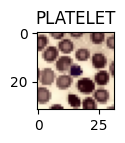

In [46]:
# Vérification que la transformation permet toujours d'afficher les images
plt.figure(figsize=(1,1))
plt.imshow(X[3])
plt.title(Y_nameLabel[3])
plt.show()

## 5.4. Application d'un algorithme de Manifold learning : TSNE

In [47]:
# Reshape de l'array X en une dimension :
X_1D=X.reshape(17092,3072)
print(X_1D.shape)

# Pour contrôle :
print(Y_nameLabel.shape)
print(type(X_1D))
print(type(Y_nameLabel))

(17092, 3072)
(17092,)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [48]:
tsne = TSNE(n_components=2, method = 'barnes_hut', n_jobs=-1)
dataTSNE = tsne.fit_transform(X_1D)

## 5.5. Projection des données sur un graphique 2D

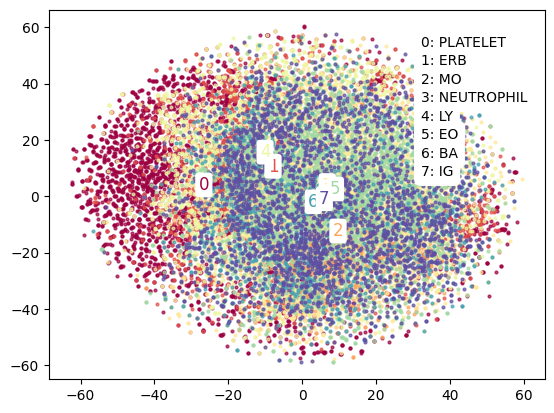

In [49]:
fig = plt.figure()
ax = fig.add_subplot(111)

# Obtenez une liste des labels uniques
unique_labels = df['label'].unique()

# Utilisez la colormap pour obtenir une couleur pour chaque label
colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_labels)))

# Inversez le mapping pour obtenir le nameLabel à partir du label
inverse_mapping = {v: k for k, v in mapping.items()}


# Traçage des clusters et annotation avec le label numérique
for label, color in zip(unique_labels, colors):
    indices = df['label'] == label
    ax.scatter(dataTSNE[indices, 0], dataTSNE[indices, 1], color=color, alpha=0.7, s=4)

    # Calculer le centre de gravité de chaque cluster pour positionner le label
    cluster_center = dataTSNE[indices].mean(axis=0)

    # Annoter le graphique avec le label numérique
    ax.annotate(str(label),
                (cluster_center[0], cluster_center[1]),
                fontsize=12,
                ha='center',
                color=color,
                bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'))

# Affichage du mapping dans le coin supérieur droit
start_x = 0.75  # Ajustez selon votre graphique
start_y = 0.90  # Ajustez selon votre graphique
y_offset = 0.05

for label, name in inverse_mapping.items():
    annotation_str = f"{label}: {name}"
    ax.annotate(annotation_str,
                xy=(start_x, start_y),
                xycoords='axes fraction',
                fontsize=10,
                color='black',
                bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.5'))
    start_y -= y_offset  # déplace le texte vers le bas pour la prochaine annotation

plt.show()

## 5.6. Affichage des objets du Manifold sur la projection 2D TSNE

In [50]:
import matplotlib.pyplot as plt
from matplotlib.image import imread
from matplotlib import offsetbox
from mpl_toolkits import mplot3d

In [51]:
def plot_components(data, model, images=None, ax=None,
                    thumb_frac=0.05, cmap='gray_r', prefit = False):
    ax = ax or plt.gca()

    if not prefit :
        proj = model.fit_transform(data)
    else:
        proj = data
    ax.plot(proj[:, 0], proj[:, 1], '.b')

    if images is not None:
        min_dist_2 = (thumb_frac * max(proj.max(0) - proj.min(0))) ** 2
        shown_images = np.array([2 * proj.max(0)])
        for i in range(data.shape[0]):
            dist = np.sum((proj[i] - shown_images) ** 2, 1)
            if np.min(dist) < min_dist_2:
                # On ne montre pas le points trop proches
                continue
            shown_images = np.vstack([shown_images, proj[i]])
            imagebox = offsetbox.AnnotationBbox(
                offsetbox.OffsetImage(images[i], cmap=cmap),
                                      proj[i])
            ax.add_artist(imagebox)

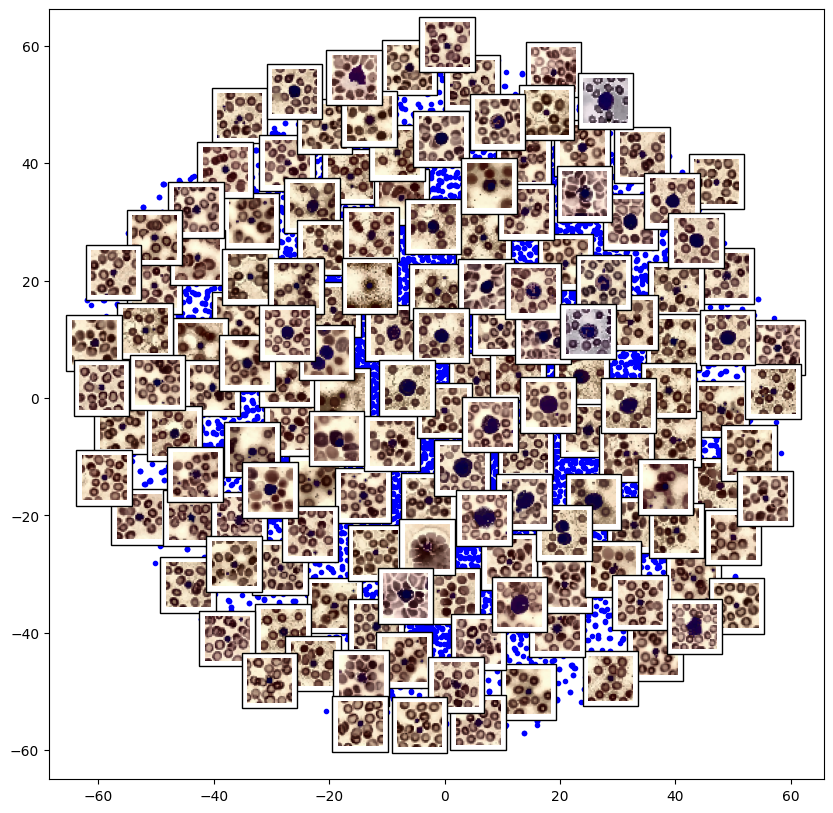

In [52]:
fig, ax = plt.subplots(figsize=(10, 10))
plot_components(dataTSNE, tsne, images=X,
                ax=ax, thumb_frac=0.06, cmap='gray_r',prefit=True)

# **6. Représentation graphique du dataset : images traitées par égalisation adaptative**

## 6.1. Présentation de la transformation sur 2 images par catégorie

  0%|          | 0/2 [00:00<?, ?it/s]

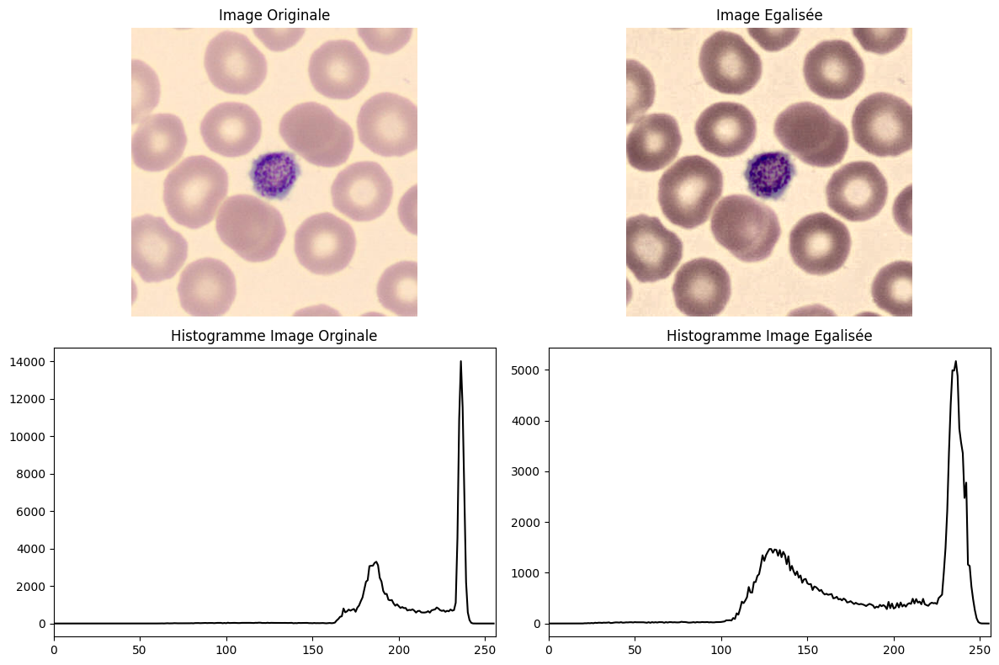

 50%|█████     | 1/2 [00:01<00:01,  1.24s/it]

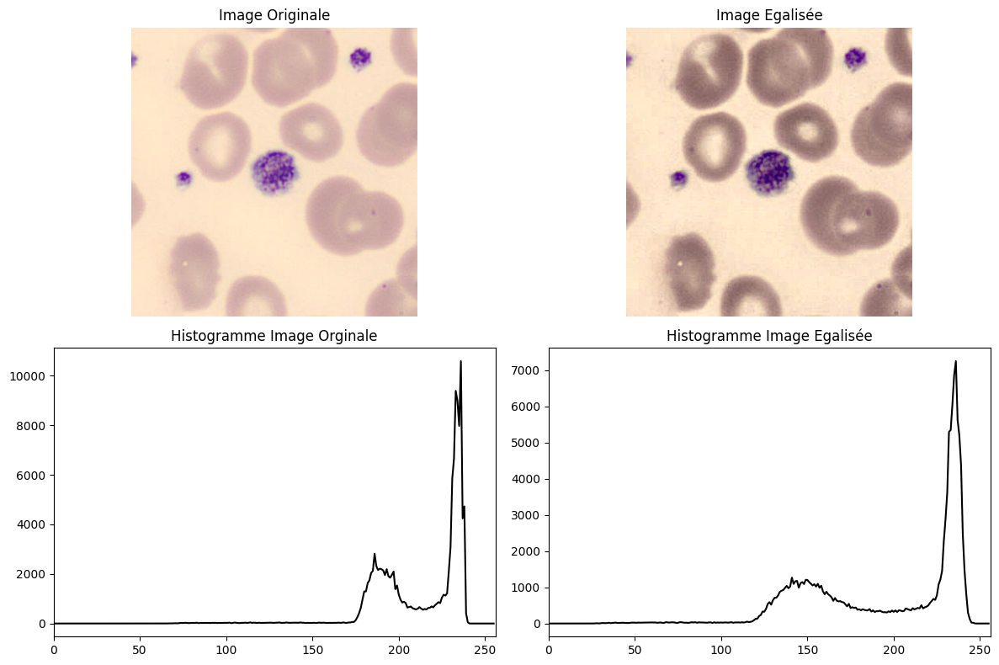

  0%|          | 0/2 [00:00<?, ?it/s]

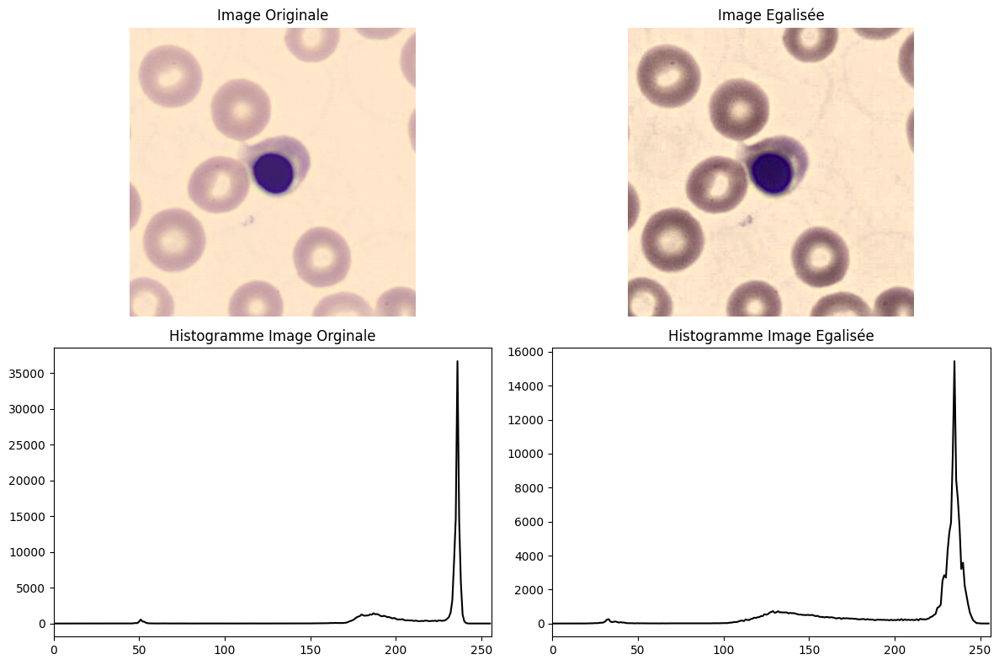

 50%|█████     | 1/2 [00:01<00:01,  1.28s/it]

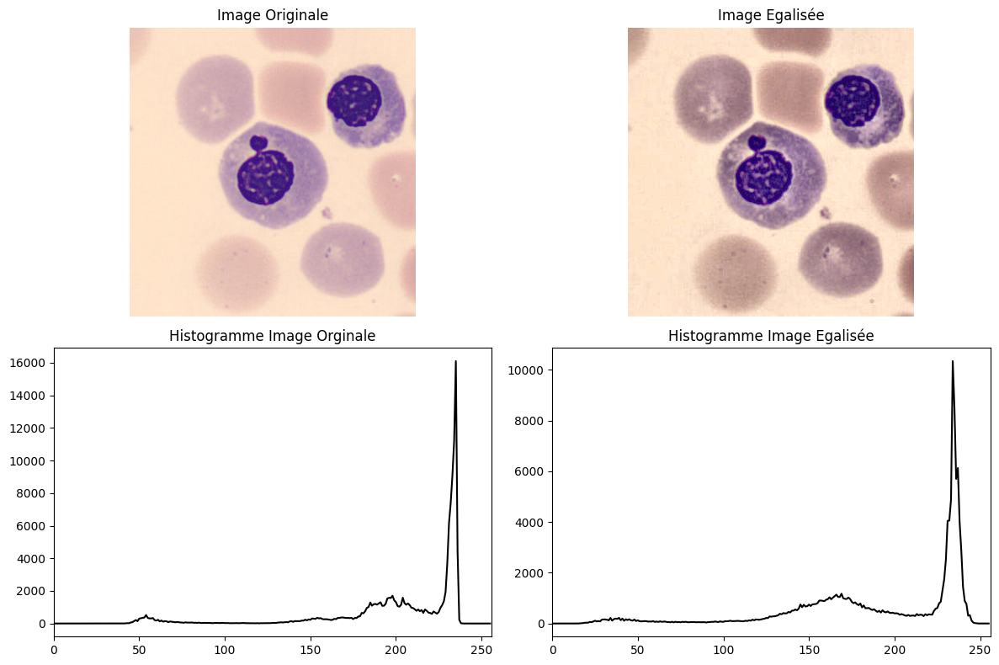

  0%|          | 0/2 [00:00<?, ?it/s]

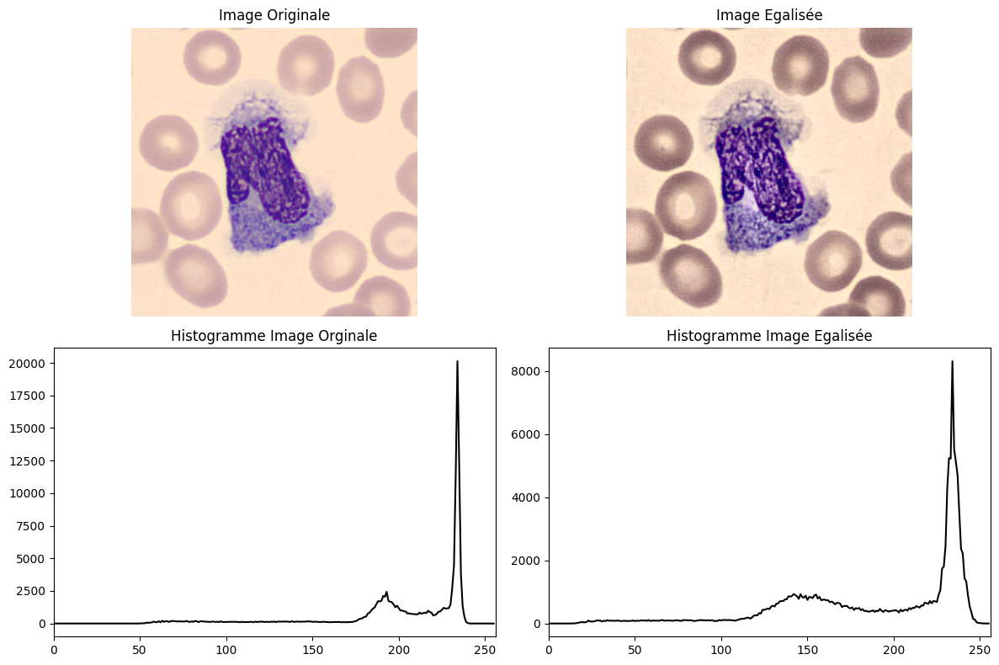

 50%|█████     | 1/2 [00:01<00:01,  1.98s/it]

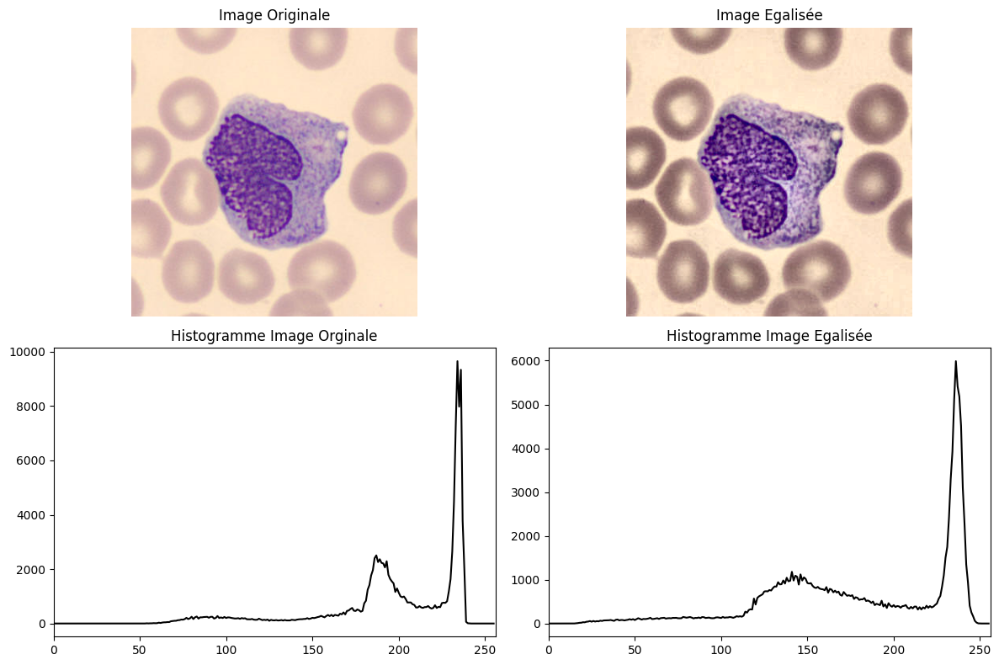

  0%|          | 0/2 [00:00<?, ?it/s]

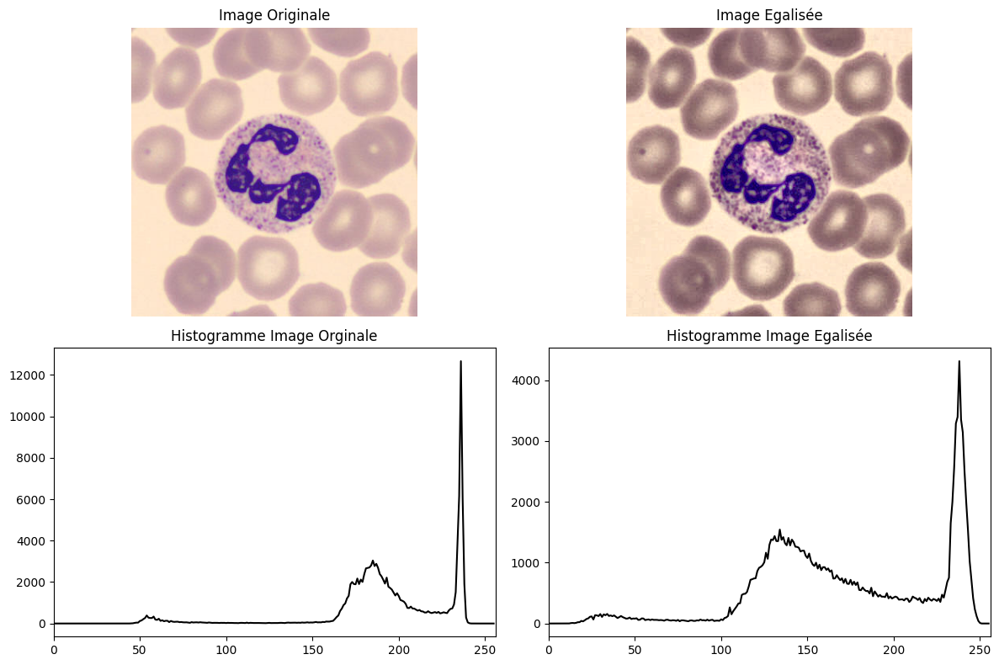

 50%|█████     | 1/2 [00:01<00:01,  1.37s/it]

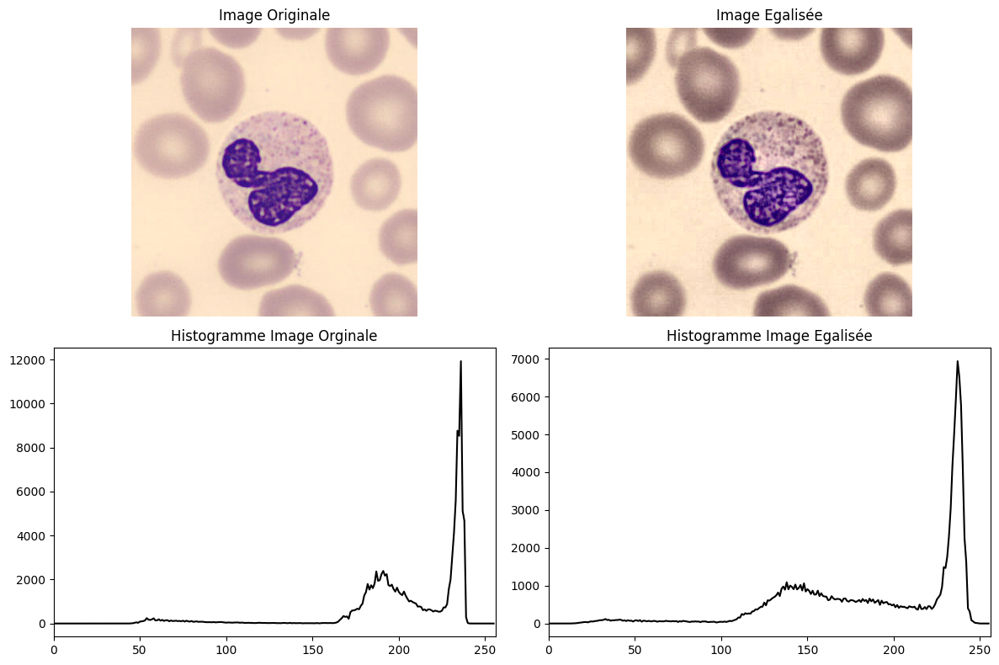

  0%|          | 0/2 [00:00<?, ?it/s]

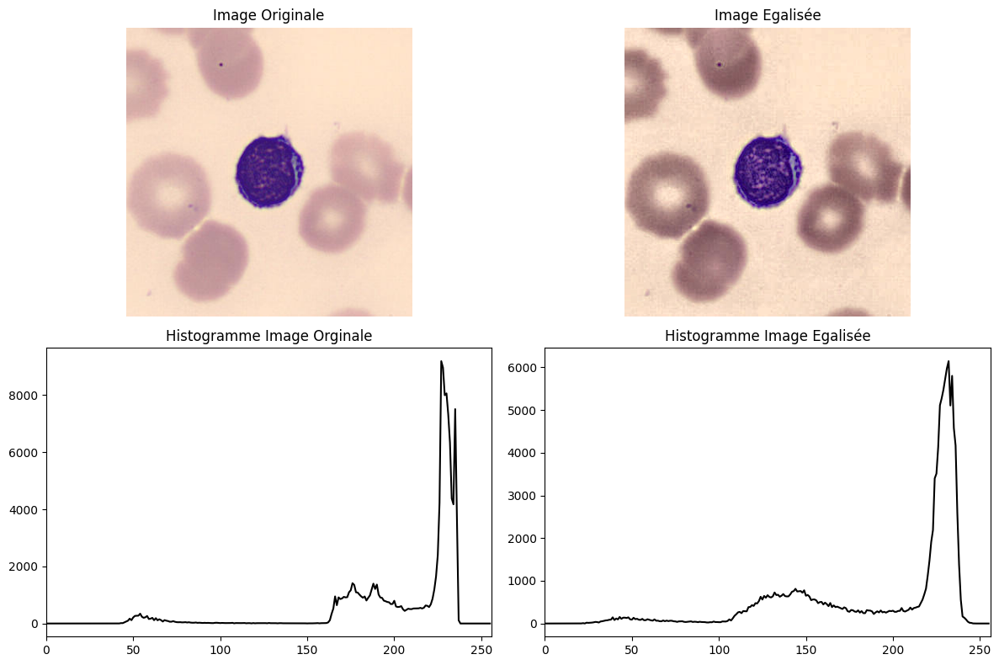

 50%|█████     | 1/2 [00:01<00:01,  1.31s/it]

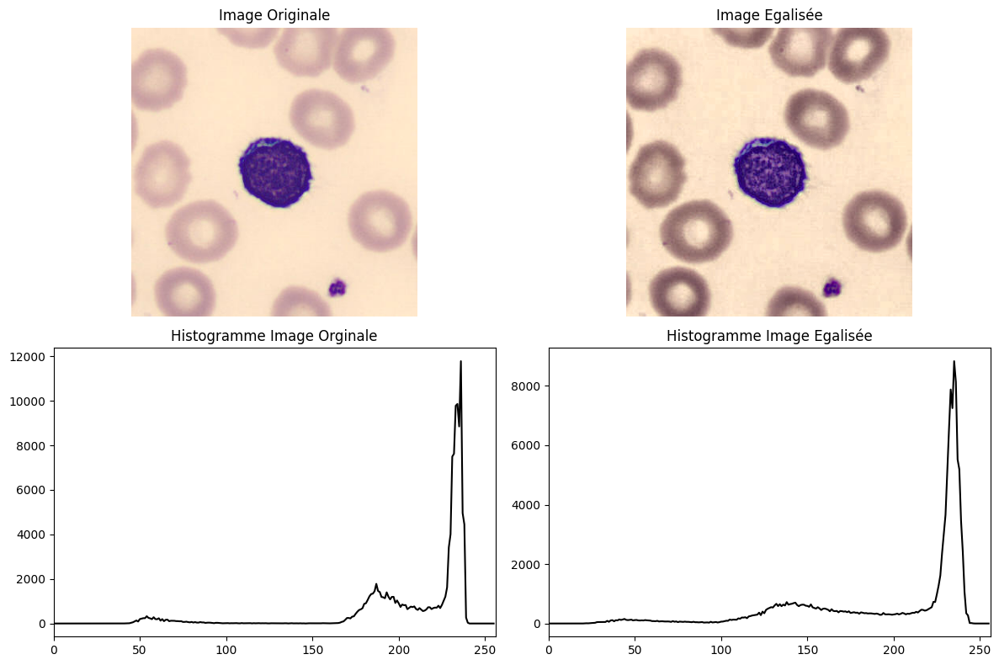

  0%|          | 0/2 [00:00<?, ?it/s]

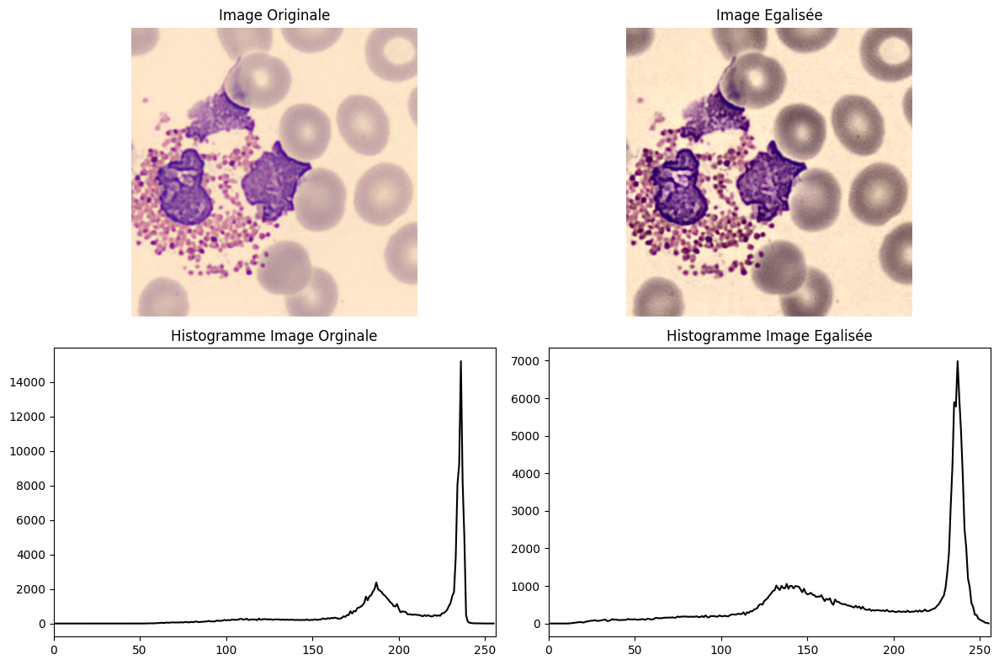

 50%|█████     | 1/2 [00:01<00:01,  1.40s/it]

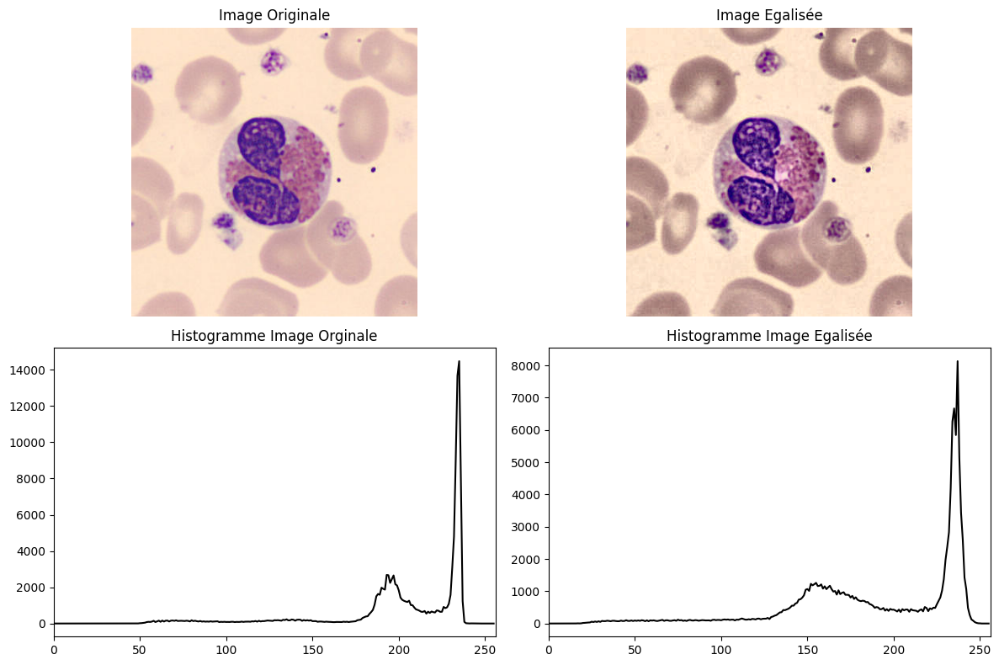

  0%|          | 0/2 [00:00<?, ?it/s]

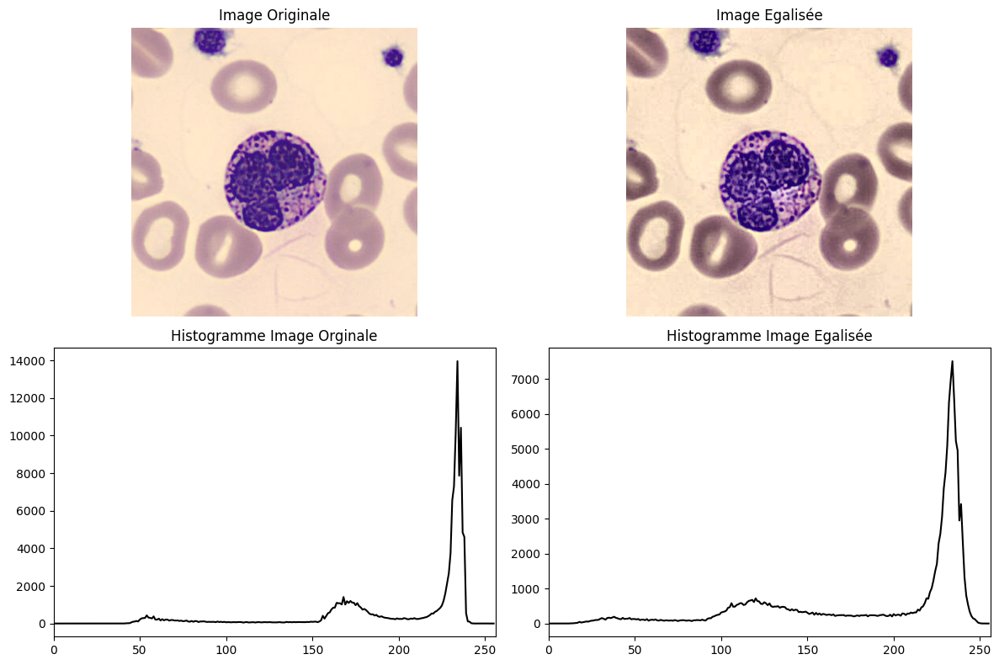

 50%|█████     | 1/2 [00:01<00:01,  1.49s/it]

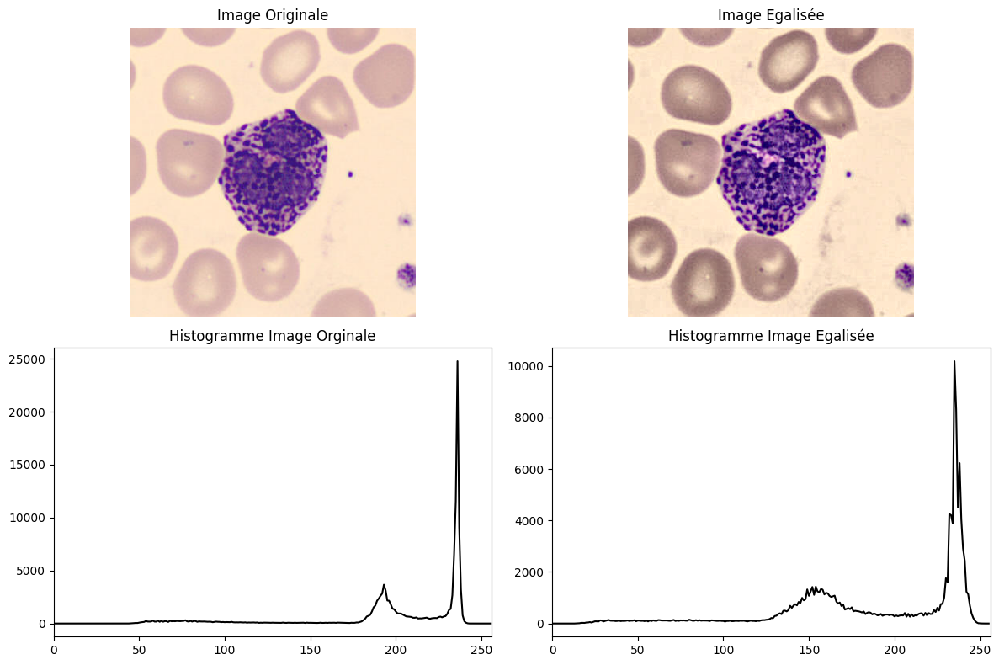

  0%|          | 0/2 [00:00<?, ?it/s]

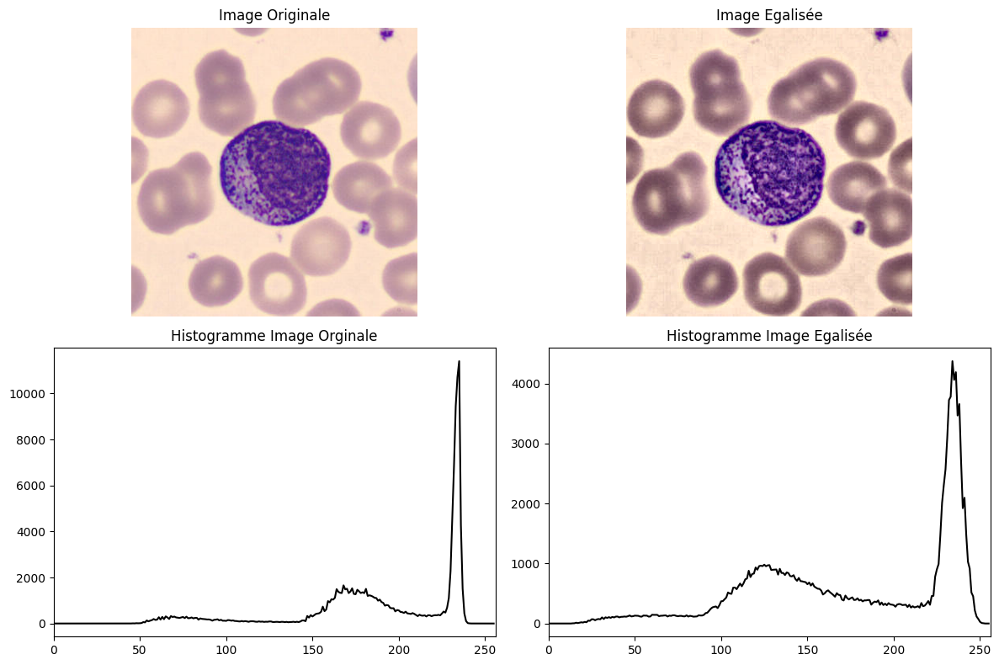

 50%|█████     | 1/2 [00:02<00:02,  2.02s/it]

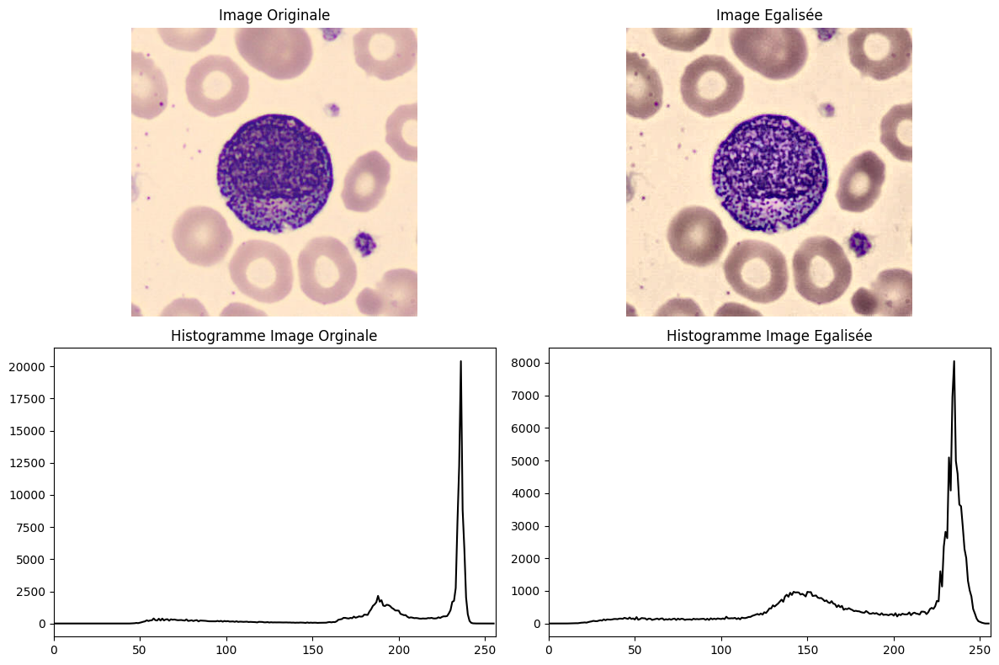

100%|██████████| 2/2 [00:03<00:00,  1.95s/it]


In [77]:
import cv2

# Copie de df
train_df=df

# Définition d'une liste contenant les différents labels
liste_label =df.target.unique()

def plot_histogram(image, title, ax, color='black'):
    """Affiche l'histogramme d'une image."""
    hist = cv2.calcHist([image], [0], None, [256], [0,256])
    ax.plot(hist, color=color)
    ax.set_xlim([0,256])
    ax.set_title(title)

# Parcours et écriture des masques de chaque groupe présent dans la liste "liste_label"
# Ici on prend uniquement une centaine d'images par groupe
for label in liste_label :
  MASK_DF = train_df.loc[train_df['target'] == label]
  IMAGE_PATH = np.array(MASK_DF['Path'])

  # Création et enregistrement des masques pour chaque image

  for i in tqdm(range(2)):

          # Read image

          # Charger l'image en couleur
          image_path = IMAGE_PATH[i]
          image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

          # Convertir l'image de RGB à LAB
          image_lab = cv2.cvtColor(image_color, cv2.COLOR_BGR2Lab)

          # Extraire le canal L
          l_channel, a_channel, b_channel = cv2.split(image_lab)

          # Créer un objet CLAHE (les valeurs de clipLimit et tileGridSize peuvent être ajustées en fonction de vos besoins)
          clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

          # Appliquer l'égalisation adaptative au canal L
          cl_channel = clahe.apply(l_channel)

          # Fusionner les canaux pour obtenir l'image LAB avec égalisation adaptative
          merged_channels = cv2.merge([cl_channel, a_channel, b_channel])

          # Convertir l'image de LAB à RGB
          image_equalized = cv2.cvtColor(merged_channels, cv2.COLOR_Lab2BGR)

          # Filtrage non local des moyennes
          image_filtered = cv2.fastNlMeansDenoisingColored(
            src=image_equalized,
            dst=None,
            h=10,
            hColor=10,
            templateWindowSize=7,
            searchWindowSize=21)

          # Afficher les images et les histogrammes
          fig, axes = plt.subplots(2, 2, figsize=(12, 8))

          # Afficher l'image originale
          axes[0, 0].imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
          axes[0, 0].set_title('Image Originale')
          axes[0, 0].axis('off')

          # Afficher l'image égalisée
          axes[0, 1].imshow(cv2.cvtColor(image_equalized, cv2.COLOR_BGR2RGB))
          axes[0, 1].set_title('Image Egalisée')
          axes[0, 1].axis('off')

          # Afficher l'histogramme original
          plot_histogram(l_channel, 'Histogramme Image Orginale', axes[1, 0])

          # Afficher l'histogramme égalisé
          plot_histogram(cl_channel, 'Histogramme Image Egalisée', axes[1, 1])

          plt.tight_layout()
          plt.show()



## **6.2. Application de la transformation sur le dataset d'images**

In [ ]:
import cv2
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib.image import imread
from matplotlib import offsetbox

# Copie de df
train_df=df

# Définition d'une liste contenant les différents labels
liste_label =df.nameLabel.unique()

# Parcours et écriture des masques de chaque groupe présent dans la liste "liste_label"
# Ici on prend uniquement une centaine d'images par groupe
for label in liste_label :
  MASK_DF = train_df.loc[train_df['nameLabel'] == label]
  IMAGE_PATH = np.array(MASK_DF['filepath'])

  # Création et enregistrement des masques pour chaque image

  for i in tqdm(range(len(MASK_DF))):
  # for i in tqdm(range(5)):

          # Read image

          # Charger l'image en couleur
          image_path = IMAGE_PATH[i]
          image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

          # Convertir l'image de RGB à LAB
          image_lab = cv2.cvtColor(image_color, cv2.COLOR_BGR2Lab)

          # Extraire le canal L
          l_channel, a_channel, b_channel = cv2.split(image_lab)

          # Créer un objet CLAHE (les valeurs de clipLimit et tileGridSize peuvent être ajustées en fonction de vos besoins)
          clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

          # Appliquer l'égalisation adaptative au canal L
          cl_channel = clahe.apply(l_channel)

          # Fusionner les canaux pour obtenir l'image LAB avec égalisation adaptative
          merged_channels = cv2.merge([cl_channel, a_channel, b_channel])

          # Convertir l'image de LAB à RGB
          image_equalized = cv2.cvtColor(merged_channels, cv2.COLOR_Lab2BGR)

          # ajout d'un filtrage non local des moyennes
          image_filtered = cv2.fastNlMeansDenoisingColored(
            src=image_equalized,
            dst=None,
            h=10,
            hColor=10,
            templateWindowSize=7,
            searchWindowSize=21)

          # Chemin du dossier où vous souhaitez enregistrer l'image
          output_folder = '/content/PBC_dataset_normal_DIB/' + IMAGE_PATH[i].split('/')[2]


          # Nom du fichier de sortie
          output_filename = str(MASK_DF['filepath'].iloc[i]).split('/')[3]

          # Chemin complet du fichier de sortie
          output_path = output_folder+'/'+output_filename


          # Save the mask image
          cv2.imwrite(output_path, image_filtered)

## 6.3. Préparation des données

**Création d'une liste 'X' comprenant l'ensemble des images au format 32 x 32 x 3**

In [63]:
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import tensorflow as tf
import pandas as pd
import numpy as np
from sklearn.manifold import LocallyLinearEmbedding, MDS, Isomap, TSNE

# création d'une colonne de df associant à chaque target une valeur comprise entre 0 et 7
df['label'] = df['target'].replace(df.target.unique(), [*range(len(df.target.unique()))])

X_path=df.Path
Y_label=df.label
Y_nameLabel=df.target

X = []

for filepath in tqdm(X_path):
    # Lecture du fichier
    im = tf.io.read_file(filepath)
    # On décode le fichier
    im = tf.image.decode_jpeg(im, channels=3)
    # Redimensionnement
    im = tf.image.resize(im, size=(32, 32))
    X.append(np.array(im))

print(type(X))
print(type(Y_nameLabel))

100%|██████████| 17092/17092 [00:36<00:00, 470.12it/s]

<class 'list'>
<class 'pandas.core.series.Series'>


In [64]:
#Transformation de la série en array numpy
X=np.array(X)

#Convsersion des données en type 'float32'
X = X.astype('float32')

#Normalisation des balances RGB
X/= 255.0

#Transformation de la colonne du dataframe comprenant la classe des images en array numpy
Y_nameLabel = np.array(Y_nameLabel)

#Vérification de l'ensemble des modifications faites:
print(type(X))
print(X.shape)
print(type(Y_nameLabel))
print('Min: %.3f, Max: %.3f' % (X.min(), X.max()))

<class 'numpy.ndarray'>
(17092, 32, 32, 3)
<class 'numpy.ndarray'>
Min: 0.000, Max: 1.000


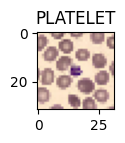

In [65]:
# Vérification que la transformation permet toujours d'afficher les images
plt.figure(figsize=(1,1))
plt.imshow(X[3])
plt.title(Y_nameLabel[3])
plt.show()

## 6.4. Application d'un algorithmt de Manifold learning : TSNE

In [66]:
# Reshape de l'array X en une dimension :
X_1D=X.reshape(17092,3072)
print(X_1D.shape)

# Pour contrôle :
print(Y_nameLabel.shape)
print(type(X_1D))
print(type(Y_nameLabel))

(17092, 3072)
(17092,)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [67]:
tsne = TSNE(n_components=2, method = 'barnes_hut', n_jobs=-1)
dataTSNE = tsne.fit_transform(X_1D)

## 6.5. Projection des données sur un graphique 2D

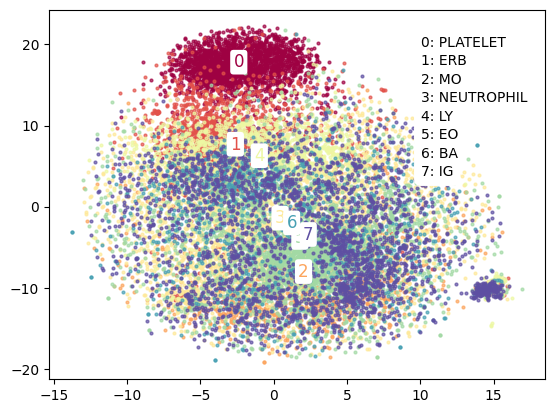

In [68]:
fig = plt.figure()
ax = fig.add_subplot(111)

# Obtenez une liste des labels uniques
unique_labels = df['label'].unique()

# Utilisez la colormap pour obtenir une couleur pour chaque label
colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_labels)))

# Inversez le mapping pour obtenir le nameLabel à partir du label
inverse_mapping = {v: k for k, v in mapping.items()}


# Traçage des clusters et annotation avec le label numérique
for label, color in zip(unique_labels, colors):
    indices = df['label'] == label
    ax.scatter(dataTSNE[indices, 0], dataTSNE[indices, 1], color=color, alpha=0.7, s=4)

    # Calculer le centre de gravité de chaque cluster pour positionner le label
    cluster_center = dataTSNE[indices].mean(axis=0)

    # Annoter le graphique avec le label numérique
    ax.annotate(str(label),
                (cluster_center[0], cluster_center[1]),
                fontsize=12,
                ha='center',
                color=color,
                bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'))

# Affichage du mapping dans le coin supérieur droit
start_x = 0.75  # Ajustez selon votre graphique
start_y = 0.90  # Ajustez selon votre graphique
y_offset = 0.05

for label, name in inverse_mapping.items():
    annotation_str = f"{label}: {name}"
    ax.annotate(annotation_str,
                xy=(start_x, start_y),
                xycoords='axes fraction',
                fontsize=10,
                color='black',
                bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.5'))
    start_y -= y_offset  # déplace le texte vers le bas pour la prochaine annotation

plt.show()

## 6.6. Affichage des objets du Manifold sur la projection 2D TSNE

In [69]:
import matplotlib.pyplot as plt
from matplotlib.image import imread
from matplotlib import offsetbox
from mpl_toolkits import mplot3d

In [70]:
def plot_components(data, model, images=None, ax=None,
                    thumb_frac=0.05, cmap='gray_r', prefit = False):
    ax = ax or plt.gca()

    if not prefit :
        proj = model.fit_transform(data)
    else:
        proj = data
    ax.plot(proj[:, 0], proj[:, 1], '.b')

    if images is not None:
        min_dist_2 = (thumb_frac * max(proj.max(0) - proj.min(0))) ** 2
        shown_images = np.array([2 * proj.max(0)])
        for i in range(data.shape[0]):
            dist = np.sum((proj[i] - shown_images) ** 2, 1)
            if np.min(dist) < min_dist_2:
                # On ne montre pas le points trop proches
                continue
            shown_images = np.vstack([shown_images, proj[i]])
            imagebox = offsetbox.AnnotationBbox(
                offsetbox.OffsetImage(images[i], cmap=cmap),
                                      proj[i])
            ax.add_artist(imagebox)

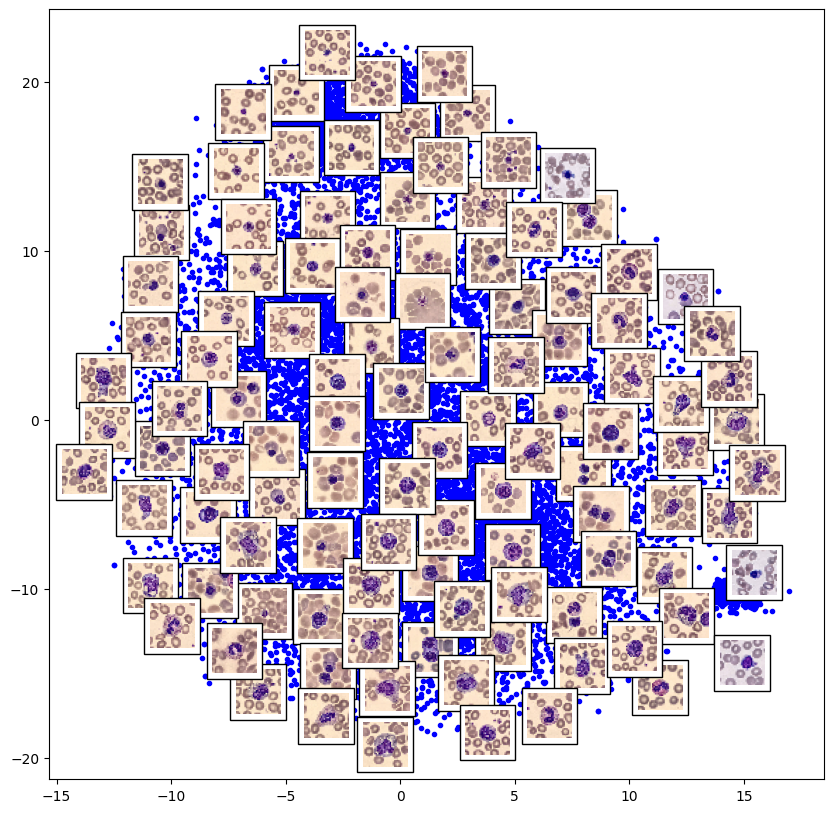

In [71]:
fig, ax = plt.subplots(figsize=(10, 10))
plot_components(dataTSNE, tsne, images=X,
                ax=ax, thumb_frac=0.06, cmap='gray_r',prefit=True)